In [1]:
import numpy as np
import copy, random
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import os

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [3]:
# Khai báo
cube = [[0,0,0,0,0,0,0,0,0],  [1,1,1,1,1,1,1,1,1], [2,2,2,2,2,2,2,2,2],
        [3,3,3,3,3,3,3,3,3],  [4,4,4,4,4,4,4,4,4], [5,5,5,5,5,5,5,5,5]]
reward_done = 1
state_done = copy.deepcopy(cube)
history = []

In [4]:
nguoc_face = {
    'R': 'L', 'L': 'R',
    'F': 'B', 'B': 'F',
    'U': 'D', 'D': 'U'
}
def is_valid_move(new_move):
    if not history:
        return True
    last_move = history[-1]
    if new_move == last_move + "_p" or (new_move.endswith("_p") and new_move[:-2] == last_move):
        return False
    face = new_move[5]
    count = 0
    for past_move in reversed(history):
        if past_move[5] == face:
            count += 1
        elif past_move[5] == nguoc_face[face]:
            break
    if count >= 2:
        return False
    return True

In [5]:
def reset():
    global cube, history
    cube = copy.deepcopy(state_done)
    history = []

def xoay_U():
    global cube
    cube[0] = [cube[0][6], cube[0][3], cube[0][0],
               cube[0][7], cube[0][4], cube[0][1],
               cube[0][8], cube[0][5], cube[0][2]]
    temp = [cube[2][0], cube[2][1], cube[2][2]]
    cube[2][0] = cube[5][0]
    cube[2][1] = cube[5][1]
    cube[2][2] = cube[5][2]
    cube[5][0] = cube[3][0]
    cube[5][1] = cube[3][1]
    cube[5][2] = cube[3][2]
    cube[3][0] = cube[4][0]
    cube[3][1] = cube[4][1]
    cube[3][2] = cube[4][2]
    cube[4][0] = temp[0]
    cube[4][1] = temp[1]
    cube[4][2] = temp[2]

def xoay_U_p():
    for _ in range(3):
        xoay_U()

def xoay_D():
    global cube
    cube[1] = [cube[1][6], cube[1][3], cube[1][0],
               cube[1][7], cube[1][4], cube[1][1],
               cube[1][8], cube[1][5], cube[1][2]]
    temp = [cube[2][6], cube[2][7], cube[2][8]]
    cube[2][6] = cube[4][6]
    cube[2][7] = cube[4][7]
    cube[2][8] = cube[4][8]
    cube[4][6] = cube[3][6]
    cube[4][7] = cube[3][7]
    cube[4][8] = cube[3][8]
    cube[3][6] = cube[5][6]
    cube[3][7] = cube[5][7]
    cube[3][8] = cube[5][8]
    cube[5][6] = temp[0]
    cube[5][7] = temp[1]
    cube[5][8] = temp[2]

def xoay_D_p():
    for _ in range(3):
        xoay_D()

def xoay_R():
    global cube
    cube[3] = [cube[3][6], cube[3][3], cube[3][0],
               cube[3][7], cube[3][4], cube[3][1],
               cube[3][8], cube[3][5], cube[3][2]]
    temp = [cube[0][2], cube[0][5], cube[0][8]]
    cube[0][2] = cube[5][2]
    cube[0][5] = cube[5][5]
    cube[0][8] = cube[5][8]
    cube[5][2] = cube[1][2]
    cube[5][5] = cube[1][5]
    cube[5][8] = cube[1][8]
    cube[1][2] = cube[4][6]
    cube[1][5] = cube[4][3]
    cube[1][8] = cube[4][0]
    cube[4][0] = temp[2]
    cube[4][3] = temp[1]
    cube[4][6] = temp[0]

def xoay_R_p():
    for _ in range(3):
        xoay_R()

def xoay_L():
    global cube
    cube[2] = [cube[2][6], cube[2][3], cube[2][0],
               cube[2][7], cube[2][4], cube[2][1],
               cube[2][8], cube[2][5], cube[2][2]]
    temp = [cube[0][0], cube[0][3], cube[0][6]]
    cube[0][0] = cube[4][2]
    cube[0][3] = cube[4][5]
    cube[0][6] = cube[4][8]
    cube[4][2] = cube[1][6]
    cube[4][5] = cube[1][3]
    cube[4][8] = cube[1][0]
    cube[1][0] = cube[5][0]
    cube[1][3] = cube[5][3]
    cube[1][6] = cube[5][6]
    cube[5][0] = temp[0]
    cube[5][3] = temp[1]
    cube[5][6] = temp[2]

def xoay_L_p():
    for _ in range(3):
        xoay_L()

def xoay_F():
    global cube
    cube[5] = [cube[5][6], cube[5][3], cube[5][0],
               cube[5][7], cube[5][4], cube[5][1],
               cube[5][8], cube[5][5], cube[5][2]]
    temp = [cube[0][6], cube[0][7], cube[0][8]]
    cube[0][6] = cube[2][8]
    cube[0][7] = cube[2][5]
    cube[0][8] = cube[2][2]
    cube[2][2] = cube[1][0]
    cube[2][5] = cube[1][1]
    cube[2][8] = cube[1][2]
    cube[1][0] = cube[3][6]
    cube[1][1] = cube[3][3]
    cube[1][2] = cube[3][0]
    cube[3][0] = temp[0]
    cube[3][3] = temp[1]
    cube[3][6] = temp[2]

def xoay_F_p():
    for _ in range(3):
        xoay_F()

def xoay_B():
    global cube
    cube[4] = [cube[4][6], cube[4][3], cube[4][0],
               cube[4][7], cube[4][4], cube[4][1],
               cube[4][8], cube[4][5], cube[4][2]]
    temp = [cube[0][0], cube[0][1], cube[0][2]]
    cube[0][0] = cube[3][2]
    cube[0][1] = cube[3][5]
    cube[0][2] = cube[3][8]
    cube[3][2] = cube[1][8]
    cube[3][5] = cube[1][7]
    cube[3][8] = cube[1][6]
    cube[1][6] = cube[2][0]
    cube[1][7] = cube[2][3]
    cube[1][8] = cube[2][6]
    cube[2][0] = temp[0]
    cube[2][3] = temp[1]
    cube[2][6] = temp[2]

def xoay_B_p():
    for _ in range(3):
        xoay_B()

moves = [
    xoay_R, xoay_R_p,
    xoay_L, xoay_L_p,
    xoay_F, xoay_F_p,
    xoay_B, xoay_B_p,
    xoay_U, xoay_U_p,
    xoay_D, xoay_D_p
]
move_abc = [
    'xoay_R', 'xoay_R_p',
    'xoay_L', 'xoay_L_p',
    'xoay_F', 'xoay_F_p',
    'xoay_B', 'xoay_B_p',
    'xoay_U', 'xoay_U_p',
    'xoay_D', 'xoay_D_p'
]

def xao_tron_rubik(k):
    state_taken = []
    move_taken = []
    for i in range(1000):
        reset()
        for _ in range(k):
            while True:
                m = random.choice(moves)
                i = moves.index(m)
                move_name = move_abc[i]
                if is_valid_move(move_name):
                    break
            m()
            history.append(move_name)
            if len(history) > 3:
                history.pop(0)
            state = copy.deepcopy(cube)
            state_taken.append(state)
            move_taken.append(i)
    return state_taken, move_taken

In [6]:

class ResidualBlock(nn.Module):
    def __init__(self, input_dim):
        super(ResidualBlock, self).__init__()
        self.linear1 = nn.Linear(input_dim, input_dim)
        self.bn1 = nn.BatchNorm1d(input_dim)
        self.linear2 = nn.Linear(input_dim, input_dim)
        self.bn2 = nn.BatchNorm1d(input_dim)

    def forward(self, x):
        residual = x
        out = self.linear1(x)
        out = self.linear2(out)
        out += residual
        return out

class RubikModel(nn.Module):
    def __init__(self):
        super(RubikModel, self).__init__()
        self.linear1 = nn.Linear(324, 5000)
        self.bn1 = nn.BatchNorm1d(5000)
        self.linear2 = nn.Linear(5000, 1000)
        self.bn2 = nn.BatchNorm1d(1000)

        self.residual_blocks = nn.Sequential(
            ResidualBlock(1000),
            ResidualBlock(1000),
            ResidualBlock(1000),
            ResidualBlock(1000)
        )
        self.linear3 = nn.Linear(1000, 12)

    def forward(self, x):
        x = nn.functional.one_hot(x, num_classes=6).to(torch.float)
        x = x.reshape(-1, 324)
        x = F.relu(self.linear1(x))
        x = self.bn1(x)
        x = F.relu(self.linear2(x))
        x = self.bn2(x)
        x = self.residual_blocks(x)
        x = self.linear3(x)
        return x


In [8]:
model = RubikModel().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
loss_func = nn.CrossEntropyLoss()

In [9]:
# Load checkpoint nếu có
checkpoint_path = "/kaggle/input/new/pytorch/default/1/rubik_model_checkpoint (74).pth"
start_epoch = 0
loss_history = []
if os.path.exists(checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1  # Tiếp tục từ epoch tiếp theo
    loss_history = checkpoint.get('loss_history', [])  # Load loss history nếu có
    print(f"Loaded checkpoint from epoch {start_epoch}")

/tmp/ipykernel_30/117066770.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)


Loaded checkpoint from epoch 1800001


Epoch [1800002], Loss: 1.3982
Epoch [1800003], Loss: 1.3953
Epoch [1800004], Loss: 1.3909
Epoch [1800005], Loss: 1.3968
Epoch [1800006], Loss: 1.3889
Epoch [1800007], Loss: 1.3835
Epoch [1800008], Loss: 1.3888
Epoch [1800009], Loss: 1.3816
Epoch [1800010], Loss: 1.3981
Epoch [1800011], Loss: 1.3900
Epoch [1800012], Loss: 1.3922
Epoch [1800013], Loss: 1.4001
Epoch [1800014], Loss: 1.3850
Epoch [1800015], Loss: 1.3861
Epoch [1800016], Loss: 1.3906
Epoch [1800017], Loss: 1.4022
Epoch [1800018], Loss: 1.3965
Epoch [1800019], Loss: 1.3926
Epoch [1800020], Loss: 1.3870
Epoch [1800021], Loss: 1.3849
Epoch [1800022], Loss: 1.3882
Epoch [1800023], Loss: 1.3948
Epoch [1800024], Loss: 1.3901
Epoch [1800025], Loss: 1.3972
Epoch [1800026], Loss: 1.3790
Epoch [1800027], Loss: 1.4011
Epoch [1800028], Loss: 1.3921
Epoch [1800029], Loss: 1.3903
Epoch [1800030], Loss: 1.4040
Epoch [1800031], Loss: 1.3953
Epoch [1800032], Loss: 1.4007
Epoch [1800033], Loss: 1.3981
Epoch [1800034], Loss: 1.3923
Epoch [180

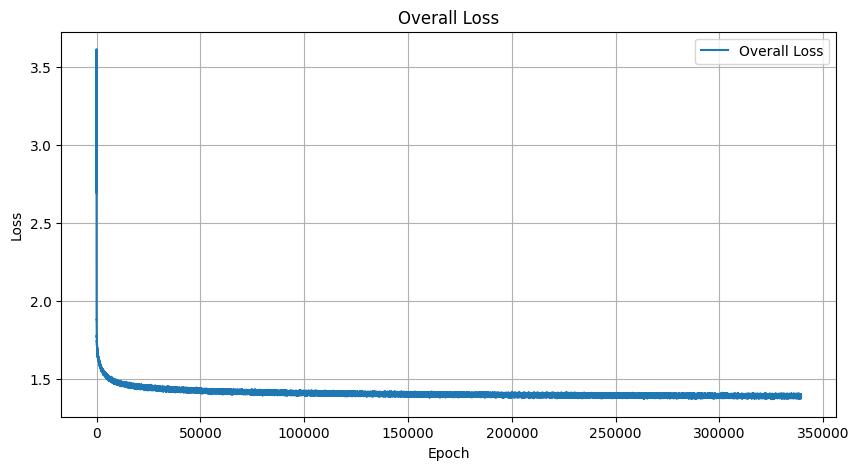

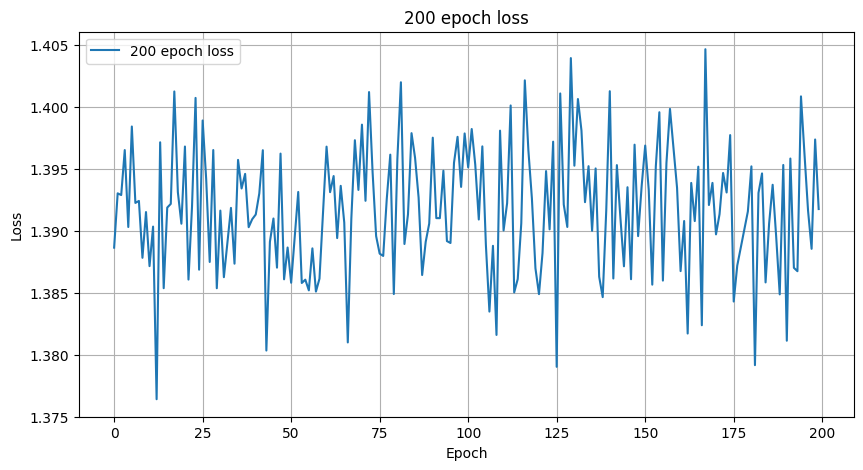

Epoch [1800101], Loss: 1.3950
Epoch [1800102], Loss: 1.3904
Epoch [1800103], Loss: 1.3927
Epoch [1800104], Loss: 1.3910
Epoch [1800105], Loss: 1.3944
Epoch [1800106], Loss: 1.3845
Epoch [1800107], Loss: 1.3854
Epoch [1800108], Loss: 1.3890
Epoch [1800109], Loss: 1.3921
Epoch [1800110], Loss: 1.3833
Epoch [1800111], Loss: 1.3889
Epoch [1800112], Loss: 1.3900
Epoch [1800113], Loss: 1.3972
Epoch [1800114], Loss: 1.3867
Epoch [1800115], Loss: 1.3863
Epoch [1800116], Loss: 1.3927
Epoch [1800117], Loss: 1.3886
Epoch [1800118], Loss: 1.3848
Epoch [1800119], Loss: 1.3940
Epoch [1800120], Loss: 1.3940
Epoch [1800121], Loss: 1.3883
Epoch [1800122], Loss: 1.3833
Epoch [1800123], Loss: 1.3826
Epoch [1800124], Loss: 1.3923
Epoch [1800125], Loss: 1.3902
Epoch [1800126], Loss: 1.4021
Epoch [1800127], Loss: 1.3946
Epoch [1800128], Loss: 1.3842
Epoch [1800129], Loss: 1.3925
Epoch [1800130], Loss: 1.4018
Epoch [1800131], Loss: 1.3955
Epoch [1800132], Loss: 1.3833
Epoch [1800133], Loss: 1.3949
Epoch [180

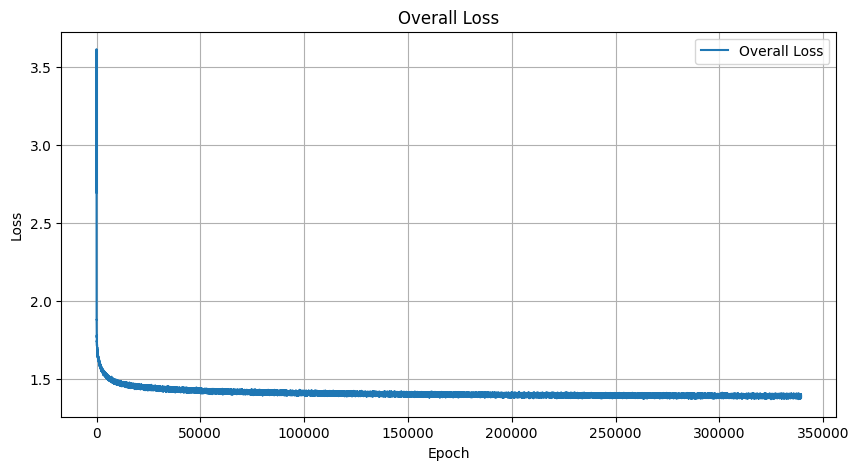

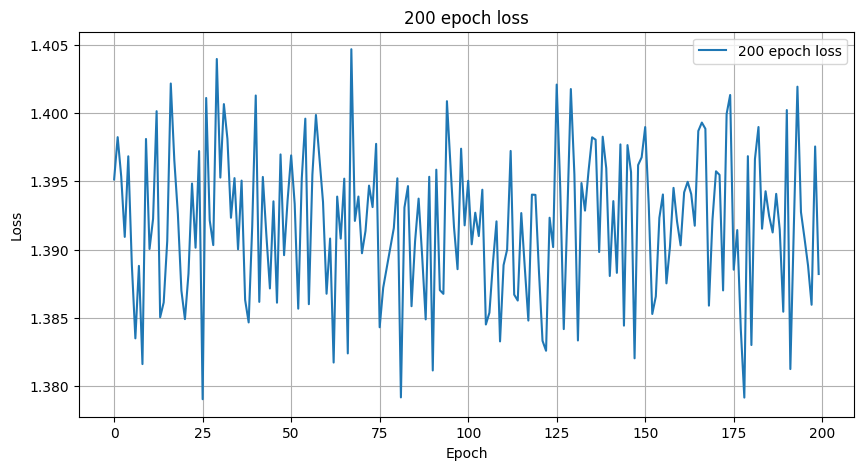

Epoch [1800201], Loss: 1.3948
Epoch [1800202], Loss: 1.3928
Epoch [1800203], Loss: 1.3926
Epoch [1800204], Loss: 1.3942
Epoch [1800205], Loss: 1.3943
Epoch [1800206], Loss: 1.3956
Epoch [1800207], Loss: 1.3902
Epoch [1800208], Loss: 1.3923
Epoch [1800209], Loss: 1.3848
Epoch [1800210], Loss: 1.3893
Epoch [1800211], Loss: 1.3848
Epoch [1800212], Loss: 1.3928
Epoch [1800213], Loss: 1.3827
Epoch [1800214], Loss: 1.3935
Epoch [1800215], Loss: 1.3872
Epoch [1800216], Loss: 1.3895
Epoch [1800217], Loss: 1.3927
Epoch [1800218], Loss: 1.3938
Epoch [1800219], Loss: 1.3923
Epoch [1800220], Loss: 1.3930
Epoch [1800221], Loss: 1.3912
Epoch [1800222], Loss: 1.3907
Epoch [1800223], Loss: 1.3991
Epoch [1800224], Loss: 1.3891
Epoch [1800225], Loss: 1.3972
Epoch [1800226], Loss: 1.3950
Epoch [1800227], Loss: 1.3933
Epoch [1800228], Loss: 1.3872
Epoch [1800229], Loss: 1.3891
Epoch [1800230], Loss: 1.3860
Epoch [1800231], Loss: 1.3923
Epoch [1800232], Loss: 1.3892
Epoch [1800233], Loss: 1.3925
Epoch [180

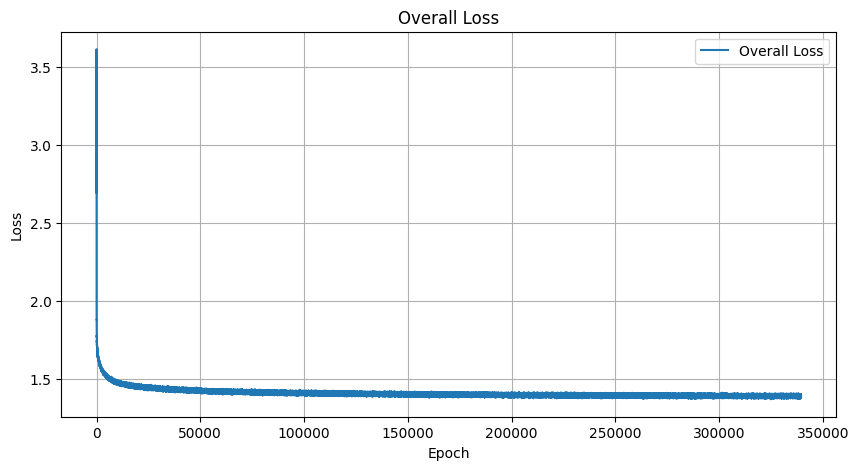

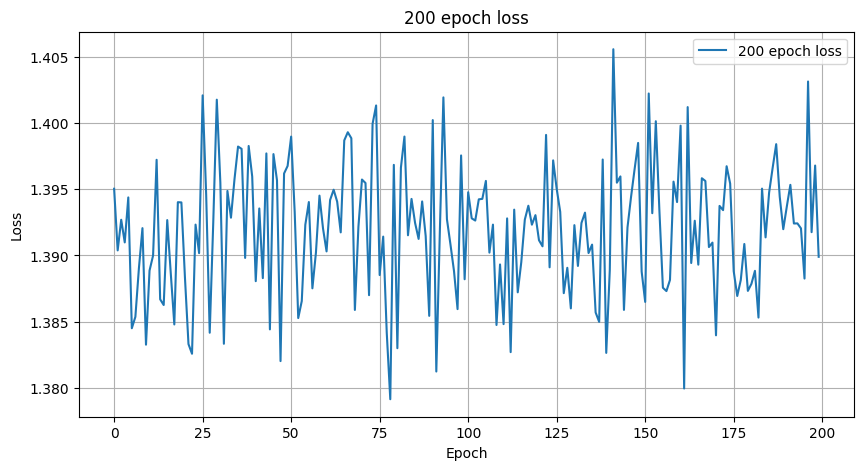

Epoch [1800301], Loss: 1.3926
Epoch [1800302], Loss: 1.3860
Epoch [1800303], Loss: 1.4038
Epoch [1800304], Loss: 1.3924
Epoch [1800305], Loss: 1.3907
Epoch [1800306], Loss: 1.3853
Epoch [1800307], Loss: 1.3930
Epoch [1800308], Loss: 1.3873
Epoch [1800309], Loss: 1.3918
Epoch [1800310], Loss: 1.3923
Epoch [1800311], Loss: 1.3944
Epoch [1800312], Loss: 1.3976
Epoch [1800313], Loss: 1.3914
Epoch [1800314], Loss: 1.3978
Epoch [1800315], Loss: 1.3892
Epoch [1800316], Loss: 1.3851
Epoch [1800317], Loss: 1.3966
Epoch [1800318], Loss: 1.3951
Epoch [1800319], Loss: 1.3970
Epoch [1800320], Loss: 1.3963
Epoch [1800321], Loss: 1.3966
Epoch [1800322], Loss: 1.3873
Epoch [1800323], Loss: 1.3884
Epoch [1800324], Loss: 1.3975
Epoch [1800325], Loss: 1.4036
Epoch [1800326], Loss: 1.4037
Epoch [1800327], Loss: 1.3966
Epoch [1800328], Loss: 1.3914
Epoch [1800329], Loss: 1.3832
Epoch [1800330], Loss: 1.3890
Epoch [1800331], Loss: 1.4035
Epoch [1800332], Loss: 1.3999
Epoch [1800333], Loss: 1.3932
Epoch [180

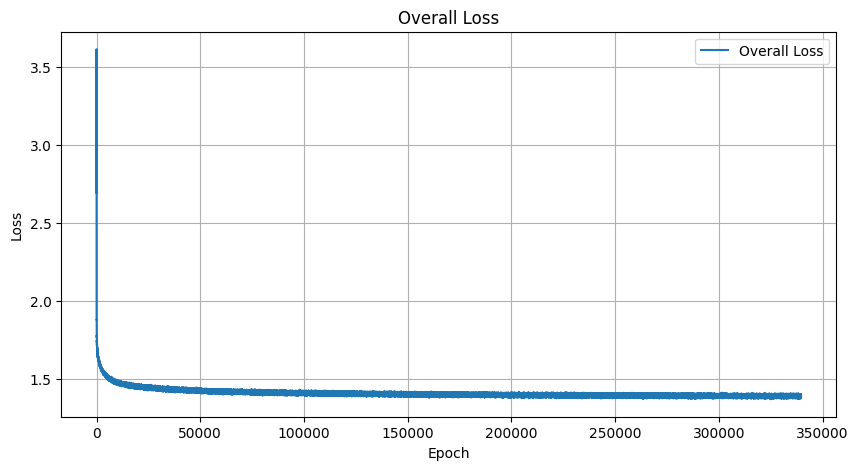

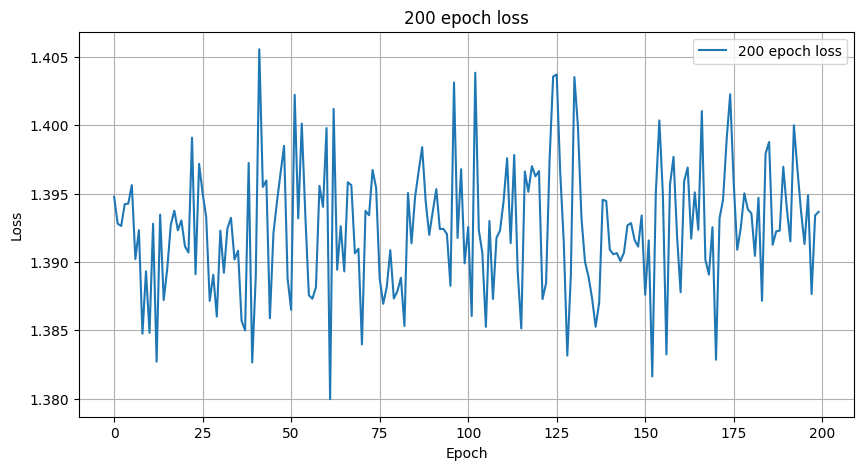

Epoch [1800401], Loss: 1.4001
Epoch [1800402], Loss: 1.3899
Epoch [1800403], Loss: 1.3931
Epoch [1800404], Loss: 1.3975
Epoch [1800405], Loss: 1.3904
Epoch [1800406], Loss: 1.3958
Epoch [1800407], Loss: 1.3967
Epoch [1800408], Loss: 1.3812
Epoch [1800409], Loss: 1.3929
Epoch [1800410], Loss: 1.3961
Epoch [1800411], Loss: 1.3883
Epoch [1800412], Loss: 1.3911
Epoch [1800413], Loss: 1.3931
Epoch [1800414], Loss: 1.3929
Epoch [1800415], Loss: 1.3810
Epoch [1800416], Loss: 1.3828
Epoch [1800417], Loss: 1.4022
Epoch [1800418], Loss: 1.3958
Epoch [1800419], Loss: 1.4000
Epoch [1800420], Loss: 1.3911
Epoch [1800421], Loss: 1.4004
Epoch [1800422], Loss: 1.3947
Epoch [1800423], Loss: 1.3904
Epoch [1800424], Loss: 1.3867
Epoch [1800425], Loss: 1.3933
Epoch [1800426], Loss: 1.3951
Epoch [1800427], Loss: 1.3943
Epoch [1800428], Loss: 1.3925
Epoch [1800429], Loss: 1.3942
Epoch [1800430], Loss: 1.3877
Epoch [1800431], Loss: 1.3979
Epoch [1800432], Loss: 1.3885
Epoch [1800433], Loss: 1.3957
Epoch [180

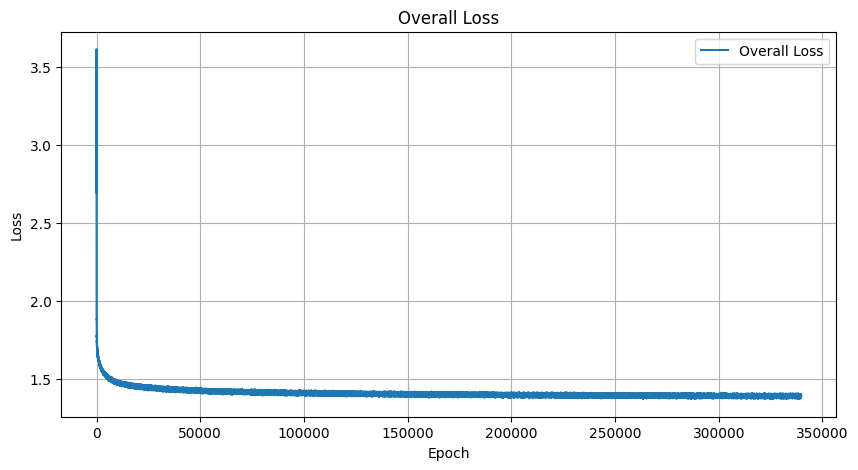

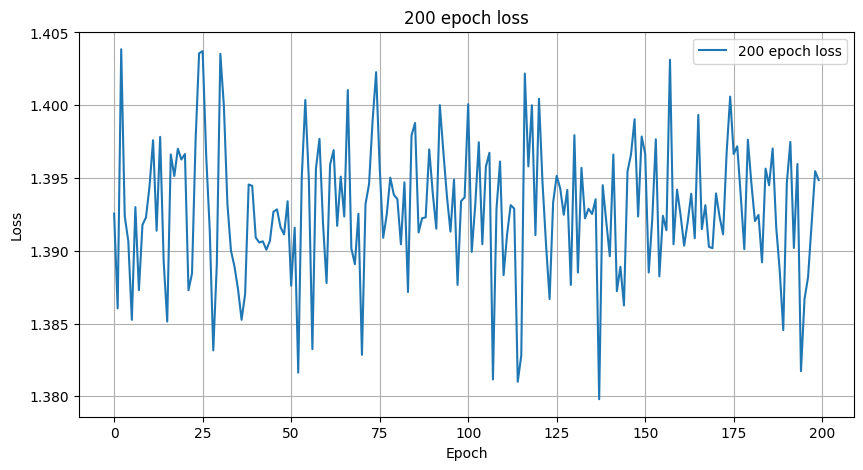

Epoch [1800501], Loss: 1.4007
Epoch [1800502], Loss: 1.3899
Epoch [1800503], Loss: 1.3936
Epoch [1800504], Loss: 1.3902
Epoch [1800505], Loss: 1.3937
Epoch [1800506], Loss: 1.3940
Epoch [1800507], Loss: 1.3855
Epoch [1800508], Loss: 1.4004
Epoch [1800509], Loss: 1.3883
Epoch [1800510], Loss: 1.3952
Epoch [1800511], Loss: 1.3883
Epoch [1800512], Loss: 1.3894
Epoch [1800513], Loss: 1.3959
Epoch [1800514], Loss: 1.3952
Epoch [1800515], Loss: 1.3988
Epoch [1800516], Loss: 1.3992
Epoch [1800517], Loss: 1.3921
Epoch [1800518], Loss: 1.3908
Epoch [1800519], Loss: 1.3874
Epoch [1800520], Loss: 1.3871
Epoch [1800521], Loss: 1.3965
Epoch [1800522], Loss: 1.3978
Epoch [1800523], Loss: 1.3905
Epoch [1800524], Loss: 1.3901
Epoch [1800525], Loss: 1.3915
Epoch [1800526], Loss: 1.3926
Epoch [1800527], Loss: 1.3972
Epoch [1800528], Loss: 1.3930
Epoch [1800529], Loss: 1.3880
Epoch [1800530], Loss: 1.3870
Epoch [1800531], Loss: 1.3925
Epoch [1800532], Loss: 1.3933
Epoch [1800533], Loss: 1.3859
Epoch [180

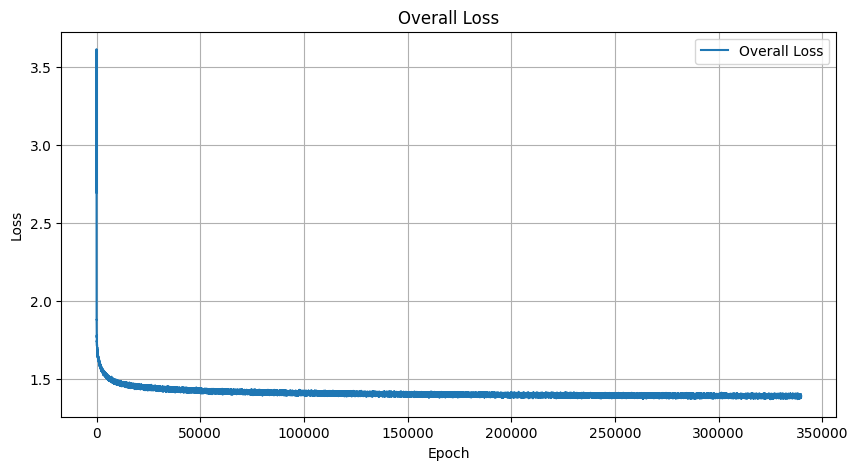

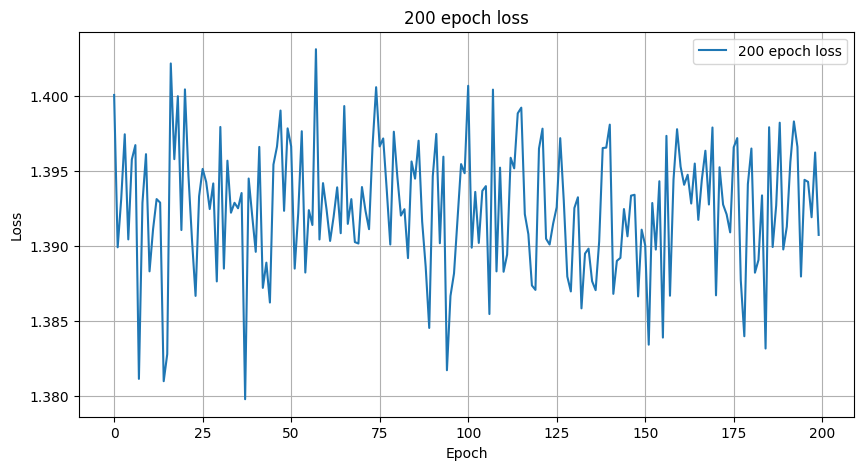

Epoch [1800601], Loss: 1.4011
Epoch [1800602], Loss: 1.3962
Epoch [1800603], Loss: 1.3898
Epoch [1800604], Loss: 1.3954
Epoch [1800605], Loss: 1.3938
Epoch [1800606], Loss: 1.3905
Epoch [1800607], Loss: 1.3799
Epoch [1800608], Loss: 1.3949
Epoch [1800609], Loss: 1.3907
Epoch [1800610], Loss: 1.3906
Epoch [1800611], Loss: 1.3962
Epoch [1800612], Loss: 1.4018
Epoch [1800613], Loss: 1.3940
Epoch [1800614], Loss: 1.3966
Epoch [1800615], Loss: 1.3881
Epoch [1800616], Loss: 1.3943
Epoch [1800617], Loss: 1.3916
Epoch [1800618], Loss: 1.3967
Epoch [1800619], Loss: 1.3929
Epoch [1800620], Loss: 1.3917
Epoch [1800621], Loss: 1.3955
Epoch [1800622], Loss: 1.3957
Epoch [1800623], Loss: 1.3937
Epoch [1800624], Loss: 1.3893
Epoch [1800625], Loss: 1.3915
Epoch [1800626], Loss: 1.3925
Epoch [1800627], Loss: 1.3913
Epoch [1800628], Loss: 1.3876
Epoch [1800629], Loss: 1.3958
Epoch [1800630], Loss: 1.3934
Epoch [1800631], Loss: 1.3944
Epoch [1800632], Loss: 1.3878
Epoch [1800633], Loss: 1.3894
Epoch [180

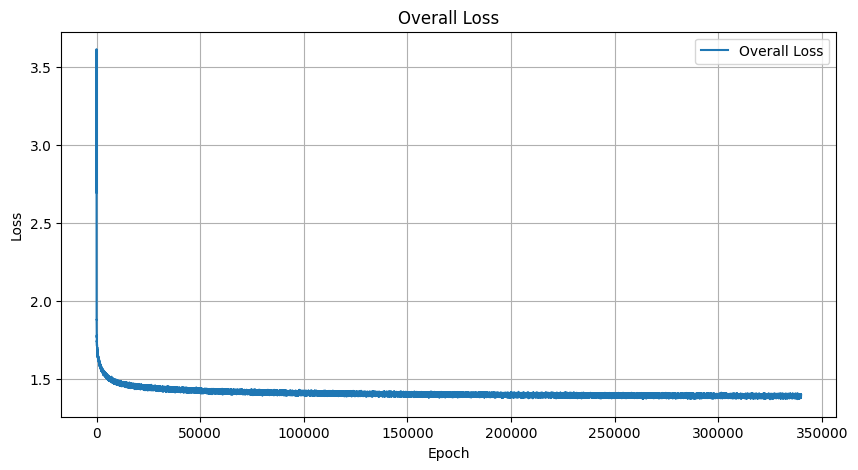

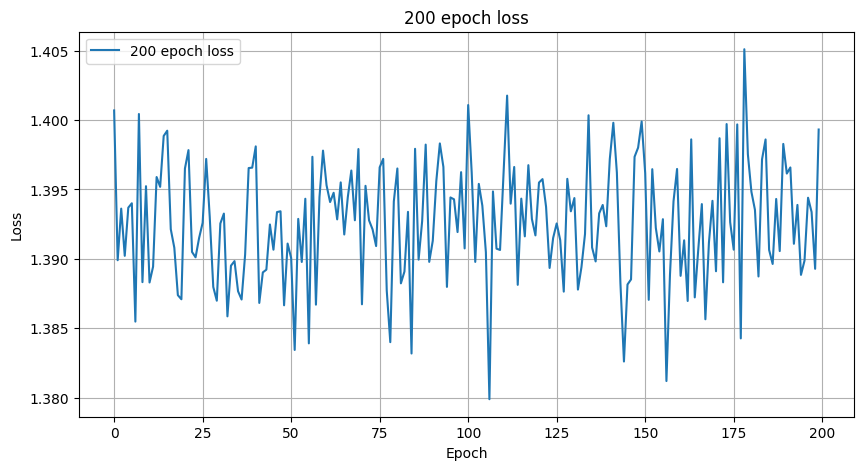

Epoch [1800701], Loss: 1.3839
Epoch [1800702], Loss: 1.3776
Epoch [1800703], Loss: 1.3922
Epoch [1800704], Loss: 1.3934
Epoch [1800705], Loss: 1.3871
Epoch [1800706], Loss: 1.3887
Epoch [1800707], Loss: 1.3932
Epoch [1800708], Loss: 1.3927
Epoch [1800709], Loss: 1.3951
Epoch [1800710], Loss: 1.3937
Epoch [1800711], Loss: 1.3890
Epoch [1800712], Loss: 1.3875
Epoch [1800713], Loss: 1.3996
Epoch [1800714], Loss: 1.3942
Epoch [1800715], Loss: 1.3948
Epoch [1800716], Loss: 1.3879
Epoch [1800717], Loss: 1.3883
Epoch [1800718], Loss: 1.4029
Epoch [1800719], Loss: 1.3955
Epoch [1800720], Loss: 1.3917
Epoch [1800721], Loss: 1.3867
Epoch [1800722], Loss: 1.3873
Epoch [1800723], Loss: 1.3982
Epoch [1800724], Loss: 1.3982
Epoch [1800725], Loss: 1.3897
Epoch [1800726], Loss: 1.3963
Epoch [1800727], Loss: 1.3950
Epoch [1800728], Loss: 1.3859
Epoch [1800729], Loss: 1.3833
Epoch [1800730], Loss: 1.3868
Epoch [1800731], Loss: 1.3906
Epoch [1800732], Loss: 1.3851
Epoch [1800733], Loss: 1.3893
Epoch [180

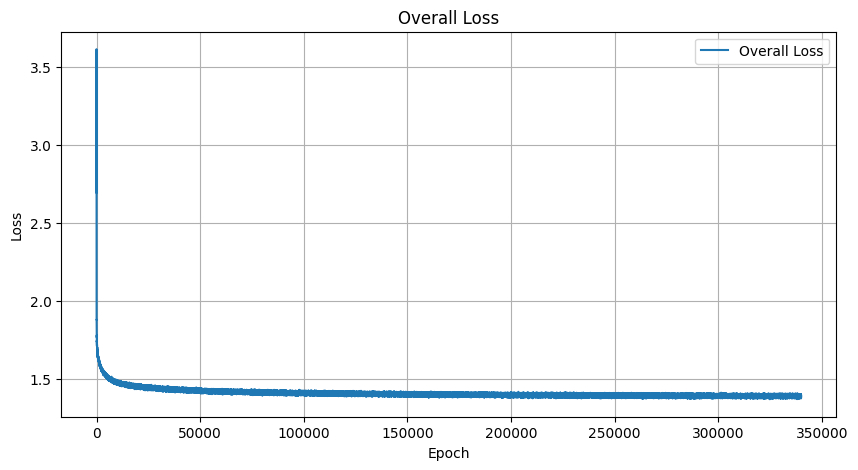

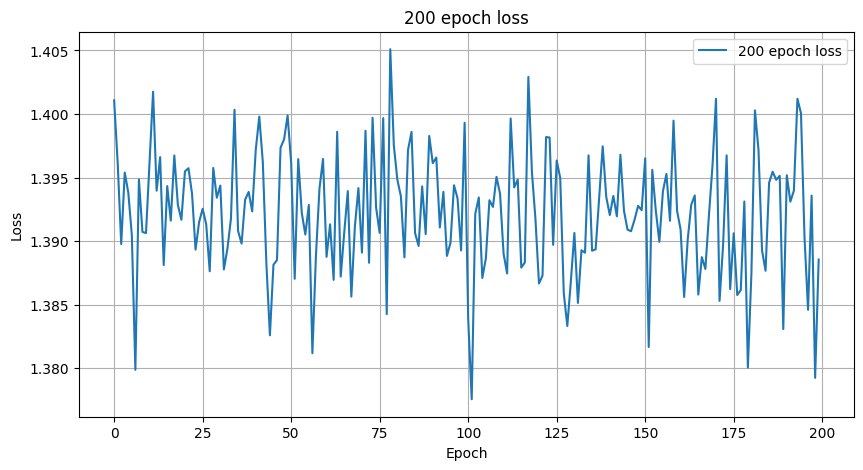

Epoch [1800801], Loss: 1.3884
Epoch [1800802], Loss: 1.3938
Epoch [1800803], Loss: 1.3860
Epoch [1800804], Loss: 1.3916
Epoch [1800805], Loss: 1.3890
Epoch [1800806], Loss: 1.3930
Epoch [1800807], Loss: 1.3954
Epoch [1800808], Loss: 1.3863
Epoch [1800809], Loss: 1.3903
Epoch [1800810], Loss: 1.3956
Epoch [1800811], Loss: 1.3927
Epoch [1800812], Loss: 1.3950
Epoch [1800813], Loss: 1.3941
Epoch [1800814], Loss: 1.3849
Epoch [1800815], Loss: 1.3909
Epoch [1800816], Loss: 1.3902
Epoch [1800817], Loss: 1.3880
Epoch [1800818], Loss: 1.3917
Epoch [1800819], Loss: 1.3791
Epoch [1800820], Loss: 1.3857
Epoch [1800821], Loss: 1.4070
Epoch [1800822], Loss: 1.3902
Epoch [1800823], Loss: 1.3910
Epoch [1800824], Loss: 1.3943
Epoch [1800825], Loss: 1.3958
Epoch [1800826], Loss: 1.4006
Epoch [1800827], Loss: 1.3897
Epoch [1800828], Loss: 1.3944
Epoch [1800829], Loss: 1.3788
Epoch [1800830], Loss: 1.3953
Epoch [1800831], Loss: 1.3893
Epoch [1800832], Loss: 1.3936
Epoch [1800833], Loss: 1.3949
Epoch [180

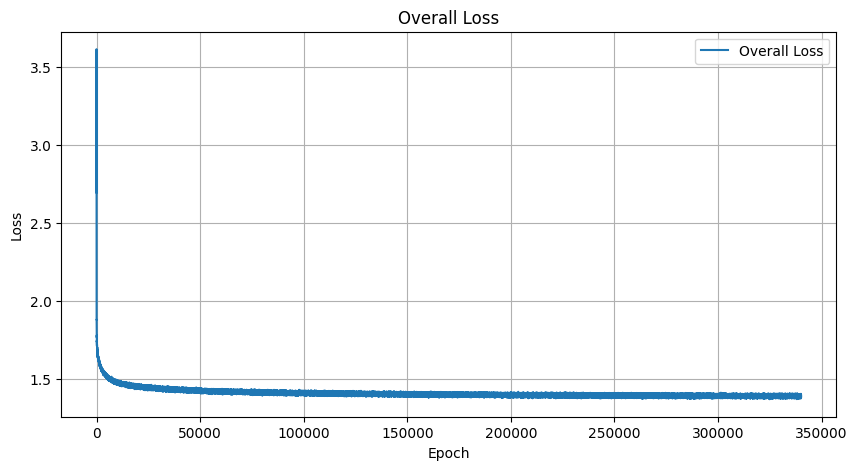

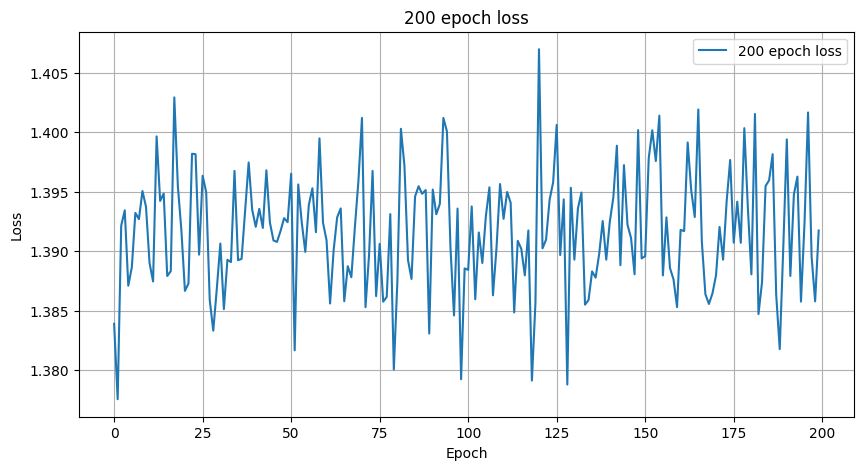

Epoch [1800901], Loss: 1.3907
Epoch [1800902], Loss: 1.3879
Epoch [1800903], Loss: 1.3927
Epoch [1800904], Loss: 1.3938
Epoch [1800905], Loss: 1.3913
Epoch [1800906], Loss: 1.3841
Epoch [1800907], Loss: 1.3953
Epoch [1800908], Loss: 1.3868
Epoch [1800909], Loss: 1.3940
Epoch [1800910], Loss: 1.3895
Epoch [1800911], Loss: 1.3874
Epoch [1800912], Loss: 1.3921
Epoch [1800913], Loss: 1.3904
Epoch [1800914], Loss: 1.3987
Epoch [1800915], Loss: 1.3949
Epoch [1800916], Loss: 1.4018
Epoch [1800917], Loss: 1.3884
Epoch [1800918], Loss: 1.3875
Epoch [1800919], Loss: 1.3871
Epoch [1800920], Loss: 1.3925
Epoch [1800921], Loss: 1.3848
Epoch [1800922], Loss: 1.4002
Epoch [1800923], Loss: 1.3920
Epoch [1800924], Loss: 1.3884
Epoch [1800925], Loss: 1.3958
Epoch [1800926], Loss: 1.3924
Epoch [1800927], Loss: 1.3916
Epoch [1800928], Loss: 1.3915
Epoch [1800929], Loss: 1.3913
Epoch [1800930], Loss: 1.3857
Epoch [1800931], Loss: 1.3884
Epoch [1800932], Loss: 1.3897
Epoch [1800933], Loss: 1.3872
Epoch [180

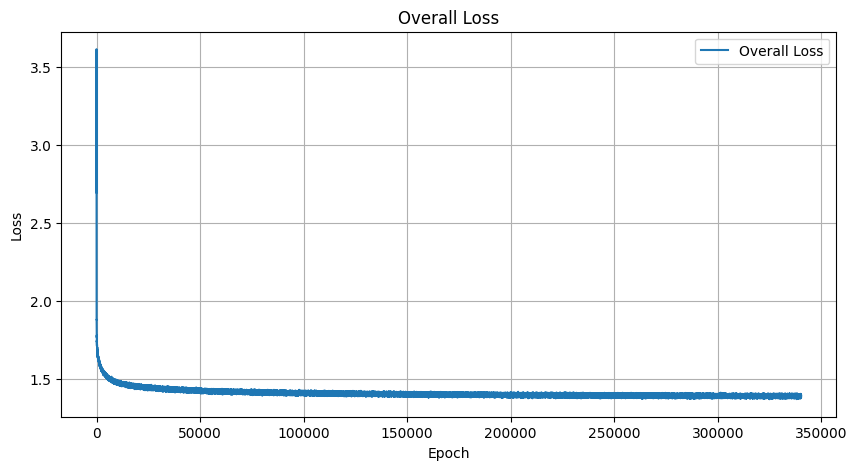

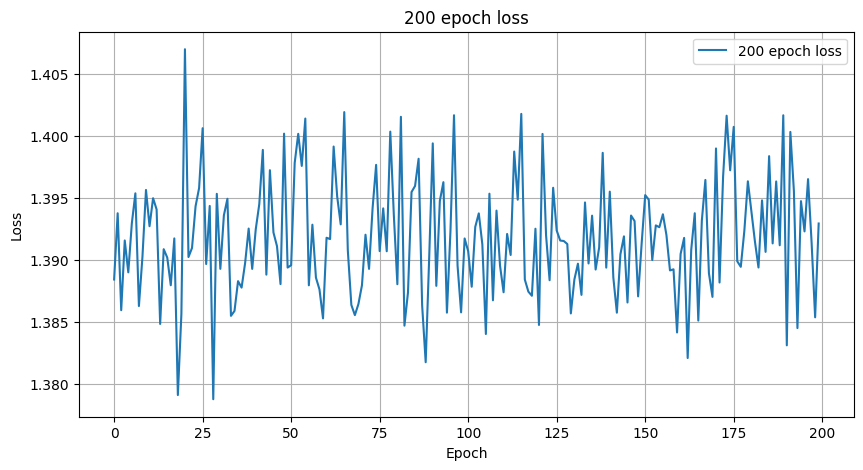

Epoch [1801001], Loss: 1.3751
Epoch [1801002], Loss: 1.3977
Epoch [1801003], Loss: 1.3914
Epoch [1801004], Loss: 1.3935
Epoch [1801005], Loss: 1.3857
Epoch [1801006], Loss: 1.3932
Epoch [1801007], Loss: 1.3955
Epoch [1801008], Loss: 1.3905
Epoch [1801009], Loss: 1.3999
Epoch [1801010], Loss: 1.4007
Epoch [1801011], Loss: 1.3955
Epoch [1801012], Loss: 1.3868
Epoch [1801013], Loss: 1.3903
Epoch [1801014], Loss: 1.3850
Epoch [1801015], Loss: 1.3929
Epoch [1801016], Loss: 1.3943
Epoch [1801017], Loss: 1.3917
Epoch [1801018], Loss: 1.3892
Epoch [1801019], Loss: 1.3991
Epoch [1801020], Loss: 1.4018
Epoch [1801021], Loss: 1.3940
Epoch [1801022], Loss: 1.3897
Epoch [1801023], Loss: 1.3940
Epoch [1801024], Loss: 1.3824
Epoch [1801025], Loss: 1.3905
Epoch [1801026], Loss: 1.3939
Epoch [1801027], Loss: 1.3926
Epoch [1801028], Loss: 1.3956
Epoch [1801029], Loss: 1.3930
Epoch [1801030], Loss: 1.3873
Epoch [1801031], Loss: 1.3889
Epoch [1801032], Loss: 1.3851
Epoch [1801033], Loss: 1.3877
Epoch [180

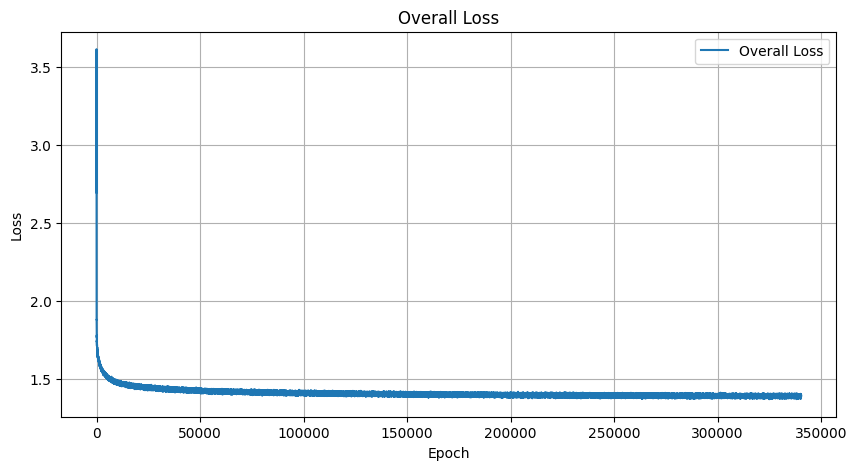

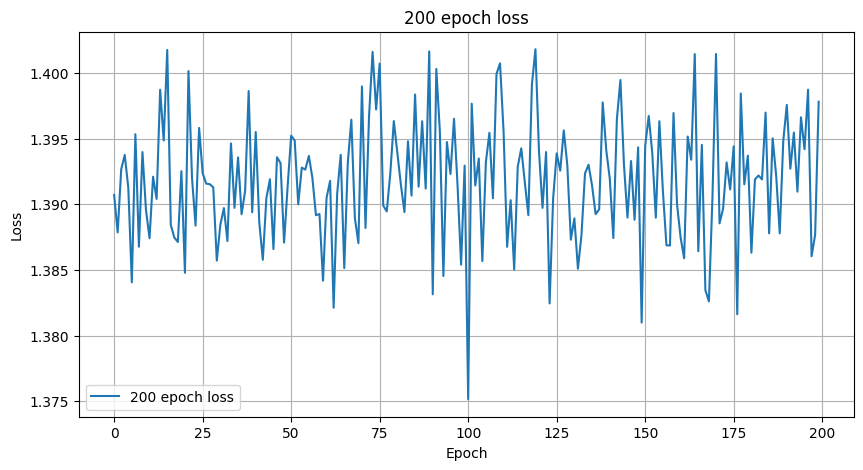

Epoch [1801101], Loss: 1.3965
Epoch [1801102], Loss: 1.3948
Epoch [1801103], Loss: 1.3904
Epoch [1801104], Loss: 1.3846
Epoch [1801105], Loss: 1.3939
Epoch [1801106], Loss: 1.3925
Epoch [1801107], Loss: 1.3960
Epoch [1801108], Loss: 1.3840
Epoch [1801109], Loss: 1.3938
Epoch [1801110], Loss: 1.3886
Epoch [1801111], Loss: 1.3892
Epoch [1801112], Loss: 1.3972
Epoch [1801113], Loss: 1.3878
Epoch [1801114], Loss: 1.3924
Epoch [1801115], Loss: 1.3814
Epoch [1801116], Loss: 1.3905
Epoch [1801117], Loss: 1.3913
Epoch [1801118], Loss: 1.3946
Epoch [1801119], Loss: 1.3930
Epoch [1801120], Loss: 1.3861
Epoch [1801121], Loss: 1.3932
Epoch [1801122], Loss: 1.3867
Epoch [1801123], Loss: 1.3909
Epoch [1801124], Loss: 1.3916
Epoch [1801125], Loss: 1.3955
Epoch [1801126], Loss: 1.3900
Epoch [1801127], Loss: 1.3979
Epoch [1801128], Loss: 1.3905
Epoch [1801129], Loss: 1.3933
Epoch [1801130], Loss: 1.3957
Epoch [1801131], Loss: 1.3906
Epoch [1801132], Loss: 1.3930
Epoch [1801133], Loss: 1.3849
Epoch [180

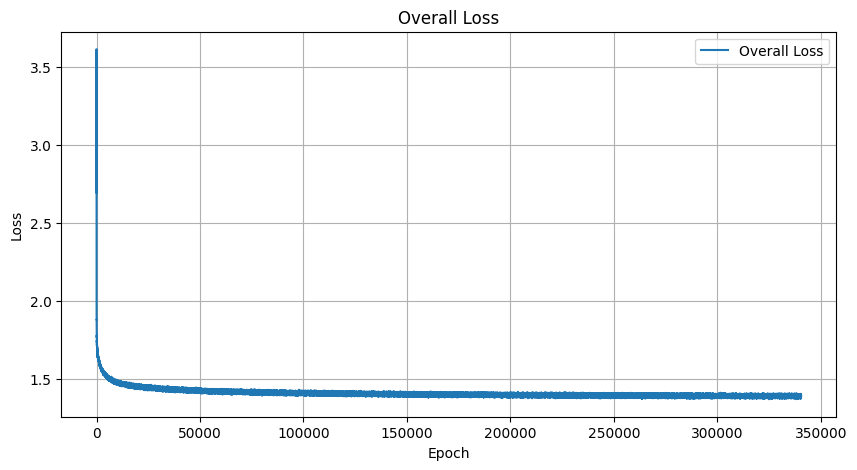

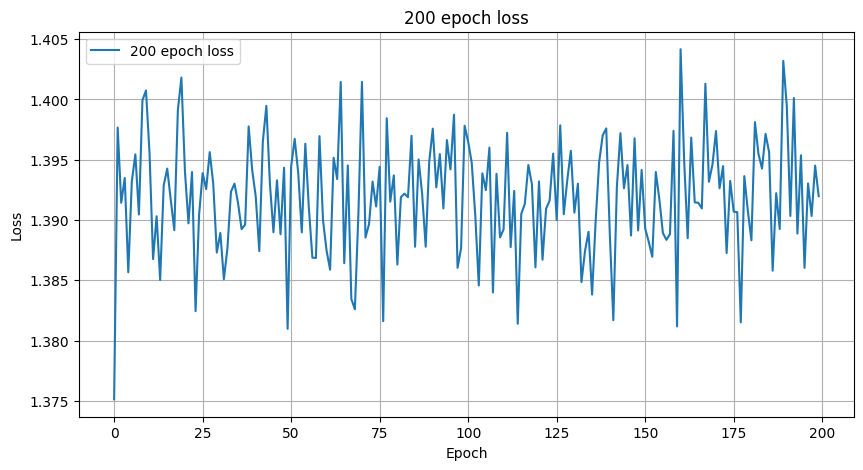

Epoch [1801201], Loss: 1.3832
Epoch [1801202], Loss: 1.3925
Epoch [1801203], Loss: 1.3934
Epoch [1801204], Loss: 1.3880
Epoch [1801205], Loss: 1.3892
Epoch [1801206], Loss: 1.3891
Epoch [1801207], Loss: 1.3949
Epoch [1801208], Loss: 1.3909
Epoch [1801209], Loss: 1.3790
Epoch [1801210], Loss: 1.3827
Epoch [1801211], Loss: 1.3845
Epoch [1801212], Loss: 1.3985
Epoch [1801213], Loss: 1.3900
Epoch [1801214], Loss: 1.3936
Epoch [1801215], Loss: 1.3953
Epoch [1801216], Loss: 1.3898
Epoch [1801217], Loss: 1.3945
Epoch [1801218], Loss: 1.3933
Epoch [1801219], Loss: 1.3945
Epoch [1801220], Loss: 1.3941
Epoch [1801221], Loss: 1.3942
Epoch [1801222], Loss: 1.3975
Epoch [1801223], Loss: 1.3911
Epoch [1801224], Loss: 1.3861
Epoch [1801225], Loss: 1.3968
Epoch [1801226], Loss: 1.3881
Epoch [1801227], Loss: 1.3872
Epoch [1801228], Loss: 1.3922
Epoch [1801229], Loss: 1.3960
Epoch [1801230], Loss: 1.3989
Epoch [1801231], Loss: 1.3982
Epoch [1801232], Loss: 1.3912
Epoch [1801233], Loss: 1.3908
Epoch [180

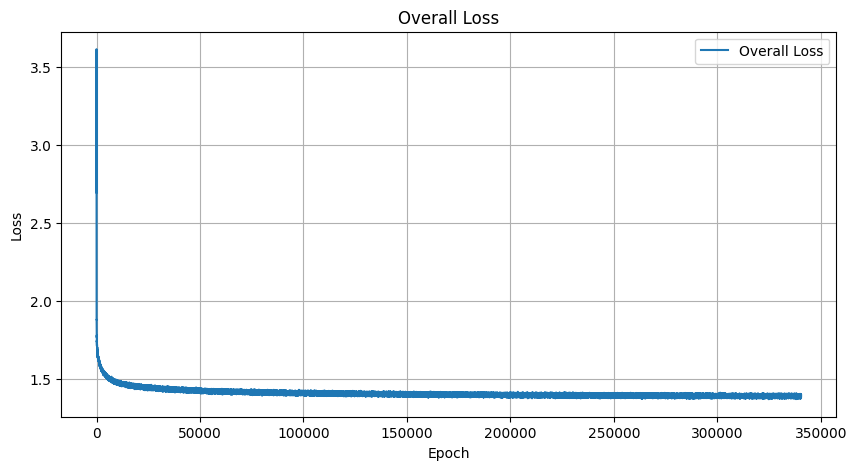

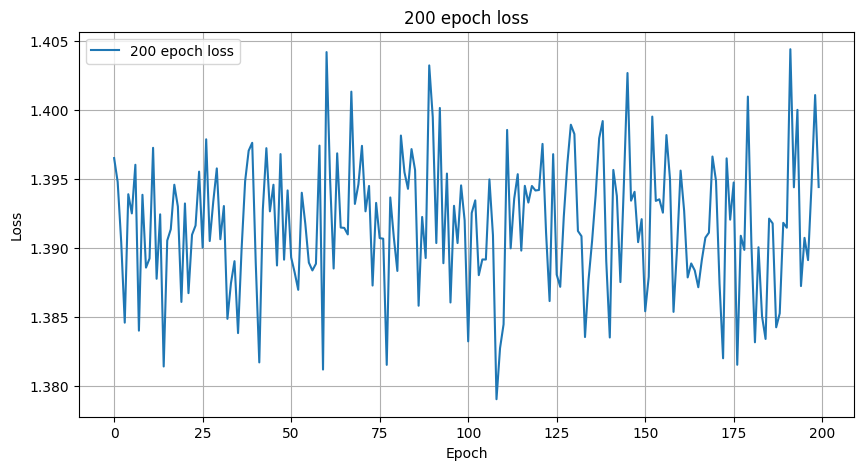

Epoch [1801301], Loss: 1.3985
Epoch [1801302], Loss: 1.3921
Epoch [1801303], Loss: 1.3931
Epoch [1801304], Loss: 1.3899
Epoch [1801305], Loss: 1.3949
Epoch [1801306], Loss: 1.4006
Epoch [1801307], Loss: 1.3954
Epoch [1801308], Loss: 1.3837
Epoch [1801309], Loss: 1.3906
Epoch [1801310], Loss: 1.3894
Epoch [1801311], Loss: 1.3936
Epoch [1801312], Loss: 1.3989
Epoch [1801313], Loss: 1.3927
Epoch [1801314], Loss: 1.3927
Epoch [1801315], Loss: 1.3915
Epoch [1801316], Loss: 1.3924
Epoch [1801317], Loss: 1.4015
Epoch [1801318], Loss: 1.3900
Epoch [1801319], Loss: 1.4002
Epoch [1801320], Loss: 1.3923
Epoch [1801321], Loss: 1.3885
Epoch [1801322], Loss: 1.4034
Epoch [1801323], Loss: 1.3977
Epoch [1801324], Loss: 1.3826
Epoch [1801325], Loss: 1.3964
Epoch [1801326], Loss: 1.3894
Epoch [1801327], Loss: 1.3878
Epoch [1801328], Loss: 1.3885
Epoch [1801329], Loss: 1.3944
Epoch [1801330], Loss: 1.3812
Epoch [1801331], Loss: 1.3897
Epoch [1801332], Loss: 1.3944
Epoch [1801333], Loss: 1.3926
Epoch [180

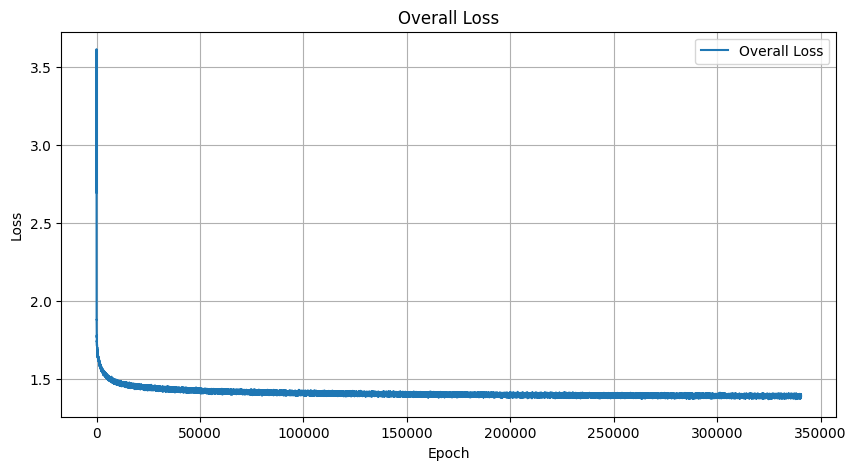

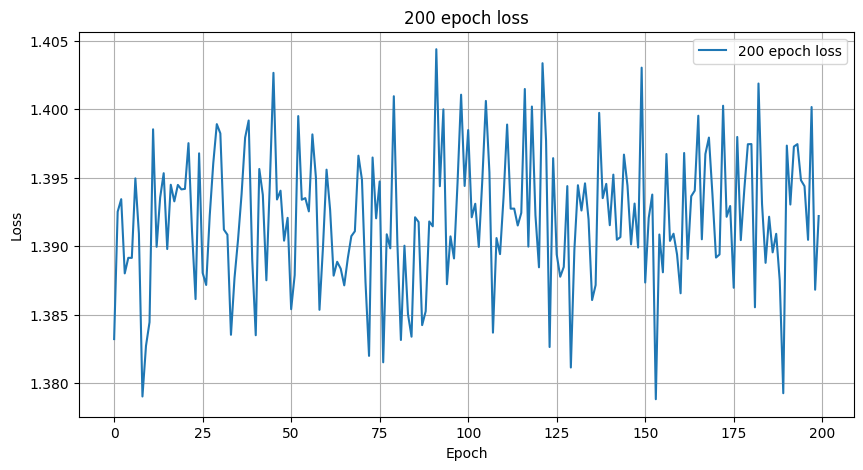

Epoch [1801401], Loss: 1.3974
Epoch [1801402], Loss: 1.3926
Epoch [1801403], Loss: 1.3912
Epoch [1801404], Loss: 1.4040
Epoch [1801405], Loss: 1.3958
Epoch [1801406], Loss: 1.3898
Epoch [1801407], Loss: 1.3896
Epoch [1801408], Loss: 1.3915
Epoch [1801409], Loss: 1.3896
Epoch [1801410], Loss: 1.3958
Epoch [1801411], Loss: 1.3934
Epoch [1801412], Loss: 1.3977
Epoch [1801413], Loss: 1.3928
Epoch [1801414], Loss: 1.4000
Epoch [1801415], Loss: 1.3916
Epoch [1801416], Loss: 1.3854
Epoch [1801417], Loss: 1.3895
Epoch [1801418], Loss: 1.3972
Epoch [1801419], Loss: 1.3993
Epoch [1801420], Loss: 1.3888
Epoch [1801421], Loss: 1.3867
Epoch [1801422], Loss: 1.3925
Epoch [1801423], Loss: 1.3911
Epoch [1801424], Loss: 1.3845
Epoch [1801425], Loss: 1.3894
Epoch [1801426], Loss: 1.3920
Epoch [1801427], Loss: 1.3930
Epoch [1801428], Loss: 1.3980
Epoch [1801429], Loss: 1.3904
Epoch [1801430], Loss: 1.3915
Epoch [1801431], Loss: 1.3912
Epoch [1801432], Loss: 1.3902
Epoch [1801433], Loss: 1.3932
Epoch [180

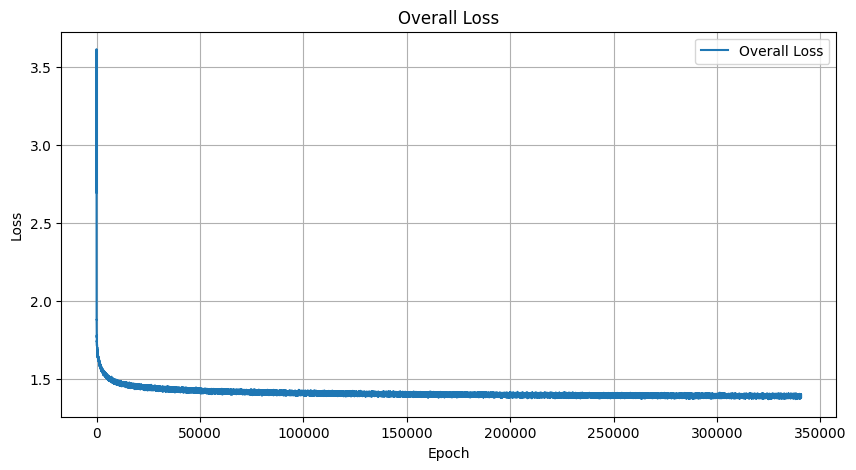

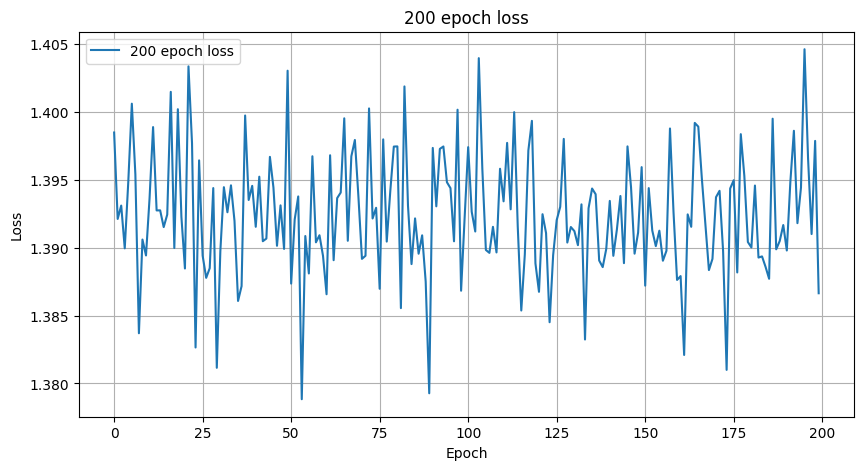

Epoch [1801501], Loss: 1.3966
Epoch [1801502], Loss: 1.3873
Epoch [1801503], Loss: 1.3810
Epoch [1801504], Loss: 1.3934
Epoch [1801505], Loss: 1.3949
Epoch [1801506], Loss: 1.3936
Epoch [1801507], Loss: 1.3865
Epoch [1801508], Loss: 1.3968
Epoch [1801509], Loss: 1.3871
Epoch [1801510], Loss: 1.3766
Epoch [1801511], Loss: 1.3908
Epoch [1801512], Loss: 1.3996
Epoch [1801513], Loss: 1.3912
Epoch [1801514], Loss: 1.3919
Epoch [1801515], Loss: 1.3974
Epoch [1801516], Loss: 1.3971
Epoch [1801517], Loss: 1.3870
Epoch [1801518], Loss: 1.3903
Epoch [1801519], Loss: 1.3947
Epoch [1801520], Loss: 1.4031
Epoch [1801521], Loss: 1.3909
Epoch [1801522], Loss: 1.3945
Epoch [1801523], Loss: 1.3899
Epoch [1801524], Loss: 1.3950
Epoch [1801525], Loss: 1.3843
Epoch [1801526], Loss: 1.3860
Epoch [1801527], Loss: 1.3982
Epoch [1801528], Loss: 1.4012
Epoch [1801529], Loss: 1.3982
Epoch [1801530], Loss: 1.3962
Epoch [1801531], Loss: 1.3863
Epoch [1801532], Loss: 1.3874
Epoch [1801533], Loss: 1.3983
Epoch [180

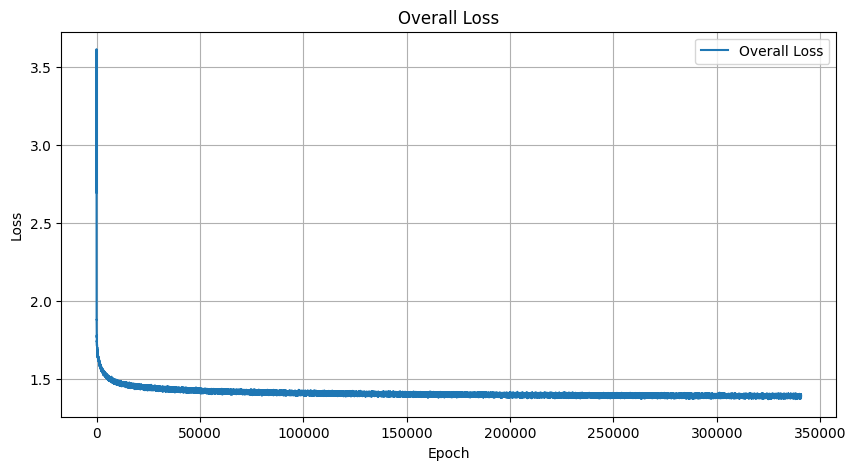

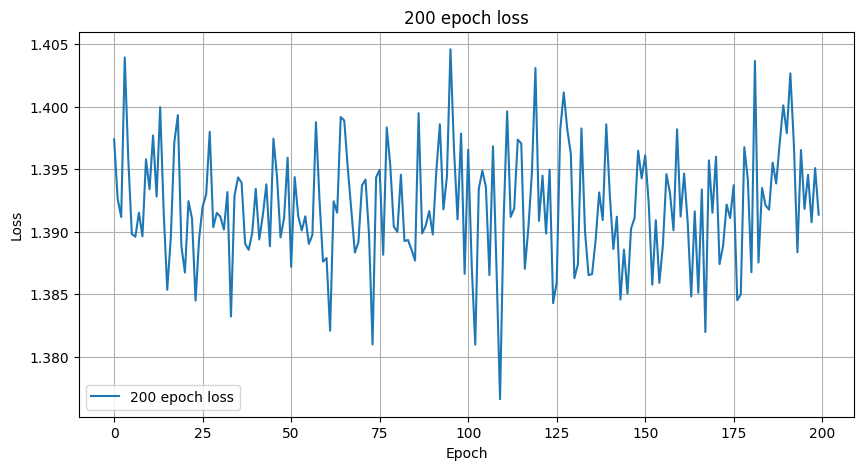

Epoch [1801601], Loss: 1.3957
Epoch [1801602], Loss: 1.3905
Epoch [1801603], Loss: 1.3886
Epoch [1801604], Loss: 1.3911
Epoch [1801605], Loss: 1.3909
Epoch [1801606], Loss: 1.3967
Epoch [1801607], Loss: 1.3904
Epoch [1801608], Loss: 1.3930
Epoch [1801609], Loss: 1.3895
Epoch [1801610], Loss: 1.3835
Epoch [1801611], Loss: 1.3927
Epoch [1801612], Loss: 1.3839
Epoch [1801613], Loss: 1.3959
Epoch [1801614], Loss: 1.3979
Epoch [1801615], Loss: 1.3962
Epoch [1801616], Loss: 1.3889
Epoch [1801617], Loss: 1.3994
Epoch [1801618], Loss: 1.3949
Epoch [1801619], Loss: 1.3948
Epoch [1801620], Loss: 1.3925
Epoch [1801621], Loss: 1.3870
Epoch [1801622], Loss: 1.3958
Epoch [1801623], Loss: 1.3753
Epoch [1801624], Loss: 1.3938
Epoch [1801625], Loss: 1.3865
Epoch [1801626], Loss: 1.4010
Epoch [1801627], Loss: 1.3892
Epoch [1801628], Loss: 1.3871
Epoch [1801629], Loss: 1.3912
Epoch [1801630], Loss: 1.3982
Epoch [1801631], Loss: 1.3922
Epoch [1801632], Loss: 1.3962
Epoch [1801633], Loss: 1.3997
Epoch [180

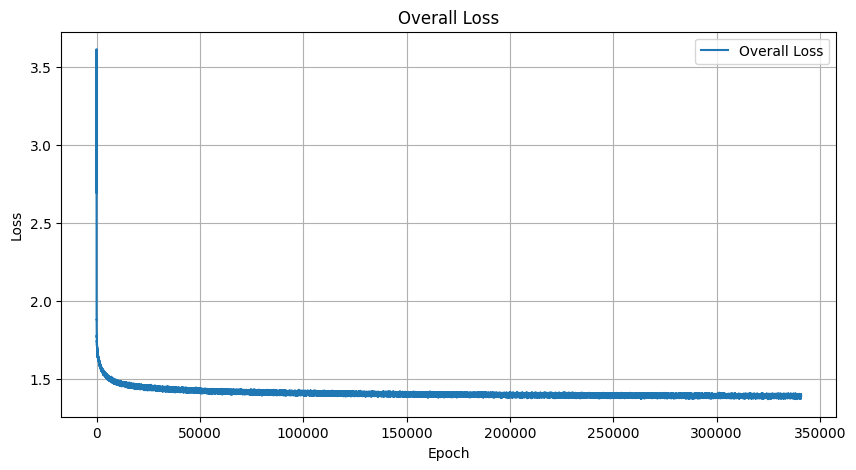

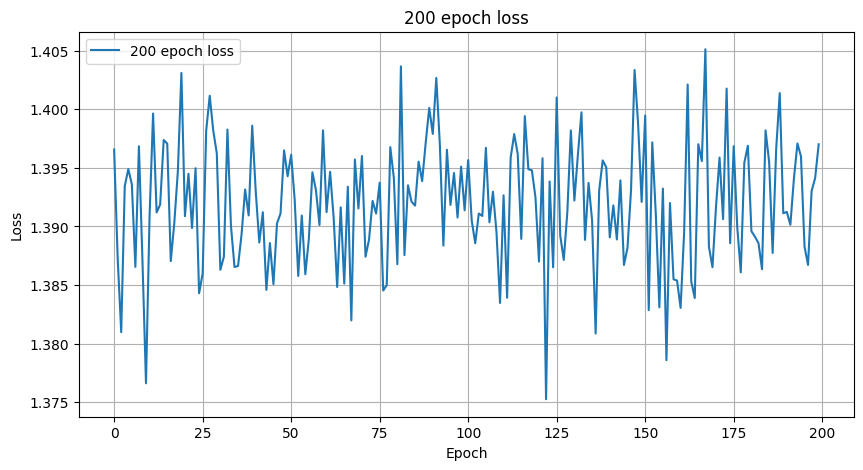

Epoch [1801701], Loss: 1.3901
Epoch [1801702], Loss: 1.3993
Epoch [1801703], Loss: 1.3946
Epoch [1801704], Loss: 1.3841
Epoch [1801705], Loss: 1.3902
Epoch [1801706], Loss: 1.3902
Epoch [1801707], Loss: 1.3959
Epoch [1801708], Loss: 1.3939
Epoch [1801709], Loss: 1.3858
Epoch [1801710], Loss: 1.3883
Epoch [1801711], Loss: 1.3894
Epoch [1801712], Loss: 1.3849
Epoch [1801713], Loss: 1.3951
Epoch [1801714], Loss: 1.3954
Epoch [1801715], Loss: 1.3895
Epoch [1801716], Loss: 1.3930
Epoch [1801717], Loss: 1.3863
Epoch [1801718], Loss: 1.3940
Epoch [1801719], Loss: 1.3927
Epoch [1801720], Loss: 1.3954
Epoch [1801721], Loss: 1.3868
Epoch [1801722], Loss: 1.3955
Epoch [1801723], Loss: 1.3846
Epoch [1801724], Loss: 1.3890
Epoch [1801725], Loss: 1.3887
Epoch [1801726], Loss: 1.3922
Epoch [1801727], Loss: 1.3979
Epoch [1801728], Loss: 1.3907
Epoch [1801729], Loss: 1.3958
Epoch [1801730], Loss: 1.3923
Epoch [1801731], Loss: 1.3840
Epoch [1801732], Loss: 1.3951
Epoch [1801733], Loss: 1.3908
Epoch [180

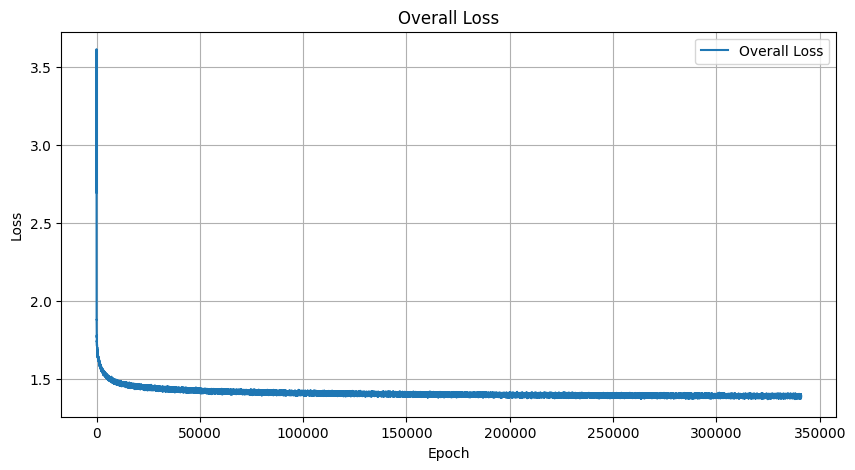

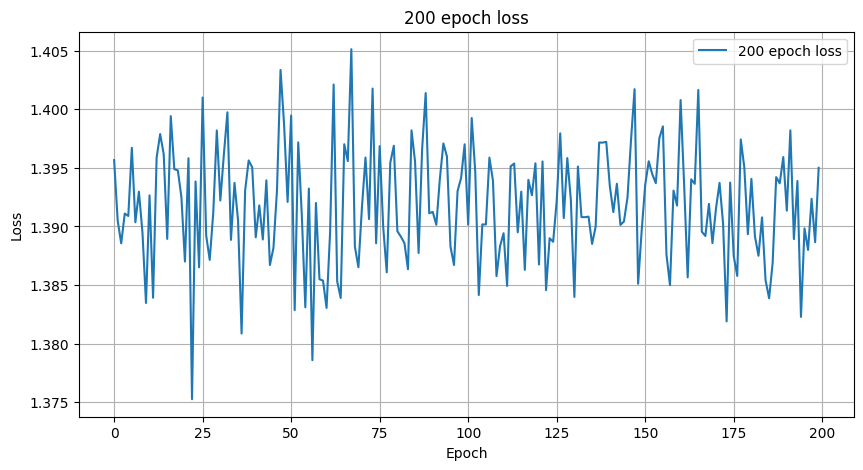

Epoch [1801801], Loss: 1.3970
Epoch [1801802], Loss: 1.3919
Epoch [1801803], Loss: 1.3908
Epoch [1801804], Loss: 1.3928
Epoch [1801805], Loss: 1.3870
Epoch [1801806], Loss: 1.3925
Epoch [1801807], Loss: 1.3965
Epoch [1801808], Loss: 1.3865
Epoch [1801809], Loss: 1.3990
Epoch [1801810], Loss: 1.3869
Epoch [1801811], Loss: 1.3948
Epoch [1801812], Loss: 1.3900
Epoch [1801813], Loss: 1.3971
Epoch [1801814], Loss: 1.3816
Epoch [1801815], Loss: 1.3970
Epoch [1801816], Loss: 1.3988
Epoch [1801817], Loss: 1.3849
Epoch [1801818], Loss: 1.3930
Epoch [1801819], Loss: 1.3951
Epoch [1801820], Loss: 1.3873
Epoch [1801821], Loss: 1.3901
Epoch [1801822], Loss: 1.3831
Epoch [1801823], Loss: 1.3955
Epoch [1801824], Loss: 1.3956
Epoch [1801825], Loss: 1.3845
Epoch [1801826], Loss: 1.3845
Epoch [1801827], Loss: 1.3971
Epoch [1801828], Loss: 1.3951
Epoch [1801829], Loss: 1.3878
Epoch [1801830], Loss: 1.3918
Epoch [1801831], Loss: 1.3926
Epoch [1801832], Loss: 1.3963
Epoch [1801833], Loss: 1.3914
Epoch [180

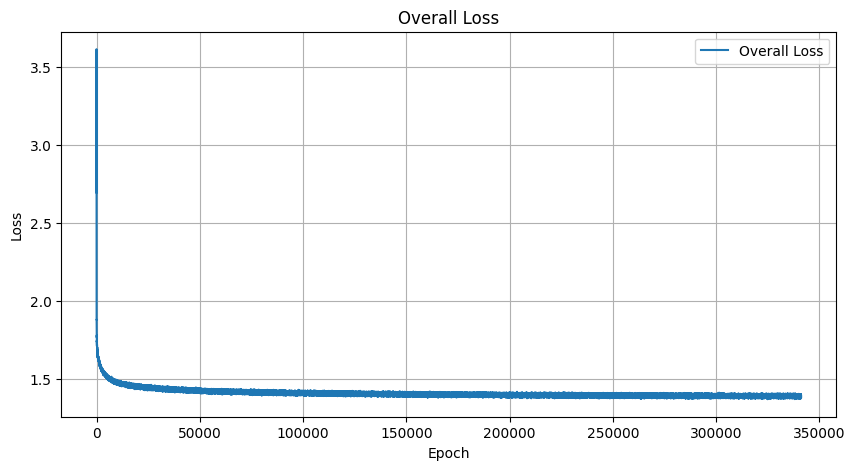

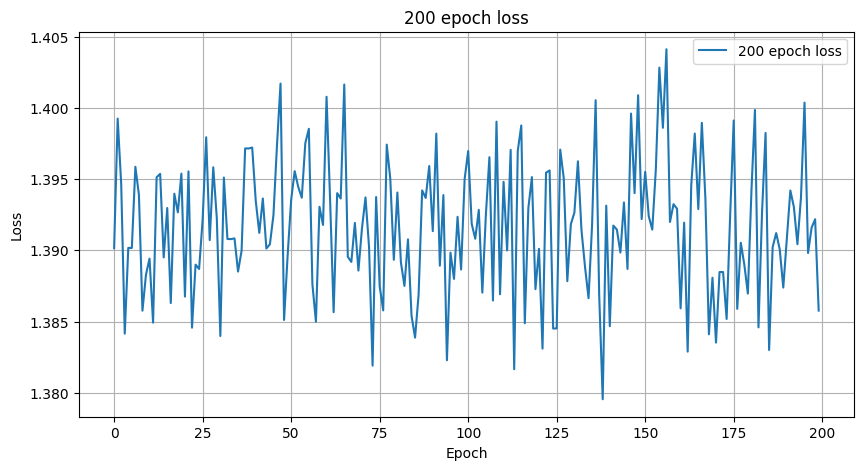

Epoch [1801901], Loss: 1.3950
Epoch [1801902], Loss: 1.3893
Epoch [1801903], Loss: 1.3939
Epoch [1801904], Loss: 1.3971
Epoch [1801905], Loss: 1.3956
Epoch [1801906], Loss: 1.3948
Epoch [1801907], Loss: 1.3868
Epoch [1801908], Loss: 1.3936
Epoch [1801909], Loss: 1.3944
Epoch [1801910], Loss: 1.3936
Epoch [1801911], Loss: 1.4040
Epoch [1801912], Loss: 1.3902
Epoch [1801913], Loss: 1.3902
Epoch [1801914], Loss: 1.3878
Epoch [1801915], Loss: 1.3891
Epoch [1801916], Loss: 1.3911
Epoch [1801917], Loss: 1.3991
Epoch [1801918], Loss: 1.3906
Epoch [1801919], Loss: 1.3901
Epoch [1801920], Loss: 1.3985
Epoch [1801921], Loss: 1.3947
Epoch [1801922], Loss: 1.4004
Epoch [1801923], Loss: 1.3823
Epoch [1801924], Loss: 1.3897
Epoch [1801925], Loss: 1.3876
Epoch [1801926], Loss: 1.3910
Epoch [1801927], Loss: 1.3867
Epoch [1801928], Loss: 1.3897
Epoch [1801929], Loss: 1.3911
Epoch [1801930], Loss: 1.3916
Epoch [1801931], Loss: 1.3985
Epoch [1801932], Loss: 1.3904
Epoch [1801933], Loss: 1.3956
Epoch [180

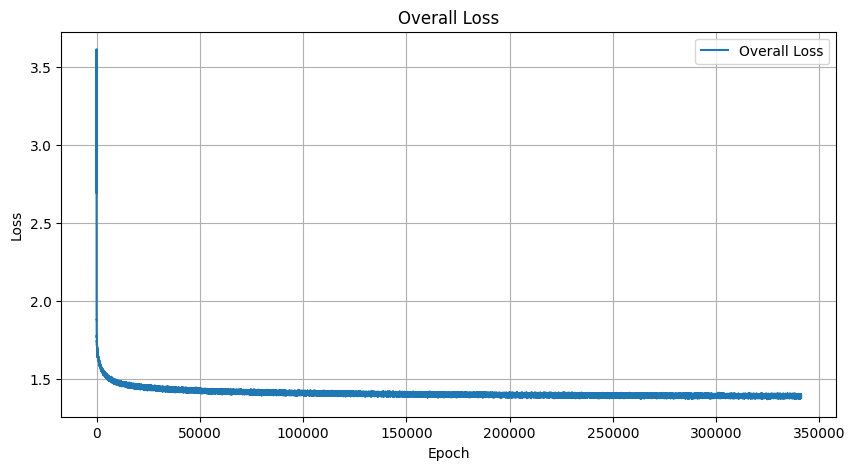

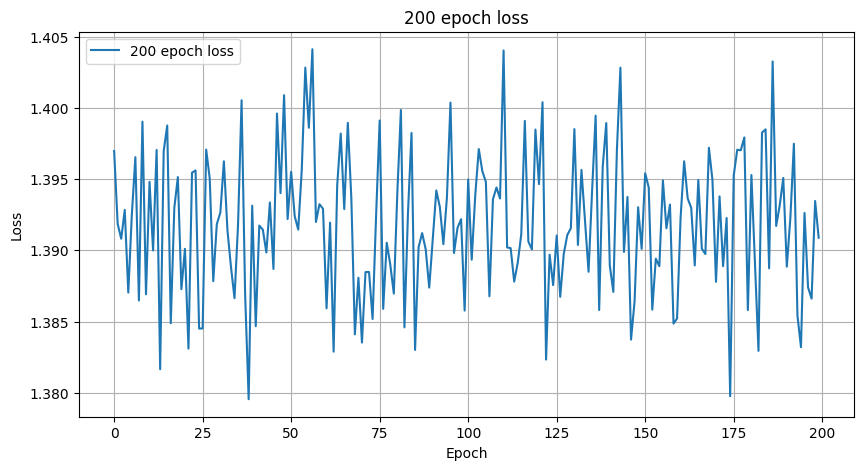

Epoch [1802001], Loss: 1.3954
Epoch [1802002], Loss: 1.3934
Epoch [1802003], Loss: 1.3908
Epoch [1802004], Loss: 1.3869
Epoch [1802005], Loss: 1.3978
Epoch [1802006], Loss: 1.3872
Epoch [1802007], Loss: 1.3834
Epoch [1802008], Loss: 1.3854
Epoch [1802009], Loss: 1.3986
Epoch [1802010], Loss: 1.3970
Epoch [1802011], Loss: 1.3912
Epoch [1802012], Loss: 1.3977
Epoch [1802013], Loss: 1.3921
Epoch [1802014], Loss: 1.3979
Epoch [1802015], Loss: 1.3927
Epoch [1802016], Loss: 1.3937
Epoch [1802017], Loss: 1.3856
Epoch [1802018], Loss: 1.3929
Epoch [1802019], Loss: 1.3914
Epoch [1802020], Loss: 1.3831
Epoch [1802021], Loss: 1.3937
Epoch [1802022], Loss: 1.3927
Epoch [1802023], Loss: 1.3938
Epoch [1802024], Loss: 1.3851
Epoch [1802025], Loss: 1.3949
Epoch [1802026], Loss: 1.3916
Epoch [1802027], Loss: 1.3958
Epoch [1802028], Loss: 1.3915
Epoch [1802029], Loss: 1.3968
Epoch [1802030], Loss: 1.3949
Epoch [1802031], Loss: 1.3956
Epoch [1802032], Loss: 1.3943
Epoch [1802033], Loss: 1.3910
Epoch [180

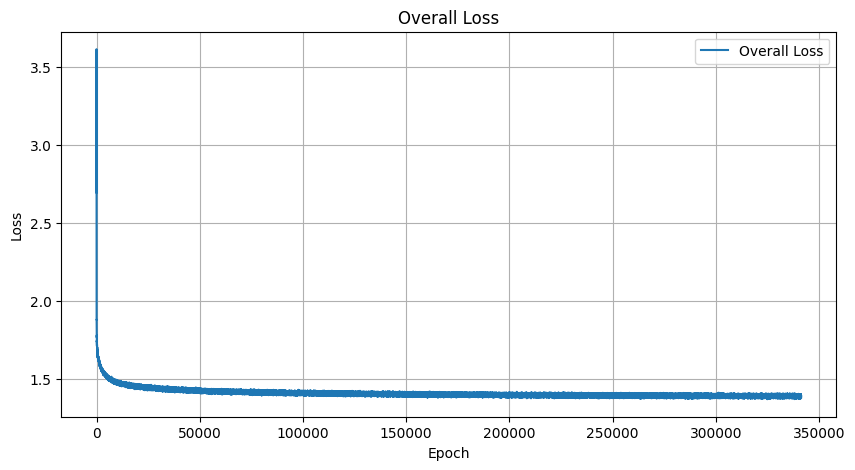

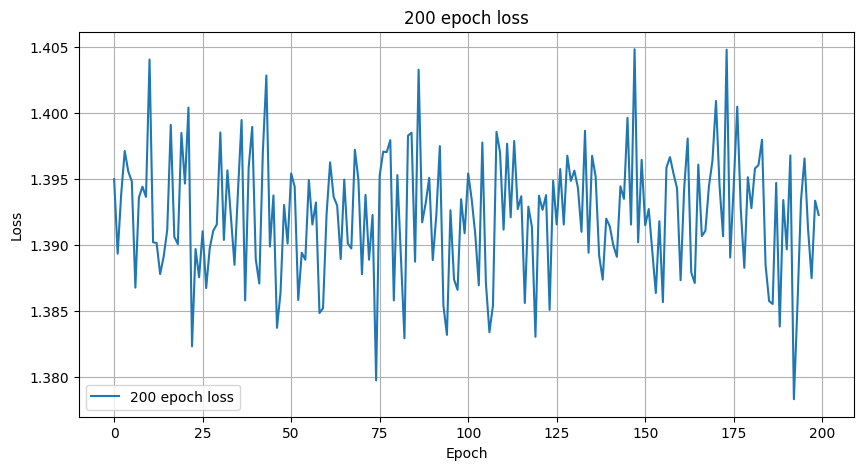

Epoch [1802101], Loss: 1.3891
Epoch [1802102], Loss: 1.3908
Epoch [1802103], Loss: 1.3940
Epoch [1802104], Loss: 1.3903
Epoch [1802105], Loss: 1.3904
Epoch [1802106], Loss: 1.3996
Epoch [1802107], Loss: 1.3801
Epoch [1802108], Loss: 1.3926
Epoch [1802109], Loss: 1.3846
Epoch [1802110], Loss: 1.3932
Epoch [1802111], Loss: 1.3874
Epoch [1802112], Loss: 1.3987
Epoch [1802113], Loss: 1.4038
Epoch [1802114], Loss: 1.3987
Epoch [1802115], Loss: 1.3899
Epoch [1802116], Loss: 1.3965
Epoch [1802117], Loss: 1.3915
Epoch [1802118], Loss: 1.3964
Epoch [1802119], Loss: 1.3940
Epoch [1802120], Loss: 1.3907
Epoch [1802121], Loss: 1.3945
Epoch [1802122], Loss: 1.3952
Epoch [1802123], Loss: 1.3940
Epoch [1802124], Loss: 1.3921
Epoch [1802125], Loss: 1.3872
Epoch [1802126], Loss: 1.3961
Epoch [1802127], Loss: 1.3860
Epoch [1802128], Loss: 1.3924
Epoch [1802129], Loss: 1.3878
Epoch [1802130], Loss: 1.3943
Epoch [1802131], Loss: 1.3881
Epoch [1802132], Loss: 1.3933
Epoch [1802133], Loss: 1.3944
Epoch [180

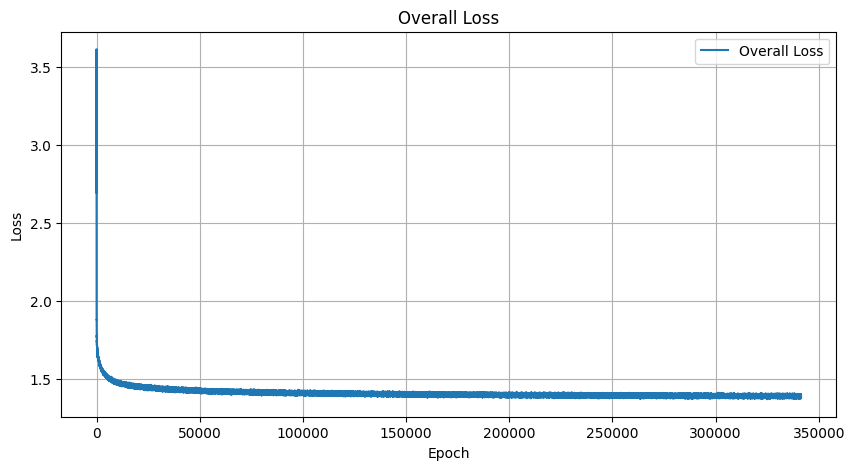

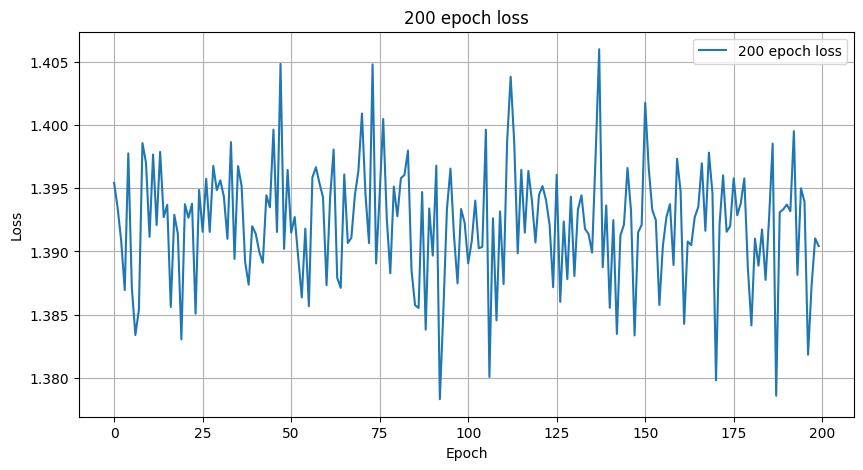

Epoch [1802201], Loss: 1.3936
Epoch [1802202], Loss: 1.3939
Epoch [1802203], Loss: 1.3848
Epoch [1802204], Loss: 1.3824
Epoch [1802205], Loss: 1.3909
Epoch [1802206], Loss: 1.3862
Epoch [1802207], Loss: 1.3873
Epoch [1802208], Loss: 1.3877
Epoch [1802209], Loss: 1.3915
Epoch [1802210], Loss: 1.3976
Epoch [1802211], Loss: 1.3999
Epoch [1802212], Loss: 1.3937
Epoch [1802213], Loss: 1.3968
Epoch [1802214], Loss: 1.3894
Epoch [1802215], Loss: 1.3936
Epoch [1802216], Loss: 1.3945
Epoch [1802217], Loss: 1.3975
Epoch [1802218], Loss: 1.3937
Epoch [1802219], Loss: 1.3993
Epoch [1802220], Loss: 1.3834
Epoch [1802221], Loss: 1.4009
Epoch [1802222], Loss: 1.3950
Epoch [1802223], Loss: 1.3895
Epoch [1802224], Loss: 1.3917
Epoch [1802225], Loss: 1.3872
Epoch [1802226], Loss: 1.3948
Epoch [1802227], Loss: 1.3896
Epoch [1802228], Loss: 1.3954
Epoch [1802229], Loss: 1.3992
Epoch [1802230], Loss: 1.3855
Epoch [1802231], Loss: 1.3958
Epoch [1802232], Loss: 1.3949
Epoch [1802233], Loss: 1.3965
Epoch [180

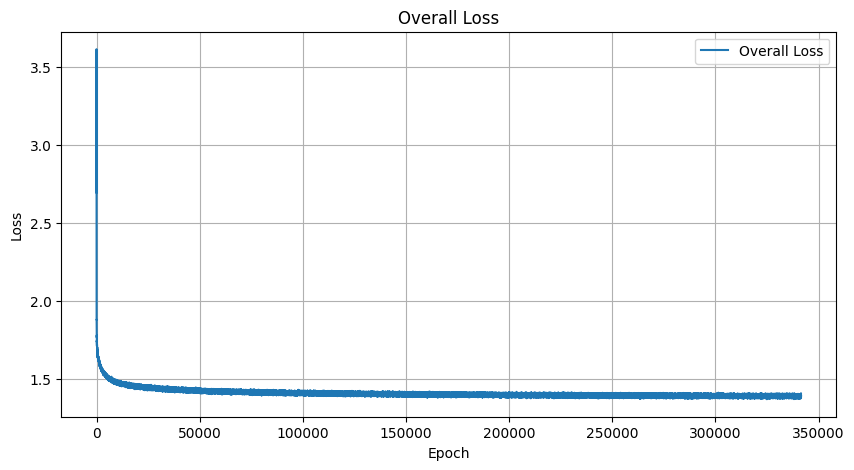

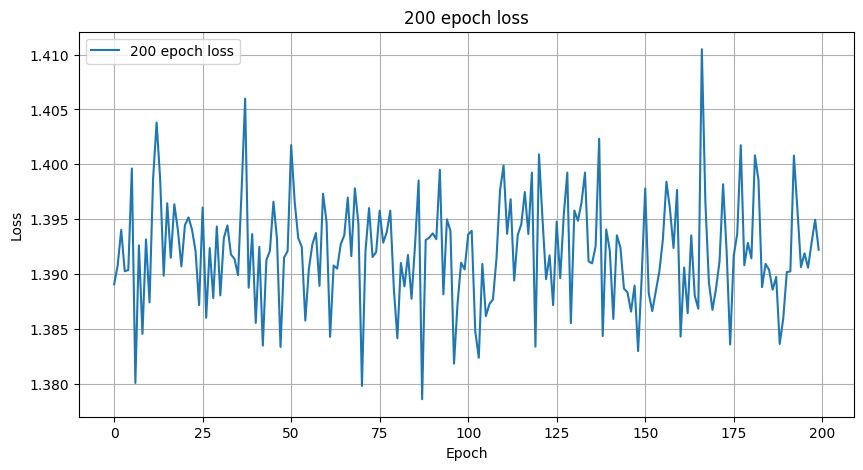

Epoch [1802301], Loss: 1.3901
Epoch [1802302], Loss: 1.3933
Epoch [1802303], Loss: 1.3878
Epoch [1802304], Loss: 1.3879
Epoch [1802305], Loss: 1.3965
Epoch [1802306], Loss: 1.3906
Epoch [1802307], Loss: 1.3937
Epoch [1802308], Loss: 1.3875
Epoch [1802309], Loss: 1.3933
Epoch [1802310], Loss: 1.3927
Epoch [1802311], Loss: 1.3887
Epoch [1802312], Loss: 1.3948
Epoch [1802313], Loss: 1.3885
Epoch [1802314], Loss: 1.3973
Epoch [1802315], Loss: 1.3904
Epoch [1802316], Loss: 1.3896
Epoch [1802317], Loss: 1.3864
Epoch [1802318], Loss: 1.3905
Epoch [1802319], Loss: 1.3830
Epoch [1802320], Loss: 1.3901
Epoch [1802321], Loss: 1.3945
Epoch [1802322], Loss: 1.3970
Epoch [1802323], Loss: 1.3860
Epoch [1802324], Loss: 1.3865
Epoch [1802325], Loss: 1.3880
Epoch [1802326], Loss: 1.3968
Epoch [1802327], Loss: 1.3847
Epoch [1802328], Loss: 1.3971
Epoch [1802329], Loss: 1.3872
Epoch [1802330], Loss: 1.3909
Epoch [1802331], Loss: 1.3896
Epoch [1802332], Loss: 1.3986
Epoch [1802333], Loss: 1.3890
Epoch [180

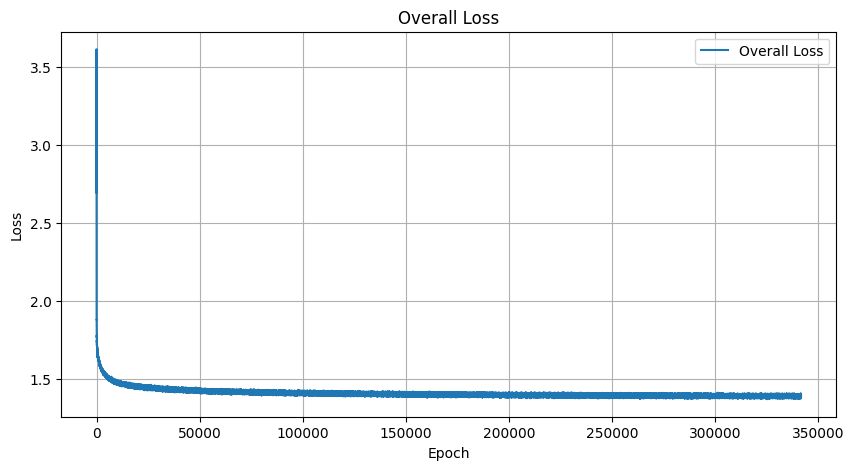

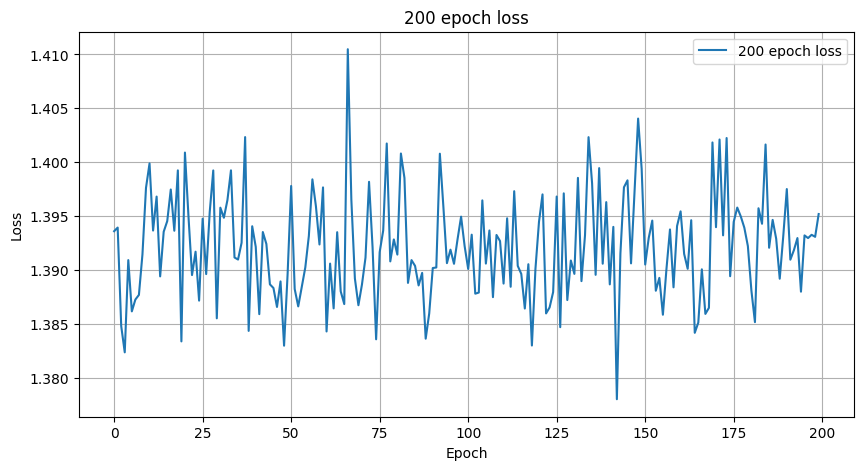

Epoch [1802401], Loss: 1.3985
Epoch [1802402], Loss: 1.3928
Epoch [1802403], Loss: 1.3870
Epoch [1802404], Loss: 1.3909
Epoch [1802405], Loss: 1.3963
Epoch [1802406], Loss: 1.3969
Epoch [1802407], Loss: 1.3901
Epoch [1802408], Loss: 1.3984
Epoch [1802409], Loss: 1.3900
Epoch [1802410], Loss: 1.3945
Epoch [1802411], Loss: 1.3930
Epoch [1802412], Loss: 1.3889
Epoch [1802413], Loss: 1.3959
Epoch [1802414], Loss: 1.3834
Epoch [1802415], Loss: 1.3895
Epoch [1802416], Loss: 1.3910
Epoch [1802417], Loss: 1.3920
Epoch [1802418], Loss: 1.3872
Epoch [1802419], Loss: 1.3949
Epoch [1802420], Loss: 1.3863
Epoch [1802421], Loss: 1.3857
Epoch [1802422], Loss: 1.3962
Epoch [1802423], Loss: 1.3927
Epoch [1802424], Loss: 1.3937
Epoch [1802425], Loss: 1.3943
Epoch [1802426], Loss: 1.3865
Epoch [1802427], Loss: 1.4009
Epoch [1802428], Loss: 1.3933
Epoch [1802429], Loss: 1.3915
Epoch [1802430], Loss: 1.3903
Epoch [1802431], Loss: 1.3935
Epoch [1802432], Loss: 1.3869
Epoch [1802433], Loss: 1.3887
Epoch [180

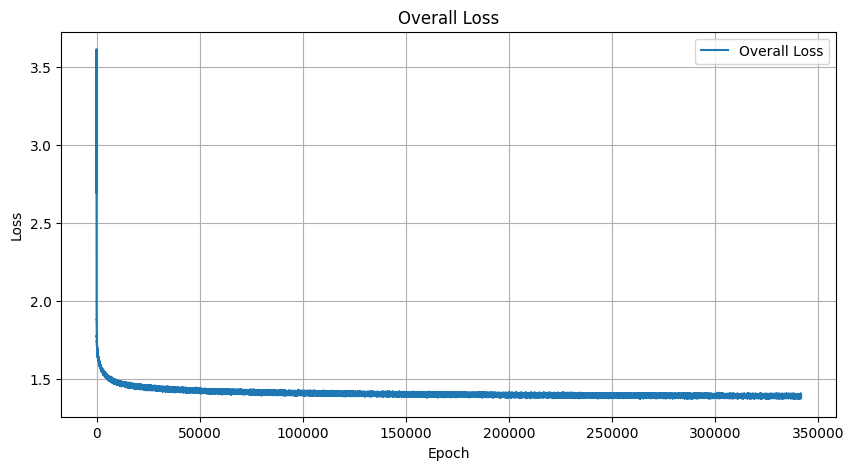

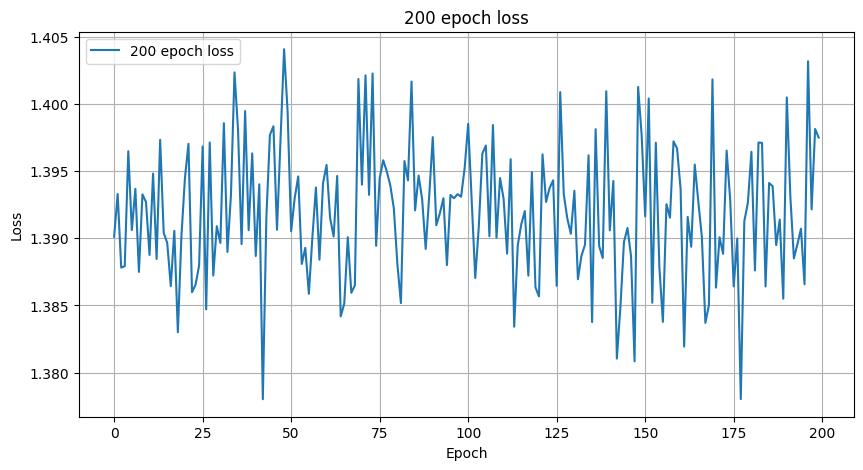

Epoch [1802501], Loss: 1.3866
Epoch [1802502], Loss: 1.3932
Epoch [1802503], Loss: 1.3947
Epoch [1802504], Loss: 1.3860
Epoch [1802505], Loss: 1.4004
Epoch [1802506], Loss: 1.3887
Epoch [1802507], Loss: 1.3955
Epoch [1802508], Loss: 1.3870
Epoch [1802509], Loss: 1.3896
Epoch [1802510], Loss: 1.3934
Epoch [1802511], Loss: 1.3885
Epoch [1802512], Loss: 1.3952
Epoch [1802513], Loss: 1.3907
Epoch [1802514], Loss: 1.3924
Epoch [1802515], Loss: 1.3868
Epoch [1802516], Loss: 1.3851
Epoch [1802517], Loss: 1.3875
Epoch [1802518], Loss: 1.3957
Epoch [1802519], Loss: 1.3903
Epoch [1802520], Loss: 1.3932
Epoch [1802521], Loss: 1.3821
Epoch [1802522], Loss: 1.3912
Epoch [1802523], Loss: 1.3897
Epoch [1802524], Loss: 1.3974
Epoch [1802525], Loss: 1.3892
Epoch [1802526], Loss: 1.3917
Epoch [1802527], Loss: 1.3964
Epoch [1802528], Loss: 1.3993
Epoch [1802529], Loss: 1.3873
Epoch [1802530], Loss: 1.3900
Epoch [1802531], Loss: 1.3981
Epoch [1802532], Loss: 1.3907
Epoch [1802533], Loss: 1.3811
Epoch [180

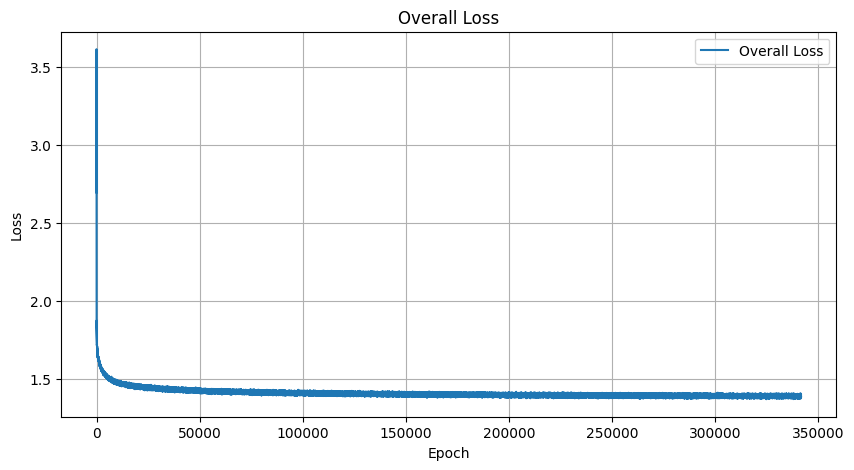

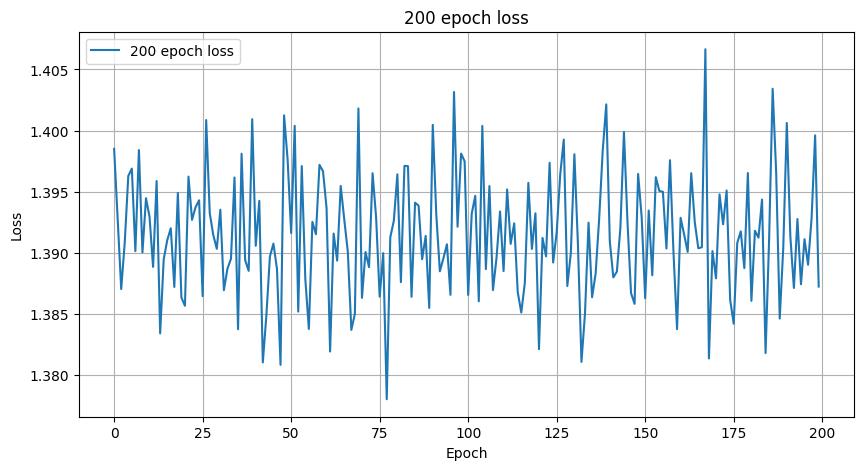

Epoch [1802601], Loss: 1.3945
Epoch [1802602], Loss: 1.3937
Epoch [1802603], Loss: 1.3911
Epoch [1802604], Loss: 1.3941
Epoch [1802605], Loss: 1.3895
Epoch [1802606], Loss: 1.3894
Epoch [1802607], Loss: 1.3927
Epoch [1802608], Loss: 1.3843
Epoch [1802609], Loss: 1.3855
Epoch [1802610], Loss: 1.3894
Epoch [1802611], Loss: 1.3946
Epoch [1802612], Loss: 1.3935
Epoch [1802613], Loss: 1.3993
Epoch [1802614], Loss: 1.3918
Epoch [1802615], Loss: 1.3984
Epoch [1802616], Loss: 1.3849
Epoch [1802617], Loss: 1.3956
Epoch [1802618], Loss: 1.3918
Epoch [1802619], Loss: 1.3920
Epoch [1802620], Loss: 1.4006
Epoch [1802621], Loss: 1.3979
Epoch [1802622], Loss: 1.3938
Epoch [1802623], Loss: 1.3942
Epoch [1802624], Loss: 1.3850
Epoch [1802625], Loss: 1.3937
Epoch [1802626], Loss: 1.3960
Epoch [1802627], Loss: 1.3907
Epoch [1802628], Loss: 1.3914
Epoch [1802629], Loss: 1.3984
Epoch [1802630], Loss: 1.3803
Epoch [1802631], Loss: 1.3993
Epoch [1802632], Loss: 1.3938
Epoch [1802633], Loss: 1.3951
Epoch [180

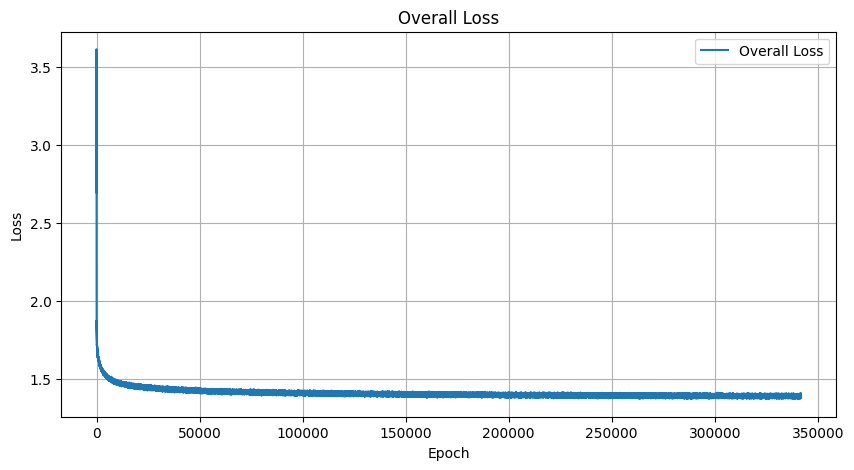

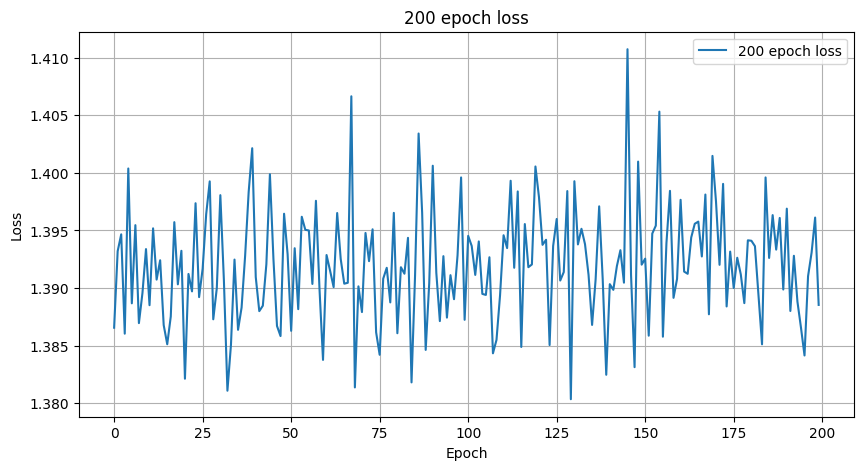

Epoch [1802701], Loss: 1.3902
Epoch [1802702], Loss: 1.3949
Epoch [1802703], Loss: 1.3861
Epoch [1802704], Loss: 1.3917
Epoch [1802705], Loss: 1.3946
Epoch [1802706], Loss: 1.3903
Epoch [1802707], Loss: 1.3940
Epoch [1802708], Loss: 1.3828
Epoch [1802709], Loss: 1.3828
Epoch [1802710], Loss: 1.3918
Epoch [1802711], Loss: 1.3926
Epoch [1802712], Loss: 1.3972
Epoch [1802713], Loss: 1.3916
Epoch [1802714], Loss: 1.3888
Epoch [1802715], Loss: 1.3943
Epoch [1802716], Loss: 1.3961
Epoch [1802717], Loss: 1.3897
Epoch [1802718], Loss: 1.4011
Epoch [1802719], Loss: 1.3882
Epoch [1802720], Loss: 1.3892
Epoch [1802721], Loss: 1.3966
Epoch [1802722], Loss: 1.3912
Epoch [1802723], Loss: 1.3840
Epoch [1802724], Loss: 1.3947
Epoch [1802725], Loss: 1.4007
Epoch [1802726], Loss: 1.3904
Epoch [1802727], Loss: 1.3872
Epoch [1802728], Loss: 1.3875
Epoch [1802729], Loss: 1.3966
Epoch [1802730], Loss: 1.3806
Epoch [1802731], Loss: 1.3927
Epoch [1802732], Loss: 1.3883
Epoch [1802733], Loss: 1.3868
Epoch [180

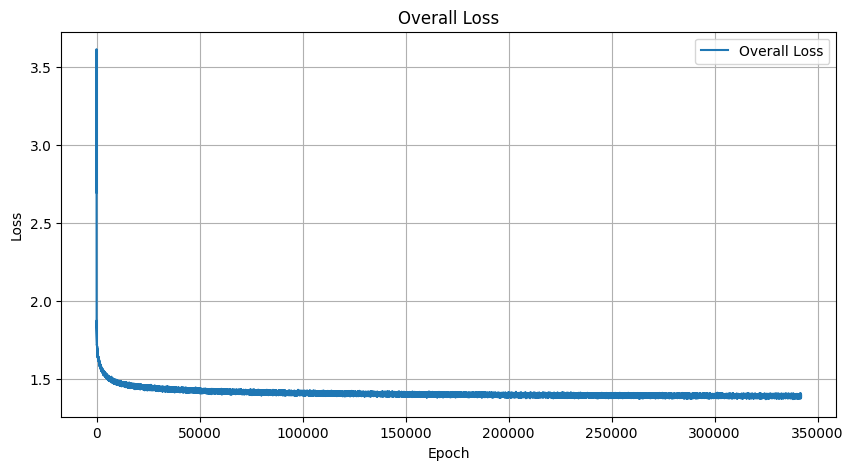

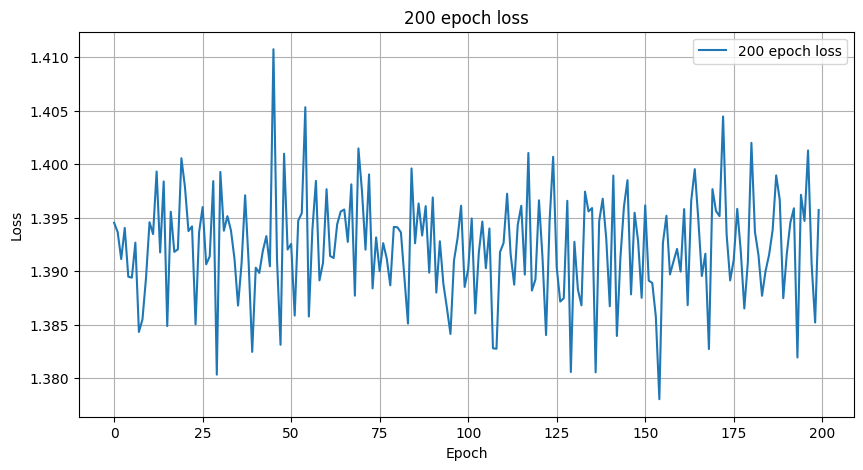

Epoch [1802801], Loss: 1.3915
Epoch [1802802], Loss: 1.3915
Epoch [1802803], Loss: 1.3873
Epoch [1802804], Loss: 1.3918
Epoch [1802805], Loss: 1.3973
Epoch [1802806], Loss: 1.4005
Epoch [1802807], Loss: 1.3846
Epoch [1802808], Loss: 1.3884
Epoch [1802809], Loss: 1.3896
Epoch [1802810], Loss: 1.3960
Epoch [1802811], Loss: 1.3919
Epoch [1802812], Loss: 1.3855
Epoch [1802813], Loss: 1.3970
Epoch [1802814], Loss: 1.3948
Epoch [1802815], Loss: 1.3932
Epoch [1802816], Loss: 1.3961
Epoch [1802817], Loss: 1.3896
Epoch [1802818], Loss: 1.3985
Epoch [1802819], Loss: 1.3927
Epoch [1802820], Loss: 1.3822
Epoch [1802821], Loss: 1.3905
Epoch [1802822], Loss: 1.3932
Epoch [1802823], Loss: 1.3926
Epoch [1802824], Loss: 1.3904
Epoch [1802825], Loss: 1.3828
Epoch [1802826], Loss: 1.3947
Epoch [1802827], Loss: 1.3907
Epoch [1802828], Loss: 1.3914
Epoch [1802829], Loss: 1.3878
Epoch [1802830], Loss: 1.3914
Epoch [1802831], Loss: 1.3977
Epoch [1802832], Loss: 1.3919
Epoch [1802833], Loss: 1.3966
Epoch [180

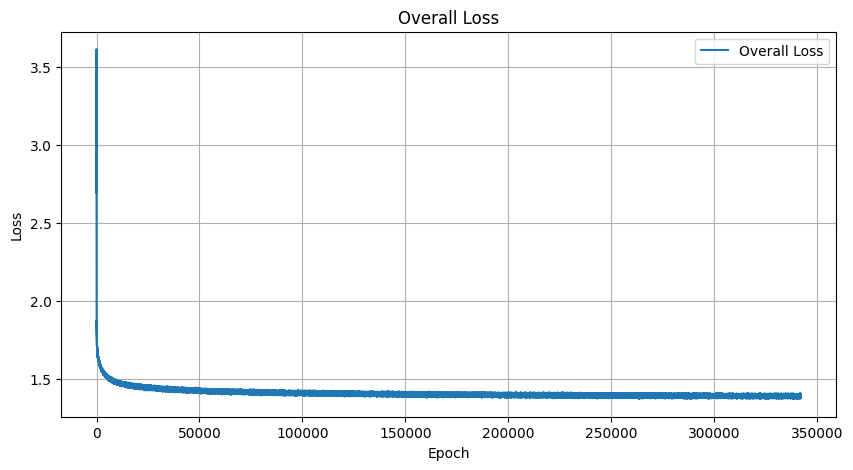

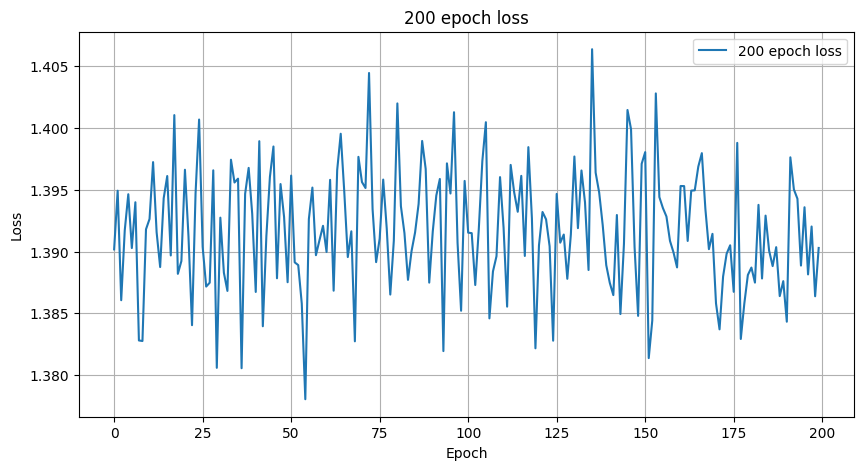

Epoch [1802901], Loss: 1.4021
Epoch [1802902], Loss: 1.3782
Epoch [1802903], Loss: 1.3936
Epoch [1802904], Loss: 1.3920
Epoch [1802905], Loss: 1.3906
Epoch [1802906], Loss: 1.3930
Epoch [1802907], Loss: 1.3923
Epoch [1802908], Loss: 1.3909
Epoch [1802909], Loss: 1.3881
Epoch [1802910], Loss: 1.3853
Epoch [1802911], Loss: 1.3882
Epoch [1802912], Loss: 1.3876
Epoch [1802913], Loss: 1.3884
Epoch [1802914], Loss: 1.3981
Epoch [1802915], Loss: 1.3897
Epoch [1802916], Loss: 1.3870
Epoch [1802917], Loss: 1.3954
Epoch [1802918], Loss: 1.3922
Epoch [1802919], Loss: 1.3830
Epoch [1802920], Loss: 1.3914
Epoch [1802921], Loss: 1.3923
Epoch [1802922], Loss: 1.3887
Epoch [1802923], Loss: 1.3980
Epoch [1802924], Loss: 1.3865
Epoch [1802925], Loss: 1.4044
Epoch [1802926], Loss: 1.3959
Epoch [1802927], Loss: 1.3917
Epoch [1802928], Loss: 1.3973
Epoch [1802929], Loss: 1.3825
Epoch [1802930], Loss: 1.3840
Epoch [1802931], Loss: 1.3939
Epoch [1802932], Loss: 1.3940
Epoch [1802933], Loss: 1.3981
Epoch [180

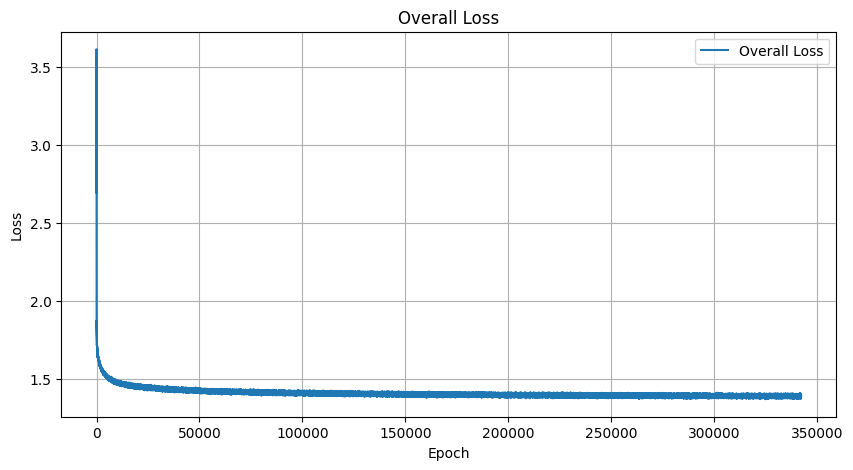

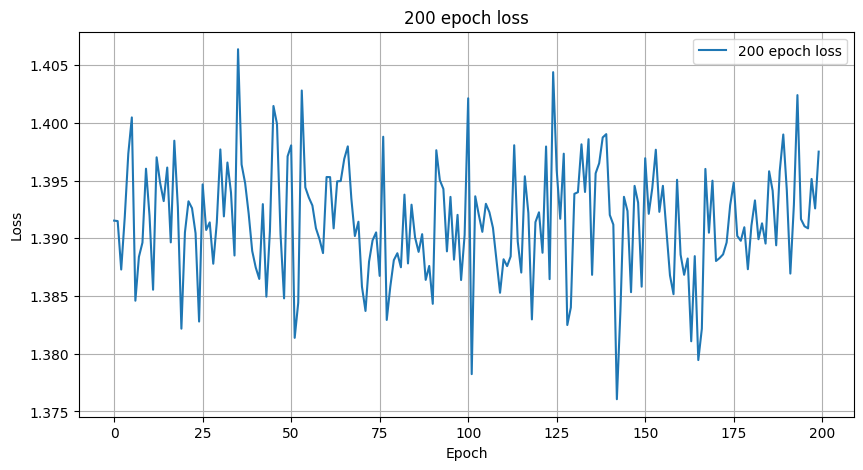

Epoch [1803001], Loss: 1.3972
Epoch [1803002], Loss: 1.3968
Epoch [1803003], Loss: 1.3893
Epoch [1803004], Loss: 1.3899
Epoch [1803005], Loss: 1.3926
Epoch [1803006], Loss: 1.3897
Epoch [1803007], Loss: 1.3958
Epoch [1803008], Loss: 1.4052
Epoch [1803009], Loss: 1.3920
Epoch [1803010], Loss: 1.3901
Epoch [1803011], Loss: 1.3965
Epoch [1803012], Loss: 1.3911
Epoch [1803013], Loss: 1.3899
Epoch [1803014], Loss: 1.3951
Epoch [1803015], Loss: 1.4011
Epoch [1803016], Loss: 1.3954
Epoch [1803017], Loss: 1.3919
Epoch [1803018], Loss: 1.3862
Epoch [1803019], Loss: 1.3935
Epoch [1803020], Loss: 1.3953
Epoch [1803021], Loss: 1.3986
Epoch [1803022], Loss: 1.3913
Epoch [1803023], Loss: 1.3870
Epoch [1803024], Loss: 1.3994
Epoch [1803025], Loss: 1.3981
Epoch [1803026], Loss: 1.3943
Epoch [1803027], Loss: 1.3941
Epoch [1803028], Loss: 1.3911
Epoch [1803029], Loss: 1.3891
Epoch [1803030], Loss: 1.3970
Epoch [1803031], Loss: 1.3950
Epoch [1803032], Loss: 1.3935
Epoch [1803033], Loss: 1.3922
Epoch [180

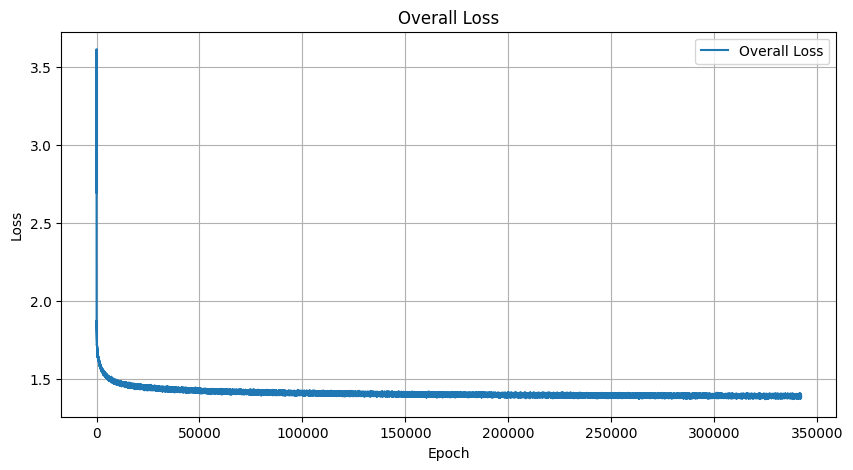

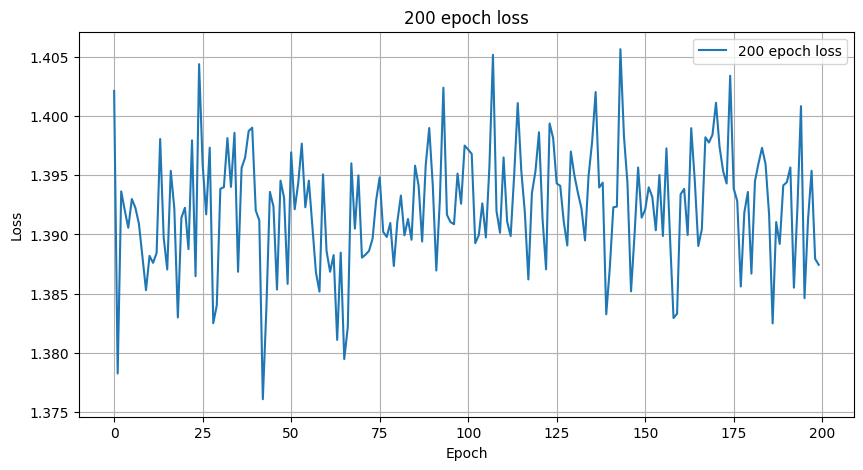

Epoch [1803101], Loss: 1.3933
Epoch [1803102], Loss: 1.3916
Epoch [1803103], Loss: 1.3987
Epoch [1803104], Loss: 1.3930
Epoch [1803105], Loss: 1.3876
Epoch [1803106], Loss: 1.3829
Epoch [1803107], Loss: 1.4030
Epoch [1803108], Loss: 1.3868
Epoch [1803109], Loss: 1.3928
Epoch [1803110], Loss: 1.3867
Epoch [1803111], Loss: 1.3922
Epoch [1803112], Loss: 1.3916
Epoch [1803113], Loss: 1.3990
Epoch [1803114], Loss: 1.3829
Epoch [1803115], Loss: 1.4004
Epoch [1803116], Loss: 1.3944
Epoch [1803117], Loss: 1.3841
Epoch [1803118], Loss: 1.3901
Epoch [1803119], Loss: 1.3892
Epoch [1803120], Loss: 1.3928
Epoch [1803121], Loss: 1.3924
Epoch [1803122], Loss: 1.4002
Epoch [1803123], Loss: 1.3847
Epoch [1803124], Loss: 1.3913
Epoch [1803125], Loss: 1.3981
Epoch [1803126], Loss: 1.3910
Epoch [1803127], Loss: 1.3874
Epoch [1803128], Loss: 1.3903
Epoch [1803129], Loss: 1.3956
Epoch [1803130], Loss: 1.3943
Epoch [1803131], Loss: 1.4004
Epoch [1803132], Loss: 1.3958
Epoch [1803133], Loss: 1.3888
Epoch [180

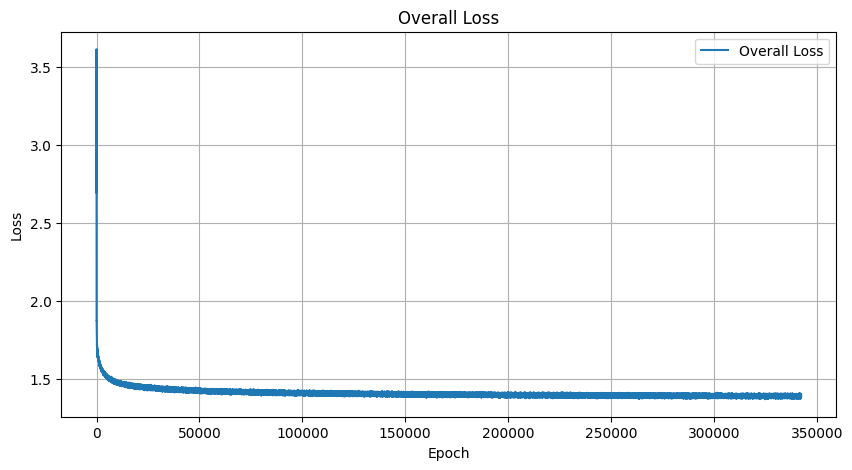

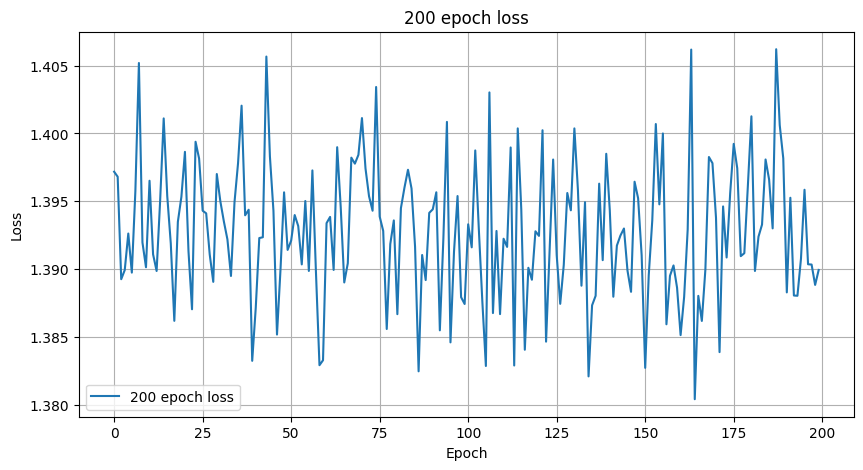

Epoch [1803201], Loss: 1.3918
Epoch [1803202], Loss: 1.3819
Epoch [1803203], Loss: 1.3987
Epoch [1803204], Loss: 1.3923
Epoch [1803205], Loss: 1.3999
Epoch [1803206], Loss: 1.4014
Epoch [1803207], Loss: 1.3923
Epoch [1803208], Loss: 1.3793
Epoch [1803209], Loss: 1.3956
Epoch [1803210], Loss: 1.3952
Epoch [1803211], Loss: 1.3795
Epoch [1803212], Loss: 1.3858
Epoch [1803213], Loss: 1.3881
Epoch [1803214], Loss: 1.4013
Epoch [1803215], Loss: 1.3944
Epoch [1803216], Loss: 1.3809
Epoch [1803217], Loss: 1.3933
Epoch [1803218], Loss: 1.3918
Epoch [1803219], Loss: 1.3949
Epoch [1803220], Loss: 1.4024
Epoch [1803221], Loss: 1.3909
Epoch [1803222], Loss: 1.3919
Epoch [1803223], Loss: 1.3904
Epoch [1803224], Loss: 1.3803
Epoch [1803225], Loss: 1.4014
Epoch [1803226], Loss: 1.3887
Epoch [1803227], Loss: 1.3938
Epoch [1803228], Loss: 1.3917
Epoch [1803229], Loss: 1.3878
Epoch [1803230], Loss: 1.3951
Epoch [1803231], Loss: 1.3950
Epoch [1803232], Loss: 1.3938
Epoch [1803233], Loss: 1.4019
Epoch [180

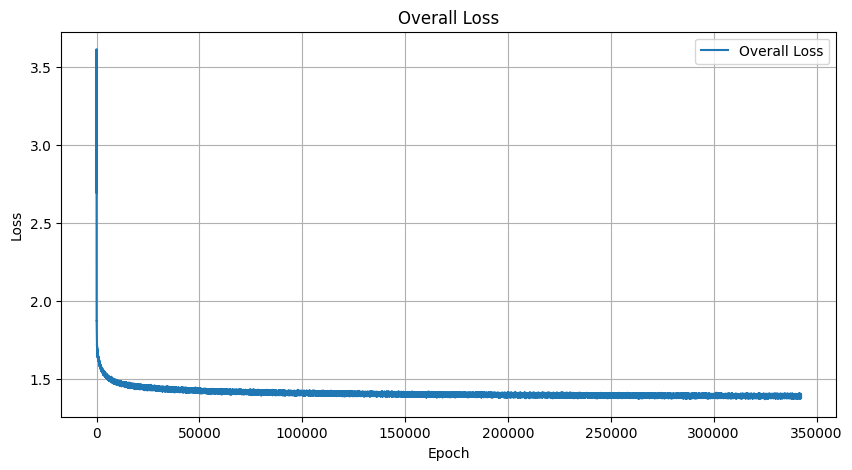

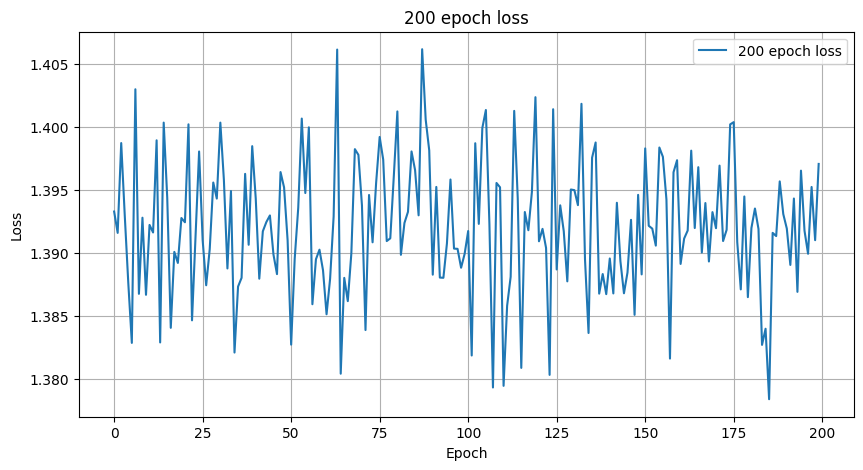

Epoch [1803301], Loss: 1.3871
Epoch [1803302], Loss: 1.3845
Epoch [1803303], Loss: 1.3819
Epoch [1803304], Loss: 1.3912
Epoch [1803305], Loss: 1.3923
Epoch [1803306], Loss: 1.3906
Epoch [1803307], Loss: 1.3930
Epoch [1803308], Loss: 1.3945
Epoch [1803309], Loss: 1.3873
Epoch [1803310], Loss: 1.4009
Epoch [1803311], Loss: 1.3841
Epoch [1803312], Loss: 1.3952
Epoch [1803313], Loss: 1.3920
Epoch [1803314], Loss: 1.3872
Epoch [1803315], Loss: 1.3971
Epoch [1803316], Loss: 1.3824
Epoch [1803317], Loss: 1.3810
Epoch [1803318], Loss: 1.3800
Epoch [1803319], Loss: 1.3907
Epoch [1803320], Loss: 1.3928
Epoch [1803321], Loss: 1.3995
Epoch [1803322], Loss: 1.3814
Epoch [1803323], Loss: 1.3899
Epoch [1803324], Loss: 1.3953
Epoch [1803325], Loss: 1.3873
Epoch [1803326], Loss: 1.3955
Epoch [1803327], Loss: 1.3986
Epoch [1803328], Loss: 1.3986
Epoch [1803329], Loss: 1.3889
Epoch [1803330], Loss: 1.3949
Epoch [1803331], Loss: 1.3962
Epoch [1803332], Loss: 1.3936
Epoch [1803333], Loss: 1.3897
Epoch [180

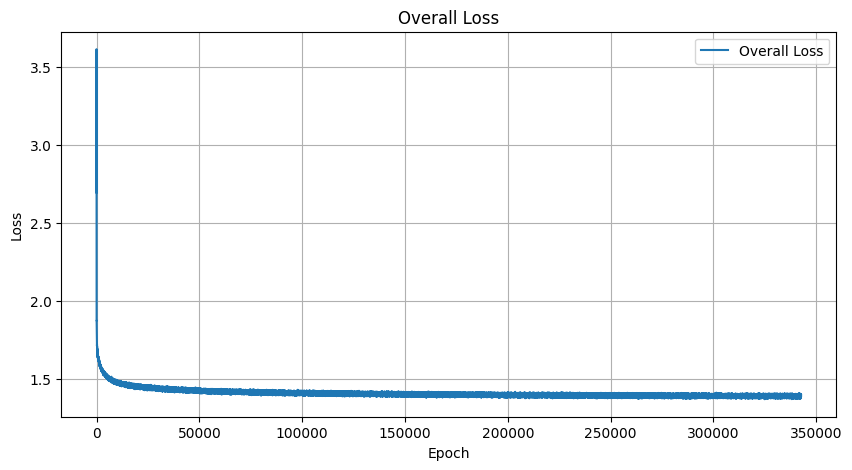

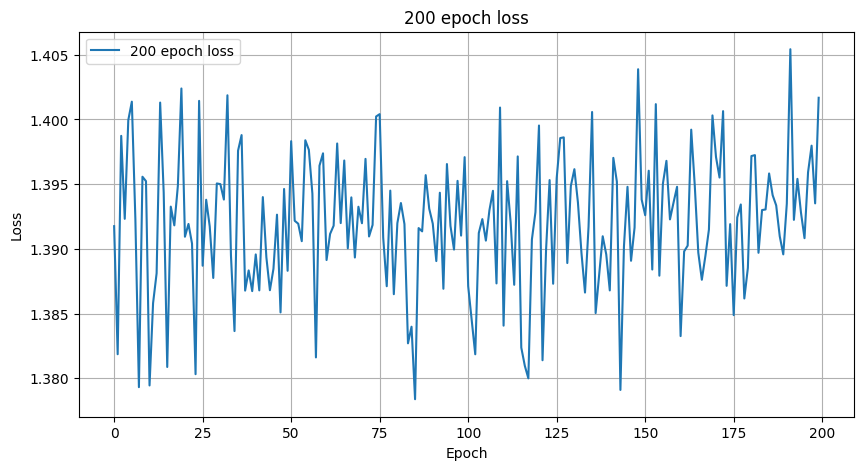

Epoch [1803401], Loss: 1.3843
Epoch [1803402], Loss: 1.3900
Epoch [1803403], Loss: 1.3879
Epoch [1803404], Loss: 1.3925
Epoch [1803405], Loss: 1.3947
Epoch [1803406], Loss: 1.3987
Epoch [1803407], Loss: 1.3873
Epoch [1803408], Loss: 1.3927
Epoch [1803409], Loss: 1.3893
Epoch [1803410], Loss: 1.4021
Epoch [1803411], Loss: 1.3827
Epoch [1803412], Loss: 1.3901
Epoch [1803413], Loss: 1.3942
Epoch [1803414], Loss: 1.4007
Epoch [1803415], Loss: 1.3957
Epoch [1803416], Loss: 1.3941
Epoch [1803417], Loss: 1.3937
Epoch [1803418], Loss: 1.3846
Epoch [1803419], Loss: 1.3901
Epoch [1803420], Loss: 1.3960
Epoch [1803421], Loss: 1.3874
Epoch [1803422], Loss: 1.4016
Epoch [1803423], Loss: 1.3885
Epoch [1803424], Loss: 1.3993
Epoch [1803425], Loss: 1.3937
Epoch [1803426], Loss: 1.3940
Epoch [1803427], Loss: 1.4052
Epoch [1803428], Loss: 1.3882
Epoch [1803429], Loss: 1.3902
Epoch [1803430], Loss: 1.3893
Epoch [1803431], Loss: 1.3890
Epoch [1803432], Loss: 1.3930
Epoch [1803433], Loss: 1.3907
Epoch [180

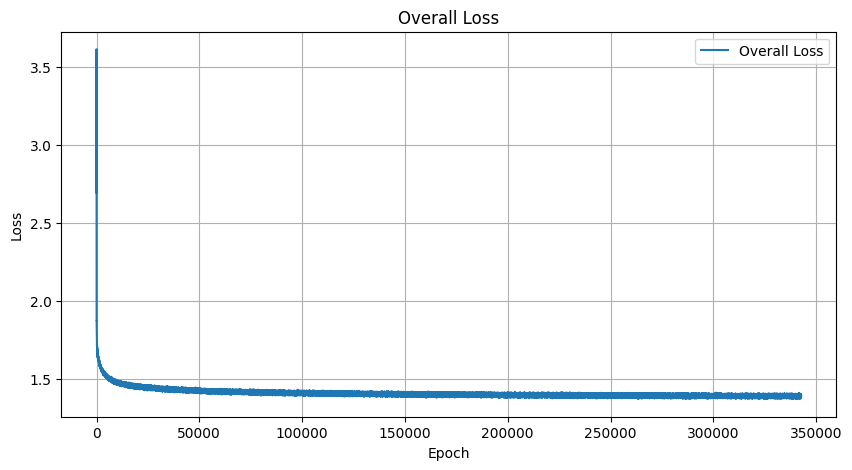

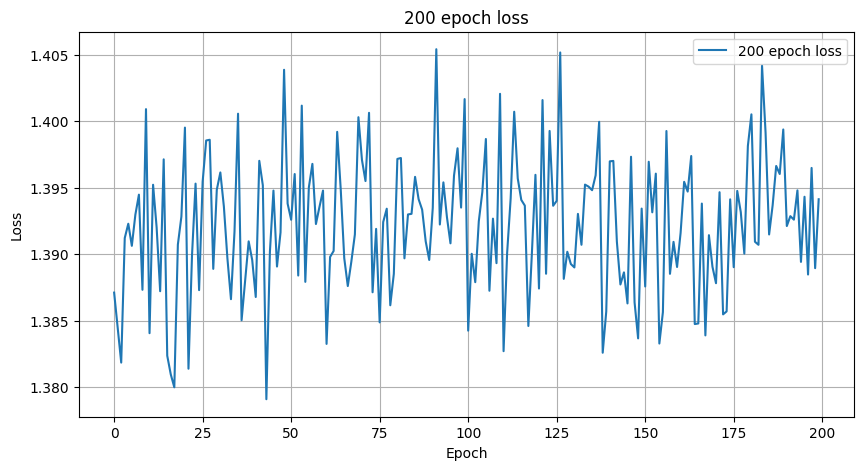

Epoch [1803501], Loss: 1.3894
Epoch [1803502], Loss: 1.3992
Epoch [1803503], Loss: 1.3963
Epoch [1803504], Loss: 1.3918
Epoch [1803505], Loss: 1.4011
Epoch [1803506], Loss: 1.3841
Epoch [1803507], Loss: 1.3963
Epoch [1803508], Loss: 1.3850
Epoch [1803509], Loss: 1.3896
Epoch [1803510], Loss: 1.3926
Epoch [1803511], Loss: 1.3960
Epoch [1803512], Loss: 1.3932
Epoch [1803513], Loss: 1.3963
Epoch [1803514], Loss: 1.3957
Epoch [1803515], Loss: 1.3954
Epoch [1803516], Loss: 1.3825
Epoch [1803517], Loss: 1.3933
Epoch [1803518], Loss: 1.3980
Epoch [1803519], Loss: 1.3941
Epoch [1803520], Loss: 1.3964
Epoch [1803521], Loss: 1.3830
Epoch [1803522], Loss: 1.3967
Epoch [1803523], Loss: 1.3967
Epoch [1803524], Loss: 1.3969
Epoch [1803525], Loss: 1.3985
Epoch [1803526], Loss: 1.3852
Epoch [1803527], Loss: 1.3968
Epoch [1803528], Loss: 1.3911
Epoch [1803529], Loss: 1.3836
Epoch [1803530], Loss: 1.3944
Epoch [1803531], Loss: 1.3954
Epoch [1803532], Loss: 1.3936
Epoch [1803533], Loss: 1.3887
Epoch [180

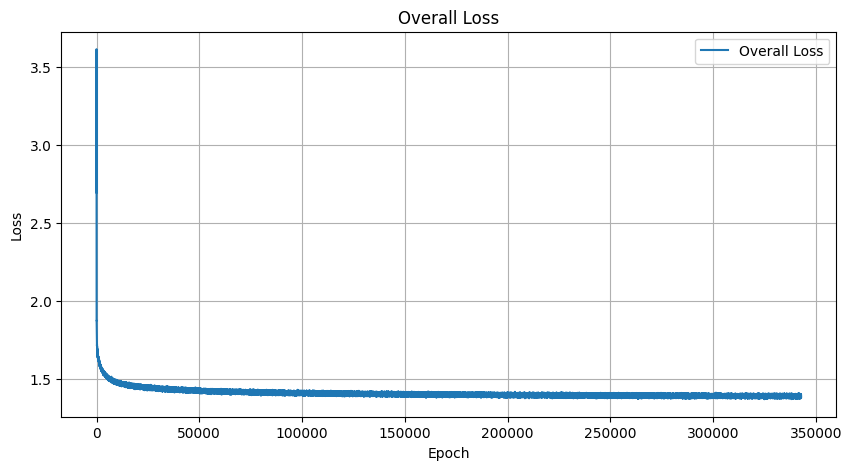

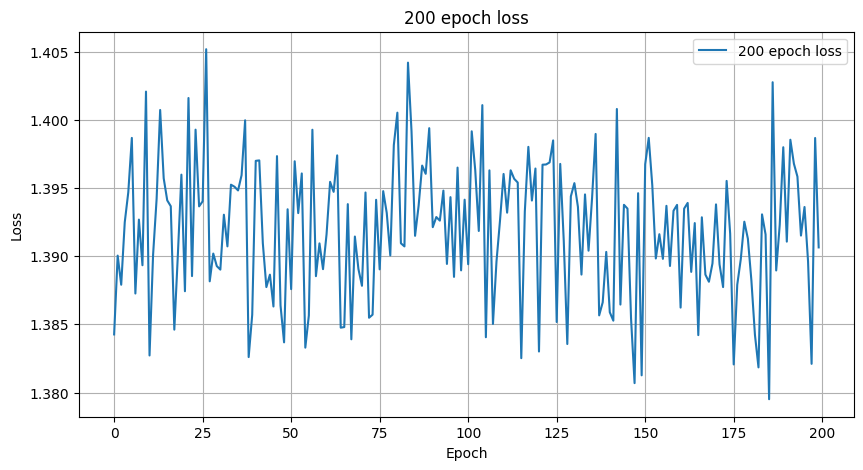

Epoch [1803601], Loss: 1.3979
Epoch [1803602], Loss: 1.3913
Epoch [1803603], Loss: 1.3917
Epoch [1803604], Loss: 1.4002
Epoch [1803605], Loss: 1.3859
Epoch [1803606], Loss: 1.3935
Epoch [1803607], Loss: 1.3843
Epoch [1803608], Loss: 1.3977
Epoch [1803609], Loss: 1.3901
Epoch [1803610], Loss: 1.3868
Epoch [1803611], Loss: 1.3980
Epoch [1803612], Loss: 1.3953
Epoch [1803613], Loss: 1.3866
Epoch [1803614], Loss: 1.3938
Epoch [1803615], Loss: 1.3982
Epoch [1803616], Loss: 1.3945
Epoch [1803617], Loss: 1.3913
Epoch [1803618], Loss: 1.3869
Epoch [1803619], Loss: 1.3859
Epoch [1803620], Loss: 1.4023
Epoch [1803621], Loss: 1.3946
Epoch [1803622], Loss: 1.3946
Epoch [1803623], Loss: 1.3879
Epoch [1803624], Loss: 1.3907
Epoch [1803625], Loss: 1.3970
Epoch [1803626], Loss: 1.3997
Epoch [1803627], Loss: 1.3900
Epoch [1803628], Loss: 1.3963
Epoch [1803629], Loss: 1.3866
Epoch [1803630], Loss: 1.3879
Epoch [1803631], Loss: 1.3992
Epoch [1803632], Loss: 1.4023
Epoch [1803633], Loss: 1.3995
Epoch [180

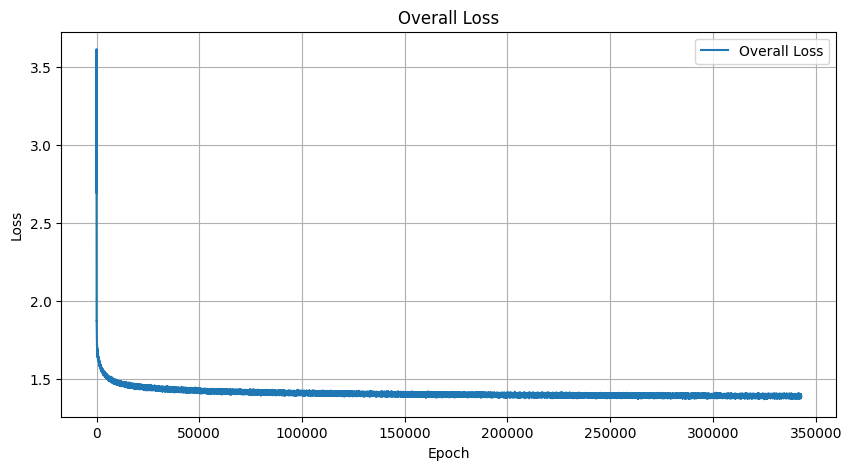

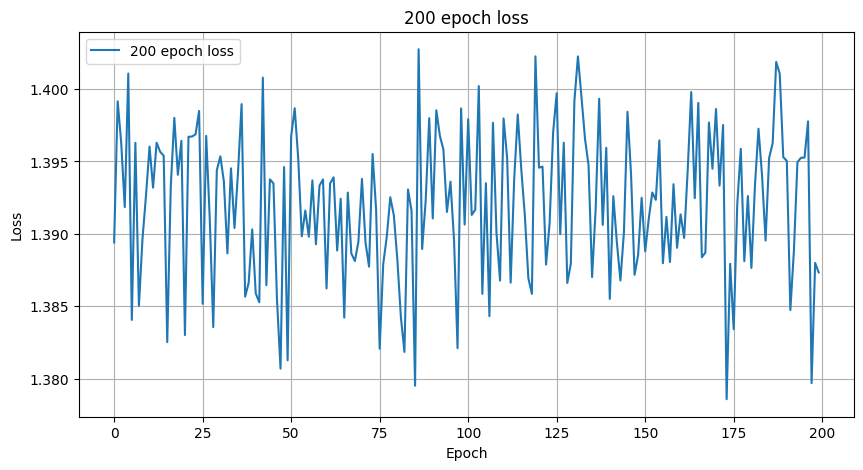

Epoch [1803701], Loss: 1.3889
Epoch [1803702], Loss: 1.3927
Epoch [1803703], Loss: 1.3914
Epoch [1803704], Loss: 1.3972
Epoch [1803705], Loss: 1.3935
Epoch [1803706], Loss: 1.3938
Epoch [1803707], Loss: 1.3939
Epoch [1803708], Loss: 1.3883
Epoch [1803709], Loss: 1.3858
Epoch [1803710], Loss: 1.3823
Epoch [1803711], Loss: 1.3922
Epoch [1803712], Loss: 1.3937
Epoch [1803713], Loss: 1.3862
Epoch [1803714], Loss: 1.3890
Epoch [1803715], Loss: 1.3933
Epoch [1803716], Loss: 1.3848
Epoch [1803717], Loss: 1.3866
Epoch [1803718], Loss: 1.3926
Epoch [1803719], Loss: 1.3898
Epoch [1803720], Loss: 1.3920
Epoch [1803721], Loss: 1.3985
Epoch [1803722], Loss: 1.3963
Epoch [1803723], Loss: 1.3953
Epoch [1803724], Loss: 1.3912
Epoch [1803725], Loss: 1.3967
Epoch [1803726], Loss: 1.3993
Epoch [1803727], Loss: 1.3878
Epoch [1803728], Loss: 1.3898
Epoch [1803729], Loss: 1.3997
Epoch [1803730], Loss: 1.3920
Epoch [1803731], Loss: 1.3837
Epoch [1803732], Loss: 1.3795
Epoch [1803733], Loss: 1.3916
Epoch [180

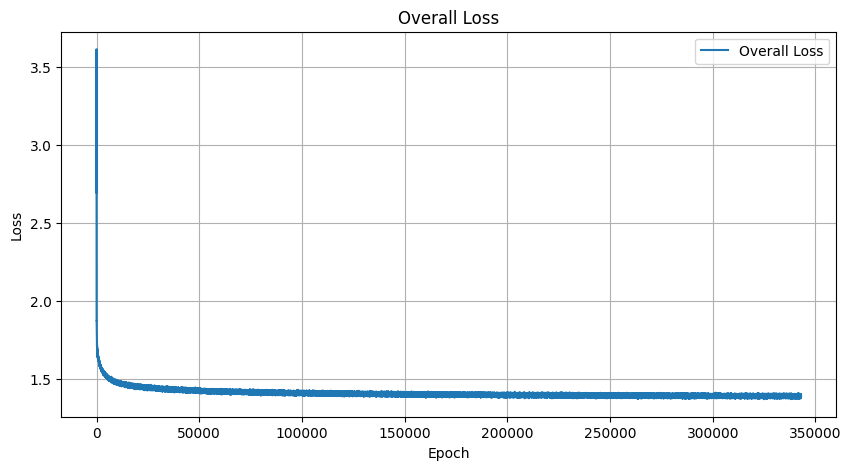

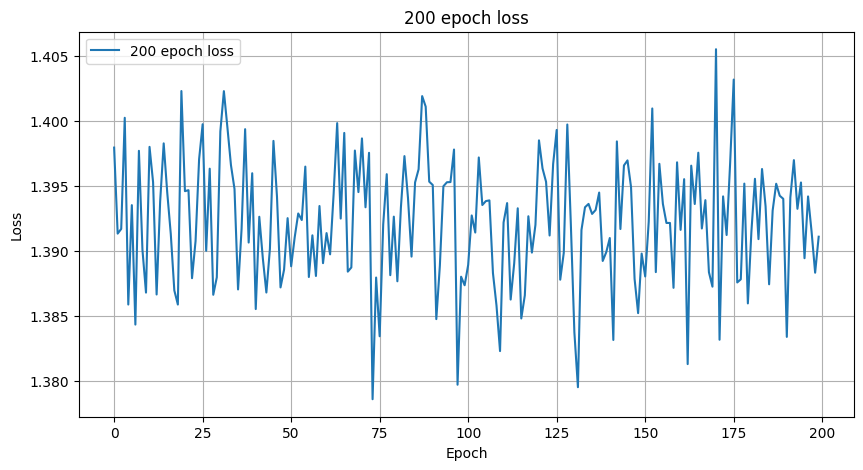

Epoch [1803801], Loss: 1.3945
Epoch [1803802], Loss: 1.3887
Epoch [1803803], Loss: 1.3928
Epoch [1803804], Loss: 1.3936
Epoch [1803805], Loss: 1.3945
Epoch [1803806], Loss: 1.3992
Epoch [1803807], Loss: 1.3901
Epoch [1803808], Loss: 1.3990
Epoch [1803809], Loss: 1.3931
Epoch [1803810], Loss: 1.4020
Epoch [1803811], Loss: 1.3837
Epoch [1803812], Loss: 1.3969
Epoch [1803813], Loss: 1.3968
Epoch [1803814], Loss: 1.3923
Epoch [1803815], Loss: 1.3819
Epoch [1803816], Loss: 1.3966
Epoch [1803817], Loss: 1.3923
Epoch [1803818], Loss: 1.3901
Epoch [1803819], Loss: 1.3940
Epoch [1803820], Loss: 1.3874
Epoch [1803821], Loss: 1.3943
Epoch [1803822], Loss: 1.3983
Epoch [1803823], Loss: 1.3826
Epoch [1803824], Loss: 1.3957
Epoch [1803825], Loss: 1.3902
Epoch [1803826], Loss: 1.3858
Epoch [1803827], Loss: 1.3931
Epoch [1803828], Loss: 1.3861
Epoch [1803829], Loss: 1.4005
Epoch [1803830], Loss: 1.3920
Epoch [1803831], Loss: 1.3950
Epoch [1803832], Loss: 1.3929
Epoch [1803833], Loss: 1.3930
Epoch [180

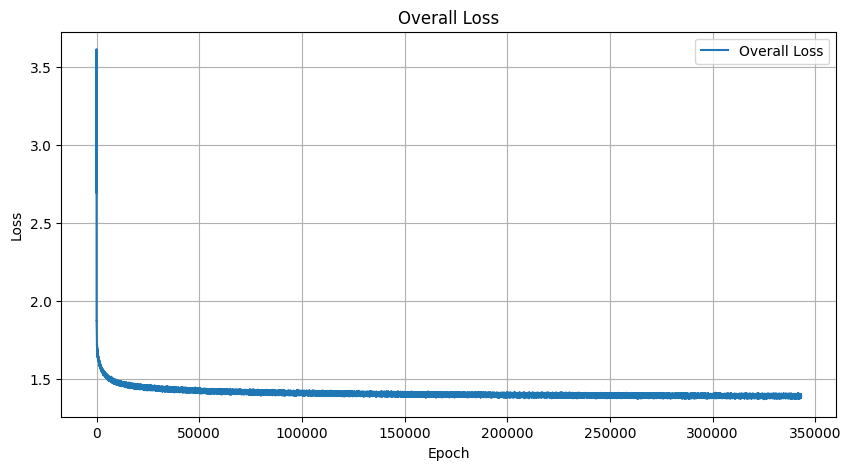

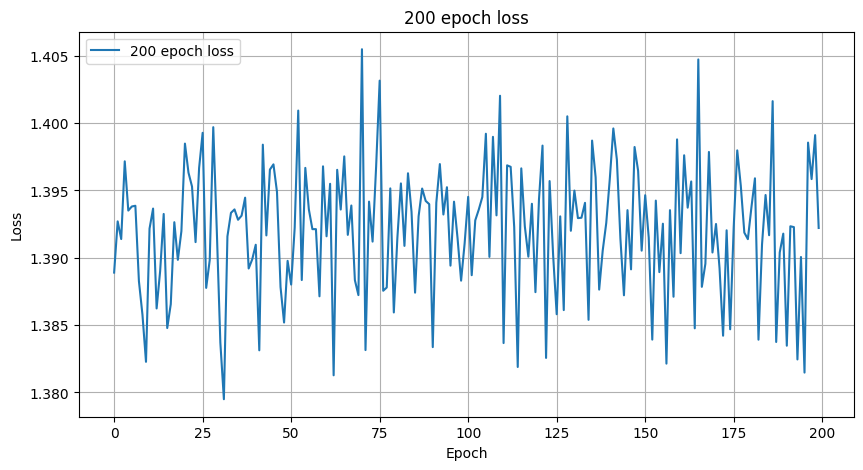

Epoch [1803901], Loss: 1.3889
Epoch [1803902], Loss: 1.3847
Epoch [1803903], Loss: 1.3894
Epoch [1803904], Loss: 1.3948
Epoch [1803905], Loss: 1.3936
Epoch [1803906], Loss: 1.3938
Epoch [1803907], Loss: 1.3939
Epoch [1803908], Loss: 1.3820
Epoch [1803909], Loss: 1.3872
Epoch [1803910], Loss: 1.3930
Epoch [1803911], Loss: 1.3943
Epoch [1803912], Loss: 1.3885
Epoch [1803913], Loss: 1.3904
Epoch [1803914], Loss: 1.3972
Epoch [1803915], Loss: 1.3981
Epoch [1803916], Loss: 1.3944
Epoch [1803917], Loss: 1.3968
Epoch [1803918], Loss: 1.3952
Epoch [1803919], Loss: 1.3940
Epoch [1803920], Loss: 1.3936
Epoch [1803921], Loss: 1.3909
Epoch [1803922], Loss: 1.3923
Epoch [1803923], Loss: 1.3893
Epoch [1803924], Loss: 1.3940
Epoch [1803925], Loss: 1.3903
Epoch [1803926], Loss: 1.3981
Epoch [1803927], Loss: 1.3979
Epoch [1803928], Loss: 1.3961
Epoch [1803929], Loss: 1.3899
Epoch [1803930], Loss: 1.3865
Epoch [1803931], Loss: 1.3863
Epoch [1803932], Loss: 1.3936
Epoch [1803933], Loss: 1.3983
Epoch [180

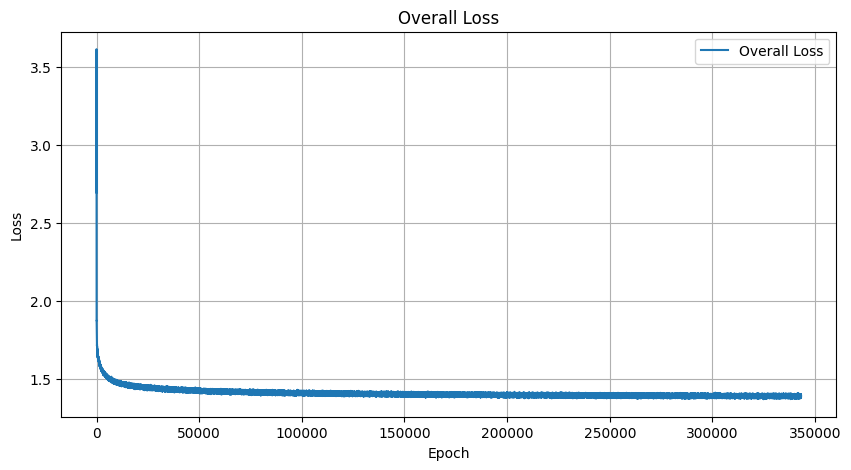

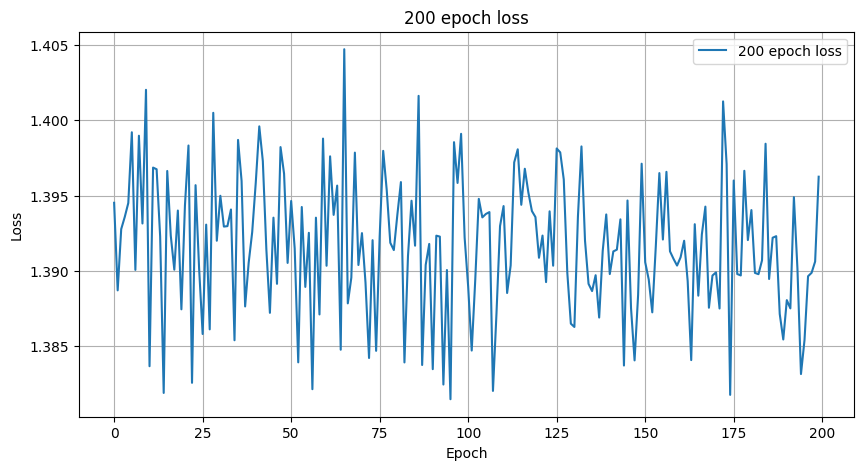

Epoch [1804001], Loss: 1.3869
Epoch [1804002], Loss: 1.3914
Epoch [1804003], Loss: 1.3919
Epoch [1804004], Loss: 1.3874
Epoch [1804005], Loss: 1.3985
Epoch [1804006], Loss: 1.3980
Epoch [1804007], Loss: 1.3973
Epoch [1804008], Loss: 1.3971
Epoch [1804009], Loss: 1.3916
Epoch [1804010], Loss: 1.3891
Epoch [1804011], Loss: 1.3973
Epoch [1804012], Loss: 1.3868
Epoch [1804013], Loss: 1.3865
Epoch [1804014], Loss: 1.3925
Epoch [1804015], Loss: 1.3848
Epoch [1804016], Loss: 1.3917
Epoch [1804017], Loss: 1.3906
Epoch [1804018], Loss: 1.3972
Epoch [1804019], Loss: 1.3860
Epoch [1804020], Loss: 1.3976
Epoch [1804021], Loss: 1.3860
Epoch [1804022], Loss: 1.3871
Epoch [1804023], Loss: 1.3935
Epoch [1804024], Loss: 1.3939
Epoch [1804025], Loss: 1.3940
Epoch [1804026], Loss: 1.3922
Epoch [1804027], Loss: 1.3894
Epoch [1804028], Loss: 1.3947
Epoch [1804029], Loss: 1.3970
Epoch [1804030], Loss: 1.3926
Epoch [1804031], Loss: 1.3859
Epoch [1804032], Loss: 1.3936
Epoch [1804033], Loss: 1.3920
Epoch [180

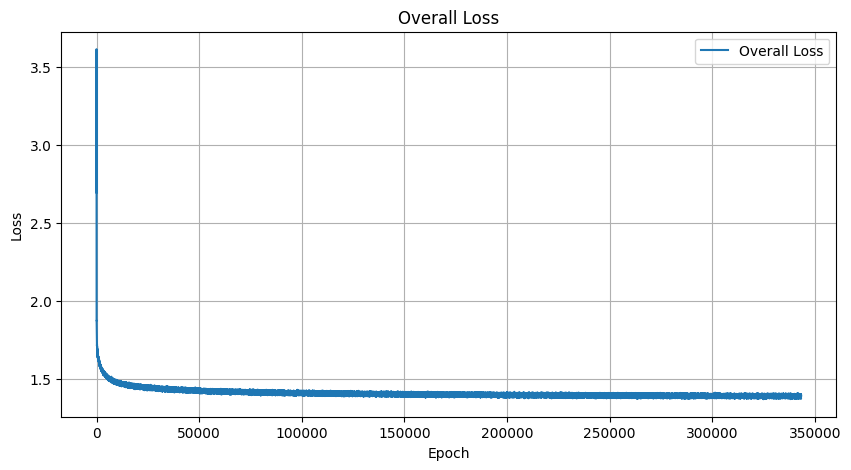

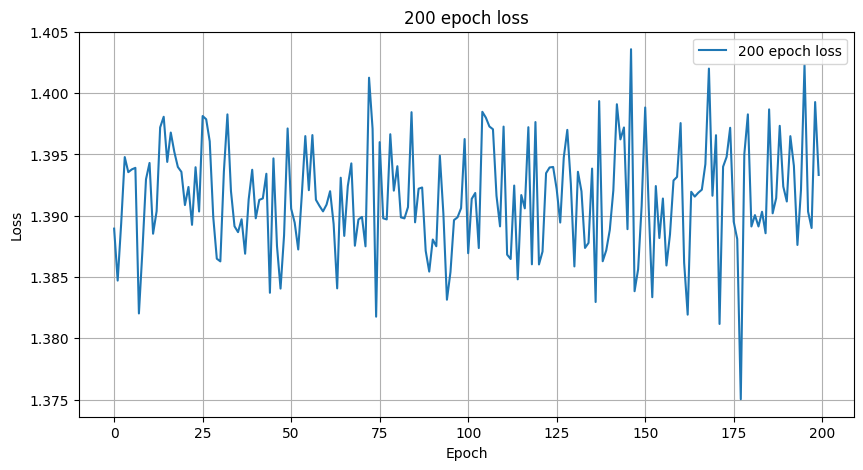

Epoch [1804101], Loss: 1.3936
Epoch [1804102], Loss: 1.3886
Epoch [1804103], Loss: 1.3949
Epoch [1804104], Loss: 1.3923
Epoch [1804105], Loss: 1.3952
Epoch [1804106], Loss: 1.3845
Epoch [1804107], Loss: 1.3961
Epoch [1804108], Loss: 1.3895
Epoch [1804109], Loss: 1.3947
Epoch [1804110], Loss: 1.3980
Epoch [1804111], Loss: 1.3881
Epoch [1804112], Loss: 1.3930
Epoch [1804113], Loss: 1.4024
Epoch [1804114], Loss: 1.3993
Epoch [1804115], Loss: 1.3837
Epoch [1804116], Loss: 1.3968
Epoch [1804117], Loss: 1.3968
Epoch [1804118], Loss: 1.3949
Epoch [1804119], Loss: 1.3949
Epoch [1804120], Loss: 1.3858
Epoch [1804121], Loss: 1.3889
Epoch [1804122], Loss: 1.4019
Epoch [1804123], Loss: 1.3937
Epoch [1804124], Loss: 1.4002
Epoch [1804125], Loss: 1.3917
Epoch [1804126], Loss: 1.3873
Epoch [1804127], Loss: 1.3887
Epoch [1804128], Loss: 1.3984
Epoch [1804129], Loss: 1.3961
Epoch [1804130], Loss: 1.3953
Epoch [1804131], Loss: 1.3899
Epoch [1804132], Loss: 1.3929
Epoch [1804133], Loss: 1.3940
Epoch [180

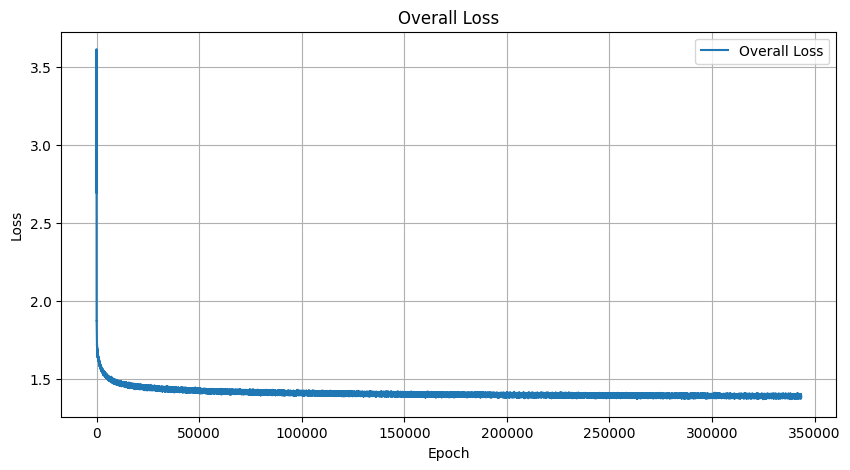

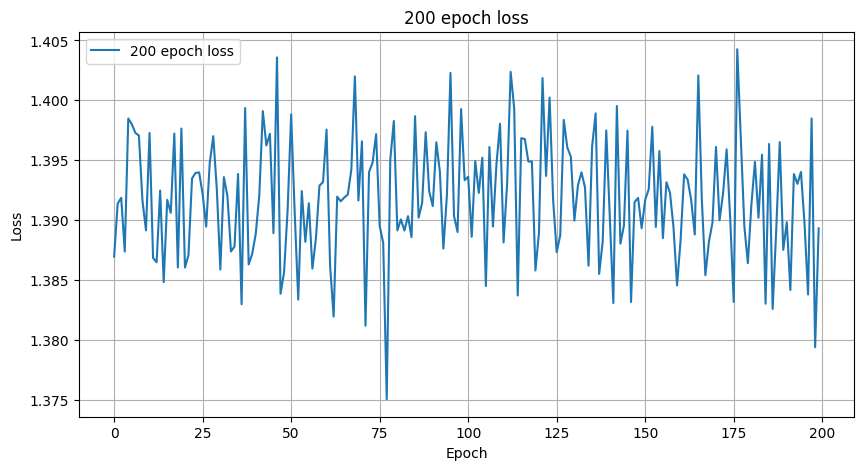

Epoch [1804201], Loss: 1.3931
Epoch [1804202], Loss: 1.3921
Epoch [1804203], Loss: 1.4045
Epoch [1804204], Loss: 1.3861
Epoch [1804205], Loss: 1.3944
Epoch [1804206], Loss: 1.3898
Epoch [1804207], Loss: 1.3899
Epoch [1804208], Loss: 1.4016
Epoch [1804209], Loss: 1.3907
Epoch [1804210], Loss: 1.3968
Epoch [1804211], Loss: 1.3872
Epoch [1804212], Loss: 1.3953
Epoch [1804213], Loss: 1.3927
Epoch [1804214], Loss: 1.3898
Epoch [1804215], Loss: 1.3883
Epoch [1804216], Loss: 1.3909
Epoch [1804217], Loss: 1.3968
Epoch [1804218], Loss: 1.3940
Epoch [1804219], Loss: 1.3873
Epoch [1804220], Loss: 1.3967
Epoch [1804221], Loss: 1.3863
Epoch [1804222], Loss: 1.3808
Epoch [1804223], Loss: 1.3963
Epoch [1804224], Loss: 1.3940
Epoch [1804225], Loss: 1.3897
Epoch [1804226], Loss: 1.3882
Epoch [1804227], Loss: 1.3943
Epoch [1804228], Loss: 1.3835
Epoch [1804229], Loss: 1.4037
Epoch [1804230], Loss: 1.3902
Epoch [1804231], Loss: 1.3810
Epoch [1804232], Loss: 1.3977
Epoch [1804233], Loss: 1.3999
Epoch [180

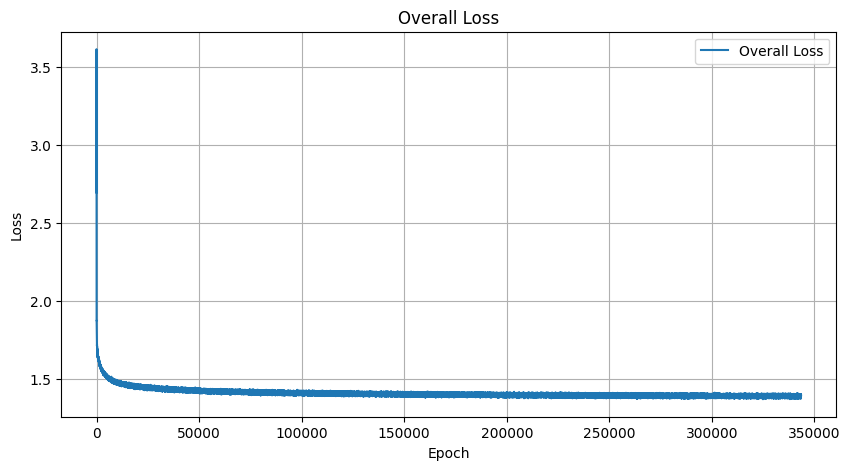

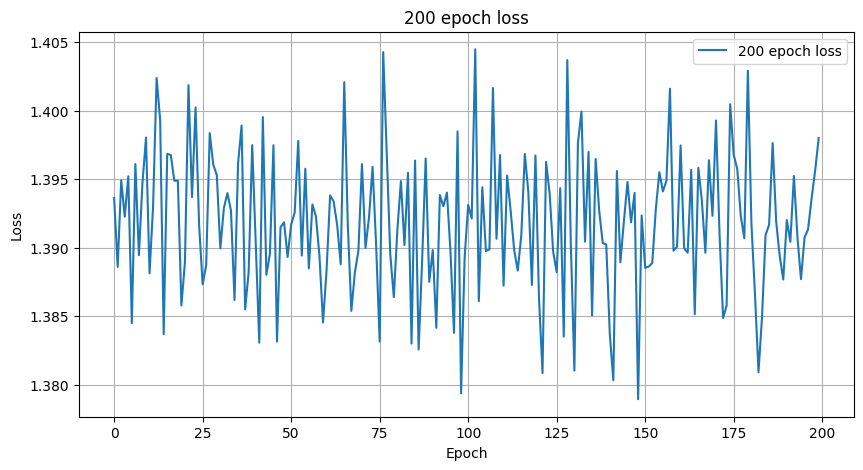

Epoch [1804301], Loss: 1.3896
Epoch [1804302], Loss: 1.3862
Epoch [1804303], Loss: 1.3948
Epoch [1804304], Loss: 1.3926
Epoch [1804305], Loss: 1.3970
Epoch [1804306], Loss: 1.3922
Epoch [1804307], Loss: 1.3969
Epoch [1804308], Loss: 1.3960
Epoch [1804309], Loss: 1.4013
Epoch [1804310], Loss: 1.3939
Epoch [1804311], Loss: 1.3975
Epoch [1804312], Loss: 1.3913
Epoch [1804313], Loss: 1.3851
Epoch [1804314], Loss: 1.4032
Epoch [1804315], Loss: 1.3926
Epoch [1804316], Loss: 1.3947
Epoch [1804317], Loss: 1.3925
Epoch [1804318], Loss: 1.3923
Epoch [1804319], Loss: 1.3941
Epoch [1804320], Loss: 1.3884
Epoch [1804321], Loss: 1.3887
Epoch [1804322], Loss: 1.3956
Epoch [1804323], Loss: 1.3896
Epoch [1804324], Loss: 1.3896
Epoch [1804325], Loss: 1.3892
Epoch [1804326], Loss: 1.3976
Epoch [1804327], Loss: 1.4028
Epoch [1804328], Loss: 1.3887
Epoch [1804329], Loss: 1.3884
Epoch [1804330], Loss: 1.3923
Epoch [1804331], Loss: 1.3877
Epoch [1804332], Loss: 1.3929
Epoch [1804333], Loss: 1.3842
Epoch [180

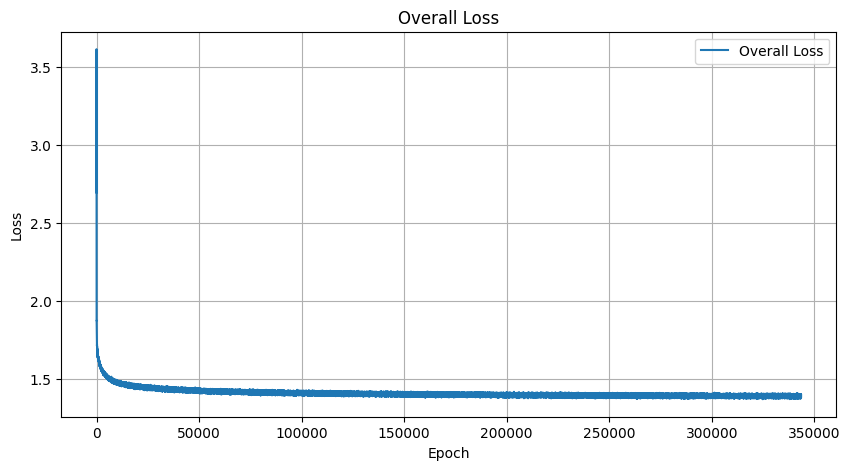

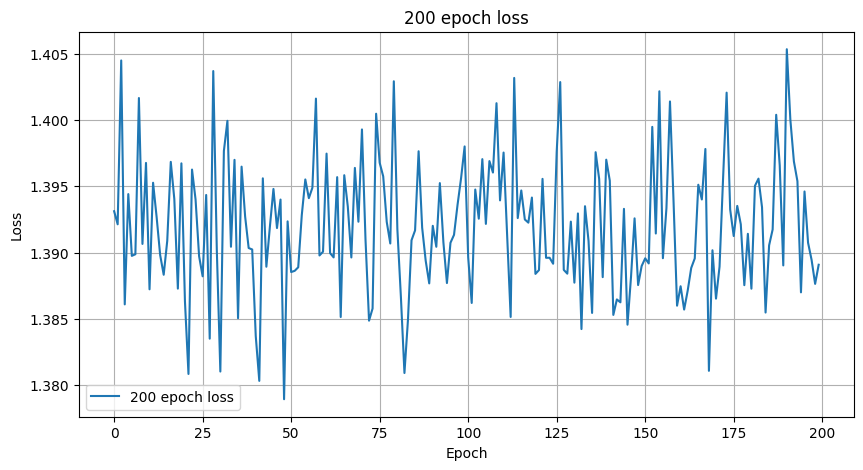

Epoch [1804401], Loss: 1.3866
Epoch [1804402], Loss: 1.3903
Epoch [1804403], Loss: 1.3884
Epoch [1804404], Loss: 1.3951
Epoch [1804405], Loss: 1.3915
Epoch [1804406], Loss: 1.3902
Epoch [1804407], Loss: 1.3911
Epoch [1804408], Loss: 1.3995
Epoch [1804409], Loss: 1.3877
Epoch [1804410], Loss: 1.3947
Epoch [1804411], Loss: 1.3941
Epoch [1804412], Loss: 1.3930
Epoch [1804413], Loss: 1.3893
Epoch [1804414], Loss: 1.3971
Epoch [1804415], Loss: 1.3869
Epoch [1804416], Loss: 1.3992
Epoch [1804417], Loss: 1.3871
Epoch [1804418], Loss: 1.3947
Epoch [1804419], Loss: 1.3975
Epoch [1804420], Loss: 1.3822
Epoch [1804421], Loss: 1.3916
Epoch [1804422], Loss: 1.3872
Epoch [1804423], Loss: 1.3936
Epoch [1804424], Loss: 1.3945
Epoch [1804425], Loss: 1.3928
Epoch [1804426], Loss: 1.3999
Epoch [1804427], Loss: 1.3893
Epoch [1804428], Loss: 1.3911
Epoch [1804429], Loss: 1.3953
Epoch [1804430], Loss: 1.3940
Epoch [1804431], Loss: 1.3963
Epoch [1804432], Loss: 1.3937
Epoch [1804433], Loss: 1.3847
Epoch [180

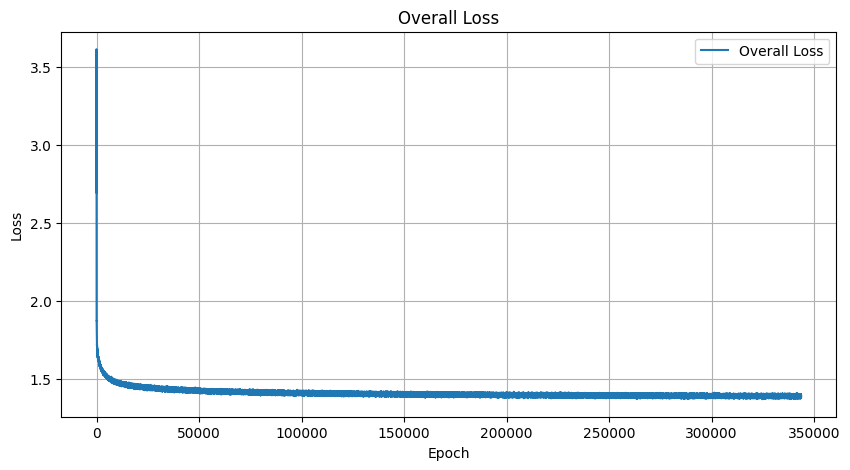

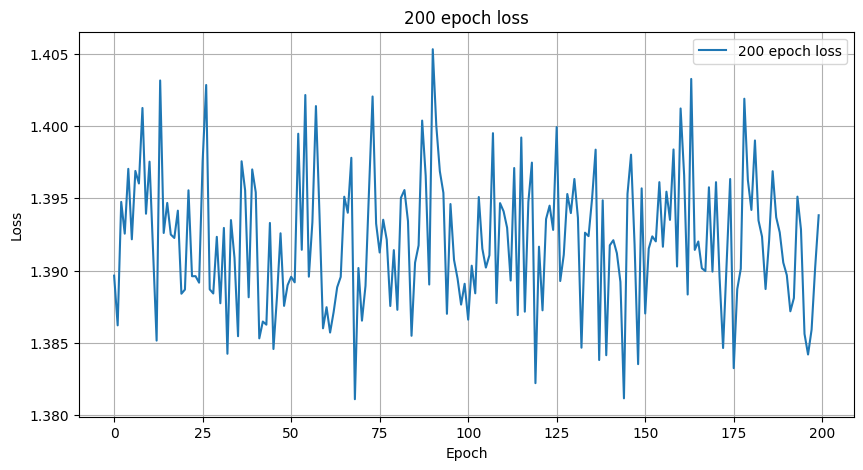

Epoch [1804501], Loss: 1.3967
Epoch [1804502], Loss: 1.3916
Epoch [1804503], Loss: 1.3927
Epoch [1804504], Loss: 1.3931
Epoch [1804505], Loss: 1.3960
Epoch [1804506], Loss: 1.3950
Epoch [1804507], Loss: 1.3891
Epoch [1804508], Loss: 1.3953
Epoch [1804509], Loss: 1.3959
Epoch [1804510], Loss: 1.3897
Epoch [1804511], Loss: 1.3979
Epoch [1804512], Loss: 1.3981
Epoch [1804513], Loss: 1.4010
Epoch [1804514], Loss: 1.3896
Epoch [1804515], Loss: 1.3984
Epoch [1804516], Loss: 1.4020
Epoch [1804517], Loss: 1.3894
Epoch [1804518], Loss: 1.3897
Epoch [1804519], Loss: 1.3999
Epoch [1804520], Loss: 1.3876
Epoch [1804521], Loss: 1.3981
Epoch [1804522], Loss: 1.3869
Epoch [1804523], Loss: 1.3902
Epoch [1804524], Loss: 1.3938
Epoch [1804525], Loss: 1.3904
Epoch [1804526], Loss: 1.3936
Epoch [1804527], Loss: 1.3920
Epoch [1804528], Loss: 1.3822
Epoch [1804529], Loss: 1.3911
Epoch [1804530], Loss: 1.3880
Epoch [1804531], Loss: 1.4028
Epoch [1804532], Loss: 1.3865
Epoch [1804533], Loss: 1.3965
Epoch [180

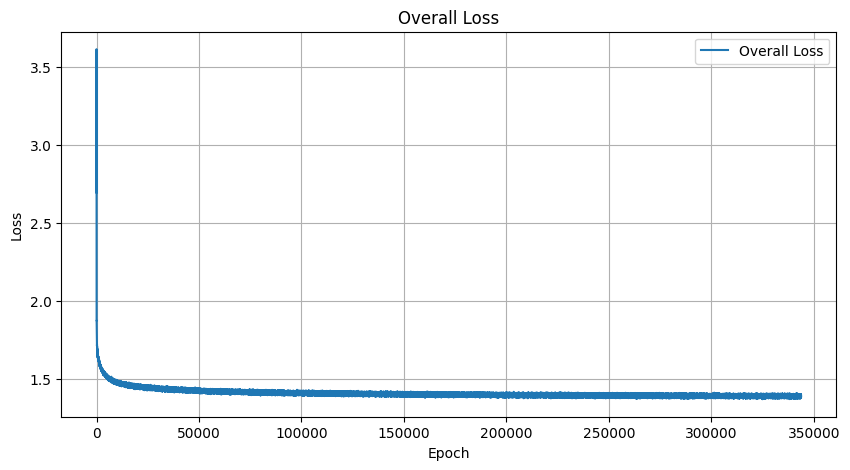

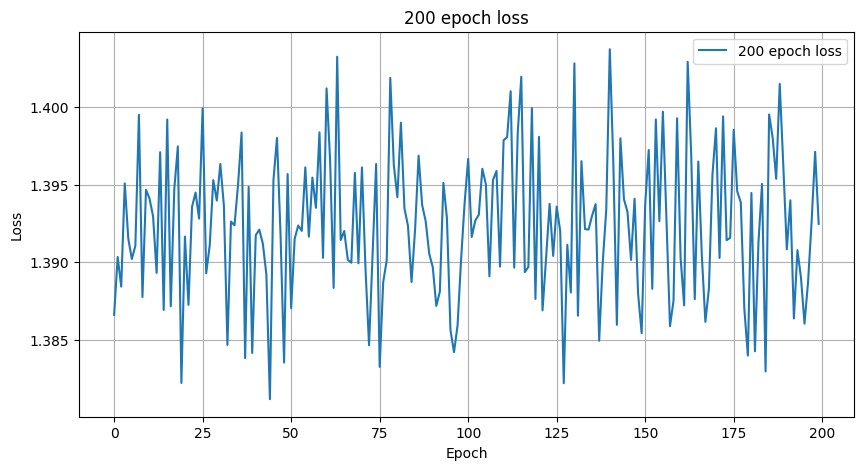

Epoch [1804601], Loss: 1.3900
Epoch [1804602], Loss: 1.3883
Epoch [1804603], Loss: 1.3898
Epoch [1804604], Loss: 1.3941
Epoch [1804605], Loss: 1.3849
Epoch [1804606], Loss: 1.3879
Epoch [1804607], Loss: 1.4005
Epoch [1804608], Loss: 1.3902
Epoch [1804609], Loss: 1.3941
Epoch [1804610], Loss: 1.3912
Epoch [1804611], Loss: 1.3851
Epoch [1804612], Loss: 1.3947
Epoch [1804613], Loss: 1.3954
Epoch [1804614], Loss: 1.3895
Epoch [1804615], Loss: 1.3942
Epoch [1804616], Loss: 1.3976
Epoch [1804617], Loss: 1.4019
Epoch [1804618], Loss: 1.3845
Epoch [1804619], Loss: 1.3966
Epoch [1804620], Loss: 1.3930
Epoch [1804621], Loss: 1.3811
Epoch [1804622], Loss: 1.3897
Epoch [1804623], Loss: 1.3921
Epoch [1804624], Loss: 1.3886
Epoch [1804625], Loss: 1.3880
Epoch [1804626], Loss: 1.3960
Epoch [1804627], Loss: 1.3958
Epoch [1804628], Loss: 1.3898
Epoch [1804629], Loss: 1.3805
Epoch [1804630], Loss: 1.3936
Epoch [1804631], Loss: 1.3934
Epoch [1804632], Loss: 1.3947
Epoch [1804633], Loss: 1.3907
Epoch [180

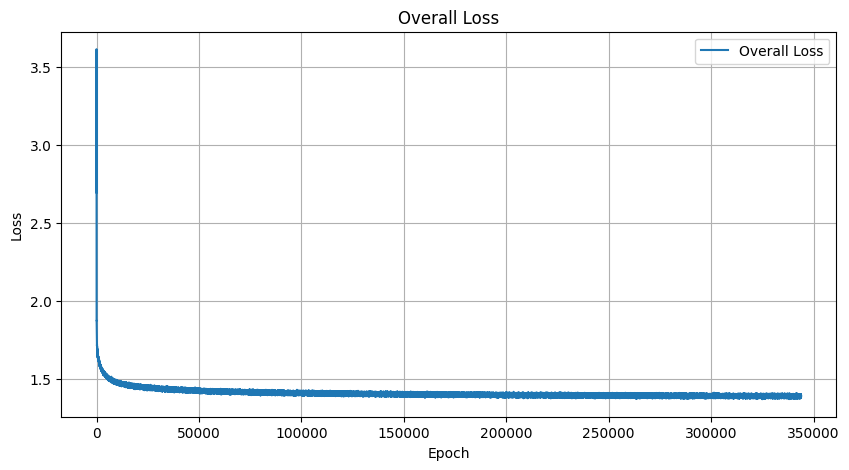

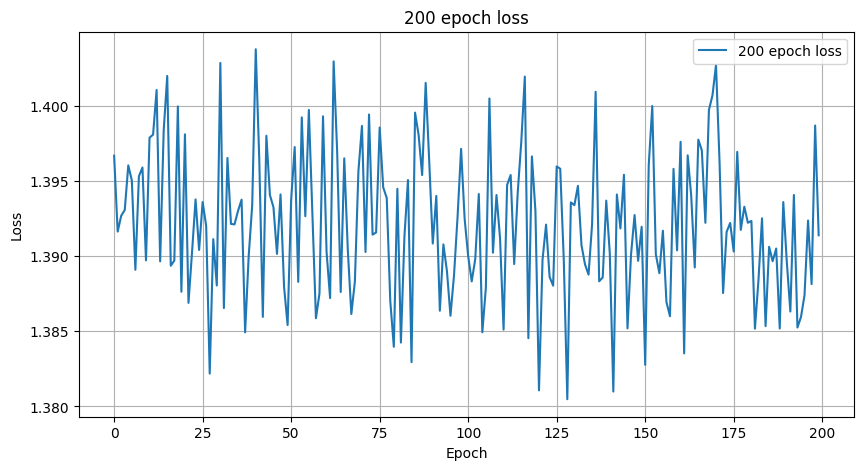

Epoch [1804701], Loss: 1.3856
Epoch [1804702], Loss: 1.3938
Epoch [1804703], Loss: 1.3863
Epoch [1804704], Loss: 1.3943
Epoch [1804705], Loss: 1.3938
Epoch [1804706], Loss: 1.3900
Epoch [1804707], Loss: 1.3850
Epoch [1804708], Loss: 1.3932
Epoch [1804709], Loss: 1.3910
Epoch [1804710], Loss: 1.3946
Epoch [1804711], Loss: 1.3905
Epoch [1804712], Loss: 1.3932
Epoch [1804713], Loss: 1.3919
Epoch [1804714], Loss: 1.3908
Epoch [1804715], Loss: 1.3941
Epoch [1804716], Loss: 1.3888
Epoch [1804717], Loss: 1.3898
Epoch [1804718], Loss: 1.3967
Epoch [1804719], Loss: 1.3994
Epoch [1804720], Loss: 1.3950
Epoch [1804721], Loss: 1.3897
Epoch [1804722], Loss: 1.3886
Epoch [1804723], Loss: 1.3941
Epoch [1804724], Loss: 1.4029
Epoch [1804725], Loss: 1.3975
Epoch [1804726], Loss: 1.3852
Epoch [1804727], Loss: 1.4012
Epoch [1804728], Loss: 1.4008
Epoch [1804729], Loss: 1.3909
Epoch [1804730], Loss: 1.3879
Epoch [1804731], Loss: 1.3840
Epoch [1804732], Loss: 1.3954
Epoch [1804733], Loss: 1.3759
Epoch [180

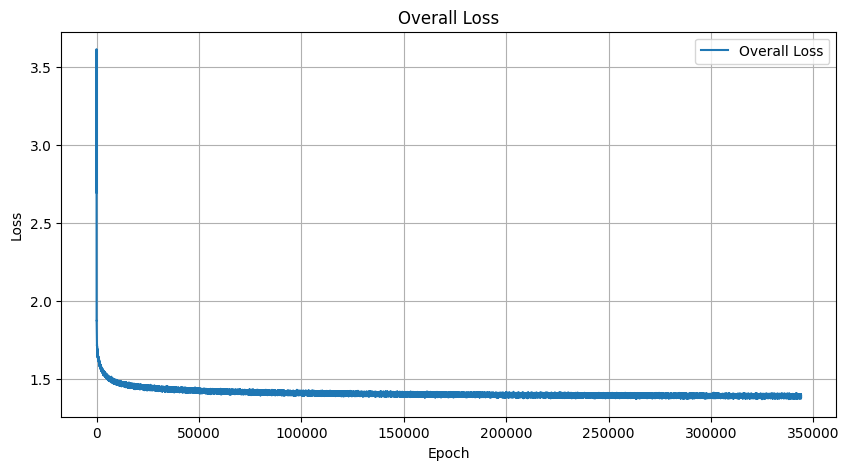

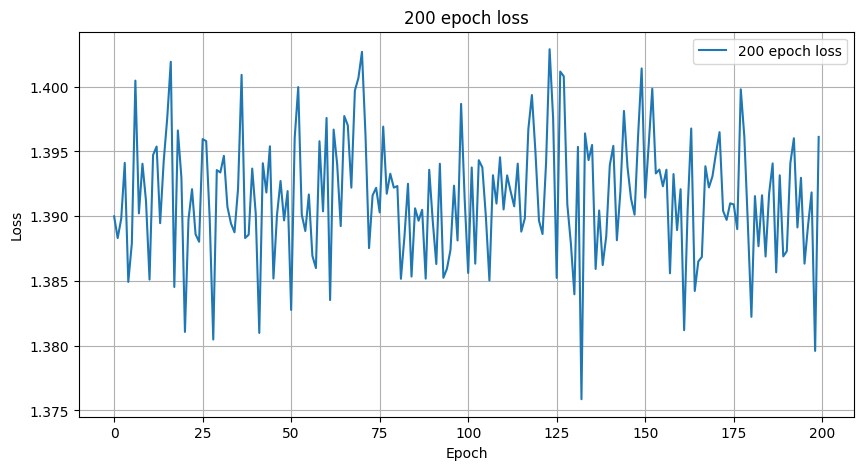

Epoch [1804801], Loss: 1.3894
Epoch [1804802], Loss: 1.3966
Epoch [1804803], Loss: 1.3951
Epoch [1804804], Loss: 1.3929
Epoch [1804805], Loss: 1.3846
Epoch [1804806], Loss: 1.3866
Epoch [1804807], Loss: 1.3956
Epoch [1804808], Loss: 1.3903
Epoch [1804809], Loss: 1.3914
Epoch [1804810], Loss: 1.3944
Epoch [1804811], Loss: 1.3897
Epoch [1804812], Loss: 1.3843
Epoch [1804813], Loss: 1.3965
Epoch [1804814], Loss: 1.3956
Epoch [1804815], Loss: 1.3874
Epoch [1804816], Loss: 1.3835
Epoch [1804817], Loss: 1.3906
Epoch [1804818], Loss: 1.3860
Epoch [1804819], Loss: 1.3895
Epoch [1804820], Loss: 1.3945
Epoch [1804821], Loss: 1.3874
Epoch [1804822], Loss: 1.3953
Epoch [1804823], Loss: 1.3857
Epoch [1804824], Loss: 1.3917
Epoch [1804825], Loss: 1.3845
Epoch [1804826], Loss: 1.3920
Epoch [1804827], Loss: 1.3887
Epoch [1804828], Loss: 1.3999
Epoch [1804829], Loss: 1.3896
Epoch [1804830], Loss: 1.3842
Epoch [1804831], Loss: 1.3920
Epoch [1804832], Loss: 1.3882
Epoch [1804833], Loss: 1.3850
Epoch [180

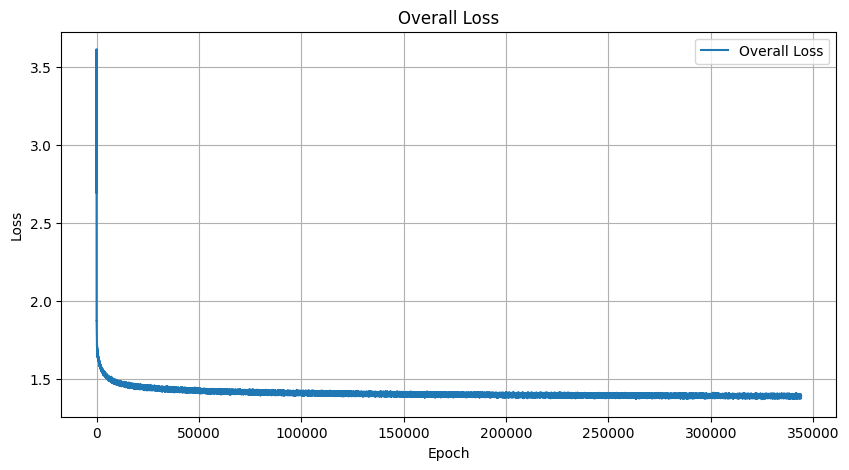

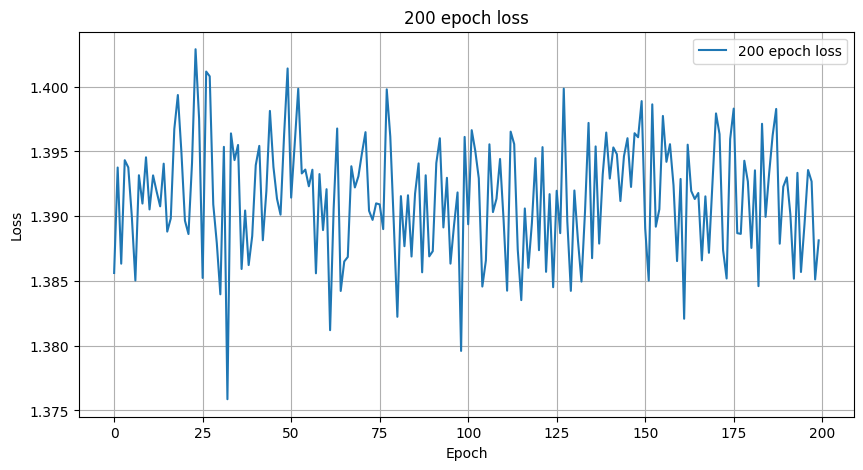

Epoch [1804901], Loss: 1.3912
Epoch [1804902], Loss: 1.3865
Epoch [1804903], Loss: 1.3933
Epoch [1804904], Loss: 1.3895
Epoch [1804905], Loss: 1.3923
Epoch [1804906], Loss: 1.3902
Epoch [1804907], Loss: 1.3993
Epoch [1804908], Loss: 1.3892
Epoch [1804909], Loss: 1.3880
Epoch [1804910], Loss: 1.3938
Epoch [1804911], Loss: 1.3945
Epoch [1804912], Loss: 1.3927
Epoch [1804913], Loss: 1.3964
Epoch [1804914], Loss: 1.3856
Epoch [1804915], Loss: 1.3891
Epoch [1804916], Loss: 1.3936
Epoch [1804917], Loss: 1.3826
Epoch [1804918], Loss: 1.3939
Epoch [1804919], Loss: 1.3986
Epoch [1804920], Loss: 1.3962
Epoch [1804921], Loss: 1.3899
Epoch [1804922], Loss: 1.3884
Epoch [1804923], Loss: 1.3970
Epoch [1804924], Loss: 1.3854
Epoch [1804925], Loss: 1.3945
Epoch [1804926], Loss: 1.3907
Epoch [1804927], Loss: 1.3877
Epoch [1804928], Loss: 1.3878
Epoch [1804929], Loss: 1.3973
Epoch [1804930], Loss: 1.3938
Epoch [1804931], Loss: 1.3981
Epoch [1804932], Loss: 1.3845
Epoch [1804933], Loss: 1.3966
Epoch [180

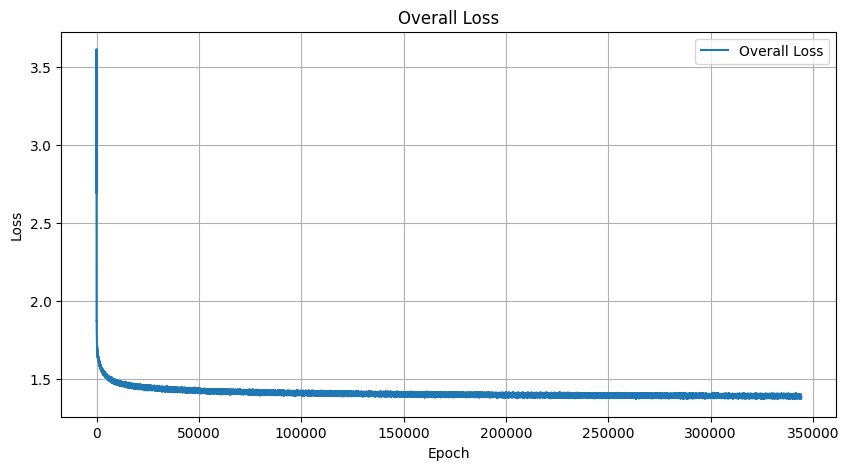

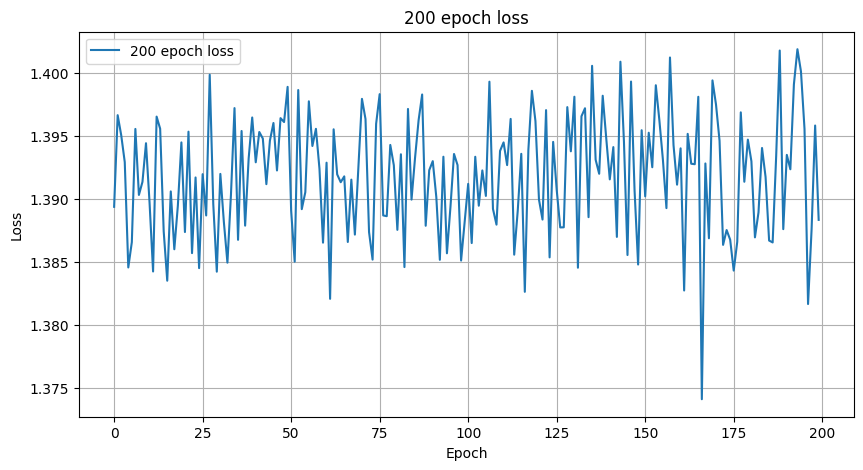

Epoch [1805001], Loss: 1.3903
Epoch [1805002], Loss: 1.3909
Epoch [1805003], Loss: 1.3895
Epoch [1805004], Loss: 1.3910
Epoch [1805005], Loss: 1.3951
Epoch [1805006], Loss: 1.3980
Epoch [1805007], Loss: 1.3883
Epoch [1805008], Loss: 1.3944
Epoch [1805009], Loss: 1.3923
Epoch [1805010], Loss: 1.3950
Epoch [1805011], Loss: 1.3852
Epoch [1805012], Loss: 1.3925
Epoch [1805013], Loss: 1.3928
Epoch [1805014], Loss: 1.3932
Epoch [1805015], Loss: 1.3959
Epoch [1805016], Loss: 1.3935
Epoch [1805017], Loss: 1.3981
Epoch [1805018], Loss: 1.3907
Epoch [1805019], Loss: 1.3900
Epoch [1805020], Loss: 1.3981
Epoch [1805021], Loss: 1.3930
Epoch [1805022], Loss: 1.3920
Epoch [1805023], Loss: 1.3930
Epoch [1805024], Loss: 1.3946
Epoch [1805025], Loss: 1.3955
Epoch [1805026], Loss: 1.3989
Epoch [1805027], Loss: 1.3923
Epoch [1805028], Loss: 1.3919
Epoch [1805029], Loss: 1.3925
Epoch [1805030], Loss: 1.3924
Epoch [1805031], Loss: 1.3927
Epoch [1805032], Loss: 1.3967
Epoch [1805033], Loss: 1.3845
Epoch [180

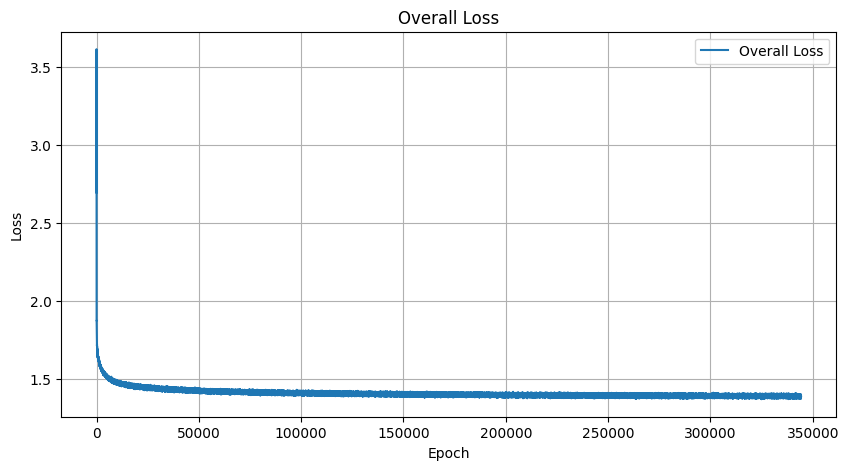

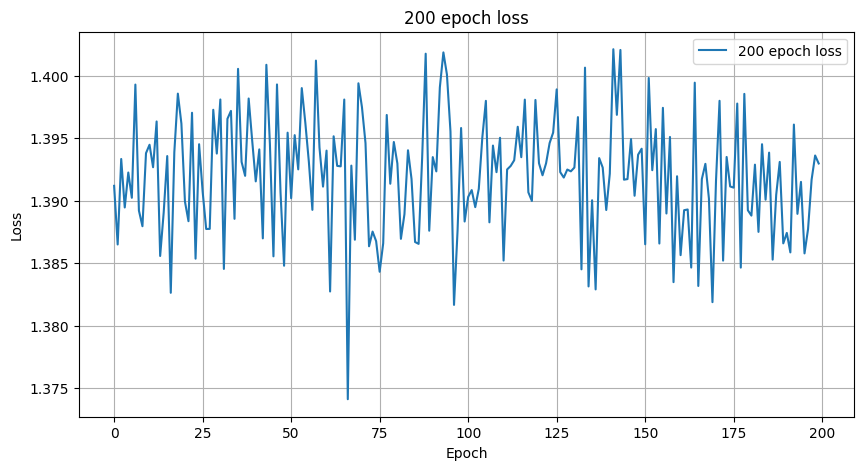

Epoch [1805101], Loss: 1.3864
Epoch [1805102], Loss: 1.3963
Epoch [1805103], Loss: 1.3986
Epoch [1805104], Loss: 1.3891
Epoch [1805105], Loss: 1.4001
Epoch [1805106], Loss: 1.3861
Epoch [1805107], Loss: 1.3984
Epoch [1805108], Loss: 1.3920
Epoch [1805109], Loss: 1.3930
Epoch [1805110], Loss: 1.3884
Epoch [1805111], Loss: 1.3866
Epoch [1805112], Loss: 1.3889
Epoch [1805113], Loss: 1.3837
Epoch [1805114], Loss: 1.3890
Epoch [1805115], Loss: 1.3866
Epoch [1805116], Loss: 1.3881
Epoch [1805117], Loss: 1.3785
Epoch [1805118], Loss: 1.3923
Epoch [1805119], Loss: 1.3873
Epoch [1805120], Loss: 1.3981
Epoch [1805121], Loss: 1.3966
Epoch [1805122], Loss: 1.3941
Epoch [1805123], Loss: 1.3957
Epoch [1805124], Loss: 1.3897
Epoch [1805125], Loss: 1.3907
Epoch [1805126], Loss: 1.4009
Epoch [1805127], Loss: 1.3952
Epoch [1805128], Loss: 1.4007
Epoch [1805129], Loss: 1.4002
Epoch [1805130], Loss: 1.3870
Epoch [1805131], Loss: 1.3912
Epoch [1805132], Loss: 1.3891
Epoch [1805133], Loss: 1.3941
Epoch [180

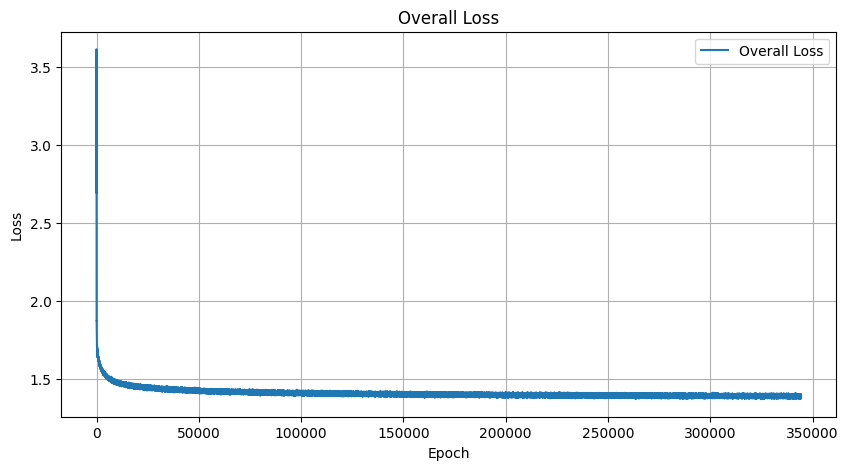

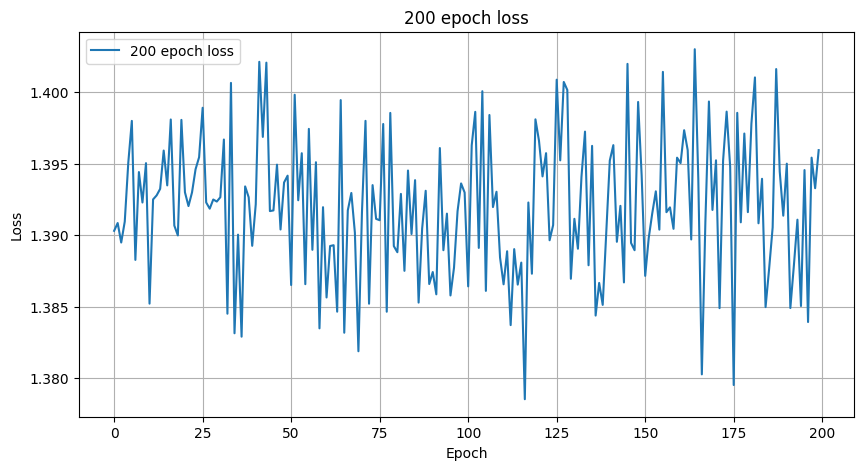

Epoch [1805201], Loss: 1.3949
Epoch [1805202], Loss: 1.3922
Epoch [1805203], Loss: 1.3928
Epoch [1805204], Loss: 1.3911
Epoch [1805205], Loss: 1.3897
Epoch [1805206], Loss: 1.3918
Epoch [1805207], Loss: 1.3914
Epoch [1805208], Loss: 1.3842
Epoch [1805209], Loss: 1.3879
Epoch [1805210], Loss: 1.3940
Epoch [1805211], Loss: 1.3905
Epoch [1805212], Loss: 1.3979
Epoch [1805213], Loss: 1.3918
Epoch [1805214], Loss: 1.3926
Epoch [1805215], Loss: 1.3993
Epoch [1805216], Loss: 1.3881
Epoch [1805217], Loss: 1.3935
Epoch [1805218], Loss: 1.3876
Epoch [1805219], Loss: 1.3827
Epoch [1805220], Loss: 1.3989
Epoch [1805221], Loss: 1.3986
Epoch [1805222], Loss: 1.3879
Epoch [1805223], Loss: 1.3970
Epoch [1805224], Loss: 1.3961
Epoch [1805225], Loss: 1.3877
Epoch [1805226], Loss: 1.3962
Epoch [1805227], Loss: 1.3915
Epoch [1805228], Loss: 1.3880
Epoch [1805229], Loss: 1.3807
Epoch [1805230], Loss: 1.3904
Epoch [1805231], Loss: 1.3887
Epoch [1805232], Loss: 1.3886
Epoch [1805233], Loss: 1.3865
Epoch [180

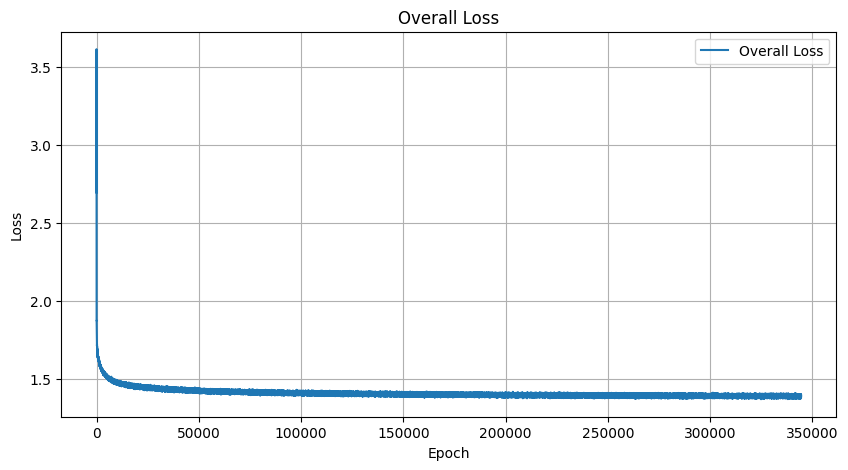

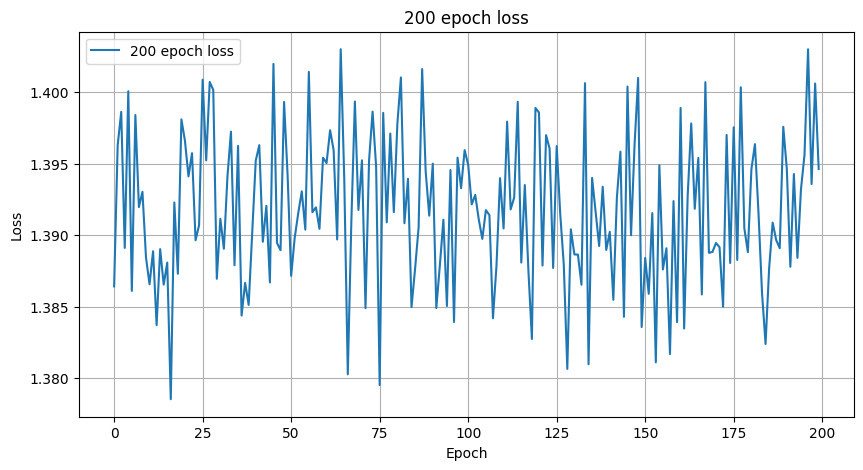

Epoch [1805301], Loss: 1.3933
Epoch [1805302], Loss: 1.3824
Epoch [1805303], Loss: 1.3972
Epoch [1805304], Loss: 1.3962
Epoch [1805305], Loss: 1.3891
Epoch [1805306], Loss: 1.3795
Epoch [1805307], Loss: 1.3870
Epoch [1805308], Loss: 1.3976
Epoch [1805309], Loss: 1.3955
Epoch [1805310], Loss: 1.3914
Epoch [1805311], Loss: 1.3884
Epoch [1805312], Loss: 1.3976
Epoch [1805313], Loss: 1.3943
Epoch [1805314], Loss: 1.4003
Epoch [1805315], Loss: 1.3942
Epoch [1805316], Loss: 1.3958
Epoch [1805317], Loss: 1.3925
Epoch [1805318], Loss: 1.3839
Epoch [1805319], Loss: 1.3963
Epoch [1805320], Loss: 1.4006
Epoch [1805321], Loss: 1.3888
Epoch [1805322], Loss: 1.3924
Epoch [1805323], Loss: 1.4018
Epoch [1805324], Loss: 1.3926
Epoch [1805325], Loss: 1.3952
Epoch [1805326], Loss: 1.3888
Epoch [1805327], Loss: 1.3957
Epoch [1805328], Loss: 1.3916
Epoch [1805329], Loss: 1.3904
Epoch [1805330], Loss: 1.3957
Epoch [1805331], Loss: 1.3927
Epoch [1805332], Loss: 1.3865
Epoch [1805333], Loss: 1.3852
Epoch [180

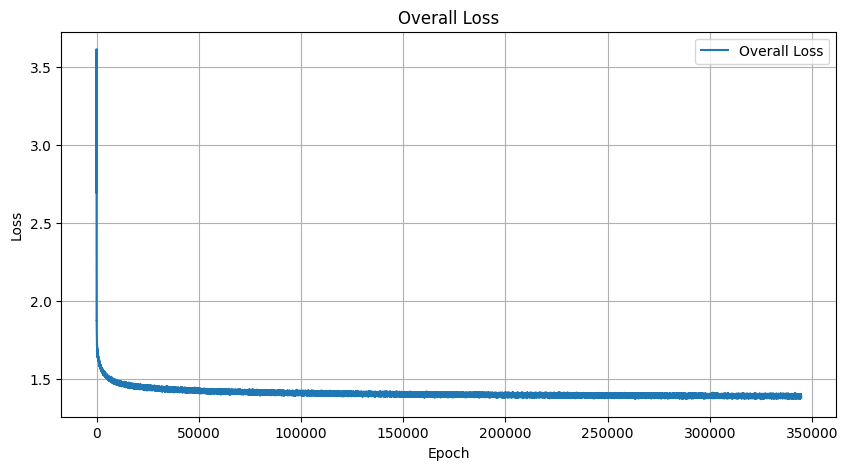

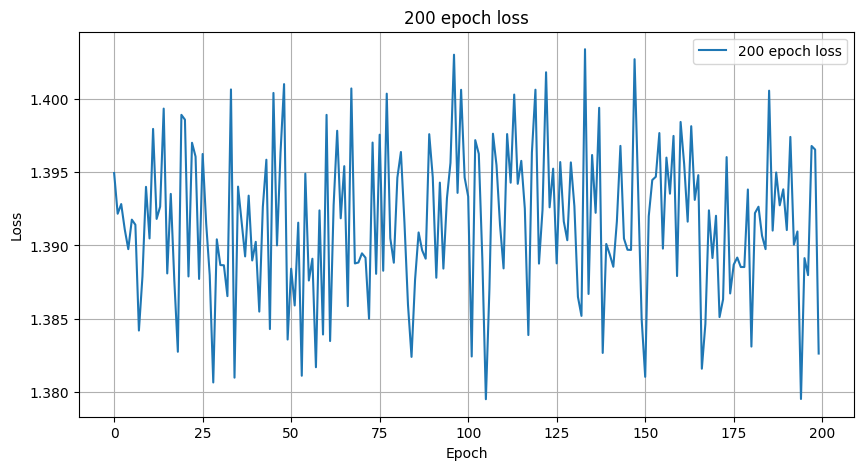

Epoch [1805401], Loss: 1.3955
Epoch [1805402], Loss: 1.3905
Epoch [1805403], Loss: 1.3830
Epoch [1805404], Loss: 1.3852
Epoch [1805405], Loss: 1.3911
Epoch [1805406], Loss: 1.3891
Epoch [1805407], Loss: 1.3933
Epoch [1805408], Loss: 1.3955
Epoch [1805409], Loss: 1.3959
Epoch [1805410], Loss: 1.3810
Epoch [1805411], Loss: 1.3896
Epoch [1805412], Loss: 1.3975
Epoch [1805413], Loss: 1.3977
Epoch [1805414], Loss: 1.3865
Epoch [1805415], Loss: 1.4010
Epoch [1805416], Loss: 1.3941
Epoch [1805417], Loss: 1.3800
Epoch [1805418], Loss: 1.3860
Epoch [1805419], Loss: 1.3917
Epoch [1805420], Loss: 1.3962
Epoch [1805421], Loss: 1.3925
Epoch [1805422], Loss: 1.3903
Epoch [1805423], Loss: 1.3924
Epoch [1805424], Loss: 1.3992
Epoch [1805425], Loss: 1.3966
Epoch [1805426], Loss: 1.3931
Epoch [1805427], Loss: 1.3965
Epoch [1805428], Loss: 1.3863
Epoch [1805429], Loss: 1.3915
Epoch [1805430], Loss: 1.3863
Epoch [1805431], Loss: 1.3812
Epoch [1805432], Loss: 1.3927
Epoch [1805433], Loss: 1.3903
Epoch [180

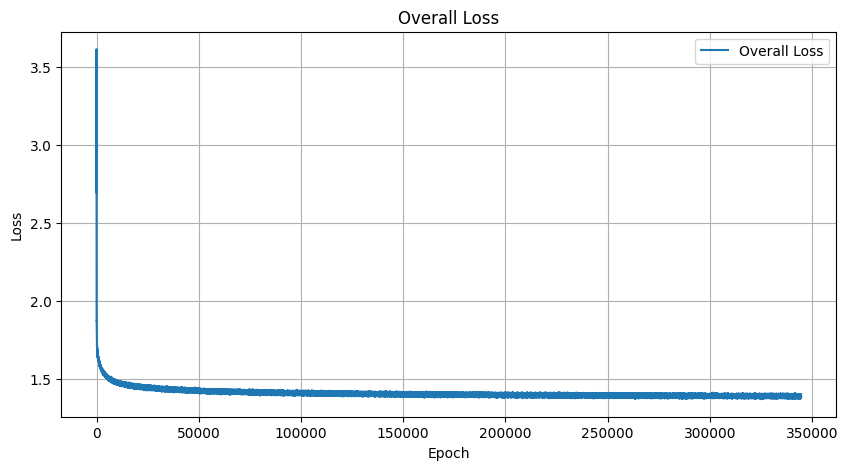

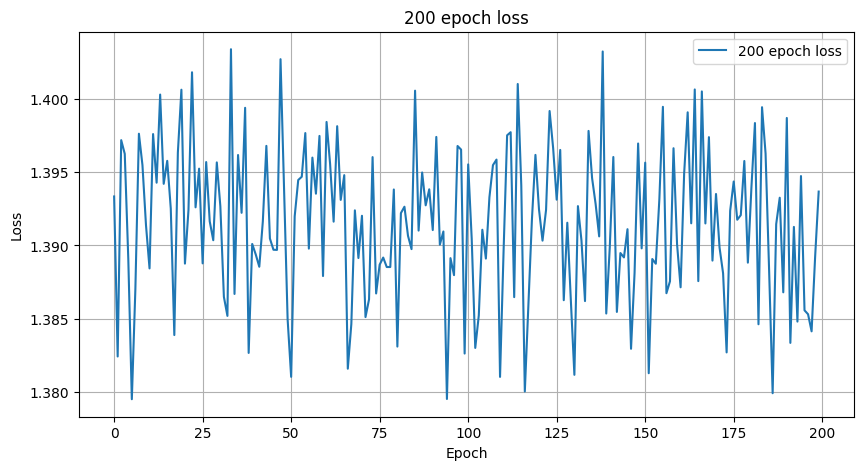

Epoch [1805501], Loss: 1.3943
Epoch [1805502], Loss: 1.3934
Epoch [1805503], Loss: 1.3937
Epoch [1805504], Loss: 1.3918
Epoch [1805505], Loss: 1.3914
Epoch [1805506], Loss: 1.3934
Epoch [1805507], Loss: 1.3864
Epoch [1805508], Loss: 1.3998
Epoch [1805509], Loss: 1.3805
Epoch [1805510], Loss: 1.3936
Epoch [1805511], Loss: 1.3918
Epoch [1805512], Loss: 1.3988
Epoch [1805513], Loss: 1.3919
Epoch [1805514], Loss: 1.3994
Epoch [1805515], Loss: 1.3954
Epoch [1805516], Loss: 1.3836
Epoch [1805517], Loss: 1.3950
Epoch [1805518], Loss: 1.3980
Epoch [1805519], Loss: 1.3856
Epoch [1805520], Loss: 1.3868
Epoch [1805521], Loss: 1.3893
Epoch [1805522], Loss: 1.3879
Epoch [1805523], Loss: 1.3873
Epoch [1805524], Loss: 1.3827
Epoch [1805525], Loss: 1.3891
Epoch [1805526], Loss: 1.3920
Epoch [1805527], Loss: 1.3939
Epoch [1805528], Loss: 1.3929
Epoch [1805529], Loss: 1.3940
Epoch [1805530], Loss: 1.3917
Epoch [1805531], Loss: 1.3892
Epoch [1805532], Loss: 1.3960
Epoch [1805533], Loss: 1.3964
Epoch [180

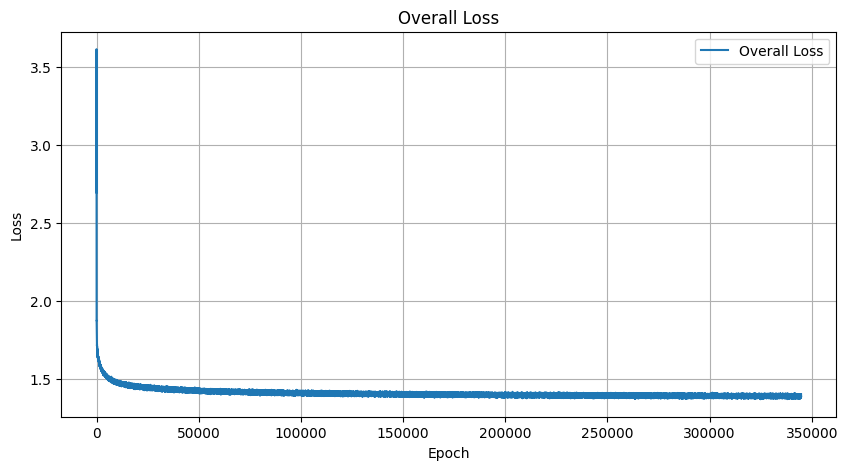

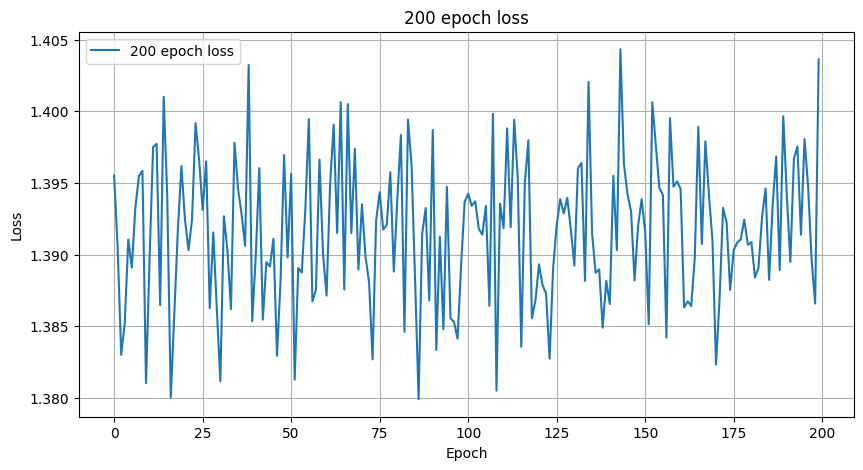

Epoch [1805601], Loss: 1.3953
Epoch [1805602], Loss: 1.3940
Epoch [1805603], Loss: 1.3950
Epoch [1805604], Loss: 1.3910
Epoch [1805605], Loss: 1.3861
Epoch [1805606], Loss: 1.3913
Epoch [1805607], Loss: 1.3927
Epoch [1805608], Loss: 1.3939
Epoch [1805609], Loss: 1.3956
Epoch [1805610], Loss: 1.3945
Epoch [1805611], Loss: 1.3884
Epoch [1805612], Loss: 1.3915
Epoch [1805613], Loss: 1.3956
Epoch [1805614], Loss: 1.3878
Epoch [1805615], Loss: 1.3920
Epoch [1805616], Loss: 1.3975
Epoch [1805617], Loss: 1.3872
Epoch [1805618], Loss: 1.3945
Epoch [1805619], Loss: 1.3944
Epoch [1805620], Loss: 1.3804
Epoch [1805621], Loss: 1.3888
Epoch [1805622], Loss: 1.3909
Epoch [1805623], Loss: 1.3903
Epoch [1805624], Loss: 1.3909
Epoch [1805625], Loss: 1.3913
Epoch [1805626], Loss: 1.3994
Epoch [1805627], Loss: 1.3949
Epoch [1805628], Loss: 1.3936
Epoch [1805629], Loss: 1.3962
Epoch [1805630], Loss: 1.3972
Epoch [1805631], Loss: 1.3952
Epoch [1805632], Loss: 1.3853
Epoch [1805633], Loss: 1.3905
Epoch [180

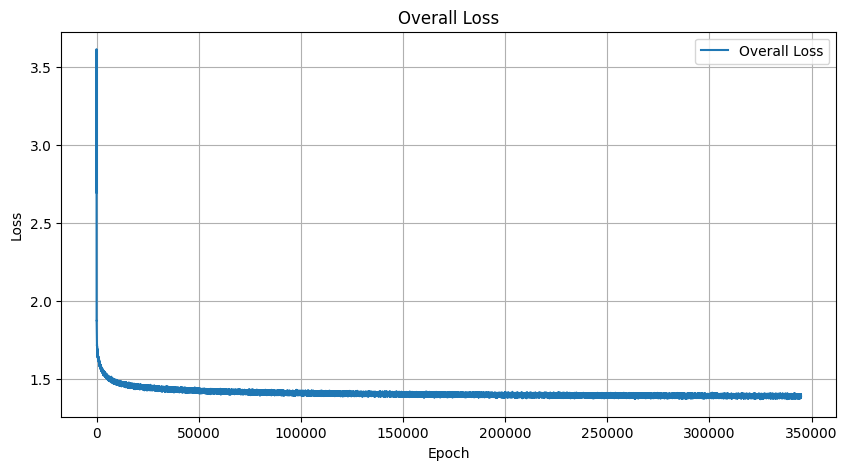

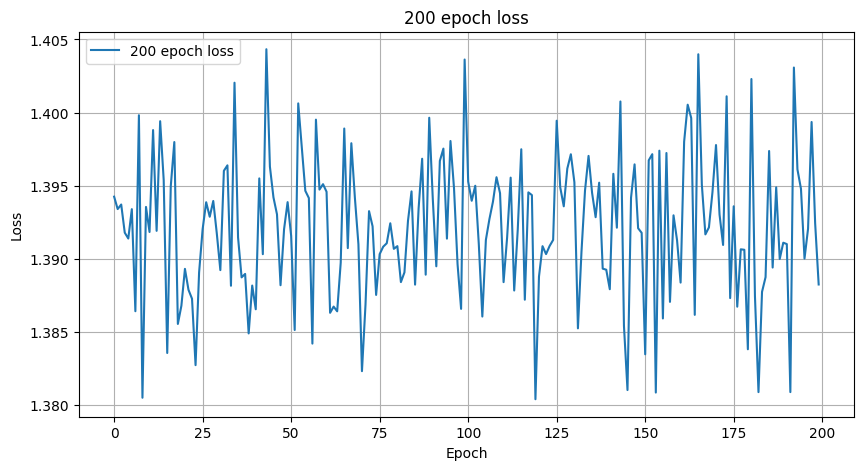

Epoch [1805701], Loss: 1.3970
Epoch [1805702], Loss: 1.3985
Epoch [1805703], Loss: 1.3977
Epoch [1805704], Loss: 1.3918
Epoch [1805705], Loss: 1.3813
Epoch [1805706], Loss: 1.3938
Epoch [1805707], Loss: 1.3909
Epoch [1805708], Loss: 1.3863
Epoch [1805709], Loss: 1.3874
Epoch [1805710], Loss: 1.3900
Epoch [1805711], Loss: 1.3954
Epoch [1805712], Loss: 1.3941
Epoch [1805713], Loss: 1.3909
Epoch [1805714], Loss: 1.3915
Epoch [1805715], Loss: 1.3795
Epoch [1805716], Loss: 1.3889
Epoch [1805717], Loss: 1.3951
Epoch [1805718], Loss: 1.3895
Epoch [1805719], Loss: 1.3875
Epoch [1805720], Loss: 1.3983
Epoch [1805721], Loss: 1.3894
Epoch [1805722], Loss: 1.3992
Epoch [1805723], Loss: 1.3979
Epoch [1805724], Loss: 1.3942
Epoch [1805725], Loss: 1.3937
Epoch [1805726], Loss: 1.3942
Epoch [1805727], Loss: 1.3896
Epoch [1805728], Loss: 1.3884
Epoch [1805729], Loss: 1.3944
Epoch [1805730], Loss: 1.3908
Epoch [1805731], Loss: 1.3903
Epoch [1805732], Loss: 1.3948
Epoch [1805733], Loss: 1.3772
Epoch [180

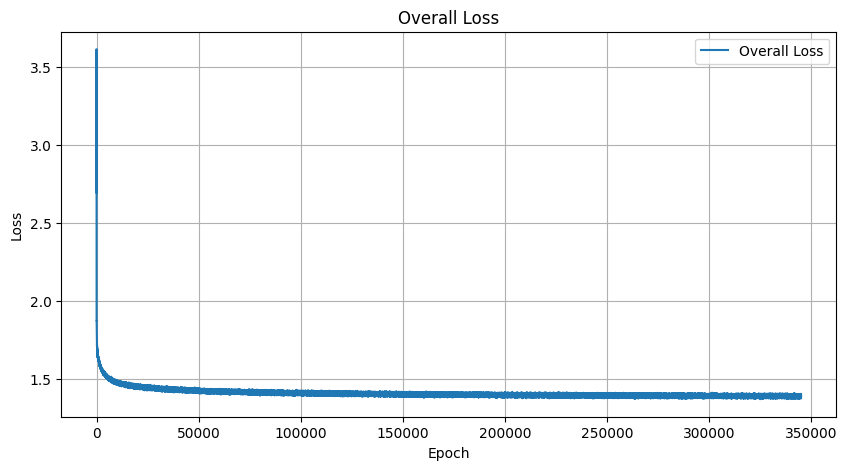

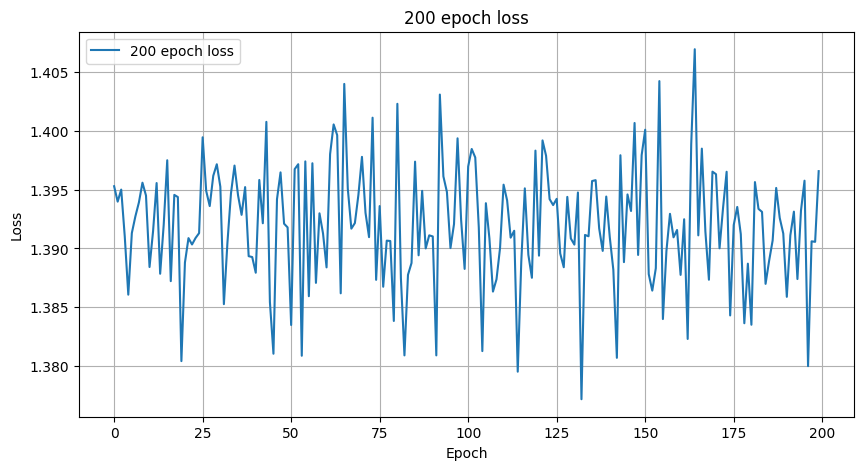

Epoch [1805801], Loss: 1.3956
Epoch [1805802], Loss: 1.3837
Epoch [1805803], Loss: 1.3909
Epoch [1805804], Loss: 1.3960
Epoch [1805805], Loss: 1.3963
Epoch [1805806], Loss: 1.3946
Epoch [1805807], Loss: 1.3993
Epoch [1805808], Loss: 1.3959
Epoch [1805809], Loss: 1.3953
Epoch [1805810], Loss: 1.3957
Epoch [1805811], Loss: 1.3893
Epoch [1805812], Loss: 1.3897
Epoch [1805813], Loss: 1.3948
Epoch [1805814], Loss: 1.3869
Epoch [1805815], Loss: 1.3926
Epoch [1805816], Loss: 1.3869
Epoch [1805817], Loss: 1.3925
Epoch [1805818], Loss: 1.3947
Epoch [1805819], Loss: 1.3916
Epoch [1805820], Loss: 1.3920
Epoch [1805821], Loss: 1.3923
Epoch [1805822], Loss: 1.3899
Epoch [1805823], Loss: 1.3928
Epoch [1805824], Loss: 1.3951
Epoch [1805825], Loss: 1.3982
Epoch [1805826], Loss: 1.3928
Epoch [1805827], Loss: 1.3995
Epoch [1805828], Loss: 1.3964
Epoch [1805829], Loss: 1.3887
Epoch [1805830], Loss: 1.3886
Epoch [1805831], Loss: 1.3874
Epoch [1805832], Loss: 1.4007
Epoch [1805833], Loss: 1.3944
Epoch [180

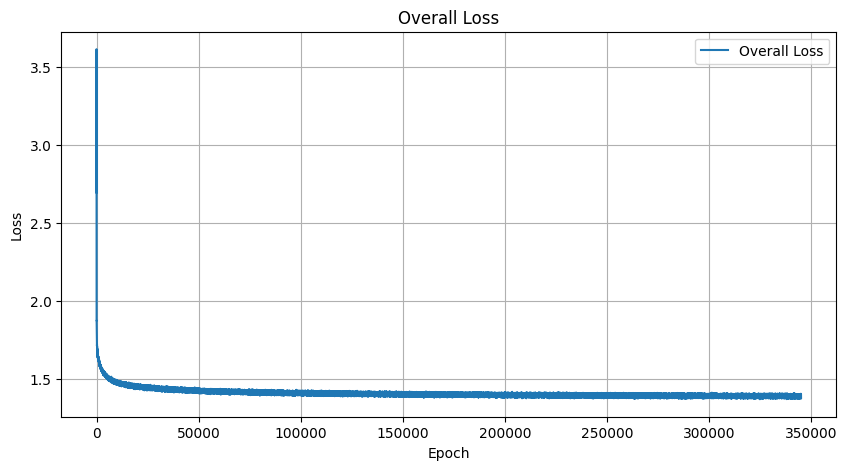

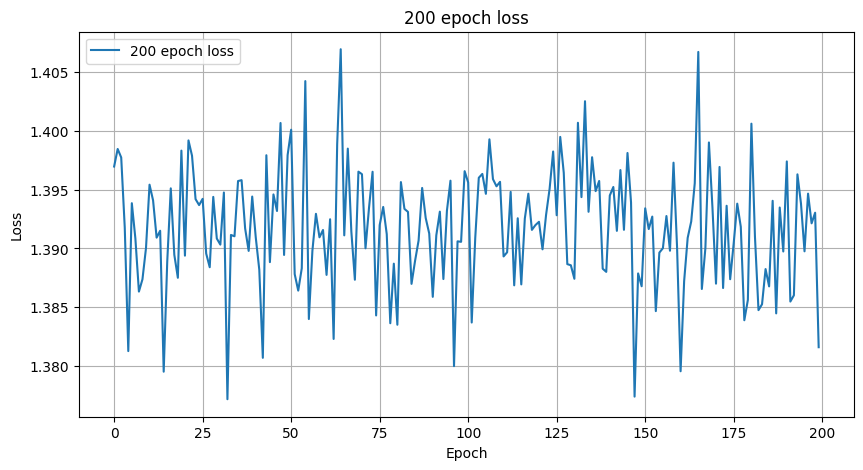

Epoch [1805901], Loss: 1.3940
Epoch [1805902], Loss: 1.3905
Epoch [1805903], Loss: 1.3854
Epoch [1805904], Loss: 1.3952
Epoch [1805905], Loss: 1.3975
Epoch [1805906], Loss: 1.3873
Epoch [1805907], Loss: 1.3871
Epoch [1805908], Loss: 1.3929
Epoch [1805909], Loss: 1.3895
Epoch [1805910], Loss: 1.3908
Epoch [1805911], Loss: 1.3940
Epoch [1805912], Loss: 1.3903
Epoch [1805913], Loss: 1.3925
Epoch [1805914], Loss: 1.3940
Epoch [1805915], Loss: 1.3948
Epoch [1805916], Loss: 1.3859
Epoch [1805917], Loss: 1.3873
Epoch [1805918], Loss: 1.3940
Epoch [1805919], Loss: 1.3902
Epoch [1805920], Loss: 1.3964
Epoch [1805921], Loss: 1.3901
Epoch [1805922], Loss: 1.3922
Epoch [1805923], Loss: 1.3796
Epoch [1805924], Loss: 1.3904
Epoch [1805925], Loss: 1.3857
Epoch [1805926], Loss: 1.3886
Epoch [1805927], Loss: 1.3886
Epoch [1805928], Loss: 1.3945
Epoch [1805929], Loss: 1.3859
Epoch [1805930], Loss: 1.3838
Epoch [1805931], Loss: 1.3985
Epoch [1805932], Loss: 1.3896
Epoch [1805933], Loss: 1.3985
Epoch [180

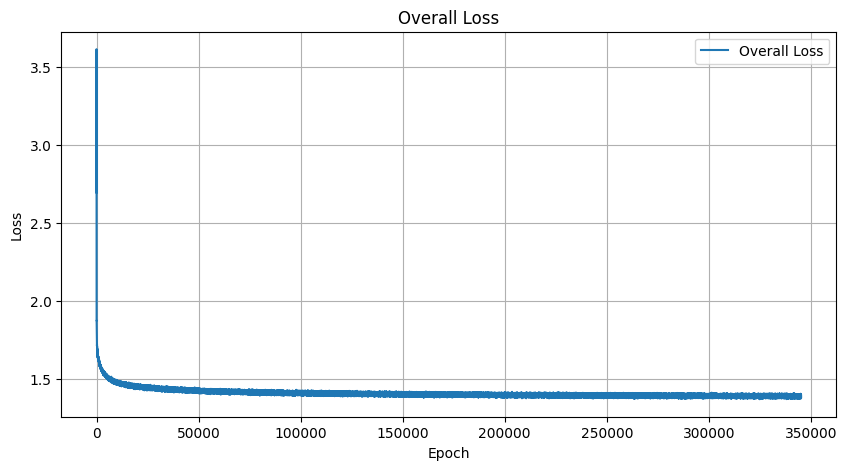

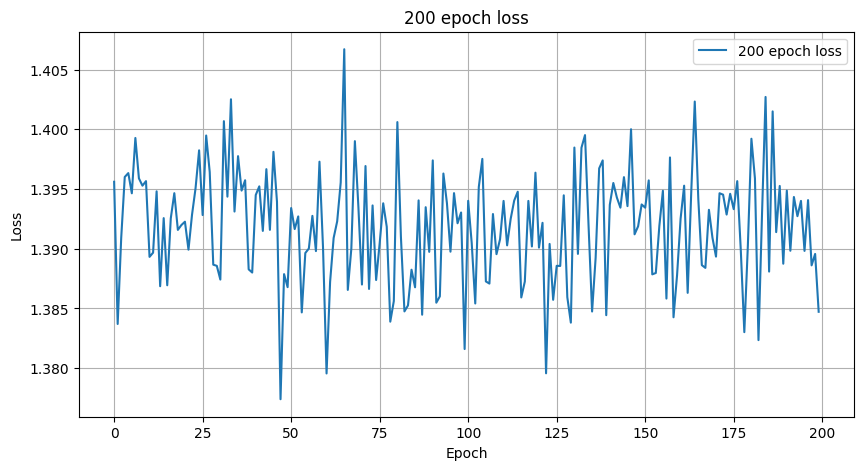

Epoch [1806001], Loss: 1.3893
Epoch [1806002], Loss: 1.3862
Epoch [1806003], Loss: 1.3857
Epoch [1806004], Loss: 1.3957
Epoch [1806005], Loss: 1.3899
Epoch [1806006], Loss: 1.3931
Epoch [1806007], Loss: 1.3881
Epoch [1806008], Loss: 1.3858
Epoch [1806009], Loss: 1.3968
Epoch [1806010], Loss: 1.4039
Epoch [1806011], Loss: 1.3965
Epoch [1806012], Loss: 1.3923
Epoch [1806013], Loss: 1.3934
Epoch [1806014], Loss: 1.3905
Epoch [1806015], Loss: 1.3988
Epoch [1806016], Loss: 1.3961
Epoch [1806017], Loss: 1.3884
Epoch [1806018], Loss: 1.3790
Epoch [1806019], Loss: 1.3903
Epoch [1806020], Loss: 1.3923
Epoch [1806021], Loss: 1.3933
Epoch [1806022], Loss: 1.3883
Epoch [1806023], Loss: 1.3893
Epoch [1806024], Loss: 1.3933
Epoch [1806025], Loss: 1.3933
Epoch [1806026], Loss: 1.4018
Epoch [1806027], Loss: 1.3969
Epoch [1806028], Loss: 1.3814
Epoch [1806029], Loss: 1.3852
Epoch [1806030], Loss: 1.3946
Epoch [1806031], Loss: 1.3923
Epoch [1806032], Loss: 1.3921
Epoch [1806033], Loss: 1.3909
Epoch [180

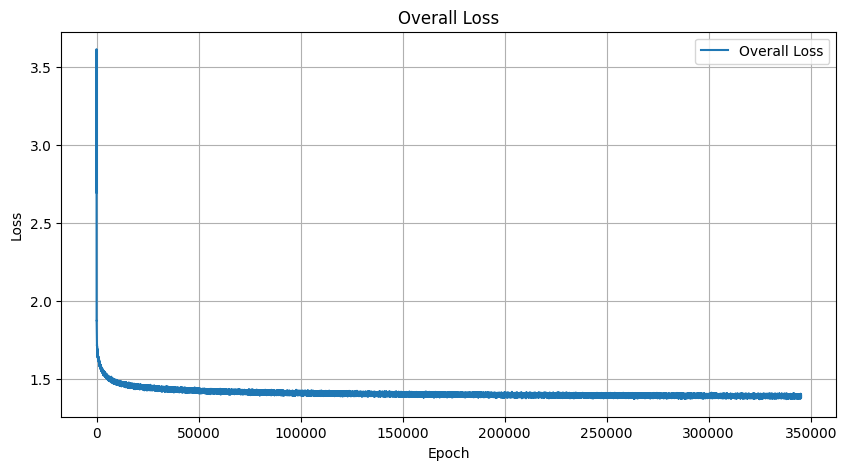

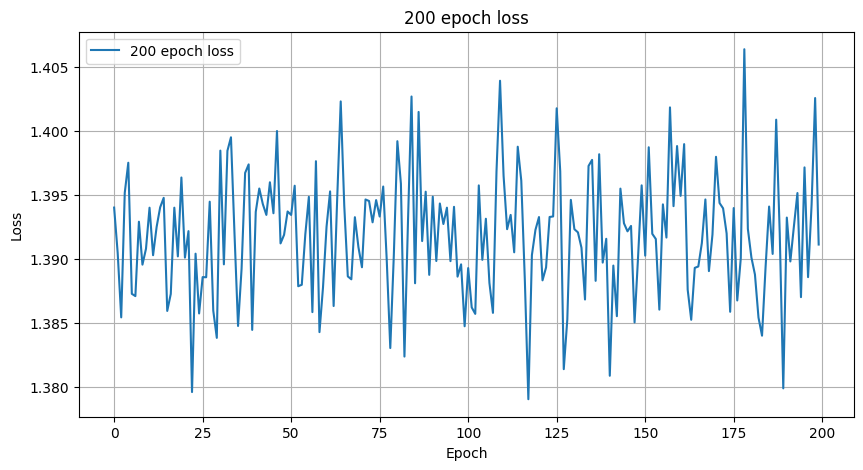

Epoch [1806101], Loss: 1.3915
Epoch [1806102], Loss: 1.3831
Epoch [1806103], Loss: 1.3920
Epoch [1806104], Loss: 1.3894
Epoch [1806105], Loss: 1.3917
Epoch [1806106], Loss: 1.3928
Epoch [1806107], Loss: 1.4009
Epoch [1806108], Loss: 1.3879
Epoch [1806109], Loss: 1.3877
Epoch [1806110], Loss: 1.3891
Epoch [1806111], Loss: 1.3892
Epoch [1806112], Loss: 1.3977
Epoch [1806113], Loss: 1.3896
Epoch [1806114], Loss: 1.3912
Epoch [1806115], Loss: 1.3988
Epoch [1806116], Loss: 1.3890
Epoch [1806117], Loss: 1.4023
Epoch [1806118], Loss: 1.4025
Epoch [1806119], Loss: 1.3945
Epoch [1806120], Loss: 1.3956
Epoch [1806121], Loss: 1.3929
Epoch [1806122], Loss: 1.3928
Epoch [1806123], Loss: 1.3964
Epoch [1806124], Loss: 1.3961
Epoch [1806125], Loss: 1.3963
Epoch [1806126], Loss: 1.3964
Epoch [1806127], Loss: 1.3933
Epoch [1806128], Loss: 1.3932
Epoch [1806129], Loss: 1.3916
Epoch [1806130], Loss: 1.3965
Epoch [1806131], Loss: 1.3947
Epoch [1806132], Loss: 1.3899
Epoch [1806133], Loss: 1.3847
Epoch [180

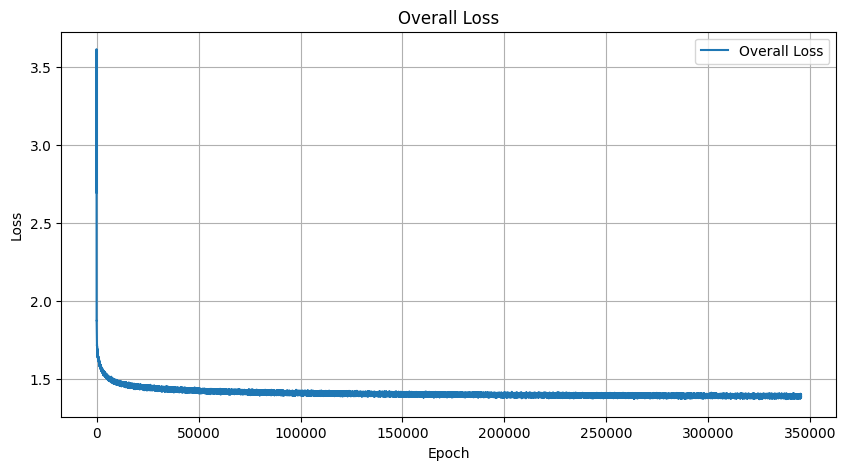

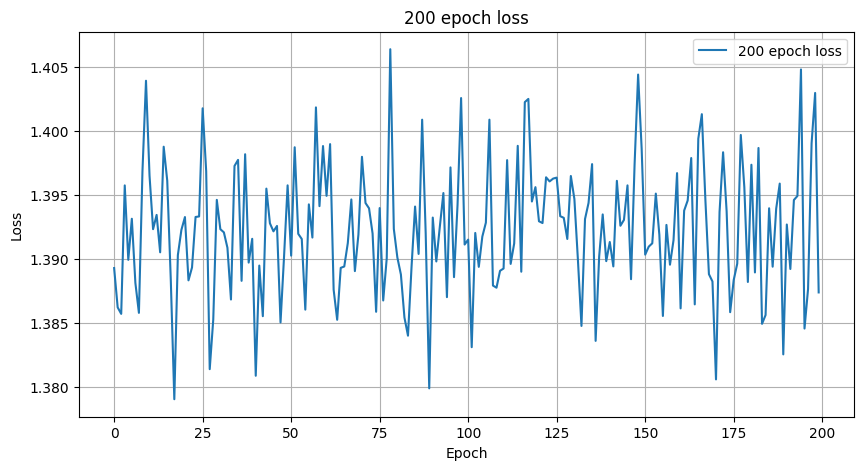

Epoch [1806201], Loss: 1.3951
Epoch [1806202], Loss: 1.3865
Epoch [1806203], Loss: 1.3975
Epoch [1806204], Loss: 1.3840
Epoch [1806205], Loss: 1.3928
Epoch [1806206], Loss: 1.3957
Epoch [1806207], Loss: 1.3927
Epoch [1806208], Loss: 1.3877
Epoch [1806209], Loss: 1.3858
Epoch [1806210], Loss: 1.3933
Epoch [1806211], Loss: 1.3953
Epoch [1806212], Loss: 1.3986
Epoch [1806213], Loss: 1.3929
Epoch [1806214], Loss: 1.3896
Epoch [1806215], Loss: 1.3891
Epoch [1806216], Loss: 1.3977
Epoch [1806217], Loss: 1.3874
Epoch [1806218], Loss: 1.3909
Epoch [1806219], Loss: 1.3840
Epoch [1806220], Loss: 1.3945
Epoch [1806221], Loss: 1.3957
Epoch [1806222], Loss: 1.3949
Epoch [1806223], Loss: 1.3909
Epoch [1806224], Loss: 1.3909
Epoch [1806225], Loss: 1.3892
Epoch [1806226], Loss: 1.3959
Epoch [1806227], Loss: 1.3892
Epoch [1806228], Loss: 1.3892
Epoch [1806229], Loss: 1.3923
Epoch [1806230], Loss: 1.3858
Epoch [1806231], Loss: 1.3916
Epoch [1806232], Loss: 1.3825
Epoch [1806233], Loss: 1.3966
Epoch [180

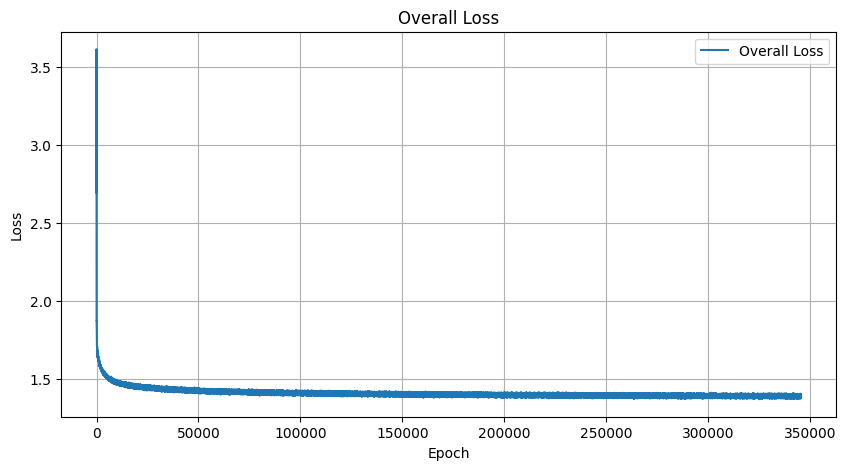

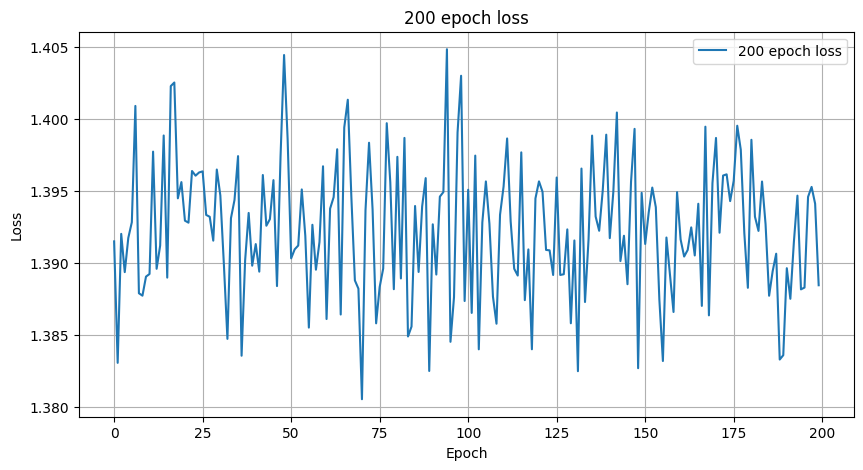

Epoch [1806301], Loss: 1.3926
Epoch [1806302], Loss: 1.3904
Epoch [1806303], Loss: 1.3895
Epoch [1806304], Loss: 1.3942
Epoch [1806305], Loss: 1.3878
Epoch [1806306], Loss: 1.3954
Epoch [1806307], Loss: 1.3899
Epoch [1806308], Loss: 1.3931
Epoch [1806309], Loss: 1.3926
Epoch [1806310], Loss: 1.3838
Epoch [1806311], Loss: 1.3864
Epoch [1806312], Loss: 1.3913
Epoch [1806313], Loss: 1.3881
Epoch [1806314], Loss: 1.3877
Epoch [1806315], Loss: 1.3885
Epoch [1806316], Loss: 1.4024
Epoch [1806317], Loss: 1.3880
Epoch [1806318], Loss: 1.3847
Epoch [1806319], Loss: 1.3889
Epoch [1806320], Loss: 1.3919
Epoch [1806321], Loss: 1.3928
Epoch [1806322], Loss: 1.3914
Epoch [1806323], Loss: 1.3884
Epoch [1806324], Loss: 1.3919
Epoch [1806325], Loss: 1.3933
Epoch [1806326], Loss: 1.3828
Epoch [1806327], Loss: 1.3848
Epoch [1806328], Loss: 1.3908
Epoch [1806329], Loss: 1.3937
Epoch [1806330], Loss: 1.3900
Epoch [1806331], Loss: 1.3907
Epoch [1806332], Loss: 1.3908
Epoch [1806333], Loss: 1.3951
Epoch [180

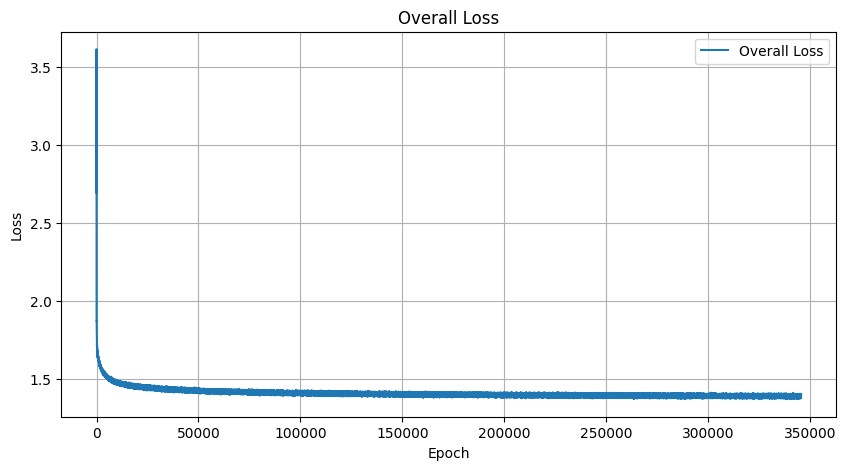

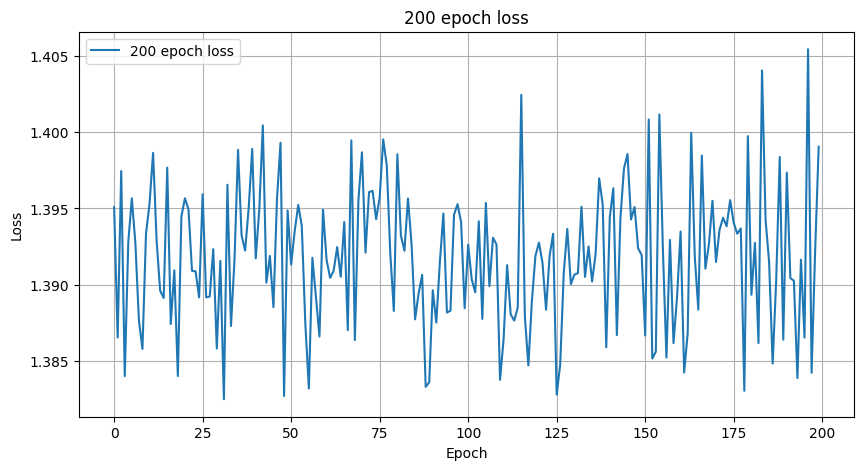

Epoch [1806401], Loss: 1.3878
Epoch [1806402], Loss: 1.4007
Epoch [1806403], Loss: 1.3908
Epoch [1806404], Loss: 1.3949
Epoch [1806405], Loss: 1.4042
Epoch [1806406], Loss: 1.3917
Epoch [1806407], Loss: 1.3945
Epoch [1806408], Loss: 1.3864
Epoch [1806409], Loss: 1.3884
Epoch [1806410], Loss: 1.3993
Epoch [1806411], Loss: 1.3930
Epoch [1806412], Loss: 1.3891
Epoch [1806413], Loss: 1.3851
Epoch [1806414], Loss: 1.4003
Epoch [1806415], Loss: 1.3857
Epoch [1806416], Loss: 1.3894
Epoch [1806417], Loss: 1.3896
Epoch [1806418], Loss: 1.3936
Epoch [1806419], Loss: 1.3965
Epoch [1806420], Loss: 1.3907
Epoch [1806421], Loss: 1.4003
Epoch [1806422], Loss: 1.3872
Epoch [1806423], Loss: 1.3932
Epoch [1806424], Loss: 1.3909
Epoch [1806425], Loss: 1.3795
Epoch [1806426], Loss: 1.3935
Epoch [1806427], Loss: 1.3896
Epoch [1806428], Loss: 1.3967
Epoch [1806429], Loss: 1.3989
Epoch [1806430], Loss: 1.3882
Epoch [1806431], Loss: 1.3887
Epoch [1806432], Loss: 1.3887
Epoch [1806433], Loss: 1.3878
Epoch [180

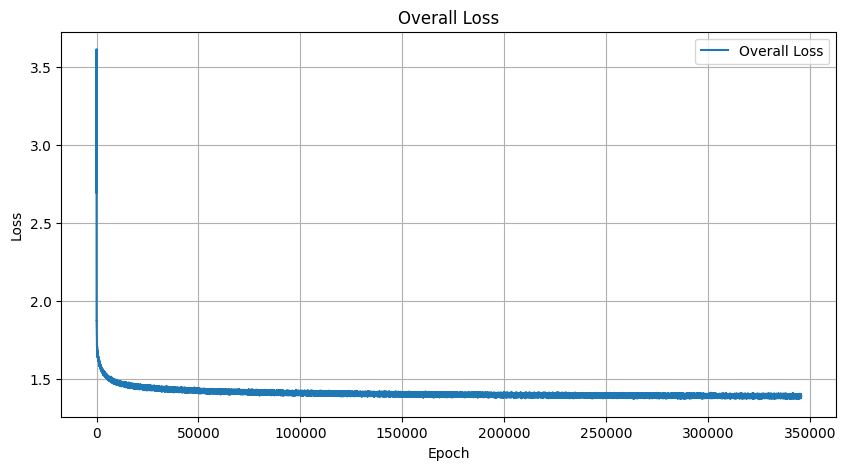

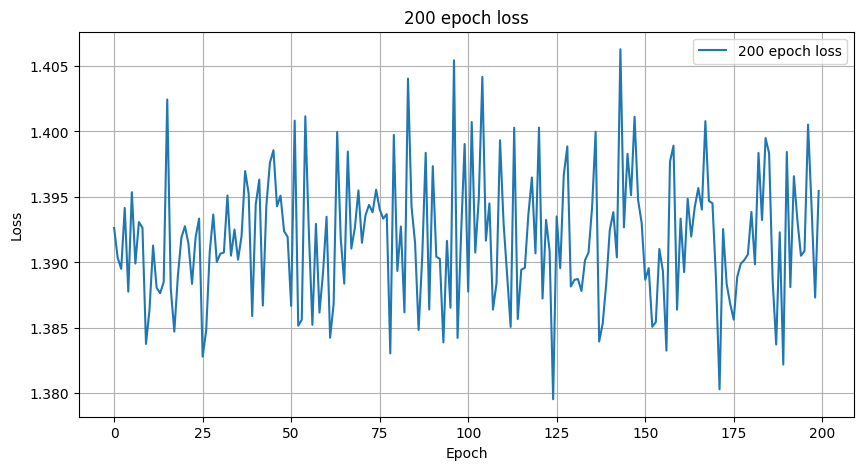

Epoch [1806501], Loss: 1.3899
Epoch [1806502], Loss: 1.3968
Epoch [1806503], Loss: 1.3984
Epoch [1806504], Loss: 1.3899
Epoch [1806505], Loss: 1.3912
Epoch [1806506], Loss: 1.3875
Epoch [1806507], Loss: 1.3989
Epoch [1806508], Loss: 1.3906
Epoch [1806509], Loss: 1.3939
Epoch [1806510], Loss: 1.3905
Epoch [1806511], Loss: 1.3916
Epoch [1806512], Loss: 1.3979
Epoch [1806513], Loss: 1.3911
Epoch [1806514], Loss: 1.3968
Epoch [1806515], Loss: 1.3997
Epoch [1806516], Loss: 1.3984
Epoch [1806517], Loss: 1.3926
Epoch [1806518], Loss: 1.3962
Epoch [1806519], Loss: 1.4016
Epoch [1806520], Loss: 1.3986
Epoch [1806521], Loss: 1.3865
Epoch [1806522], Loss: 1.3931
Epoch [1806523], Loss: 1.3948
Epoch [1806524], Loss: 1.3919
Epoch [1806525], Loss: 1.3912
Epoch [1806526], Loss: 1.3942
Epoch [1806527], Loss: 1.3854
Epoch [1806528], Loss: 1.3936
Epoch [1806529], Loss: 1.3820
Epoch [1806530], Loss: 1.3929
Epoch [1806531], Loss: 1.3936
Epoch [1806532], Loss: 1.3962
Epoch [1806533], Loss: 1.3849
Epoch [180

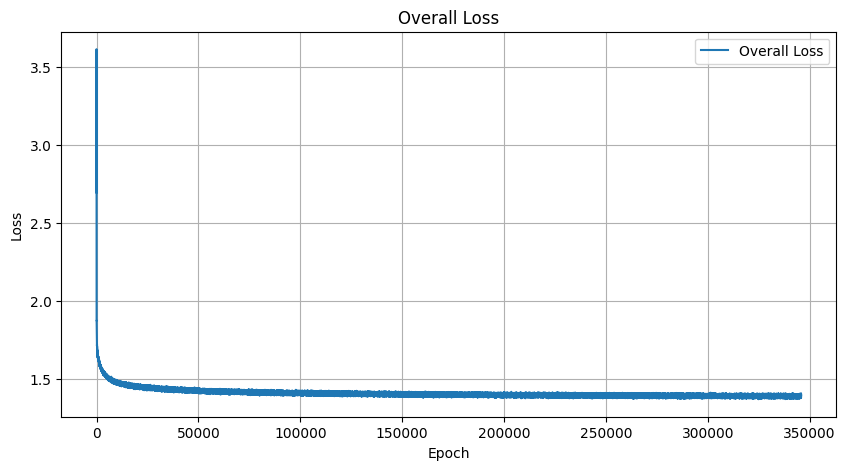

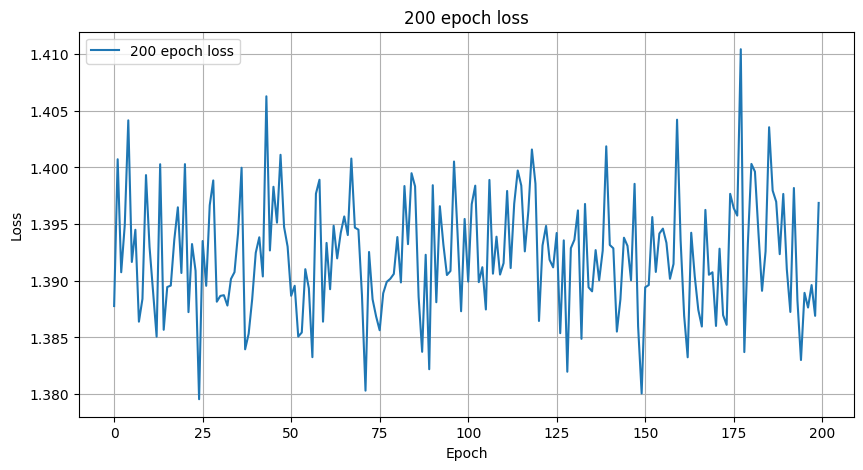

Epoch [1806601], Loss: 1.3880
Epoch [1806602], Loss: 1.3962
Epoch [1806603], Loss: 1.3933
Epoch [1806604], Loss: 1.3895
Epoch [1806605], Loss: 1.3878
Epoch [1806606], Loss: 1.4006
Epoch [1806607], Loss: 1.3962
Epoch [1806608], Loss: 1.3941
Epoch [1806609], Loss: 1.3935
Epoch [1806610], Loss: 1.3900
Epoch [1806611], Loss: 1.3932
Epoch [1806612], Loss: 1.3865
Epoch [1806613], Loss: 1.3925
Epoch [1806614], Loss: 1.3926
Epoch [1806615], Loss: 1.3938
Epoch [1806616], Loss: 1.3958
Epoch [1806617], Loss: 1.3949
Epoch [1806618], Loss: 1.3902
Epoch [1806619], Loss: 1.3914
Epoch [1806620], Loss: 1.3881
Epoch [1806621], Loss: 1.4010
Epoch [1806622], Loss: 1.3912
Epoch [1806623], Loss: 1.3863
Epoch [1806624], Loss: 1.3903
Epoch [1806625], Loss: 1.3939
Epoch [1806626], Loss: 1.3965
Epoch [1806627], Loss: 1.3846
Epoch [1806628], Loss: 1.3873
Epoch [1806629], Loss: 1.3961
Epoch [1806630], Loss: 1.3963
Epoch [1806631], Loss: 1.3867
Epoch [1806632], Loss: 1.3980
Epoch [1806633], Loss: 1.3898
Epoch [180

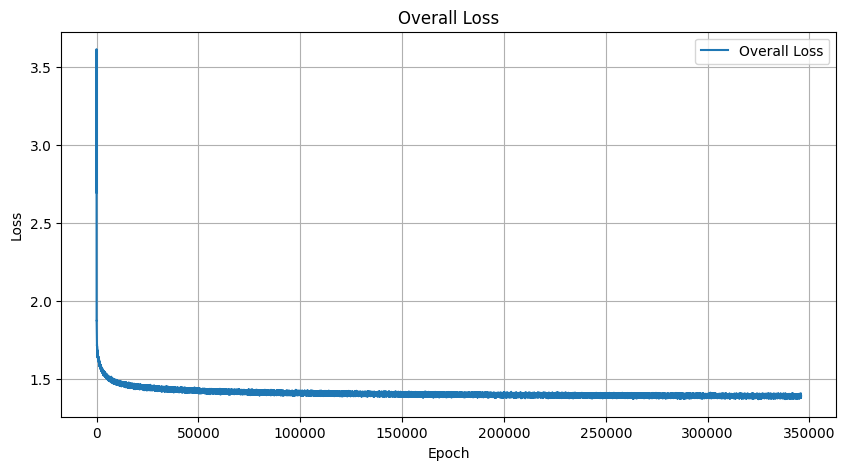

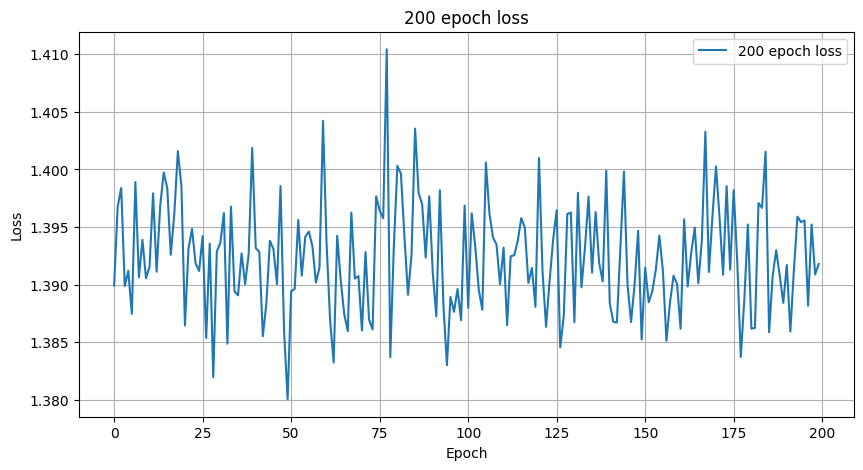

Epoch [1806701], Loss: 1.3835
Epoch [1806702], Loss: 1.3808
Epoch [1806703], Loss: 1.4019
Epoch [1806704], Loss: 1.3853
Epoch [1806705], Loss: 1.3867
Epoch [1806706], Loss: 1.3918
Epoch [1806707], Loss: 1.3910
Epoch [1806708], Loss: 1.3892
Epoch [1806709], Loss: 1.3872
Epoch [1806710], Loss: 1.3875
Epoch [1806711], Loss: 1.3976
Epoch [1806712], Loss: 1.3933
Epoch [1806713], Loss: 1.3919
Epoch [1806714], Loss: 1.3912
Epoch [1806715], Loss: 1.3990
Epoch [1806716], Loss: 1.3961
Epoch [1806717], Loss: 1.3851
Epoch [1806718], Loss: 1.3988
Epoch [1806719], Loss: 1.3898
Epoch [1806720], Loss: 1.3866
Epoch [1806721], Loss: 1.3827
Epoch [1806722], Loss: 1.3789
Epoch [1806723], Loss: 1.3906
Epoch [1806724], Loss: 1.3919
Epoch [1806725], Loss: 1.3860
Epoch [1806726], Loss: 1.3896
Epoch [1806727], Loss: 1.4021
Epoch [1806728], Loss: 1.4027
Epoch [1806729], Loss: 1.3954
Epoch [1806730], Loss: 1.3922
Epoch [1806731], Loss: 1.3785
Epoch [1806732], Loss: 1.3941
Epoch [1806733], Loss: 1.3921
Epoch [180

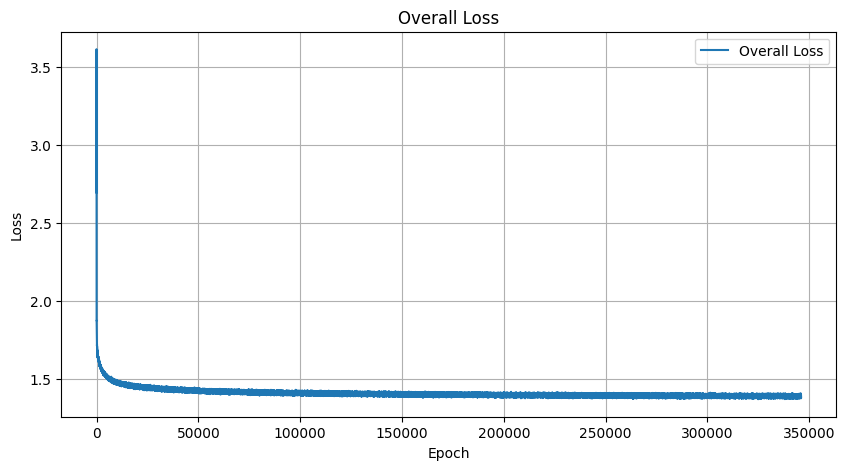

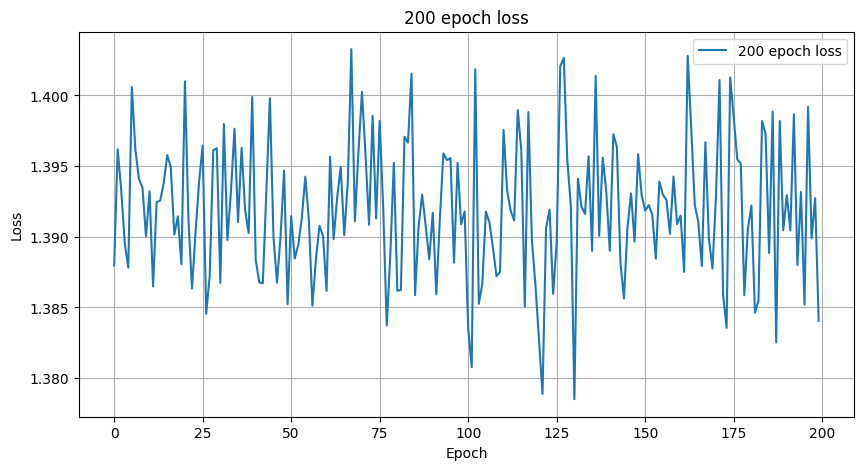

Epoch [1806801], Loss: 1.3914
Epoch [1806802], Loss: 1.3961
Epoch [1806803], Loss: 1.3978
Epoch [1806804], Loss: 1.3797
Epoch [1806805], Loss: 1.3884
Epoch [1806806], Loss: 1.3859
Epoch [1806807], Loss: 1.3937
Epoch [1806808], Loss: 1.3859
Epoch [1806809], Loss: 1.3921
Epoch [1806810], Loss: 1.3980
Epoch [1806811], Loss: 1.3900
Epoch [1806812], Loss: 1.3886
Epoch [1806813], Loss: 1.3908
Epoch [1806814], Loss: 1.3852
Epoch [1806815], Loss: 1.3907
Epoch [1806816], Loss: 1.3908
Epoch [1806817], Loss: 1.3924
Epoch [1806818], Loss: 1.3883
Epoch [1806819], Loss: 1.3959
Epoch [1806820], Loss: 1.3971
Epoch [1806821], Loss: 1.3905
Epoch [1806822], Loss: 1.3973
Epoch [1806823], Loss: 1.3846
Epoch [1806824], Loss: 1.3934
Epoch [1806825], Loss: 1.3871
Epoch [1806826], Loss: 1.3939
Epoch [1806827], Loss: 1.3864
Epoch [1806828], Loss: 1.3968
Epoch [1806829], Loss: 1.3998
Epoch [1806830], Loss: 1.3872
Epoch [1806831], Loss: 1.3849
Epoch [1806832], Loss: 1.3862
Epoch [1806833], Loss: 1.3875
Epoch [180

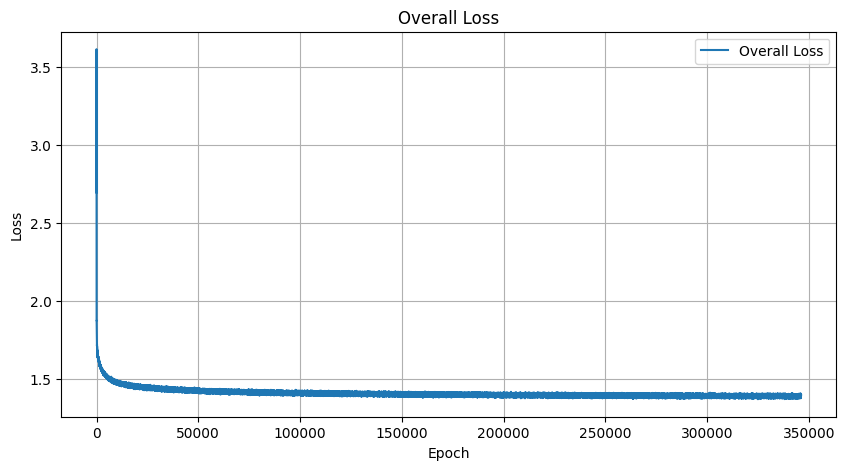

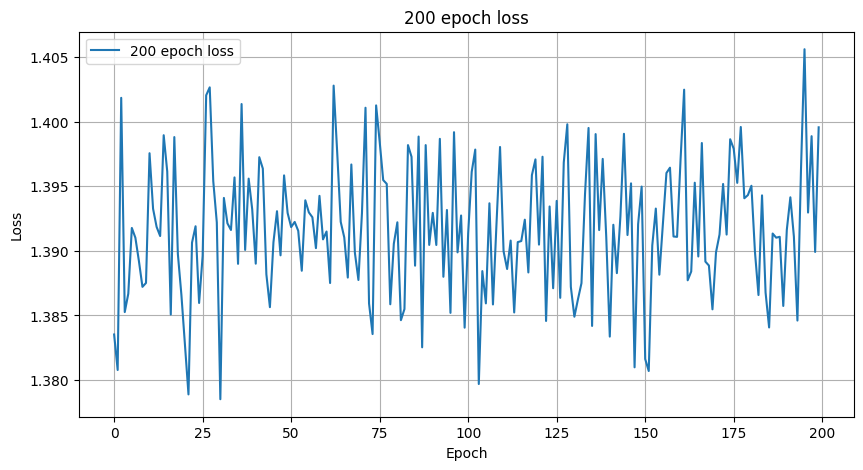

Epoch [1806901], Loss: 1.3986
Epoch [1806902], Loss: 1.3872
Epoch [1806903], Loss: 1.3919
Epoch [1806904], Loss: 1.3930
Epoch [1806905], Loss: 1.3956
Epoch [1806906], Loss: 1.3888
Epoch [1806907], Loss: 1.3961
Epoch [1806908], Loss: 1.3923
Epoch [1806909], Loss: 1.3827
Epoch [1806910], Loss: 1.3863
Epoch [1806911], Loss: 1.3993
Epoch [1806912], Loss: 1.4015
Epoch [1806913], Loss: 1.3911
Epoch [1806914], Loss: 1.4018
Epoch [1806915], Loss: 1.3939
Epoch [1806916], Loss: 1.3830
Epoch [1806917], Loss: 1.3891
Epoch [1806918], Loss: 1.3950
Epoch [1806919], Loss: 1.3830
Epoch [1806920], Loss: 1.3966
Epoch [1806921], Loss: 1.3966
Epoch [1806922], Loss: 1.3888
Epoch [1806923], Loss: 1.3937
Epoch [1806924], Loss: 1.4044
Epoch [1806925], Loss: 1.3875
Epoch [1806926], Loss: 1.3996
Epoch [1806927], Loss: 1.3865
Epoch [1806928], Loss: 1.3924
Epoch [1806929], Loss: 1.3943
Epoch [1806930], Loss: 1.3970
Epoch [1806931], Loss: 1.3954
Epoch [1806932], Loss: 1.3936
Epoch [1806933], Loss: 1.3938
Epoch [180

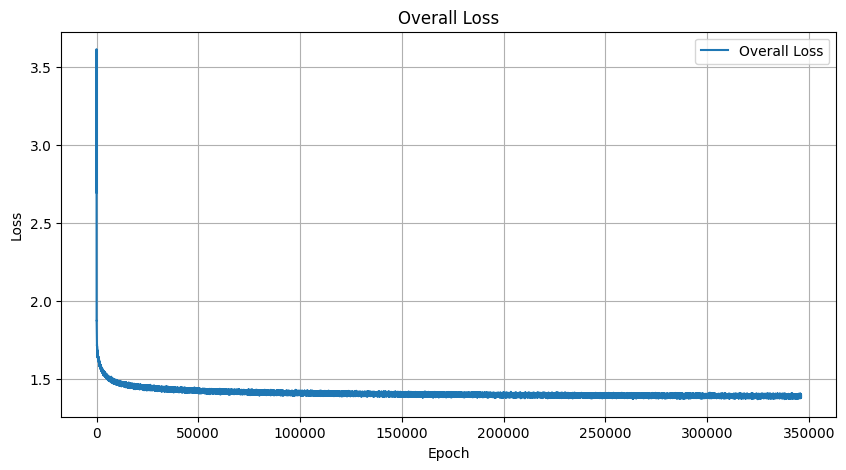

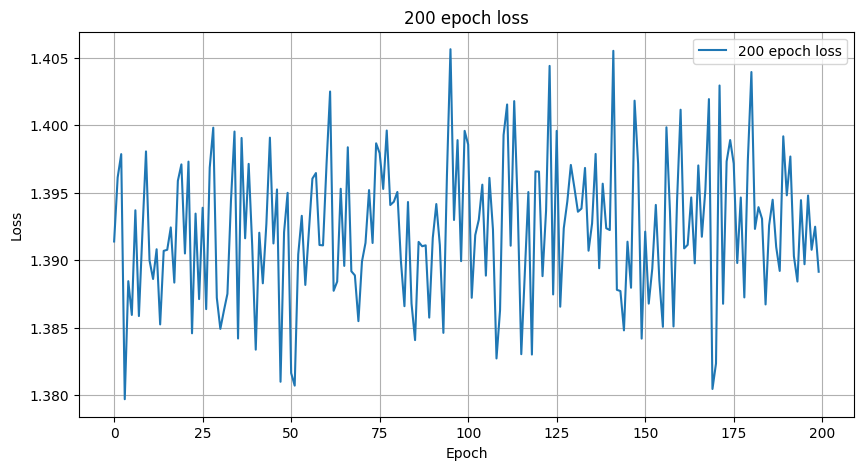

Epoch [1807001], Loss: 1.3945
Epoch [1807002], Loss: 1.3954
Epoch [1807003], Loss: 1.3895
Epoch [1807004], Loss: 1.3947
Epoch [1807005], Loss: 1.3878
Epoch [1807006], Loss: 1.3878
Epoch [1807007], Loss: 1.3919
Epoch [1807008], Loss: 1.3896
Epoch [1807009], Loss: 1.3910
Epoch [1807010], Loss: 1.3893
Epoch [1807011], Loss: 1.3825
Epoch [1807012], Loss: 1.3965
Epoch [1807013], Loss: 1.3972
Epoch [1807014], Loss: 1.3945
Epoch [1807015], Loss: 1.3984
Epoch [1807016], Loss: 1.3926
Epoch [1807017], Loss: 1.4041
Epoch [1807018], Loss: 1.3905
Epoch [1807019], Loss: 1.3924
Epoch [1807020], Loss: 1.4014
Epoch [1807021], Loss: 1.3886
Epoch [1807022], Loss: 1.3919
Epoch [1807023], Loss: 1.3885
Epoch [1807024], Loss: 1.3978
Epoch [1807025], Loss: 1.3927
Epoch [1807026], Loss: 1.3884
Epoch [1807027], Loss: 1.3840
Epoch [1807028], Loss: 1.4030
Epoch [1807029], Loss: 1.3969
Epoch [1807030], Loss: 1.3956
Epoch [1807031], Loss: 1.3923
Epoch [1807032], Loss: 1.3886
Epoch [1807033], Loss: 1.3954
Epoch [180

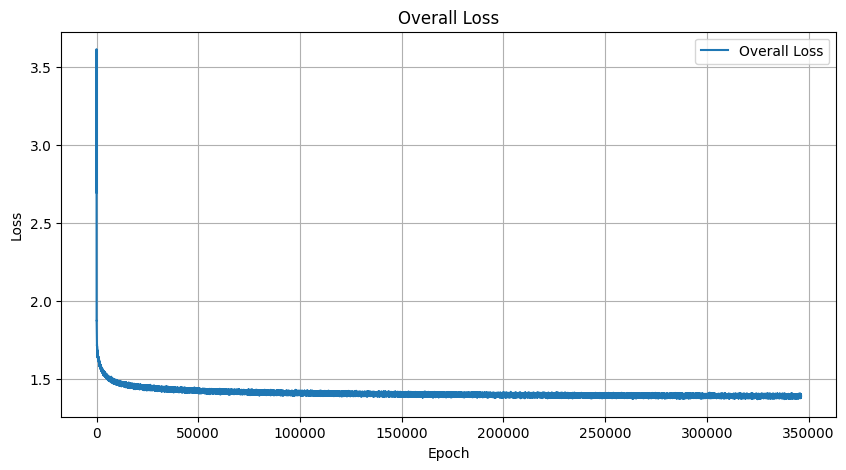

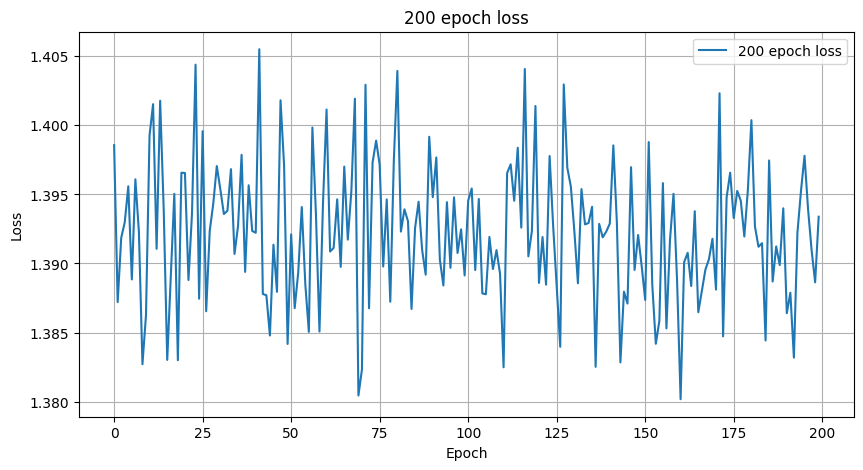

Epoch [1807101], Loss: 1.4034
Epoch [1807102], Loss: 1.3897
Epoch [1807103], Loss: 1.3862
Epoch [1807104], Loss: 1.3888
Epoch [1807105], Loss: 1.3856
Epoch [1807106], Loss: 1.3931
Epoch [1807107], Loss: 1.3962
Epoch [1807108], Loss: 1.3990
Epoch [1807109], Loss: 1.3796
Epoch [1807110], Loss: 1.3974
Epoch [1807111], Loss: 1.3858
Epoch [1807112], Loss: 1.3852
Epoch [1807113], Loss: 1.3958
Epoch [1807114], Loss: 1.3840
Epoch [1807115], Loss: 1.3897
Epoch [1807116], Loss: 1.3876
Epoch [1807117], Loss: 1.3909
Epoch [1807118], Loss: 1.3829
Epoch [1807119], Loss: 1.3949
Epoch [1807120], Loss: 1.3889
Epoch [1807121], Loss: 1.3975
Epoch [1807122], Loss: 1.4050
Epoch [1807123], Loss: 1.3960
Epoch [1807124], Loss: 1.3899
Epoch [1807125], Loss: 1.3994
Epoch [1807126], Loss: 1.4012
Epoch [1807127], Loss: 1.3919
Epoch [1807128], Loss: 1.3889
Epoch [1807129], Loss: 1.3874
Epoch [1807130], Loss: 1.3936
Epoch [1807131], Loss: 1.3908
Epoch [1807132], Loss: 1.3917
Epoch [1807133], Loss: 1.3907
Epoch [180

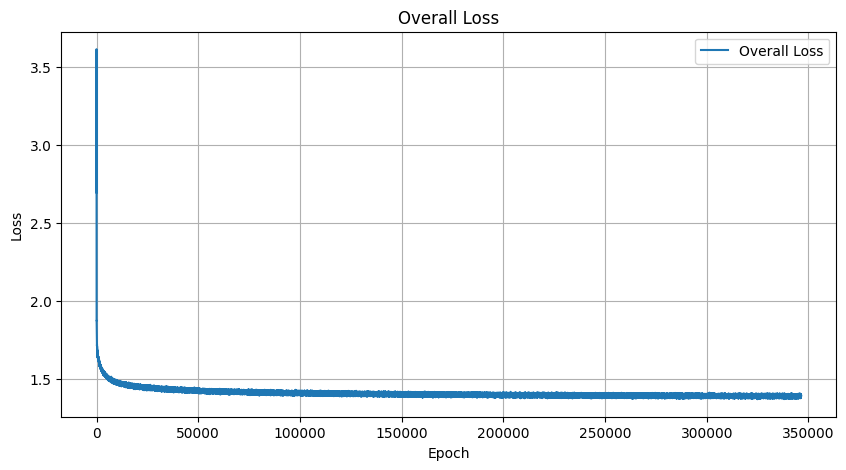

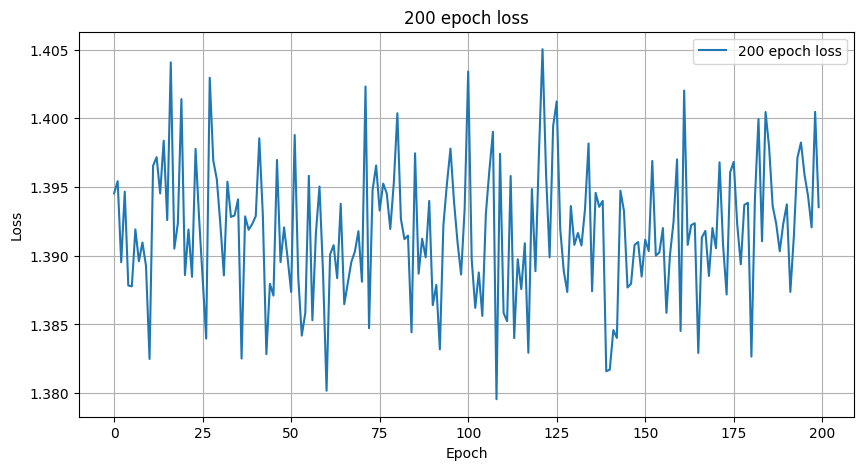

Epoch [1807201], Loss: 1.3822
Epoch [1807202], Loss: 1.3862
Epoch [1807203], Loss: 1.3916
Epoch [1807204], Loss: 1.3981
Epoch [1807205], Loss: 1.4016
Epoch [1807206], Loss: 1.3872
Epoch [1807207], Loss: 1.3841
Epoch [1807208], Loss: 1.3923
Epoch [1807209], Loss: 1.3928
Epoch [1807210], Loss: 1.3931
Epoch [1807211], Loss: 1.3951
Epoch [1807212], Loss: 1.4013
Epoch [1807213], Loss: 1.3873
Epoch [1807214], Loss: 1.3937
Epoch [1807215], Loss: 1.3930
Epoch [1807216], Loss: 1.3874
Epoch [1807217], Loss: 1.3915
Epoch [1807218], Loss: 1.3889
Epoch [1807219], Loss: 1.3945
Epoch [1807220], Loss: 1.3942
Epoch [1807221], Loss: 1.3867
Epoch [1807222], Loss: 1.3909
Epoch [1807223], Loss: 1.3974
Epoch [1807224], Loss: 1.3822
Epoch [1807225], Loss: 1.3930
Epoch [1807226], Loss: 1.3934
Epoch [1807227], Loss: 1.3983
Epoch [1807228], Loss: 1.3970
Epoch [1807229], Loss: 1.3991
Epoch [1807230], Loss: 1.3905
Epoch [1807231], Loss: 1.3897
Epoch [1807232], Loss: 1.3908
Epoch [1807233], Loss: 1.3944
Epoch [180

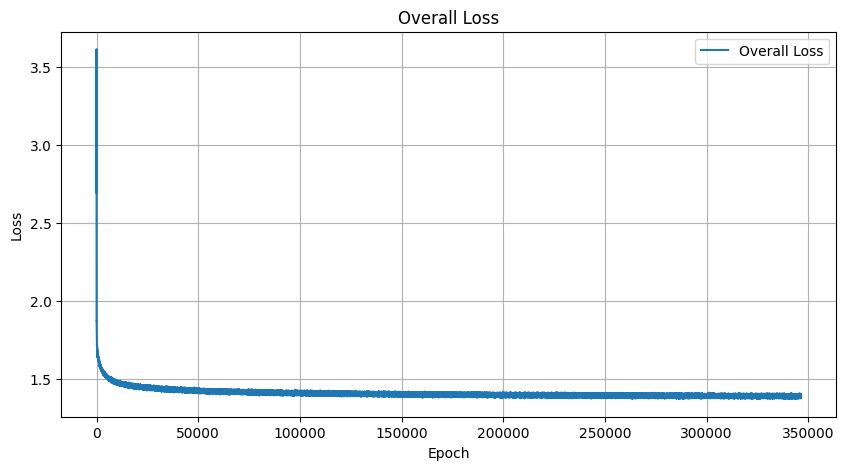

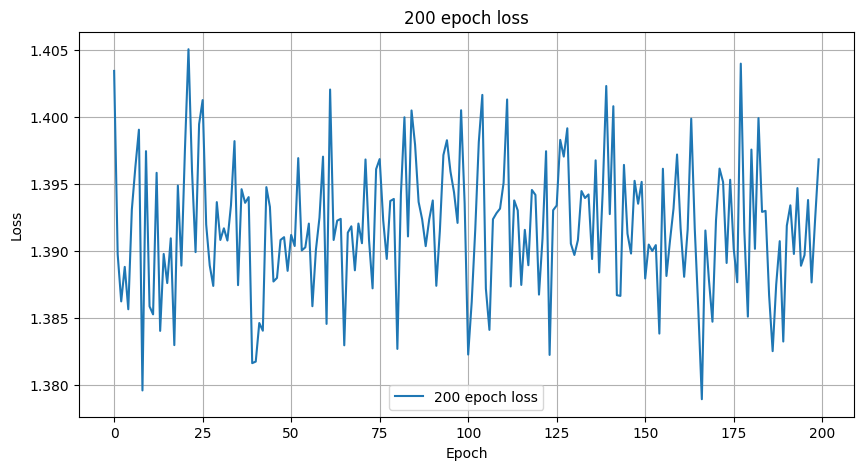

Epoch [1807301], Loss: 1.3915
Epoch [1807302], Loss: 1.3971
Epoch [1807303], Loss: 1.3897
Epoch [1807304], Loss: 1.3965
Epoch [1807305], Loss: 1.3929
Epoch [1807306], Loss: 1.3927
Epoch [1807307], Loss: 1.3942
Epoch [1807308], Loss: 1.3909
Epoch [1807309], Loss: 1.3986
Epoch [1807310], Loss: 1.3890
Epoch [1807311], Loss: 1.3938
Epoch [1807312], Loss: 1.3968
Epoch [1807313], Loss: 1.3914
Epoch [1807314], Loss: 1.3867
Epoch [1807315], Loss: 1.3955
Epoch [1807316], Loss: 1.3877
Epoch [1807317], Loss: 1.3994
Epoch [1807318], Loss: 1.3864
Epoch [1807319], Loss: 1.3808
Epoch [1807320], Loss: 1.3918
Epoch [1807321], Loss: 1.3893
Epoch [1807322], Loss: 1.3956
Epoch [1807323], Loss: 1.3920
Epoch [1807324], Loss: 1.3887
Epoch [1807325], Loss: 1.3912
Epoch [1807326], Loss: 1.3904
Epoch [1807327], Loss: 1.3861
Epoch [1807328], Loss: 1.3857
Epoch [1807329], Loss: 1.3906
Epoch [1807330], Loss: 1.3895
Epoch [1807331], Loss: 1.3938
Epoch [1807332], Loss: 1.3865
Epoch [1807333], Loss: 1.3903
Epoch [180

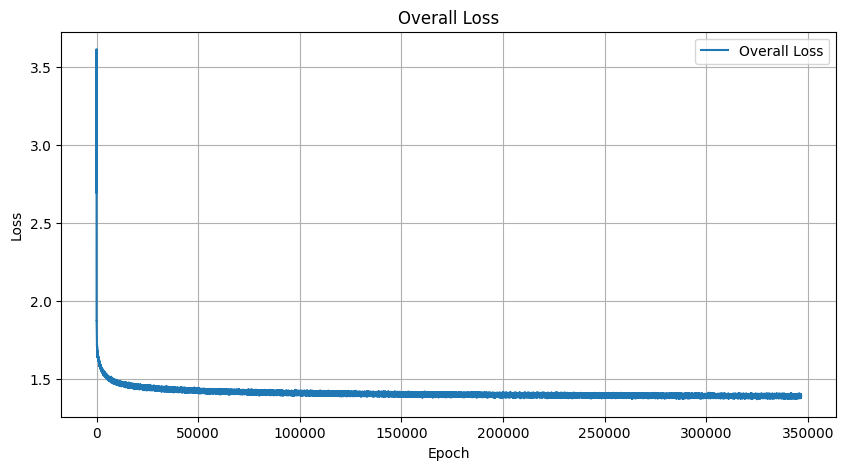

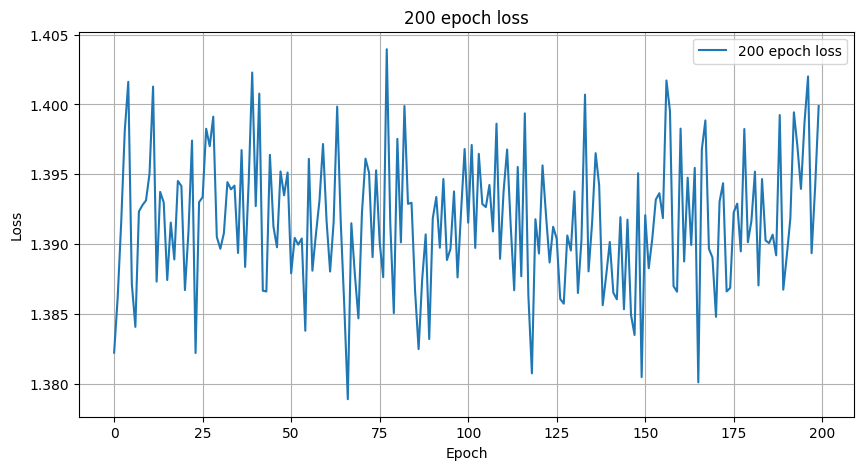

Epoch [1807401], Loss: 1.4002
Epoch [1807402], Loss: 1.3893
Epoch [1807403], Loss: 1.3981
Epoch [1807404], Loss: 1.3882
Epoch [1807405], Loss: 1.3977
Epoch [1807406], Loss: 1.3920
Epoch [1807407], Loss: 1.3835
Epoch [1807408], Loss: 1.3864
Epoch [1807409], Loss: 1.3902
Epoch [1807410], Loss: 1.3879
Epoch [1807411], Loss: 1.3917
Epoch [1807412], Loss: 1.3885
Epoch [1807413], Loss: 1.3928
Epoch [1807414], Loss: 1.3969
Epoch [1807415], Loss: 1.3952
Epoch [1807416], Loss: 1.3871
Epoch [1807417], Loss: 1.3835
Epoch [1807418], Loss: 1.3899
Epoch [1807419], Loss: 1.3881
Epoch [1807420], Loss: 1.3977
Epoch [1807421], Loss: 1.3947
Epoch [1807422], Loss: 1.3879
Epoch [1807423], Loss: 1.3917
Epoch [1807424], Loss: 1.3893
Epoch [1807425], Loss: 1.4005
Epoch [1807426], Loss: 1.3949
Epoch [1807427], Loss: 1.3934
Epoch [1807428], Loss: 1.3835
Epoch [1807429], Loss: 1.3914
Epoch [1807430], Loss: 1.3859
Epoch [1807431], Loss: 1.3977
Epoch [1807432], Loss: 1.3934
Epoch [1807433], Loss: 1.3885
Epoch [180

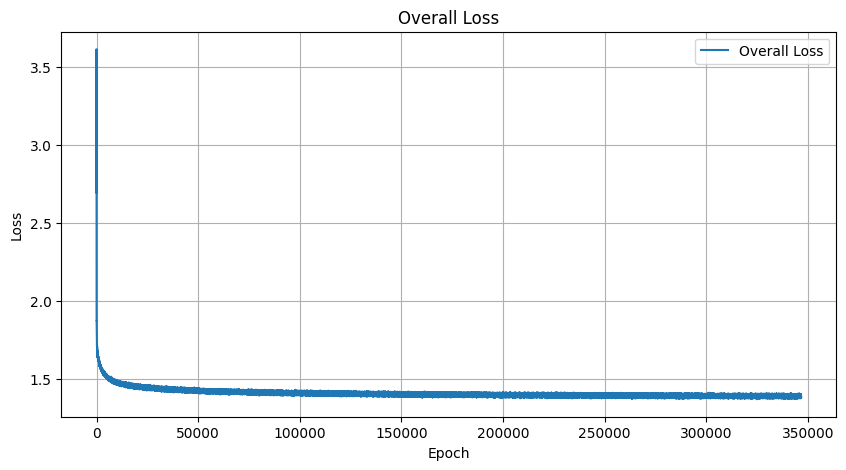

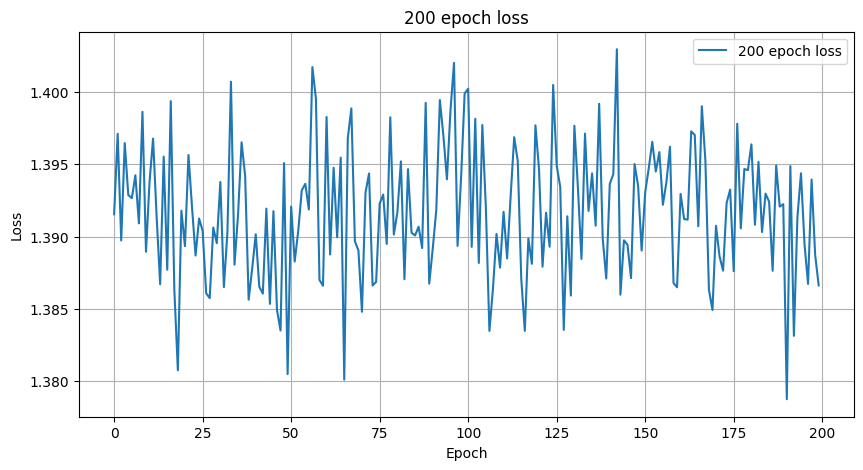

Epoch [1807501], Loss: 1.3881
Epoch [1807502], Loss: 1.3904
Epoch [1807503], Loss: 1.3933
Epoch [1807504], Loss: 1.3932
Epoch [1807505], Loss: 1.3980
Epoch [1807506], Loss: 1.3796
Epoch [1807507], Loss: 1.4000
Epoch [1807508], Loss: 1.4010
Epoch [1807509], Loss: 1.3944
Epoch [1807510], Loss: 1.3984
Epoch [1807511], Loss: 1.3968
Epoch [1807512], Loss: 1.3863
Epoch [1807513], Loss: 1.3978
Epoch [1807514], Loss: 1.3967
Epoch [1807515], Loss: 1.3884
Epoch [1807516], Loss: 1.3913
Epoch [1807517], Loss: 1.3858
Epoch [1807518], Loss: 1.3836
Epoch [1807519], Loss: 1.3839
Epoch [1807520], Loss: 1.3867
Epoch [1807521], Loss: 1.3927
Epoch [1807522], Loss: 1.3971
Epoch [1807523], Loss: 1.3930
Epoch [1807524], Loss: 1.3901
Epoch [1807525], Loss: 1.3930
Epoch [1807526], Loss: 1.3996
Epoch [1807527], Loss: 1.3972
Epoch [1807528], Loss: 1.3816
Epoch [1807529], Loss: 1.3968
Epoch [1807530], Loss: 1.3936
Epoch [1807531], Loss: 1.3910
Epoch [1807532], Loss: 1.3945
Epoch [1807533], Loss: 1.3916
Epoch [180

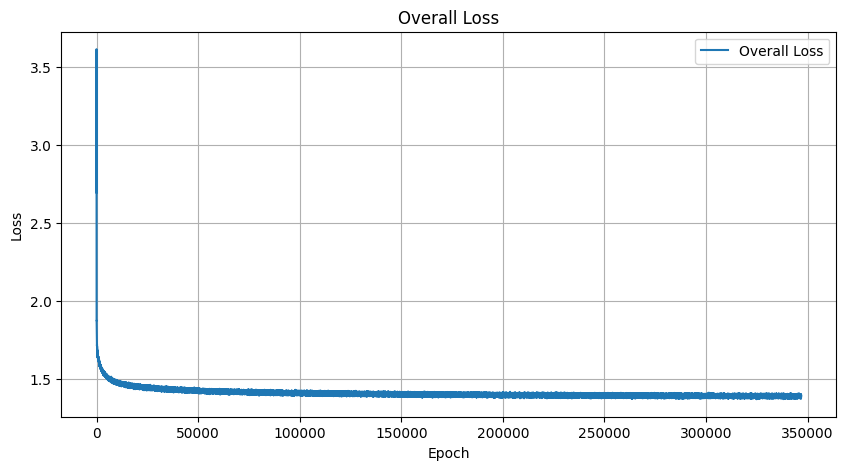

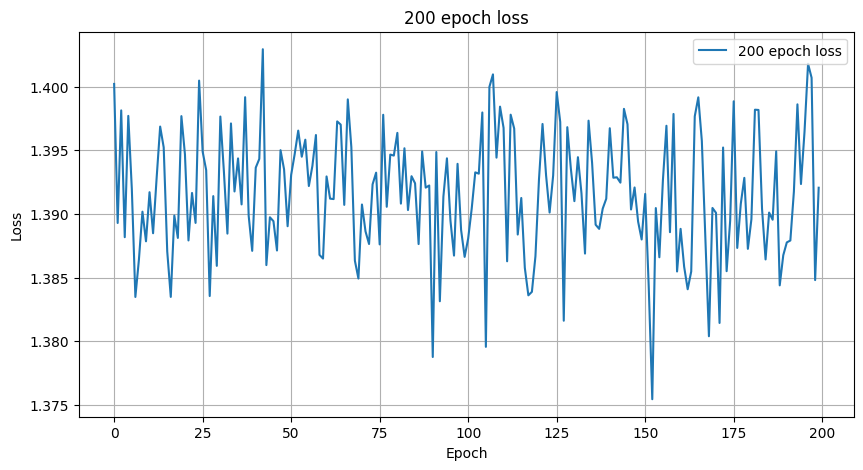

Epoch [1807601], Loss: 1.3917
Epoch [1807602], Loss: 1.3889
Epoch [1807603], Loss: 1.3851
Epoch [1807604], Loss: 1.3858
Epoch [1807605], Loss: 1.3961
Epoch [1807606], Loss: 1.3992
Epoch [1807607], Loss: 1.3957
Epoch [1807608], Loss: 1.3836
Epoch [1807609], Loss: 1.3921
Epoch [1807610], Loss: 1.3861
Epoch [1807611], Loss: 1.3954
Epoch [1807612], Loss: 1.3915
Epoch [1807613], Loss: 1.3938
Epoch [1807614], Loss: 1.3868
Epoch [1807615], Loss: 1.3956
Epoch [1807616], Loss: 1.3903
Epoch [1807617], Loss: 1.3912
Epoch [1807618], Loss: 1.3946
Epoch [1807619], Loss: 1.3974
Epoch [1807620], Loss: 1.3987
Epoch [1807621], Loss: 1.3974
Epoch [1807622], Loss: 1.3927
Epoch [1807623], Loss: 1.3825
Epoch [1807624], Loss: 1.3896
Epoch [1807625], Loss: 1.3992
Epoch [1807626], Loss: 1.3954
Epoch [1807627], Loss: 1.3986
Epoch [1807628], Loss: 1.3938
Epoch [1807629], Loss: 1.3884
Epoch [1807630], Loss: 1.3966
Epoch [1807631], Loss: 1.3988
Epoch [1807632], Loss: 1.3963
Epoch [1807633], Loss: 1.3910
Epoch [180

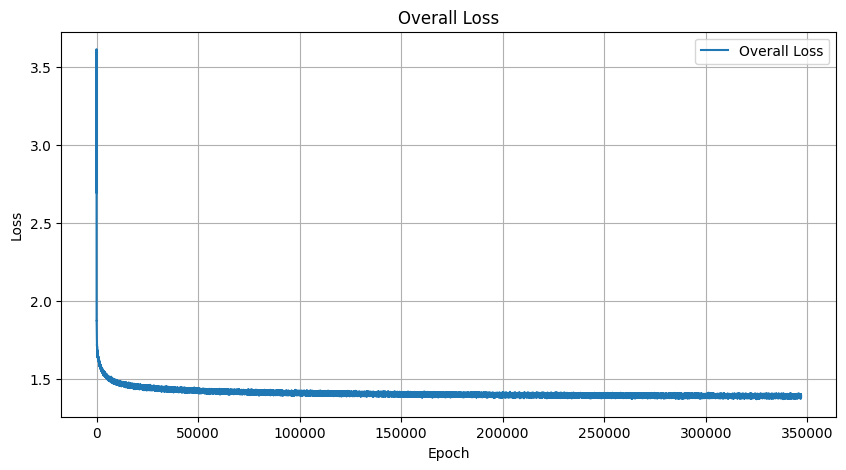

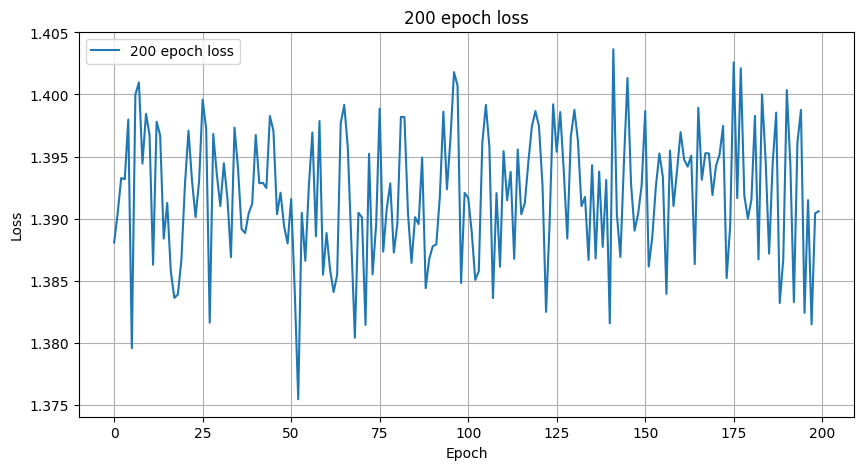

Epoch [1807701], Loss: 1.3870
Epoch [1807702], Loss: 1.3944
Epoch [1807703], Loss: 1.3896
Epoch [1807704], Loss: 1.3894
Epoch [1807705], Loss: 1.3823
Epoch [1807706], Loss: 1.3888
Epoch [1807707], Loss: 1.3814
Epoch [1807708], Loss: 1.4003
Epoch [1807709], Loss: 1.3982
Epoch [1807710], Loss: 1.3876
Epoch [1807711], Loss: 1.3913
Epoch [1807712], Loss: 1.3942
Epoch [1807713], Loss: 1.3890
Epoch [1807714], Loss: 1.3945
Epoch [1807715], Loss: 1.3951
Epoch [1807716], Loss: 1.3895
Epoch [1807717], Loss: 1.3848
Epoch [1807718], Loss: 1.3875
Epoch [1807719], Loss: 1.3922
Epoch [1807720], Loss: 1.3928
Epoch [1807721], Loss: 1.4042
Epoch [1807722], Loss: 1.3958
Epoch [1807723], Loss: 1.3955
Epoch [1807724], Loss: 1.3866
Epoch [1807725], Loss: 1.3963
Epoch [1807726], Loss: 1.3944
Epoch [1807727], Loss: 1.3896
Epoch [1807728], Loss: 1.3925
Epoch [1807729], Loss: 1.3845
Epoch [1807730], Loss: 1.3921
Epoch [1807731], Loss: 1.3856
Epoch [1807732], Loss: 1.3954
Epoch [1807733], Loss: 1.3884
Epoch [180

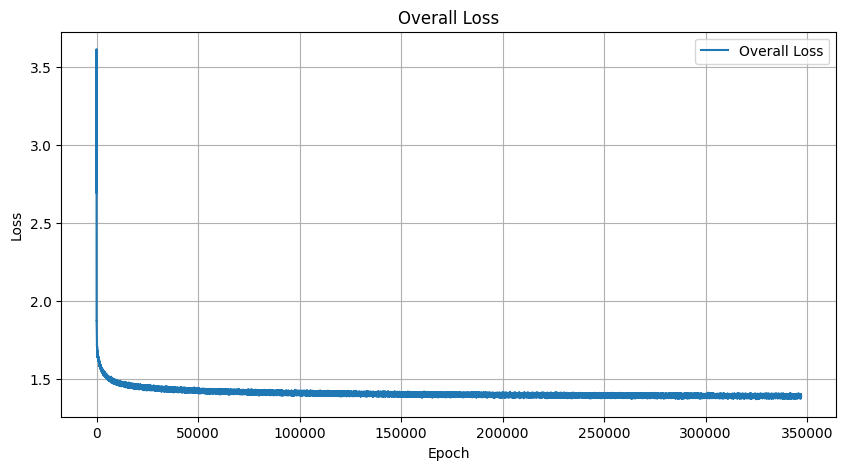

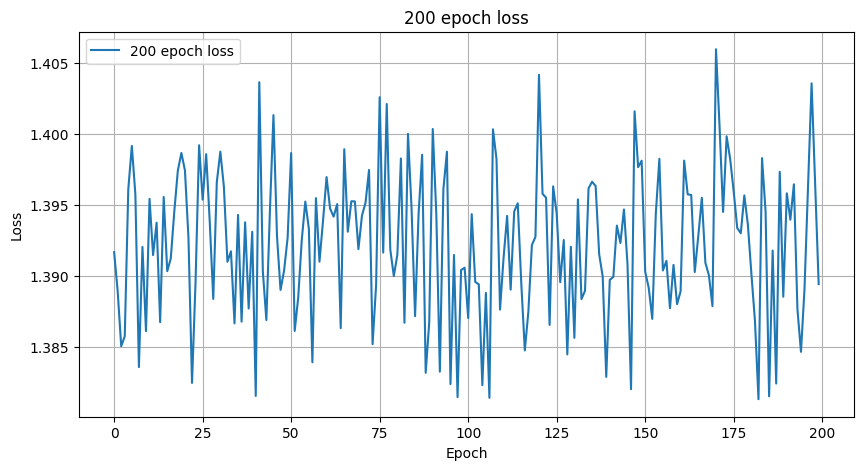

Epoch [1807801], Loss: 1.3979
Epoch [1807802], Loss: 1.3898
Epoch [1807803], Loss: 1.3992
Epoch [1807804], Loss: 1.3989
Epoch [1807805], Loss: 1.3887
Epoch [1807806], Loss: 1.3971
Epoch [1807807], Loss: 1.3985
Epoch [1807808], Loss: 1.3970
Epoch [1807809], Loss: 1.3920
Epoch [1807810], Loss: 1.3903
Epoch [1807811], Loss: 1.3894
Epoch [1807812], Loss: 1.3977
Epoch [1807813], Loss: 1.3961
Epoch [1807814], Loss: 1.3939
Epoch [1807815], Loss: 1.3911
Epoch [1807816], Loss: 1.3985
Epoch [1807817], Loss: 1.3900
Epoch [1807818], Loss: 1.3870
Epoch [1807819], Loss: 1.3992
Epoch [1807820], Loss: 1.3902
Epoch [1807821], Loss: 1.4008
Epoch [1807822], Loss: 1.3922
Epoch [1807823], Loss: 1.3908
Epoch [1807824], Loss: 1.3857
Epoch [1807825], Loss: 1.3898
Epoch [1807826], Loss: 1.3917
Epoch [1807827], Loss: 1.4027
Epoch [1807828], Loss: 1.3865
Epoch [1807829], Loss: 1.3911
Epoch [1807830], Loss: 1.3801
Epoch [1807831], Loss: 1.3894
Epoch [1807832], Loss: 1.3961
Epoch [1807833], Loss: 1.3908
Epoch [180

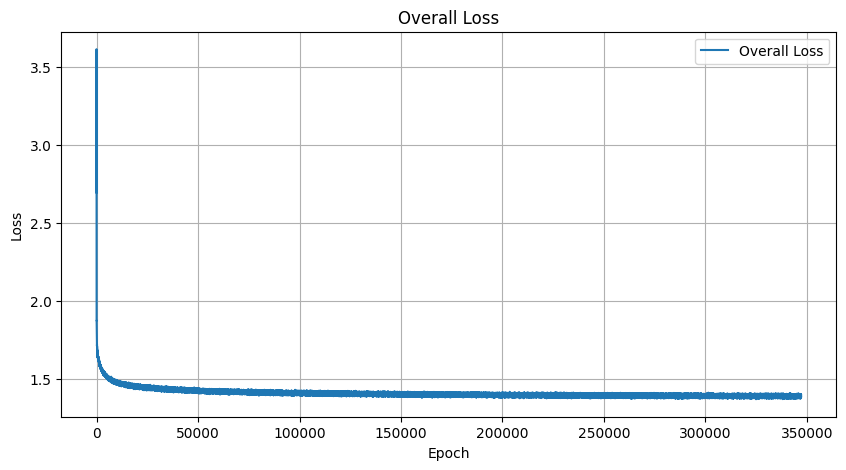

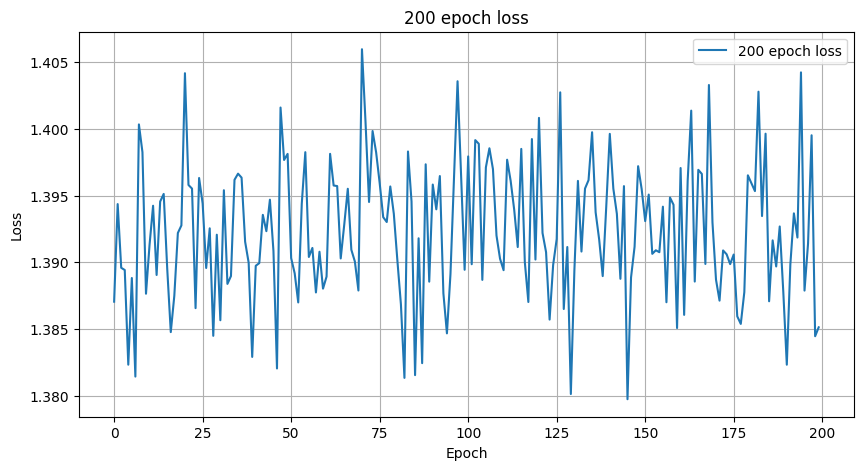

Epoch [1807901], Loss: 1.3917
Epoch [1807902], Loss: 1.3866
Epoch [1807903], Loss: 1.3874
Epoch [1807904], Loss: 1.3875
Epoch [1807905], Loss: 1.3921
Epoch [1807906], Loss: 1.3986
Epoch [1807907], Loss: 1.3903
Epoch [1807908], Loss: 1.3917
Epoch [1807909], Loss: 1.3914
Epoch [1807910], Loss: 1.3954
Epoch [1807911], Loss: 1.4000
Epoch [1807912], Loss: 1.3883
Epoch [1807913], Loss: 1.3907
Epoch [1807914], Loss: 1.3882
Epoch [1807915], Loss: 1.3938
Epoch [1807916], Loss: 1.3909
Epoch [1807917], Loss: 1.4069
Epoch [1807918], Loss: 1.3857
Epoch [1807919], Loss: 1.3870
Epoch [1807920], Loss: 1.3952
Epoch [1807921], Loss: 1.3966
Epoch [1807922], Loss: 1.3931
Epoch [1807923], Loss: 1.3870
Epoch [1807924], Loss: 1.3938
Epoch [1807925], Loss: 1.3948
Epoch [1807926], Loss: 1.3828
Epoch [1807927], Loss: 1.3931
Epoch [1807928], Loss: 1.3917
Epoch [1807929], Loss: 1.3942
Epoch [1807930], Loss: 1.3923
Epoch [1807931], Loss: 1.3979
Epoch [1807932], Loss: 1.3934
Epoch [1807933], Loss: 1.3866
Epoch [180

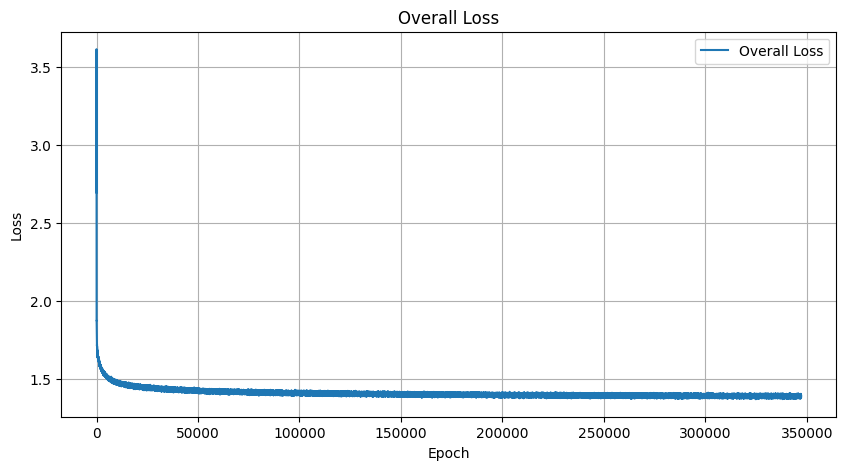

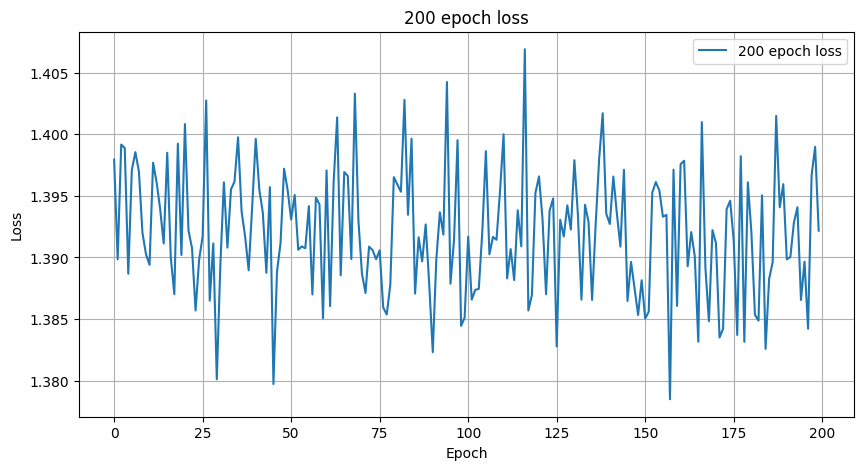

Epoch [1808001], Loss: 1.3885
Epoch [1808002], Loss: 1.3902
Epoch [1808003], Loss: 1.3900
Epoch [1808004], Loss: 1.3891
Epoch [1808005], Loss: 1.3959
Epoch [1808006], Loss: 1.3924
Epoch [1808007], Loss: 1.4025
Epoch [1808008], Loss: 1.3950
Epoch [1808009], Loss: 1.3891
Epoch [1808010], Loss: 1.3946
Epoch [1808011], Loss: 1.3860
Epoch [1808012], Loss: 1.3901
Epoch [1808013], Loss: 1.3964
Epoch [1808014], Loss: 1.3957
Epoch [1808015], Loss: 1.3998
Epoch [1808016], Loss: 1.3910
Epoch [1808017], Loss: 1.3988
Epoch [1808018], Loss: 1.3979
Epoch [1808019], Loss: 1.3880
Epoch [1808020], Loss: 1.3937
Epoch [1808021], Loss: 1.3889
Epoch [1808022], Loss: 1.3921
Epoch [1808023], Loss: 1.3975
Epoch [1808024], Loss: 1.3968
Epoch [1808025], Loss: 1.3884
Epoch [1808026], Loss: 1.3888
Epoch [1808027], Loss: 1.3909
Epoch [1808028], Loss: 1.3876
Epoch [1808029], Loss: 1.3856
Epoch [1808030], Loss: 1.3893
Epoch [1808031], Loss: 1.3942
Epoch [1808032], Loss: 1.3879
Epoch [1808033], Loss: 1.3764
Epoch [180

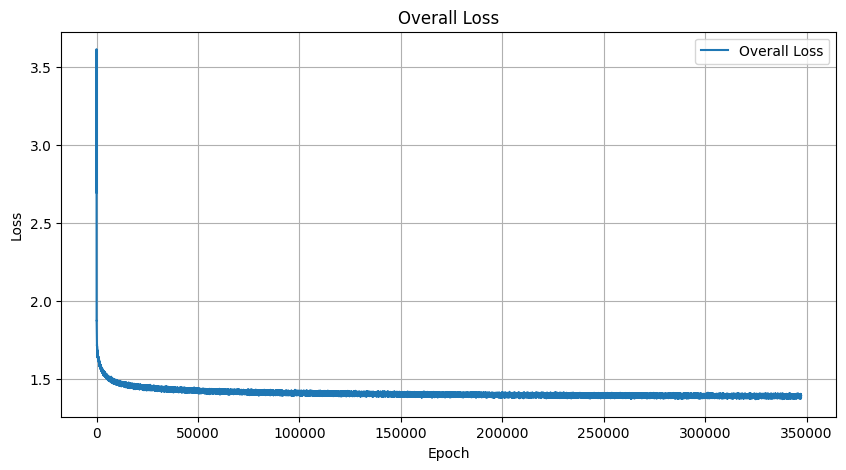

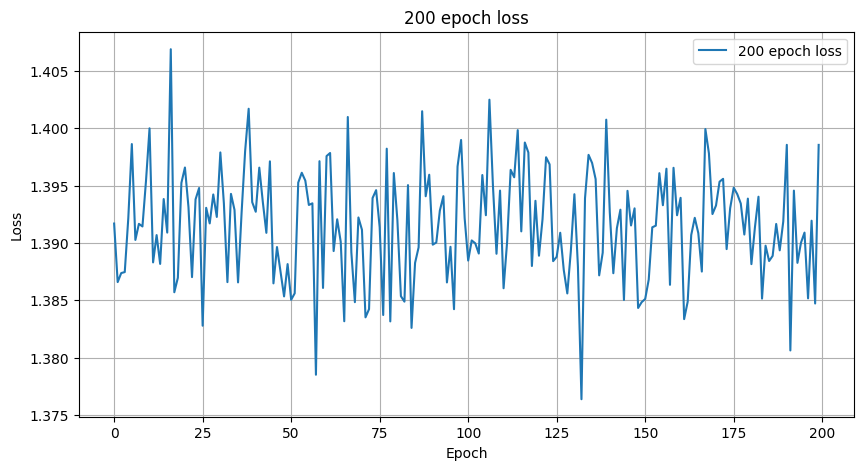

Epoch [1808101], Loss: 1.3912
Epoch [1808102], Loss: 1.3981
Epoch [1808103], Loss: 1.3916
Epoch [1808104], Loss: 1.3940
Epoch [1808105], Loss: 1.3891
Epoch [1808106], Loss: 1.3929
Epoch [1808107], Loss: 1.3873
Epoch [1808108], Loss: 1.3910
Epoch [1808109], Loss: 1.3913
Epoch [1808110], Loss: 1.3893
Epoch [1808111], Loss: 1.3961
Epoch [1808112], Loss: 1.3948
Epoch [1808113], Loss: 1.3980
Epoch [1808114], Loss: 1.3997
Epoch [1808115], Loss: 1.4019
Epoch [1808116], Loss: 1.3922
Epoch [1808117], Loss: 1.3868
Epoch [1808118], Loss: 1.3889
Epoch [1808119], Loss: 1.3837
Epoch [1808120], Loss: 1.3932
Epoch [1808121], Loss: 1.3901
Epoch [1808122], Loss: 1.3968
Epoch [1808123], Loss: 1.3950
Epoch [1808124], Loss: 1.4054
Epoch [1808125], Loss: 1.3947
Epoch [1808126], Loss: 1.3830
Epoch [1808127], Loss: 1.3949
Epoch [1808128], Loss: 1.3956
Epoch [1808129], Loss: 1.3960
Epoch [1808130], Loss: 1.3922
Epoch [1808131], Loss: 1.3847
Epoch [1808132], Loss: 1.4019
Epoch [1808133], Loss: 1.3987
Epoch [180

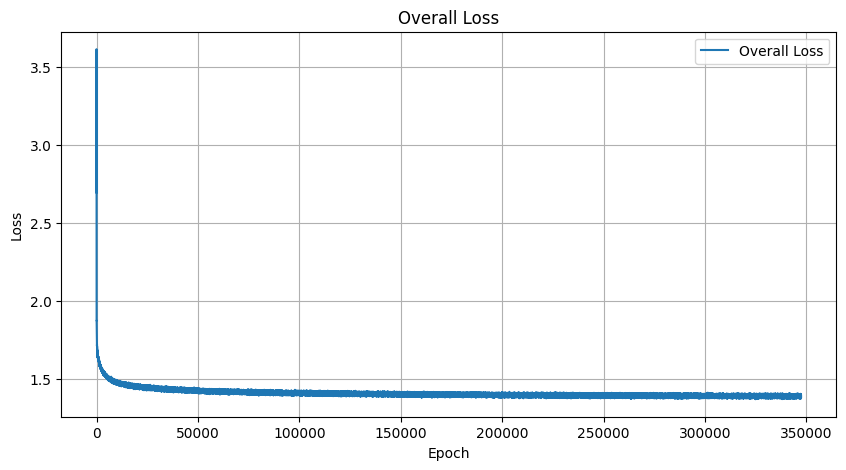

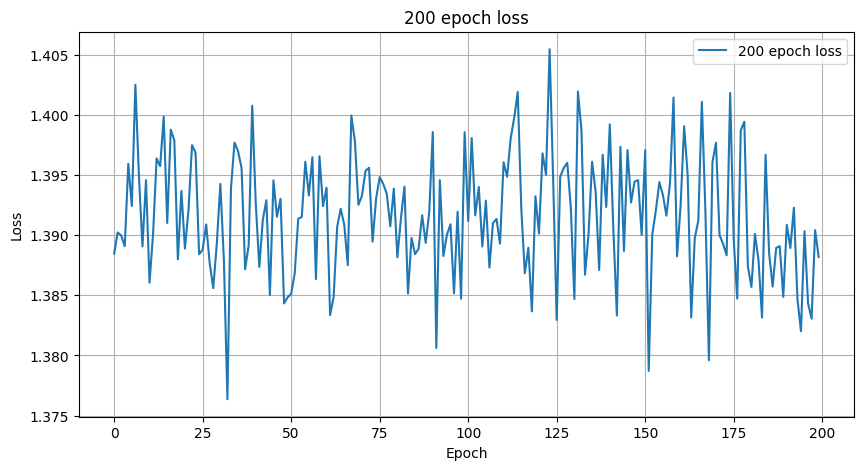

Epoch [1808201], Loss: 1.3851
Epoch [1808202], Loss: 1.3944
Epoch [1808203], Loss: 1.3886
Epoch [1808204], Loss: 1.3933
Epoch [1808205], Loss: 1.3867
Epoch [1808206], Loss: 1.3909
Epoch [1808207], Loss: 1.3868
Epoch [1808208], Loss: 1.3805
Epoch [1808209], Loss: 1.3976
Epoch [1808210], Loss: 1.3924
Epoch [1808211], Loss: 1.3904
Epoch [1808212], Loss: 1.3939
Epoch [1808213], Loss: 1.3888
Epoch [1808214], Loss: 1.3822
Epoch [1808215], Loss: 1.3894
Epoch [1808216], Loss: 1.3987
Epoch [1808217], Loss: 1.3878
Epoch [1808218], Loss: 1.3913
Epoch [1808219], Loss: 1.3966
Epoch [1808220], Loss: 1.4022
Epoch [1808221], Loss: 1.3936
Epoch [1808222], Loss: 1.3978
Epoch [1808223], Loss: 1.3983
Epoch [1808224], Loss: 1.3858
Epoch [1808225], Loss: 1.3956
Epoch [1808226], Loss: 1.3898
Epoch [1808227], Loss: 1.3915
Epoch [1808228], Loss: 1.3948
Epoch [1808229], Loss: 1.3931
Epoch [1808230], Loss: 1.3940
Epoch [1808231], Loss: 1.3781
Epoch [1808232], Loss: 1.3989
Epoch [1808233], Loss: 1.3918
Epoch [180

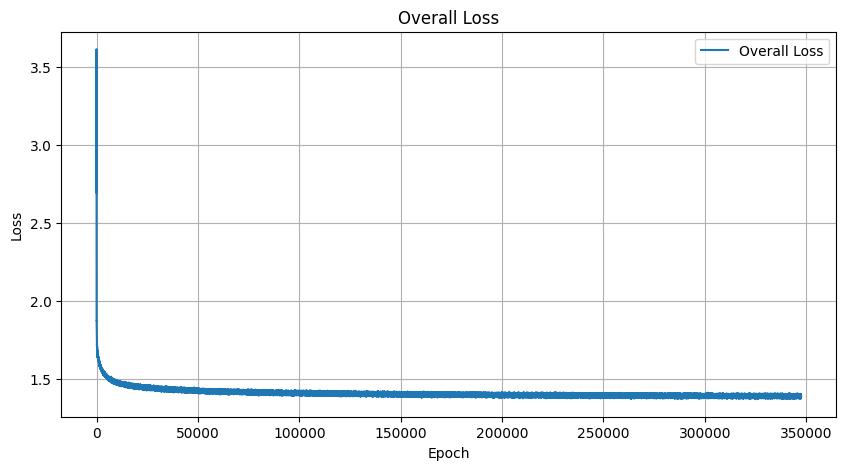

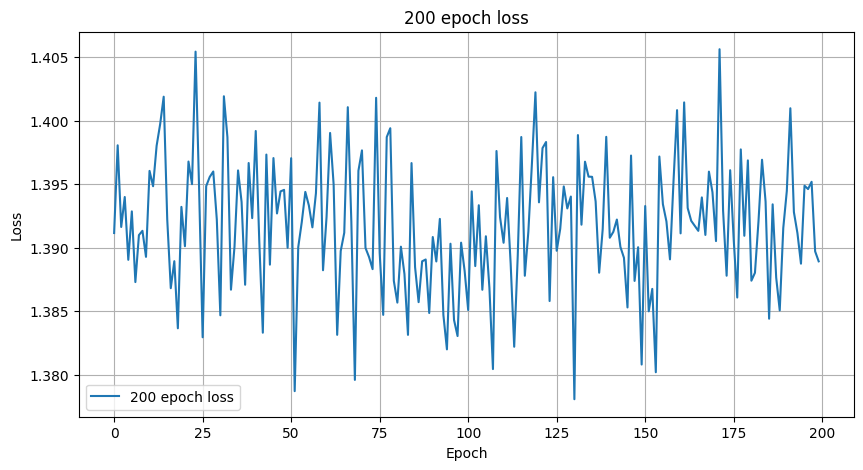

Epoch [1808301], Loss: 1.3877
Epoch [1808302], Loss: 1.3888
Epoch [1808303], Loss: 1.3977
Epoch [1808304], Loss: 1.3891
Epoch [1808305], Loss: 1.4011
Epoch [1808306], Loss: 1.3869
Epoch [1808307], Loss: 1.3935
Epoch [1808308], Loss: 1.3948
Epoch [1808309], Loss: 1.3889
Epoch [1808310], Loss: 1.3983
Epoch [1808311], Loss: 1.3937
Epoch [1808312], Loss: 1.3854
Epoch [1808313], Loss: 1.3911
Epoch [1808314], Loss: 1.3901
Epoch [1808315], Loss: 1.3962
Epoch [1808316], Loss: 1.3932
Epoch [1808317], Loss: 1.3979
Epoch [1808318], Loss: 1.3879
Epoch [1808319], Loss: 1.3955
Epoch [1808320], Loss: 1.3898
Epoch [1808321], Loss: 1.3963
Epoch [1808322], Loss: 1.3973
Epoch [1808323], Loss: 1.3798
Epoch [1808324], Loss: 1.3864
Epoch [1808325], Loss: 1.3950
Epoch [1808326], Loss: 1.3873
Epoch [1808327], Loss: 1.3937
Epoch [1808328], Loss: 1.3902
Epoch [1808329], Loss: 1.3903
Epoch [1808330], Loss: 1.3961
Epoch [1808331], Loss: 1.3862
Epoch [1808332], Loss: 1.3905
Epoch [1808333], Loss: 1.3895
Epoch [180

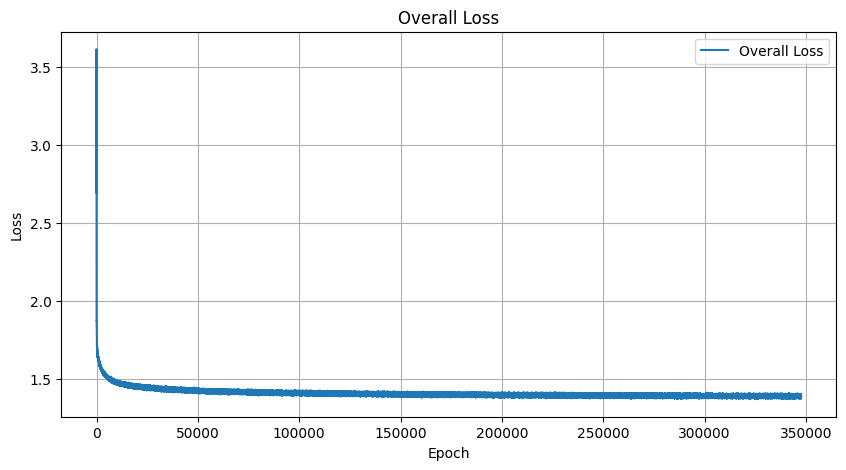

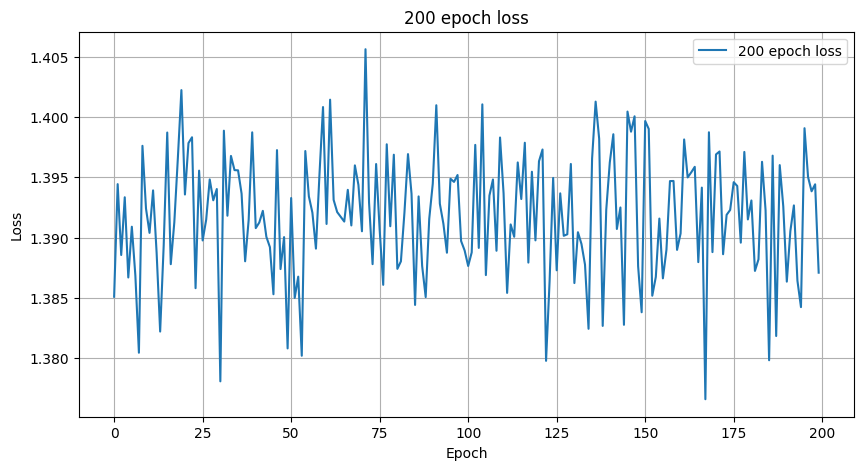

Epoch [1808401], Loss: 1.3966
Epoch [1808402], Loss: 1.3954
Epoch [1808403], Loss: 1.3831
Epoch [1808404], Loss: 1.3835
Epoch [1808405], Loss: 1.3950
Epoch [1808406], Loss: 1.3874
Epoch [1808407], Loss: 1.3869
Epoch [1808408], Loss: 1.3976
Epoch [1808409], Loss: 1.3917
Epoch [1808410], Loss: 1.4028
Epoch [1808411], Loss: 1.3941
Epoch [1808412], Loss: 1.3994
Epoch [1808413], Loss: 1.3962
Epoch [1808414], Loss: 1.3977
Epoch [1808415], Loss: 1.3904
Epoch [1808416], Loss: 1.3907
Epoch [1808417], Loss: 1.3944
Epoch [1808418], Loss: 1.3923
Epoch [1808419], Loss: 1.3916
Epoch [1808420], Loss: 1.3854
Epoch [1808421], Loss: 1.3950
Epoch [1808422], Loss: 1.3884
Epoch [1808423], Loss: 1.3886
Epoch [1808424], Loss: 1.3998
Epoch [1808425], Loss: 1.3859
Epoch [1808426], Loss: 1.3966
Epoch [1808427], Loss: 1.3939
Epoch [1808428], Loss: 1.3873
Epoch [1808429], Loss: 1.3959
Epoch [1808430], Loss: 1.3906
Epoch [1808431], Loss: 1.3975
Epoch [1808432], Loss: 1.3900
Epoch [1808433], Loss: 1.3902
Epoch [180

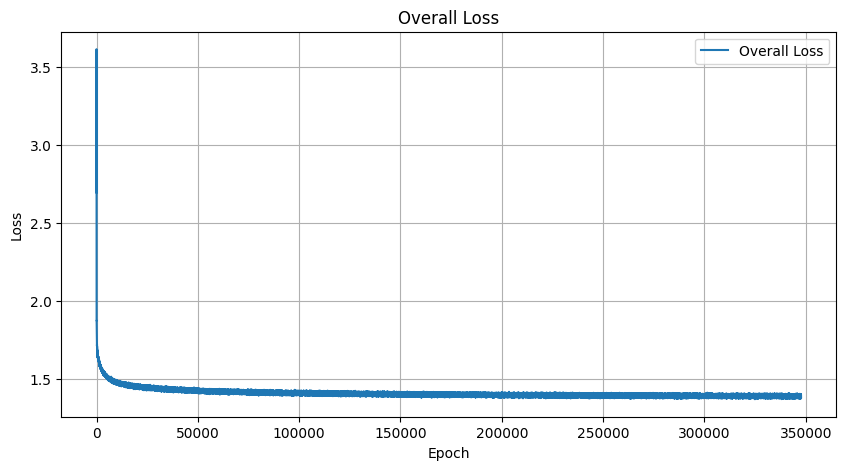

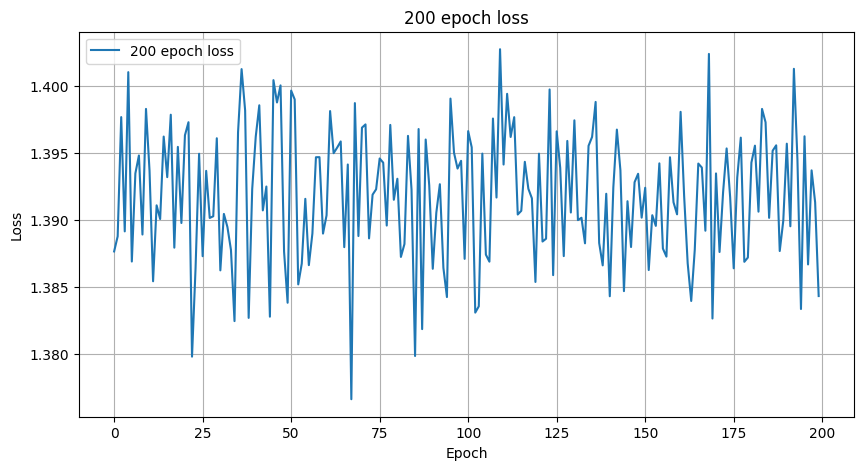

Epoch [1808501], Loss: 1.3974
Epoch [1808502], Loss: 1.3990
Epoch [1808503], Loss: 1.3930
Epoch [1808504], Loss: 1.4025
Epoch [1808505], Loss: 1.3900
Epoch [1808506], Loss: 1.3940
Epoch [1808507], Loss: 1.3907
Epoch [1808508], Loss: 1.3859
Epoch [1808509], Loss: 1.3957
Epoch [1808510], Loss: 1.3925
Epoch [1808511], Loss: 1.3864
Epoch [1808512], Loss: 1.3928
Epoch [1808513], Loss: 1.3902
Epoch [1808514], Loss: 1.3915
Epoch [1808515], Loss: 1.3861
Epoch [1808516], Loss: 1.3813
Epoch [1808517], Loss: 1.3984
Epoch [1808518], Loss: 1.3935
Epoch [1808519], Loss: 1.3935
Epoch [1808520], Loss: 1.3940
Epoch [1808521], Loss: 1.3996
Epoch [1808522], Loss: 1.3955
Epoch [1808523], Loss: 1.4030
Epoch [1808524], Loss: 1.3923
Epoch [1808525], Loss: 1.3895
Epoch [1808526], Loss: 1.3894
Epoch [1808527], Loss: 1.3818
Epoch [1808528], Loss: 1.3982
Epoch [1808529], Loss: 1.3791
Epoch [1808530], Loss: 1.3951
Epoch [1808531], Loss: 1.3931
Epoch [1808532], Loss: 1.3853
Epoch [1808533], Loss: 1.3977
Epoch [180

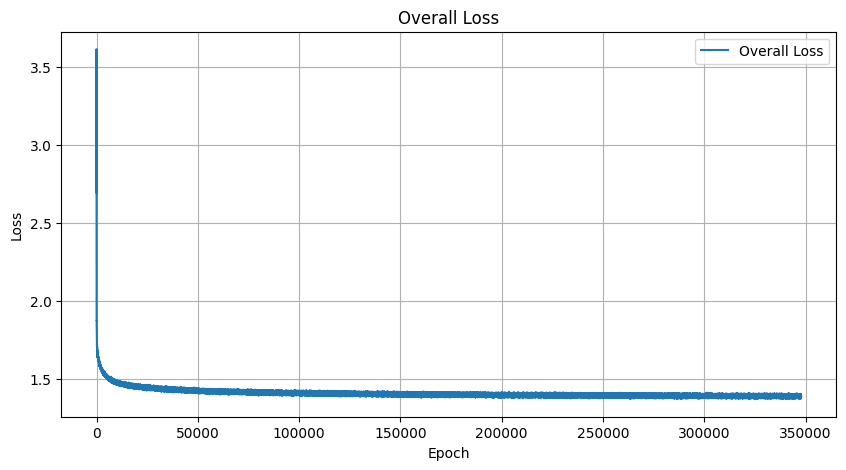

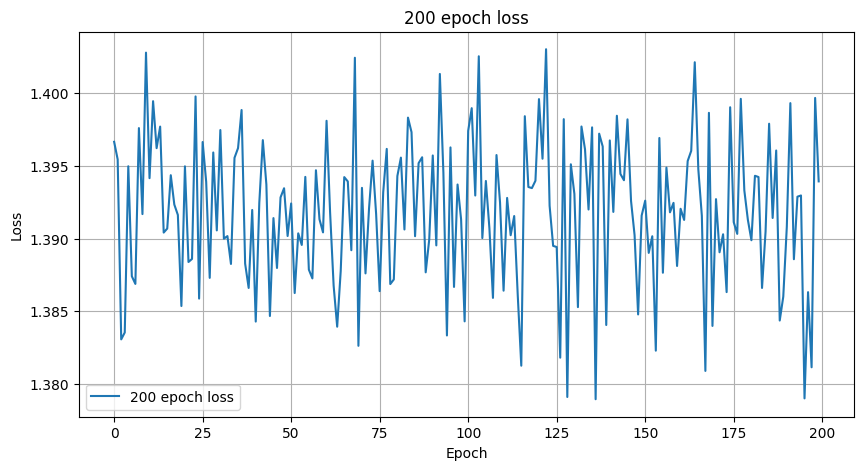

Epoch [1808601], Loss: 1.3946
Epoch [1808602], Loss: 1.3998
Epoch [1808603], Loss: 1.3956
Epoch [1808604], Loss: 1.3934
Epoch [1808605], Loss: 1.3973
Epoch [1808606], Loss: 1.3934
Epoch [1808607], Loss: 1.3855
Epoch [1808608], Loss: 1.3989
Epoch [1808609], Loss: 1.3860
Epoch [1808610], Loss: 1.3881
Epoch [1808611], Loss: 1.3871
Epoch [1808612], Loss: 1.3880
Epoch [1808613], Loss: 1.3843
Epoch [1808614], Loss: 1.3897
Epoch [1808615], Loss: 1.3956
Epoch [1808616], Loss: 1.3864
Epoch [1808617], Loss: 1.3862
Epoch [1808618], Loss: 1.3992
Epoch [1808619], Loss: 1.3868
Epoch [1808620], Loss: 1.3914
Epoch [1808621], Loss: 1.3940
Epoch [1808622], Loss: 1.3880
Epoch [1808623], Loss: 1.3883
Epoch [1808624], Loss: 1.3969
Epoch [1808625], Loss: 1.3735
Epoch [1808626], Loss: 1.3952
Epoch [1808627], Loss: 1.3885
Epoch [1808628], Loss: 1.3914
Epoch [1808629], Loss: 1.3942
Epoch [1808630], Loss: 1.3843
Epoch [1808631], Loss: 1.3891
Epoch [1808632], Loss: 1.3913
Epoch [1808633], Loss: 1.4033
Epoch [180

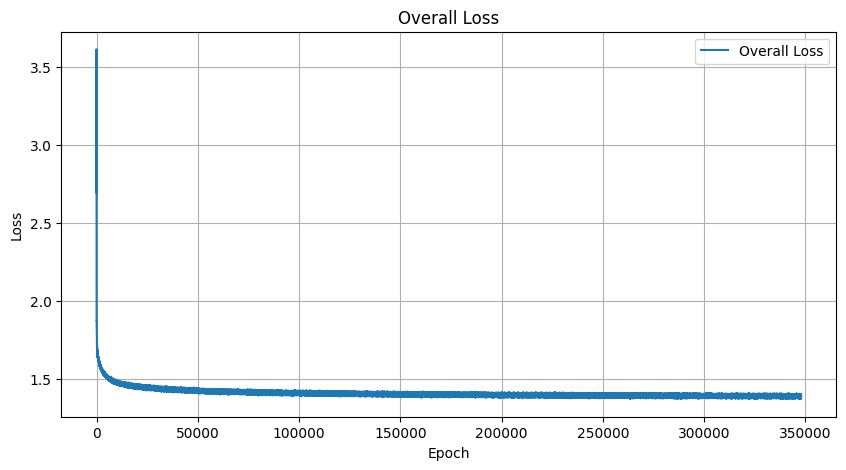

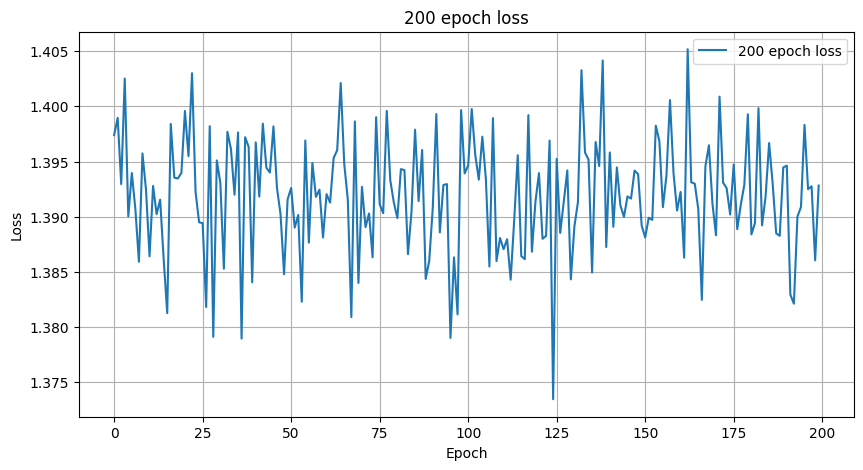

Epoch [1808701], Loss: 1.3911
Epoch [1808702], Loss: 1.3871
Epoch [1808703], Loss: 1.3885
Epoch [1808704], Loss: 1.3965
Epoch [1808705], Loss: 1.3882
Epoch [1808706], Loss: 1.3810
Epoch [1808707], Loss: 1.3913
Epoch [1808708], Loss: 1.3890
Epoch [1808709], Loss: 1.3821
Epoch [1808710], Loss: 1.3821
Epoch [1808711], Loss: 1.3907
Epoch [1808712], Loss: 1.3933
Epoch [1808713], Loss: 1.3854
Epoch [1808714], Loss: 1.3921
Epoch [1808715], Loss: 1.4004
Epoch [1808716], Loss: 1.3984
Epoch [1808717], Loss: 1.3928
Epoch [1808718], Loss: 1.3827
Epoch [1808719], Loss: 1.3918
Epoch [1808720], Loss: 1.3917
Epoch [1808721], Loss: 1.3915
Epoch [1808722], Loss: 1.3961
Epoch [1808723], Loss: 1.4008
Epoch [1808724], Loss: 1.3907
Epoch [1808725], Loss: 1.3986
Epoch [1808726], Loss: 1.3820
Epoch [1808727], Loss: 1.3878
Epoch [1808728], Loss: 1.3881
Epoch [1808729], Loss: 1.3938
Epoch [1808730], Loss: 1.4012
Epoch [1808731], Loss: 1.3921
Epoch [1808732], Loss: 1.3850
Epoch [1808733], Loss: 1.3967
Epoch [180

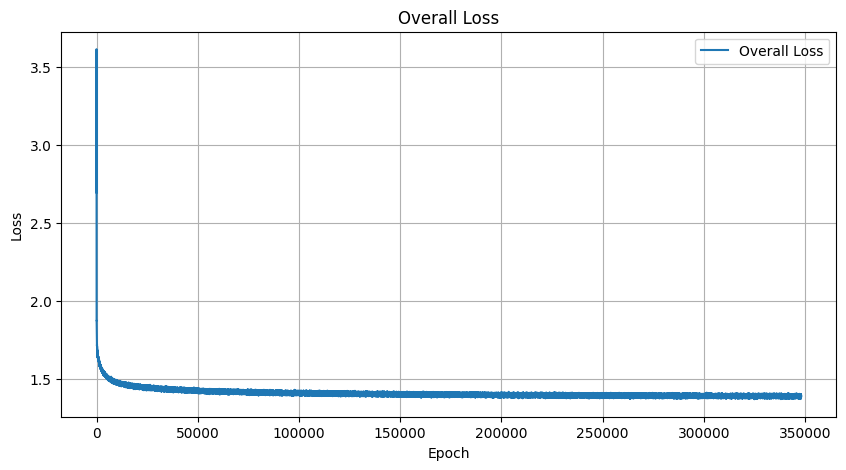

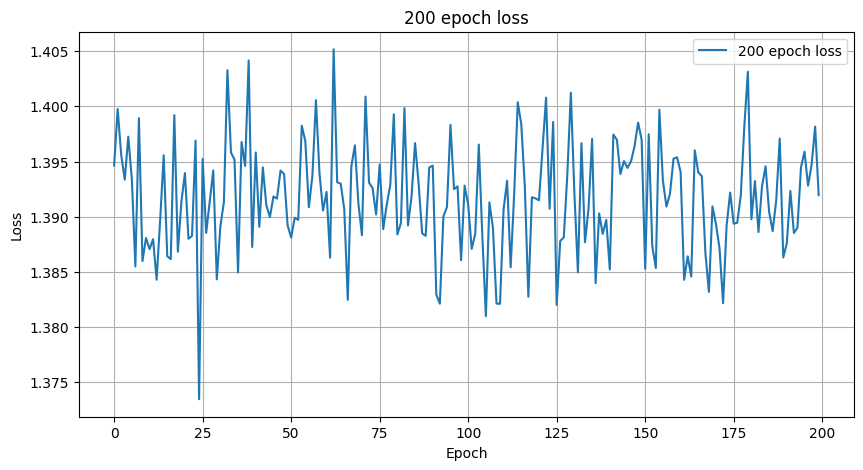

Epoch [1808801], Loss: 1.4023
Epoch [1808802], Loss: 1.3885
Epoch [1808803], Loss: 1.3792
Epoch [1808804], Loss: 1.3951
Epoch [1808805], Loss: 1.3943
Epoch [1808806], Loss: 1.3928
Epoch [1808807], Loss: 1.3882
Epoch [1808808], Loss: 1.3907
Epoch [1808809], Loss: 1.3899
Epoch [1808810], Loss: 1.3901
Epoch [1808811], Loss: 1.3852
Epoch [1808812], Loss: 1.3981
Epoch [1808813], Loss: 1.3901
Epoch [1808814], Loss: 1.3909
Epoch [1808815], Loss: 1.3783
Epoch [1808816], Loss: 1.4036
Epoch [1808817], Loss: 1.3893
Epoch [1808818], Loss: 1.3937
Epoch [1808819], Loss: 1.3944
Epoch [1808820], Loss: 1.3867
Epoch [1808821], Loss: 1.3967
Epoch [1808822], Loss: 1.3837
Epoch [1808823], Loss: 1.3952
Epoch [1808824], Loss: 1.3920
Epoch [1808825], Loss: 1.3986
Epoch [1808826], Loss: 1.3921
Epoch [1808827], Loss: 1.3922
Epoch [1808828], Loss: 1.3952
Epoch [1808829], Loss: 1.3831
Epoch [1808830], Loss: 1.4035
Epoch [1808831], Loss: 1.3986
Epoch [1808832], Loss: 1.3875
Epoch [1808833], Loss: 1.3873
Epoch [180

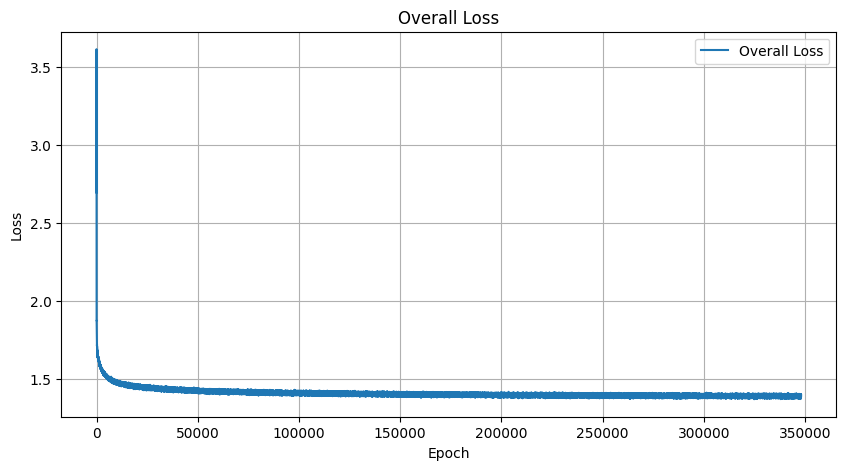

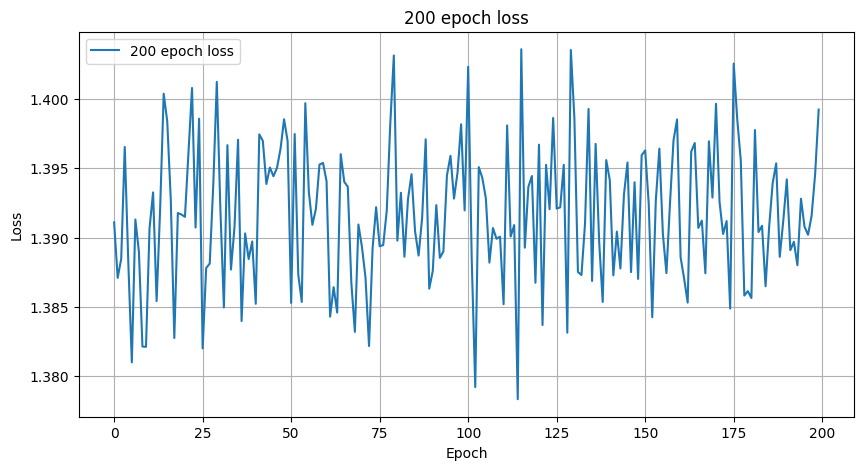

Epoch [1808901], Loss: 1.3948
Epoch [1808902], Loss: 1.3974
Epoch [1808903], Loss: 1.3850
Epoch [1808904], Loss: 1.3928
Epoch [1808905], Loss: 1.3893
Epoch [1808906], Loss: 1.3924
Epoch [1808907], Loss: 1.3915
Epoch [1808908], Loss: 1.3963
Epoch [1808909], Loss: 1.3873
Epoch [1808910], Loss: 1.3937
Epoch [1808911], Loss: 1.4038
Epoch [1808912], Loss: 1.3923
Epoch [1808913], Loss: 1.3946
Epoch [1808914], Loss: 1.4003
Epoch [1808915], Loss: 1.3917
Epoch [1808916], Loss: 1.3914
Epoch [1808917], Loss: 1.3809
Epoch [1808918], Loss: 1.3889
Epoch [1808919], Loss: 1.3919
Epoch [1808920], Loss: 1.3902
Epoch [1808921], Loss: 1.3845
Epoch [1808922], Loss: 1.3965
Epoch [1808923], Loss: 1.3930
Epoch [1808924], Loss: 1.3874
Epoch [1808925], Loss: 1.3861
Epoch [1808926], Loss: 1.3957
Epoch [1808927], Loss: 1.3950
Epoch [1808928], Loss: 1.3909
Epoch [1808929], Loss: 1.3959
Epoch [1808930], Loss: 1.3899
Epoch [1808931], Loss: 1.3966
Epoch [1808932], Loss: 1.3892
Epoch [1808933], Loss: 1.3928
Epoch [180

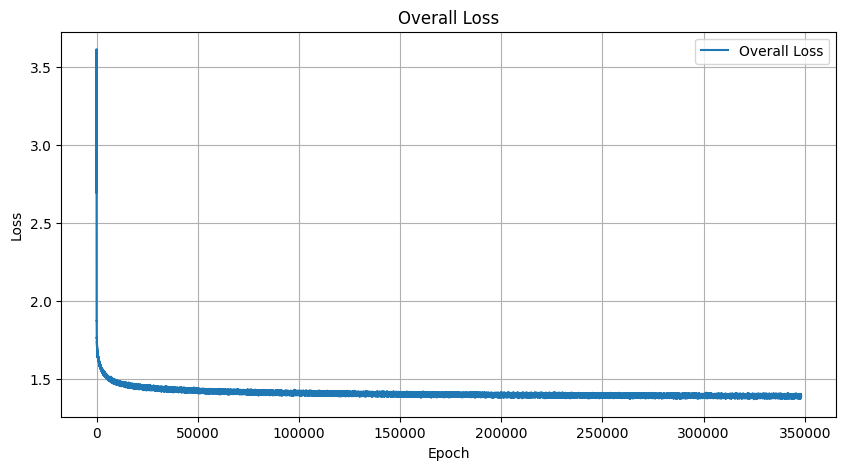

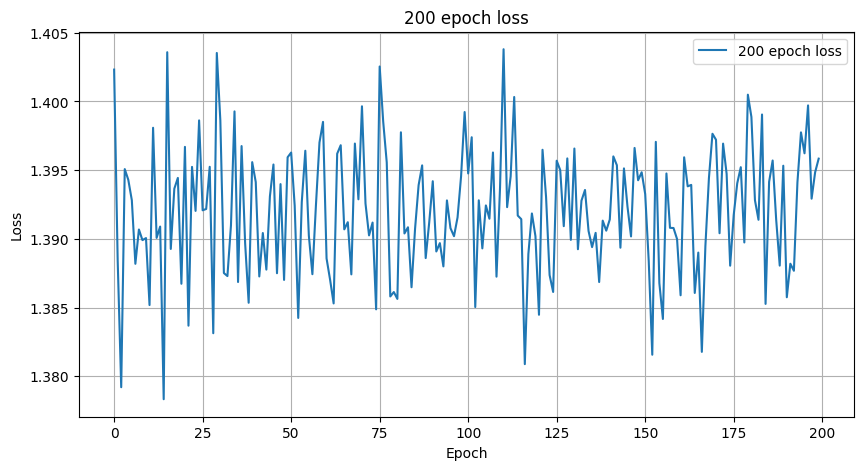

Epoch [1809001], Loss: 1.3859
Epoch [1809002], Loss: 1.3984
Epoch [1809003], Loss: 1.3811
Epoch [1809004], Loss: 1.3961
Epoch [1809005], Loss: 1.3932
Epoch [1809006], Loss: 1.3940
Epoch [1809007], Loss: 1.3917
Epoch [1809008], Loss: 1.3991
Epoch [1809009], Loss: 1.3944
Epoch [1809010], Loss: 1.3884
Epoch [1809011], Loss: 1.3883
Epoch [1809012], Loss: 1.3901
Epoch [1809013], Loss: 1.3821
Epoch [1809014], Loss: 1.3911
Epoch [1809015], Loss: 1.3888
Epoch [1809016], Loss: 1.3899
Epoch [1809017], Loss: 1.3966
Epoch [1809018], Loss: 1.3972
Epoch [1809019], Loss: 1.3880
Epoch [1809020], Loss: 1.3912
Epoch [1809021], Loss: 1.3935
Epoch [1809022], Loss: 1.3861
Epoch [1809023], Loss: 1.3998
Epoch [1809024], Loss: 1.3891
Epoch [1809025], Loss: 1.3922
Epoch [1809026], Loss: 1.3883
Epoch [1809027], Loss: 1.3897
Epoch [1809028], Loss: 1.3919
Epoch [1809029], Loss: 1.3910
Epoch [1809030], Loss: 1.3990
Epoch [1809031], Loss: 1.4003
Epoch [1809032], Loss: 1.3826
Epoch [1809033], Loss: 1.3894
Epoch [180

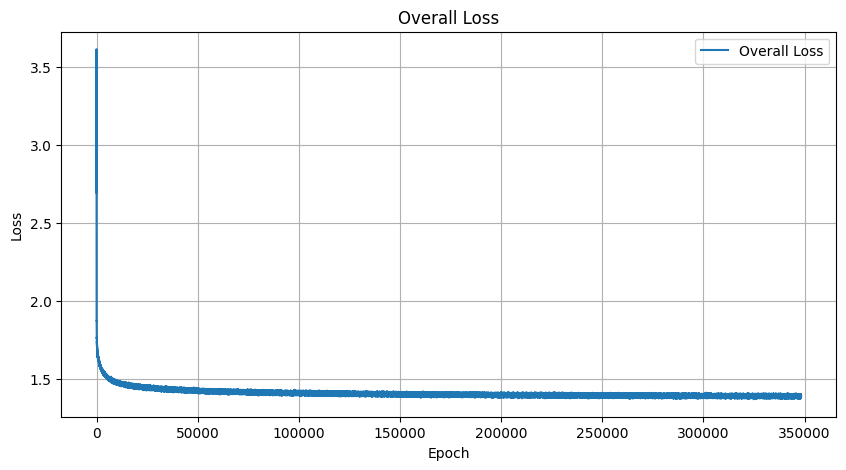

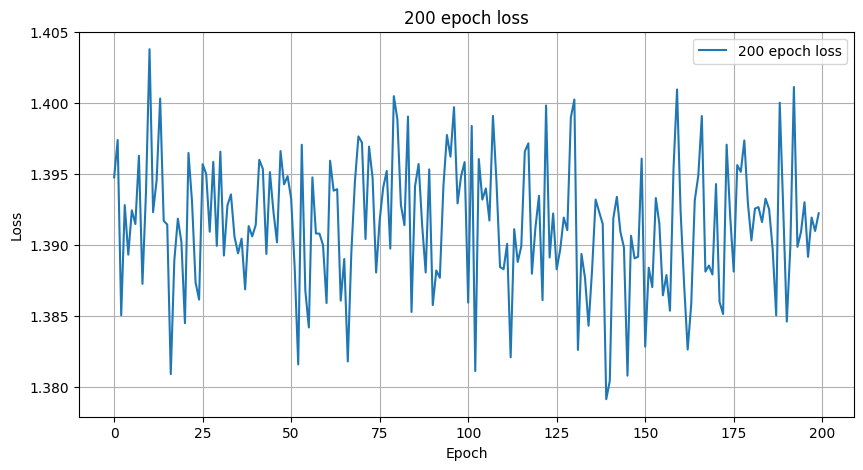

Epoch [1809101], Loss: 1.3894
Epoch [1809102], Loss: 1.3885
Epoch [1809103], Loss: 1.4003
Epoch [1809104], Loss: 1.3932
Epoch [1809105], Loss: 1.3861
Epoch [1809106], Loss: 1.3917
Epoch [1809107], Loss: 1.3892
Epoch [1809108], Loss: 1.3885
Epoch [1809109], Loss: 1.4051
Epoch [1809110], Loss: 1.3968
Epoch [1809111], Loss: 1.4016
Epoch [1809112], Loss: 1.3906
Epoch [1809113], Loss: 1.3896
Epoch [1809114], Loss: 1.3922
Epoch [1809115], Loss: 1.3969
Epoch [1809116], Loss: 1.3909
Epoch [1809117], Loss: 1.3933
Epoch [1809118], Loss: 1.3788
Epoch [1809119], Loss: 1.3952
Epoch [1809120], Loss: 1.3925
Epoch [1809121], Loss: 1.3846
Epoch [1809122], Loss: 1.3889
Epoch [1809123], Loss: 1.3867
Epoch [1809124], Loss: 1.3918
Epoch [1809125], Loss: 1.3882
Epoch [1809126], Loss: 1.3913
Epoch [1809127], Loss: 1.3839
Epoch [1809128], Loss: 1.3911
Epoch [1809129], Loss: 1.3946
Epoch [1809130], Loss: 1.3934
Epoch [1809131], Loss: 1.4015
Epoch [1809132], Loss: 1.3816
Epoch [1809133], Loss: 1.3947
Epoch [180

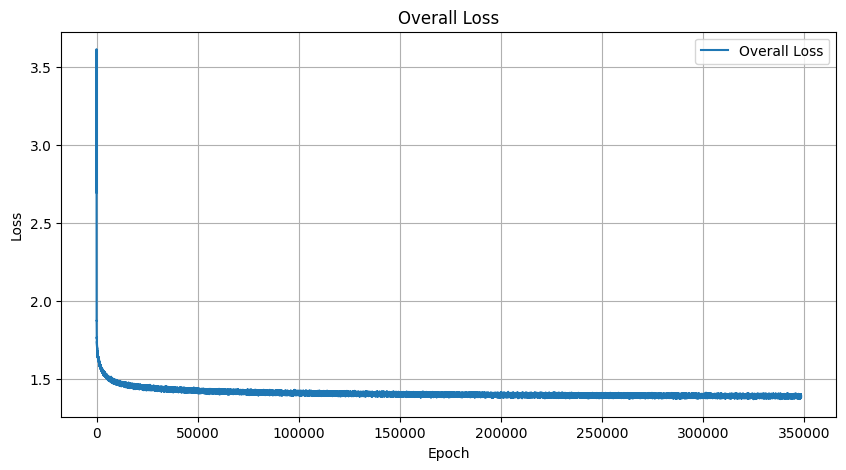

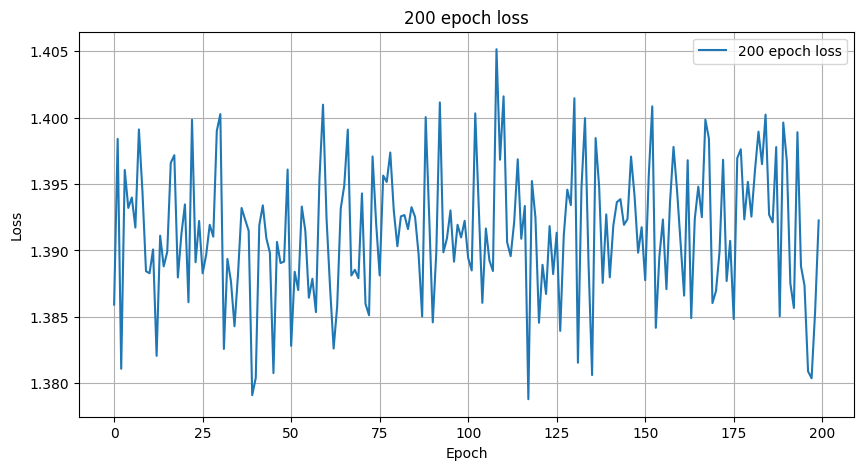

Epoch [1809201], Loss: 1.4002
Epoch [1809202], Loss: 1.3834
Epoch [1809203], Loss: 1.3913
Epoch [1809204], Loss: 1.3966
Epoch [1809205], Loss: 1.3886
Epoch [1809206], Loss: 1.3871
Epoch [1809207], Loss: 1.3846
Epoch [1809208], Loss: 1.3951
Epoch [1809209], Loss: 1.3936
Epoch [1809210], Loss: 1.3850
Epoch [1809211], Loss: 1.3897
Epoch [1809212], Loss: 1.3876
Epoch [1809213], Loss: 1.3842
Epoch [1809214], Loss: 1.3916
Epoch [1809215], Loss: 1.3933
Epoch [1809216], Loss: 1.3931
Epoch [1809217], Loss: 1.3887
Epoch [1809218], Loss: 1.3984
Epoch [1809219], Loss: 1.3938
Epoch [1809220], Loss: 1.3889
Epoch [1809221], Loss: 1.3872
Epoch [1809222], Loss: 1.4005
Epoch [1809223], Loss: 1.3901
Epoch [1809224], Loss: 1.3972
Epoch [1809225], Loss: 1.3925
Epoch [1809226], Loss: 1.3938
Epoch [1809227], Loss: 1.3905
Epoch [1809228], Loss: 1.3923
Epoch [1809229], Loss: 1.3876
Epoch [1809230], Loss: 1.3859
Epoch [1809231], Loss: 1.3922
Epoch [1809232], Loss: 1.3908
Epoch [1809233], Loss: 1.3937
Epoch [180

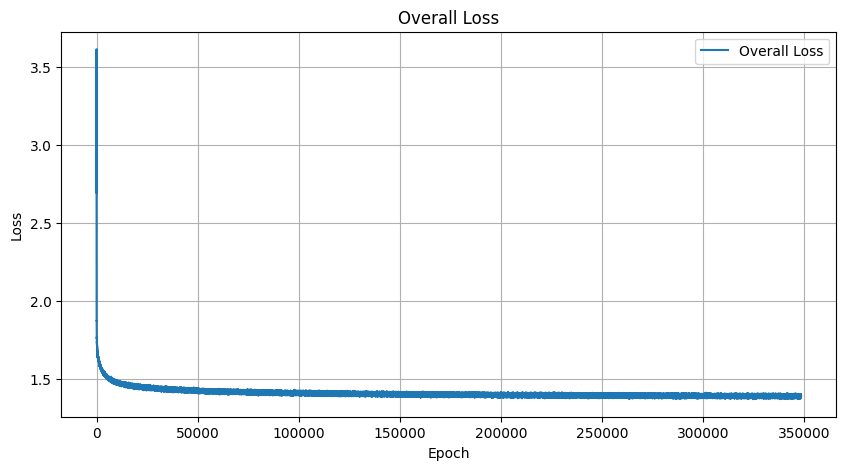

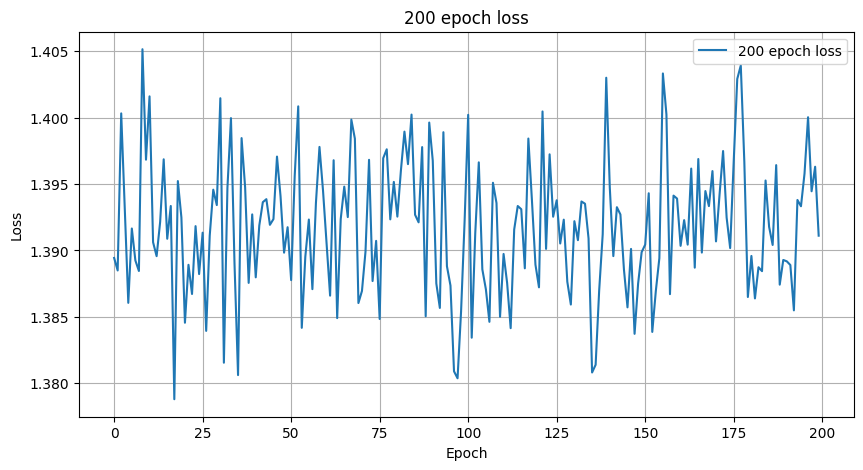

Epoch [1809301], Loss: 1.3845
Epoch [1809302], Loss: 1.3809
Epoch [1809303], Loss: 1.3865
Epoch [1809304], Loss: 1.3904
Epoch [1809305], Loss: 1.3888
Epoch [1809306], Loss: 1.3860
Epoch [1809307], Loss: 1.3937
Epoch [1809308], Loss: 1.3799
Epoch [1809309], Loss: 1.4029
Epoch [1809310], Loss: 1.3957
Epoch [1809311], Loss: 1.3864
Epoch [1809312], Loss: 1.4044
Epoch [1809313], Loss: 1.3950
Epoch [1809314], Loss: 1.3842
Epoch [1809315], Loss: 1.3866
Epoch [1809316], Loss: 1.3886
Epoch [1809317], Loss: 1.3925
Epoch [1809318], Loss: 1.3960
Epoch [1809319], Loss: 1.3934
Epoch [1809320], Loss: 1.3957
Epoch [1809321], Loss: 1.3956
Epoch [1809322], Loss: 1.3997
Epoch [1809323], Loss: 1.3915
Epoch [1809324], Loss: 1.3955
Epoch [1809325], Loss: 1.3864
Epoch [1809326], Loss: 1.3969
Epoch [1809327], Loss: 1.3789
Epoch [1809328], Loss: 1.3918
Epoch [1809329], Loss: 1.3940
Epoch [1809330], Loss: 1.3947
Epoch [1809331], Loss: 1.3972
Epoch [1809332], Loss: 1.3937
Epoch [1809333], Loss: 1.3938
Epoch [180

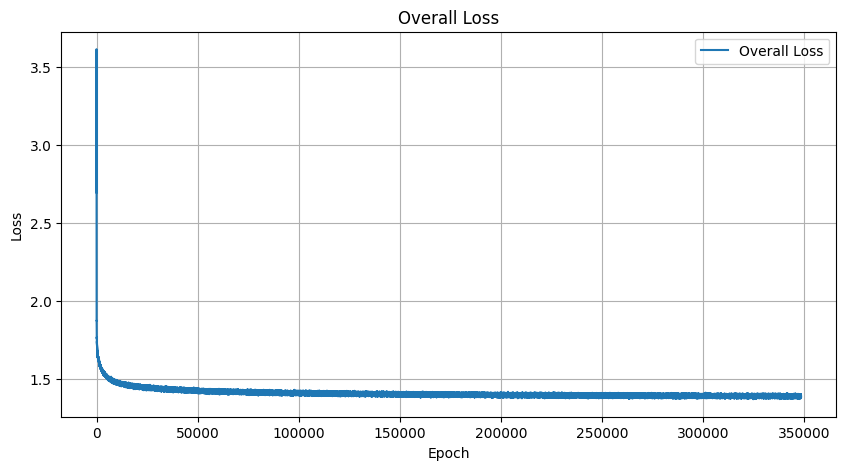

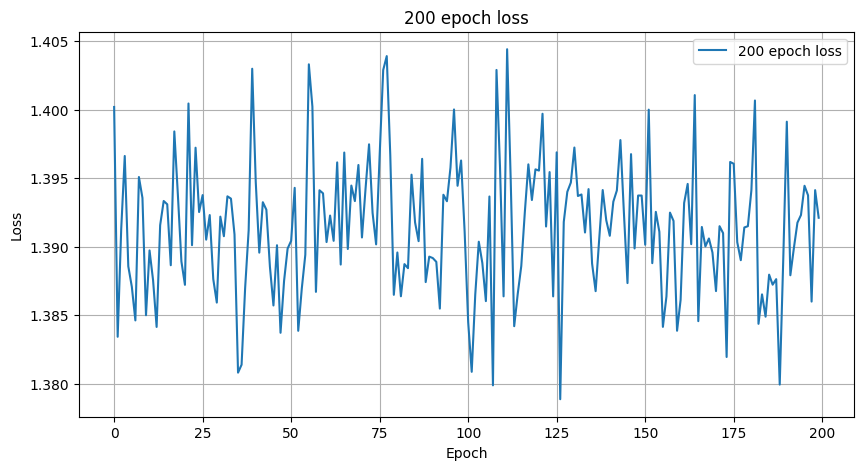

Epoch [1809401], Loss: 1.3881
Epoch [1809402], Loss: 1.3965
Epoch [1809403], Loss: 1.3861
Epoch [1809404], Loss: 1.3865
Epoch [1809405], Loss: 1.3808
Epoch [1809406], Loss: 1.3907
Epoch [1809407], Loss: 1.3964
Epoch [1809408], Loss: 1.3925
Epoch [1809409], Loss: 1.3898
Epoch [1809410], Loss: 1.4021
Epoch [1809411], Loss: 1.3975
Epoch [1809412], Loss: 1.3949
Epoch [1809413], Loss: 1.3948
Epoch [1809414], Loss: 1.3930
Epoch [1809415], Loss: 1.3900
Epoch [1809416], Loss: 1.3894
Epoch [1809417], Loss: 1.3946
Epoch [1809418], Loss: 1.3917
Epoch [1809419], Loss: 1.3890
Epoch [1809420], Loss: 1.3840
Epoch [1809421], Loss: 1.3942
Epoch [1809422], Loss: 1.3924
Epoch [1809423], Loss: 1.3880
Epoch [1809424], Loss: 1.3902
Epoch [1809425], Loss: 1.3957
Epoch [1809426], Loss: 1.4026
Epoch [1809427], Loss: 1.3879
Epoch [1809428], Loss: 1.3898
Epoch [1809429], Loss: 1.3891
Epoch [1809430], Loss: 1.3835
Epoch [1809431], Loss: 1.4012
Epoch [1809432], Loss: 1.4006
Epoch [1809433], Loss: 1.4021
Epoch [180

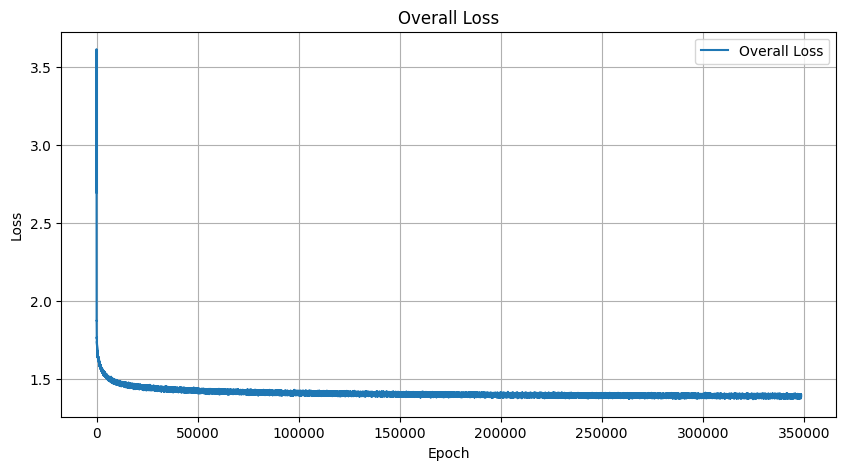

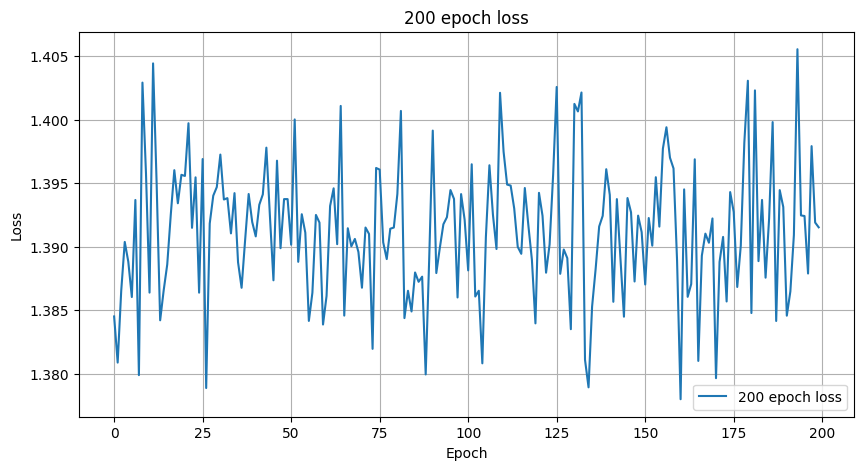

Epoch [1809501], Loss: 1.3882
Epoch [1809502], Loss: 1.3875
Epoch [1809503], Loss: 1.3930
Epoch [1809504], Loss: 1.3936
Epoch [1809505], Loss: 1.3943
Epoch [1809506], Loss: 1.3935
Epoch [1809507], Loss: 1.4026
Epoch [1809508], Loss: 1.3979
Epoch [1809509], Loss: 1.3979
Epoch [1809510], Loss: 1.3867
Epoch [1809511], Loss: 1.3879
Epoch [1809512], Loss: 1.3897
Epoch [1809513], Loss: 1.3949
Epoch [1809514], Loss: 1.3939
Epoch [1809515], Loss: 1.3889
Epoch [1809516], Loss: 1.3935
Epoch [1809517], Loss: 1.4053
Epoch [1809518], Loss: 1.3913
Epoch [1809519], Loss: 1.3866
Epoch [1809520], Loss: 1.3928
Epoch [1809521], Loss: 1.3983
Epoch [1809522], Loss: 1.3959
Epoch [1809523], Loss: 1.4001
Epoch [1809524], Loss: 1.4011
Epoch [1809525], Loss: 1.3853
Epoch [1809526], Loss: 1.3851
Epoch [1809527], Loss: 1.3891
Epoch [1809528], Loss: 1.3916
Epoch [1809529], Loss: 1.3969
Epoch [1809530], Loss: 1.3917
Epoch [1809531], Loss: 1.3959
Epoch [1809532], Loss: 1.3955
Epoch [1809533], Loss: 1.3890
Epoch [180

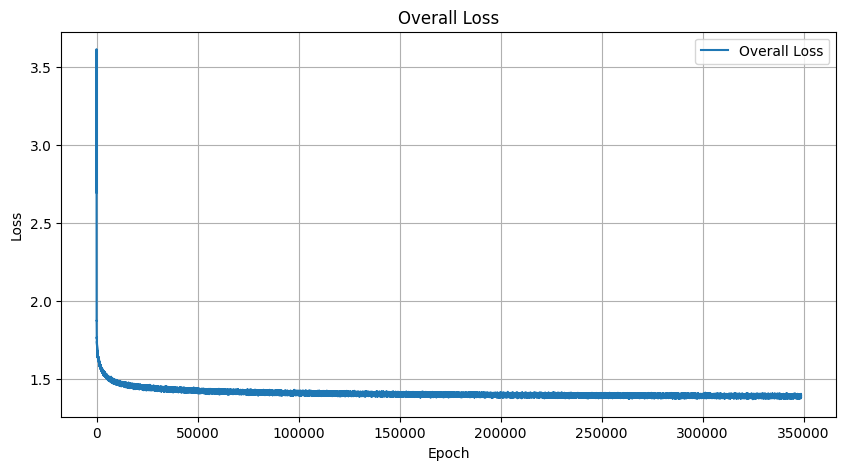

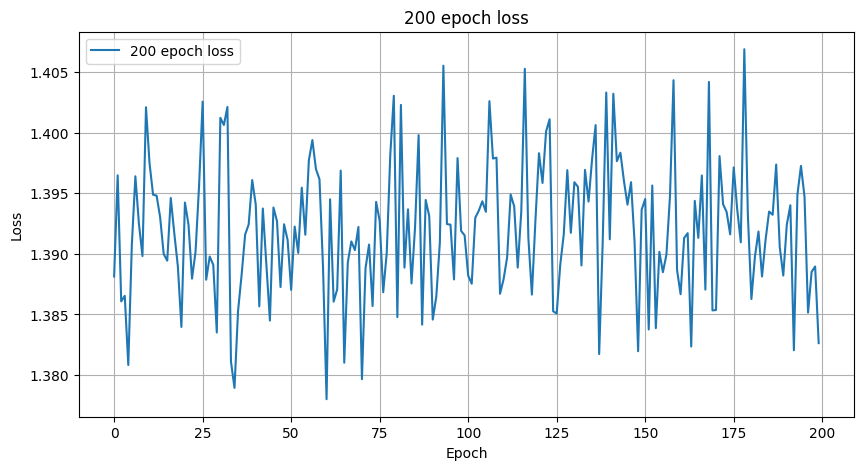

Epoch [1809601], Loss: 1.4077
Epoch [1809602], Loss: 1.3957
Epoch [1809603], Loss: 1.3960
Epoch [1809604], Loss: 1.3922
Epoch [1809605], Loss: 1.3893
Epoch [1809606], Loss: 1.3877
Epoch [1809607], Loss: 1.3951
Epoch [1809608], Loss: 1.3931
Epoch [1809609], Loss: 1.3921
Epoch [1809610], Loss: 1.3939
Epoch [1809611], Loss: 1.3959
Epoch [1809612], Loss: 1.3891
Epoch [1809613], Loss: 1.3827
Epoch [1809614], Loss: 1.3929
Epoch [1809615], Loss: 1.3896
Epoch [1809616], Loss: 1.3894
Epoch [1809617], Loss: 1.4016
Epoch [1809618], Loss: 1.3972
Epoch [1809619], Loss: 1.3940
Epoch [1809620], Loss: 1.3975
Epoch [1809621], Loss: 1.3883
Epoch [1809622], Loss: 1.3847
Epoch [1809623], Loss: 1.3826
Epoch [1809624], Loss: 1.4016
Epoch [1809625], Loss: 1.3945
Epoch [1809626], Loss: 1.3913
Epoch [1809627], Loss: 1.4086
Epoch [1809628], Loss: 1.3884
Epoch [1809629], Loss: 1.3905
Epoch [1809630], Loss: 1.3944
Epoch [1809631], Loss: 1.3924
Epoch [1809632], Loss: 1.3941
Epoch [1809633], Loss: 1.3966
Epoch [180

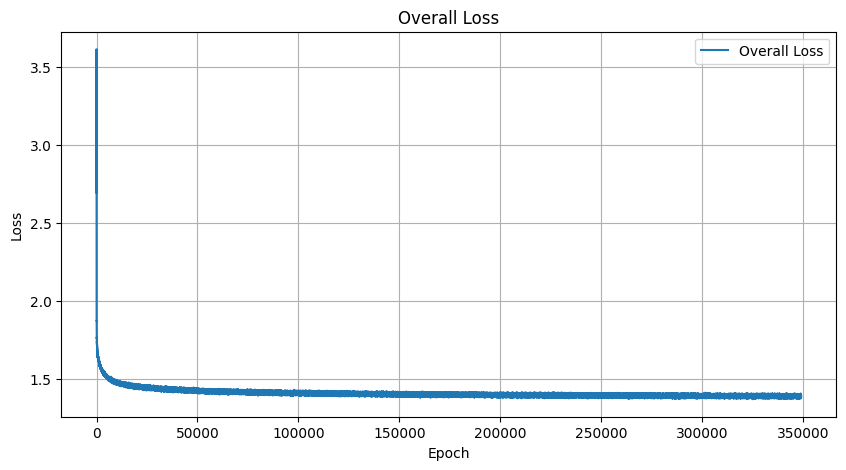

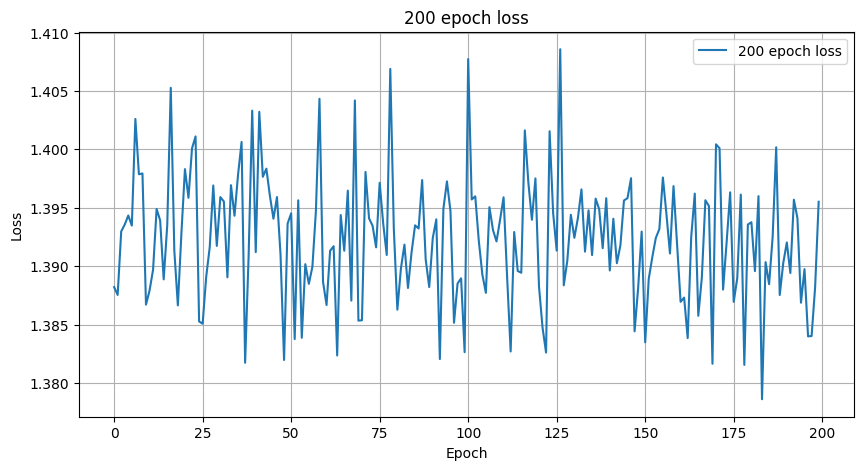

Epoch [1809701], Loss: 1.3961
Epoch [1809702], Loss: 1.3780
Epoch [1809703], Loss: 1.3930
Epoch [1809704], Loss: 1.3984
Epoch [1809705], Loss: 1.3875
Epoch [1809706], Loss: 1.4002
Epoch [1809707], Loss: 1.3982
Epoch [1809708], Loss: 1.3916
Epoch [1809709], Loss: 1.3869
Epoch [1809710], Loss: 1.3981
Epoch [1809711], Loss: 1.3972
Epoch [1809712], Loss: 1.3921
Epoch [1809713], Loss: 1.3982
Epoch [1809714], Loss: 1.3849
Epoch [1809715], Loss: 1.3850
Epoch [1809716], Loss: 1.3948
Epoch [1809717], Loss: 1.3940
Epoch [1809718], Loss: 1.3897
Epoch [1809719], Loss: 1.3970
Epoch [1809720], Loss: 1.3869
Epoch [1809721], Loss: 1.3933
Epoch [1809722], Loss: 1.3955
Epoch [1809723], Loss: 1.3889
Epoch [1809724], Loss: 1.3944
Epoch [1809725], Loss: 1.3923
Epoch [1809726], Loss: 1.3943
Epoch [1809727], Loss: 1.3949
Epoch [1809728], Loss: 1.3914
Epoch [1809729], Loss: 1.3930
Epoch [1809730], Loss: 1.4020
Epoch [1809731], Loss: 1.3898
Epoch [1809732], Loss: 1.3906
Epoch [1809733], Loss: 1.3951
Epoch [180

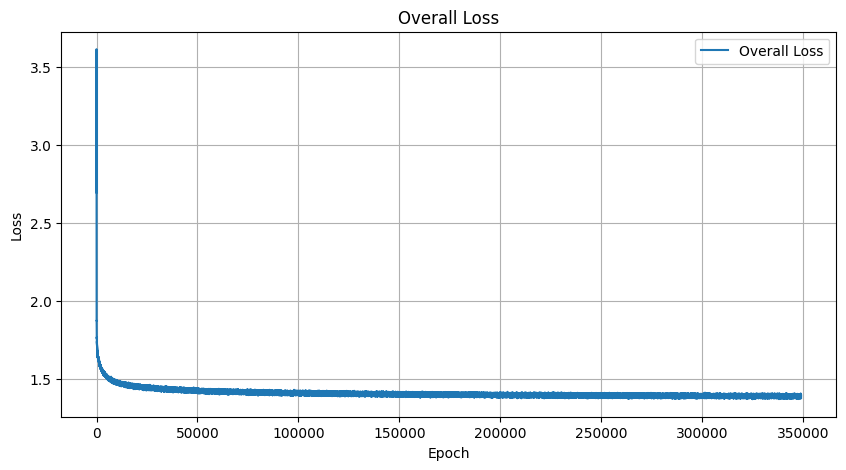

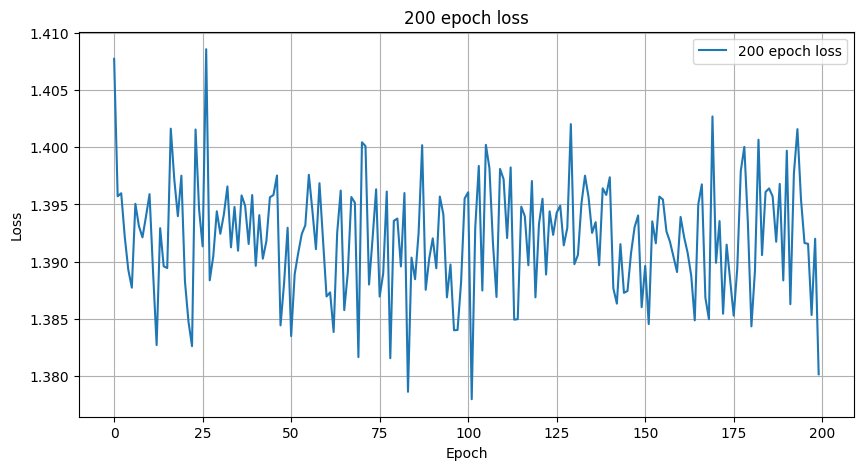

Epoch [1809801], Loss: 1.3882
Epoch [1809802], Loss: 1.3967
Epoch [1809803], Loss: 1.3917
Epoch [1809804], Loss: 1.3901
Epoch [1809805], Loss: 1.3834
Epoch [1809806], Loss: 1.3915
Epoch [1809807], Loss: 1.3870
Epoch [1809808], Loss: 1.3911
Epoch [1809809], Loss: 1.3988
Epoch [1809810], Loss: 1.3906
Epoch [1809811], Loss: 1.3988
Epoch [1809812], Loss: 1.3932
Epoch [1809813], Loss: 1.4017
Epoch [1809814], Loss: 1.3880
Epoch [1809815], Loss: 1.3924
Epoch [1809816], Loss: 1.3883
Epoch [1809817], Loss: 1.3876
Epoch [1809818], Loss: 1.3867
Epoch [1809819], Loss: 1.3826
Epoch [1809820], Loss: 1.3866
Epoch [1809821], Loss: 1.3960
Epoch [1809822], Loss: 1.3904
Epoch [1809823], Loss: 1.3931
Epoch [1809824], Loss: 1.3872
Epoch [1809825], Loss: 1.3930
Epoch [1809826], Loss: 1.3942
Epoch [1809827], Loss: 1.3977
Epoch [1809828], Loss: 1.3811
Epoch [1809829], Loss: 1.3918
Epoch [1809830], Loss: 1.3984
Epoch [1809831], Loss: 1.3887
Epoch [1809832], Loss: 1.3925
Epoch [1809833], Loss: 1.3898
Epoch [180

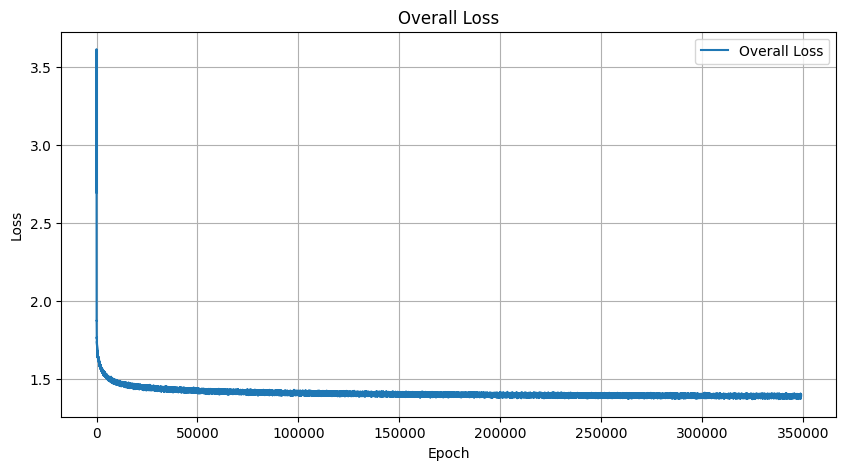

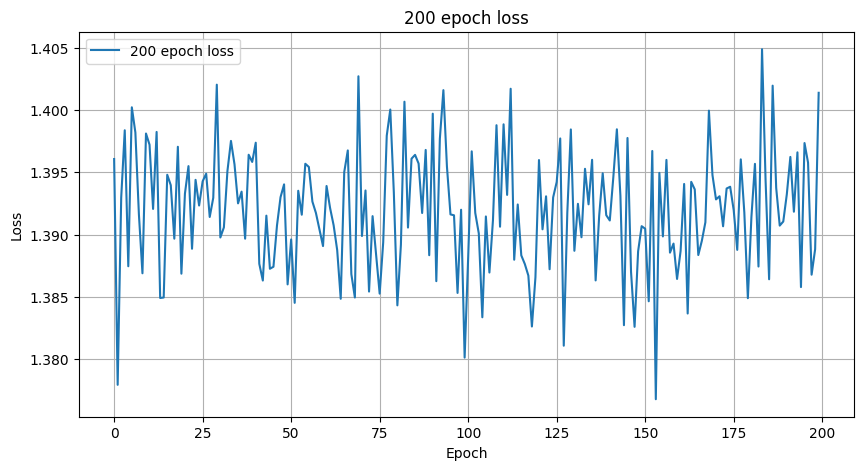

Epoch [1809901], Loss: 1.3981
Epoch [1809902], Loss: 1.3974
Epoch [1809903], Loss: 1.3910
Epoch [1809904], Loss: 1.3944
Epoch [1809905], Loss: 1.3971
Epoch [1809906], Loss: 1.3907
Epoch [1809907], Loss: 1.3905
Epoch [1809908], Loss: 1.3899
Epoch [1809909], Loss: 1.3860
Epoch [1809910], Loss: 1.3966
Epoch [1809911], Loss: 1.3820
Epoch [1809912], Loss: 1.3868
Epoch [1809913], Loss: 1.3960
Epoch [1809914], Loss: 1.3862
Epoch [1809915], Loss: 1.3904
Epoch [1809916], Loss: 1.3895
Epoch [1809917], Loss: 1.3997
Epoch [1809918], Loss: 1.3982
Epoch [1809919], Loss: 1.3882
Epoch [1809920], Loss: 1.3922
Epoch [1809921], Loss: 1.3941
Epoch [1809922], Loss: 1.3776
Epoch [1809923], Loss: 1.3911
Epoch [1809924], Loss: 1.3833
Epoch [1809925], Loss: 1.3914
Epoch [1809926], Loss: 1.3898
Epoch [1809927], Loss: 1.3980
Epoch [1809928], Loss: 1.3857
Epoch [1809929], Loss: 1.3889
Epoch [1809930], Loss: 1.3991
Epoch [1809931], Loss: 1.3964
Epoch [1809932], Loss: 1.3793
Epoch [1809933], Loss: 1.3950
Epoch [180

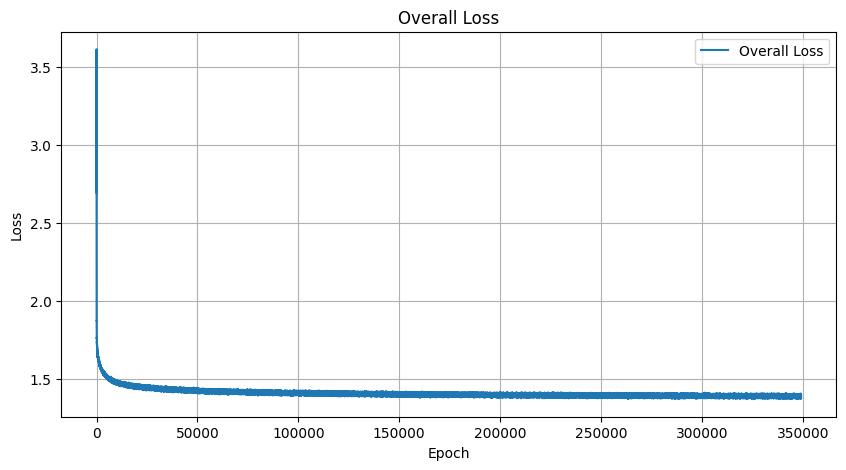

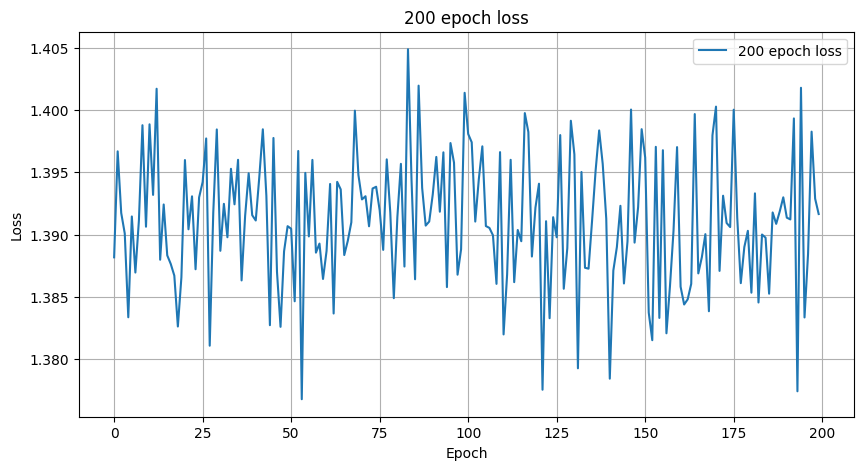

Epoch [1810001], Loss: 1.3915
Epoch [1810002], Loss: 1.3923
Epoch [1810003], Loss: 1.3860
Epoch [1810004], Loss: 1.3961
Epoch [1810005], Loss: 1.3879
Epoch [1810006], Loss: 1.3976
Epoch [1810007], Loss: 1.3935
Epoch [1810008], Loss: 1.3900
Epoch [1810009], Loss: 1.3979
Epoch [1810010], Loss: 1.3858
Epoch [1810011], Loss: 1.3964
Epoch [1810012], Loss: 1.3895
Epoch [1810013], Loss: 1.3879
Epoch [1810014], Loss: 1.3941
Epoch [1810015], Loss: 1.3954
Epoch [1810016], Loss: 1.3893
Epoch [1810017], Loss: 1.3845
Epoch [1810018], Loss: 1.3995
Epoch [1810019], Loss: 1.3911
Epoch [1810020], Loss: 1.3853
Epoch [1810021], Loss: 1.4028
Epoch [1810022], Loss: 1.3901
Epoch [1810023], Loss: 1.3999
Epoch [1810024], Loss: 1.3939
Epoch [1810025], Loss: 1.3907
Epoch [1810026], Loss: 1.3887
Epoch [1810027], Loss: 1.3858
Epoch [1810028], Loss: 1.3906
Epoch [1810029], Loss: 1.3928
Epoch [1810030], Loss: 1.3923
Epoch [1810031], Loss: 1.3809
Epoch [1810032], Loss: 1.3898
Epoch [1810033], Loss: 1.3940
Epoch [181

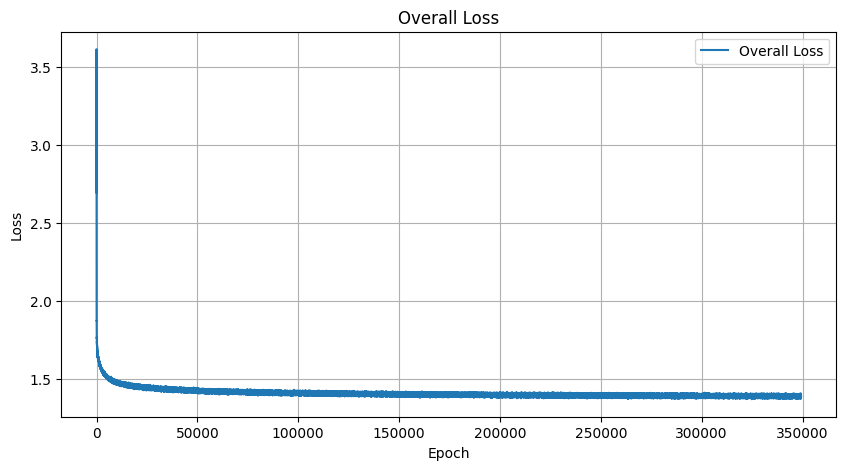

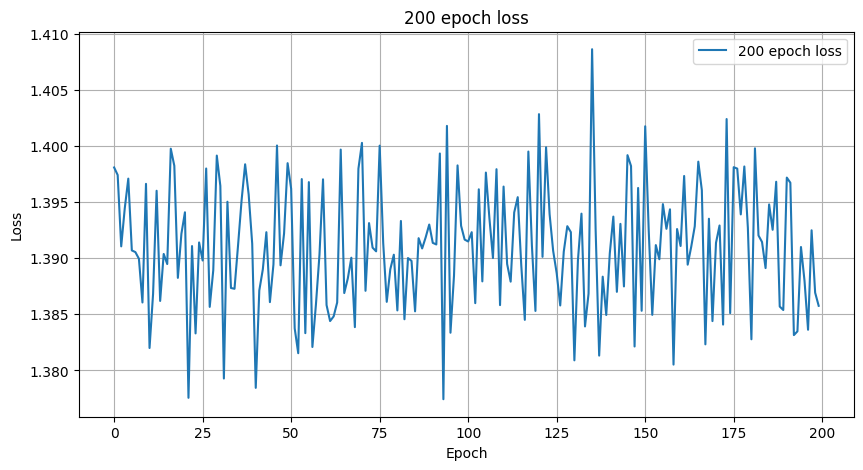

Epoch [1810101], Loss: 1.3883
Epoch [1810102], Loss: 1.3920
Epoch [1810103], Loss: 1.3865
Epoch [1810104], Loss: 1.3850
Epoch [1810105], Loss: 1.3859
Epoch [1810106], Loss: 1.3861
Epoch [1810107], Loss: 1.3919
Epoch [1810108], Loss: 1.3940
Epoch [1810109], Loss: 1.3898
Epoch [1810110], Loss: 1.3837
Epoch [1810111], Loss: 1.3988
Epoch [1810112], Loss: 1.4014
Epoch [1810113], Loss: 1.3815
Epoch [1810114], Loss: 1.3913
Epoch [1810115], Loss: 1.3855
Epoch [1810116], Loss: 1.3902
Epoch [1810117], Loss: 1.3929
Epoch [1810118], Loss: 1.3869
Epoch [1810119], Loss: 1.3935
Epoch [1810120], Loss: 1.3936
Epoch [1810121], Loss: 1.3913
Epoch [1810122], Loss: 1.3946
Epoch [1810123], Loss: 1.3928
Epoch [1810124], Loss: 1.3876
Epoch [1810125], Loss: 1.3954
Epoch [1810126], Loss: 1.4014
Epoch [1810127], Loss: 1.3935
Epoch [1810128], Loss: 1.3915
Epoch [1810129], Loss: 1.3913
Epoch [1810130], Loss: 1.3917
Epoch [1810131], Loss: 1.3895
Epoch [1810132], Loss: 1.3950
Epoch [1810133], Loss: 1.3865
Epoch [181

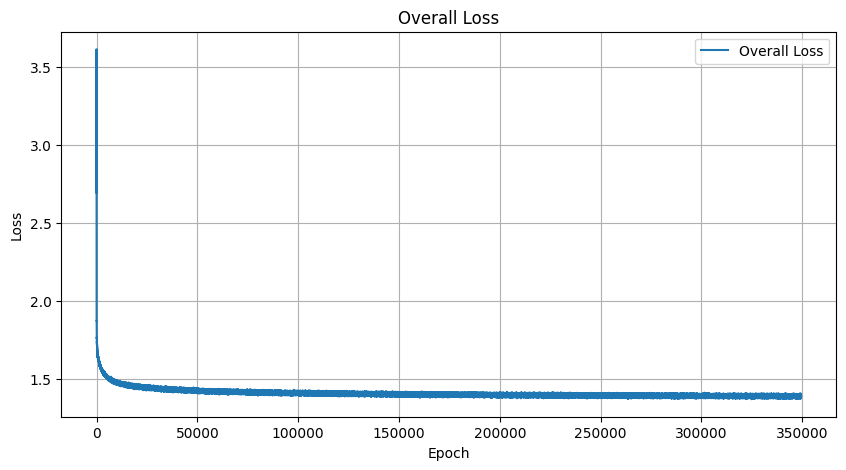

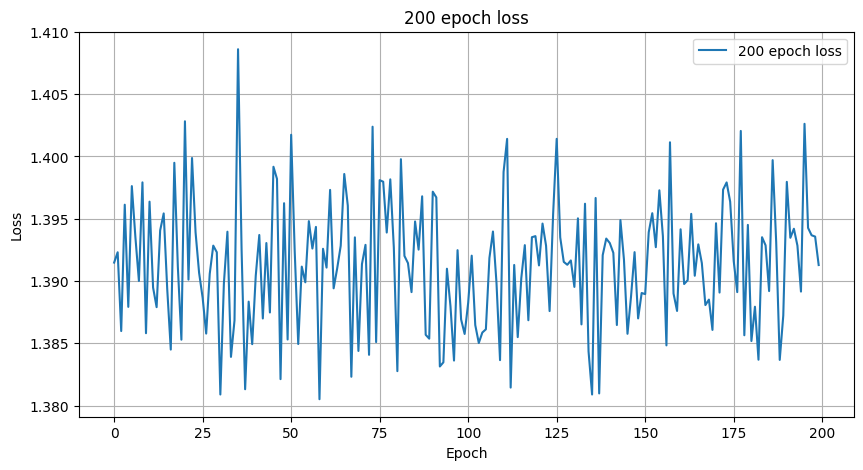

Epoch [1810201], Loss: 1.3997
Epoch [1810202], Loss: 1.3864
Epoch [1810203], Loss: 1.3843
Epoch [1810204], Loss: 1.4024
Epoch [1810205], Loss: 1.3906
Epoch [1810206], Loss: 1.3955
Epoch [1810207], Loss: 1.3953
Epoch [1810208], Loss: 1.3965
Epoch [1810209], Loss: 1.3893
Epoch [1810210], Loss: 1.3935
Epoch [1810211], Loss: 1.3835
Epoch [1810212], Loss: 1.3887
Epoch [1810213], Loss: 1.3917
Epoch [1810214], Loss: 1.3857
Epoch [1810215], Loss: 1.3948
Epoch [1810216], Loss: 1.3900
Epoch [1810217], Loss: 1.3889
Epoch [1810218], Loss: 1.3980
Epoch [1810219], Loss: 1.3917
Epoch [1810220], Loss: 1.3930
Epoch [1810221], Loss: 1.3976
Epoch [1810222], Loss: 1.3890
Epoch [1810223], Loss: 1.3977
Epoch [1810224], Loss: 1.3896
Epoch [1810225], Loss: 1.3956
Epoch [1810226], Loss: 1.3930
Epoch [1810227], Loss: 1.3925
Epoch [1810228], Loss: 1.3860
Epoch [1810229], Loss: 1.3982
Epoch [1810230], Loss: 1.3917
Epoch [1810231], Loss: 1.3922
Epoch [1810232], Loss: 1.3955
Epoch [1810233], Loss: 1.3837
Epoch [181

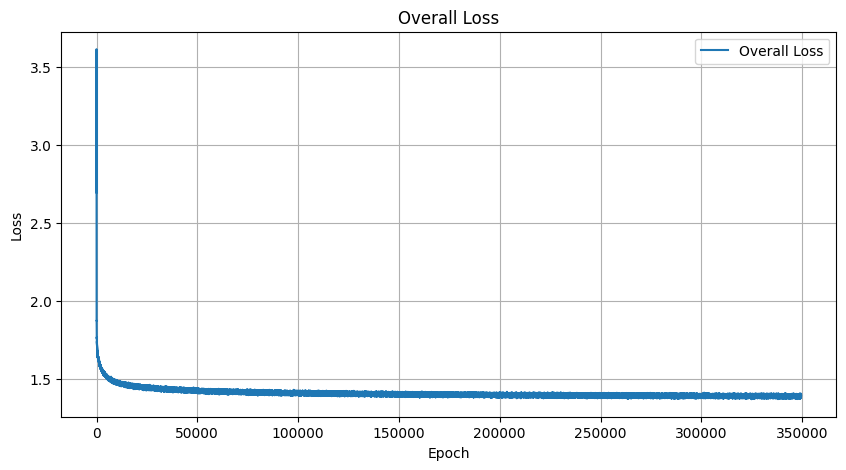

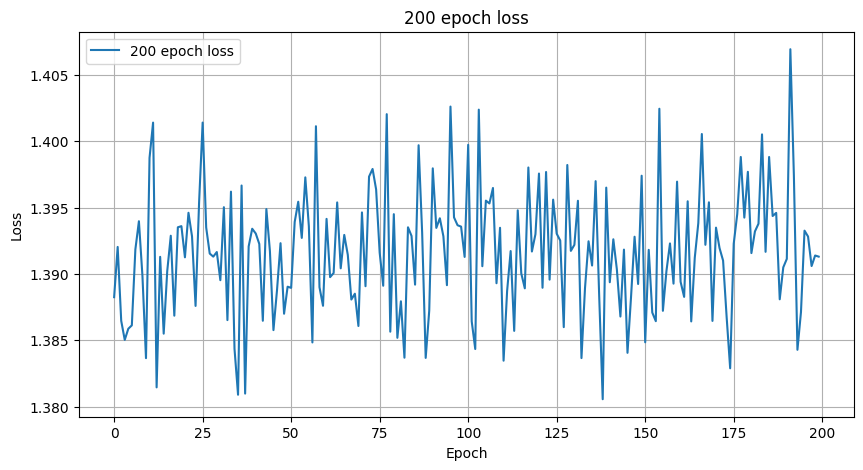

Epoch [1810301], Loss: 1.4010
Epoch [1810302], Loss: 1.3958
Epoch [1810303], Loss: 1.3852
Epoch [1810304], Loss: 1.3975
Epoch [1810305], Loss: 1.3837
Epoch [1810306], Loss: 1.3809
Epoch [1810307], Loss: 1.3889
Epoch [1810308], Loss: 1.3977
Epoch [1810309], Loss: 1.3895
Epoch [1810310], Loss: 1.3920
Epoch [1810311], Loss: 1.3916
Epoch [1810312], Loss: 1.3903
Epoch [1810313], Loss: 1.3882
Epoch [1810314], Loss: 1.3933
Epoch [1810315], Loss: 1.3997
Epoch [1810316], Loss: 1.3899
Epoch [1810317], Loss: 1.3950
Epoch [1810318], Loss: 1.3996
Epoch [1810319], Loss: 1.3890
Epoch [1810320], Loss: 1.3833
Epoch [1810321], Loss: 1.3855
Epoch [1810322], Loss: 1.3929
Epoch [1810323], Loss: 1.3968
Epoch [1810324], Loss: 1.3997
Epoch [1810325], Loss: 1.3909
Epoch [1810326], Loss: 1.3974
Epoch [1810327], Loss: 1.3972
Epoch [1810328], Loss: 1.3930
Epoch [1810329], Loss: 1.3970
Epoch [1810330], Loss: 1.3890
Epoch [1810331], Loss: 1.3953
Epoch [1810332], Loss: 1.3950
Epoch [1810333], Loss: 1.3927
Epoch [181

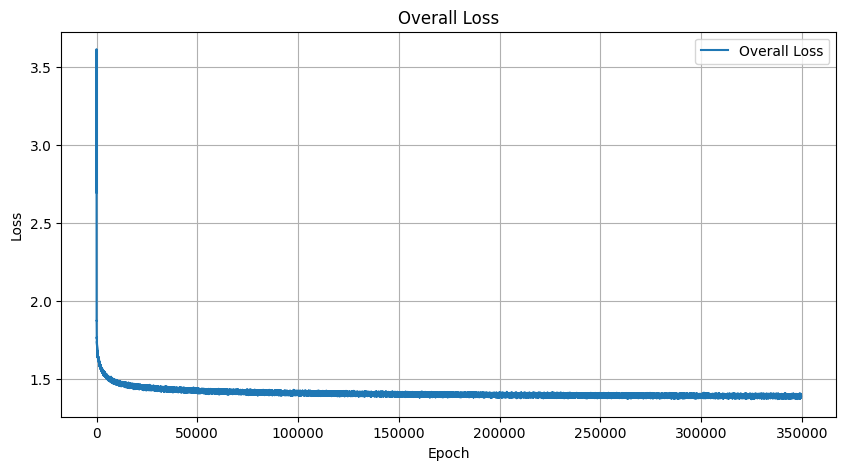

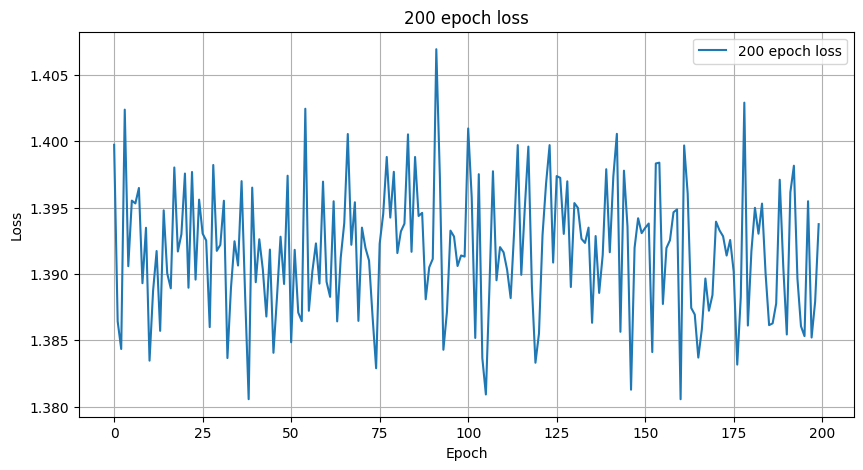

Epoch [1810401], Loss: 1.4005
Epoch [1810402], Loss: 1.3926
Epoch [1810403], Loss: 1.3949
Epoch [1810404], Loss: 1.3916
Epoch [1810405], Loss: 1.3864
Epoch [1810406], Loss: 1.3841
Epoch [1810407], Loss: 1.3898
Epoch [1810408], Loss: 1.3976
Epoch [1810409], Loss: 1.3978
Epoch [1810410], Loss: 1.3939
Epoch [1810411], Loss: 1.3875
Epoch [1810412], Loss: 1.3935
Epoch [1810413], Loss: 1.3978
Epoch [1810414], Loss: 1.3937
Epoch [1810415], Loss: 1.3866
Epoch [1810416], Loss: 1.3986
Epoch [1810417], Loss: 1.3911
Epoch [1810418], Loss: 1.3916
Epoch [1810419], Loss: 1.3945
Epoch [1810420], Loss: 1.3882
Epoch [1810421], Loss: 1.3955
Epoch [1810422], Loss: 1.3963
Epoch [1810423], Loss: 1.3954
Epoch [1810424], Loss: 1.3935
Epoch [1810425], Loss: 1.3974
Epoch [1810426], Loss: 1.3856
Epoch [1810427], Loss: 1.3862
Epoch [1810428], Loss: 1.3875
Epoch [1810429], Loss: 1.3783
Epoch [1810430], Loss: 1.4008
Epoch [1810431], Loss: 1.3925
Epoch [1810432], Loss: 1.3919
Epoch [1810433], Loss: 1.3844
Epoch [181

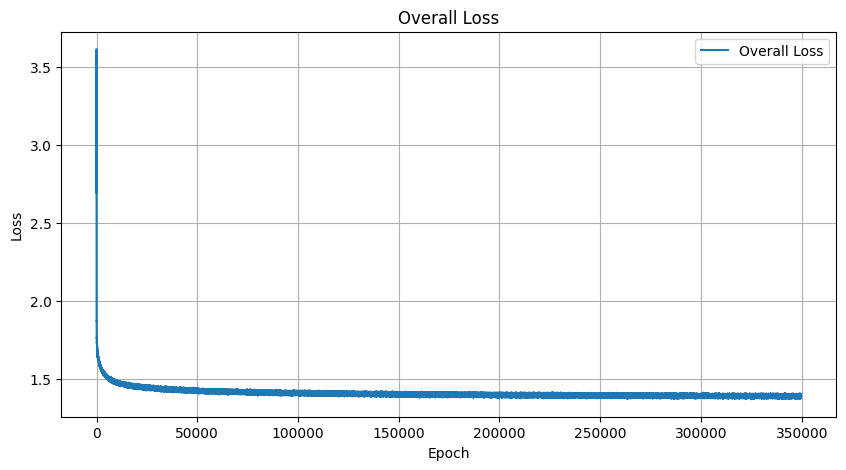

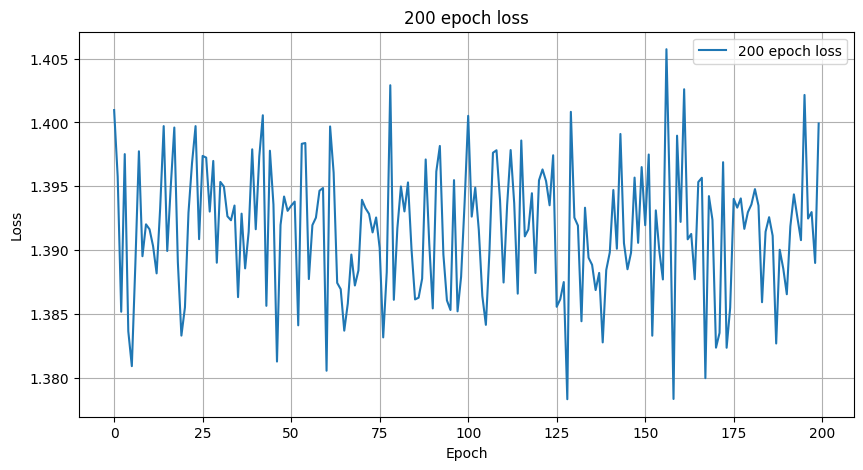

Epoch [1810501], Loss: 1.3976
Epoch [1810502], Loss: 1.3964
Epoch [1810503], Loss: 1.3917
Epoch [1810504], Loss: 1.3909
Epoch [1810505], Loss: 1.3961
Epoch [1810506], Loss: 1.3839
Epoch [1810507], Loss: 1.3926
Epoch [1810508], Loss: 1.3898
Epoch [1810509], Loss: 1.3877
Epoch [1810510], Loss: 1.3982
Epoch [1810511], Loss: 1.3866
Epoch [1810512], Loss: 1.3919
Epoch [1810513], Loss: 1.3894
Epoch [1810514], Loss: 1.4013
Epoch [1810515], Loss: 1.4020
Epoch [1810516], Loss: 1.3928
Epoch [1810517], Loss: 1.3929
Epoch [1810518], Loss: 1.4067
Epoch [1810519], Loss: 1.3953
Epoch [1810520], Loss: 1.3946
Epoch [1810521], Loss: 1.3966
Epoch [1810522], Loss: 1.4009
Epoch [1810523], Loss: 1.3858
Epoch [1810524], Loss: 1.3867
Epoch [1810525], Loss: 1.3898
Epoch [1810526], Loss: 1.3870
Epoch [1810527], Loss: 1.3904
Epoch [1810528], Loss: 1.3916
Epoch [1810529], Loss: 1.3820
Epoch [1810530], Loss: 1.4053
Epoch [1810531], Loss: 1.3883
Epoch [1810532], Loss: 1.3930
Epoch [1810533], Loss: 1.3945
Epoch [181

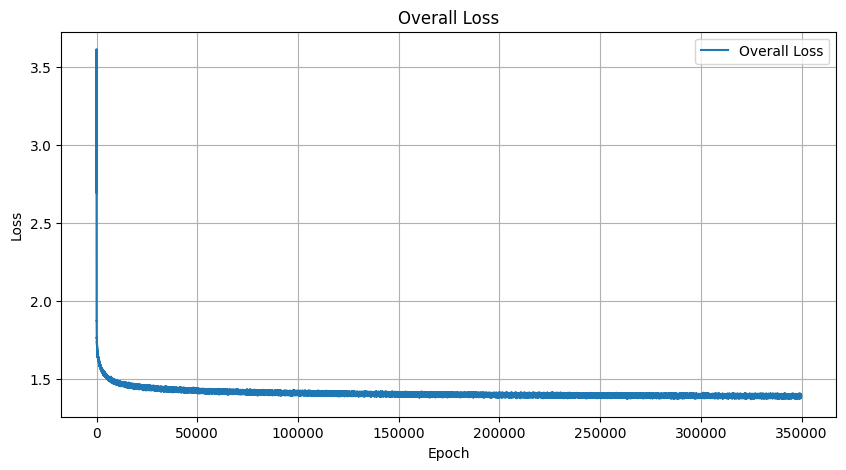

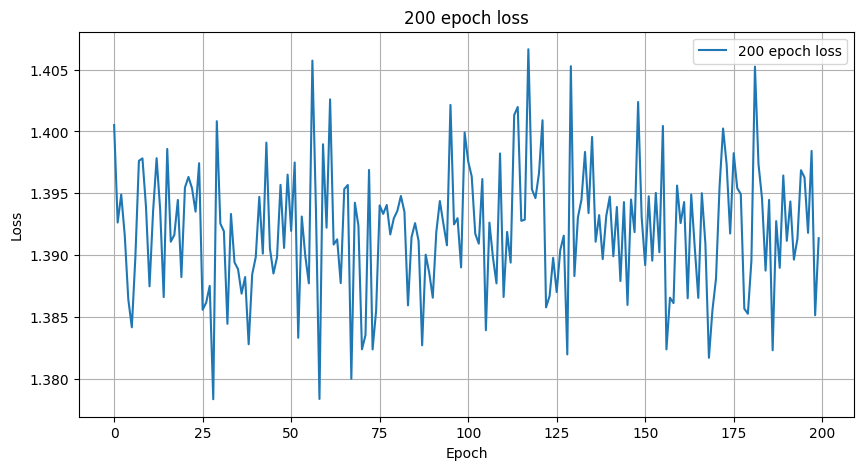

Epoch [1810601], Loss: 1.3926
Epoch [1810602], Loss: 1.3843
Epoch [1810603], Loss: 1.3843
Epoch [1810604], Loss: 1.3984
Epoch [1810605], Loss: 1.3883
Epoch [1810606], Loss: 1.3898
Epoch [1810607], Loss: 1.3942
Epoch [1810608], Loss: 1.3864
Epoch [1810609], Loss: 1.3951
Epoch [1810610], Loss: 1.3933
Epoch [1810611], Loss: 1.3910
Epoch [1810612], Loss: 1.3957
Epoch [1810613], Loss: 1.3915
Epoch [1810614], Loss: 1.3913
Epoch [1810615], Loss: 1.3904
Epoch [1810616], Loss: 1.3903
Epoch [1810617], Loss: 1.3966
Epoch [1810618], Loss: 1.3911
Epoch [1810619], Loss: 1.3872
Epoch [1810620], Loss: 1.3845
Epoch [1810621], Loss: 1.3814
Epoch [1810622], Loss: 1.3937
Epoch [1810623], Loss: 1.3933
Epoch [1810624], Loss: 1.3903
Epoch [1810625], Loss: 1.3878
Epoch [1810626], Loss: 1.3979
Epoch [1810627], Loss: 1.3858
Epoch [1810628], Loss: 1.3887
Epoch [1810629], Loss: 1.3987
Epoch [1810630], Loss: 1.3960
Epoch [1810631], Loss: 1.3920
Epoch [1810632], Loss: 1.3937
Epoch [1810633], Loss: 1.3889
Epoch [181

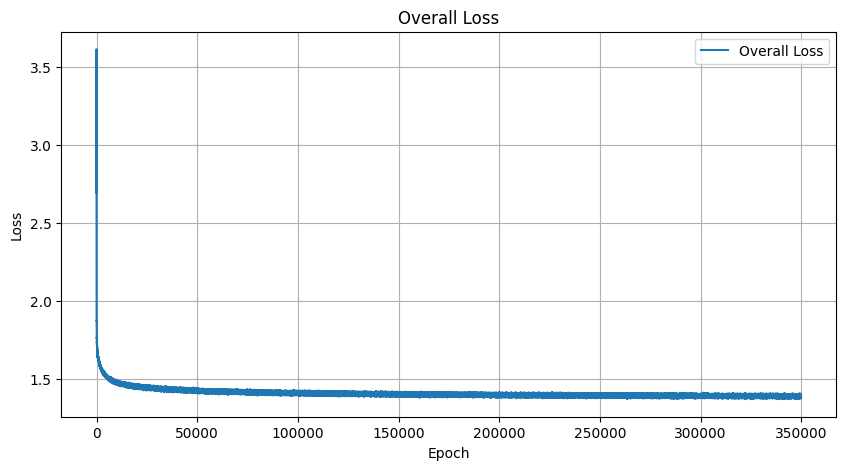

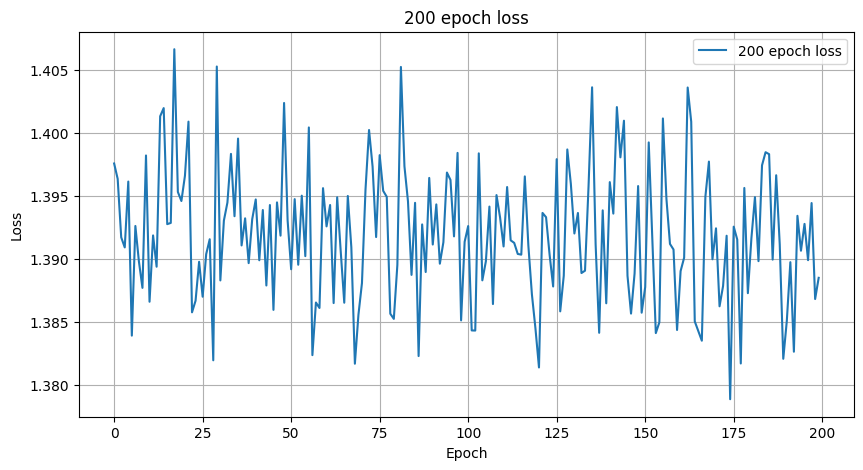

Epoch [1810701], Loss: 1.3860
Epoch [1810702], Loss: 1.3873
Epoch [1810703], Loss: 1.3856
Epoch [1810704], Loss: 1.3910
Epoch [1810705], Loss: 1.3879
Epoch [1810706], Loss: 1.3972
Epoch [1810707], Loss: 1.3872
Epoch [1810708], Loss: 1.3906
Epoch [1810709], Loss: 1.3857
Epoch [1810710], Loss: 1.3894
Epoch [1810711], Loss: 1.3965
Epoch [1810712], Loss: 1.3962
Epoch [1810713], Loss: 1.3871
Epoch [1810714], Loss: 1.3875
Epoch [1810715], Loss: 1.3930
Epoch [1810716], Loss: 1.3931
Epoch [1810717], Loss: 1.3935
Epoch [1810718], Loss: 1.3807
Epoch [1810719], Loss: 1.3928
Epoch [1810720], Loss: 1.3989
Epoch [1810721], Loss: 1.3917
Epoch [1810722], Loss: 1.3895
Epoch [1810723], Loss: 1.3982
Epoch [1810724], Loss: 1.3973
Epoch [1810725], Loss: 1.3921
Epoch [1810726], Loss: 1.3899
Epoch [1810727], Loss: 1.3865
Epoch [1810728], Loss: 1.3845
Epoch [1810729], Loss: 1.3873
Epoch [1810730], Loss: 1.3900
Epoch [1810731], Loss: 1.3892
Epoch [1810732], Loss: 1.3958
Epoch [1810733], Loss: 1.3930
Epoch [181

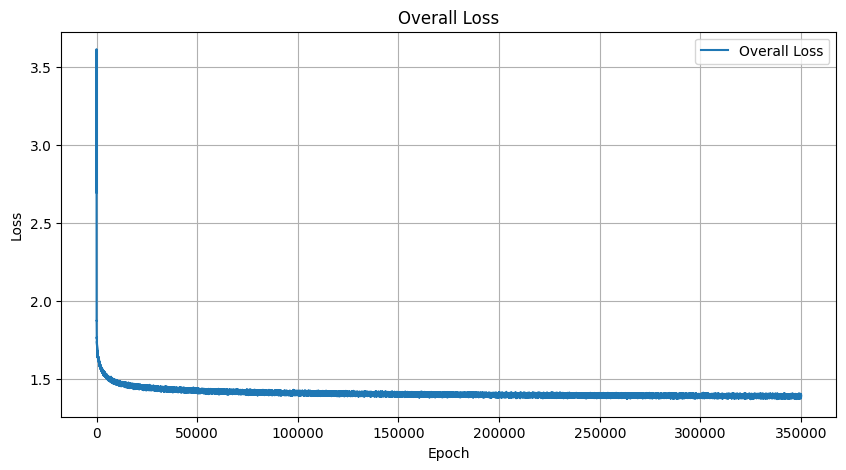

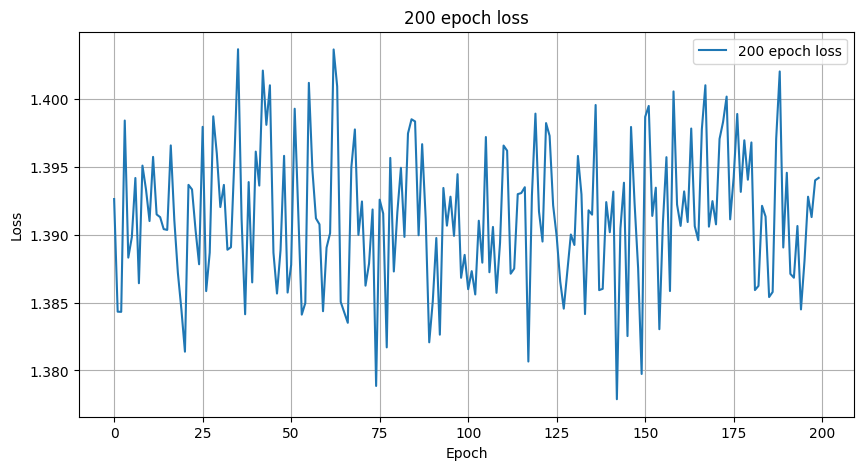

Epoch [1810801], Loss: 1.3904
Epoch [1810802], Loss: 1.3877
Epoch [1810803], Loss: 1.3918
Epoch [1810804], Loss: 1.3955
Epoch [1810805], Loss: 1.3921
Epoch [1810806], Loss: 1.3987
Epoch [1810807], Loss: 1.3943
Epoch [1810808], Loss: 1.3788
Epoch [1810809], Loss: 1.3897
Epoch [1810810], Loss: 1.3869
Epoch [1810811], Loss: 1.3966
Epoch [1810812], Loss: 1.3958
Epoch [1810813], Loss: 1.3958
Epoch [1810814], Loss: 1.3896
Epoch [1810815], Loss: 1.3891
Epoch [1810816], Loss: 1.3886
Epoch [1810817], Loss: 1.3878
Epoch [1810818], Loss: 1.3966
Epoch [1810819], Loss: 1.4026
Epoch [1810820], Loss: 1.3952
Epoch [1810821], Loss: 1.3948
Epoch [1810822], Loss: 1.3900
Epoch [1810823], Loss: 1.4002
Epoch [1810824], Loss: 1.3874
Epoch [1810825], Loss: 1.3923
Epoch [1810826], Loss: 1.3979
Epoch [1810827], Loss: 1.3906
Epoch [1810828], Loss: 1.3879
Epoch [1810829], Loss: 1.3869
Epoch [1810830], Loss: 1.3887
Epoch [1810831], Loss: 1.3895
Epoch [1810832], Loss: 1.3967
Epoch [1810833], Loss: 1.3960
Epoch [181

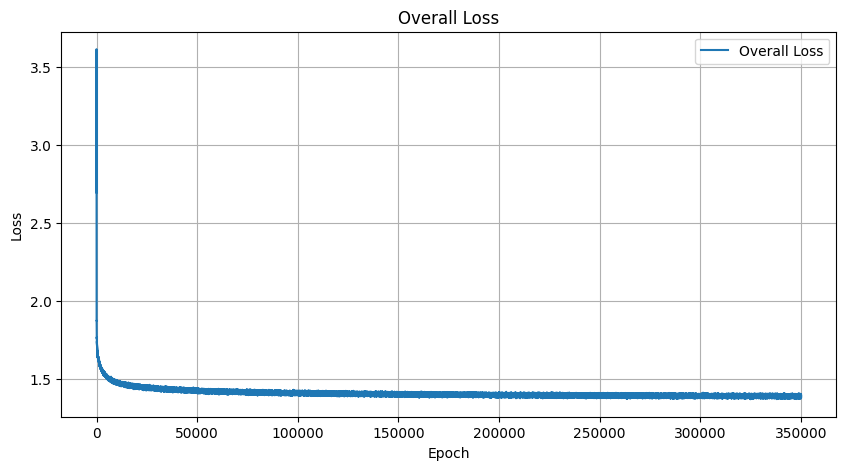

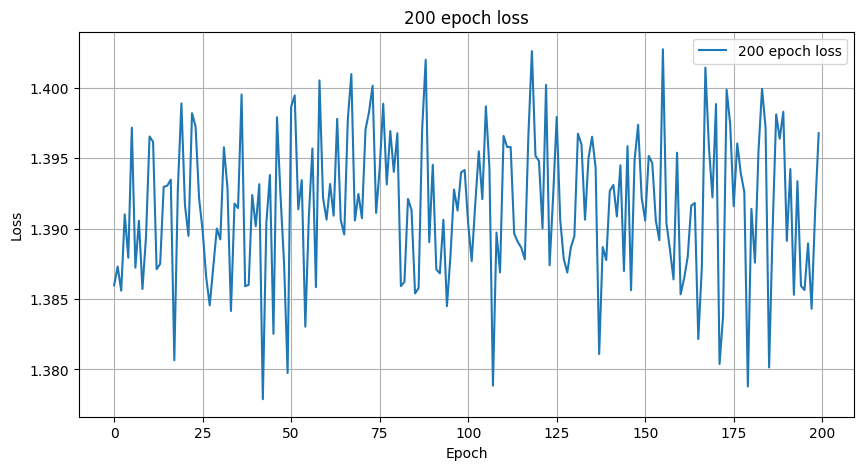

Epoch [1810901], Loss: 1.3901
Epoch [1810902], Loss: 1.3959
Epoch [1810903], Loss: 1.3954
Epoch [1810904], Loss: 1.4034
Epoch [1810905], Loss: 1.3892
Epoch [1810906], Loss: 1.3881
Epoch [1810907], Loss: 1.3964
Epoch [1810908], Loss: 1.3876
Epoch [1810909], Loss: 1.3877
Epoch [1810910], Loss: 1.4011
Epoch [1810911], Loss: 1.3850
Epoch [1810912], Loss: 1.3883
Epoch [1810913], Loss: 1.3863
Epoch [1810914], Loss: 1.3956
Epoch [1810915], Loss: 1.3959
Epoch [1810916], Loss: 1.3895
Epoch [1810917], Loss: 1.3915
Epoch [1810918], Loss: 1.3844
Epoch [1810919], Loss: 1.3889
Epoch [1810920], Loss: 1.3957
Epoch [1810921], Loss: 1.3932
Epoch [1810922], Loss: 1.3833
Epoch [1810923], Loss: 1.3986
Epoch [1810924], Loss: 1.3914
Epoch [1810925], Loss: 1.3905
Epoch [1810926], Loss: 1.3853
Epoch [1810927], Loss: 1.3912
Epoch [1810928], Loss: 1.3920
Epoch [1810929], Loss: 1.3917
Epoch [1810930], Loss: 1.3884
Epoch [1810931], Loss: 1.3989
Epoch [1810932], Loss: 1.3903
Epoch [1810933], Loss: 1.3946
Epoch [181

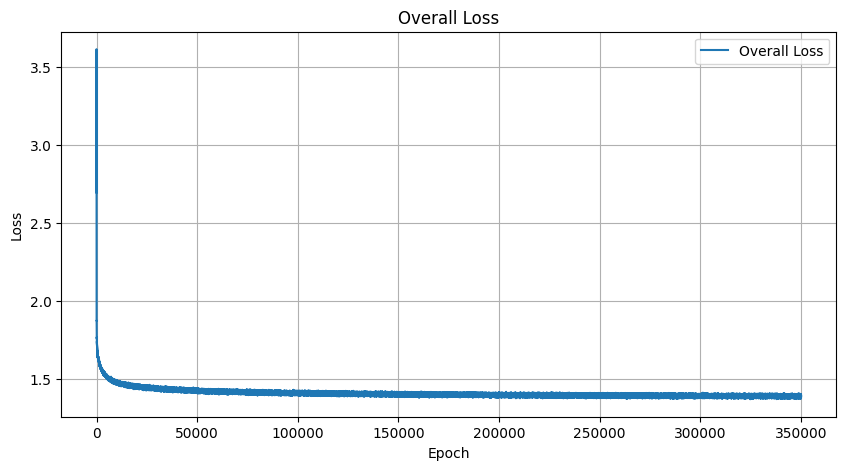

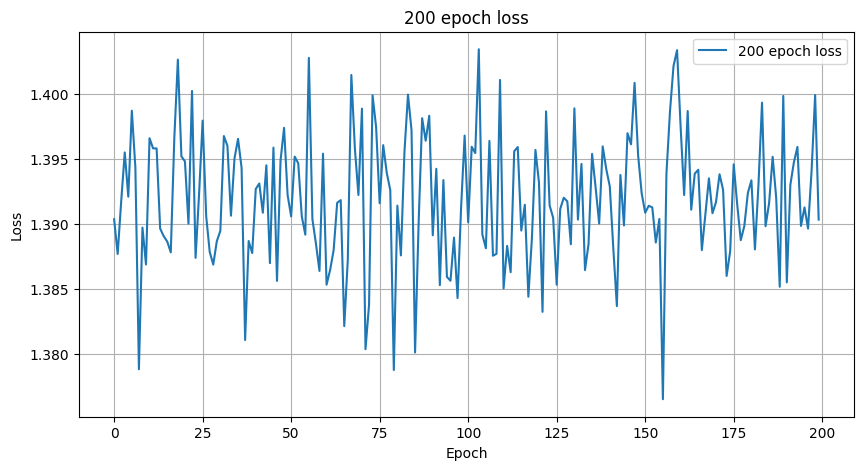

Epoch [1811001], Loss: 1.3914
Epoch [1811002], Loss: 1.3978
Epoch [1811003], Loss: 1.3884
Epoch [1811004], Loss: 1.3798
Epoch [1811005], Loss: 1.3929
Epoch [1811006], Loss: 1.3989
Epoch [1811007], Loss: 1.3907
Epoch [1811008], Loss: 1.3856
Epoch [1811009], Loss: 1.3906
Epoch [1811010], Loss: 1.3959
Epoch [1811011], Loss: 1.3977
Epoch [1811012], Loss: 1.3871
Epoch [1811013], Loss: 1.3976
Epoch [1811014], Loss: 1.3955
Epoch [1811015], Loss: 1.3931
Epoch [1811016], Loss: 1.3901
Epoch [1811017], Loss: 1.3873
Epoch [1811018], Loss: 1.3833
Epoch [1811019], Loss: 1.3908
Epoch [1811020], Loss: 1.3884
Epoch [1811021], Loss: 1.3907
Epoch [1811022], Loss: 1.3854
Epoch [1811023], Loss: 1.3940
Epoch [1811024], Loss: 1.3929
Epoch [1811025], Loss: 1.3874
Epoch [1811026], Loss: 1.3940
Epoch [1811027], Loss: 1.3913
Epoch [1811028], Loss: 1.3835
Epoch [1811029], Loss: 1.3892
Epoch [1811030], Loss: 1.3949
Epoch [1811031], Loss: 1.3946
Epoch [1811032], Loss: 1.3841
Epoch [1811033], Loss: 1.3963
Epoch [181

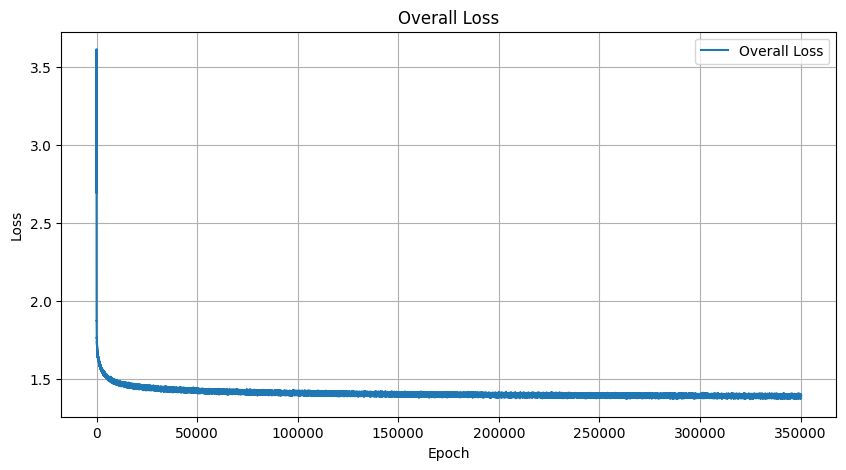

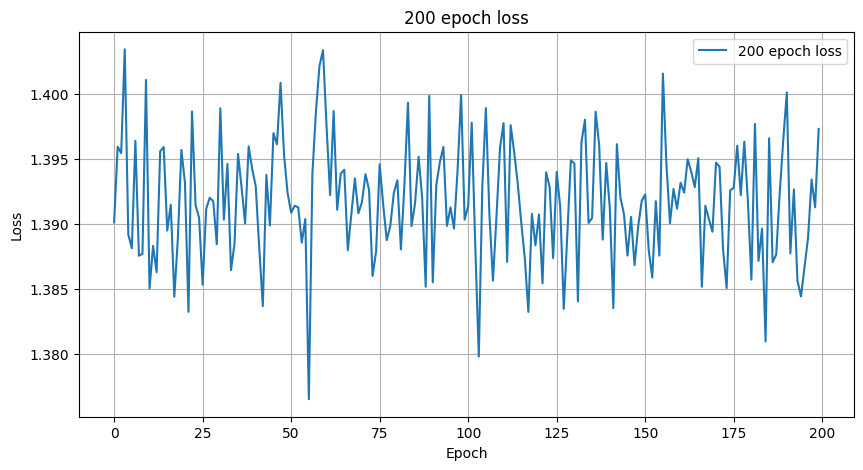

Epoch [1811101], Loss: 1.3935
Epoch [1811102], Loss: 1.3888
Epoch [1811103], Loss: 1.3827
Epoch [1811104], Loss: 1.3903
Epoch [1811105], Loss: 1.3990
Epoch [1811106], Loss: 1.3973
Epoch [1811107], Loss: 1.3918
Epoch [1811108], Loss: 1.3946
Epoch [1811109], Loss: 1.3977
Epoch [1811110], Loss: 1.3848
Epoch [1811111], Loss: 1.3896
Epoch [1811112], Loss: 1.3914
Epoch [1811113], Loss: 1.3925
Epoch [1811114], Loss: 1.3957
Epoch [1811115], Loss: 1.3946
Epoch [1811116], Loss: 1.3936
Epoch [1811117], Loss: 1.3991
Epoch [1811118], Loss: 1.3897
Epoch [1811119], Loss: 1.3912
Epoch [1811120], Loss: 1.3884
Epoch [1811121], Loss: 1.3919
Epoch [1811122], Loss: 1.3966
Epoch [1811123], Loss: 1.3870
Epoch [1811124], Loss: 1.3962
Epoch [1811125], Loss: 1.3920
Epoch [1811126], Loss: 1.3852
Epoch [1811127], Loss: 1.3881
Epoch [1811128], Loss: 1.3880
Epoch [1811129], Loss: 1.3869
Epoch [1811130], Loss: 1.3843
Epoch [1811131], Loss: 1.3926
Epoch [1811132], Loss: 1.3898
Epoch [1811133], Loss: 1.3966
Epoch [181

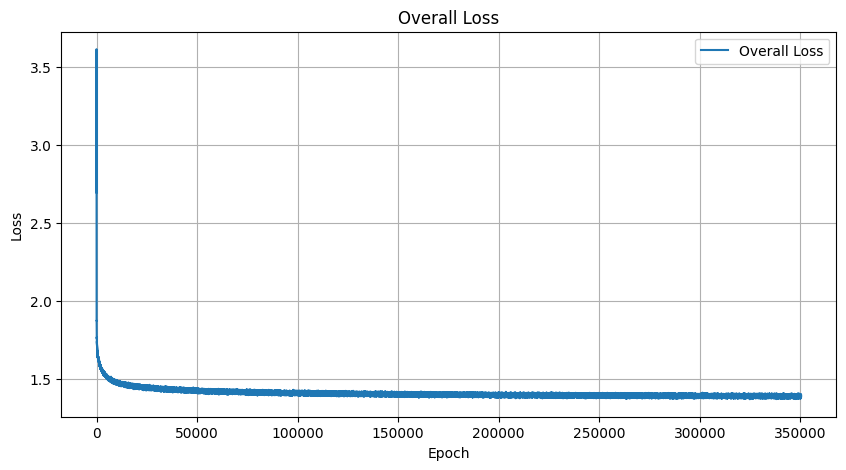

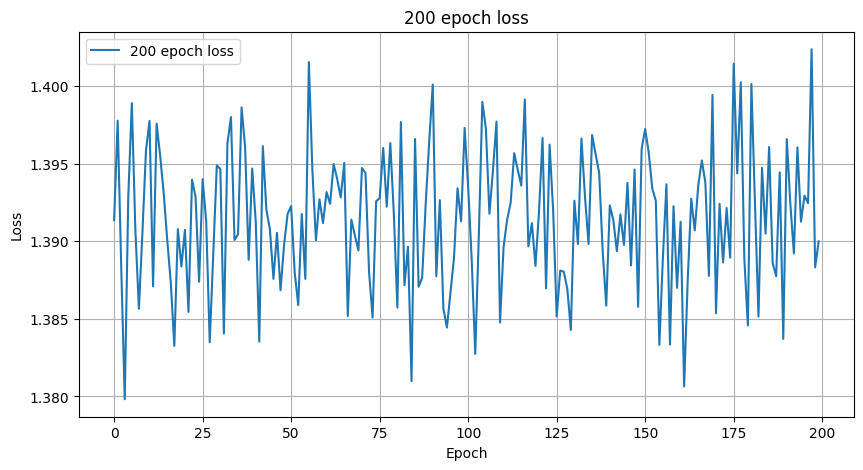

Epoch [1811201], Loss: 1.3829
Epoch [1811202], Loss: 1.3911
Epoch [1811203], Loss: 1.3942
Epoch [1811204], Loss: 1.3865
Epoch [1811205], Loss: 1.3837
Epoch [1811206], Loss: 1.3985
Epoch [1811207], Loss: 1.3943
Epoch [1811208], Loss: 1.3917
Epoch [1811209], Loss: 1.4002
Epoch [1811210], Loss: 1.3945
Epoch [1811211], Loss: 1.3851
Epoch [1811212], Loss: 1.4011
Epoch [1811213], Loss: 1.3962
Epoch [1811214], Loss: 1.3872
Epoch [1811215], Loss: 1.3915
Epoch [1811216], Loss: 1.3822
Epoch [1811217], Loss: 1.3891
Epoch [1811218], Loss: 1.3934
Epoch [1811219], Loss: 1.3926
Epoch [1811220], Loss: 1.3902
Epoch [1811221], Loss: 1.3885
Epoch [1811222], Loss: 1.3954
Epoch [1811223], Loss: 1.3986
Epoch [1811224], Loss: 1.3953
Epoch [1811225], Loss: 1.3968
Epoch [1811226], Loss: 1.3944
Epoch [1811227], Loss: 1.3956
Epoch [1811228], Loss: 1.4032
Epoch [1811229], Loss: 1.3928
Epoch [1811230], Loss: 1.3965
Epoch [1811231], Loss: 1.3899
Epoch [1811232], Loss: 1.3940
Epoch [1811233], Loss: 1.3973
Epoch [181

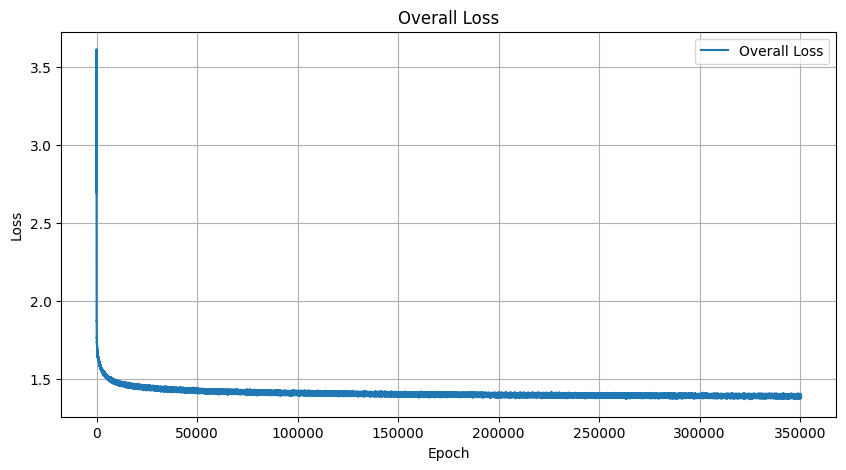

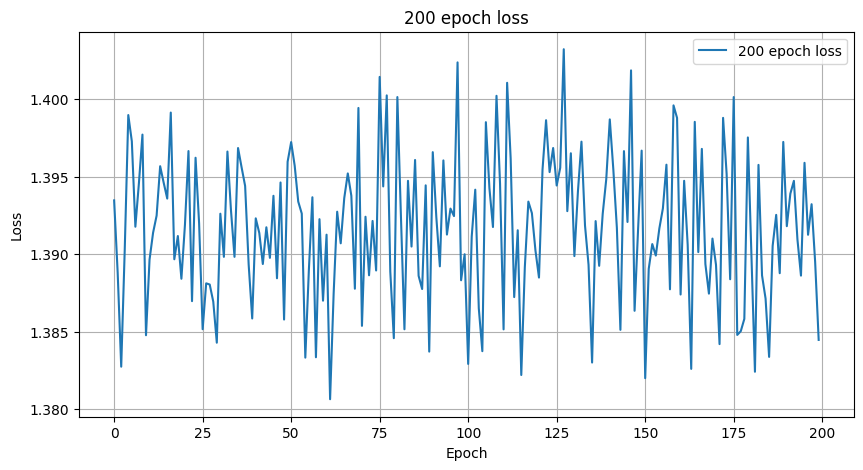

Epoch [1811301], Loss: 1.4021
Epoch [1811302], Loss: 1.3922
Epoch [1811303], Loss: 1.4032
Epoch [1811304], Loss: 1.3931
Epoch [1811305], Loss: 1.3916
Epoch [1811306], Loss: 1.3914
Epoch [1811307], Loss: 1.3917
Epoch [1811308], Loss: 1.3910
Epoch [1811309], Loss: 1.3929
Epoch [1811310], Loss: 1.3835
Epoch [1811311], Loss: 1.3894
Epoch [1811312], Loss: 1.3872
Epoch [1811313], Loss: 1.3999
Epoch [1811314], Loss: 1.3936
Epoch [1811315], Loss: 1.3926
Epoch [1811316], Loss: 1.3885
Epoch [1811317], Loss: 1.3903
Epoch [1811318], Loss: 1.3914
Epoch [1811319], Loss: 1.3865
Epoch [1811320], Loss: 1.3963
Epoch [1811321], Loss: 1.3863
Epoch [1811322], Loss: 1.3889
Epoch [1811323], Loss: 1.3942
Epoch [1811324], Loss: 1.3973
Epoch [1811325], Loss: 1.3962
Epoch [1811326], Loss: 1.3944
Epoch [1811327], Loss: 1.3916
Epoch [1811328], Loss: 1.3866
Epoch [1811329], Loss: 1.3915
Epoch [1811330], Loss: 1.4000
Epoch [1811331], Loss: 1.3970
Epoch [1811332], Loss: 1.3881
Epoch [1811333], Loss: 1.3874
Epoch [181

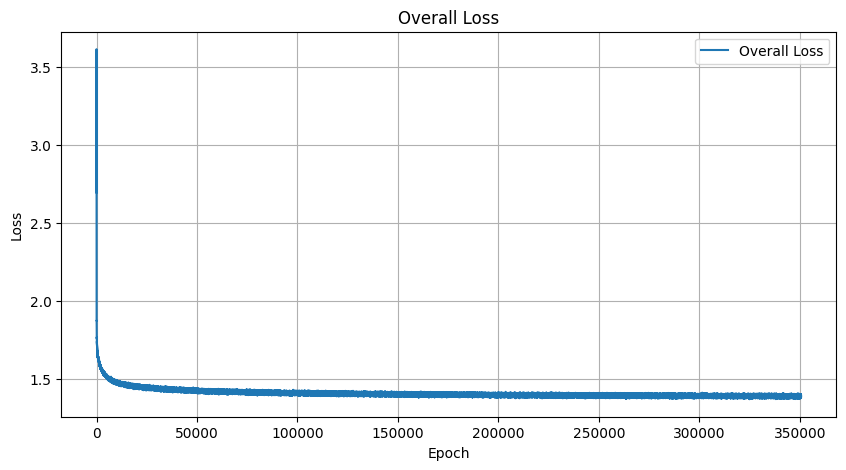

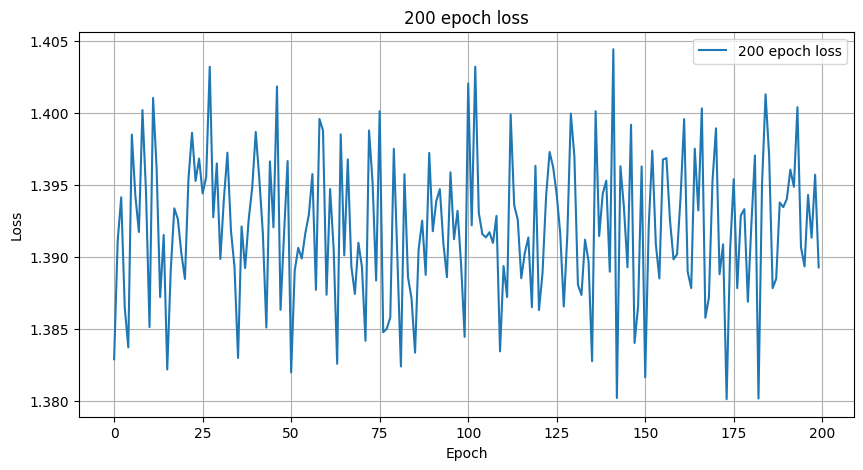

Epoch [1811401], Loss: 1.3886
Epoch [1811402], Loss: 1.3916
Epoch [1811403], Loss: 1.4004
Epoch [1811404], Loss: 1.3947
Epoch [1811405], Loss: 1.3888
Epoch [1811406], Loss: 1.3929
Epoch [1811407], Loss: 1.3911
Epoch [1811408], Loss: 1.3932
Epoch [1811409], Loss: 1.3942
Epoch [1811410], Loss: 1.3930
Epoch [1811411], Loss: 1.3947
Epoch [1811412], Loss: 1.3913
Epoch [1811413], Loss: 1.3919
Epoch [1811414], Loss: 1.3943
Epoch [1811415], Loss: 1.3983
Epoch [1811416], Loss: 1.3889
Epoch [1811417], Loss: 1.3987
Epoch [1811418], Loss: 1.3883
Epoch [1811419], Loss: 1.3943
Epoch [1811420], Loss: 1.3889
Epoch [1811421], Loss: 1.3865
Epoch [1811422], Loss: 1.4014
Epoch [1811423], Loss: 1.3949
Epoch [1811424], Loss: 1.3798
Epoch [1811425], Loss: 1.3972
Epoch [1811426], Loss: 1.3902
Epoch [1811427], Loss: 1.3843
Epoch [1811428], Loss: 1.3882
Epoch [1811429], Loss: 1.3943
Epoch [1811430], Loss: 1.3837
Epoch [1811431], Loss: 1.3937
Epoch [1811432], Loss: 1.3978
Epoch [1811433], Loss: 1.3862
Epoch [181

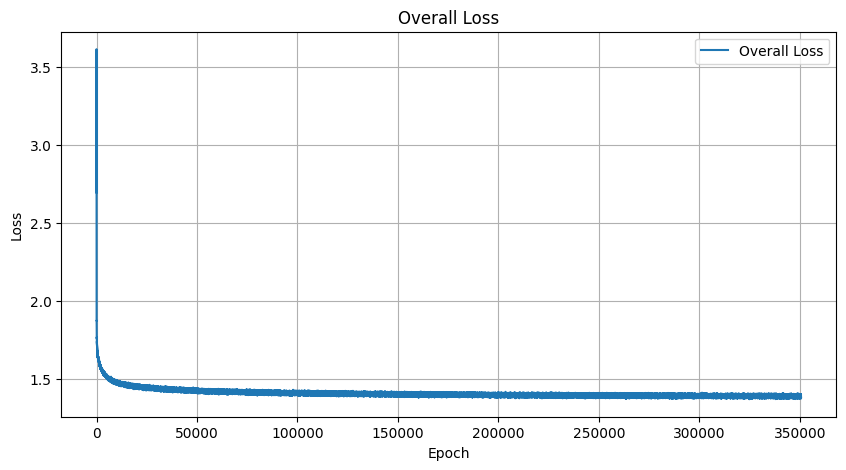

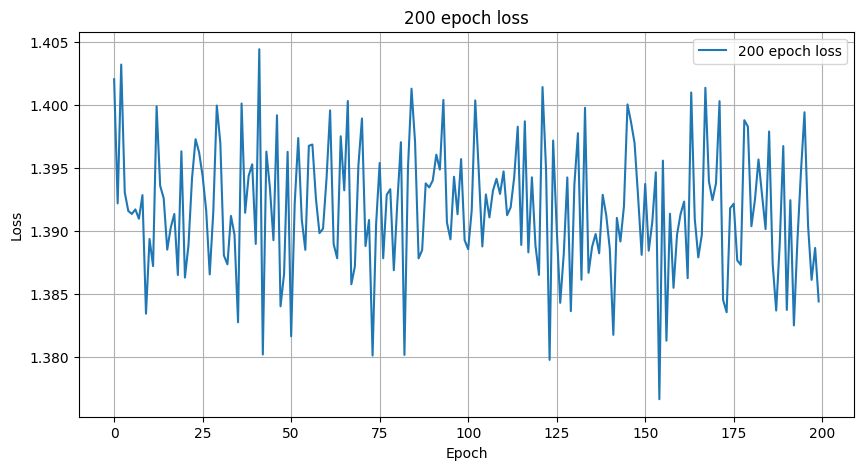

Epoch [1811501], Loss: 1.3984
Epoch [1811502], Loss: 1.3978
Epoch [1811503], Loss: 1.3878
Epoch [1811504], Loss: 1.3904
Epoch [1811505], Loss: 1.3841
Epoch [1811506], Loss: 1.3968
Epoch [1811507], Loss: 1.3933
Epoch [1811508], Loss: 1.3936
Epoch [1811509], Loss: 1.3998
Epoch [1811510], Loss: 1.3930
Epoch [1811511], Loss: 1.3940
Epoch [1811512], Loss: 1.3906
Epoch [1811513], Loss: 1.3938
Epoch [1811514], Loss: 1.3834
Epoch [1811515], Loss: 1.3853
Epoch [1811516], Loss: 1.3942
Epoch [1811517], Loss: 1.3874
Epoch [1811518], Loss: 1.3887
Epoch [1811519], Loss: 1.3828
Epoch [1811520], Loss: 1.3876
Epoch [1811521], Loss: 1.3965
Epoch [1811522], Loss: 1.3973
Epoch [1811523], Loss: 1.3905
Epoch [1811524], Loss: 1.3902
Epoch [1811525], Loss: 1.4005
Epoch [1811526], Loss: 1.3883
Epoch [1811527], Loss: 1.3949
Epoch [1811528], Loss: 1.3967
Epoch [1811529], Loss: 1.3958
Epoch [1811530], Loss: 1.3893
Epoch [1811531], Loss: 1.3849
Epoch [1811532], Loss: 1.3855
Epoch [1811533], Loss: 1.3901
Epoch [181

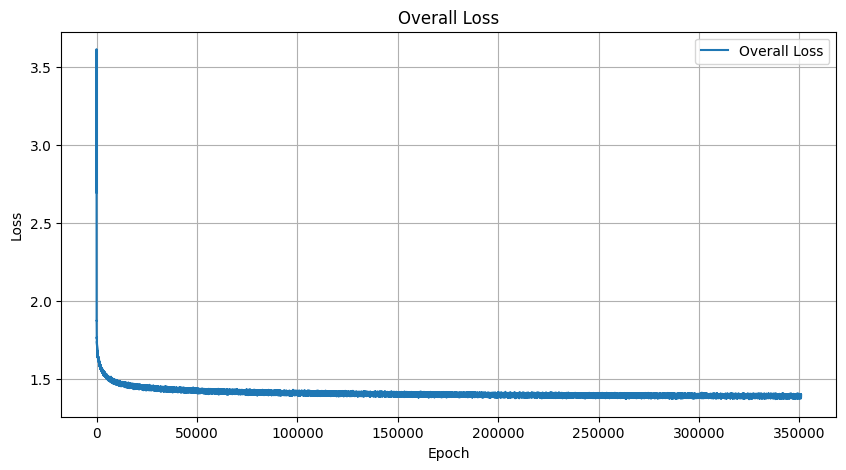

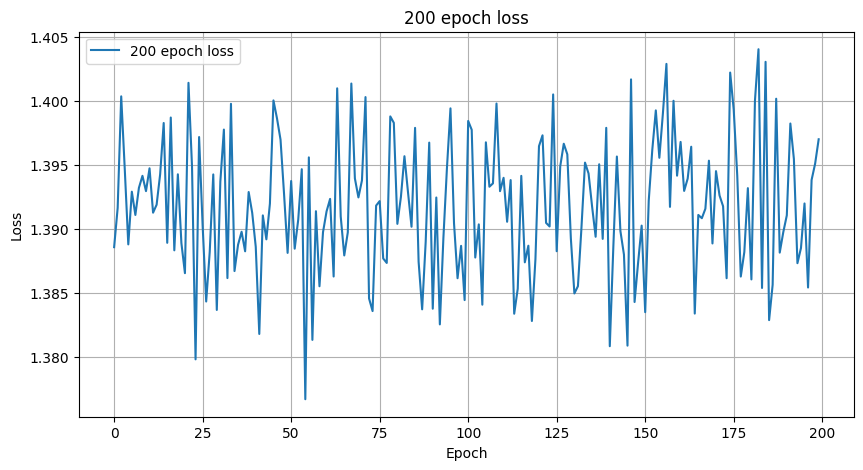

Epoch [1811601], Loss: 1.3977
Epoch [1811602], Loss: 1.3952
Epoch [1811603], Loss: 1.3869
Epoch [1811604], Loss: 1.3950
Epoch [1811605], Loss: 1.3816
Epoch [1811606], Loss: 1.3916
Epoch [1811607], Loss: 1.3884
Epoch [1811608], Loss: 1.3870
Epoch [1811609], Loss: 1.3947
Epoch [1811610], Loss: 1.3936
Epoch [1811611], Loss: 1.3884
Epoch [1811612], Loss: 1.3917
Epoch [1811613], Loss: 1.3909
Epoch [1811614], Loss: 1.3961
Epoch [1811615], Loss: 1.3939
Epoch [1811616], Loss: 1.3918
Epoch [1811617], Loss: 1.3902
Epoch [1811618], Loss: 1.3987
Epoch [1811619], Loss: 1.3900
Epoch [1811620], Loss: 1.3898
Epoch [1811621], Loss: 1.3965
Epoch [1811622], Loss: 1.3891
Epoch [1811623], Loss: 1.3960
Epoch [1811624], Loss: 1.3887
Epoch [1811625], Loss: 1.3889
Epoch [1811626], Loss: 1.3948
Epoch [1811627], Loss: 1.3950
Epoch [1811628], Loss: 1.3911
Epoch [1811629], Loss: 1.3969
Epoch [1811630], Loss: 1.3957
Epoch [1811631], Loss: 1.3907
Epoch [1811632], Loss: 1.3989
Epoch [1811633], Loss: 1.3943
Epoch [181

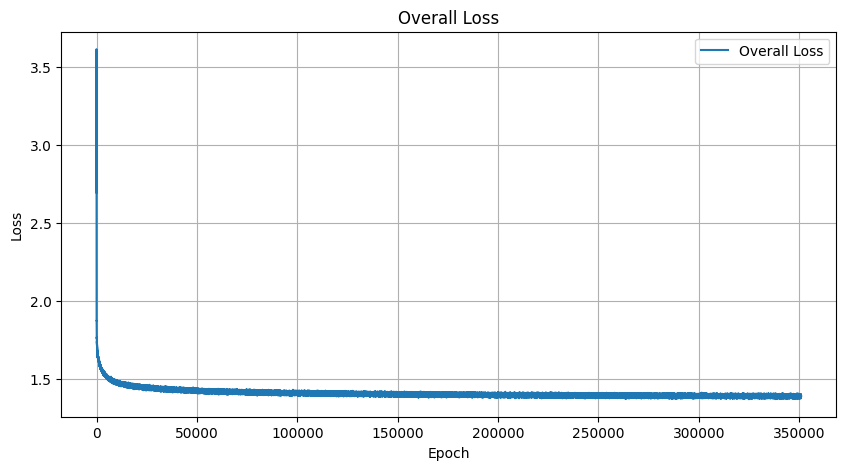

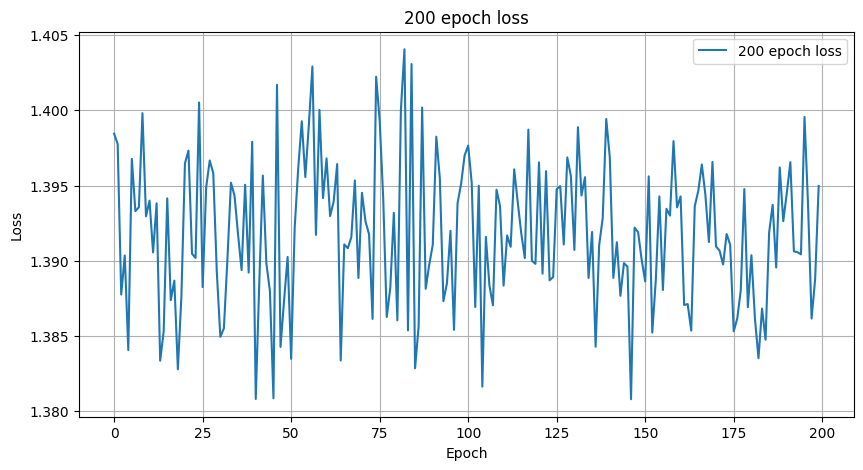

Epoch [1811701], Loss: 1.3963
Epoch [1811702], Loss: 1.3886
Epoch [1811703], Loss: 1.3918
Epoch [1811704], Loss: 1.3904
Epoch [1811705], Loss: 1.3952
Epoch [1811706], Loss: 1.3967
Epoch [1811707], Loss: 1.3950
Epoch [1811708], Loss: 1.3938
Epoch [1811709], Loss: 1.3859
Epoch [1811710], Loss: 1.3950
Epoch [1811711], Loss: 1.3895
Epoch [1811712], Loss: 1.3882
Epoch [1811713], Loss: 1.3923
Epoch [1811714], Loss: 1.3922
Epoch [1811715], Loss: 1.3954
Epoch [1811716], Loss: 1.3917
Epoch [1811717], Loss: 1.3990
Epoch [1811718], Loss: 1.3979
Epoch [1811719], Loss: 1.3887
Epoch [1811720], Loss: 1.3922
Epoch [1811721], Loss: 1.3919
Epoch [1811722], Loss: 1.3866
Epoch [1811723], Loss: 1.3792
Epoch [1811724], Loss: 1.3898
Epoch [1811725], Loss: 1.3994
Epoch [1811726], Loss: 1.3845
Epoch [1811727], Loss: 1.3885
Epoch [1811728], Loss: 1.3825
Epoch [1811729], Loss: 1.3939
Epoch [1811730], Loss: 1.3933
Epoch [1811731], Loss: 1.3876
Epoch [1811732], Loss: 1.3887
Epoch [1811733], Loss: 1.3938
Epoch [181

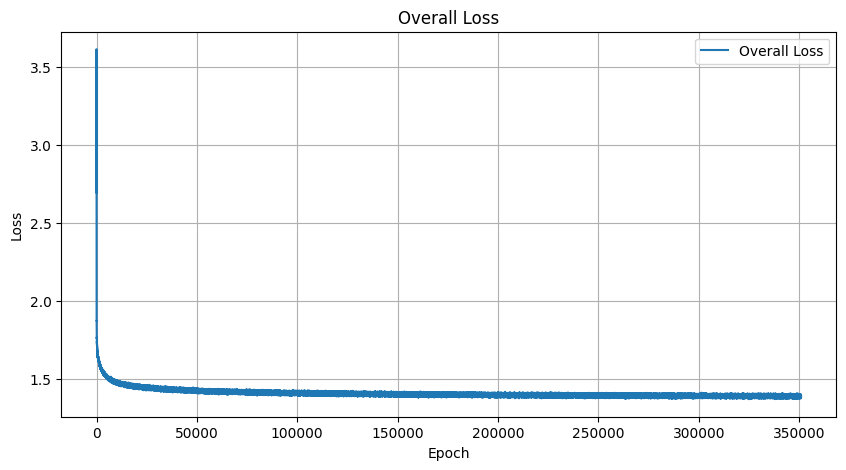

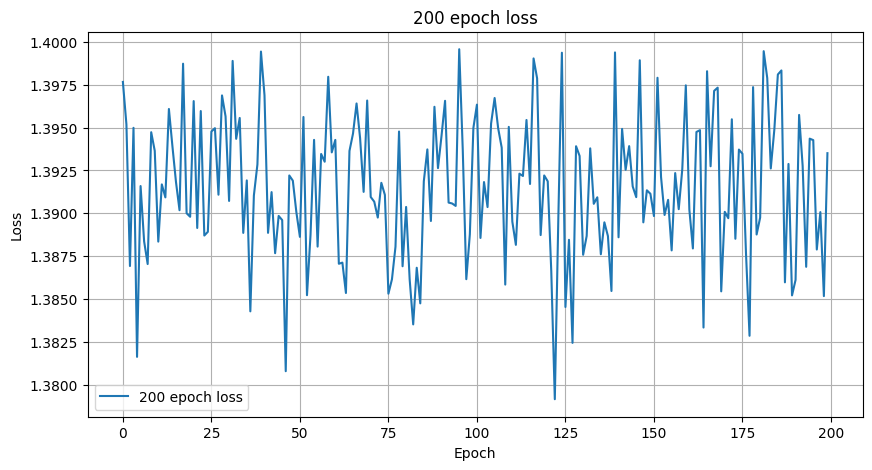

Epoch [1811801], Loss: 1.3869
Epoch [1811802], Loss: 1.3944
Epoch [1811803], Loss: 1.3952
Epoch [1811804], Loss: 1.3989
Epoch [1811805], Loss: 1.3898
Epoch [1811806], Loss: 1.3912
Epoch [1811807], Loss: 1.3866
Epoch [1811808], Loss: 1.3955
Epoch [1811809], Loss: 1.3825
Epoch [1811810], Loss: 1.3872
Epoch [1811811], Loss: 1.3920
Epoch [1811812], Loss: 1.3892
Epoch [1811813], Loss: 1.3859
Epoch [1811814], Loss: 1.3886
Epoch [1811815], Loss: 1.3998
Epoch [1811816], Loss: 1.3921
Epoch [1811817], Loss: 1.3930
Epoch [1811818], Loss: 1.3809
Epoch [1811819], Loss: 1.3788
Epoch [1811820], Loss: 1.3842
Epoch [1811821], Loss: 1.3923
Epoch [1811822], Loss: 1.3897
Epoch [1811823], Loss: 1.3882
Epoch [1811824], Loss: 1.3866
Epoch [1811825], Loss: 1.3950
Epoch [1811826], Loss: 1.3968
Epoch [1811827], Loss: 1.3980
Epoch [1811828], Loss: 1.3877
Epoch [1811829], Loss: 1.3843
Epoch [1811830], Loss: 1.3954
Epoch [1811831], Loss: 1.3834
Epoch [1811832], Loss: 1.3879
Epoch [1811833], Loss: 1.3898
Epoch [181

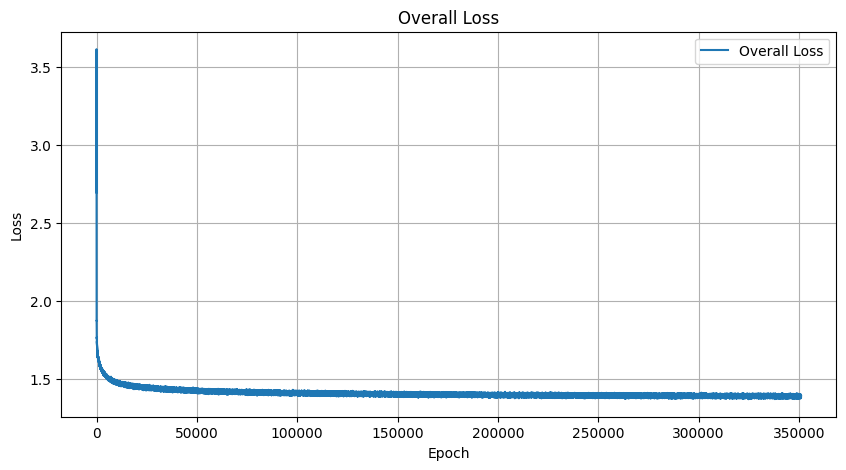

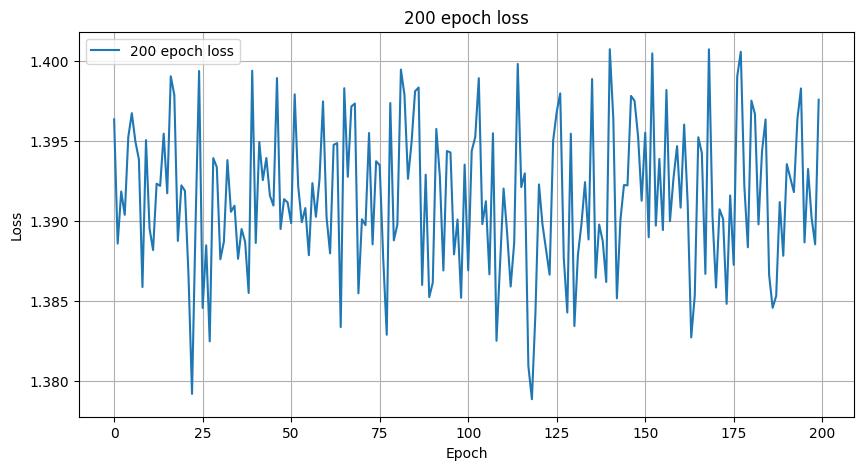

Epoch [1811901], Loss: 1.4001
Epoch [1811902], Loss: 1.3896
Epoch [1811903], Loss: 1.3930
Epoch [1811904], Loss: 1.3961
Epoch [1811905], Loss: 1.3846
Epoch [1811906], Loss: 1.3934
Epoch [1811907], Loss: 1.3919
Epoch [1811908], Loss: 1.3865
Epoch [1811909], Loss: 1.3846
Epoch [1811910], Loss: 1.3865
Epoch [1811911], Loss: 1.3911
Epoch [1811912], Loss: 1.3931
Epoch [1811913], Loss: 1.3963
Epoch [1811914], Loss: 1.3990
Epoch [1811915], Loss: 1.3987
Epoch [1811916], Loss: 1.3911
Epoch [1811917], Loss: 1.3874
Epoch [1811918], Loss: 1.3938
Epoch [1811919], Loss: 1.3836
Epoch [1811920], Loss: 1.3946
Epoch [1811921], Loss: 1.3995
Epoch [1811922], Loss: 1.3840
Epoch [1811923], Loss: 1.3835
Epoch [1811924], Loss: 1.3929
Epoch [1811925], Loss: 1.3903
Epoch [1811926], Loss: 1.3929
Epoch [1811927], Loss: 1.3934
Epoch [1811928], Loss: 1.3885
Epoch [1811929], Loss: 1.3864
Epoch [1811930], Loss: 1.3920
Epoch [1811931], Loss: 1.3870
Epoch [1811932], Loss: 1.3960
Epoch [1811933], Loss: 1.3911
Epoch [181

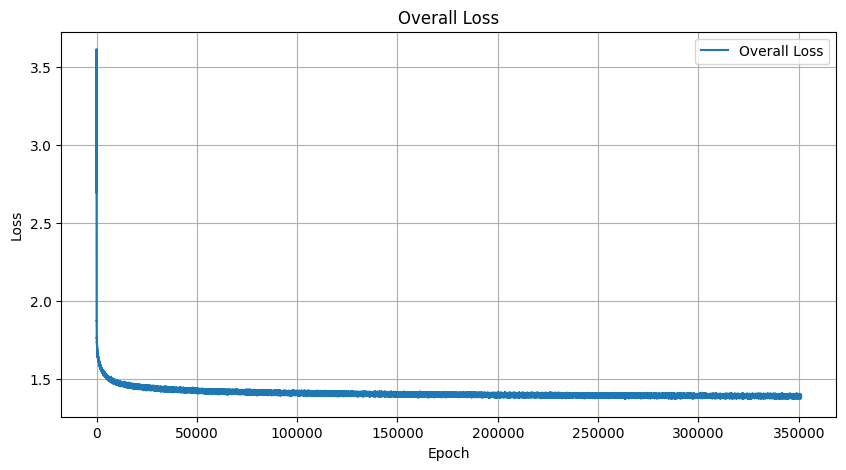

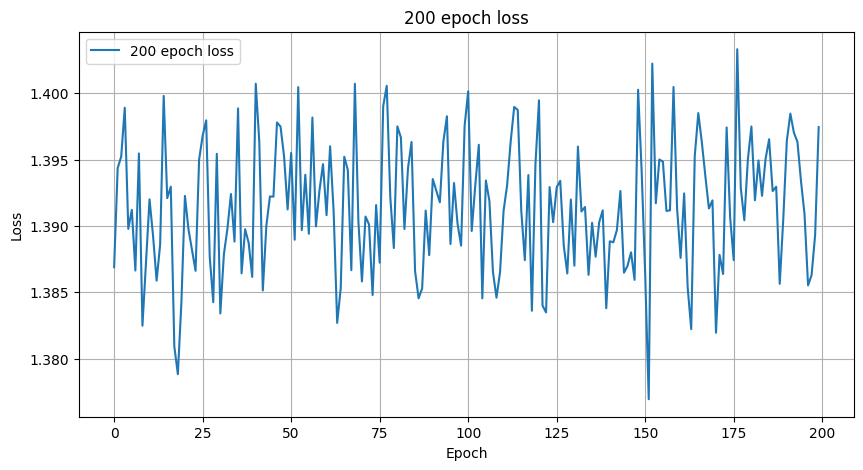

Epoch [1812001], Loss: 1.3863
Epoch [1812002], Loss: 1.3881
Epoch [1812003], Loss: 1.3830
Epoch [1812004], Loss: 1.4002
Epoch [1812005], Loss: 1.3862
Epoch [1812006], Loss: 1.3922
Epoch [1812007], Loss: 1.3900
Epoch [1812008], Loss: 1.4000
Epoch [1812009], Loss: 1.3939
Epoch [1812010], Loss: 1.3890
Epoch [1812011], Loss: 1.3943
Epoch [1812012], Loss: 1.3877
Epoch [1812013], Loss: 1.3928
Epoch [1812014], Loss: 1.4008
Epoch [1812015], Loss: 1.3938
Epoch [1812016], Loss: 1.3907
Epoch [1812017], Loss: 1.3993
Epoch [1812018], Loss: 1.3975
Epoch [1812019], Loss: 1.3883
Epoch [1812020], Loss: 1.3932
Epoch [1812021], Loss: 1.3894
Epoch [1812022], Loss: 1.3989
Epoch [1812023], Loss: 1.3926
Epoch [1812024], Loss: 1.3849
Epoch [1812025], Loss: 1.3855
Epoch [1812026], Loss: 1.3871
Epoch [1812027], Loss: 1.3942
Epoch [1812028], Loss: 1.3988
Epoch [1812029], Loss: 1.3930
Epoch [1812030], Loss: 1.3895
Epoch [1812031], Loss: 1.3924
Epoch [1812032], Loss: 1.3908
Epoch [1812033], Loss: 1.3929
Epoch [181

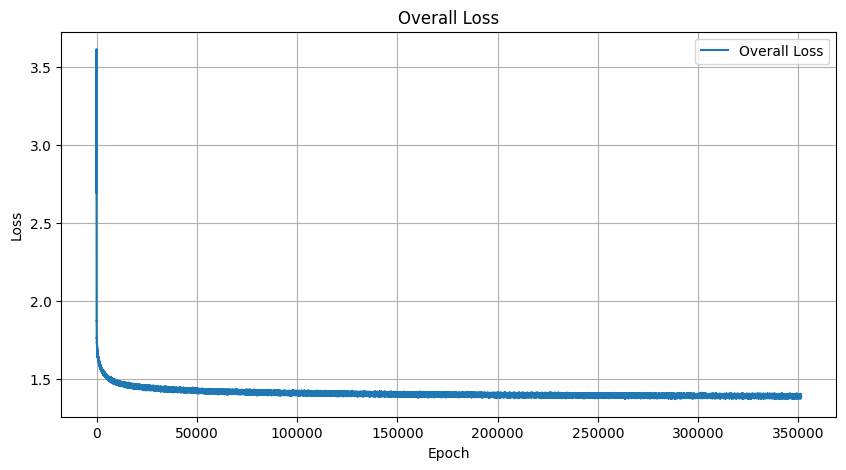

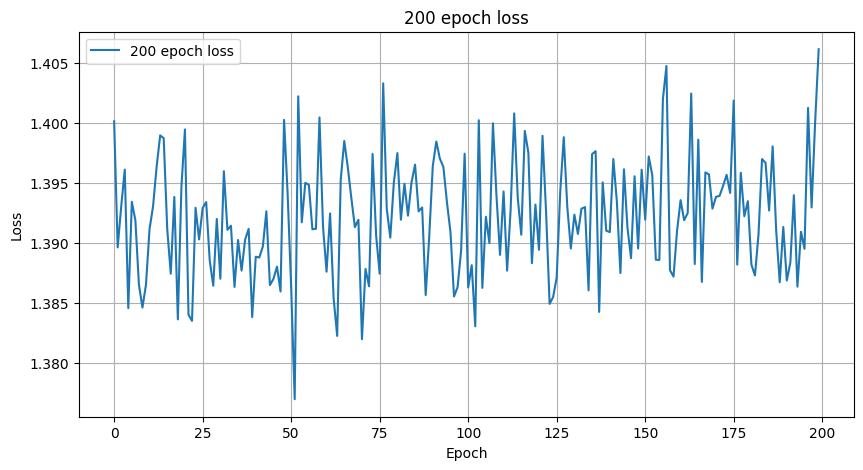

Epoch [1812101], Loss: 1.3965
Epoch [1812102], Loss: 1.3895
Epoch [1812103], Loss: 1.3900
Epoch [1812104], Loss: 1.3867
Epoch [1812105], Loss: 1.3912
Epoch [1812106], Loss: 1.3896
Epoch [1812107], Loss: 1.3887
Epoch [1812108], Loss: 1.3974
Epoch [1812109], Loss: 1.3948
Epoch [1812110], Loss: 1.3895
Epoch [1812111], Loss: 1.3932
Epoch [1812112], Loss: 1.3878
Epoch [1812113], Loss: 1.3917
Epoch [1812114], Loss: 1.3925
Epoch [1812115], Loss: 1.3986
Epoch [1812116], Loss: 1.3874
Epoch [1812117], Loss: 1.3917
Epoch [1812118], Loss: 1.3932
Epoch [1812119], Loss: 1.3946
Epoch [1812120], Loss: 1.3921
Epoch [1812121], Loss: 1.3941
Epoch [1812122], Loss: 1.3928
Epoch [1812123], Loss: 1.3932
Epoch [1812124], Loss: 1.3895
Epoch [1812125], Loss: 1.3975
Epoch [1812126], Loss: 1.3875
Epoch [1812127], Loss: 1.3925
Epoch [1812128], Loss: 1.3903
Epoch [1812129], Loss: 1.3935
Epoch [1812130], Loss: 1.3886
Epoch [1812131], Loss: 1.3959
Epoch [1812132], Loss: 1.3865
Epoch [1812133], Loss: 1.4026
Epoch [181

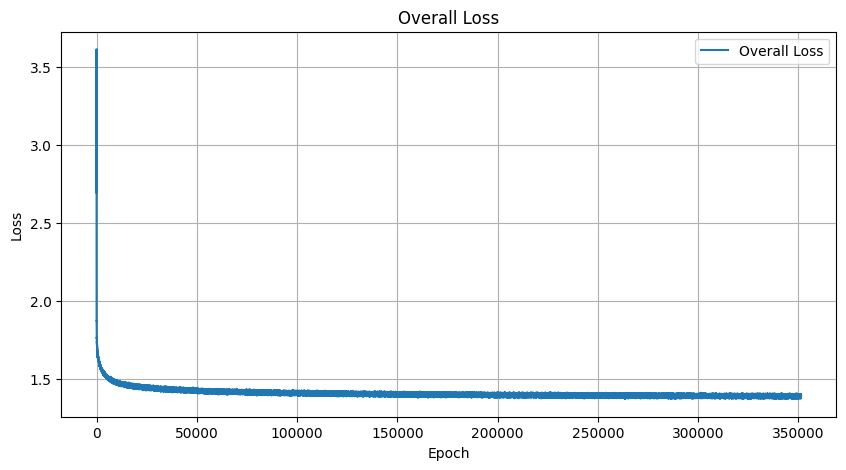

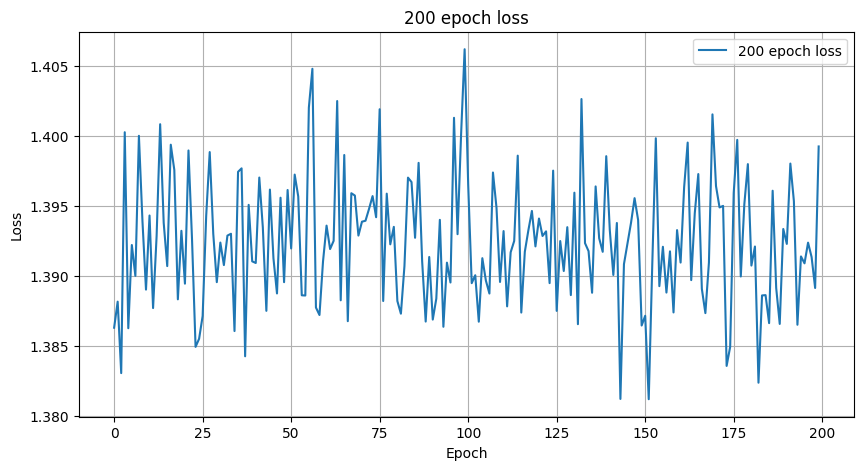

Epoch [1812201], Loss: 1.3924
Epoch [1812202], Loss: 1.3884
Epoch [1812203], Loss: 1.3929
Epoch [1812204], Loss: 1.3971
Epoch [1812205], Loss: 1.3910
Epoch [1812206], Loss: 1.3833
Epoch [1812207], Loss: 1.3849
Epoch [1812208], Loss: 1.3897
Epoch [1812209], Loss: 1.3940
Epoch [1812210], Loss: 1.3949
Epoch [1812211], Loss: 1.3939
Epoch [1812212], Loss: 1.3818
Epoch [1812213], Loss: 1.3881
Epoch [1812214], Loss: 1.3919
Epoch [1812215], Loss: 1.3858
Epoch [1812216], Loss: 1.3962
Epoch [1812217], Loss: 1.3885
Epoch [1812218], Loss: 1.3834
Epoch [1812219], Loss: 1.3968
Epoch [1812220], Loss: 1.3933
Epoch [1812221], Loss: 1.3937
Epoch [1812222], Loss: 1.4029
Epoch [1812223], Loss: 1.3921
Epoch [1812224], Loss: 1.3857
Epoch [1812225], Loss: 1.3876
Epoch [1812226], Loss: 1.3923
Epoch [1812227], Loss: 1.4027
Epoch [1812228], Loss: 1.3970
Epoch [1812229], Loss: 1.3862
Epoch [1812230], Loss: 1.3942
Epoch [1812231], Loss: 1.3975
Epoch [1812232], Loss: 1.3895
Epoch [1812233], Loss: 1.3899
Epoch [181

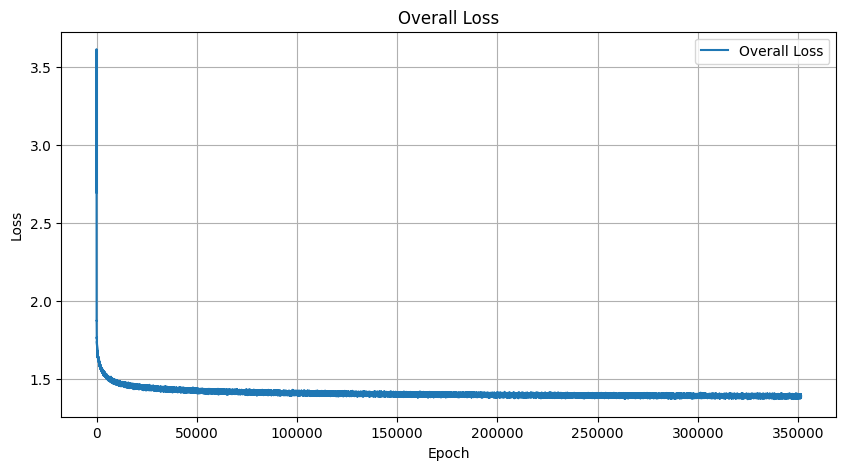

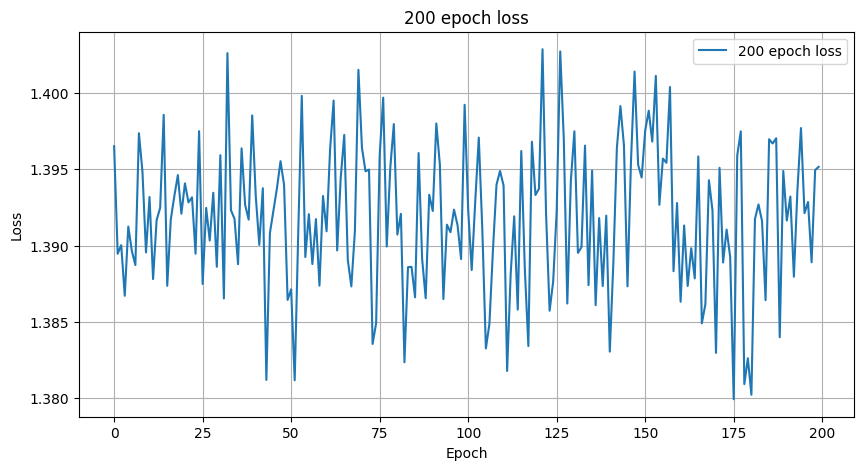

Epoch [1812301], Loss: 1.3907
Epoch [1812302], Loss: 1.3906
Epoch [1812303], Loss: 1.3938
Epoch [1812304], Loss: 1.3845
Epoch [1812305], Loss: 1.3902
Epoch [1812306], Loss: 1.3895
Epoch [1812307], Loss: 1.3958
Epoch [1812308], Loss: 1.3865
Epoch [1812309], Loss: 1.3891
Epoch [1812310], Loss: 1.3944
Epoch [1812311], Loss: 1.3908
Epoch [1812312], Loss: 1.3890
Epoch [1812313], Loss: 1.3884
Epoch [1812314], Loss: 1.3923
Epoch [1812315], Loss: 1.3906
Epoch [1812316], Loss: 1.3887
Epoch [1812317], Loss: 1.3776
Epoch [1812318], Loss: 1.3881
Epoch [1812319], Loss: 1.3873
Epoch [1812320], Loss: 1.3872
Epoch [1812321], Loss: 1.3981
Epoch [1812322], Loss: 1.3931
Epoch [1812323], Loss: 1.3923
Epoch [1812324], Loss: 1.3902
Epoch [1812325], Loss: 1.3806
Epoch [1812326], Loss: 1.3966
Epoch [1812327], Loss: 1.3819
Epoch [1812328], Loss: 1.3857
Epoch [1812329], Loss: 1.3915
Epoch [1812330], Loss: 1.3908
Epoch [1812331], Loss: 1.3928
Epoch [1812332], Loss: 1.3907
Epoch [1812333], Loss: 1.3897
Epoch [181

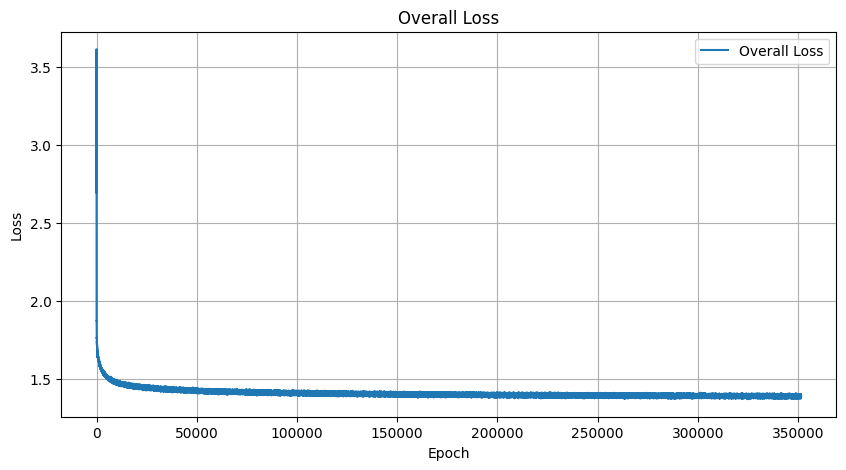

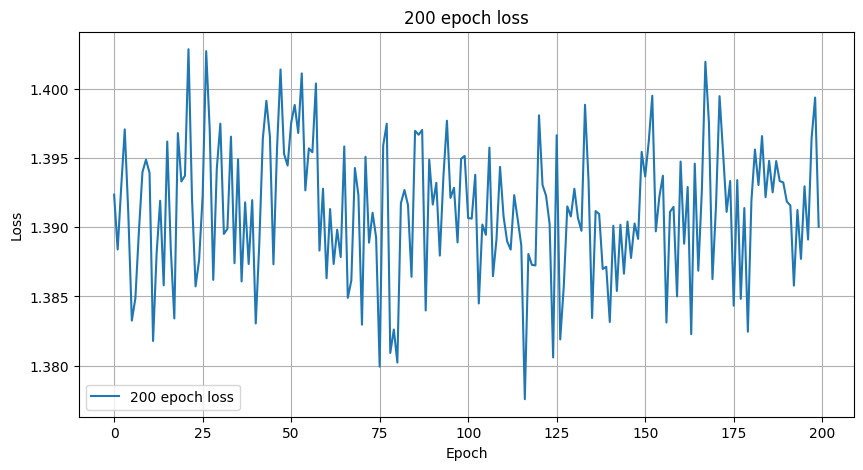

Epoch [1812401], Loss: 1.3855
Epoch [1812402], Loss: 1.3887
Epoch [1812403], Loss: 1.3927
Epoch [1812404], Loss: 1.3854
Epoch [1812405], Loss: 1.3918
Epoch [1812406], Loss: 1.3951
Epoch [1812407], Loss: 1.3990
Epoch [1812408], Loss: 1.3911
Epoch [1812409], Loss: 1.3948
Epoch [1812410], Loss: 1.3848
Epoch [1812411], Loss: 1.3862
Epoch [1812412], Loss: 1.3888
Epoch [1812413], Loss: 1.3925
Epoch [1812414], Loss: 1.3903
Epoch [1812415], Loss: 1.3912
Epoch [1812416], Loss: 1.3869
Epoch [1812417], Loss: 1.3949
Epoch [1812418], Loss: 1.3950
Epoch [1812419], Loss: 1.3898
Epoch [1812420], Loss: 1.3976
Epoch [1812421], Loss: 1.3912
Epoch [1812422], Loss: 1.3903
Epoch [1812423], Loss: 1.3915
Epoch [1812424], Loss: 1.3935
Epoch [1812425], Loss: 1.3879
Epoch [1812426], Loss: 1.3883
Epoch [1812427], Loss: 1.3935
Epoch [1812428], Loss: 1.3853
Epoch [1812429], Loss: 1.4048
Epoch [1812430], Loss: 1.3972
Epoch [1812431], Loss: 1.3947
Epoch [1812432], Loss: 1.3892
Epoch [1812433], Loss: 1.3979
Epoch [181

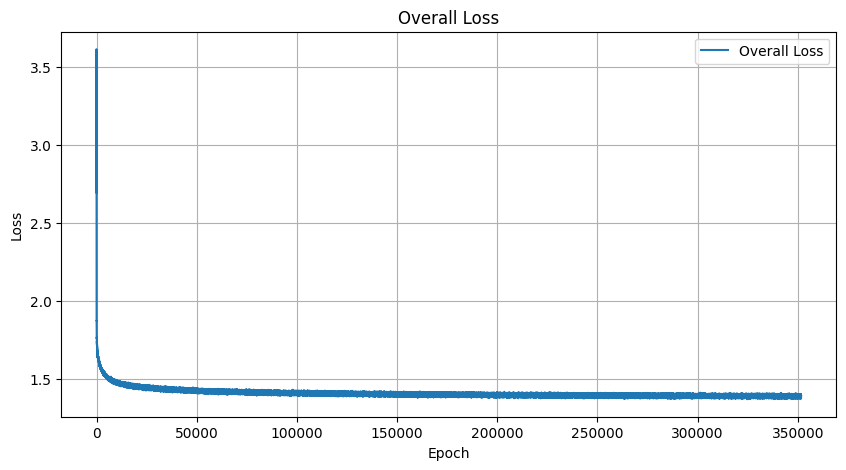

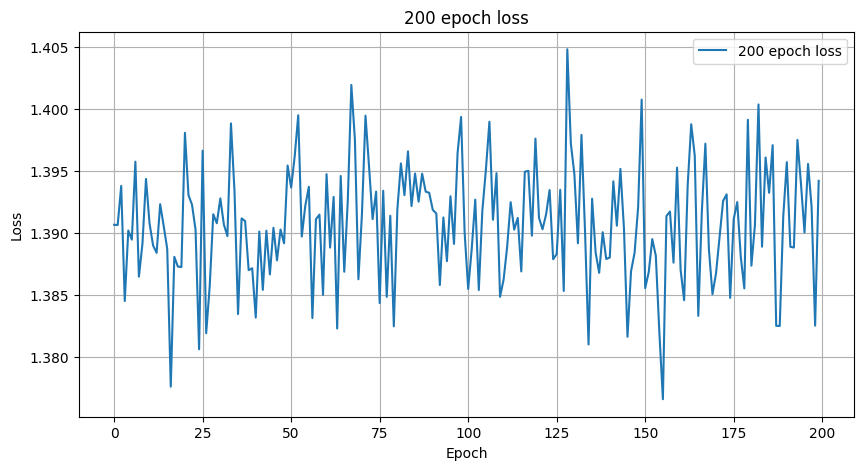

Epoch [1812501], Loss: 1.3904
Epoch [1812502], Loss: 1.3848
Epoch [1812503], Loss: 1.3879
Epoch [1812504], Loss: 1.4003
Epoch [1812505], Loss: 1.3875
Epoch [1812506], Loss: 1.3944
Epoch [1812507], Loss: 1.3870
Epoch [1812508], Loss: 1.3865
Epoch [1812509], Loss: 1.4046
Epoch [1812510], Loss: 1.3884
Epoch [1812511], Loss: 1.3984
Epoch [1812512], Loss: 1.3827
Epoch [1812513], Loss: 1.3950
Epoch [1812514], Loss: 1.3983
Epoch [1812515], Loss: 1.3892
Epoch [1812516], Loss: 1.3921
Epoch [1812517], Loss: 1.4023
Epoch [1812518], Loss: 1.3876
Epoch [1812519], Loss: 1.3885
Epoch [1812520], Loss: 1.3896
Epoch [1812521], Loss: 1.3960
Epoch [1812522], Loss: 1.3894
Epoch [1812523], Loss: 1.3885
Epoch [1812524], Loss: 1.3988
Epoch [1812525], Loss: 1.3906
Epoch [1812526], Loss: 1.3914
Epoch [1812527], Loss: 1.3835
Epoch [1812528], Loss: 1.3915
Epoch [1812529], Loss: 1.3881
Epoch [1812530], Loss: 1.3907
Epoch [1812531], Loss: 1.3932
Epoch [1812532], Loss: 1.3909
Epoch [1812533], Loss: 1.3896
Epoch [181

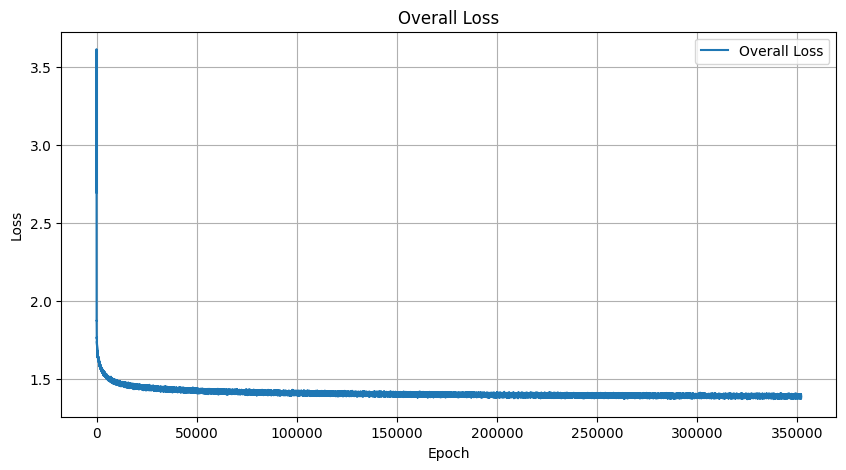

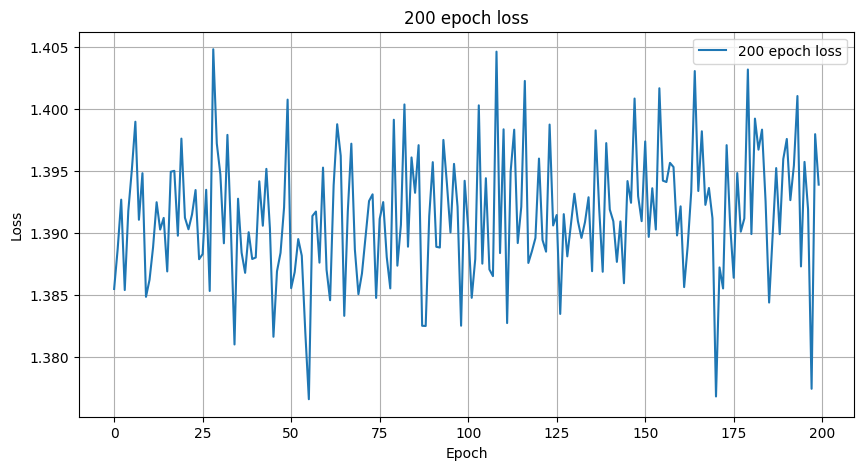

Epoch [1812601], Loss: 1.3971
Epoch [1812602], Loss: 1.3880
Epoch [1812603], Loss: 1.3948
Epoch [1812604], Loss: 1.3906
Epoch [1812605], Loss: 1.3968
Epoch [1812606], Loss: 1.3914
Epoch [1812607], Loss: 1.3913
Epoch [1812608], Loss: 1.3990
Epoch [1812609], Loss: 1.3898
Epoch [1812610], Loss: 1.4008
Epoch [1812611], Loss: 1.3858
Epoch [1812612], Loss: 1.3950
Epoch [1812613], Loss: 1.3906
Epoch [1812614], Loss: 1.3923
Epoch [1812615], Loss: 1.3904
Epoch [1812616], Loss: 1.3958
Epoch [1812617], Loss: 1.3930
Epoch [1812618], Loss: 1.3882
Epoch [1812619], Loss: 1.3904
Epoch [1812620], Loss: 1.3935
Epoch [1812621], Loss: 1.3939
Epoch [1812622], Loss: 1.4011
Epoch [1812623], Loss: 1.3910
Epoch [1812624], Loss: 1.3830
Epoch [1812625], Loss: 1.3895
Epoch [1812626], Loss: 1.3921
Epoch [1812627], Loss: 1.3877
Epoch [1812628], Loss: 1.3949
Epoch [1812629], Loss: 1.3961
Epoch [1812630], Loss: 1.3955
Epoch [1812631], Loss: 1.3943
Epoch [1812632], Loss: 1.4005
Epoch [1812633], Loss: 1.3921
Epoch [181

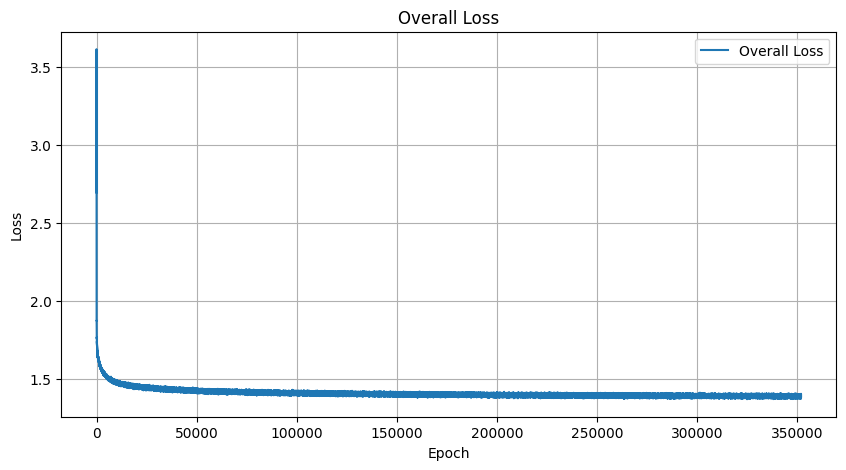

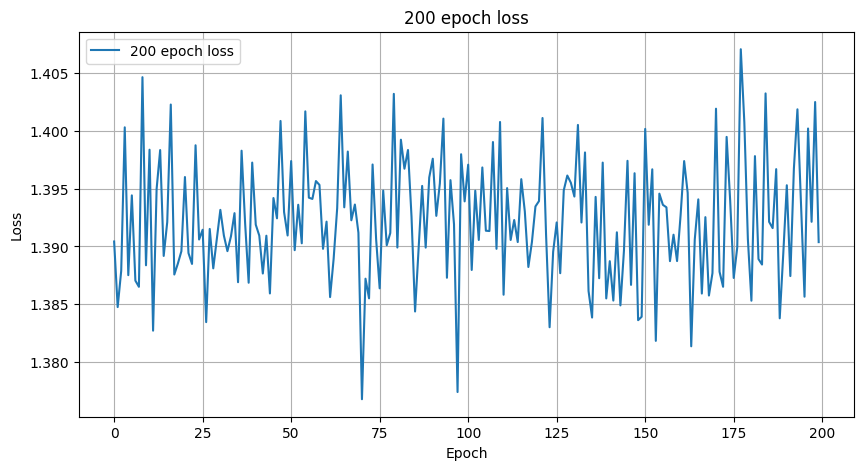

Epoch [1812701], Loss: 1.3882
Epoch [1812702], Loss: 1.3972
Epoch [1812703], Loss: 1.3897
Epoch [1812704], Loss: 1.3834
Epoch [1812705], Loss: 1.3956
Epoch [1812706], Loss: 1.3931
Epoch [1812707], Loss: 1.3858
Epoch [1812708], Loss: 1.3939
Epoch [1812709], Loss: 1.3922
Epoch [1812710], Loss: 1.3818
Epoch [1812711], Loss: 1.3903
Epoch [1812712], Loss: 1.3950
Epoch [1812713], Loss: 1.3894
Epoch [1812714], Loss: 1.3869
Epoch [1812715], Loss: 1.3896
Epoch [1812716], Loss: 1.3809
Epoch [1812717], Loss: 1.3968
Epoch [1812718], Loss: 1.3937
Epoch [1812719], Loss: 1.3874
Epoch [1812720], Loss: 1.3915
Epoch [1812721], Loss: 1.3876
Epoch [1812722], Loss: 1.3837
Epoch [1812723], Loss: 1.3845
Epoch [1812724], Loss: 1.3895
Epoch [1812725], Loss: 1.3895
Epoch [1812726], Loss: 1.3901
Epoch [1812727], Loss: 1.3888
Epoch [1812728], Loss: 1.3935
Epoch [1812729], Loss: 1.3965
Epoch [1812730], Loss: 1.3924
Epoch [1812731], Loss: 1.3978
Epoch [1812732], Loss: 1.4002
Epoch [1812733], Loss: 1.3923
Epoch [181

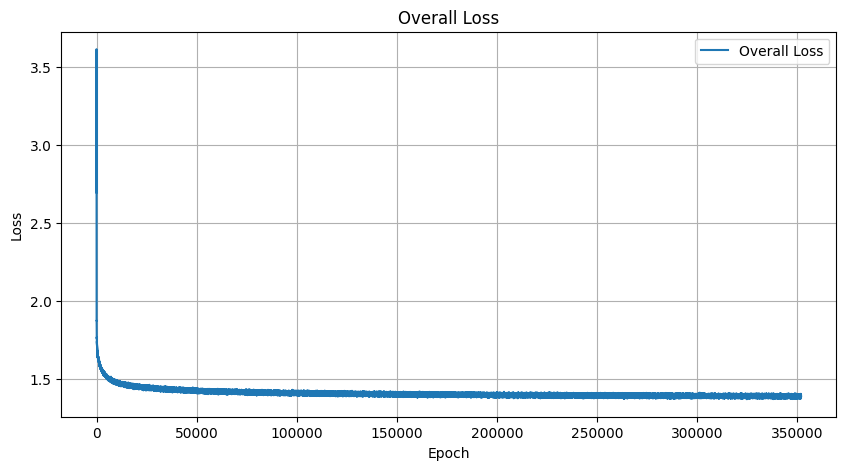

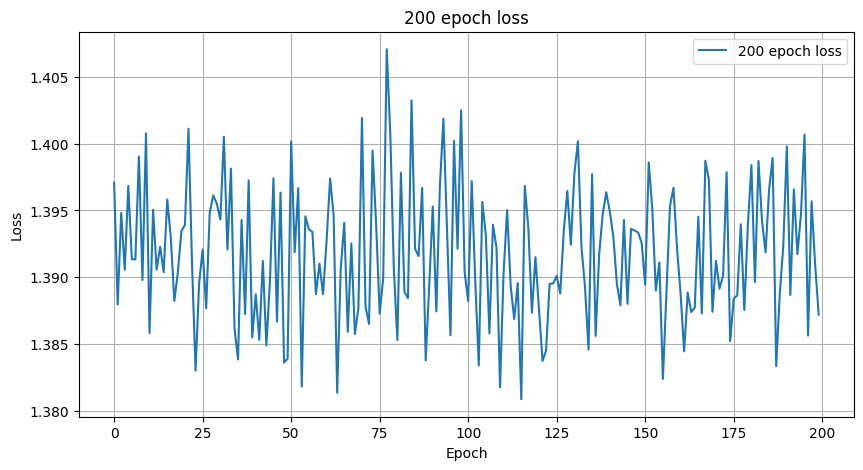

Epoch [1812801], Loss: 1.3891
Epoch [1812802], Loss: 1.3992
Epoch [1812803], Loss: 1.3884
Epoch [1812804], Loss: 1.3866
Epoch [1812805], Loss: 1.3946
Epoch [1812806], Loss: 1.3944
Epoch [1812807], Loss: 1.3846
Epoch [1812808], Loss: 1.3887
Epoch [1812809], Loss: 1.3954
Epoch [1812810], Loss: 1.3901
Epoch [1812811], Loss: 1.3919
Epoch [1812812], Loss: 1.3955
Epoch [1812813], Loss: 1.3923
Epoch [1812814], Loss: 1.3907
Epoch [1812815], Loss: 1.3936
Epoch [1812816], Loss: 1.3919
Epoch [1812817], Loss: 1.3903
Epoch [1812818], Loss: 1.3837
Epoch [1812819], Loss: 1.3845
Epoch [1812820], Loss: 1.3881
Epoch [1812821], Loss: 1.3906
Epoch [1812822], Loss: 1.3932
Epoch [1812823], Loss: 1.3915
Epoch [1812824], Loss: 1.3979
Epoch [1812825], Loss: 1.3878
Epoch [1812826], Loss: 1.3877
Epoch [1812827], Loss: 1.3897
Epoch [1812828], Loss: 1.3849
Epoch [1812829], Loss: 1.3947
Epoch [1812830], Loss: 1.3958
Epoch [1812831], Loss: 1.3917
Epoch [1812832], Loss: 1.3875
Epoch [1812833], Loss: 1.3892
Epoch [181

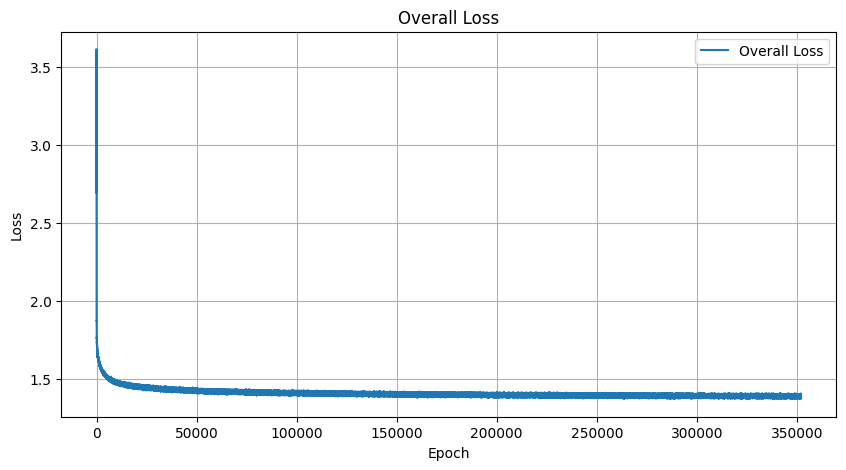

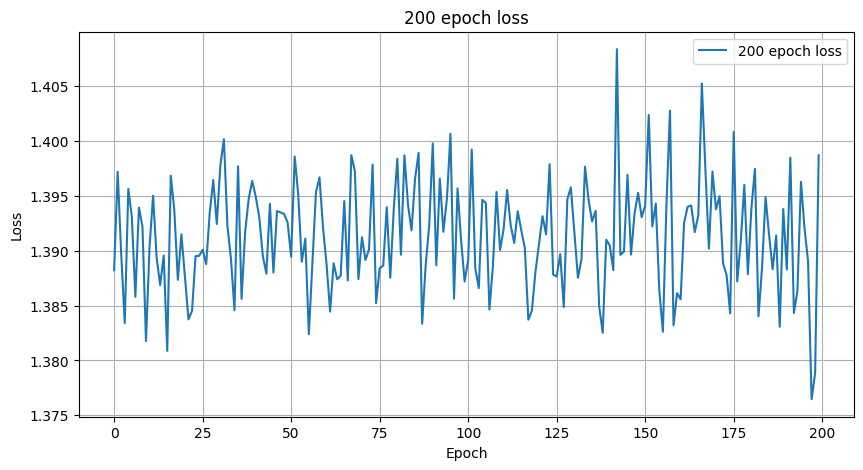

Epoch [1812901], Loss: 1.3868
Epoch [1812902], Loss: 1.3903
Epoch [1812903], Loss: 1.3958
Epoch [1812904], Loss: 1.3884
Epoch [1812905], Loss: 1.3822
Epoch [1812906], Loss: 1.3908
Epoch [1812907], Loss: 1.4031
Epoch [1812908], Loss: 1.3881
Epoch [1812909], Loss: 1.3961
Epoch [1812910], Loss: 1.3857
Epoch [1812911], Loss: 1.4005
Epoch [1812912], Loss: 1.3919
Epoch [1812913], Loss: 1.3906
Epoch [1812914], Loss: 1.3873
Epoch [1812915], Loss: 1.3864
Epoch [1812916], Loss: 1.3890
Epoch [1812917], Loss: 1.3988
Epoch [1812918], Loss: 1.3844
Epoch [1812919], Loss: 1.3913
Epoch [1812920], Loss: 1.3925
Epoch [1812921], Loss: 1.3869
Epoch [1812922], Loss: 1.3932
Epoch [1812923], Loss: 1.3880
Epoch [1812924], Loss: 1.3924
Epoch [1812925], Loss: 1.3893
Epoch [1812926], Loss: 1.3864
Epoch [1812927], Loss: 1.4002
Epoch [1812928], Loss: 1.3871
Epoch [1812929], Loss: 1.3920
Epoch [1812930], Loss: 1.3899
Epoch [1812931], Loss: 1.3874
Epoch [1812932], Loss: 1.4016
Epoch [1812933], Loss: 1.3890
Epoch [181

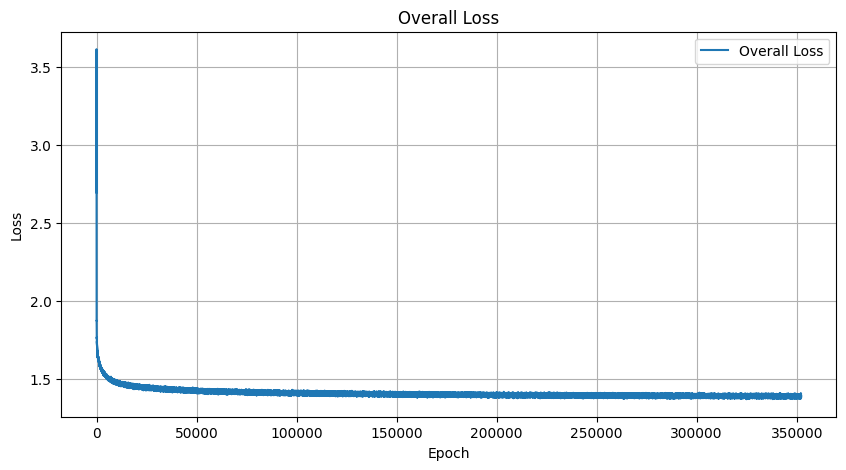

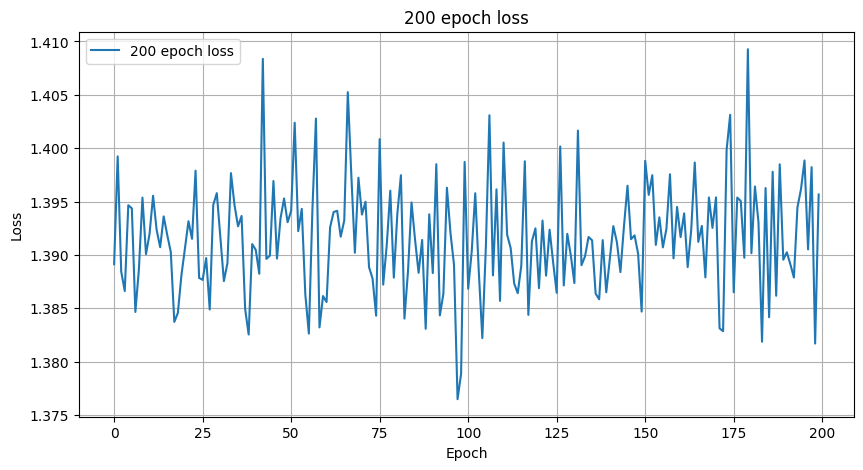

Epoch [1813001], Loss: 1.3877
Epoch [1813002], Loss: 1.3921
Epoch [1813003], Loss: 1.3894
Epoch [1813004], Loss: 1.3872
Epoch [1813005], Loss: 1.3940
Epoch [1813006], Loss: 1.3916
Epoch [1813007], Loss: 1.3961
Epoch [1813008], Loss: 1.3962
Epoch [1813009], Loss: 1.3965
Epoch [1813010], Loss: 1.3914
Epoch [1813011], Loss: 1.3915
Epoch [1813012], Loss: 1.3892
Epoch [1813013], Loss: 1.3896
Epoch [1813014], Loss: 1.3909
Epoch [1813015], Loss: 1.3874
Epoch [1813016], Loss: 1.3924
Epoch [1813017], Loss: 1.3904
Epoch [1813018], Loss: 1.3943
Epoch [1813019], Loss: 1.3894
Epoch [1813020], Loss: 1.3833
Epoch [1813021], Loss: 1.3977
Epoch [1813022], Loss: 1.3993
Epoch [1813023], Loss: 1.4048
Epoch [1813024], Loss: 1.3905
Epoch [1813025], Loss: 1.3914
Epoch [1813026], Loss: 1.3896
Epoch [1813027], Loss: 1.3951
Epoch [1813028], Loss: 1.3951
Epoch [1813029], Loss: 1.3913
Epoch [1813030], Loss: 1.3902
Epoch [1813031], Loss: 1.4029
Epoch [1813032], Loss: 1.3885
Epoch [1813033], Loss: 1.3999
Epoch [181

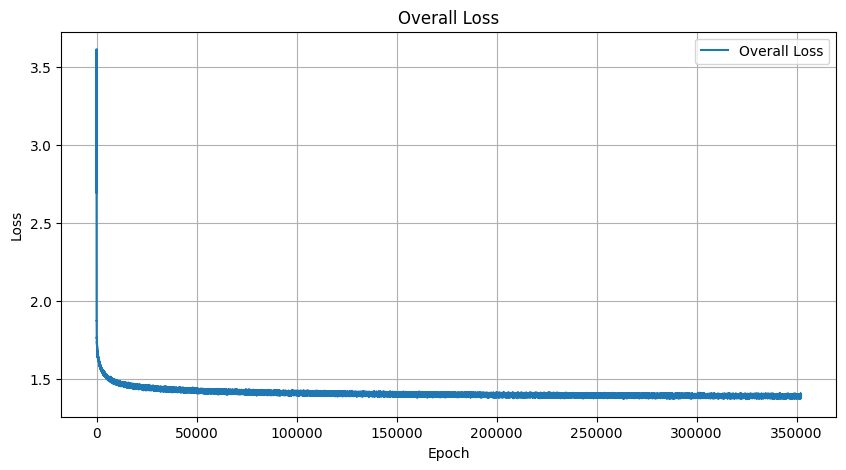

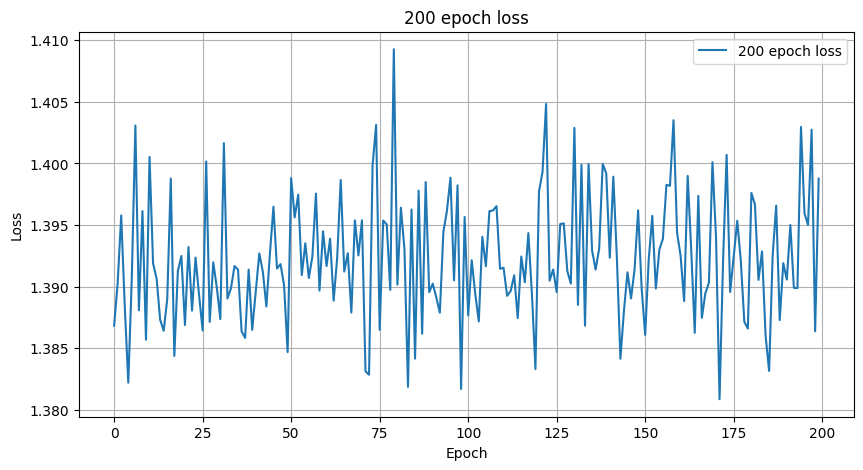

Epoch [1813101], Loss: 1.3855
Epoch [1813102], Loss: 1.4040
Epoch [1813103], Loss: 1.3953
Epoch [1813104], Loss: 1.3847
Epoch [1813105], Loss: 1.3890
Epoch [1813106], Loss: 1.3910
Epoch [1813107], Loss: 1.3997
Epoch [1813108], Loss: 1.3928
Epoch [1813109], Loss: 1.3887
Epoch [1813110], Loss: 1.3850
Epoch [1813111], Loss: 1.3912
Epoch [1813112], Loss: 1.3944
Epoch [1813113], Loss: 1.3955
Epoch [1813114], Loss: 1.3962
Epoch [1813115], Loss: 1.3905
Epoch [1813116], Loss: 1.3956
Epoch [1813117], Loss: 1.3891
Epoch [1813118], Loss: 1.3935
Epoch [1813119], Loss: 1.3930
Epoch [1813120], Loss: 1.3901
Epoch [1813121], Loss: 1.3926
Epoch [1813122], Loss: 1.3902
Epoch [1813123], Loss: 1.3980
Epoch [1813124], Loss: 1.3939
Epoch [1813125], Loss: 1.3974
Epoch [1813126], Loss: 1.3929
Epoch [1813127], Loss: 1.3835
Epoch [1813128], Loss: 1.4008
Epoch [1813129], Loss: 1.3855
Epoch [1813130], Loss: 1.3994
Epoch [1813131], Loss: 1.3958
Epoch [1813132], Loss: 1.3819
Epoch [1813133], Loss: 1.3890
Epoch [181

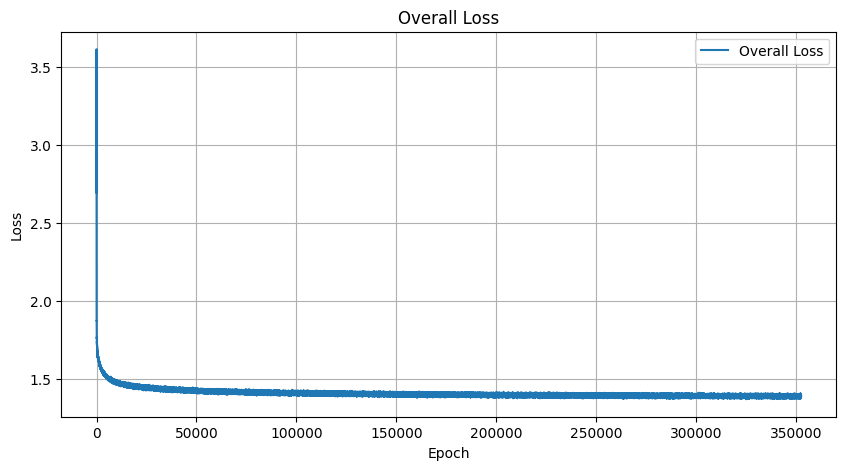

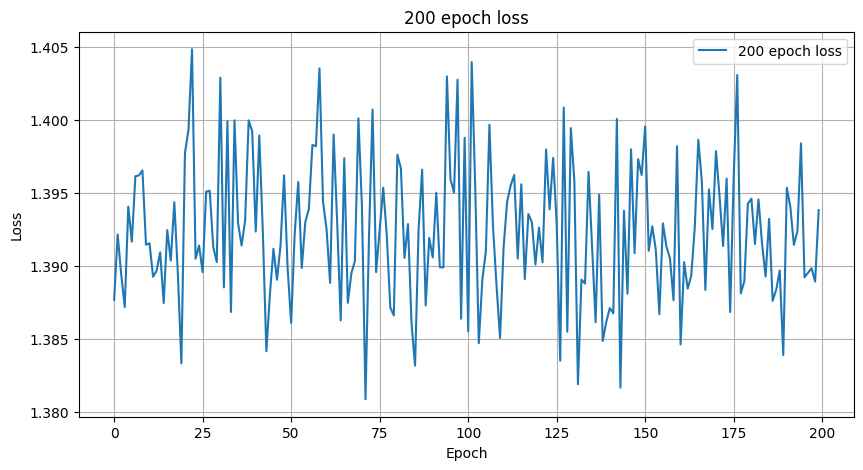

Epoch [1813201], Loss: 1.3858
Epoch [1813202], Loss: 1.3870
Epoch [1813203], Loss: 1.3905
Epoch [1813204], Loss: 1.3923
Epoch [1813205], Loss: 1.3895
Epoch [1813206], Loss: 1.3933
Epoch [1813207], Loss: 1.3943
Epoch [1813208], Loss: 1.3893
Epoch [1813209], Loss: 1.3842
Epoch [1813210], Loss: 1.3926
Epoch [1813211], Loss: 1.3955
Epoch [1813212], Loss: 1.3901
Epoch [1813213], Loss: 1.3958
Epoch [1813214], Loss: 1.3901
Epoch [1813215], Loss: 1.4050
Epoch [1813216], Loss: 1.3945
Epoch [1813217], Loss: 1.3971
Epoch [1813218], Loss: 1.3909
Epoch [1813219], Loss: 1.3927
Epoch [1813220], Loss: 1.3988
Epoch [1813221], Loss: 1.3955
Epoch [1813222], Loss: 1.3850
Epoch [1813223], Loss: 1.3940
Epoch [1813224], Loss: 1.3899
Epoch [1813225], Loss: 1.3861
Epoch [1813226], Loss: 1.4032
Epoch [1813227], Loss: 1.3856
Epoch [1813228], Loss: 1.3904
Epoch [1813229], Loss: 1.3900
Epoch [1813230], Loss: 1.3916
Epoch [1813231], Loss: 1.3939
Epoch [1813232], Loss: 1.3861
Epoch [1813233], Loss: 1.3867
Epoch [181

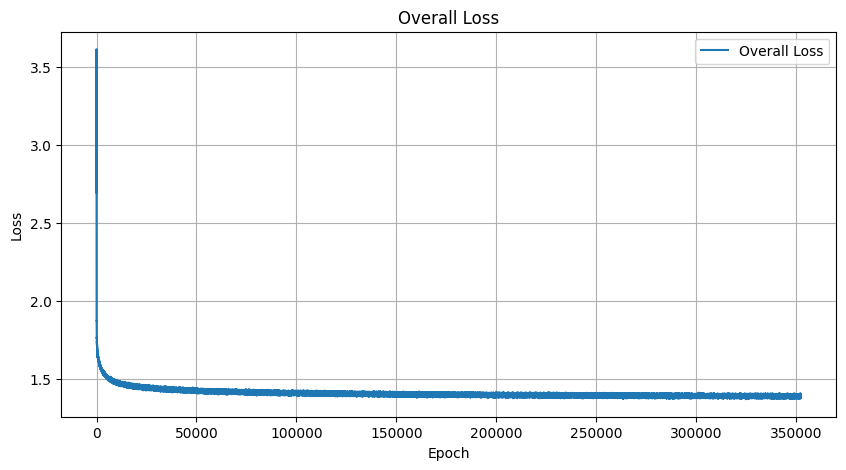

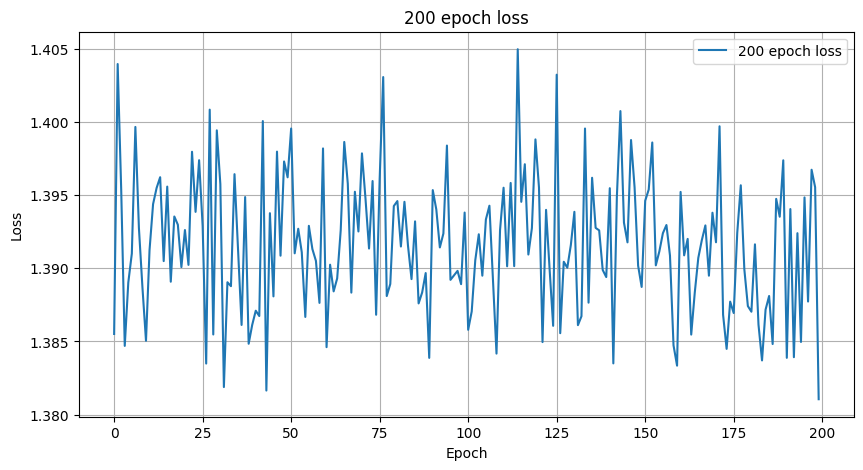

Epoch [1813301], Loss: 1.3908
Epoch [1813302], Loss: 1.3897
Epoch [1813303], Loss: 1.3966
Epoch [1813304], Loss: 1.3927
Epoch [1813305], Loss: 1.3902
Epoch [1813306], Loss: 1.3838
Epoch [1813307], Loss: 1.3868
Epoch [1813308], Loss: 1.3935
Epoch [1813309], Loss: 1.3944
Epoch [1813310], Loss: 1.3846
Epoch [1813311], Loss: 1.3974
Epoch [1813312], Loss: 1.3985
Epoch [1813313], Loss: 1.3920
Epoch [1813314], Loss: 1.3841
Epoch [1813315], Loss: 1.4012
Epoch [1813316], Loss: 1.3930
Epoch [1813317], Loss: 1.3953
Epoch [1813318], Loss: 1.3951
Epoch [1813319], Loss: 1.3882
Epoch [1813320], Loss: 1.3952
Epoch [1813321], Loss: 1.3836
Epoch [1813322], Loss: 1.3895
Epoch [1813323], Loss: 1.3941
Epoch [1813324], Loss: 1.3975
Epoch [1813325], Loss: 1.3840
Epoch [1813326], Loss: 1.3855
Epoch [1813327], Loss: 1.3893
Epoch [1813328], Loss: 1.3944
Epoch [1813329], Loss: 1.3960
Epoch [1813330], Loss: 1.3831
Epoch [1813331], Loss: 1.3920
Epoch [1813332], Loss: 1.3922
Epoch [1813333], Loss: 1.3932
Epoch [181

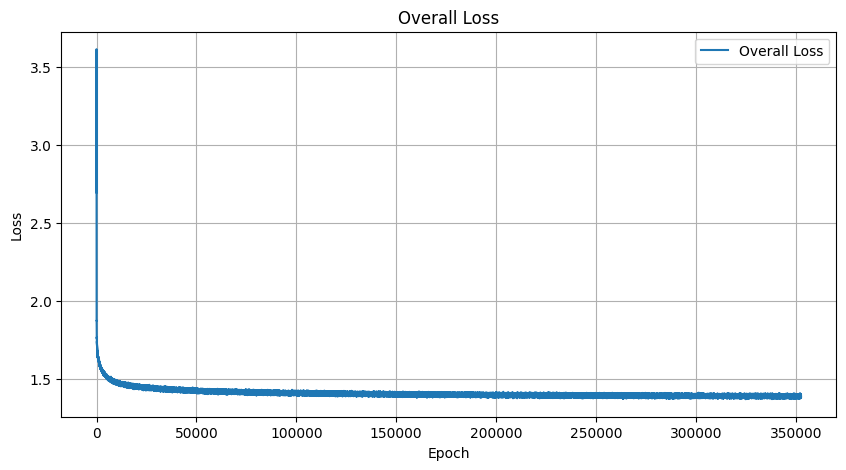

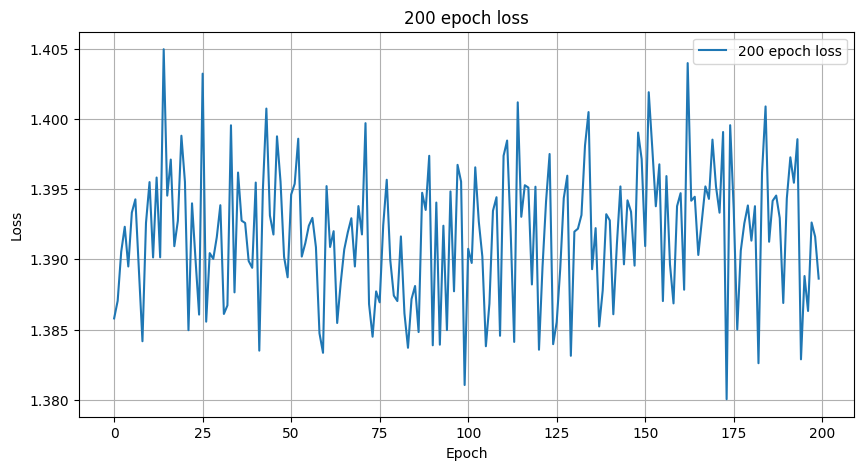

Epoch [1813401], Loss: 1.3903
Epoch [1813402], Loss: 1.3922
Epoch [1813403], Loss: 1.3971
Epoch [1813404], Loss: 1.3900
Epoch [1813405], Loss: 1.3909
Epoch [1813406], Loss: 1.3928
Epoch [1813407], Loss: 1.3915
Epoch [1813408], Loss: 1.3896
Epoch [1813409], Loss: 1.3872
Epoch [1813410], Loss: 1.3950
Epoch [1813411], Loss: 1.3915
Epoch [1813412], Loss: 1.3860
Epoch [1813413], Loss: 1.3991
Epoch [1813414], Loss: 1.3832
Epoch [1813415], Loss: 1.3930
Epoch [1813416], Loss: 1.3791
Epoch [1813417], Loss: 1.3945
Epoch [1813418], Loss: 1.3961
Epoch [1813419], Loss: 1.3975
Epoch [1813420], Loss: 1.3890
Epoch [1813421], Loss: 1.3933
Epoch [1813422], Loss: 1.4016
Epoch [1813423], Loss: 1.3891
Epoch [1813424], Loss: 1.3890
Epoch [1813425], Loss: 1.3958
Epoch [1813426], Loss: 1.3918
Epoch [1813427], Loss: 1.3901
Epoch [1813428], Loss: 1.3896
Epoch [1813429], Loss: 1.3906
Epoch [1813430], Loss: 1.3848
Epoch [1813431], Loss: 1.3970
Epoch [1813432], Loss: 1.3896
Epoch [1813433], Loss: 1.3786
Epoch [181

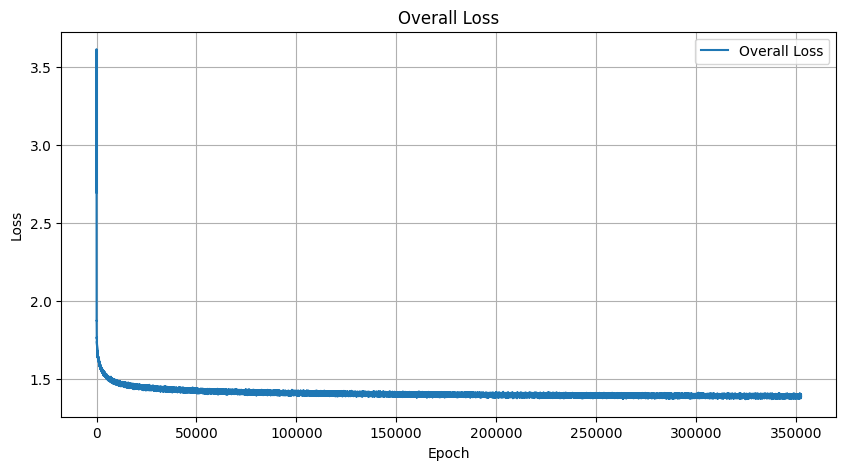

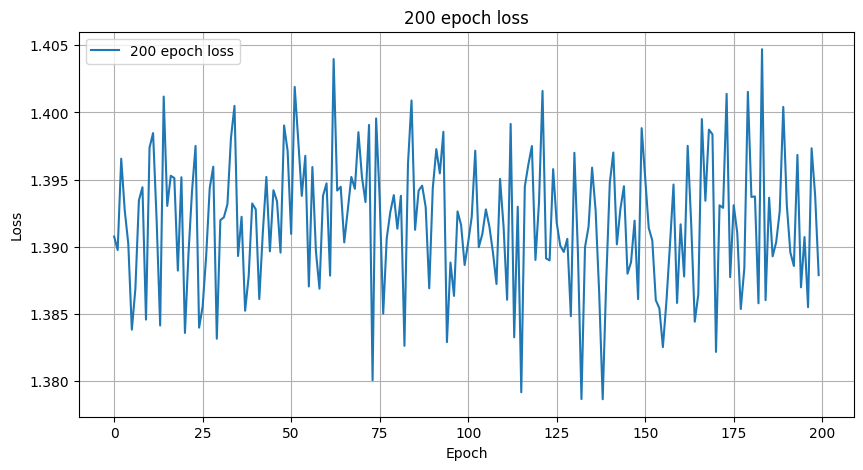

Epoch [1813501], Loss: 1.3904
Epoch [1813502], Loss: 1.3902
Epoch [1813503], Loss: 1.3898
Epoch [1813504], Loss: 1.3993
Epoch [1813505], Loss: 1.3864
Epoch [1813506], Loss: 1.3858
Epoch [1813507], Loss: 1.3880
Epoch [1813508], Loss: 1.3984
Epoch [1813509], Loss: 1.3866
Epoch [1813510], Loss: 1.3924
Epoch [1813511], Loss: 1.3868
Epoch [1813512], Loss: 1.3819
Epoch [1813513], Loss: 1.3812
Epoch [1813514], Loss: 1.3969
Epoch [1813515], Loss: 1.3926
Epoch [1813516], Loss: 1.3810
Epoch [1813517], Loss: 1.4002
Epoch [1813518], Loss: 1.3854
Epoch [1813519], Loss: 1.3875
Epoch [1813520], Loss: 1.3857
Epoch [1813521], Loss: 1.3928
Epoch [1813522], Loss: 1.3837
Epoch [1813523], Loss: 1.3814
Epoch [1813524], Loss: 1.3946
Epoch [1813525], Loss: 1.3836
Epoch [1813526], Loss: 1.3909
Epoch [1813527], Loss: 1.3998
Epoch [1813528], Loss: 1.3993
Epoch [1813529], Loss: 1.3947
Epoch [1813530], Loss: 1.3889
Epoch [1813531], Loss: 1.3958
Epoch [1813532], Loss: 1.3931
Epoch [1813533], Loss: 1.3978
Epoch [181

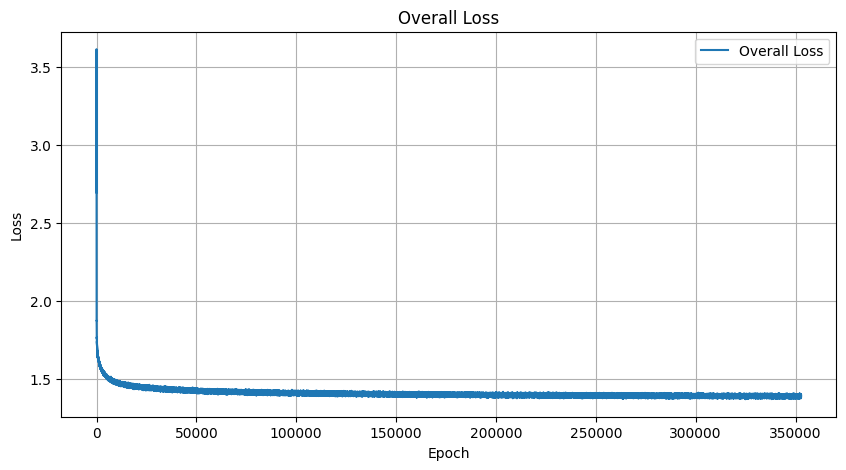

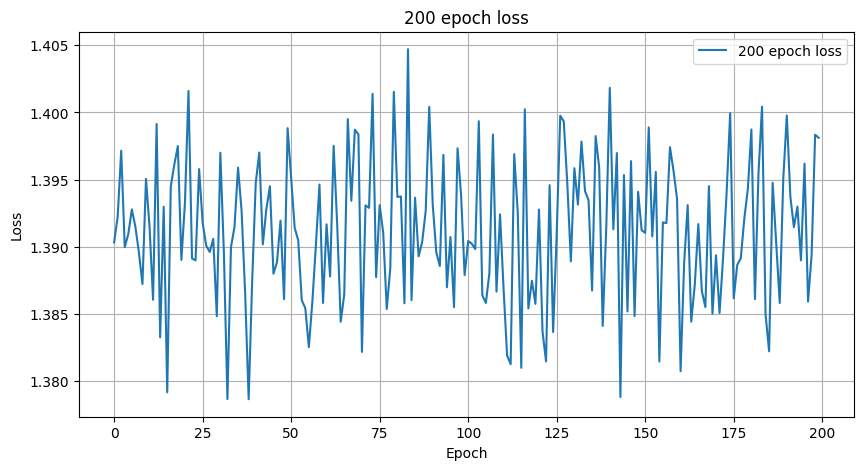

Epoch [1813601], Loss: 1.3996
Epoch [1813602], Loss: 1.3896
Epoch [1813603], Loss: 1.3928
Epoch [1813604], Loss: 1.3889
Epoch [1813605], Loss: 1.3952
Epoch [1813606], Loss: 1.3870
Epoch [1813607], Loss: 1.3977
Epoch [1813608], Loss: 1.3931
Epoch [1813609], Loss: 1.3862
Epoch [1813610], Loss: 1.3910
Epoch [1813611], Loss: 1.3956
Epoch [1813612], Loss: 1.3901
Epoch [1813613], Loss: 1.3939
Epoch [1813614], Loss: 1.3919
Epoch [1813615], Loss: 1.4016
Epoch [1813616], Loss: 1.3966
Epoch [1813617], Loss: 1.3978
Epoch [1813618], Loss: 1.4038
Epoch [1813619], Loss: 1.3883
Epoch [1813620], Loss: 1.3958
Epoch [1813621], Loss: 1.3973
Epoch [1813622], Loss: 1.3953
Epoch [1813623], Loss: 1.3922
Epoch [1813624], Loss: 1.3750
Epoch [1813625], Loss: 1.3892
Epoch [1813626], Loss: 1.3971
Epoch [1813627], Loss: 1.3927
Epoch [1813628], Loss: 1.4025
Epoch [1813629], Loss: 1.3933
Epoch [1813630], Loss: 1.4048
Epoch [1813631], Loss: 1.3922
Epoch [1813632], Loss: 1.3937
Epoch [1813633], Loss: 1.3931
Epoch [181

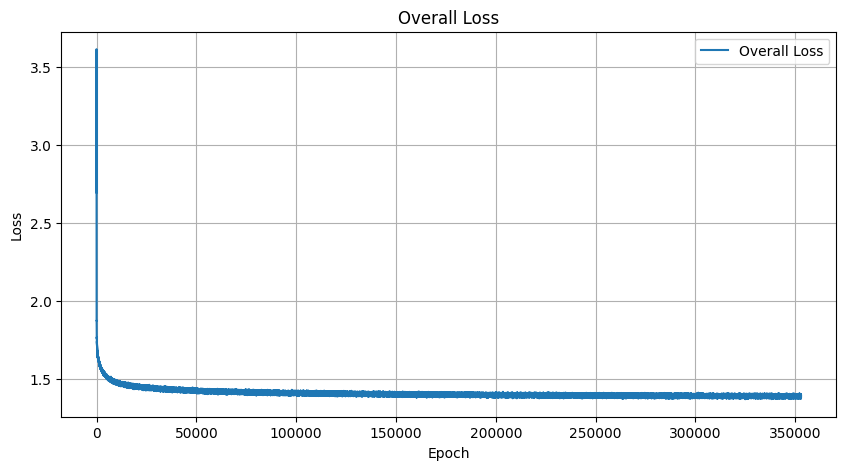

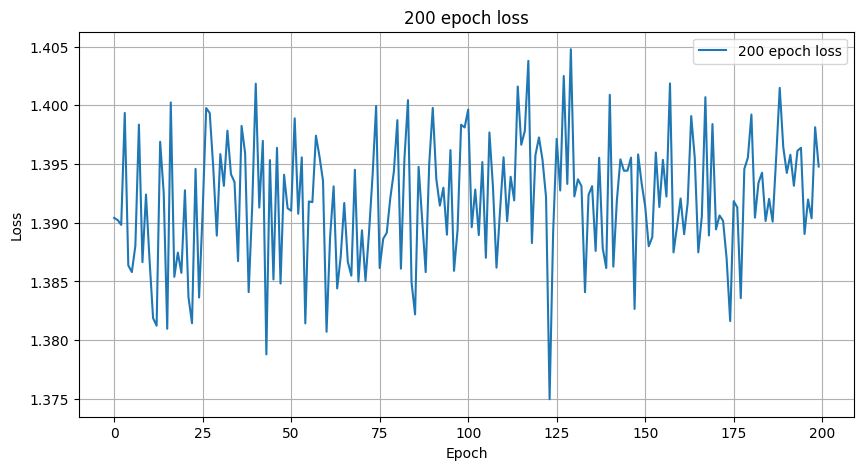

Epoch [1813701], Loss: 1.3893
Epoch [1813702], Loss: 1.3828
Epoch [1813703], Loss: 1.3972
Epoch [1813704], Loss: 1.3814
Epoch [1813705], Loss: 1.3834
Epoch [1813706], Loss: 1.3845
Epoch [1813707], Loss: 1.3926
Epoch [1813708], Loss: 1.3936
Epoch [1813709], Loss: 1.3860
Epoch [1813710], Loss: 1.3898
Epoch [1813711], Loss: 1.3933
Epoch [1813712], Loss: 1.3962
Epoch [1813713], Loss: 1.3968
Epoch [1813714], Loss: 1.3935
Epoch [1813715], Loss: 1.3943
Epoch [1813716], Loss: 1.3920
Epoch [1813717], Loss: 1.3876
Epoch [1813718], Loss: 1.3942
Epoch [1813719], Loss: 1.3899
Epoch [1813720], Loss: 1.3906
Epoch [1813721], Loss: 1.3934
Epoch [1813722], Loss: 1.3887
Epoch [1813723], Loss: 1.3963
Epoch [1813724], Loss: 1.3893
Epoch [1813725], Loss: 1.3846
Epoch [1813726], Loss: 1.4006
Epoch [1813727], Loss: 1.3992
Epoch [1813728], Loss: 1.3862
Epoch [1813729], Loss: 1.3923
Epoch [1813730], Loss: 1.3902
Epoch [1813731], Loss: 1.3931
Epoch [1813732], Loss: 1.3889
Epoch [1813733], Loss: 1.3936
Epoch [181

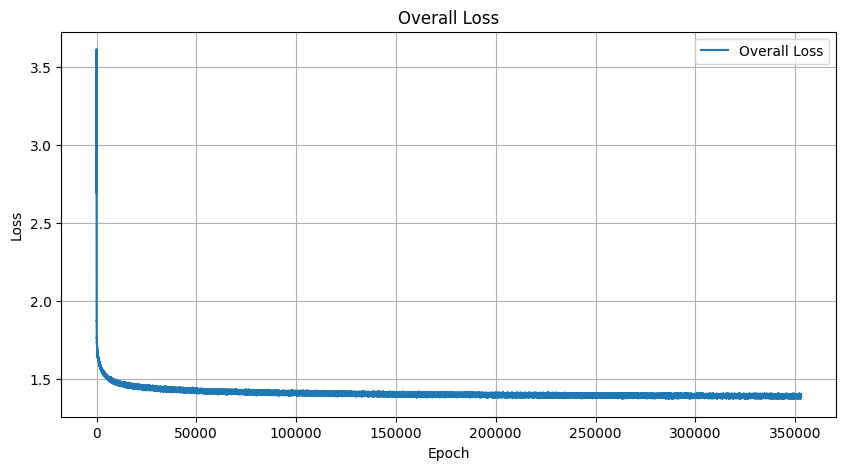

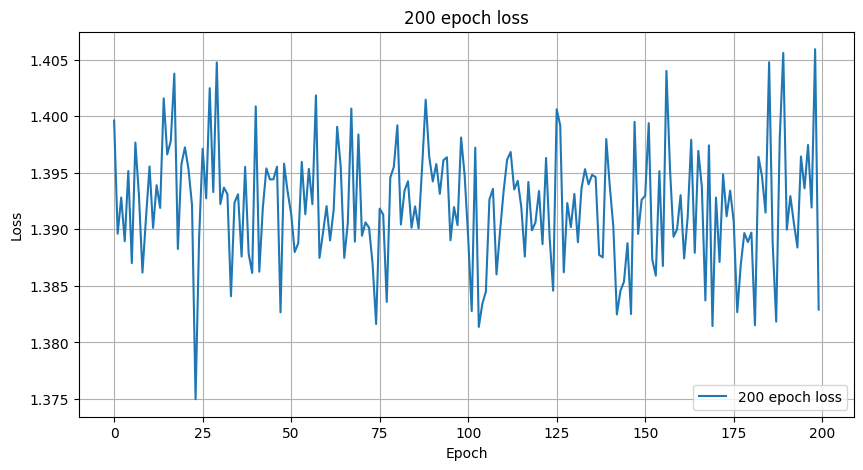

Epoch [1813801], Loss: 1.3884
Epoch [1813802], Loss: 1.4007
Epoch [1813803], Loss: 1.3873
Epoch [1813804], Loss: 1.3955
Epoch [1813805], Loss: 1.3959
Epoch [1813806], Loss: 1.3958
Epoch [1813807], Loss: 1.3995
Epoch [1813808], Loss: 1.3868
Epoch [1813809], Loss: 1.3832
Epoch [1813810], Loss: 1.3962
Epoch [1813811], Loss: 1.3886
Epoch [1813812], Loss: 1.3951
Epoch [1813813], Loss: 1.3811
Epoch [1813814], Loss: 1.3957
Epoch [1813815], Loss: 1.3881
Epoch [1813816], Loss: 1.3877
Epoch [1813817], Loss: 1.3856
Epoch [1813818], Loss: 1.3924
Epoch [1813819], Loss: 1.3915
Epoch [1813820], Loss: 1.3858
Epoch [1813821], Loss: 1.3883
Epoch [1813822], Loss: 1.3934
Epoch [1813823], Loss: 1.3960
Epoch [1813824], Loss: 1.3939
Epoch [1813825], Loss: 1.3920
Epoch [1813826], Loss: 1.3923
Epoch [1813827], Loss: 1.3945
Epoch [1813828], Loss: 1.3895
Epoch [1813829], Loss: 1.3976
Epoch [1813830], Loss: 1.3956
Epoch [1813831], Loss: 1.3874
Epoch [1813832], Loss: 1.3905
Epoch [1813833], Loss: 1.3861
Epoch [181

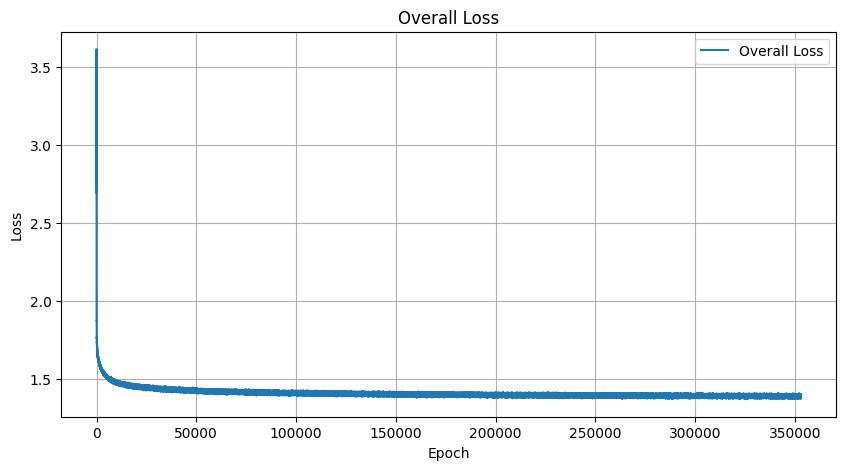

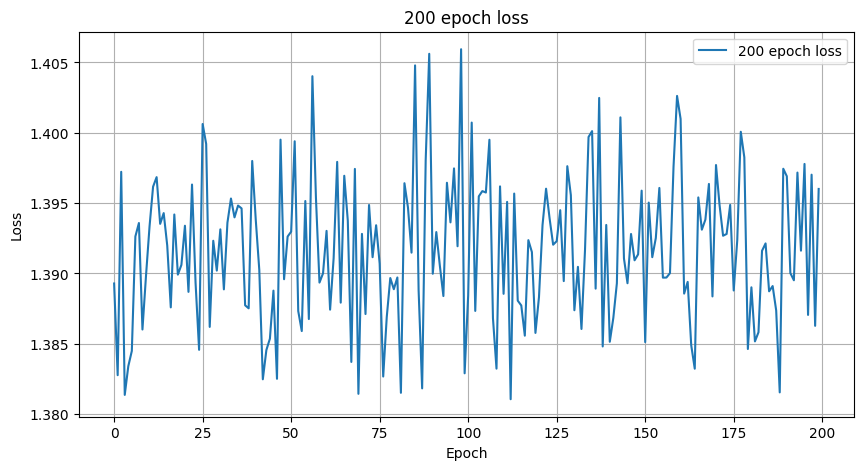

Epoch [1813901], Loss: 1.4009
Epoch [1813902], Loss: 1.3855
Epoch [1813903], Loss: 1.3930
Epoch [1813904], Loss: 1.3890
Epoch [1813905], Loss: 1.3979
Epoch [1813906], Loss: 1.3815
Epoch [1813907], Loss: 1.3820
Epoch [1813908], Loss: 1.3873
Epoch [1813909], Loss: 1.3946
Epoch [1813910], Loss: 1.3983
Epoch [1813911], Loss: 1.3873
Epoch [1813912], Loss: 1.3958
Epoch [1813913], Loss: 1.3929
Epoch [1813914], Loss: 1.3930
Epoch [1813915], Loss: 1.3937
Epoch [1813916], Loss: 1.3936
Epoch [1813917], Loss: 1.3909
Epoch [1813918], Loss: 1.3907
Epoch [1813919], Loss: 1.3895
Epoch [1813920], Loss: 1.3858
Epoch [1813921], Loss: 1.3919
Epoch [1813922], Loss: 1.3875
Epoch [1813923], Loss: 1.3893
Epoch [1813924], Loss: 1.4014
Epoch [1813925], Loss: 1.3937
Epoch [1813926], Loss: 1.3961
Epoch [1813927], Loss: 1.3873
Epoch [1813928], Loss: 1.3849
Epoch [1813929], Loss: 1.3925
Epoch [1813930], Loss: 1.3930
Epoch [1813931], Loss: 1.3908
Epoch [1813932], Loss: 1.3960
Epoch [1813933], Loss: 1.3918
Epoch [181

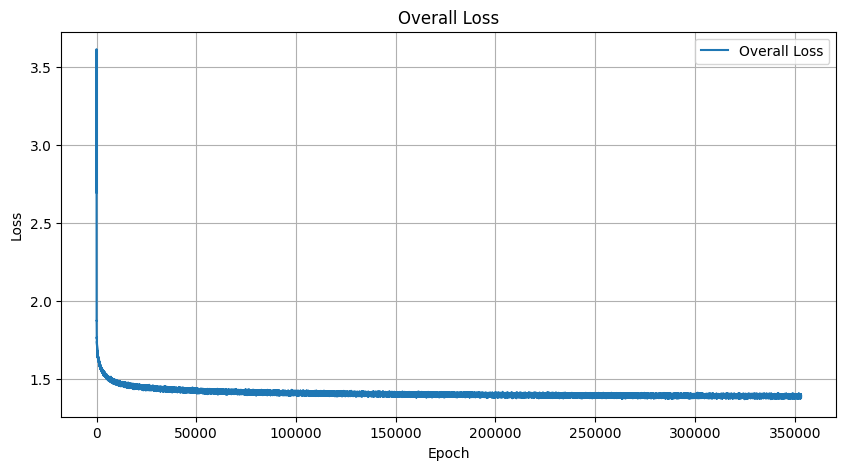

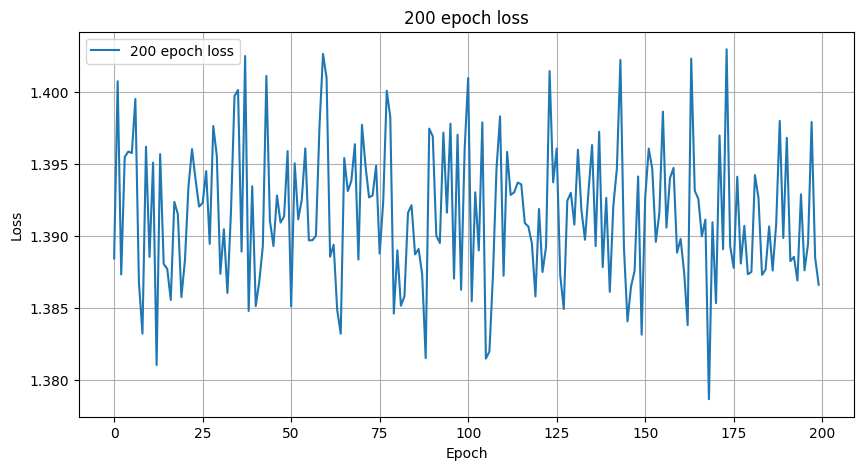

Epoch [1814001], Loss: 1.3895
Epoch [1814002], Loss: 1.3915
Epoch [1814003], Loss: 1.3940
Epoch [1814004], Loss: 1.3906
Epoch [1814005], Loss: 1.3882
Epoch [1814006], Loss: 1.3972
Epoch [1814007], Loss: 1.3995
Epoch [1814008], Loss: 1.3948
Epoch [1814009], Loss: 1.3969
Epoch [1814010], Loss: 1.3848
Epoch [1814011], Loss: 1.3960
Epoch [1814012], Loss: 1.3974
Epoch [1814013], Loss: 1.3888
Epoch [1814014], Loss: 1.3957
Epoch [1814015], Loss: 1.3952
Epoch [1814016], Loss: 1.3883
Epoch [1814017], Loss: 1.3896
Epoch [1814018], Loss: 1.3889
Epoch [1814019], Loss: 1.3913
Epoch [1814020], Loss: 1.3978
Epoch [1814021], Loss: 1.3966
Epoch [1814022], Loss: 1.3945
Epoch [1814023], Loss: 1.3862
Epoch [1814024], Loss: 1.3883
Epoch [1814025], Loss: 1.3916
Epoch [1814026], Loss: 1.3985
Epoch [1814027], Loss: 1.3964
Epoch [1814028], Loss: 1.3975
Epoch [1814029], Loss: 1.3891
Epoch [1814030], Loss: 1.3915
Epoch [1814031], Loss: 1.3879
Epoch [1814032], Loss: 1.3892
Epoch [1814033], Loss: 1.3932
Epoch [181

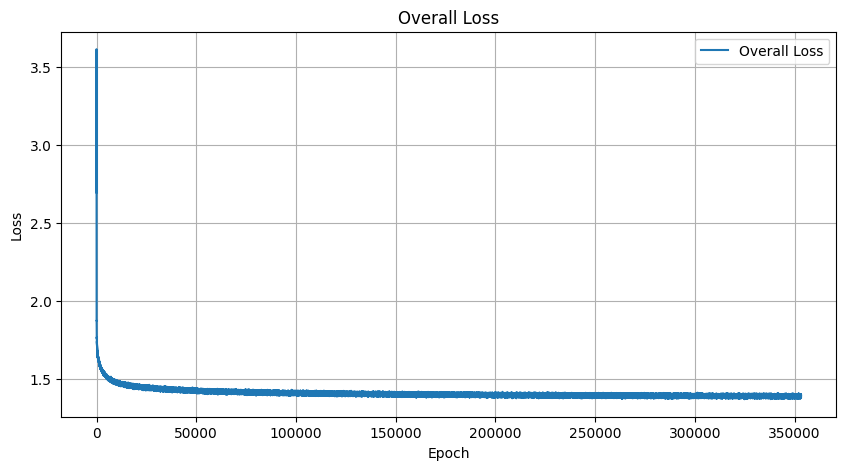

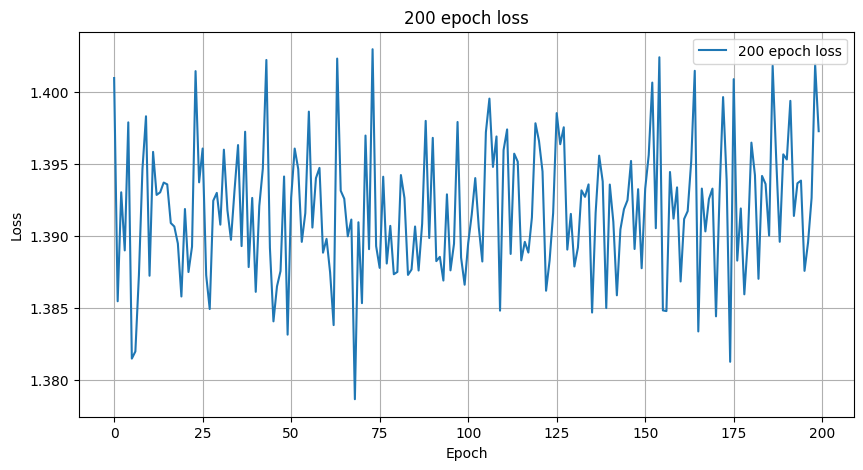

Epoch [1814101], Loss: 1.3912
Epoch [1814102], Loss: 1.3934
Epoch [1814103], Loss: 1.3914
Epoch [1814104], Loss: 1.3841
Epoch [1814105], Loss: 1.3829
Epoch [1814106], Loss: 1.3893
Epoch [1814107], Loss: 1.3904
Epoch [1814108], Loss: 1.3890
Epoch [1814109], Loss: 1.3974
Epoch [1814110], Loss: 1.3844
Epoch [1814111], Loss: 1.3902
Epoch [1814112], Loss: 1.3994
Epoch [1814113], Loss: 1.3889
Epoch [1814114], Loss: 1.3879
Epoch [1814115], Loss: 1.3965
Epoch [1814116], Loss: 1.3874
Epoch [1814117], Loss: 1.3939
Epoch [1814118], Loss: 1.3925
Epoch [1814119], Loss: 1.3893
Epoch [1814120], Loss: 1.3924
Epoch [1814121], Loss: 1.3945
Epoch [1814122], Loss: 1.3956
Epoch [1814123], Loss: 1.3905
Epoch [1814124], Loss: 1.3888
Epoch [1814125], Loss: 1.3841
Epoch [1814126], Loss: 1.3809
Epoch [1814127], Loss: 1.3916
Epoch [1814128], Loss: 1.3859
Epoch [1814129], Loss: 1.3923
Epoch [1814130], Loss: 1.3866
Epoch [1814131], Loss: 1.3876
Epoch [1814132], Loss: 1.3944
Epoch [1814133], Loss: 1.3959
Epoch [181

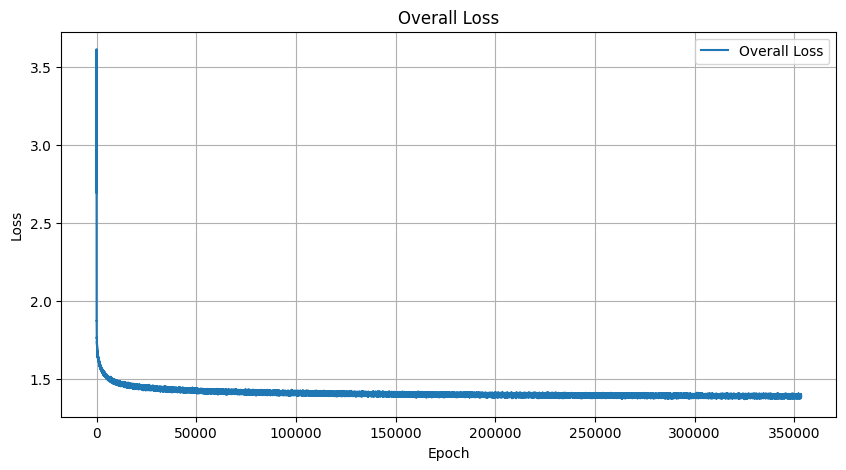

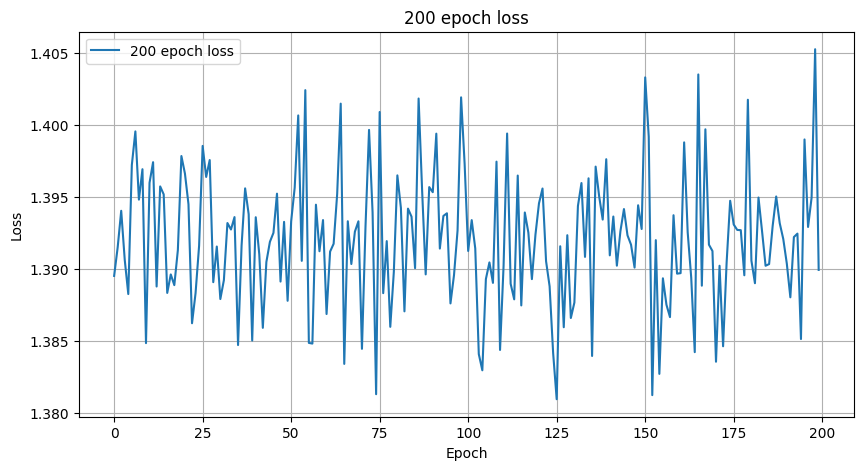

Epoch [1814201], Loss: 1.3889
Epoch [1814202], Loss: 1.3877
Epoch [1814203], Loss: 1.3991
Epoch [1814204], Loss: 1.3940
Epoch [1814205], Loss: 1.3923
Epoch [1814206], Loss: 1.3943
Epoch [1814207], Loss: 1.3980
Epoch [1814208], Loss: 1.3905
Epoch [1814209], Loss: 1.3965
Epoch [1814210], Loss: 1.3978
Epoch [1814211], Loss: 1.3963
Epoch [1814212], Loss: 1.3810
Epoch [1814213], Loss: 1.3967
Epoch [1814214], Loss: 1.3911
Epoch [1814215], Loss: 1.3952
Epoch [1814216], Loss: 1.3970
Epoch [1814217], Loss: 1.3938
Epoch [1814218], Loss: 1.3948
Epoch [1814219], Loss: 1.3919
Epoch [1814220], Loss: 1.3929
Epoch [1814221], Loss: 1.4001
Epoch [1814222], Loss: 1.3854
Epoch [1814223], Loss: 1.3905
Epoch [1814224], Loss: 1.3865
Epoch [1814225], Loss: 1.3979
Epoch [1814226], Loss: 1.3913
Epoch [1814227], Loss: 1.3973
Epoch [1814228], Loss: 1.3941
Epoch [1814229], Loss: 1.3964
Epoch [1814230], Loss: 1.3933
Epoch [1814231], Loss: 1.3901
Epoch [1814232], Loss: 1.3853
Epoch [1814233], Loss: 1.3875
Epoch [181

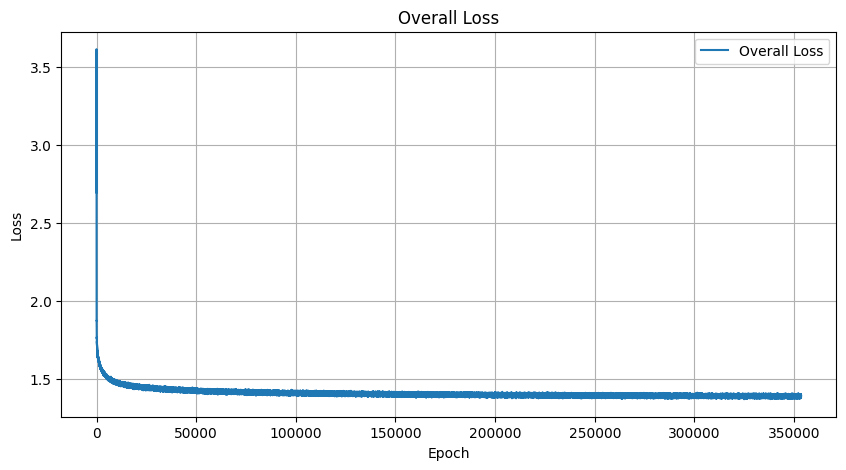

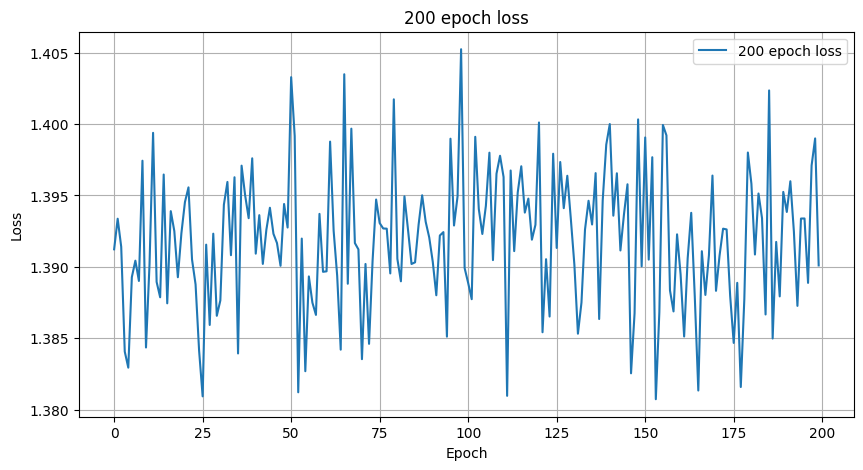

Epoch [1814301], Loss: 1.3971
Epoch [1814302], Loss: 1.3868
Epoch [1814303], Loss: 1.3849
Epoch [1814304], Loss: 1.3843
Epoch [1814305], Loss: 1.3914
Epoch [1814306], Loss: 1.3890
Epoch [1814307], Loss: 1.3920
Epoch [1814308], Loss: 1.3937
Epoch [1814309], Loss: 1.3903
Epoch [1814310], Loss: 1.3852
Epoch [1814311], Loss: 1.3887
Epoch [1814312], Loss: 1.3926
Epoch [1814313], Loss: 1.3905
Epoch [1814314], Loss: 1.3924
Epoch [1814315], Loss: 1.3830
Epoch [1814316], Loss: 1.3919
Epoch [1814317], Loss: 1.3966
Epoch [1814318], Loss: 1.3968
Epoch [1814319], Loss: 1.3963
Epoch [1814320], Loss: 1.3882
Epoch [1814321], Loss: 1.3949
Epoch [1814322], Loss: 1.3961
Epoch [1814323], Loss: 1.3890
Epoch [1814324], Loss: 1.3823
Epoch [1814325], Loss: 1.4018
Epoch [1814326], Loss: 1.3848
Epoch [1814327], Loss: 1.3888
Epoch [1814328], Loss: 1.3868
Epoch [1814329], Loss: 1.3930
Epoch [1814330], Loss: 1.3913
Epoch [1814331], Loss: 1.3926
Epoch [1814332], Loss: 1.3941
Epoch [1814333], Loss: 1.3885
Epoch [181

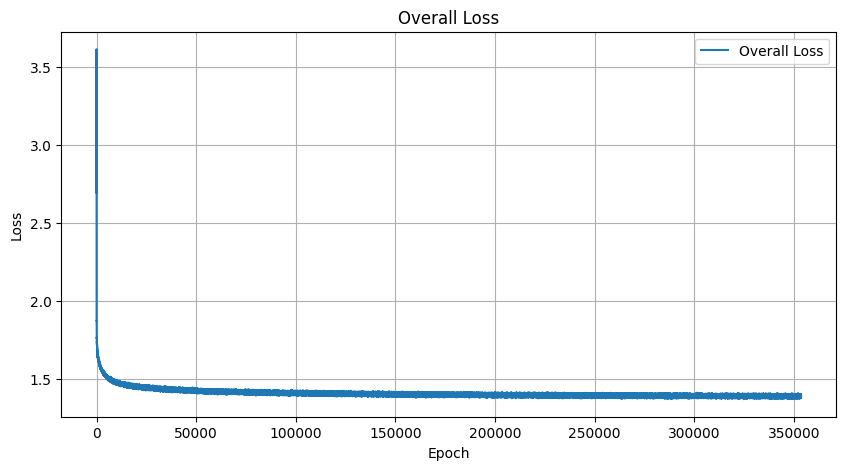

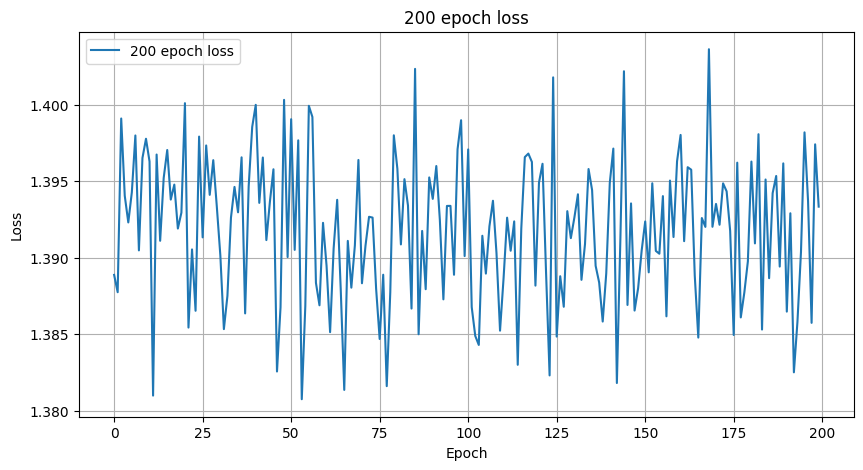

Epoch [1814401], Loss: 1.4017
Epoch [1814402], Loss: 1.3849
Epoch [1814403], Loss: 1.3943
Epoch [1814404], Loss: 1.3925
Epoch [1814405], Loss: 1.3952
Epoch [1814406], Loss: 1.4003
Epoch [1814407], Loss: 1.4001
Epoch [1814408], Loss: 1.3878
Epoch [1814409], Loss: 1.3942
Epoch [1814410], Loss: 1.3931
Epoch [1814411], Loss: 1.3946
Epoch [1814412], Loss: 1.3892
Epoch [1814413], Loss: 1.3949
Epoch [1814414], Loss: 1.3944
Epoch [1814415], Loss: 1.3923
Epoch [1814416], Loss: 1.3858
Epoch [1814417], Loss: 1.3939
Epoch [1814418], Loss: 1.3861
Epoch [1814419], Loss: 1.3857
Epoch [1814420], Loss: 1.3871
Epoch [1814421], Loss: 1.3909
Epoch [1814422], Loss: 1.3870
Epoch [1814423], Loss: 1.3906
Epoch [1814424], Loss: 1.3907
Epoch [1814425], Loss: 1.3856
Epoch [1814426], Loss: 1.3863
Epoch [1814427], Loss: 1.3935
Epoch [1814428], Loss: 1.3897
Epoch [1814429], Loss: 1.3988
Epoch [1814430], Loss: 1.3941
Epoch [1814431], Loss: 1.3965
Epoch [1814432], Loss: 1.3862
Epoch [1814433], Loss: 1.3827
Epoch [181

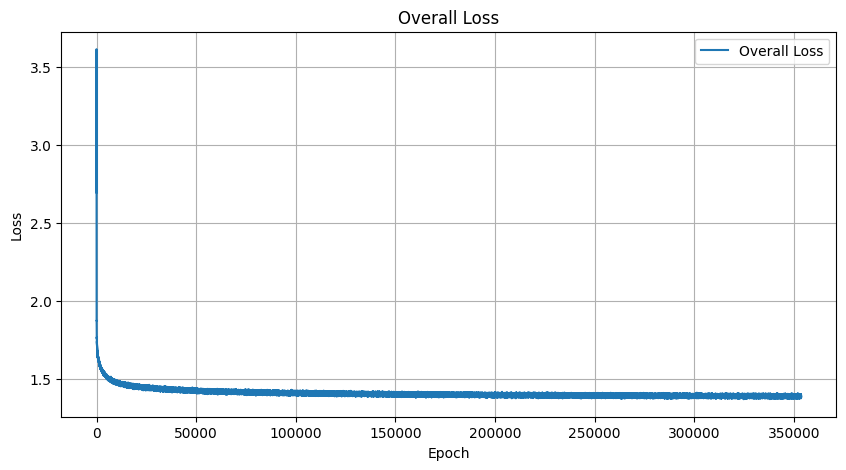

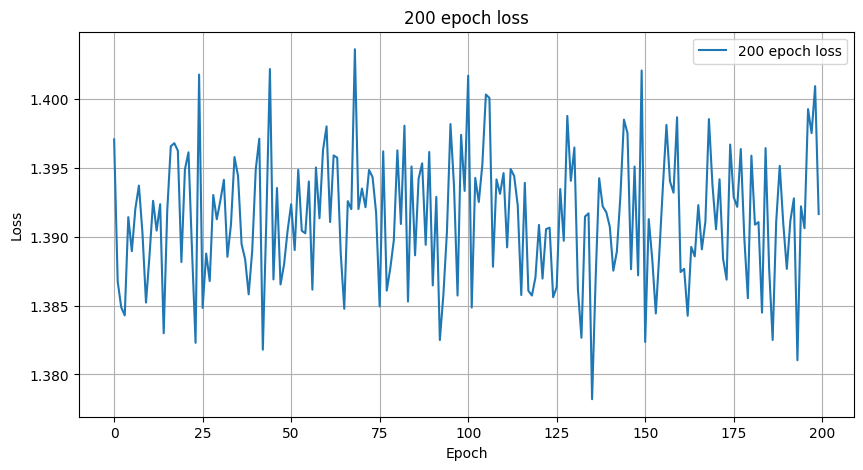

Epoch [1814501], Loss: 1.3893
Epoch [1814502], Loss: 1.3979
Epoch [1814503], Loss: 1.3901
Epoch [1814504], Loss: 1.3842
Epoch [1814505], Loss: 1.3988
Epoch [1814506], Loss: 1.3839
Epoch [1814507], Loss: 1.3931
Epoch [1814508], Loss: 1.3854
Epoch [1814509], Loss: 1.3903
Epoch [1814510], Loss: 1.3932
Epoch [1814511], Loss: 1.3844
Epoch [1814512], Loss: 1.3917
Epoch [1814513], Loss: 1.3894
Epoch [1814514], Loss: 1.3976
Epoch [1814515], Loss: 1.3891
Epoch [1814516], Loss: 1.3950
Epoch [1814517], Loss: 1.3962
Epoch [1814518], Loss: 1.3949
Epoch [1814519], Loss: 1.3866
Epoch [1814520], Loss: 1.3950
Epoch [1814521], Loss: 1.3893
Epoch [1814522], Loss: 1.3935
Epoch [1814523], Loss: 1.3947
Epoch [1814524], Loss: 1.3933
Epoch [1814525], Loss: 1.3918
Epoch [1814526], Loss: 1.3963
Epoch [1814527], Loss: 1.3874
Epoch [1814528], Loss: 1.3936
Epoch [1814529], Loss: 1.4026
Epoch [1814530], Loss: 1.3831
Epoch [1814531], Loss: 1.3871
Epoch [1814532], Loss: 1.3937
Epoch [1814533], Loss: 1.3952
Epoch [181

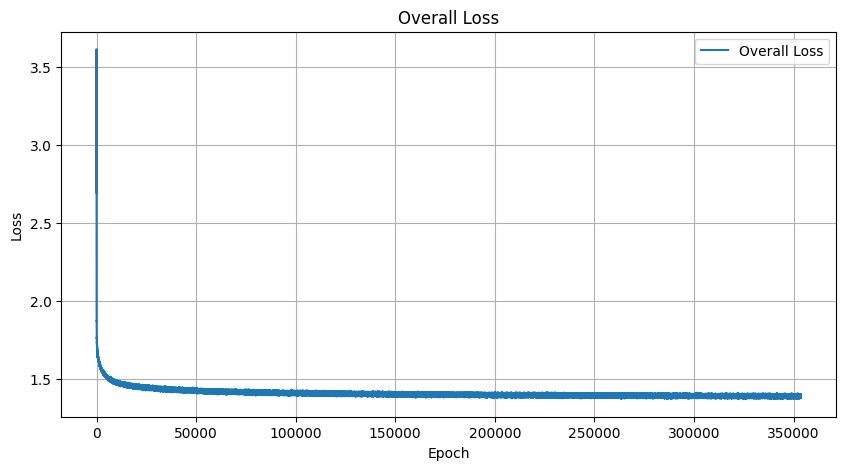

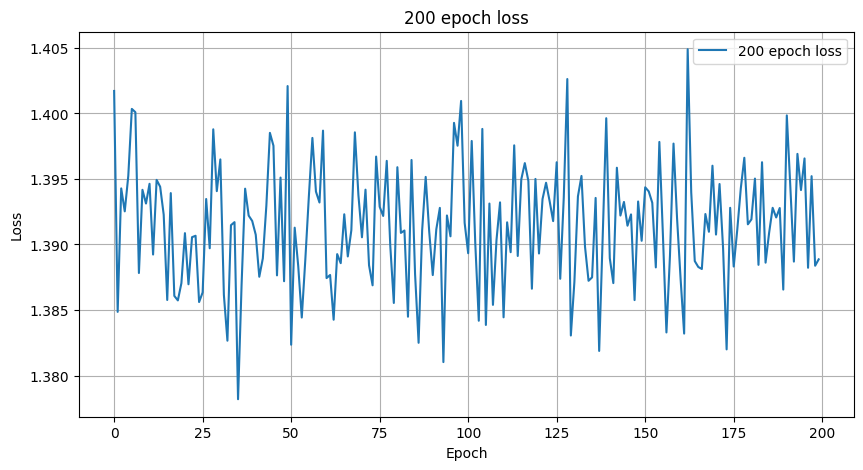

Epoch [1814601], Loss: 1.3872
Epoch [1814602], Loss: 1.3967
Epoch [1814603], Loss: 1.3928
Epoch [1814604], Loss: 1.3808
Epoch [1814605], Loss: 1.3894
Epoch [1814606], Loss: 1.3973
Epoch [1814607], Loss: 1.3817
Epoch [1814608], Loss: 1.3848
Epoch [1814609], Loss: 1.3875
Epoch [1814610], Loss: 1.3837
Epoch [1814611], Loss: 1.3985
Epoch [1814612], Loss: 1.3976
Epoch [1814613], Loss: 1.3900
Epoch [1814614], Loss: 1.3957
Epoch [1814615], Loss: 1.3963
Epoch [1814616], Loss: 1.3928
Epoch [1814617], Loss: 1.3856
Epoch [1814618], Loss: 1.3838
Epoch [1814619], Loss: 1.4095
Epoch [1814620], Loss: 1.3978
Epoch [1814621], Loss: 1.4017
Epoch [1814622], Loss: 1.3891
Epoch [1814623], Loss: 1.3947
Epoch [1814624], Loss: 1.3889
Epoch [1814625], Loss: 1.3975
Epoch [1814626], Loss: 1.3915
Epoch [1814627], Loss: 1.3884
Epoch [1814628], Loss: 1.3959
Epoch [1814629], Loss: 1.3952
Epoch [1814630], Loss: 1.3897
Epoch [1814631], Loss: 1.3937
Epoch [1814632], Loss: 1.3869
Epoch [1814633], Loss: 1.3939
Epoch [181

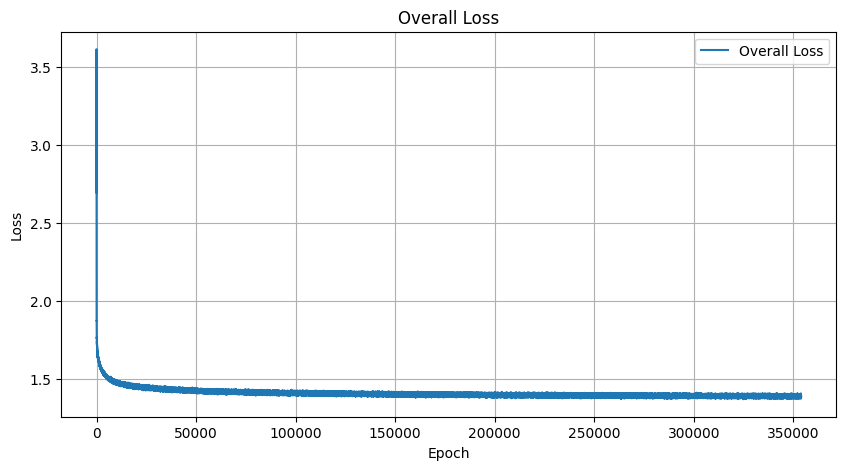

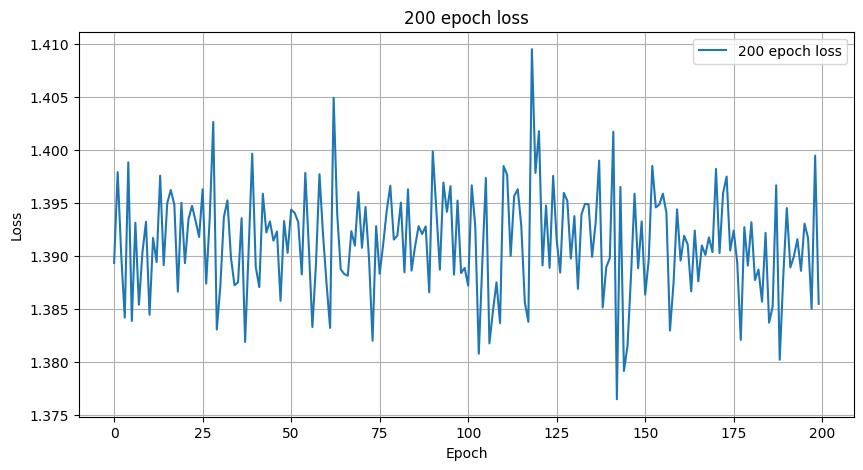

Epoch [1814701], Loss: 1.3941
Epoch [1814702], Loss: 1.3939
Epoch [1814703], Loss: 1.3845
Epoch [1814704], Loss: 1.3903
Epoch [1814705], Loss: 1.3908
Epoch [1814706], Loss: 1.3889
Epoch [1814707], Loss: 1.3924
Epoch [1814708], Loss: 1.3928
Epoch [1814709], Loss: 1.4030
Epoch [1814710], Loss: 1.3970
Epoch [1814711], Loss: 1.3865
Epoch [1814712], Loss: 1.3914
Epoch [1814713], Loss: 1.3970
Epoch [1814714], Loss: 1.3953
Epoch [1814715], Loss: 1.3947
Epoch [1814716], Loss: 1.3937
Epoch [1814717], Loss: 1.3938
Epoch [1814718], Loss: 1.3920
Epoch [1814719], Loss: 1.3954
Epoch [1814720], Loss: 1.3886
Epoch [1814721], Loss: 1.3829
Epoch [1814722], Loss: 1.3944
Epoch [1814723], Loss: 1.3904
Epoch [1814724], Loss: 1.3953
Epoch [1814725], Loss: 1.3890
Epoch [1814726], Loss: 1.3849
Epoch [1814727], Loss: 1.3985
Epoch [1814728], Loss: 1.3886
Epoch [1814729], Loss: 1.3977
Epoch [1814730], Loss: 1.3972
Epoch [1814731], Loss: 1.3829
Epoch [1814732], Loss: 1.3971
Epoch [1814733], Loss: 1.3920
Epoch [181

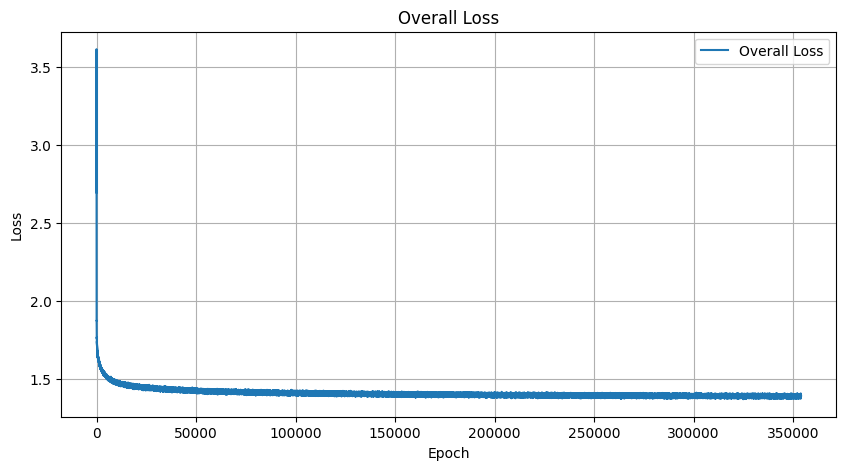

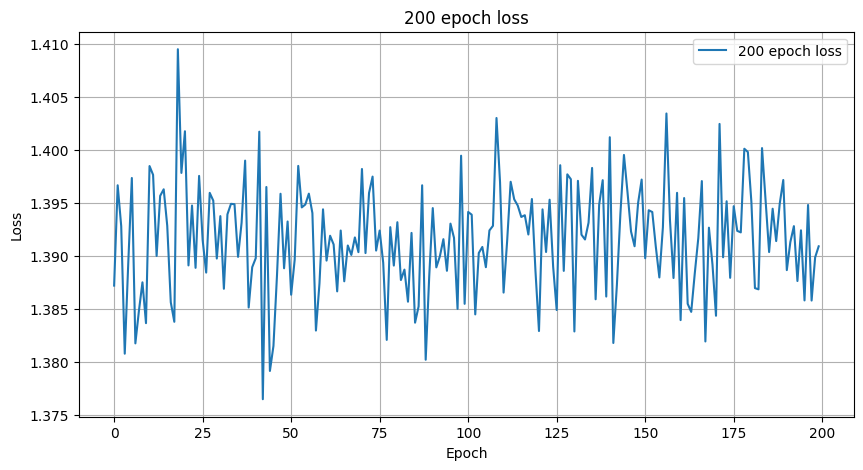

Epoch [1814801], Loss: 1.3870
Epoch [1814802], Loss: 1.3948
Epoch [1814803], Loss: 1.3895
Epoch [1814804], Loss: 1.4031
Epoch [1814805], Loss: 1.3868
Epoch [1814806], Loss: 1.4033
Epoch [1814807], Loss: 1.3983
Epoch [1814808], Loss: 1.3818
Epoch [1814809], Loss: 1.3862
Epoch [1814810], Loss: 1.3855
Epoch [1814811], Loss: 1.3909
Epoch [1814812], Loss: 1.3881
Epoch [1814813], Loss: 1.3987
Epoch [1814814], Loss: 1.3939
Epoch [1814815], Loss: 1.3924
Epoch [1814816], Loss: 1.3891
Epoch [1814817], Loss: 1.3924
Epoch [1814818], Loss: 1.3856
Epoch [1814819], Loss: 1.3843
Epoch [1814820], Loss: 1.3919
Epoch [1814821], Loss: 1.3868
Epoch [1814822], Loss: 1.3952
Epoch [1814823], Loss: 1.3897
Epoch [1814824], Loss: 1.3908
Epoch [1814825], Loss: 1.3971
Epoch [1814826], Loss: 1.3889
Epoch [1814827], Loss: 1.3887
Epoch [1814828], Loss: 1.3911
Epoch [1814829], Loss: 1.3955
Epoch [1814830], Loss: 1.3936
Epoch [1814831], Loss: 1.3860
Epoch [1814832], Loss: 1.3905
Epoch [1814833], Loss: 1.3903
Epoch [181

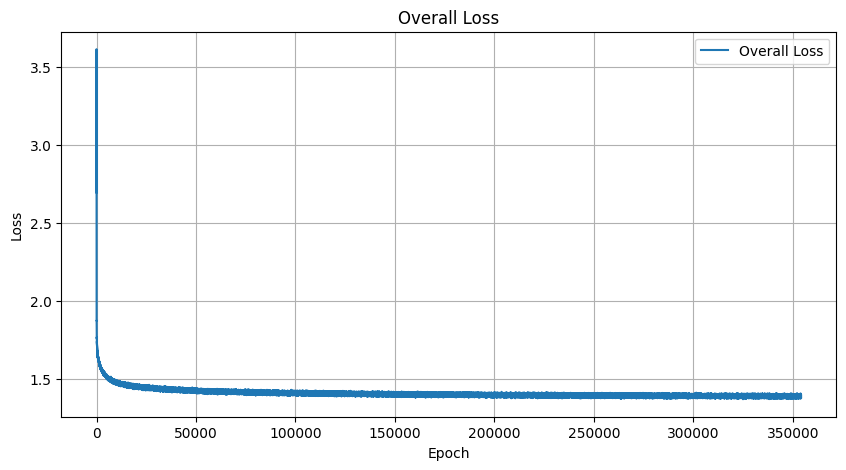

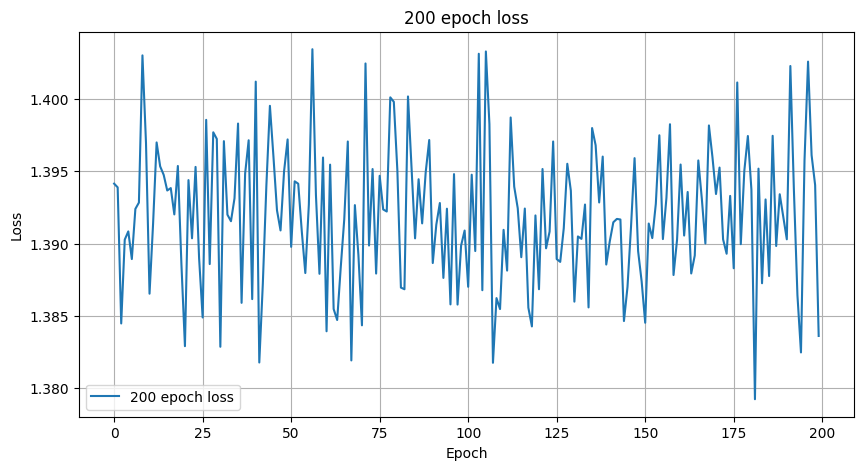

Epoch [1814901], Loss: 1.3875
Epoch [1814902], Loss: 1.4001
Epoch [1814903], Loss: 1.3931
Epoch [1814904], Loss: 1.3883
Epoch [1814905], Loss: 1.3929
Epoch [1814906], Loss: 1.3975
Epoch [1814907], Loss: 1.3969
Epoch [1814908], Loss: 1.3884
Epoch [1814909], Loss: 1.3849
Epoch [1814910], Loss: 1.3849
Epoch [1814911], Loss: 1.3943
Epoch [1814912], Loss: 1.3973
Epoch [1814913], Loss: 1.3916
Epoch [1814914], Loss: 1.3947
Epoch [1814915], Loss: 1.3961
Epoch [1814916], Loss: 1.4008
Epoch [1814917], Loss: 1.3931
Epoch [1814918], Loss: 1.3820
Epoch [1814919], Loss: 1.3981
Epoch [1814920], Loss: 1.3958
Epoch [1814921], Loss: 1.3903
Epoch [1814922], Loss: 1.3913
Epoch [1814923], Loss: 1.3952
Epoch [1814924], Loss: 1.3915
Epoch [1814925], Loss: 1.3913
Epoch [1814926], Loss: 1.3978
Epoch [1814927], Loss: 1.3889
Epoch [1814928], Loss: 1.3906
Epoch [1814929], Loss: 1.3934
Epoch [1814930], Loss: 1.3880
Epoch [1814931], Loss: 1.3898
Epoch [1814932], Loss: 1.3925
Epoch [1814933], Loss: 1.3988
Epoch [181

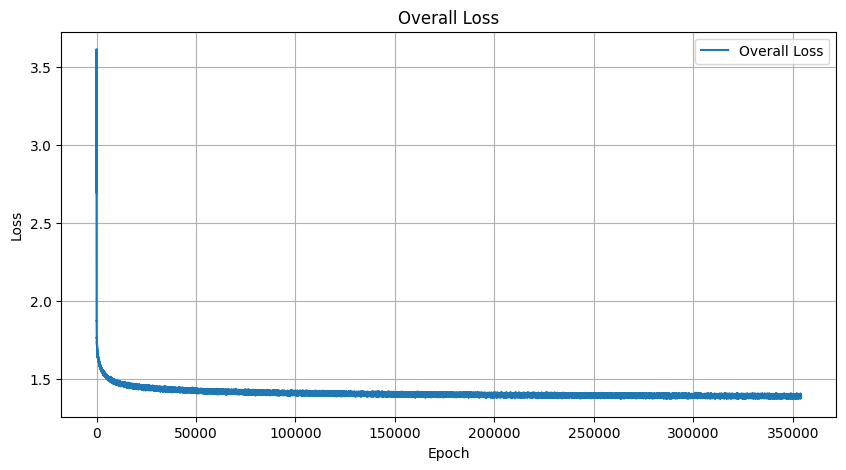

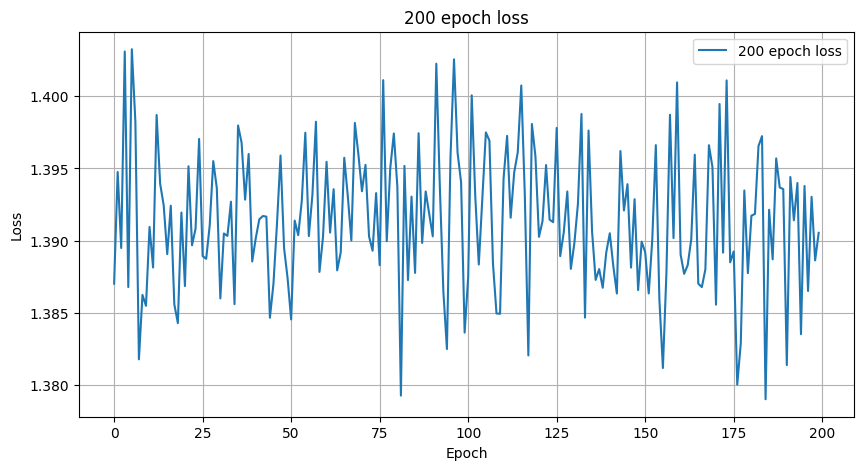

Epoch [1815001], Loss: 1.3895
Epoch [1815002], Loss: 1.3854
Epoch [1815003], Loss: 1.3925
Epoch [1815004], Loss: 1.3933
Epoch [1815005], Loss: 1.3844
Epoch [1815006], Loss: 1.3863
Epoch [1815007], Loss: 1.3852
Epoch [1815008], Loss: 1.3885
Epoch [1815009], Loss: 1.3954
Epoch [1815010], Loss: 1.3895
Epoch [1815011], Loss: 1.3990
Epoch [1815012], Loss: 1.3911
Epoch [1815013], Loss: 1.3864
Epoch [1815014], Loss: 1.3939
Epoch [1815015], Loss: 1.3833
Epoch [1815016], Loss: 1.3875
Epoch [1815017], Loss: 1.3897
Epoch [1815018], Loss: 1.3938
Epoch [1815019], Loss: 1.3851
Epoch [1815020], Loss: 1.3953
Epoch [1815021], Loss: 1.3936
Epoch [1815022], Loss: 1.3919
Epoch [1815023], Loss: 1.3877
Epoch [1815024], Loss: 1.3923
Epoch [1815025], Loss: 1.3897
Epoch [1815026], Loss: 1.3905
Epoch [1815027], Loss: 1.3925
Epoch [1815028], Loss: 1.3775
Epoch [1815029], Loss: 1.3969
Epoch [1815030], Loss: 1.3907
Epoch [1815031], Loss: 1.3965
Epoch [1815032], Loss: 1.3888
Epoch [1815033], Loss: 1.3957
Epoch [181

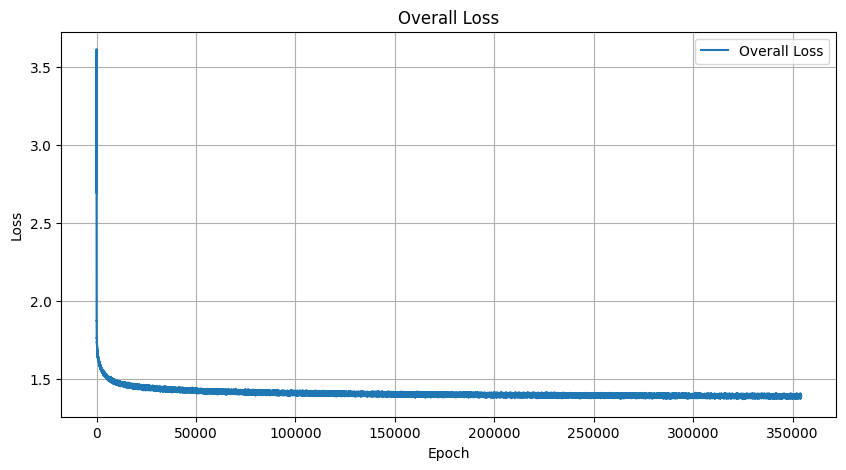

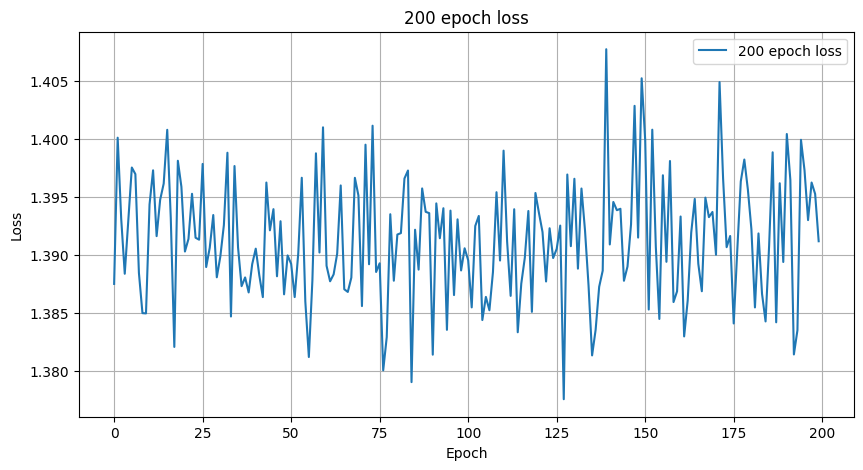

Epoch [1815101], Loss: 1.3885
Epoch [1815102], Loss: 1.3949
Epoch [1815103], Loss: 1.3889
Epoch [1815104], Loss: 1.3920
Epoch [1815105], Loss: 1.3868
Epoch [1815106], Loss: 1.3956
Epoch [1815107], Loss: 1.3901
Epoch [1815108], Loss: 1.3887
Epoch [1815109], Loss: 1.3940
Epoch [1815110], Loss: 1.3937
Epoch [1815111], Loss: 1.3922
Epoch [1815112], Loss: 1.3864
Epoch [1815113], Loss: 1.3859
Epoch [1815114], Loss: 1.4002
Epoch [1815115], Loss: 1.3893
Epoch [1815116], Loss: 1.3969
Epoch [1815117], Loss: 1.3871
Epoch [1815118], Loss: 1.4033
Epoch [1815119], Loss: 1.3876
Epoch [1815120], Loss: 1.3963
Epoch [1815121], Loss: 1.3903
Epoch [1815122], Loss: 1.3886
Epoch [1815123], Loss: 1.3948
Epoch [1815124], Loss: 1.3983
Epoch [1815125], Loss: 1.3916
Epoch [1815126], Loss: 1.3876
Epoch [1815127], Loss: 1.3898
Epoch [1815128], Loss: 1.3889
Epoch [1815129], Loss: 1.3901
Epoch [1815130], Loss: 1.3839
Epoch [1815131], Loss: 1.3902
Epoch [1815132], Loss: 1.4025
Epoch [1815133], Loss: 1.3972
Epoch [181

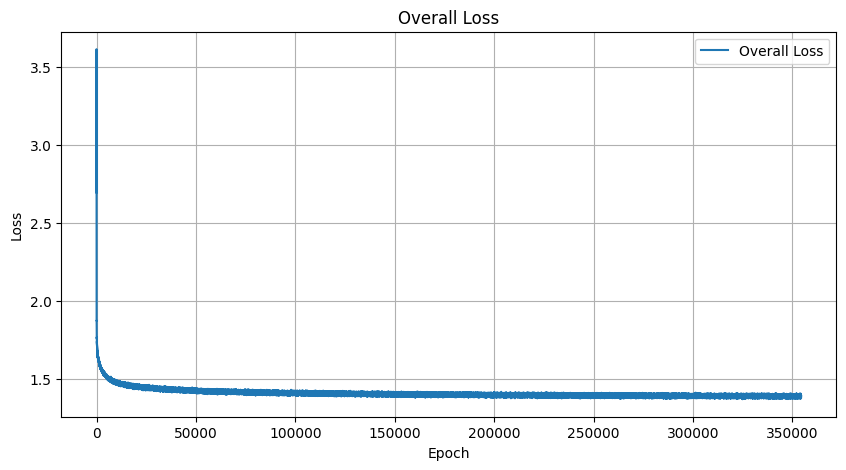

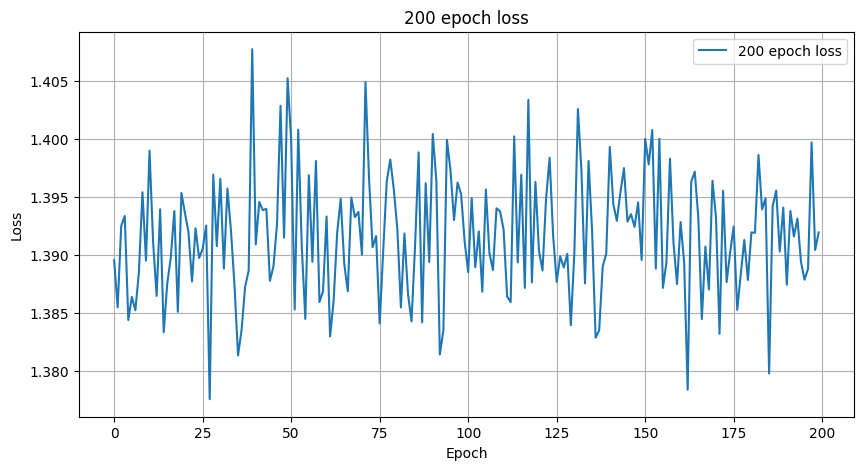

Epoch [1815201], Loss: 1.3979
Epoch [1815202], Loss: 1.3931
Epoch [1815203], Loss: 1.3881
Epoch [1815204], Loss: 1.4007
Epoch [1815205], Loss: 1.3878
Epoch [1815206], Loss: 1.3918
Epoch [1815207], Loss: 1.3996
Epoch [1815208], Loss: 1.3911
Epoch [1815209], Loss: 1.3983
Epoch [1815210], Loss: 1.3895
Epoch [1815211], Loss: 1.3876
Epoch [1815212], Loss: 1.3885
Epoch [1815213], Loss: 1.3929
Epoch [1815214], Loss: 1.3957
Epoch [1815215], Loss: 1.3824
Epoch [1815216], Loss: 1.3929
Epoch [1815217], Loss: 1.3892
Epoch [1815218], Loss: 1.3925
Epoch [1815219], Loss: 1.3920
Epoch [1815220], Loss: 1.3855
Epoch [1815221], Loss: 1.3815
Epoch [1815222], Loss: 1.3926
Epoch [1815223], Loss: 1.3939
Epoch [1815224], Loss: 1.4005
Epoch [1815225], Loss: 1.3932
Epoch [1815226], Loss: 1.3924
Epoch [1815227], Loss: 1.3921
Epoch [1815228], Loss: 1.3953
Epoch [1815229], Loss: 1.3956
Epoch [1815230], Loss: 1.3859
Epoch [1815231], Loss: 1.3924
Epoch [1815232], Loss: 1.3918
Epoch [1815233], Loss: 1.3902
Epoch [181

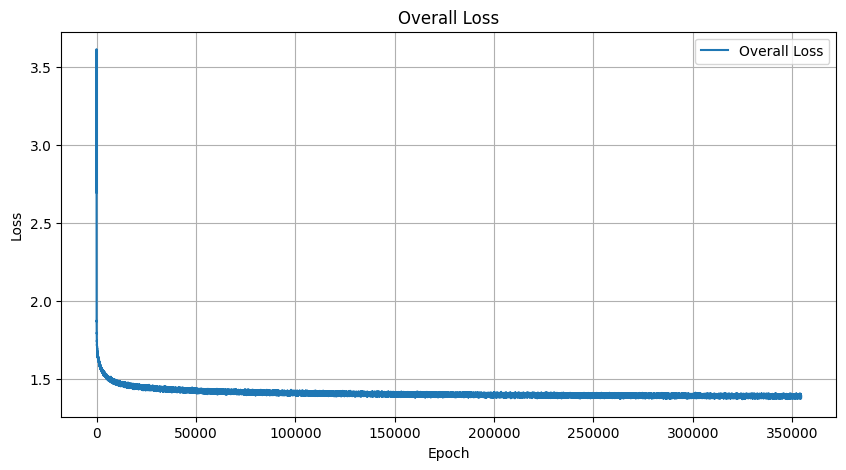

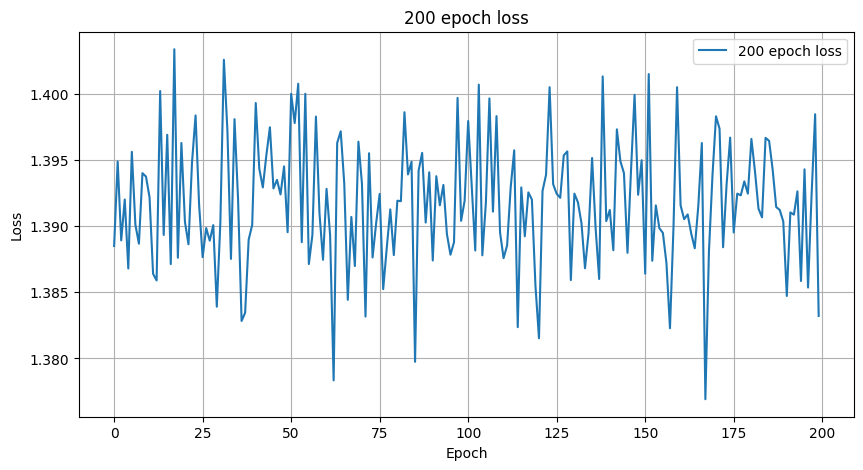

Epoch [1815301], Loss: 1.3974
Epoch [1815302], Loss: 1.3917
Epoch [1815303], Loss: 1.3980
Epoch [1815304], Loss: 1.3921
Epoch [1815305], Loss: 1.3955
Epoch [1815306], Loss: 1.3916
Epoch [1815307], Loss: 1.3941
Epoch [1815308], Loss: 1.3930
Epoch [1815309], Loss: 1.3943
Epoch [1815310], Loss: 1.3926
Epoch [1815311], Loss: 1.3810
Epoch [1815312], Loss: 1.3915
Epoch [1815313], Loss: 1.3979
Epoch [1815314], Loss: 1.3997
Epoch [1815315], Loss: 1.4010
Epoch [1815316], Loss: 1.4028
Epoch [1815317], Loss: 1.3943
Epoch [1815318], Loss: 1.3854
Epoch [1815319], Loss: 1.3935
Epoch [1815320], Loss: 1.3892
Epoch [1815321], Loss: 1.3923
Epoch [1815322], Loss: 1.3957
Epoch [1815323], Loss: 1.3868
Epoch [1815324], Loss: 1.3983
Epoch [1815325], Loss: 1.3860
Epoch [1815326], Loss: 1.3855
Epoch [1815327], Loss: 1.3916
Epoch [1815328], Loss: 1.3894
Epoch [1815329], Loss: 1.3919
Epoch [1815330], Loss: 1.3930
Epoch [1815331], Loss: 1.3986
Epoch [1815332], Loss: 1.3928
Epoch [1815333], Loss: 1.3934
Epoch [181

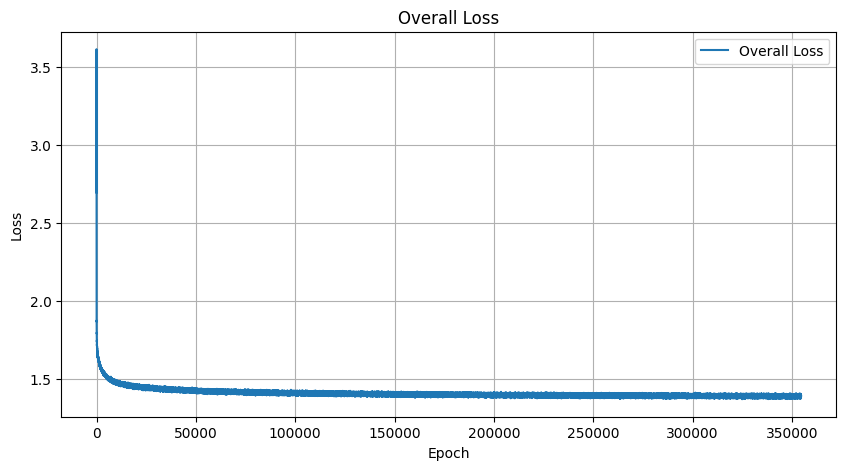

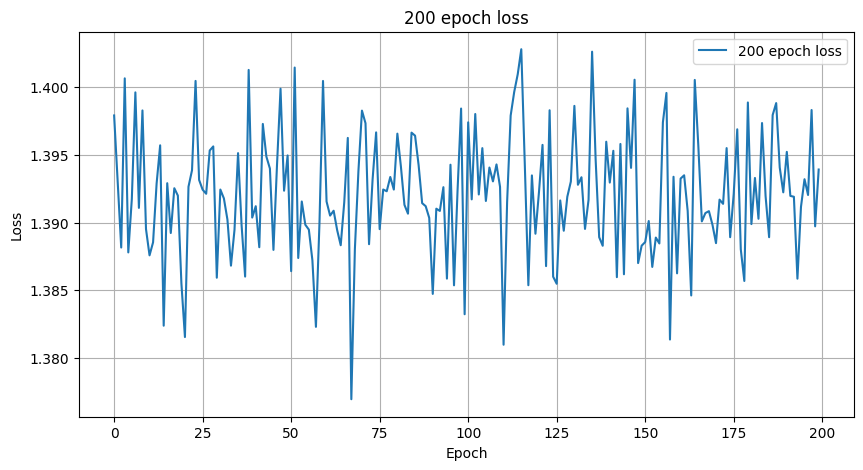

Epoch [1815401], Loss: 1.3956
Epoch [1815402], Loss: 1.3808
Epoch [1815403], Loss: 1.3798
Epoch [1815404], Loss: 1.3939
Epoch [1815405], Loss: 1.3890
Epoch [1815406], Loss: 1.3997
Epoch [1815407], Loss: 1.3912
Epoch [1815408], Loss: 1.3880
Epoch [1815409], Loss: 1.3960
Epoch [1815410], Loss: 1.3841
Epoch [1815411], Loss: 1.3944
Epoch [1815412], Loss: 1.3862
Epoch [1815413], Loss: 1.3836
Epoch [1815414], Loss: 1.3995
Epoch [1815415], Loss: 1.3986
Epoch [1815416], Loss: 1.3883
Epoch [1815417], Loss: 1.3934
Epoch [1815418], Loss: 1.3936
Epoch [1815419], Loss: 1.3850
Epoch [1815420], Loss: 1.3771
Epoch [1815421], Loss: 1.3933
Epoch [1815422], Loss: 1.3929
Epoch [1815423], Loss: 1.3904
Epoch [1815424], Loss: 1.3986
Epoch [1815425], Loss: 1.3932
Epoch [1815426], Loss: 1.3869
Epoch [1815427], Loss: 1.3914
Epoch [1815428], Loss: 1.3944
Epoch [1815429], Loss: 1.3920
Epoch [1815430], Loss: 1.3942
Epoch [1815431], Loss: 1.3958
Epoch [1815432], Loss: 1.3978
Epoch [1815433], Loss: 1.3941
Epoch [181

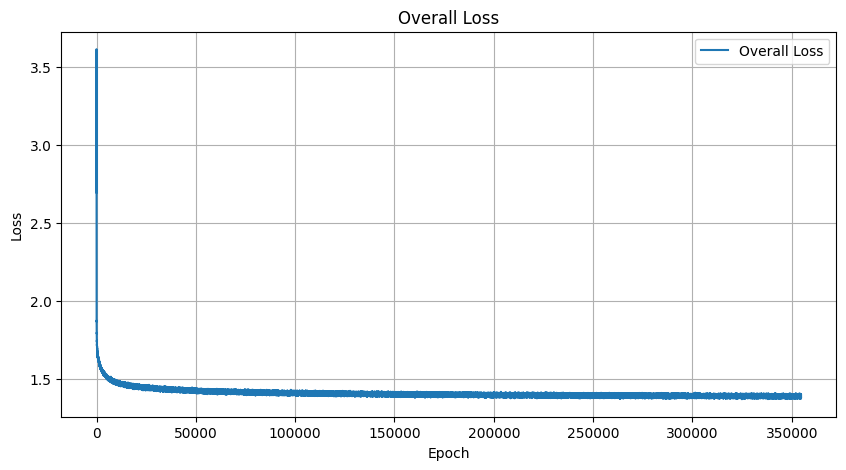

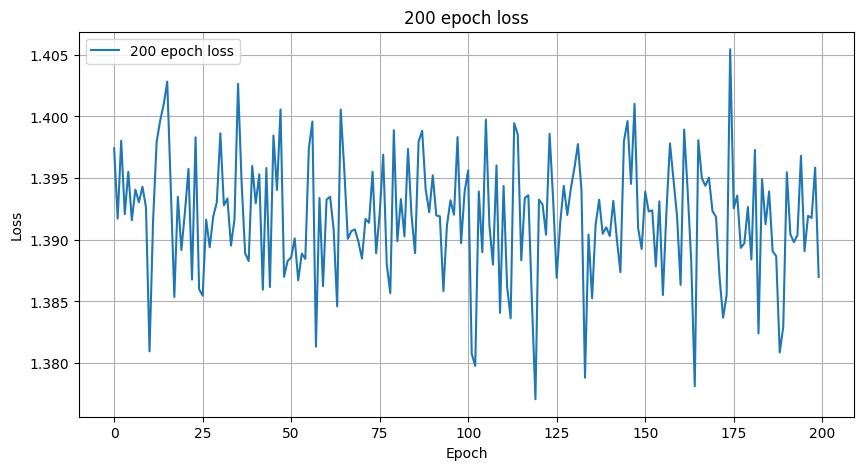

Epoch [1815501], Loss: 1.3992
Epoch [1815502], Loss: 1.3914
Epoch [1815503], Loss: 1.3912
Epoch [1815504], Loss: 1.3891
Epoch [1815505], Loss: 1.3909
Epoch [1815506], Loss: 1.3991
Epoch [1815507], Loss: 1.3900
Epoch [1815508], Loss: 1.3876
Epoch [1815509], Loss: 1.3930
Epoch [1815510], Loss: 1.3917
Epoch [1815511], Loss: 1.3936
Epoch [1815512], Loss: 1.3894
Epoch [1815513], Loss: 1.3920
Epoch [1815514], Loss: 1.3937
Epoch [1815515], Loss: 1.3890
Epoch [1815516], Loss: 1.4014
Epoch [1815517], Loss: 1.3912
Epoch [1815518], Loss: 1.4005
Epoch [1815519], Loss: 1.3889
Epoch [1815520], Loss: 1.3971
Epoch [1815521], Loss: 1.3870
Epoch [1815522], Loss: 1.3848
Epoch [1815523], Loss: 1.3920
Epoch [1815524], Loss: 1.3946
Epoch [1815525], Loss: 1.4042
Epoch [1815526], Loss: 1.3908
Epoch [1815527], Loss: 1.3877
Epoch [1815528], Loss: 1.3863
Epoch [1815529], Loss: 1.3885
Epoch [1815530], Loss: 1.3895
Epoch [1815531], Loss: 1.3945
Epoch [1815532], Loss: 1.3897
Epoch [1815533], Loss: 1.3930
Epoch [181

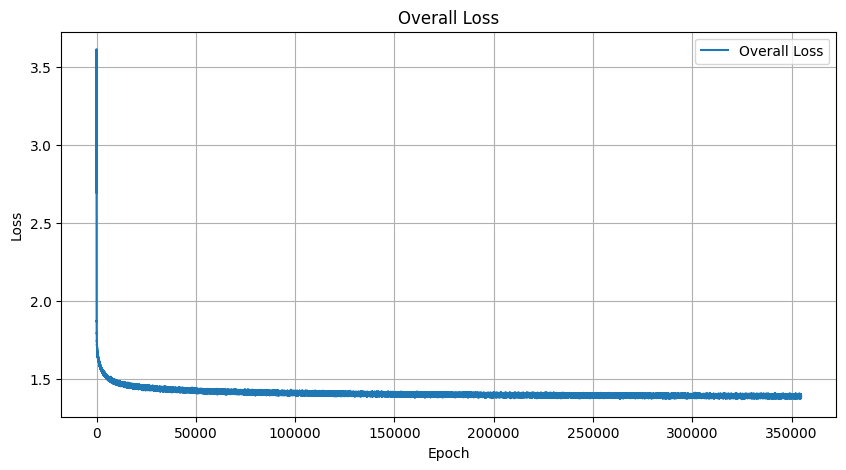

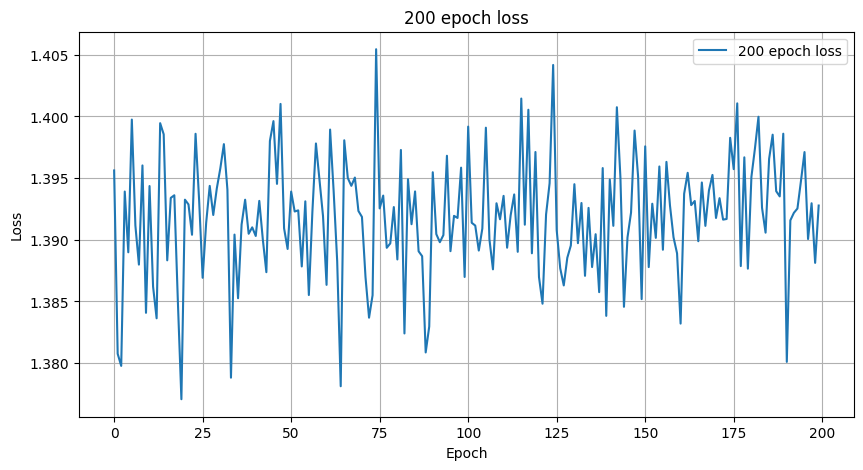

Epoch [1815601], Loss: 1.4002
Epoch [1815602], Loss: 1.3915
Epoch [1815603], Loss: 1.3948
Epoch [1815604], Loss: 1.4001
Epoch [1815605], Loss: 1.4020
Epoch [1815606], Loss: 1.3989
Epoch [1815607], Loss: 1.4007
Epoch [1815608], Loss: 1.3880
Epoch [1815609], Loss: 1.3910
Epoch [1815610], Loss: 1.3917
Epoch [1815611], Loss: 1.3910
Epoch [1815612], Loss: 1.3972
Epoch [1815613], Loss: 1.3909
Epoch [1815614], Loss: 1.3933
Epoch [1815615], Loss: 1.3953
Epoch [1815616], Loss: 1.3994
Epoch [1815617], Loss: 1.3905
Epoch [1815618], Loss: 1.3828
Epoch [1815619], Loss: 1.3884
Epoch [1815620], Loss: 1.3964
Epoch [1815621], Loss: 1.3895
Epoch [1815622], Loss: 1.3921
Epoch [1815623], Loss: 1.3918
Epoch [1815624], Loss: 1.3903
Epoch [1815625], Loss: 1.3894
Epoch [1815626], Loss: 1.3942
Epoch [1815627], Loss: 1.3892
Epoch [1815628], Loss: 1.3904
Epoch [1815629], Loss: 1.3908
Epoch [1815630], Loss: 1.3862
Epoch [1815631], Loss: 1.3967
Epoch [1815632], Loss: 1.3910
Epoch [1815633], Loss: 1.3918
Epoch [181

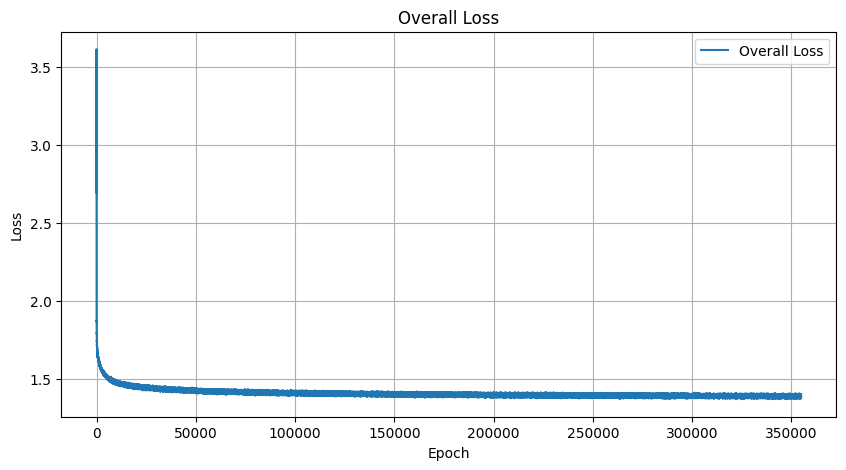

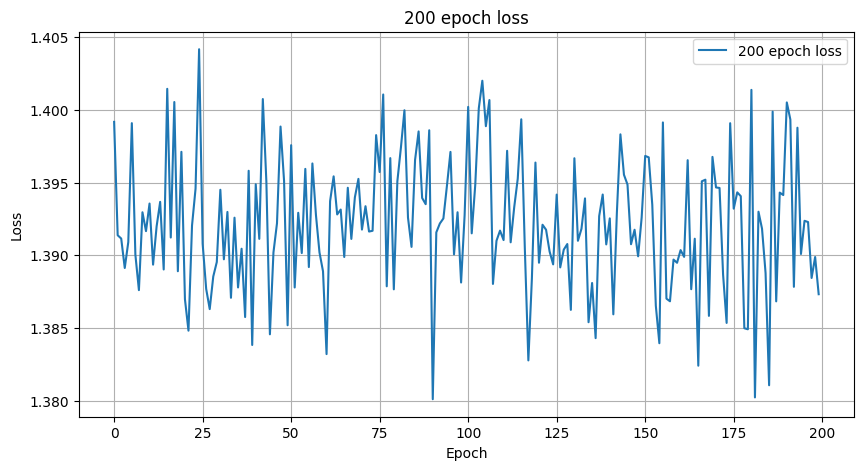

Epoch [1815701], Loss: 1.3935
Epoch [1815702], Loss: 1.4010
Epoch [1815703], Loss: 1.3869
Epoch [1815704], Loss: 1.4021
Epoch [1815705], Loss: 1.3930
Epoch [1815706], Loss: 1.3907
Epoch [1815707], Loss: 1.4001
Epoch [1815708], Loss: 1.3915
Epoch [1815709], Loss: 1.3938
Epoch [1815710], Loss: 1.3992
Epoch [1815711], Loss: 1.3845
Epoch [1815712], Loss: 1.3945
Epoch [1815713], Loss: 1.3991
Epoch [1815714], Loss: 1.3828
Epoch [1815715], Loss: 1.3932
Epoch [1815716], Loss: 1.3934
Epoch [1815717], Loss: 1.3891
Epoch [1815718], Loss: 1.3987
Epoch [1815719], Loss: 1.3945
Epoch [1815720], Loss: 1.3915
Epoch [1815721], Loss: 1.3899
Epoch [1815722], Loss: 1.3901
Epoch [1815723], Loss: 1.3979
Epoch [1815724], Loss: 1.3978
Epoch [1815725], Loss: 1.3873
Epoch [1815726], Loss: 1.3939
Epoch [1815727], Loss: 1.3947
Epoch [1815728], Loss: 1.3891
Epoch [1815729], Loss: 1.3973
Epoch [1815730], Loss: 1.3910
Epoch [1815731], Loss: 1.3956
Epoch [1815732], Loss: 1.3840
Epoch [1815733], Loss: 1.3900
Epoch [181

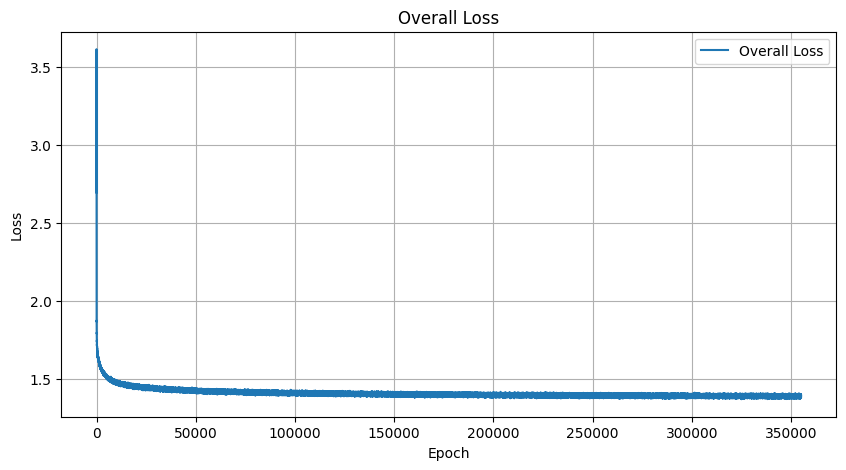

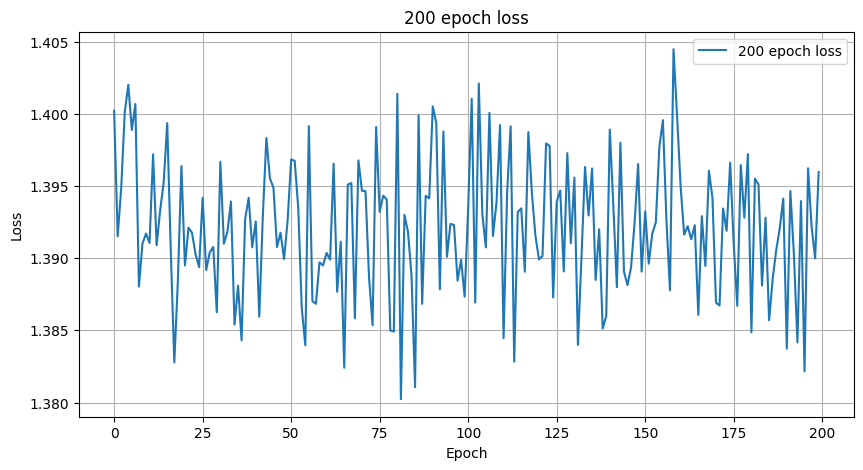

Epoch [1815801], Loss: 1.3926
Epoch [1815802], Loss: 1.3832
Epoch [1815803], Loss: 1.3951
Epoch [1815804], Loss: 1.3877
Epoch [1815805], Loss: 1.3962
Epoch [1815806], Loss: 1.3908
Epoch [1815807], Loss: 1.3903
Epoch [1815808], Loss: 1.3882
Epoch [1815809], Loss: 1.3919
Epoch [1815810], Loss: 1.3975
Epoch [1815811], Loss: 1.3810
Epoch [1815812], Loss: 1.3955
Epoch [1815813], Loss: 1.3968
Epoch [1815814], Loss: 1.3797
Epoch [1815815], Loss: 1.3875
Epoch [1815816], Loss: 1.3885
Epoch [1815817], Loss: 1.3884
Epoch [1815818], Loss: 1.3929
Epoch [1815819], Loss: 1.3866
Epoch [1815820], Loss: 1.3930
Epoch [1815821], Loss: 1.3882
Epoch [1815822], Loss: 1.3933
Epoch [1815823], Loss: 1.3952
Epoch [1815824], Loss: 1.3869
Epoch [1815825], Loss: 1.3922
Epoch [1815826], Loss: 1.3859
Epoch [1815827], Loss: 1.3908
Epoch [1815828], Loss: 1.3935
Epoch [1815829], Loss: 1.3918
Epoch [1815830], Loss: 1.3875
Epoch [1815831], Loss: 1.3943
Epoch [1815832], Loss: 1.3900
Epoch [1815833], Loss: 1.3913
Epoch [181

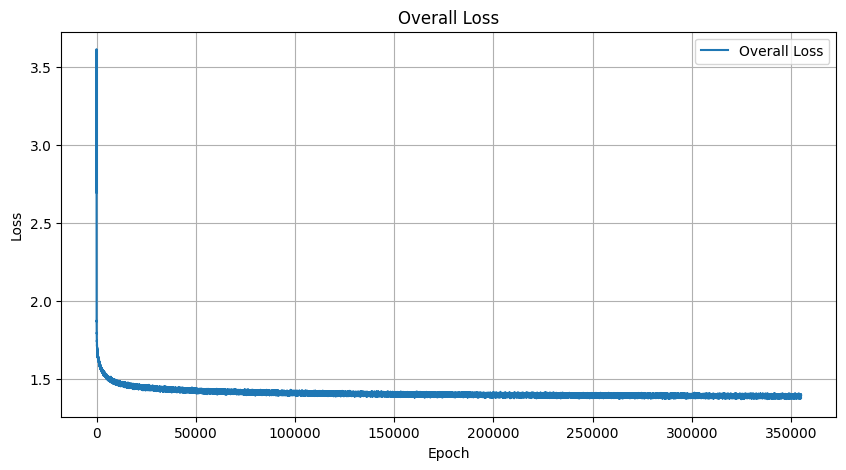

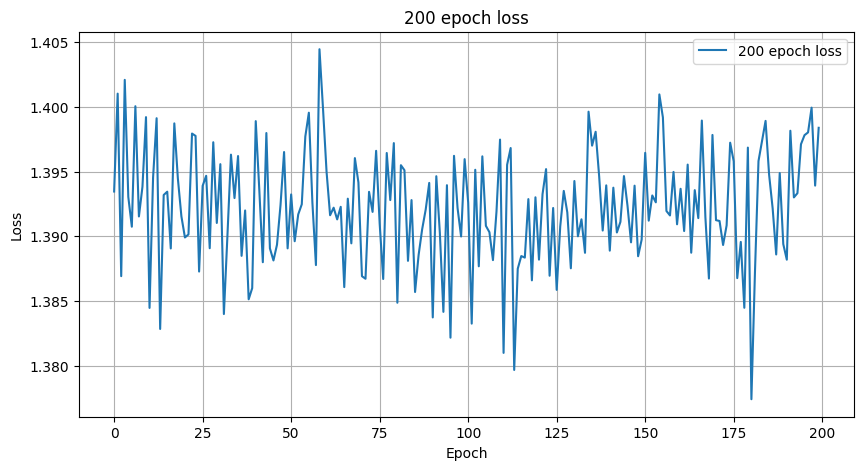

Epoch [1815901], Loss: 1.3915
Epoch [1815902], Loss: 1.3929
Epoch [1815903], Loss: 1.3889
Epoch [1815904], Loss: 1.3854
Epoch [1815905], Loss: 1.4005
Epoch [1815906], Loss: 1.3944
Epoch [1815907], Loss: 1.3895
Epoch [1815908], Loss: 1.3951
Epoch [1815909], Loss: 1.3921
Epoch [1815910], Loss: 1.3932
Epoch [1815911], Loss: 1.3908
Epoch [1815912], Loss: 1.3864
Epoch [1815913], Loss: 1.3874
Epoch [1815914], Loss: 1.3908
Epoch [1815915], Loss: 1.3957
Epoch [1815916], Loss: 1.3954
Epoch [1815917], Loss: 1.3925
Epoch [1815918], Loss: 1.3985
Epoch [1815919], Loss: 1.3901
Epoch [1815920], Loss: 1.3963
Epoch [1815921], Loss: 1.3864
Epoch [1815922], Loss: 1.3929
Epoch [1815923], Loss: 1.3924
Epoch [1815924], Loss: 1.3917
Epoch [1815925], Loss: 1.3922
Epoch [1815926], Loss: 1.4008
Epoch [1815927], Loss: 1.3981
Epoch [1815928], Loss: 1.3842
Epoch [1815929], Loss: 1.3888
Epoch [1815930], Loss: 1.3864
Epoch [1815931], Loss: 1.4015
Epoch [1815932], Loss: 1.3875
Epoch [1815933], Loss: 1.3942
Epoch [181

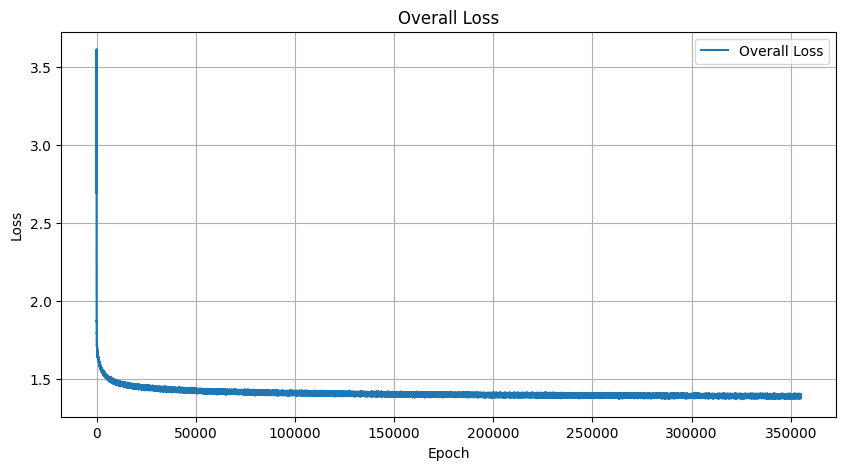

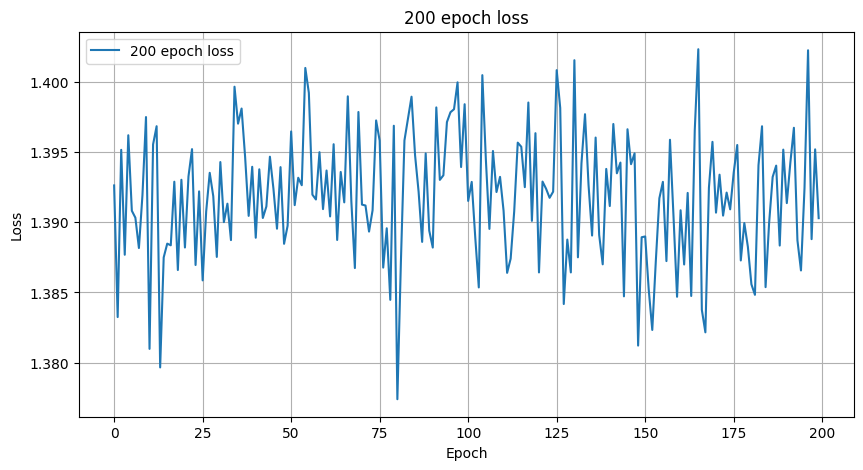

Epoch [1816001], Loss: 1.4014
Epoch [1816002], Loss: 1.3897
Epoch [1816003], Loss: 1.3936
Epoch [1816004], Loss: 1.3975
Epoch [1816005], Loss: 1.3949
Epoch [1816006], Loss: 1.3904
Epoch [1816007], Loss: 1.4016
Epoch [1816008], Loss: 1.3819
Epoch [1816009], Loss: 1.3978
Epoch [1816010], Loss: 1.3941
Epoch [1816011], Loss: 1.3839
Epoch [1816012], Loss: 1.3933
Epoch [1816013], Loss: 1.3923
Epoch [1816014], Loss: 1.3966
Epoch [1816015], Loss: 1.3860
Epoch [1816016], Loss: 1.3875
Epoch [1816017], Loss: 1.3939
Epoch [1816018], Loss: 1.3847
Epoch [1816019], Loss: 1.3950
Epoch [1816020], Loss: 1.3989
Epoch [1816021], Loss: 1.3930
Epoch [1816022], Loss: 1.3847
Epoch [1816023], Loss: 1.3930
Epoch [1816024], Loss: 1.3998
Epoch [1816025], Loss: 1.3916
Epoch [1816026], Loss: 1.3849
Epoch [1816027], Loss: 1.3870
Epoch [1816028], Loss: 1.3873
Epoch [1816029], Loss: 1.3857
Epoch [1816030], Loss: 1.3896
Epoch [1816031], Loss: 1.3943
Epoch [1816032], Loss: 1.3828
Epoch [1816033], Loss: 1.3878
Epoch [181

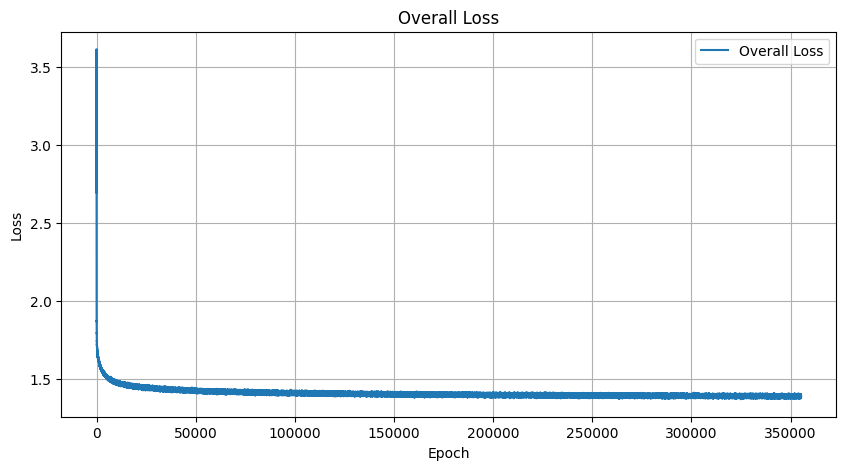

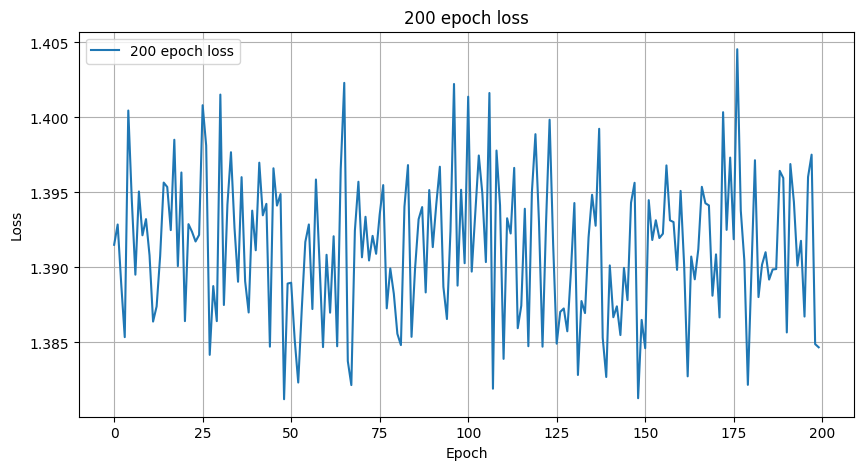

Epoch [1816101], Loss: 1.3948
Epoch [1816102], Loss: 1.3903
Epoch [1816103], Loss: 1.3859
Epoch [1816104], Loss: 1.3972
Epoch [1816105], Loss: 1.3906
Epoch [1816106], Loss: 1.3907
Epoch [1816107], Loss: 1.3923
Epoch [1816108], Loss: 1.3842
Epoch [1816109], Loss: 1.3962
Epoch [1816110], Loss: 1.3934
Epoch [1816111], Loss: 1.3893
Epoch [1816112], Loss: 1.3887
Epoch [1816113], Loss: 1.3841
Epoch [1816114], Loss: 1.3951
Epoch [1816115], Loss: 1.3945
Epoch [1816116], Loss: 1.3881
Epoch [1816117], Loss: 1.3968
Epoch [1816118], Loss: 1.4002
Epoch [1816119], Loss: 1.3925
Epoch [1816120], Loss: 1.3960
Epoch [1816121], Loss: 1.3832
Epoch [1816122], Loss: 1.3953
Epoch [1816123], Loss: 1.3866
Epoch [1816124], Loss: 1.3924
Epoch [1816125], Loss: 1.3966
Epoch [1816126], Loss: 1.3886
Epoch [1816127], Loss: 1.3861
Epoch [1816128], Loss: 1.3878
Epoch [1816129], Loss: 1.3891
Epoch [1816130], Loss: 1.3888
Epoch [1816131], Loss: 1.3915
Epoch [1816132], Loss: 1.3875
Epoch [1816133], Loss: 1.3958
Epoch [181

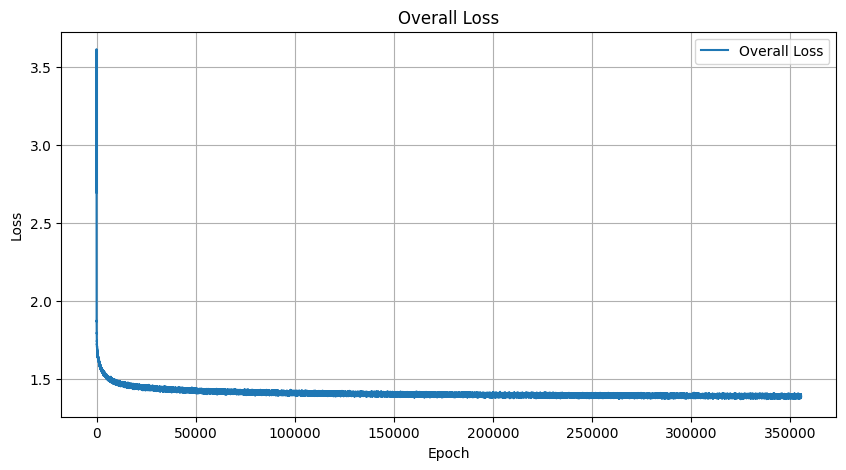

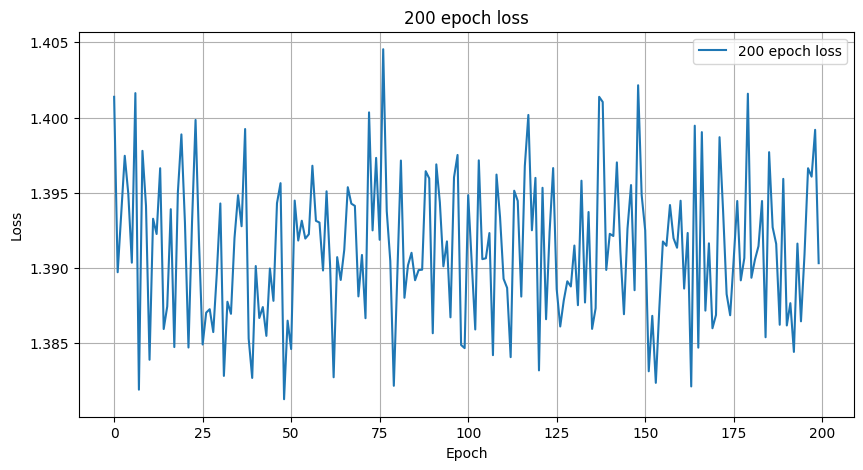

Epoch [1816201], Loss: 1.3846
Epoch [1816202], Loss: 1.3995
Epoch [1816203], Loss: 1.3911
Epoch [1816204], Loss: 1.3917
Epoch [1816205], Loss: 1.3851
Epoch [1816206], Loss: 1.3920
Epoch [1816207], Loss: 1.3880
Epoch [1816208], Loss: 1.3882
Epoch [1816209], Loss: 1.3909
Epoch [1816210], Loss: 1.3927
Epoch [1816211], Loss: 1.3969
Epoch [1816212], Loss: 1.3902
Epoch [1816213], Loss: 1.3857
Epoch [1816214], Loss: 1.3953
Epoch [1816215], Loss: 1.3932
Epoch [1816216], Loss: 1.3867
Epoch [1816217], Loss: 1.3886
Epoch [1816218], Loss: 1.3880
Epoch [1816219], Loss: 1.3879
Epoch [1816220], Loss: 1.3805
Epoch [1816221], Loss: 1.3924
Epoch [1816222], Loss: 1.3861
Epoch [1816223], Loss: 1.3900
Epoch [1816224], Loss: 1.3938
Epoch [1816225], Loss: 1.3988
Epoch [1816226], Loss: 1.3917
Epoch [1816227], Loss: 1.3905
Epoch [1816228], Loss: 1.3865
Epoch [1816229], Loss: 1.3908
Epoch [1816230], Loss: 1.3939
Epoch [1816231], Loss: 1.3897
Epoch [1816232], Loss: 1.3946
Epoch [1816233], Loss: 1.3900
Epoch [181

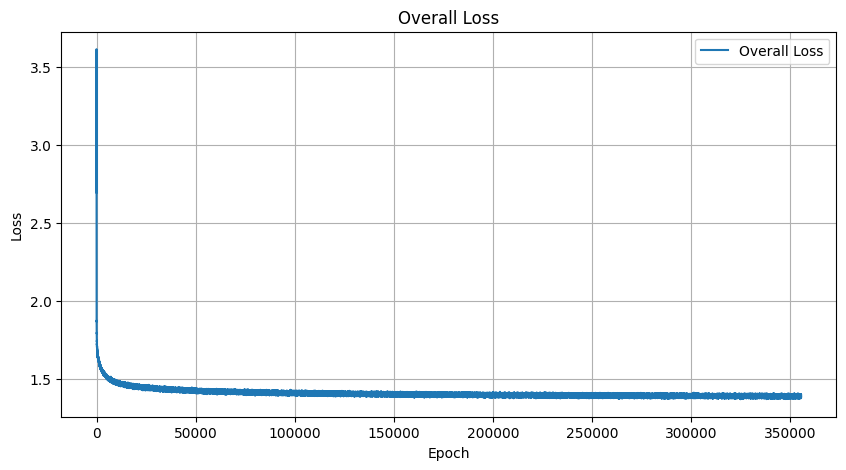

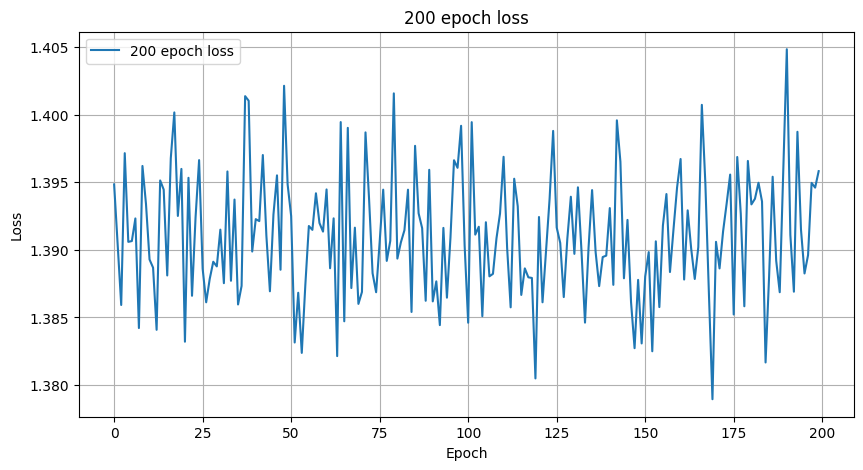

Epoch [1816301], Loss: 1.3849
Epoch [1816302], Loss: 1.3923
Epoch [1816303], Loss: 1.3871
Epoch [1816304], Loss: 1.4007
Epoch [1816305], Loss: 1.3797
Epoch [1816306], Loss: 1.3852
Epoch [1816307], Loss: 1.3909
Epoch [1816308], Loss: 1.3802
Epoch [1816309], Loss: 1.3854
Epoch [1816310], Loss: 1.3942
Epoch [1816311], Loss: 1.3828
Epoch [1816312], Loss: 1.3921
Epoch [1816313], Loss: 1.3866
Epoch [1816314], Loss: 1.3891
Epoch [1816315], Loss: 1.3852
Epoch [1816316], Loss: 1.3822
Epoch [1816317], Loss: 1.3868
Epoch [1816318], Loss: 1.3989
Epoch [1816319], Loss: 1.3929
Epoch [1816320], Loss: 1.4004
Epoch [1816321], Loss: 1.3922
Epoch [1816322], Loss: 1.3866
Epoch [1816323], Loss: 1.3924
Epoch [1816324], Loss: 1.3840
Epoch [1816325], Loss: 1.3862
Epoch [1816326], Loss: 1.3867
Epoch [1816327], Loss: 1.3985
Epoch [1816328], Loss: 1.3916
Epoch [1816329], Loss: 1.3921
Epoch [1816330], Loss: 1.3906
Epoch [1816331], Loss: 1.3852
Epoch [1816332], Loss: 1.4014
Epoch [1816333], Loss: 1.3807
Epoch [181

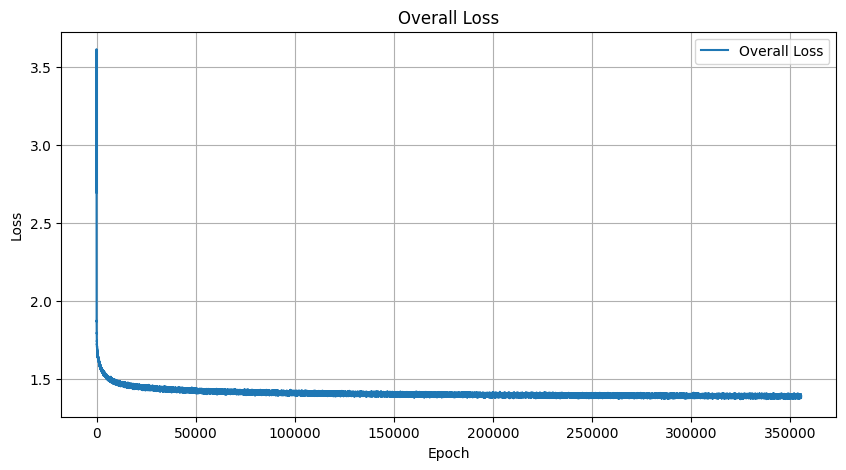

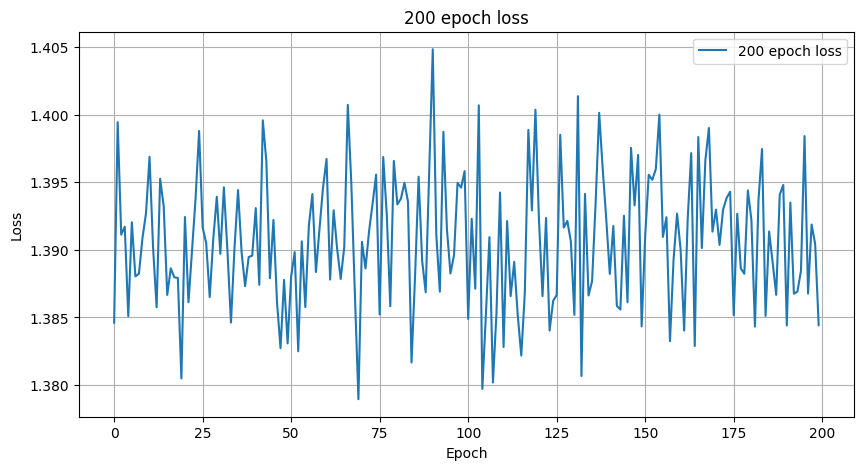

Epoch [1816401], Loss: 1.3813
Epoch [1816402], Loss: 1.3938
Epoch [1816403], Loss: 1.3890
Epoch [1816404], Loss: 1.3996
Epoch [1816405], Loss: 1.3909
Epoch [1816406], Loss: 1.3909
Epoch [1816407], Loss: 1.3925
Epoch [1816408], Loss: 1.3913
Epoch [1816409], Loss: 1.3997
Epoch [1816410], Loss: 1.3818
Epoch [1816411], Loss: 1.3955
Epoch [1816412], Loss: 1.4008
Epoch [1816413], Loss: 1.3930
Epoch [1816414], Loss: 1.3803
Epoch [1816415], Loss: 1.3844
Epoch [1816416], Loss: 1.3921
Epoch [1816417], Loss: 1.3924
Epoch [1816418], Loss: 1.3831
Epoch [1816419], Loss: 1.4003
Epoch [1816420], Loss: 1.3893
Epoch [1816421], Loss: 1.3837
Epoch [1816422], Loss: 1.3877
Epoch [1816423], Loss: 1.3892
Epoch [1816424], Loss: 1.3908
Epoch [1816425], Loss: 1.3917
Epoch [1816426], Loss: 1.3877
Epoch [1816427], Loss: 1.3985
Epoch [1816428], Loss: 1.3927
Epoch [1816429], Loss: 1.3880
Epoch [1816430], Loss: 1.3984
Epoch [1816431], Loss: 1.3997
Epoch [1816432], Loss: 1.3906
Epoch [1816433], Loss: 1.4030
Epoch [181

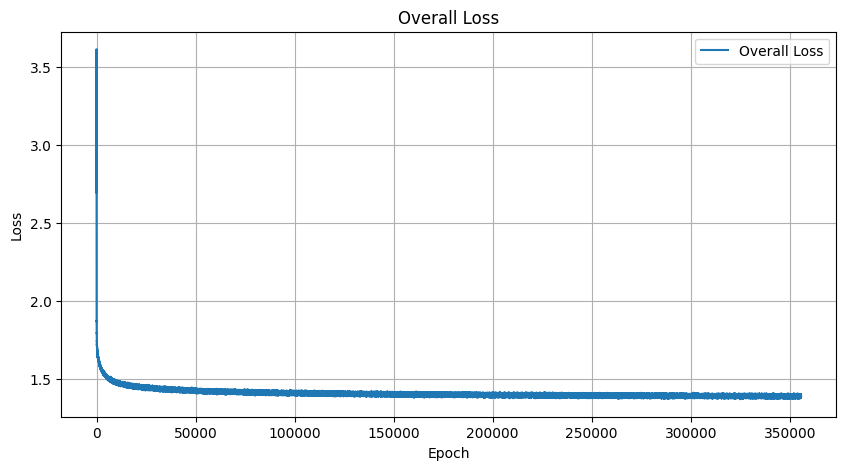

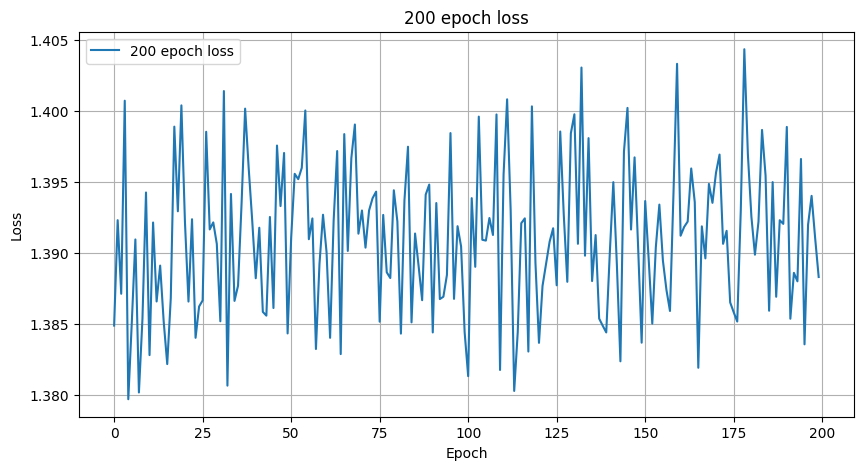

Epoch [1816501], Loss: 1.3878
Epoch [1816502], Loss: 1.3925
Epoch [1816503], Loss: 1.3979
Epoch [1816504], Loss: 1.3963
Epoch [1816505], Loss: 1.3933
Epoch [1816506], Loss: 1.3902
Epoch [1816507], Loss: 1.3946
Epoch [1816508], Loss: 1.3969
Epoch [1816509], Loss: 1.3924
Epoch [1816510], Loss: 1.3885
Epoch [1816511], Loss: 1.3970
Epoch [1816512], Loss: 1.3934
Epoch [1816513], Loss: 1.3918
Epoch [1816514], Loss: 1.4018
Epoch [1816515], Loss: 1.3837
Epoch [1816516], Loss: 1.4020
Epoch [1816517], Loss: 1.4014
Epoch [1816518], Loss: 1.3917
Epoch [1816519], Loss: 1.3977
Epoch [1816520], Loss: 1.3909
Epoch [1816521], Loss: 1.3926
Epoch [1816522], Loss: 1.3989
Epoch [1816523], Loss: 1.3889
Epoch [1816524], Loss: 1.3992
Epoch [1816525], Loss: 1.4036
Epoch [1816526], Loss: 1.3919
Epoch [1816527], Loss: 1.3937
Epoch [1816528], Loss: 1.3854
Epoch [1816529], Loss: 1.3899
Epoch [1816530], Loss: 1.3904
Epoch [1816531], Loss: 1.3894
Epoch [1816532], Loss: 1.3874
Epoch [1816533], Loss: 1.3857
Epoch [181

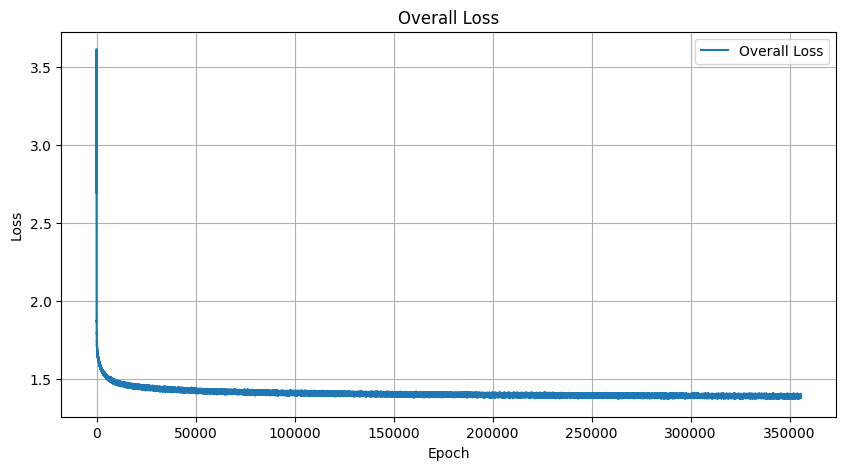

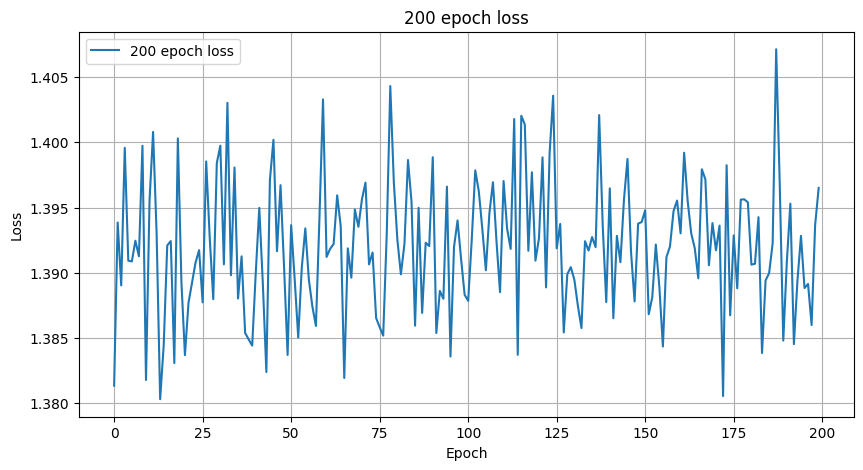

Epoch [1816601], Loss: 1.3959
Epoch [1816602], Loss: 1.3999
Epoch [1816603], Loss: 1.4000
Epoch [1816604], Loss: 1.3972
Epoch [1816605], Loss: 1.3923
Epoch [1816606], Loss: 1.3964
Epoch [1816607], Loss: 1.3870
Epoch [1816608], Loss: 1.3936
Epoch [1816609], Loss: 1.3931
Epoch [1816610], Loss: 1.3901
Epoch [1816611], Loss: 1.3968
Epoch [1816612], Loss: 1.3901
Epoch [1816613], Loss: 1.3928
Epoch [1816614], Loss: 1.3955
Epoch [1816615], Loss: 1.3863
Epoch [1816616], Loss: 1.3967
Epoch [1816617], Loss: 1.3867
Epoch [1816618], Loss: 1.3895
Epoch [1816619], Loss: 1.3926
Epoch [1816620], Loss: 1.3887
Epoch [1816621], Loss: 1.3953
Epoch [1816622], Loss: 1.3940
Epoch [1816623], Loss: 1.3951
Epoch [1816624], Loss: 1.3905
Epoch [1816625], Loss: 1.3857
Epoch [1816626], Loss: 1.3831
Epoch [1816627], Loss: 1.3901
Epoch [1816628], Loss: 1.3955
Epoch [1816629], Loss: 1.3944
Epoch [1816630], Loss: 1.3963
Epoch [1816631], Loss: 1.3980
Epoch [1816632], Loss: 1.3966
Epoch [1816633], Loss: 1.3974
Epoch [181

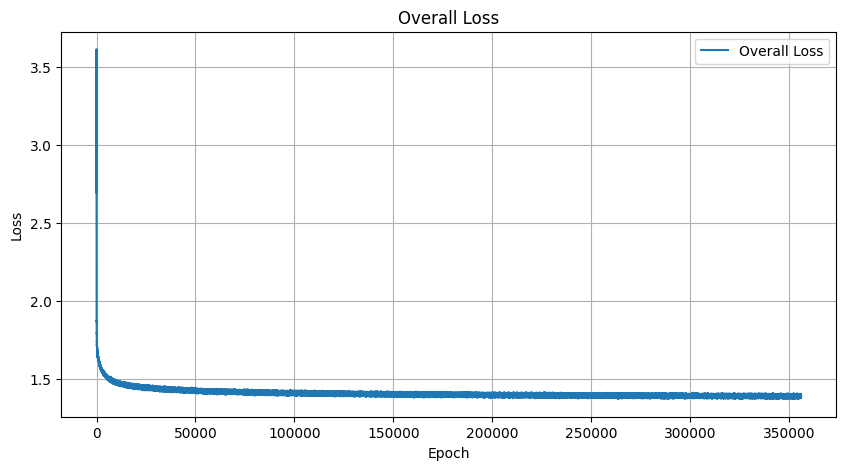

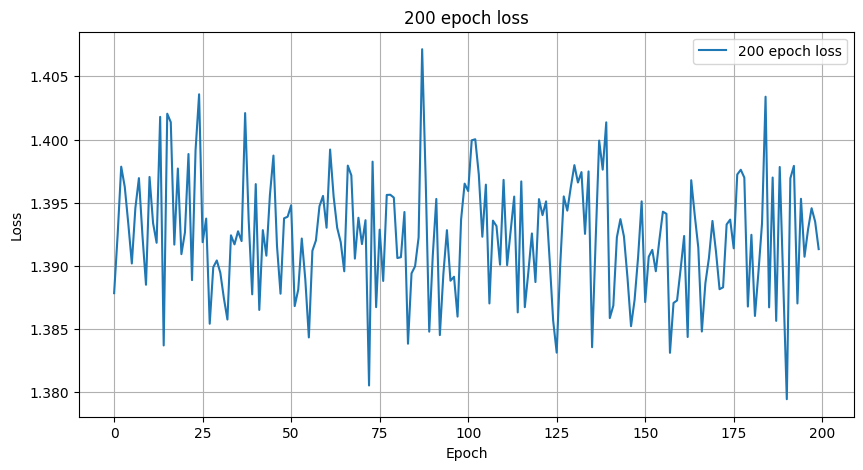

Epoch [1816701], Loss: 1.3955
Epoch [1816702], Loss: 1.3877
Epoch [1816703], Loss: 1.3944
Epoch [1816704], Loss: 1.3909
Epoch [1816705], Loss: 1.4016
Epoch [1816706], Loss: 1.3885
Epoch [1816707], Loss: 1.3916
Epoch [1816708], Loss: 1.3985
Epoch [1816709], Loss: 1.3951
Epoch [1816710], Loss: 1.3946
Epoch [1816711], Loss: 1.3940
Epoch [1816712], Loss: 1.3864
Epoch [1816713], Loss: 1.3910
Epoch [1816714], Loss: 1.4009
Epoch [1816715], Loss: 1.3832
Epoch [1816716], Loss: 1.3894
Epoch [1816717], Loss: 1.3909
Epoch [1816718], Loss: 1.3898
Epoch [1816719], Loss: 1.3990
Epoch [1816720], Loss: 1.3856
Epoch [1816721], Loss: 1.3766
Epoch [1816722], Loss: 1.3818
Epoch [1816723], Loss: 1.3994
Epoch [1816724], Loss: 1.3858
Epoch [1816725], Loss: 1.3917
Epoch [1816726], Loss: 1.3953
Epoch [1816727], Loss: 1.3939
Epoch [1816728], Loss: 1.3907
Epoch [1816729], Loss: 1.3998
Epoch [1816730], Loss: 1.3885
Epoch [1816731], Loss: 1.3937
Epoch [1816732], Loss: 1.3874
Epoch [1816733], Loss: 1.3938
Epoch [181

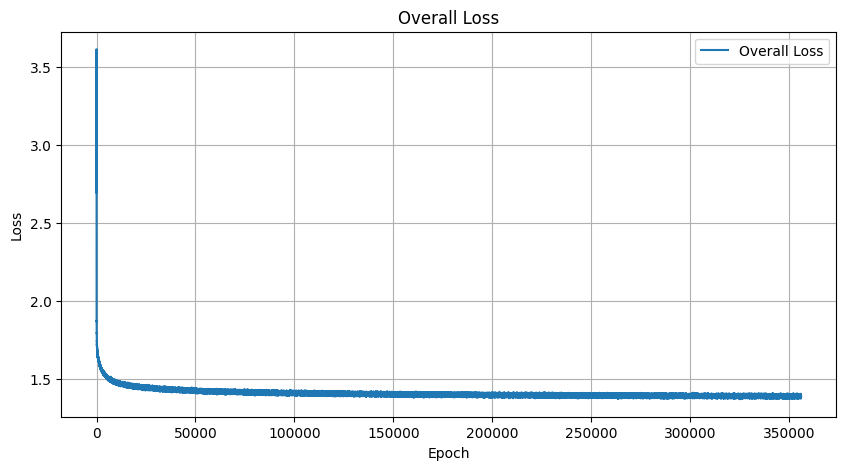

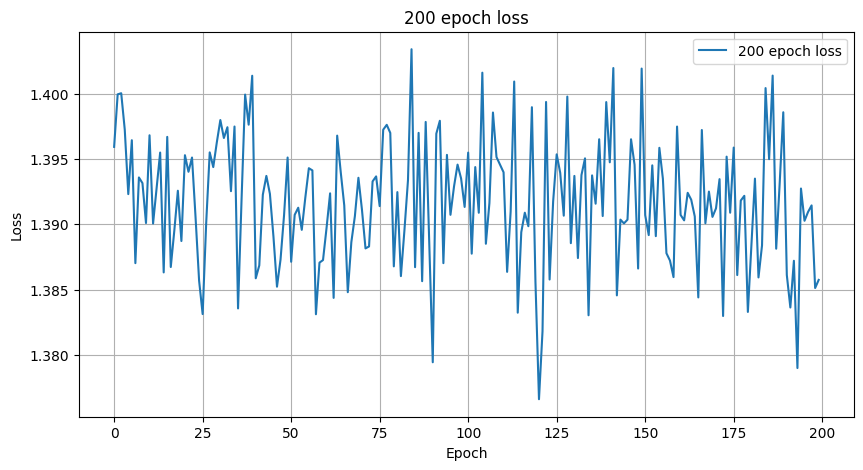

Epoch [1816801], Loss: 1.3931
Epoch [1816802], Loss: 1.3981
Epoch [1816803], Loss: 1.3837
Epoch [1816804], Loss: 1.3847
Epoch [1816805], Loss: 1.3935
Epoch [1816806], Loss: 1.3921
Epoch [1816807], Loss: 1.3869
Epoch [1816808], Loss: 1.3983
Epoch [1816809], Loss: 1.3907
Epoch [1816810], Loss: 1.3917
Epoch [1816811], Loss: 1.3939
Epoch [1816812], Loss: 1.3977
Epoch [1816813], Loss: 1.3882
Epoch [1816814], Loss: 1.3890
Epoch [1816815], Loss: 1.3877
Epoch [1816816], Loss: 1.3942
Epoch [1816817], Loss: 1.3927
Epoch [1816818], Loss: 1.3923
Epoch [1816819], Loss: 1.3951
Epoch [1816820], Loss: 1.3859
Epoch [1816821], Loss: 1.3988
Epoch [1816822], Loss: 1.3866
Epoch [1816823], Loss: 1.3853
Epoch [1816824], Loss: 1.3822
Epoch [1816825], Loss: 1.3952
Epoch [1816826], Loss: 1.3938
Epoch [1816827], Loss: 1.3991
Epoch [1816828], Loss: 1.3913
Epoch [1816829], Loss: 1.3903
Epoch [1816830], Loss: 1.3959
Epoch [1816831], Loss: 1.3948
Epoch [1816832], Loss: 1.3855
Epoch [1816833], Loss: 1.3940
Epoch [181

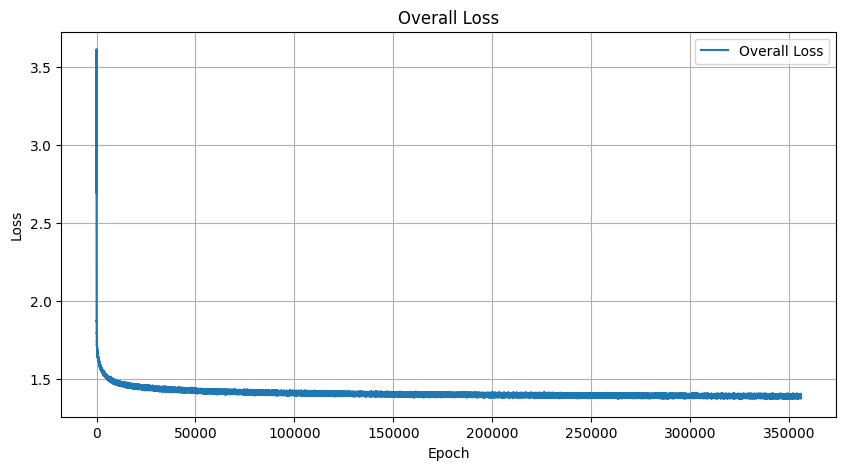

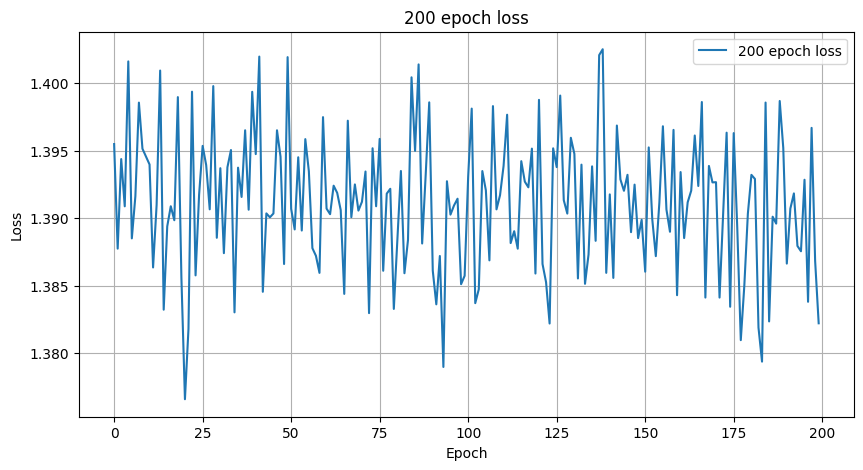

Epoch [1816901], Loss: 1.3900
Epoch [1816902], Loss: 1.3914
Epoch [1816903], Loss: 1.3954
Epoch [1816904], Loss: 1.3798
Epoch [1816905], Loss: 1.3937
Epoch [1816906], Loss: 1.3798
Epoch [1816907], Loss: 1.3794
Epoch [1816908], Loss: 1.4055
Epoch [1816909], Loss: 1.3867
Epoch [1816910], Loss: 1.3923
Epoch [1816911], Loss: 1.3940
Epoch [1816912], Loss: 1.3868
Epoch [1816913], Loss: 1.3925
Epoch [1816914], Loss: 1.3996
Epoch [1816915], Loss: 1.3955
Epoch [1816916], Loss: 1.3929
Epoch [1816917], Loss: 1.3997
Epoch [1816918], Loss: 1.4003
Epoch [1816919], Loss: 1.3841
Epoch [1816920], Loss: 1.3888
Epoch [1816921], Loss: 1.3878
Epoch [1816922], Loss: 1.3897
Epoch [1816923], Loss: 1.3815
Epoch [1816924], Loss: 1.3894
Epoch [1816925], Loss: 1.3953
Epoch [1816926], Loss: 1.3917
Epoch [1816927], Loss: 1.3911
Epoch [1816928], Loss: 1.3945
Epoch [1816929], Loss: 1.3877
Epoch [1816930], Loss: 1.3926
Epoch [1816931], Loss: 1.3916
Epoch [1816932], Loss: 1.3876
Epoch [1816933], Loss: 1.3858
Epoch [181

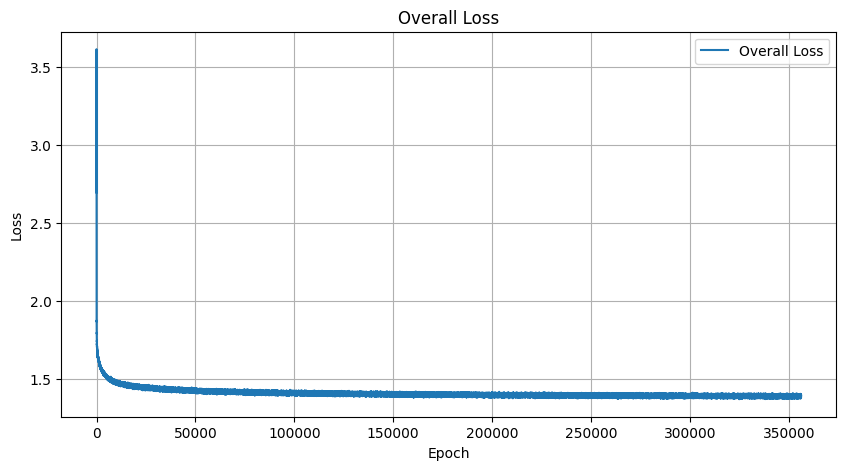

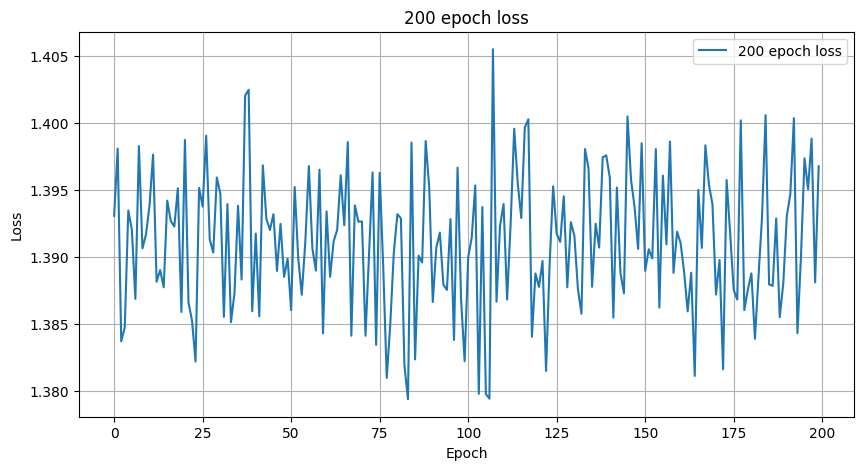

Epoch [1817001], Loss: 1.3954
Epoch [1817002], Loss: 1.3919
Epoch [1817003], Loss: 1.3900
Epoch [1817004], Loss: 1.3892
Epoch [1817005], Loss: 1.3842
Epoch [1817006], Loss: 1.3906
Epoch [1817007], Loss: 1.3953
Epoch [1817008], Loss: 1.3936
Epoch [1817009], Loss: 1.3899
Epoch [1817010], Loss: 1.3922
Epoch [1817011], Loss: 1.3937
Epoch [1817012], Loss: 1.3900
Epoch [1817013], Loss: 1.3792
Epoch [1817014], Loss: 1.3943
Epoch [1817015], Loss: 1.3942
Epoch [1817016], Loss: 1.3923
Epoch [1817017], Loss: 1.3813
Epoch [1817018], Loss: 1.3896
Epoch [1817019], Loss: 1.3896
Epoch [1817020], Loss: 1.3797
Epoch [1817021], Loss: 1.4047
Epoch [1817022], Loss: 1.3851
Epoch [1817023], Loss: 1.3837
Epoch [1817024], Loss: 1.3846
Epoch [1817025], Loss: 1.3932
Epoch [1817026], Loss: 1.3923
Epoch [1817027], Loss: 1.3878
Epoch [1817028], Loss: 1.3943
Epoch [1817029], Loss: 1.3998
Epoch [1817030], Loss: 1.3836
Epoch [1817031], Loss: 1.3844
Epoch [1817032], Loss: 1.3885
Epoch [1817033], Loss: 1.3861
Epoch [181

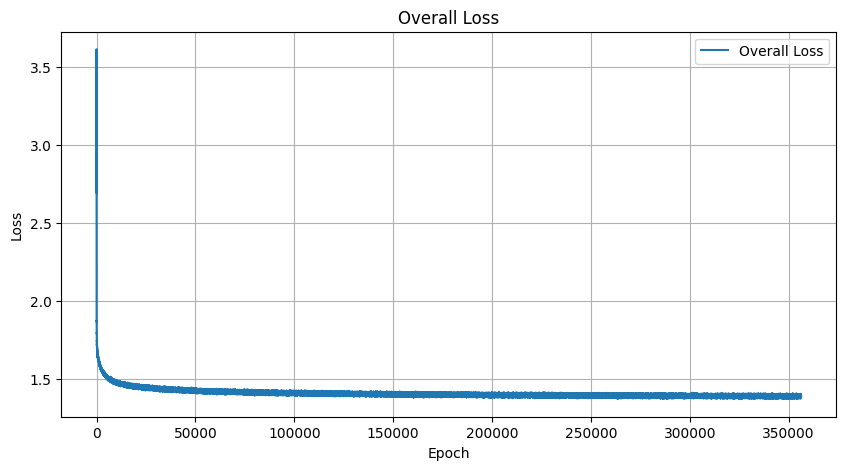

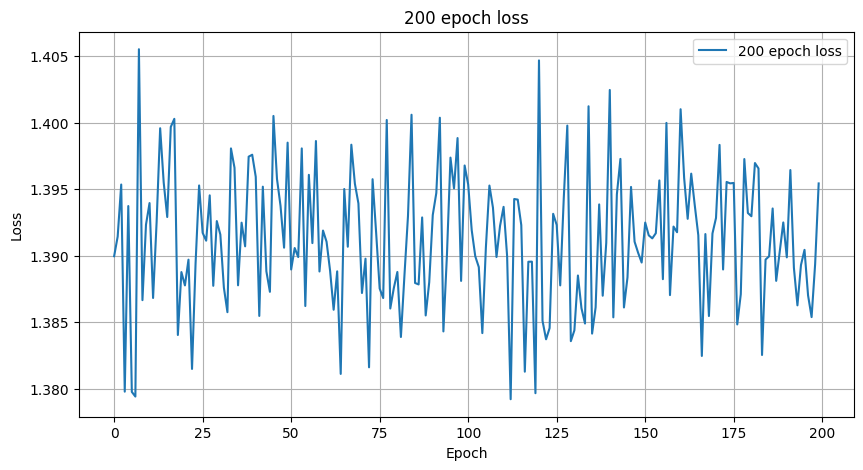

Epoch [1817101], Loss: 1.3952
Epoch [1817102], Loss: 1.3827
Epoch [1817103], Loss: 1.3881
Epoch [1817104], Loss: 1.3866
Epoch [1817105], Loss: 1.3913
Epoch [1817106], Loss: 1.3990
Epoch [1817107], Loss: 1.3866
Epoch [1817108], Loss: 1.3906
Epoch [1817109], Loss: 1.3918
Epoch [1817110], Loss: 1.3837
Epoch [1817111], Loss: 1.3949
Epoch [1817112], Loss: 1.3914
Epoch [1817113], Loss: 1.3986
Epoch [1817114], Loss: 1.3997
Epoch [1817115], Loss: 1.3954
Epoch [1817116], Loss: 1.3876
Epoch [1817117], Loss: 1.3921
Epoch [1817118], Loss: 1.3869
Epoch [1817119], Loss: 1.3858
Epoch [1817120], Loss: 1.3850
Epoch [1817121], Loss: 1.3954
Epoch [1817122], Loss: 1.3918
Epoch [1817123], Loss: 1.3926
Epoch [1817124], Loss: 1.3900
Epoch [1817125], Loss: 1.3980
Epoch [1817126], Loss: 1.3897
Epoch [1817127], Loss: 1.3950
Epoch [1817128], Loss: 1.3876
Epoch [1817129], Loss: 1.3897
Epoch [1817130], Loss: 1.3953
Epoch [1817131], Loss: 1.3994
Epoch [1817132], Loss: 1.3850
Epoch [1817133], Loss: 1.3847
Epoch [181

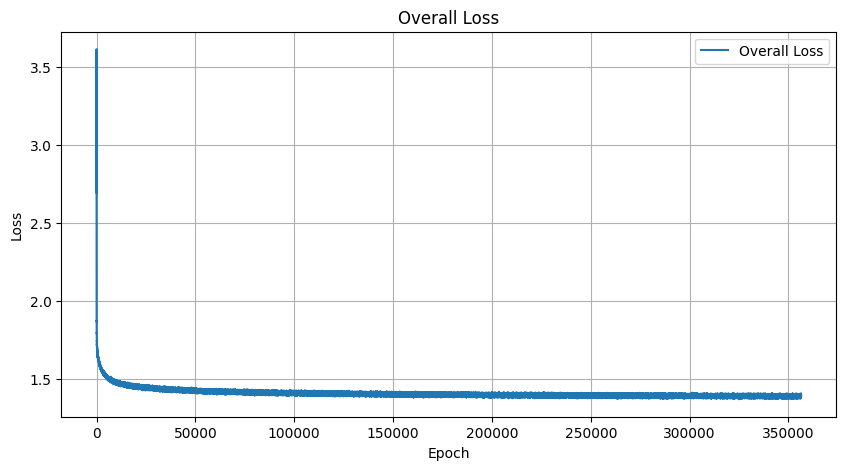

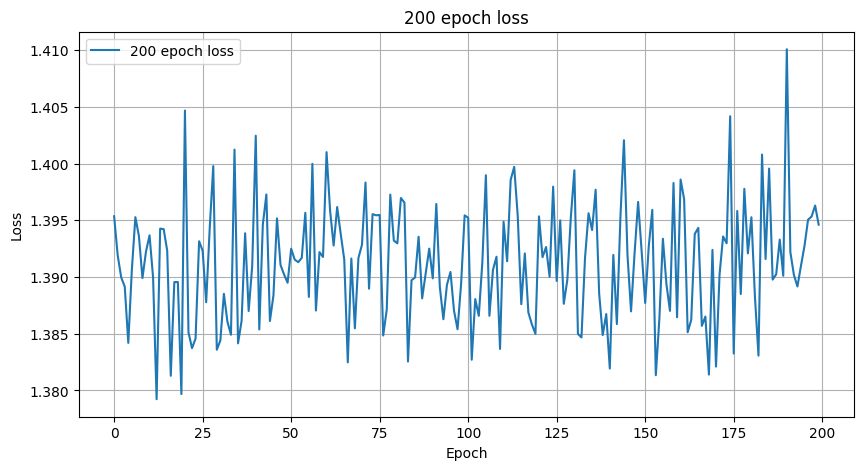

Epoch [1817201], Loss: 1.3937
Epoch [1817202], Loss: 1.3936
Epoch [1817203], Loss: 1.3919
Epoch [1817204], Loss: 1.4021
Epoch [1817205], Loss: 1.3943
Epoch [1817206], Loss: 1.3864
Epoch [1817207], Loss: 1.3986
Epoch [1817208], Loss: 1.3976
Epoch [1817209], Loss: 1.3900
Epoch [1817210], Loss: 1.3911
Epoch [1817211], Loss: 1.3895
Epoch [1817212], Loss: 1.3982
Epoch [1817213], Loss: 1.3908
Epoch [1817214], Loss: 1.3897
Epoch [1817215], Loss: 1.3823
Epoch [1817216], Loss: 1.3931
Epoch [1817217], Loss: 1.4001
Epoch [1817218], Loss: 1.3910
Epoch [1817219], Loss: 1.3859
Epoch [1817220], Loss: 1.3918
Epoch [1817221], Loss: 1.3892
Epoch [1817222], Loss: 1.3992
Epoch [1817223], Loss: 1.3879
Epoch [1817224], Loss: 1.3866
Epoch [1817225], Loss: 1.3978
Epoch [1817226], Loss: 1.3793
Epoch [1817227], Loss: 1.3908
Epoch [1817228], Loss: 1.3915
Epoch [1817229], Loss: 1.3913
Epoch [1817230], Loss: 1.3977
Epoch [1817231], Loss: 1.3989
Epoch [1817232], Loss: 1.3833
Epoch [1817233], Loss: 1.3945
Epoch [181

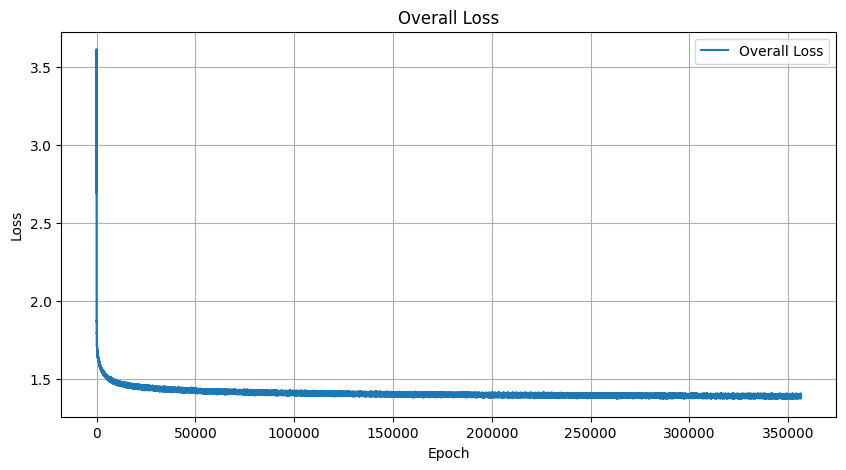

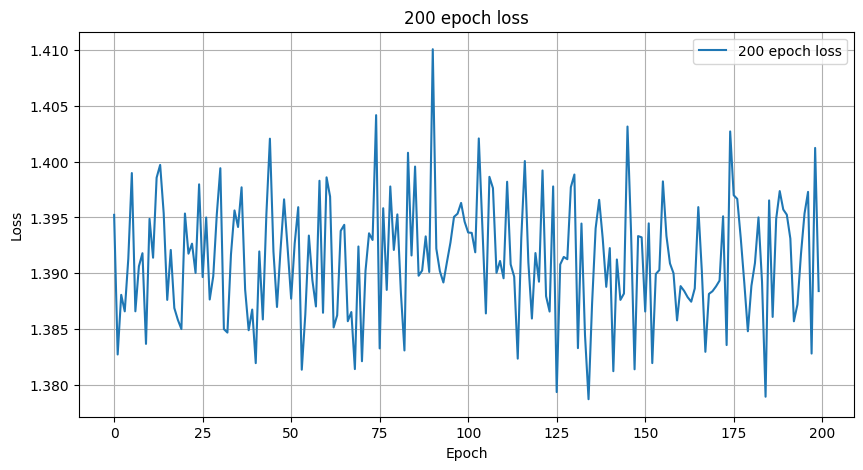

Epoch [1817301], Loss: 1.3748
Epoch [1817302], Loss: 1.3833
Epoch [1817303], Loss: 1.3894
Epoch [1817304], Loss: 1.3960
Epoch [1817305], Loss: 1.3896
Epoch [1817306], Loss: 1.3953
Epoch [1817307], Loss: 1.4005
Epoch [1817308], Loss: 1.3913
Epoch [1817309], Loss: 1.3958
Epoch [1817310], Loss: 1.3916
Epoch [1817311], Loss: 1.3895
Epoch [1817312], Loss: 1.3950
Epoch [1817313], Loss: 1.3991
Epoch [1817314], Loss: 1.4003
Epoch [1817315], Loss: 1.3928
Epoch [1817316], Loss: 1.3927
Epoch [1817317], Loss: 1.3844
Epoch [1817318], Loss: 1.3903
Epoch [1817319], Loss: 1.4013
Epoch [1817320], Loss: 1.3947
Epoch [1817321], Loss: 1.3916
Epoch [1817322], Loss: 1.3882
Epoch [1817323], Loss: 1.3909
Epoch [1817324], Loss: 1.3892
Epoch [1817325], Loss: 1.3930
Epoch [1817326], Loss: 1.3868
Epoch [1817327], Loss: 1.3946
Epoch [1817328], Loss: 1.3890
Epoch [1817329], Loss: 1.3928
Epoch [1817330], Loss: 1.3901
Epoch [1817331], Loss: 1.3897
Epoch [1817332], Loss: 1.3927
Epoch [1817333], Loss: 1.3879
Epoch [181

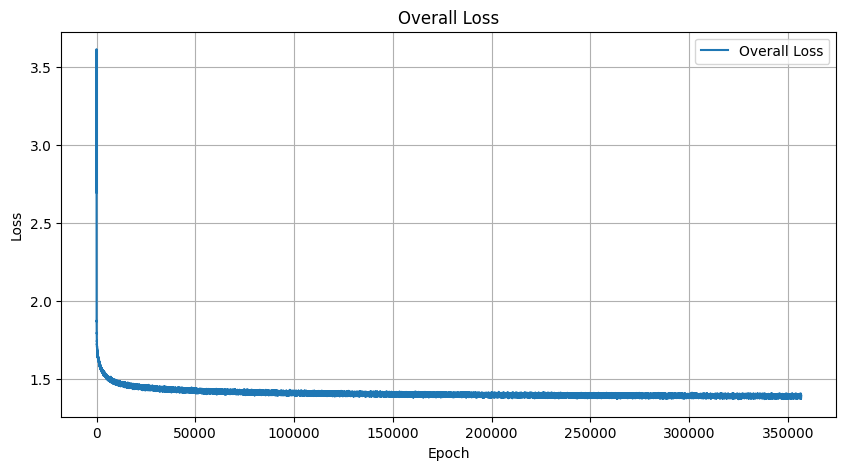

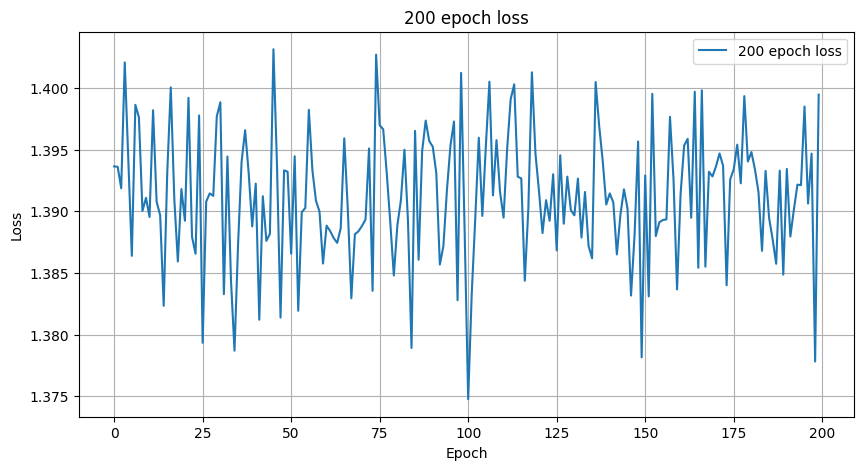

Epoch [1817401], Loss: 1.3863
Epoch [1817402], Loss: 1.3920
Epoch [1817403], Loss: 1.3848
Epoch [1817404], Loss: 1.3892
Epoch [1817405], Loss: 1.3973
Epoch [1817406], Loss: 1.3830
Epoch [1817407], Loss: 1.3911
Epoch [1817408], Loss: 1.3949
Epoch [1817409], Loss: 1.3945
Epoch [1817410], Loss: 1.3947
Epoch [1817411], Loss: 1.3872
Epoch [1817412], Loss: 1.4004
Epoch [1817413], Loss: 1.3833
Epoch [1817414], Loss: 1.3919
Epoch [1817415], Loss: 1.3951
Epoch [1817416], Loss: 1.3940
Epoch [1817417], Loss: 1.3942
Epoch [1817418], Loss: 1.3846
Epoch [1817419], Loss: 1.3928
Epoch [1817420], Loss: 1.3936
Epoch [1817421], Loss: 1.4002
Epoch [1817422], Loss: 1.3926
Epoch [1817423], Loss: 1.3988
Epoch [1817424], Loss: 1.3919
Epoch [1817425], Loss: 1.3951
Epoch [1817426], Loss: 1.3849
Epoch [1817427], Loss: 1.3898
Epoch [1817428], Loss: 1.3919
Epoch [1817429], Loss: 1.3882
Epoch [1817430], Loss: 1.3934
Epoch [1817431], Loss: 1.3909
Epoch [1817432], Loss: 1.3918
Epoch [1817433], Loss: 1.3955
Epoch [181

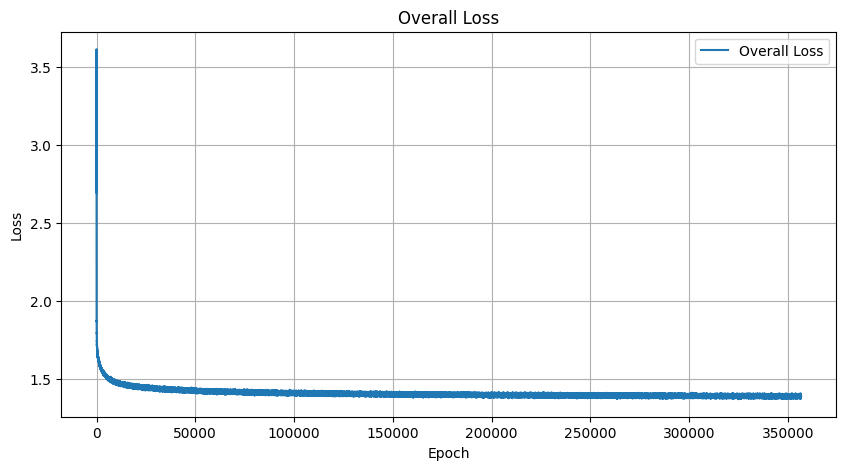

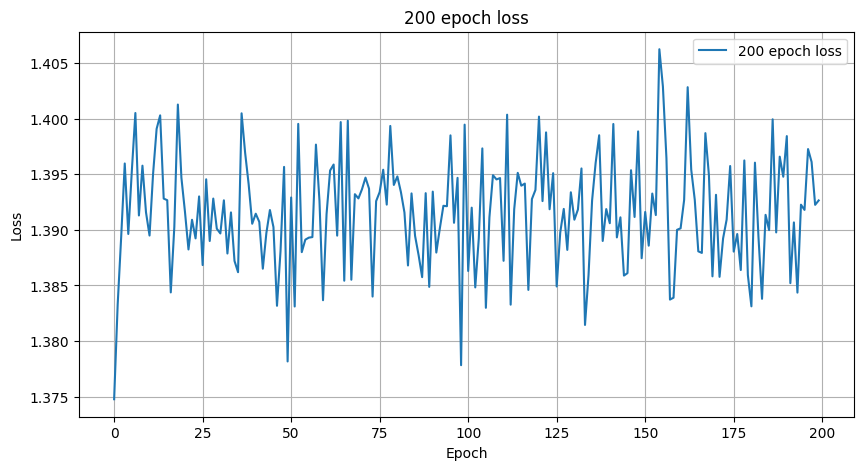

Epoch [1817501], Loss: 1.3852
Epoch [1817502], Loss: 1.3893
Epoch [1817503], Loss: 1.3968
Epoch [1817504], Loss: 1.3975
Epoch [1817505], Loss: 1.4037
Epoch [1817506], Loss: 1.3953
Epoch [1817507], Loss: 1.3972
Epoch [1817508], Loss: 1.3988
Epoch [1817509], Loss: 1.3883
Epoch [1817510], Loss: 1.3870
Epoch [1817511], Loss: 1.3899
Epoch [1817512], Loss: 1.3910
Epoch [1817513], Loss: 1.3920
Epoch [1817514], Loss: 1.3945
Epoch [1817515], Loss: 1.3958
Epoch [1817516], Loss: 1.3981
Epoch [1817517], Loss: 1.3887
Epoch [1817518], Loss: 1.3910
Epoch [1817519], Loss: 1.3939
Epoch [1817520], Loss: 1.3962
Epoch [1817521], Loss: 1.3912
Epoch [1817522], Loss: 1.3881
Epoch [1817523], Loss: 1.4018
Epoch [1817524], Loss: 1.3880
Epoch [1817525], Loss: 1.3900
Epoch [1817526], Loss: 1.3822
Epoch [1817527], Loss: 1.3906
Epoch [1817528], Loss: 1.3877
Epoch [1817529], Loss: 1.3986
Epoch [1817530], Loss: 1.3889
Epoch [1817531], Loss: 1.3845
Epoch [1817532], Loss: 1.4008
Epoch [1817533], Loss: 1.3939
Epoch [181

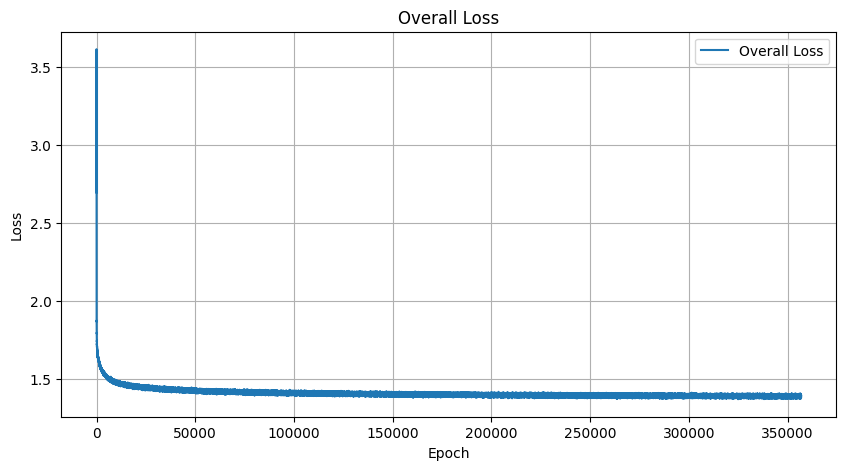

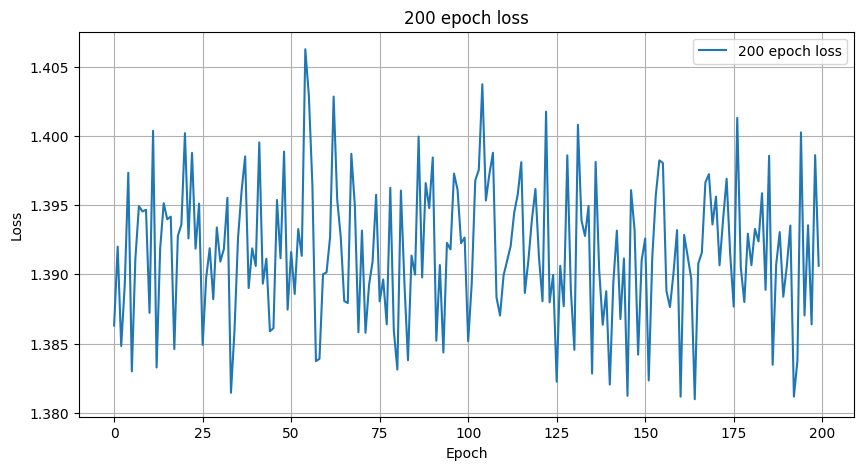

Epoch [1817601], Loss: 1.3947
Epoch [1817602], Loss: 1.3974
Epoch [1817603], Loss: 1.3898
Epoch [1817604], Loss: 1.3894
Epoch [1817605], Loss: 1.3896
Epoch [1817606], Loss: 1.3937
Epoch [1817607], Loss: 1.3918
Epoch [1817608], Loss: 1.3850
Epoch [1817609], Loss: 1.3970
Epoch [1817610], Loss: 1.3853
Epoch [1817611], Loss: 1.3841
Epoch [1817612], Loss: 1.3955
Epoch [1817613], Loss: 1.3845
Epoch [1817614], Loss: 1.3979
Epoch [1817615], Loss: 1.3891
Epoch [1817616], Loss: 1.3870
Epoch [1817617], Loss: 1.3924
Epoch [1817618], Loss: 1.3852
Epoch [1817619], Loss: 1.3863
Epoch [1817620], Loss: 1.3862
Epoch [1817621], Loss: 1.4019
Epoch [1817622], Loss: 1.3927
Epoch [1817623], Loss: 1.3945
Epoch [1817624], Loss: 1.3949
Epoch [1817625], Loss: 1.3946
Epoch [1817626], Loss: 1.3877
Epoch [1817627], Loss: 1.3902
Epoch [1817628], Loss: 1.3971
Epoch [1817629], Loss: 1.3953
Epoch [1817630], Loss: 1.3931
Epoch [1817631], Loss: 1.3958
Epoch [1817632], Loss: 1.3957
Epoch [1817633], Loss: 1.3915
Epoch [181

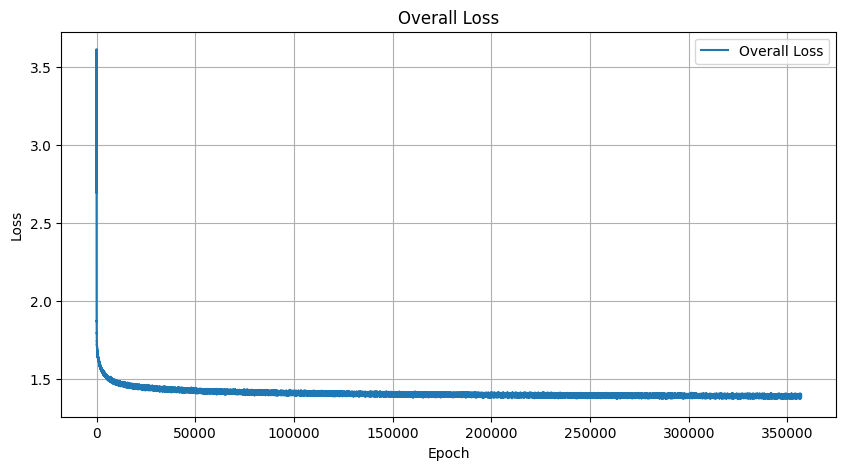

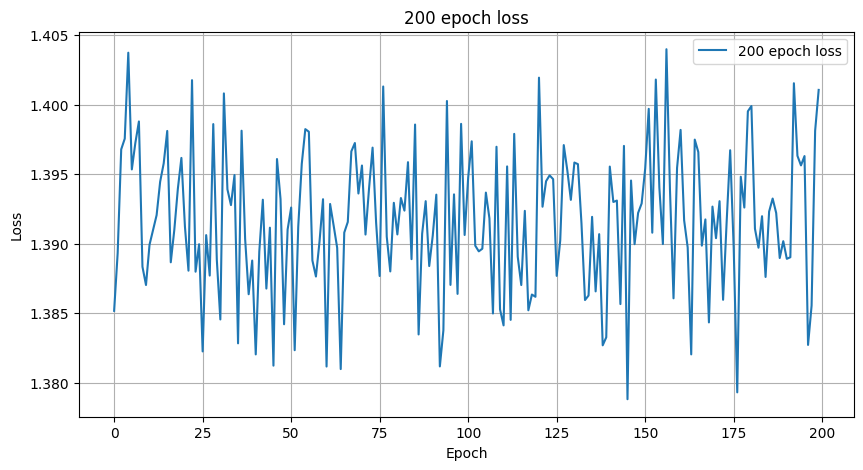

Epoch [1817701], Loss: 1.3903
Epoch [1817702], Loss: 1.3907
Epoch [1817703], Loss: 1.3972
Epoch [1817704], Loss: 1.3867
Epoch [1817705], Loss: 1.3840
Epoch [1817706], Loss: 1.3906
Epoch [1817707], Loss: 1.3917
Epoch [1817708], Loss: 1.3879
Epoch [1817709], Loss: 1.3993
Epoch [1817710], Loss: 1.3839
Epoch [1817711], Loss: 1.3956
Epoch [1817712], Loss: 1.3919
Epoch [1817713], Loss: 1.3880
Epoch [1817714], Loss: 1.3815
Epoch [1817715], Loss: 1.3856
Epoch [1817716], Loss: 1.3841
Epoch [1817717], Loss: 1.3898
Epoch [1817718], Loss: 1.3860
Epoch [1817719], Loss: 1.3942
Epoch [1817720], Loss: 1.3866
Epoch [1817721], Loss: 1.3884
Epoch [1817722], Loss: 1.3911
Epoch [1817723], Loss: 1.3934
Epoch [1817724], Loss: 1.3879
Epoch [1817725], Loss: 1.3867
Epoch [1817726], Loss: 1.3773
Epoch [1817727], Loss: 1.3972
Epoch [1817728], Loss: 1.3993
Epoch [1817729], Loss: 1.3975
Epoch [1817730], Loss: 1.3965
Epoch [1817731], Loss: 1.4033
Epoch [1817732], Loss: 1.3914
Epoch [1817733], Loss: 1.3892
Epoch [181

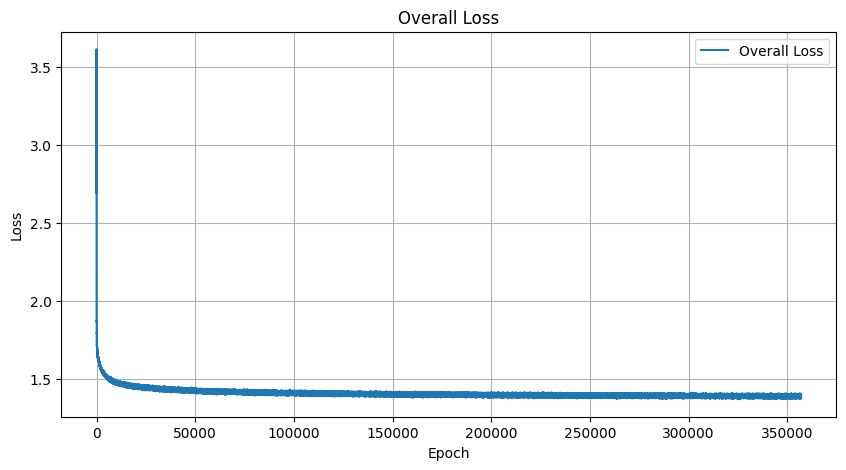

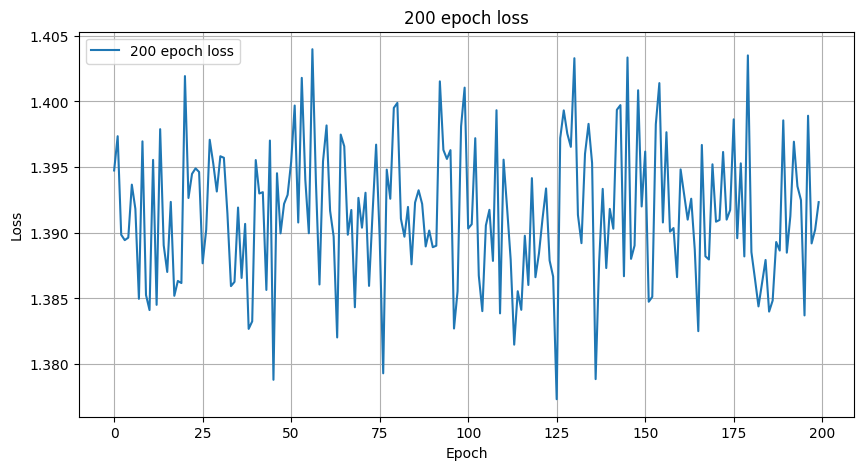

Epoch [1817801], Loss: 1.3919
Epoch [1817802], Loss: 1.3958
Epoch [1817803], Loss: 1.3843
Epoch [1817804], Loss: 1.3907
Epoch [1817805], Loss: 1.3903
Epoch [1817806], Loss: 1.3851
Epoch [1817807], Loss: 1.3872
Epoch [1817808], Loss: 1.4016
Epoch [1817809], Loss: 1.3925
Epoch [1817810], Loss: 1.3939
Epoch [1817811], Loss: 1.3955
Epoch [1817812], Loss: 1.4034
Epoch [1817813], Loss: 1.3822
Epoch [1817814], Loss: 1.3946
Epoch [1817815], Loss: 1.3928
Epoch [1817816], Loss: 1.3993
Epoch [1817817], Loss: 1.3973
Epoch [1817818], Loss: 1.3986
Epoch [1817819], Loss: 1.3921
Epoch [1817820], Loss: 1.3913
Epoch [1817821], Loss: 1.3891
Epoch [1817822], Loss: 1.3929
Epoch [1817823], Loss: 1.3873
Epoch [1817824], Loss: 1.3903
Epoch [1817825], Loss: 1.3905
Epoch [1817826], Loss: 1.3905
Epoch [1817827], Loss: 1.3856
Epoch [1817828], Loss: 1.3848
Epoch [1817829], Loss: 1.3951
Epoch [1817830], Loss: 1.3879
Epoch [1817831], Loss: 1.3935
Epoch [1817832], Loss: 1.3919
Epoch [1817833], Loss: 1.4030
Epoch [181

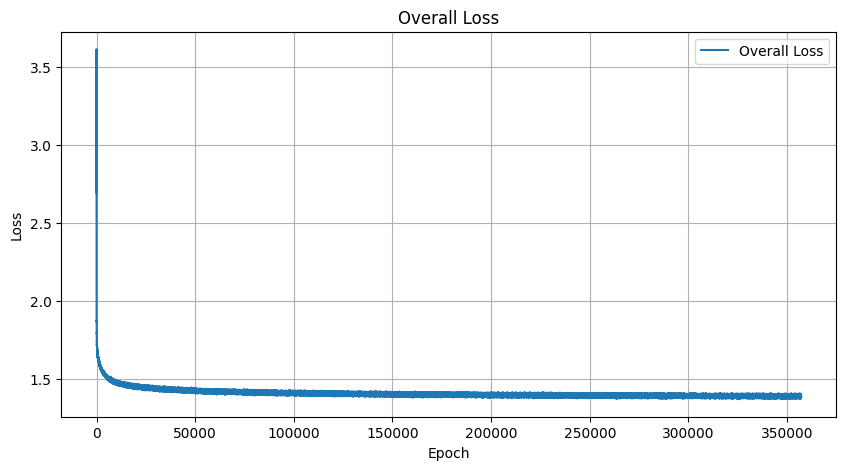

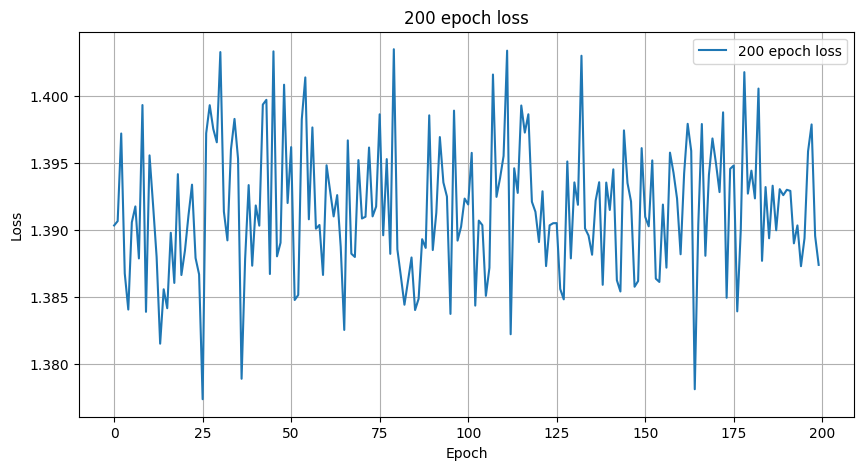

Epoch [1817901], Loss: 1.3928
Epoch [1817902], Loss: 1.3881
Epoch [1817903], Loss: 1.3976
Epoch [1817904], Loss: 1.3879
Epoch [1817905], Loss: 1.4013
Epoch [1817906], Loss: 1.3938
Epoch [1817907], Loss: 1.3825
Epoch [1817908], Loss: 1.3917
Epoch [1817909], Loss: 1.3906
Epoch [1817910], Loss: 1.3946
Epoch [1817911], Loss: 1.3977
Epoch [1817912], Loss: 1.3916
Epoch [1817913], Loss: 1.3921
Epoch [1817914], Loss: 1.3898
Epoch [1817915], Loss: 1.3967
Epoch [1817916], Loss: 1.3931
Epoch [1817917], Loss: 1.3952
Epoch [1817918], Loss: 1.3916
Epoch [1817919], Loss: 1.3819
Epoch [1817920], Loss: 1.3899
Epoch [1817921], Loss: 1.3986
Epoch [1817922], Loss: 1.3881
Epoch [1817923], Loss: 1.3883
Epoch [1817924], Loss: 1.3868
Epoch [1817925], Loss: 1.3871
Epoch [1817926], Loss: 1.3856
Epoch [1817927], Loss: 1.4008
Epoch [1817928], Loss: 1.3949
Epoch [1817929], Loss: 1.3899
Epoch [1817930], Loss: 1.3940
Epoch [1817931], Loss: 1.3890
Epoch [1817932], Loss: 1.3924
Epoch [1817933], Loss: 1.3862
Epoch [181

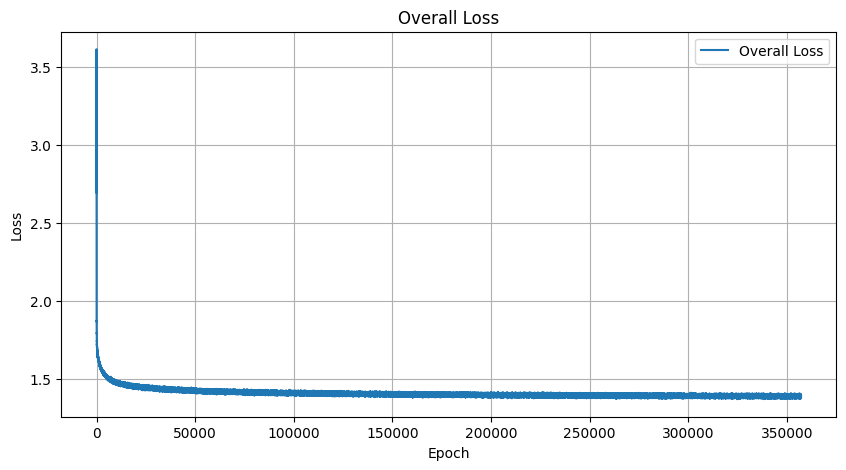

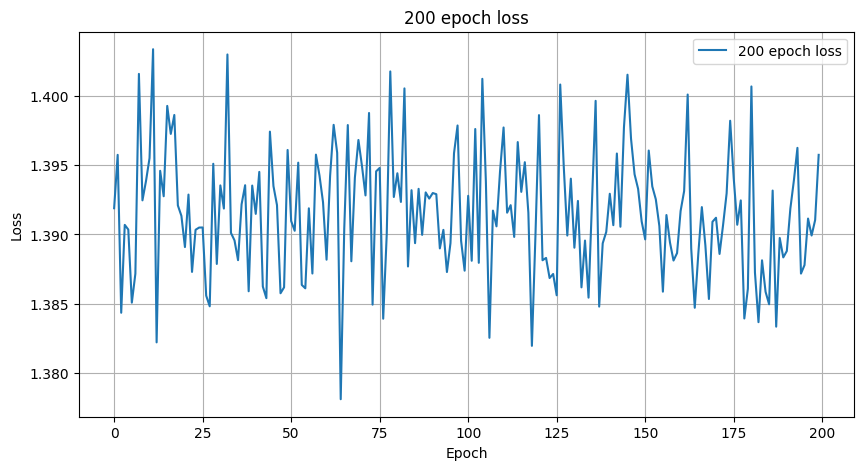

Epoch [1818001], Loss: 1.3926
Epoch [1818002], Loss: 1.3824
Epoch [1818003], Loss: 1.3885
Epoch [1818004], Loss: 1.3830
Epoch [1818005], Loss: 1.3967
Epoch [1818006], Loss: 1.3903
Epoch [1818007], Loss: 1.3922
Epoch [1818008], Loss: 1.3910
Epoch [1818009], Loss: 1.4001
Epoch [1818010], Loss: 1.3906
Epoch [1818011], Loss: 1.3826
Epoch [1818012], Loss: 1.3896
Epoch [1818013], Loss: 1.3955
Epoch [1818014], Loss: 1.3893
Epoch [1818015], Loss: 1.3866
Epoch [1818016], Loss: 1.3916
Epoch [1818017], Loss: 1.3887
Epoch [1818018], Loss: 1.3931
Epoch [1818019], Loss: 1.3911
Epoch [1818020], Loss: 1.3889
Epoch [1818021], Loss: 1.3906
Epoch [1818022], Loss: 1.3853
Epoch [1818023], Loss: 1.3879
Epoch [1818024], Loss: 1.3890
Epoch [1818025], Loss: 1.3896
Epoch [1818026], Loss: 1.3868
Epoch [1818027], Loss: 1.3840
Epoch [1818028], Loss: 1.3950
Epoch [1818029], Loss: 1.3908
Epoch [1818030], Loss: 1.3925
Epoch [1818031], Loss: 1.3896
Epoch [1818032], Loss: 1.3971
Epoch [1818033], Loss: 1.3929
Epoch [181

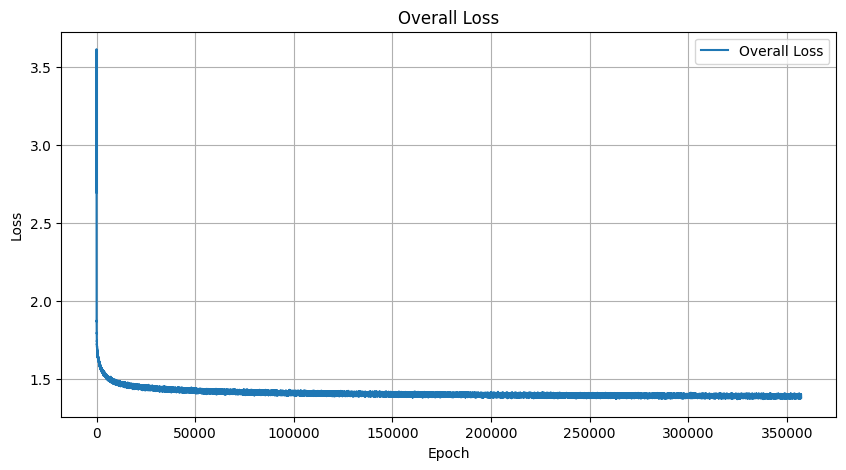

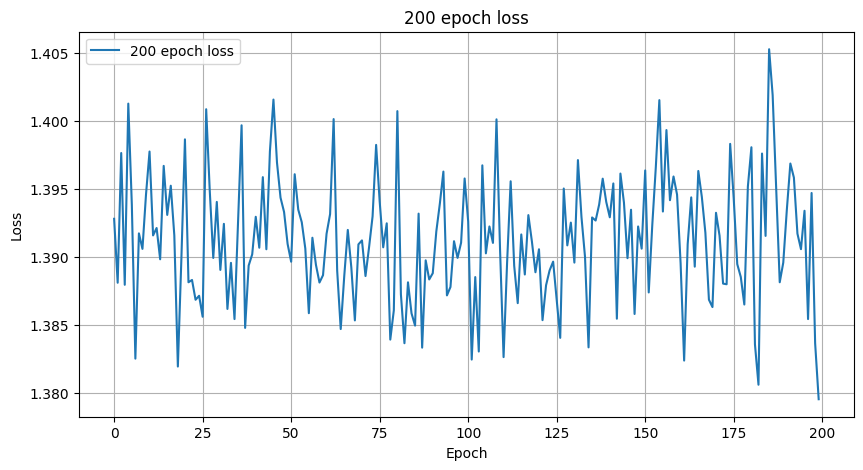

Epoch [1818101], Loss: 1.3891
Epoch [1818102], Loss: 1.3938
Epoch [1818103], Loss: 1.3892
Epoch [1818104], Loss: 1.3905
Epoch [1818105], Loss: 1.3940
Epoch [1818106], Loss: 1.3947
Epoch [1818107], Loss: 1.3895
Epoch [1818108], Loss: 1.3970
Epoch [1818109], Loss: 1.3952
Epoch [1818110], Loss: 1.3969
Epoch [1818111], Loss: 1.3848
Epoch [1818112], Loss: 1.3897
Epoch [1818113], Loss: 1.3873
Epoch [1818114], Loss: 1.3859
Epoch [1818115], Loss: 1.3981
Epoch [1818116], Loss: 1.3885
Epoch [1818117], Loss: 1.3937
Epoch [1818118], Loss: 1.3907
Epoch [1818119], Loss: 1.4008
Epoch [1818120], Loss: 1.3949
Epoch [1818121], Loss: 1.4031
Epoch [1818122], Loss: 1.3992
Epoch [1818123], Loss: 1.3906
Epoch [1818124], Loss: 1.3962
Epoch [1818125], Loss: 1.3889
Epoch [1818126], Loss: 1.3973
Epoch [1818127], Loss: 1.4063
Epoch [1818128], Loss: 1.3863
Epoch [1818129], Loss: 1.3962
Epoch [1818130], Loss: 1.3950
Epoch [1818131], Loss: 1.3966
Epoch [1818132], Loss: 1.3961
Epoch [1818133], Loss: 1.3883
Epoch [181

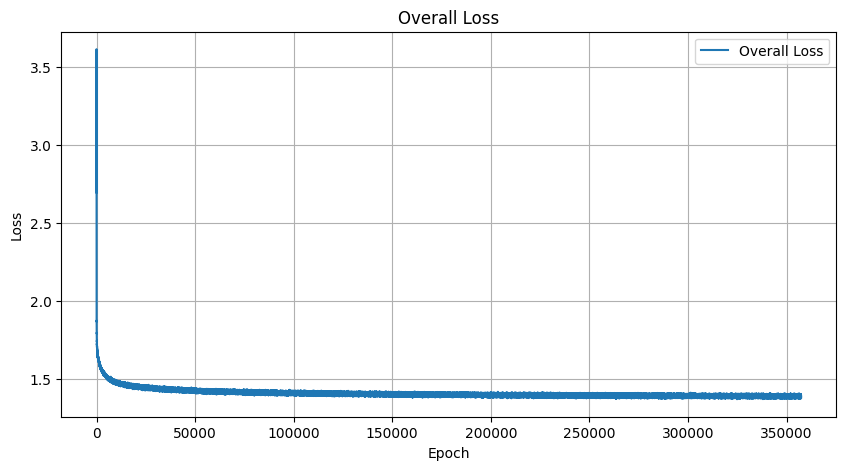

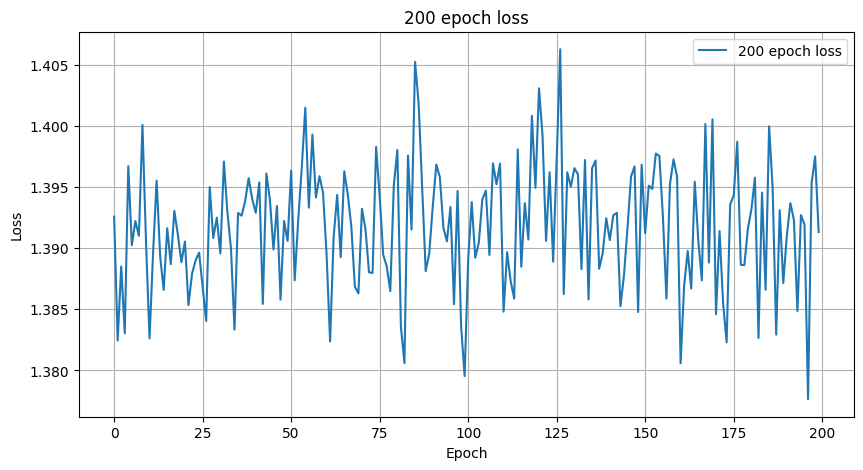

Epoch [1818201], Loss: 1.3973
Epoch [1818202], Loss: 1.3834
Epoch [1818203], Loss: 1.3930
Epoch [1818204], Loss: 1.3885
Epoch [1818205], Loss: 1.3906
Epoch [1818206], Loss: 1.3907
Epoch [1818207], Loss: 1.3935
Epoch [1818208], Loss: 1.4052
Epoch [1818209], Loss: 1.3919
Epoch [1818210], Loss: 1.3886
Epoch [1818211], Loss: 1.3829
Epoch [1818212], Loss: 1.3952
Epoch [1818213], Loss: 1.3965
Epoch [1818214], Loss: 1.3964
Epoch [1818215], Loss: 1.3934
Epoch [1818216], Loss: 1.3865
Epoch [1818217], Loss: 1.3985
Epoch [1818218], Loss: 1.3958
Epoch [1818219], Loss: 1.3991
Epoch [1818220], Loss: 1.3895
Epoch [1818221], Loss: 1.3969
Epoch [1818222], Loss: 1.3900
Epoch [1818223], Loss: 1.3955
Epoch [1818224], Loss: 1.3944
Epoch [1818225], Loss: 1.3919
Epoch [1818226], Loss: 1.3857
Epoch [1818227], Loss: 1.3894
Epoch [1818228], Loss: 1.3884
Epoch [1818229], Loss: 1.3912
Epoch [1818230], Loss: 1.3910
Epoch [1818231], Loss: 1.3869
Epoch [1818232], Loss: 1.3828
Epoch [1818233], Loss: 1.3921
Epoch [181

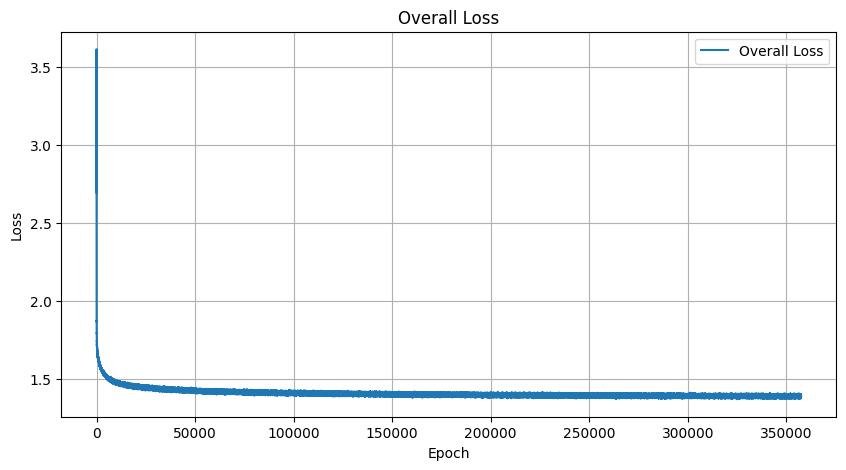

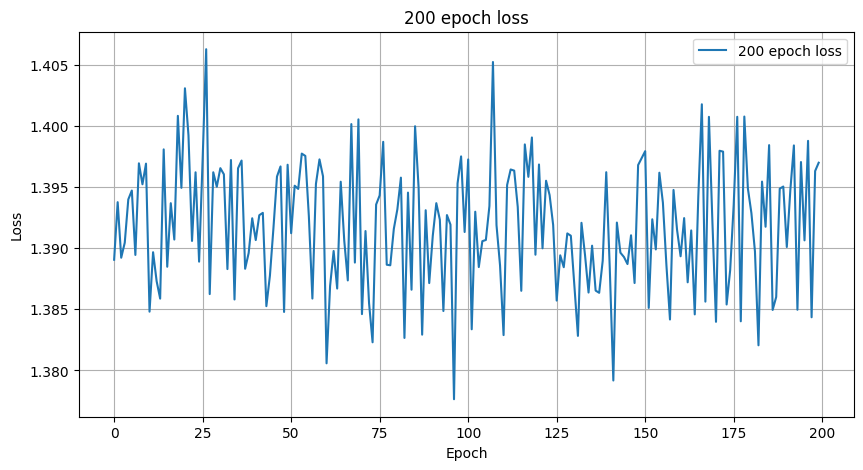

Epoch [1818301], Loss: 1.3908
Epoch [1818302], Loss: 1.3962
Epoch [1818303], Loss: 1.3959
Epoch [1818304], Loss: 1.4002
Epoch [1818305], Loss: 1.3934
Epoch [1818306], Loss: 1.3877
Epoch [1818307], Loss: 1.3934
Epoch [1818308], Loss: 1.3952
Epoch [1818309], Loss: 1.3911
Epoch [1818310], Loss: 1.3941
Epoch [1818311], Loss: 1.3873
Epoch [1818312], Loss: 1.3958
Epoch [1818313], Loss: 1.3902
Epoch [1818314], Loss: 1.3889
Epoch [1818315], Loss: 1.3895
Epoch [1818316], Loss: 1.3842
Epoch [1818317], Loss: 1.3926
Epoch [1818318], Loss: 1.3907
Epoch [1818319], Loss: 1.3863
Epoch [1818320], Loss: 1.3914
Epoch [1818321], Loss: 1.3989
Epoch [1818322], Loss: 1.3984
Epoch [1818323], Loss: 1.3957
Epoch [1818324], Loss: 1.3798
Epoch [1818325], Loss: 1.3964
Epoch [1818326], Loss: 1.3884
Epoch [1818327], Loss: 1.3903
Epoch [1818328], Loss: 1.3940
Epoch [1818329], Loss: 1.3881
Epoch [1818330], Loss: 1.3859
Epoch [1818331], Loss: 1.3954
Epoch [1818332], Loss: 1.3964
Epoch [1818333], Loss: 1.3813
Epoch [181

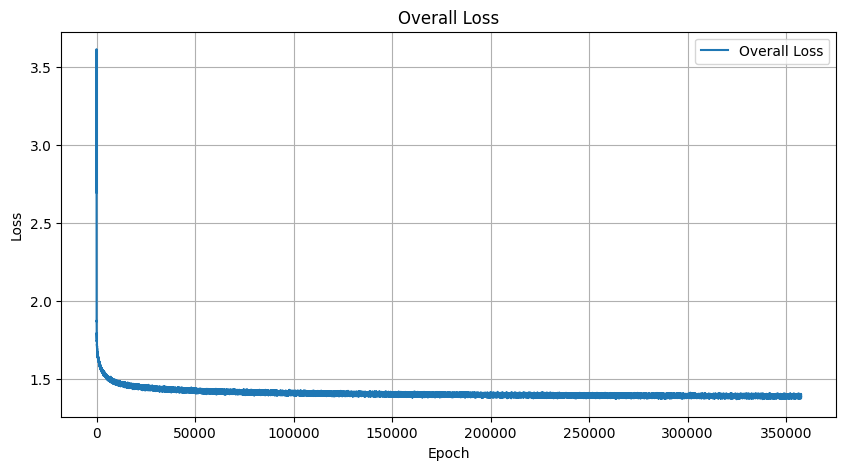

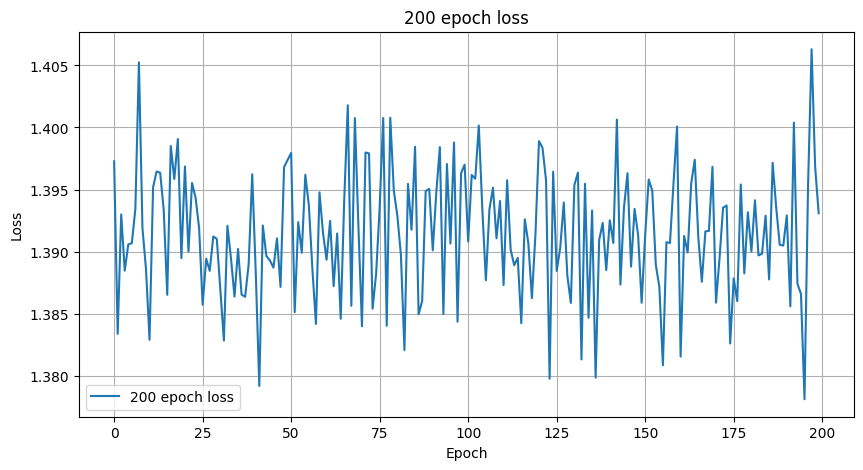

Epoch [1818401], Loss: 1.3896
Epoch [1818402], Loss: 1.3984
Epoch [1818403], Loss: 1.3908
Epoch [1818404], Loss: 1.3969
Epoch [1818405], Loss: 1.3919
Epoch [1818406], Loss: 1.3987
Epoch [1818407], Loss: 1.3833
Epoch [1818408], Loss: 1.3981
Epoch [1818409], Loss: 1.3917
Epoch [1818410], Loss: 1.3913
Epoch [1818411], Loss: 1.3952
Epoch [1818412], Loss: 1.3869
Epoch [1818413], Loss: 1.3850
Epoch [1818414], Loss: 1.3842
Epoch [1818415], Loss: 1.3894
Epoch [1818416], Loss: 1.3962
Epoch [1818417], Loss: 1.3937
Epoch [1818418], Loss: 1.3903
Epoch [1818419], Loss: 1.3884
Epoch [1818420], Loss: 1.3862
Epoch [1818421], Loss: 1.3911
Epoch [1818422], Loss: 1.3913
Epoch [1818423], Loss: 1.3878
Epoch [1818424], Loss: 1.3997
Epoch [1818425], Loss: 1.3823
Epoch [1818426], Loss: 1.3843
Epoch [1818427], Loss: 1.3866
Epoch [1818428], Loss: 1.3850
Epoch [1818429], Loss: 1.3892
Epoch [1818430], Loss: 1.3945
Epoch [1818431], Loss: 1.3906
Epoch [1818432], Loss: 1.3909
Epoch [1818433], Loss: 1.3928
Epoch [181

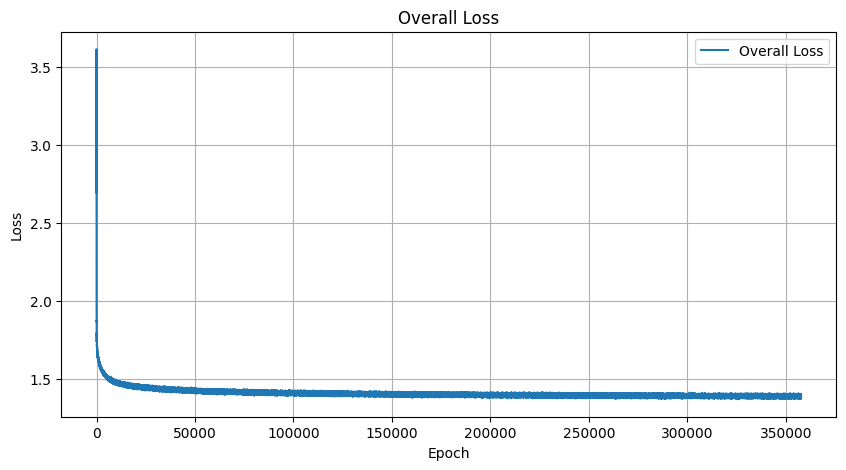

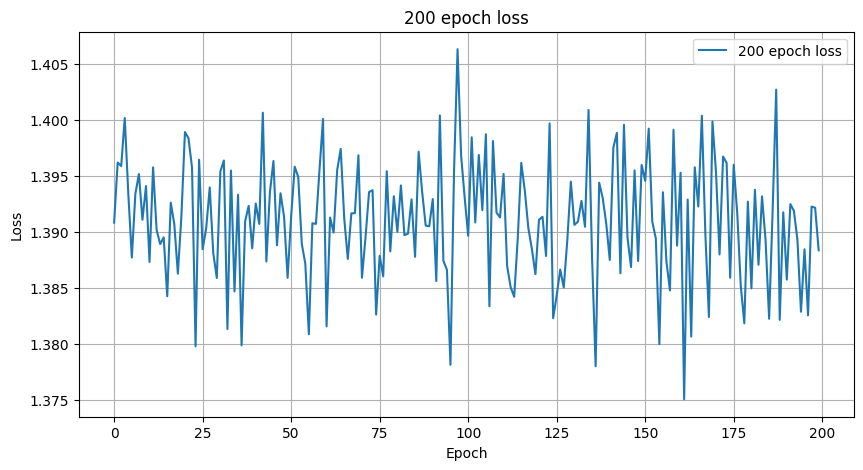

Epoch [1818501], Loss: 1.3969
Epoch [1818502], Loss: 1.3932
Epoch [1818503], Loss: 1.3895
Epoch [1818504], Loss: 1.3966
Epoch [1818505], Loss: 1.3959
Epoch [1818506], Loss: 1.3881
Epoch [1818507], Loss: 1.3855
Epoch [1818508], Loss: 1.3867
Epoch [1818509], Loss: 1.3847
Epoch [1818510], Loss: 1.3820
Epoch [1818511], Loss: 1.3854
Epoch [1818512], Loss: 1.3981
Epoch [1818513], Loss: 1.3942
Epoch [1818514], Loss: 1.3859
Epoch [1818515], Loss: 1.3902
Epoch [1818516], Loss: 1.3973
Epoch [1818517], Loss: 1.3909
Epoch [1818518], Loss: 1.3979
Epoch [1818519], Loss: 1.3887
Epoch [1818520], Loss: 1.3913
Epoch [1818521], Loss: 1.3848
Epoch [1818522], Loss: 1.3984
Epoch [1818523], Loss: 1.3962
Epoch [1818524], Loss: 1.3880
Epoch [1818525], Loss: 1.3914
Epoch [1818526], Loss: 1.3854
Epoch [1818527], Loss: 1.3963
Epoch [1818528], Loss: 1.3908
Epoch [1818529], Loss: 1.3891
Epoch [1818530], Loss: 1.3906
Epoch [1818531], Loss: 1.3979
Epoch [1818532], Loss: 1.3909
Epoch [1818533], Loss: 1.3941
Epoch [181

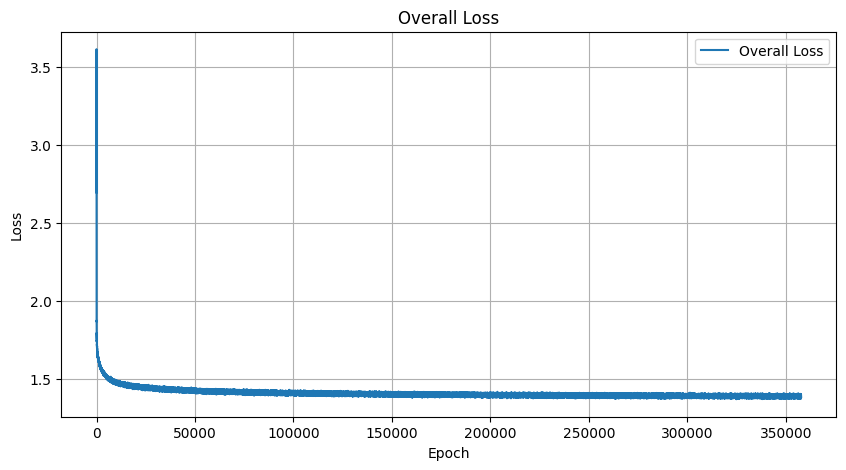

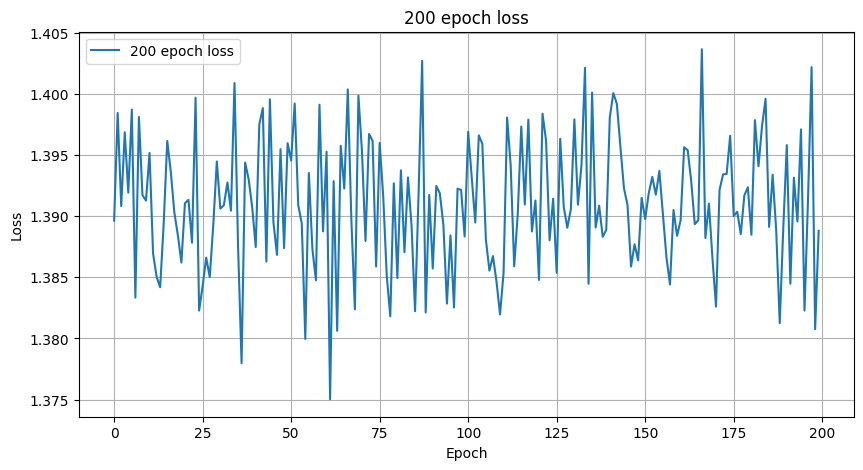

Epoch [1818601], Loss: 1.3887
Epoch [1818602], Loss: 1.3872
Epoch [1818603], Loss: 1.3927
Epoch [1818604], Loss: 1.3972
Epoch [1818605], Loss: 1.3910
Epoch [1818606], Loss: 1.3886
Epoch [1818607], Loss: 1.3842
Epoch [1818608], Loss: 1.3930
Epoch [1818609], Loss: 1.3883
Epoch [1818610], Loss: 1.3861
Epoch [1818611], Loss: 1.3918
Epoch [1818612], Loss: 1.3870
Epoch [1818613], Loss: 1.3920
Epoch [1818614], Loss: 1.3878
Epoch [1818615], Loss: 1.3942
Epoch [1818616], Loss: 1.3860
Epoch [1818617], Loss: 1.3964
Epoch [1818618], Loss: 1.3910
Epoch [1818619], Loss: 1.3838
Epoch [1818620], Loss: 1.3884
Epoch [1818621], Loss: 1.3897
Epoch [1818622], Loss: 1.4027
Epoch [1818623], Loss: 1.3943
Epoch [1818624], Loss: 1.3896
Epoch [1818625], Loss: 1.3856
Epoch [1818626], Loss: 1.3921
Epoch [1818627], Loss: 1.3829
Epoch [1818628], Loss: 1.3901
Epoch [1818629], Loss: 1.3882
Epoch [1818630], Loss: 1.3910
Epoch [1818631], Loss: 1.3957
Epoch [1818632], Loss: 1.4007
Epoch [1818633], Loss: 1.4006
Epoch [181

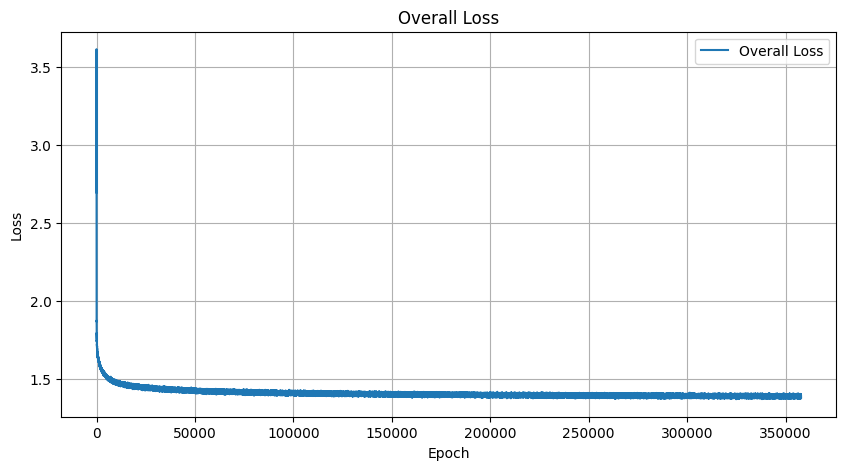

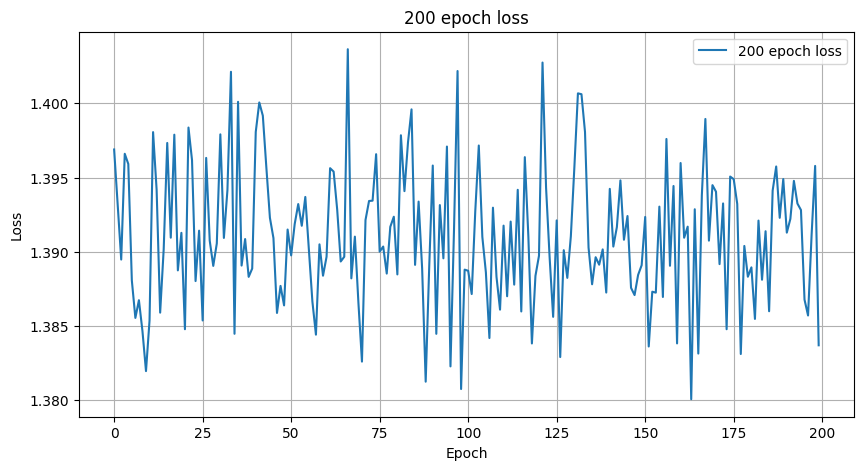

Epoch [1818701], Loss: 1.3920
Epoch [1818702], Loss: 1.3797
Epoch [1818703], Loss: 1.3918
Epoch [1818704], Loss: 1.3909
Epoch [1818705], Loss: 1.3956
Epoch [1818706], Loss: 1.3963
Epoch [1818707], Loss: 1.3933
Epoch [1818708], Loss: 1.3895
Epoch [1818709], Loss: 1.3861
Epoch [1818710], Loss: 1.3881
Epoch [1818711], Loss: 1.3849
Epoch [1818712], Loss: 1.3963
Epoch [1818713], Loss: 1.3932
Epoch [1818714], Loss: 1.3908
Epoch [1818715], Loss: 1.3954
Epoch [1818716], Loss: 1.3963
Epoch [1818717], Loss: 1.3979
Epoch [1818718], Loss: 1.3942
Epoch [1818719], Loss: 1.3853
Epoch [1818720], Loss: 1.3951
Epoch [1818721], Loss: 1.3894
Epoch [1818722], Loss: 1.3910
Epoch [1818723], Loss: 1.3897
Epoch [1818724], Loss: 1.3957
Epoch [1818725], Loss: 1.3923
Epoch [1818726], Loss: 1.3799
Epoch [1818727], Loss: 1.3888
Epoch [1818728], Loss: 1.3956
Epoch [1818729], Loss: 1.3910
Epoch [1818730], Loss: 1.3962
Epoch [1818731], Loss: 1.3890
Epoch [1818732], Loss: 1.3913
Epoch [1818733], Loss: 1.3899
Epoch [181

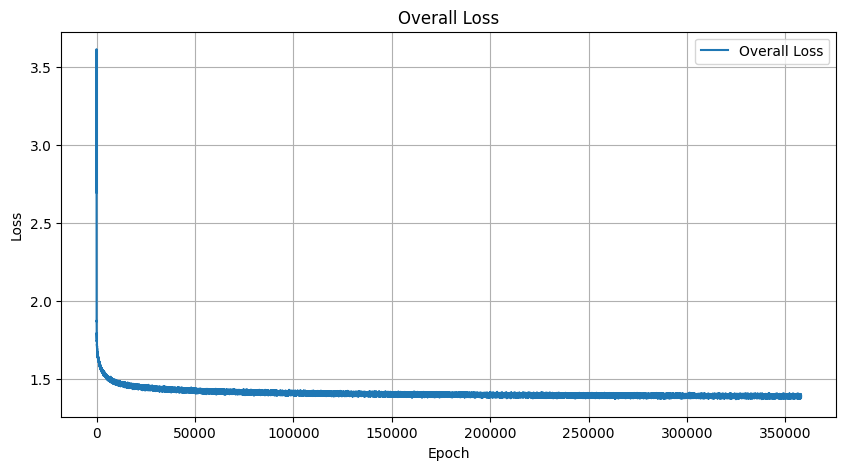

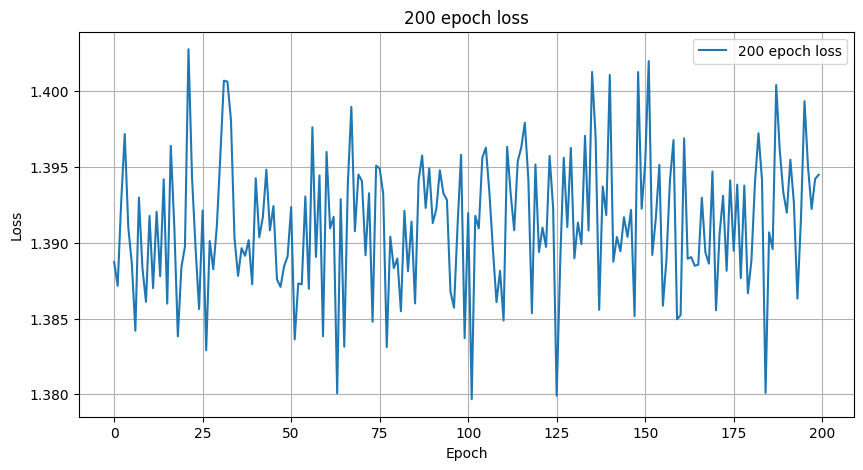

Epoch [1818801], Loss: 1.3906
Epoch [1818802], Loss: 1.3952
Epoch [1818803], Loss: 1.3873
Epoch [1818804], Loss: 1.3959
Epoch [1818805], Loss: 1.3920
Epoch [1818806], Loss: 1.3950
Epoch [1818807], Loss: 1.3901
Epoch [1818808], Loss: 1.3991
Epoch [1818809], Loss: 1.3824
Epoch [1818810], Loss: 1.3860
Epoch [1818811], Loss: 1.3993
Epoch [1818812], Loss: 1.3899
Epoch [1818813], Loss: 1.3928
Epoch [1818814], Loss: 1.3959
Epoch [1818815], Loss: 1.3874
Epoch [1818816], Loss: 1.3859
Epoch [1818817], Loss: 1.3930
Epoch [1818818], Loss: 1.3900
Epoch [1818819], Loss: 1.3868
Epoch [1818820], Loss: 1.3949
Epoch [1818821], Loss: 1.3946
Epoch [1818822], Loss: 1.3993
Epoch [1818823], Loss: 1.3935
Epoch [1818824], Loss: 1.3866
Epoch [1818825], Loss: 1.4021
Epoch [1818826], Loss: 1.3905
Epoch [1818827], Loss: 1.3890
Epoch [1818828], Loss: 1.3977
Epoch [1818829], Loss: 1.3876
Epoch [1818830], Loss: 1.3881
Epoch [1818831], Loss: 1.3888
Epoch [1818832], Loss: 1.3910
Epoch [1818833], Loss: 1.3975
Epoch [181

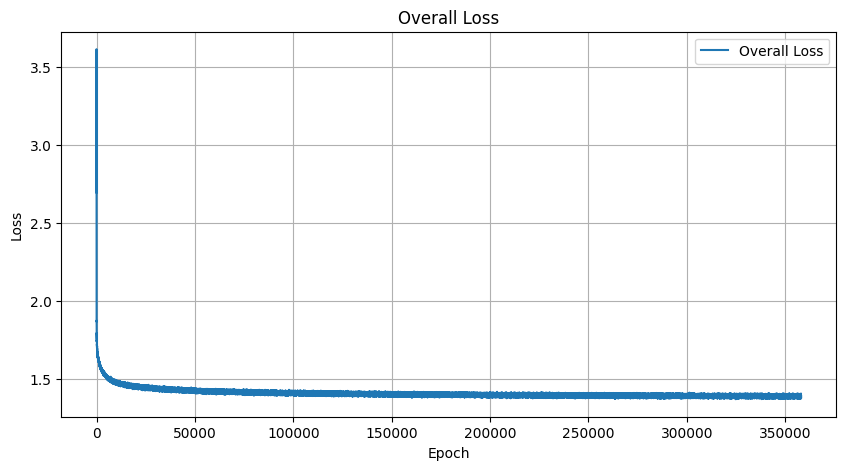

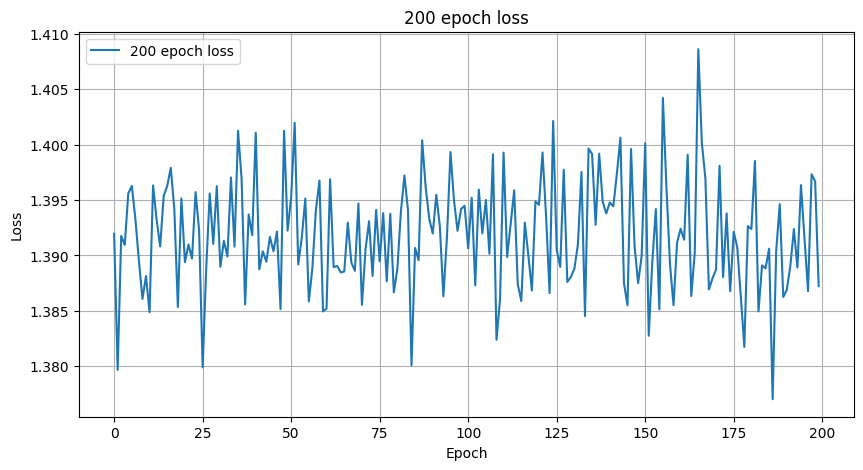

Epoch [1818901], Loss: 1.3914
Epoch [1818902], Loss: 1.4007
Epoch [1818903], Loss: 1.3950
Epoch [1818904], Loss: 1.3867
Epoch [1818905], Loss: 1.3907
Epoch [1818906], Loss: 1.3961
Epoch [1818907], Loss: 1.3838
Epoch [1818908], Loss: 1.3901
Epoch [1818909], Loss: 1.4013
Epoch [1818910], Loss: 1.3893
Epoch [1818911], Loss: 1.3851
Epoch [1818912], Loss: 1.3874
Epoch [1818913], Loss: 1.3945
Epoch [1818914], Loss: 1.3965
Epoch [1818915], Loss: 1.3954
Epoch [1818916], Loss: 1.3862
Epoch [1818917], Loss: 1.3925
Epoch [1818918], Loss: 1.3933
Epoch [1818919], Loss: 1.3949
Epoch [1818920], Loss: 1.3865
Epoch [1818921], Loss: 1.3930
Epoch [1818922], Loss: 1.3887
Epoch [1818923], Loss: 1.3895
Epoch [1818924], Loss: 1.3846
Epoch [1818925], Loss: 1.3892
Epoch [1818926], Loss: 1.3856
Epoch [1818927], Loss: 1.3833
Epoch [1818928], Loss: 1.3950
Epoch [1818929], Loss: 1.3950
Epoch [1818930], Loss: 1.3886
Epoch [1818931], Loss: 1.3865
Epoch [1818932], Loss: 1.3937
Epoch [1818933], Loss: 1.3893
Epoch [181

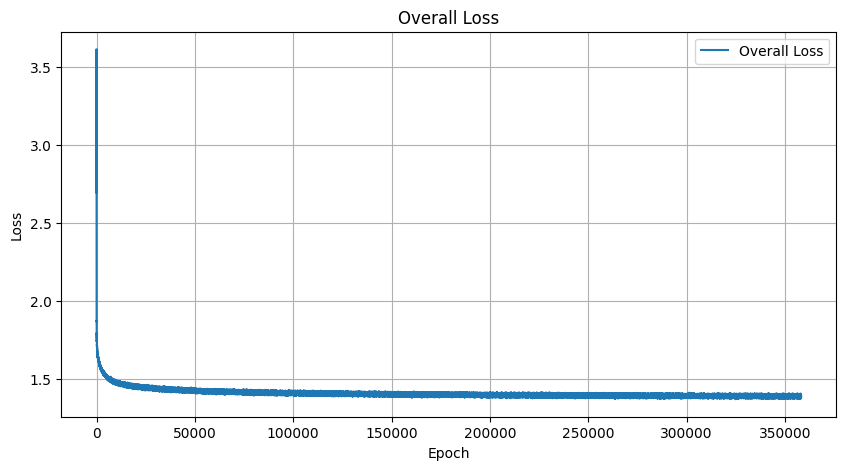

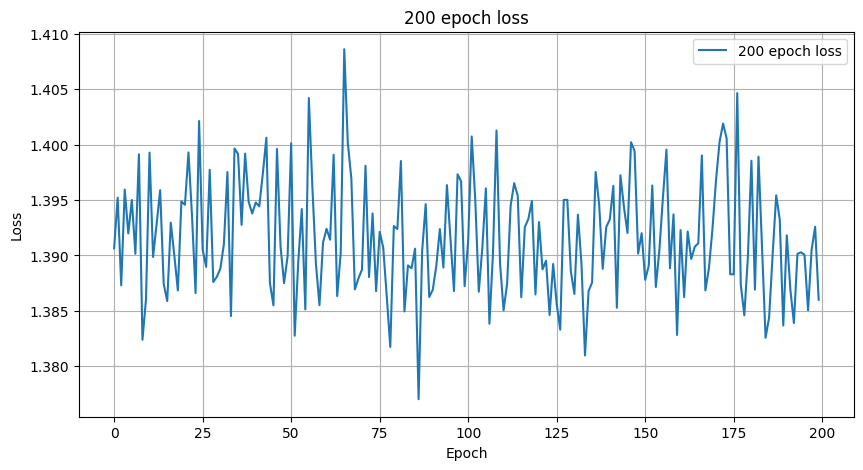

Epoch [1819001], Loss: 1.3938
Epoch [1819002], Loss: 1.3852
Epoch [1819003], Loss: 1.3927
Epoch [1819004], Loss: 1.3921
Epoch [1819005], Loss: 1.3893
Epoch [1819006], Loss: 1.3910
Epoch [1819007], Loss: 1.3864
Epoch [1819008], Loss: 1.3899
Epoch [1819009], Loss: 1.3927
Epoch [1819010], Loss: 1.3896
Epoch [1819011], Loss: 1.3941
Epoch [1819012], Loss: 1.3928
Epoch [1819013], Loss: 1.3920
Epoch [1819014], Loss: 1.3855
Epoch [1819015], Loss: 1.3872
Epoch [1819016], Loss: 1.3906
Epoch [1819017], Loss: 1.3997
Epoch [1819018], Loss: 1.3862
Epoch [1819019], Loss: 1.3928
Epoch [1819020], Loss: 1.3930
Epoch [1819021], Loss: 1.3953
Epoch [1819022], Loss: 1.3974
Epoch [1819023], Loss: 1.3958
Epoch [1819024], Loss: 1.3902
Epoch [1819025], Loss: 1.3949
Epoch [1819026], Loss: 1.3977
Epoch [1819027], Loss: 1.3878
Epoch [1819028], Loss: 1.3994
Epoch [1819029], Loss: 1.3934
Epoch [1819030], Loss: 1.3860
Epoch [1819031], Loss: 1.3913
Epoch [1819032], Loss: 1.3918
Epoch [1819033], Loss: 1.3913
Epoch [181

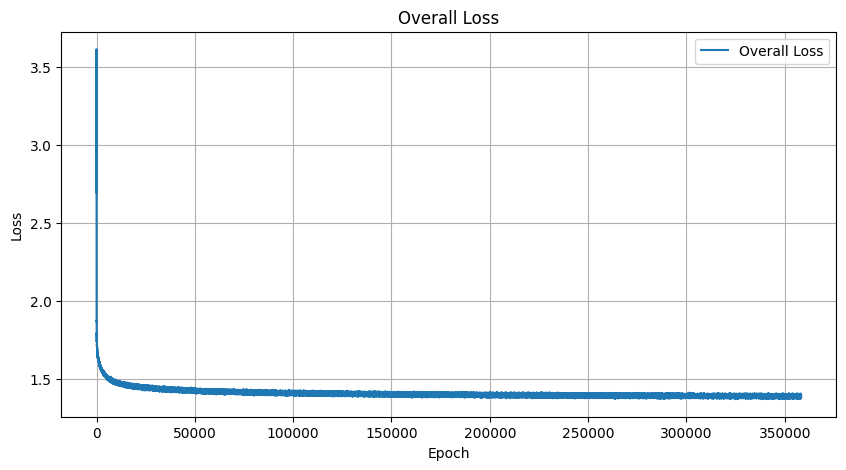

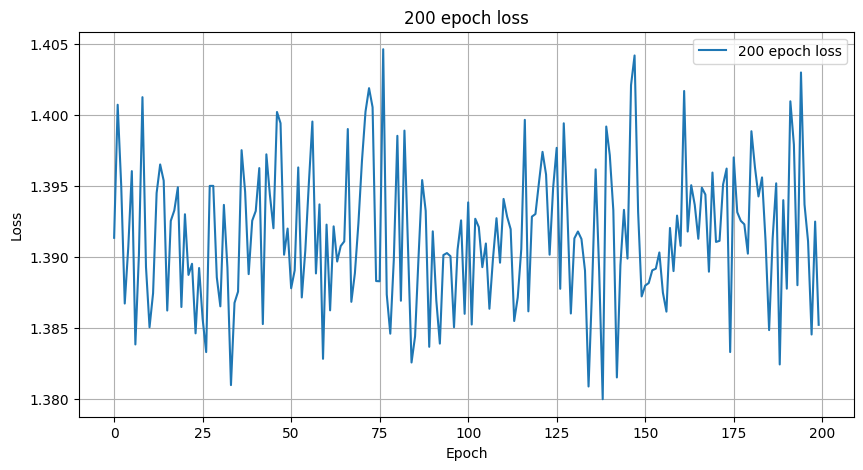

Epoch [1819101], Loss: 1.3925
Epoch [1819102], Loss: 1.3869
Epoch [1819103], Loss: 1.3904
Epoch [1819104], Loss: 1.3877
Epoch [1819105], Loss: 1.3854
Epoch [1819106], Loss: 1.3933
Epoch [1819107], Loss: 1.3885
Epoch [1819108], Loss: 1.3900
Epoch [1819109], Loss: 1.3873
Epoch [1819110], Loss: 1.3895
Epoch [1819111], Loss: 1.3827
Epoch [1819112], Loss: 1.3874
Epoch [1819113], Loss: 1.3930
Epoch [1819114], Loss: 1.3943
Epoch [1819115], Loss: 1.3930
Epoch [1819116], Loss: 1.3875
Epoch [1819117], Loss: 1.3983
Epoch [1819118], Loss: 1.3897
Epoch [1819119], Loss: 1.4000
Epoch [1819120], Loss: 1.3865
Epoch [1819121], Loss: 1.3852
Epoch [1819122], Loss: 1.3986
Epoch [1819123], Loss: 1.3977
Epoch [1819124], Loss: 1.3955
Epoch [1819125], Loss: 1.3988
Epoch [1819126], Loss: 1.3925
Epoch [1819127], Loss: 1.3835
Epoch [1819128], Loss: 1.3948
Epoch [1819129], Loss: 1.3897
Epoch [1819130], Loss: 1.3939
Epoch [1819131], Loss: 1.3951
Epoch [1819132], Loss: 1.3902
Epoch [1819133], Loss: 1.3846
Epoch [181

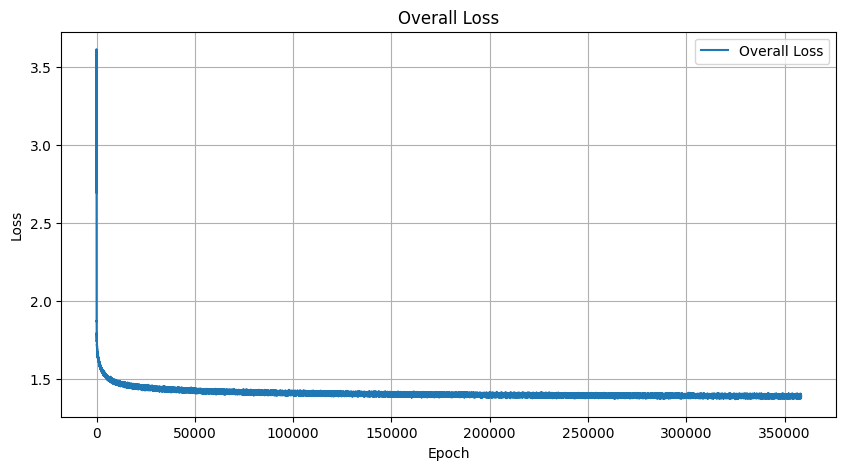

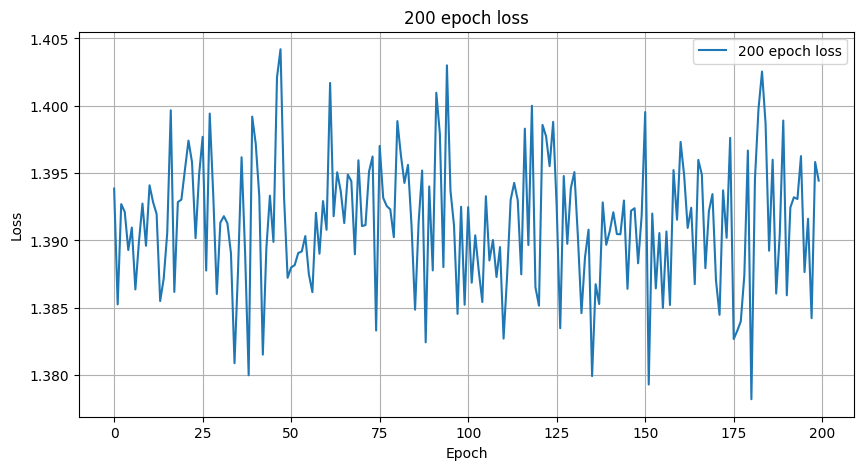

Epoch [1819201], Loss: 1.3910
Epoch [1819202], Loss: 1.3944
Epoch [1819203], Loss: 1.3947
Epoch [1819204], Loss: 1.3865
Epoch [1819205], Loss: 1.3895
Epoch [1819206], Loss: 1.3905
Epoch [1819207], Loss: 1.3987
Epoch [1819208], Loss: 1.3924
Epoch [1819209], Loss: 1.3982
Epoch [1819210], Loss: 1.3891
Epoch [1819211], Loss: 1.3867
Epoch [1819212], Loss: 1.3846
Epoch [1819213], Loss: 1.3927
Epoch [1819214], Loss: 1.3920
Epoch [1819215], Loss: 1.3916
Epoch [1819216], Loss: 1.3935
Epoch [1819217], Loss: 1.3991
Epoch [1819218], Loss: 1.3931
Epoch [1819219], Loss: 1.3945
Epoch [1819220], Loss: 1.3894
Epoch [1819221], Loss: 1.3998
Epoch [1819222], Loss: 1.3916
Epoch [1819223], Loss: 1.3895
Epoch [1819224], Loss: 1.3877
Epoch [1819225], Loss: 1.3898
Epoch [1819226], Loss: 1.3853
Epoch [1819227], Loss: 1.3919
Epoch [1819228], Loss: 1.3868
Epoch [1819229], Loss: 1.3878
Epoch [1819230], Loss: 1.3932
Epoch [1819231], Loss: 1.3995
Epoch [1819232], Loss: 1.3967
Epoch [1819233], Loss: 1.3854
Epoch [181

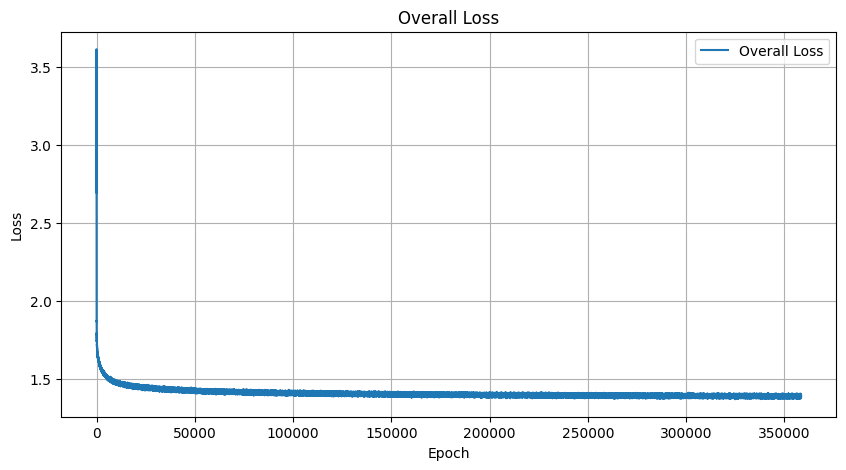

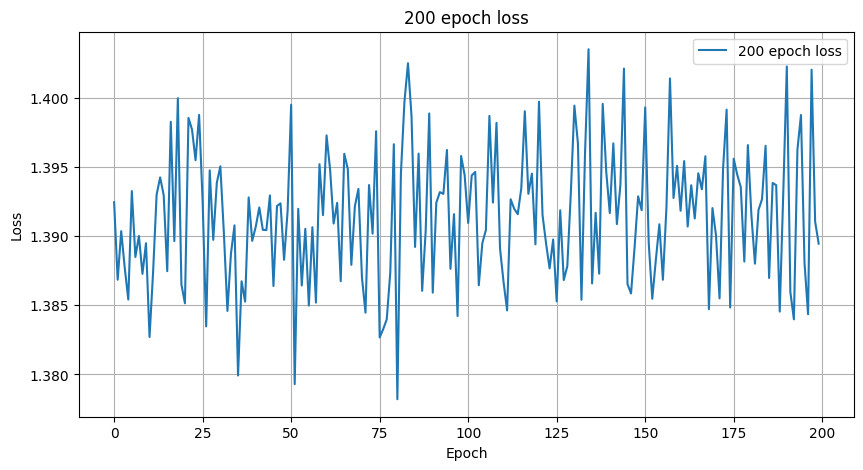

Epoch [1819301], Loss: 1.3868
Epoch [1819302], Loss: 1.3918
Epoch [1819303], Loss: 1.3913
Epoch [1819304], Loss: 1.3919
Epoch [1819305], Loss: 1.3950
Epoch [1819306], Loss: 1.3923
Epoch [1819307], Loss: 1.3888
Epoch [1819308], Loss: 1.3817
Epoch [1819309], Loss: 1.3904
Epoch [1819310], Loss: 1.3922
Epoch [1819311], Loss: 1.3953
Epoch [1819312], Loss: 1.3880
Epoch [1819313], Loss: 1.3824
Epoch [1819314], Loss: 1.3895
Epoch [1819315], Loss: 1.3873
Epoch [1819316], Loss: 1.3949
Epoch [1819317], Loss: 1.3900
Epoch [1819318], Loss: 1.3894
Epoch [1819319], Loss: 1.3916
Epoch [1819320], Loss: 1.3921
Epoch [1819321], Loss: 1.3892
Epoch [1819322], Loss: 1.4025
Epoch [1819323], Loss: 1.3878
Epoch [1819324], Loss: 1.3899
Epoch [1819325], Loss: 1.3901
Epoch [1819326], Loss: 1.3878
Epoch [1819327], Loss: 1.3933
Epoch [1819328], Loss: 1.3879
Epoch [1819329], Loss: 1.3911
Epoch [1819330], Loss: 1.3906
Epoch [1819331], Loss: 1.3947
Epoch [1819332], Loss: 1.3904
Epoch [1819333], Loss: 1.3852
Epoch [181

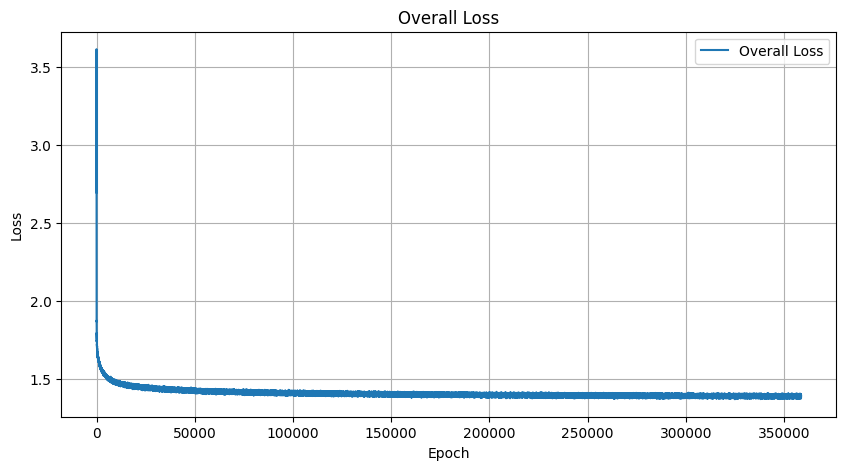

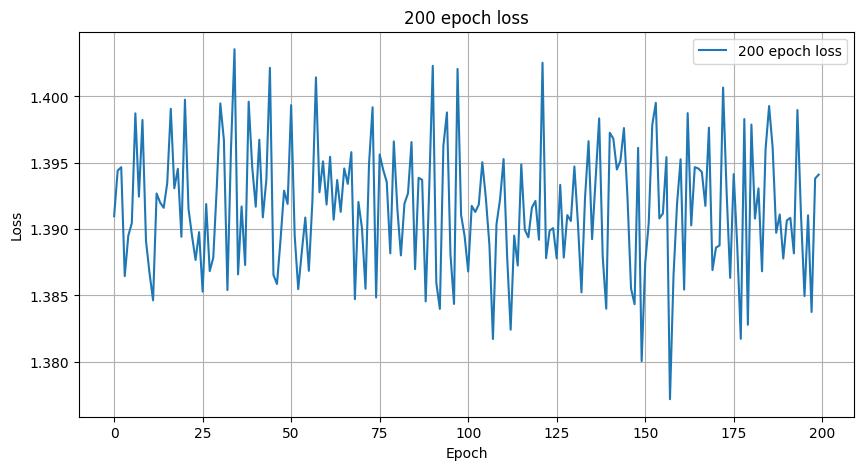

Epoch [1819401], Loss: 1.3856
Epoch [1819402], Loss: 1.3909
Epoch [1819403], Loss: 1.3937
Epoch [1819404], Loss: 1.4015
Epoch [1819405], Loss: 1.3934
Epoch [1819406], Loss: 1.3817
Epoch [1819407], Loss: 1.3878
Epoch [1819408], Loss: 1.3890
Epoch [1819409], Loss: 1.3910
Epoch [1819410], Loss: 1.3879
Epoch [1819411], Loss: 1.3891
Epoch [1819412], Loss: 1.3854
Epoch [1819413], Loss: 1.3972
Epoch [1819414], Loss: 1.3881
Epoch [1819415], Loss: 1.3850
Epoch [1819416], Loss: 1.4026
Epoch [1819417], Loss: 1.3914
Epoch [1819418], Loss: 1.3899
Epoch [1819419], Loss: 1.3960
Epoch [1819420], Loss: 1.3892
Epoch [1819421], Loss: 1.3911
Epoch [1819422], Loss: 1.3947
Epoch [1819423], Loss: 1.3852
Epoch [1819424], Loss: 1.3965
Epoch [1819425], Loss: 1.3817
Epoch [1819426], Loss: 1.3929
Epoch [1819427], Loss: 1.3883
Epoch [1819428], Loss: 1.3905
Epoch [1819429], Loss: 1.3854
Epoch [1819430], Loss: 1.4043
Epoch [1819431], Loss: 1.3909
Epoch [1819432], Loss: 1.4039
Epoch [1819433], Loss: 1.3879
Epoch [181

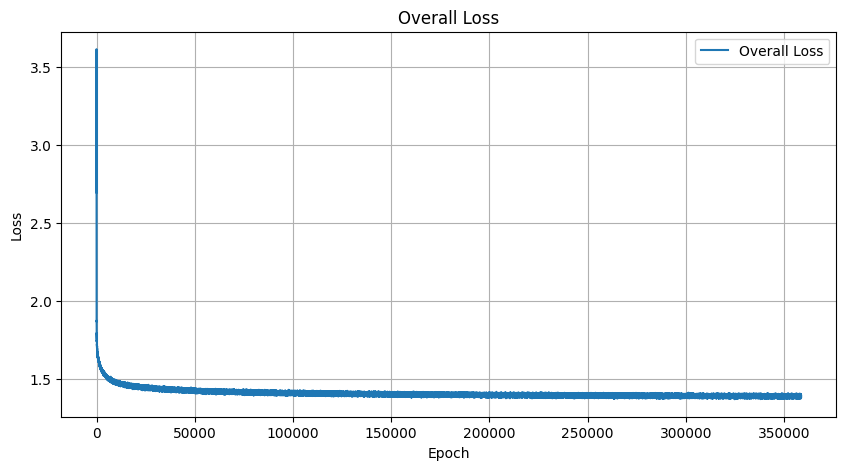

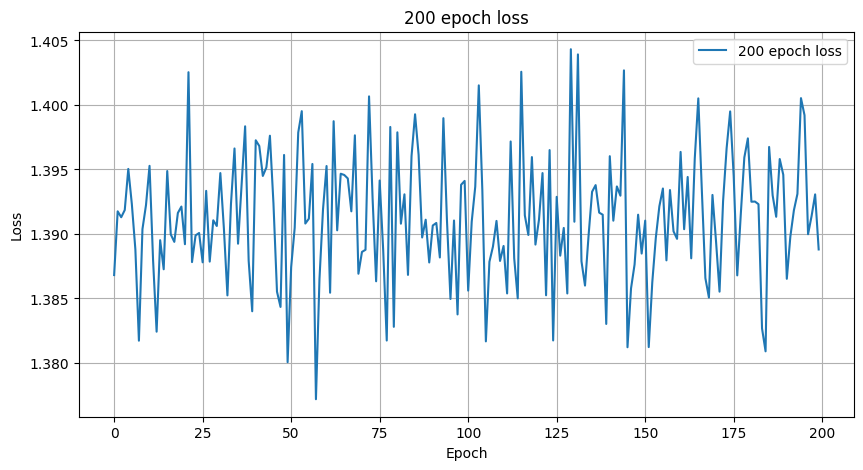

Epoch [1819501], Loss: 1.3950
Epoch [1819502], Loss: 1.3897
Epoch [1819503], Loss: 1.3993
Epoch [1819504], Loss: 1.3895
Epoch [1819505], Loss: 1.3885
Epoch [1819506], Loss: 1.3893
Epoch [1819507], Loss: 1.3826
Epoch [1819508], Loss: 1.3936
Epoch [1819509], Loss: 1.3940
Epoch [1819510], Loss: 1.3867
Epoch [1819511], Loss: 1.3788
Epoch [1819512], Loss: 1.3967
Epoch [1819513], Loss: 1.3963
Epoch [1819514], Loss: 1.3959
Epoch [1819515], Loss: 1.3842
Epoch [1819516], Loss: 1.3919
Epoch [1819517], Loss: 1.3831
Epoch [1819518], Loss: 1.3921
Epoch [1819519], Loss: 1.3919
Epoch [1819520], Loss: 1.4039
Epoch [1819521], Loss: 1.3862
Epoch [1819522], Loss: 1.3811
Epoch [1819523], Loss: 1.3928
Epoch [1819524], Loss: 1.3907
Epoch [1819525], Loss: 1.3953
Epoch [1819526], Loss: 1.3799
Epoch [1819527], Loss: 1.3947
Epoch [1819528], Loss: 1.3862
Epoch [1819529], Loss: 1.3912
Epoch [1819530], Loss: 1.3913
Epoch [1819531], Loss: 1.3891
Epoch [1819532], Loss: 1.3811
Epoch [1819533], Loss: 1.3887
Epoch [181

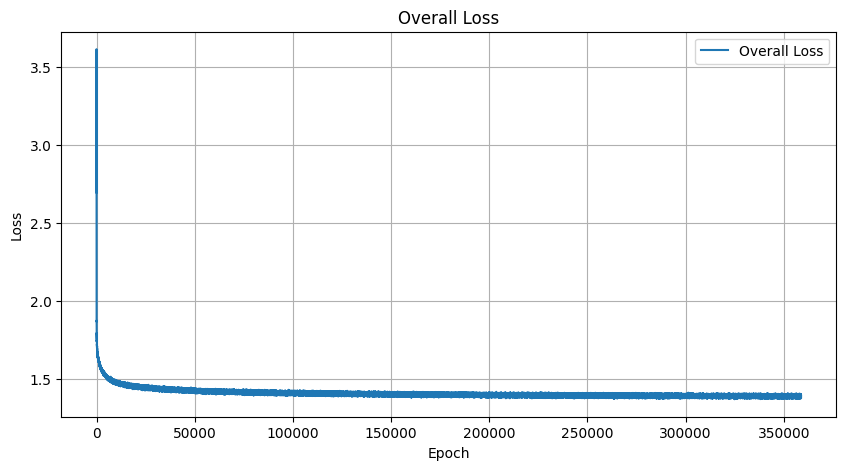

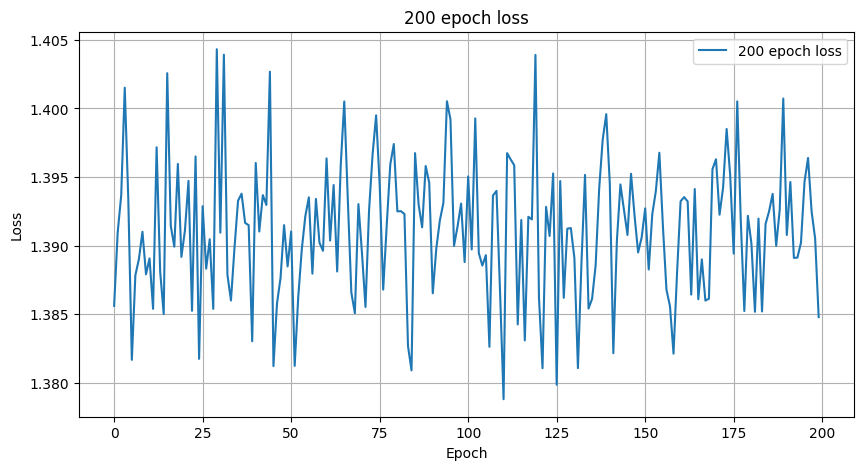

Epoch [1819601], Loss: 1.3961
Epoch [1819602], Loss: 1.3934
Epoch [1819603], Loss: 1.3803
Epoch [1819604], Loss: 1.3901
Epoch [1819605], Loss: 1.3926
Epoch [1819606], Loss: 1.3865
Epoch [1819607], Loss: 1.3799
Epoch [1819608], Loss: 1.3903
Epoch [1819609], Loss: 1.3939
Epoch [1819610], Loss: 1.3935
Epoch [1819611], Loss: 1.3873
Epoch [1819612], Loss: 1.3917
Epoch [1819613], Loss: 1.3896
Epoch [1819614], Loss: 1.3955
Epoch [1819615], Loss: 1.3917
Epoch [1819616], Loss: 1.3911
Epoch [1819617], Loss: 1.3944
Epoch [1819618], Loss: 1.3892
Epoch [1819619], Loss: 1.3975
Epoch [1819620], Loss: 1.3846
Epoch [1819621], Loss: 1.3940
Epoch [1819622], Loss: 1.3936
Epoch [1819623], Loss: 1.3938
Epoch [1819624], Loss: 1.3907
Epoch [1819625], Loss: 1.3964
Epoch [1819626], Loss: 1.3874
Epoch [1819627], Loss: 1.3939
Epoch [1819628], Loss: 1.3996
Epoch [1819629], Loss: 1.3886
Epoch [1819630], Loss: 1.3895
Epoch [1819631], Loss: 1.3835
Epoch [1819632], Loss: 1.3843
Epoch [1819633], Loss: 1.3941
Epoch [181

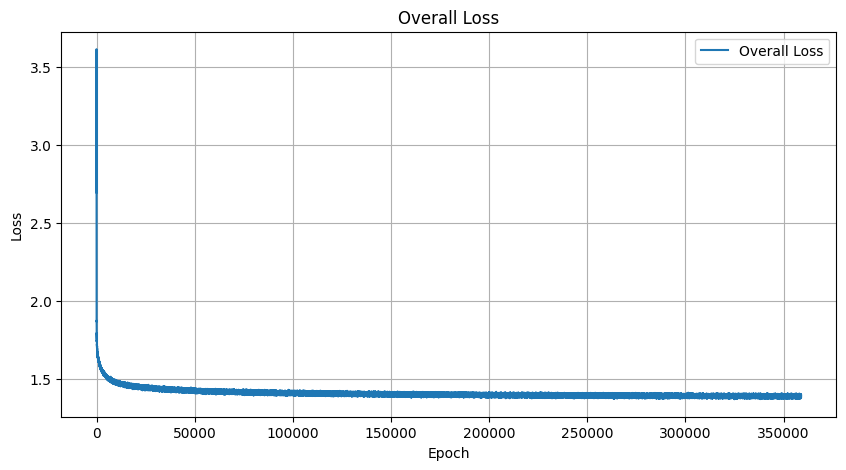

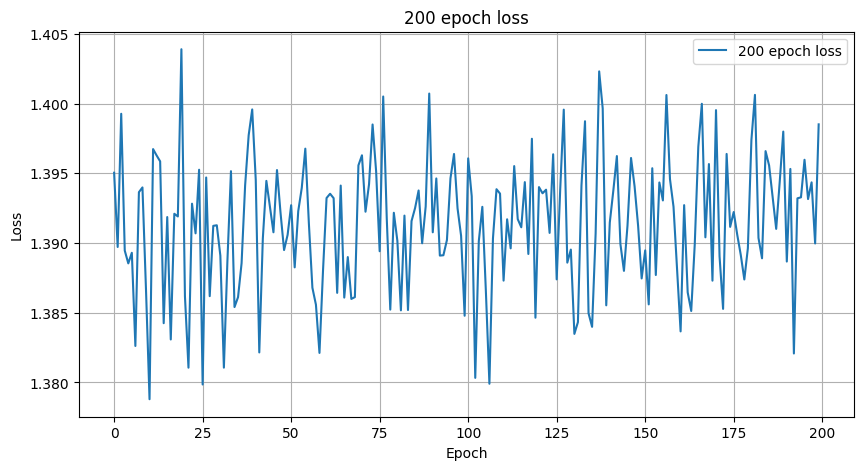

Epoch [1819701], Loss: 1.3988
Epoch [1819702], Loss: 1.4039
Epoch [1819703], Loss: 1.3907
Epoch [1819704], Loss: 1.3901
Epoch [1819705], Loss: 1.3884
Epoch [1819706], Loss: 1.3950
Epoch [1819707], Loss: 1.3998
Epoch [1819708], Loss: 1.3817
Epoch [1819709], Loss: 1.3823
Epoch [1819710], Loss: 1.3790
Epoch [1819711], Loss: 1.3907
Epoch [1819712], Loss: 1.3890
Epoch [1819713], Loss: 1.3847
Epoch [1819714], Loss: 1.3836
Epoch [1819715], Loss: 1.3870
Epoch [1819716], Loss: 1.3875
Epoch [1819717], Loss: 1.3983
Epoch [1819718], Loss: 1.3982
Epoch [1819719], Loss: 1.3948
Epoch [1819720], Loss: 1.3927
Epoch [1819721], Loss: 1.3890
Epoch [1819722], Loss: 1.3902
Epoch [1819723], Loss: 1.3916
Epoch [1819724], Loss: 1.3822
Epoch [1819725], Loss: 1.3988
Epoch [1819726], Loss: 1.4030
Epoch [1819727], Loss: 1.3952
Epoch [1819728], Loss: 1.3850
Epoch [1819729], Loss: 1.3879
Epoch [1819730], Loss: 1.3977
Epoch [1819731], Loss: 1.3924
Epoch [1819732], Loss: 1.3947
Epoch [1819733], Loss: 1.3881
Epoch [181

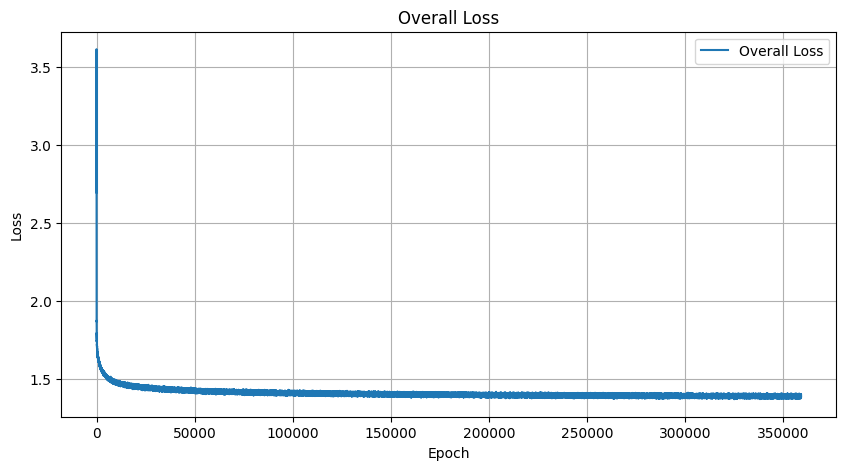

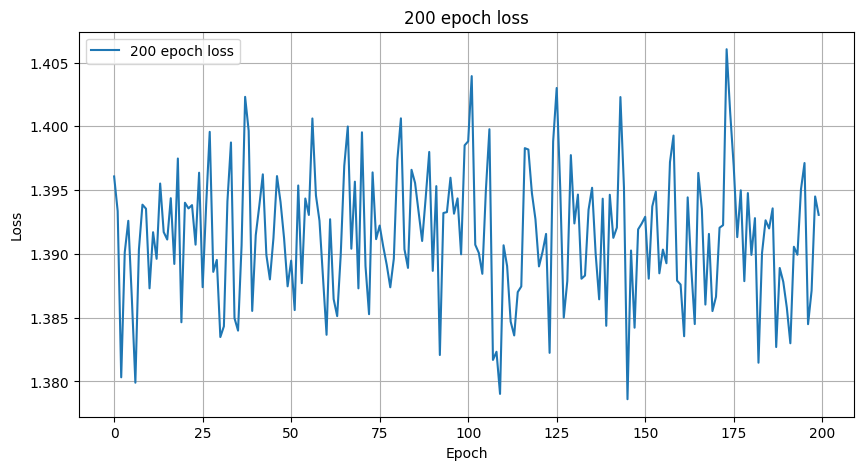

Epoch [1819801], Loss: 1.3847
Epoch [1819802], Loss: 1.4012
Epoch [1819803], Loss: 1.3919
Epoch [1819804], Loss: 1.3880
Epoch [1819805], Loss: 1.4015
Epoch [1819806], Loss: 1.3912
Epoch [1819807], Loss: 1.3905
Epoch [1819808], Loss: 1.3950
Epoch [1819809], Loss: 1.3921
Epoch [1819810], Loss: 1.3935
Epoch [1819811], Loss: 1.3995
Epoch [1819812], Loss: 1.3871
Epoch [1819813], Loss: 1.3908
Epoch [1819814], Loss: 1.3961
Epoch [1819815], Loss: 1.3899
Epoch [1819816], Loss: 1.4013
Epoch [1819817], Loss: 1.3837
Epoch [1819818], Loss: 1.3936
Epoch [1819819], Loss: 1.3918
Epoch [1819820], Loss: 1.3758
Epoch [1819821], Loss: 1.3830
Epoch [1819822], Loss: 1.3905
Epoch [1819823], Loss: 1.3921
Epoch [1819824], Loss: 1.3955
Epoch [1819825], Loss: 1.3897
Epoch [1819826], Loss: 1.3857
Epoch [1819827], Loss: 1.3857
Epoch [1819828], Loss: 1.3996
Epoch [1819829], Loss: 1.3897
Epoch [1819830], Loss: 1.3962
Epoch [1819831], Loss: 1.3888
Epoch [1819832], Loss: 1.3818
Epoch [1819833], Loss: 1.3934
Epoch [181

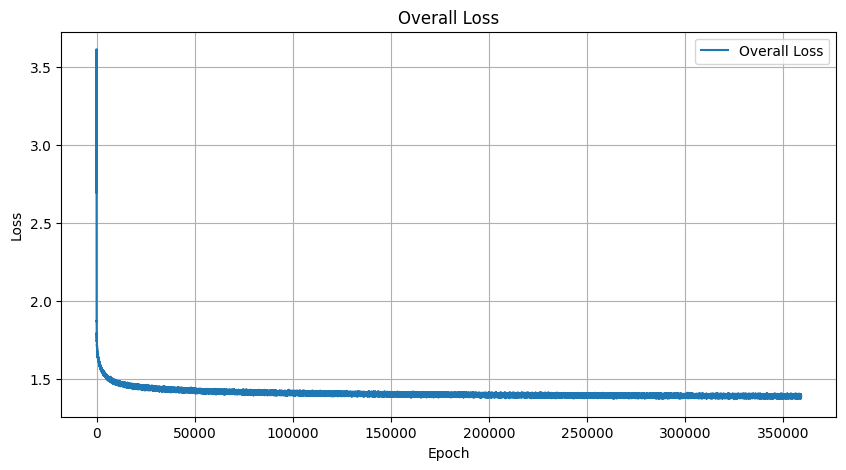

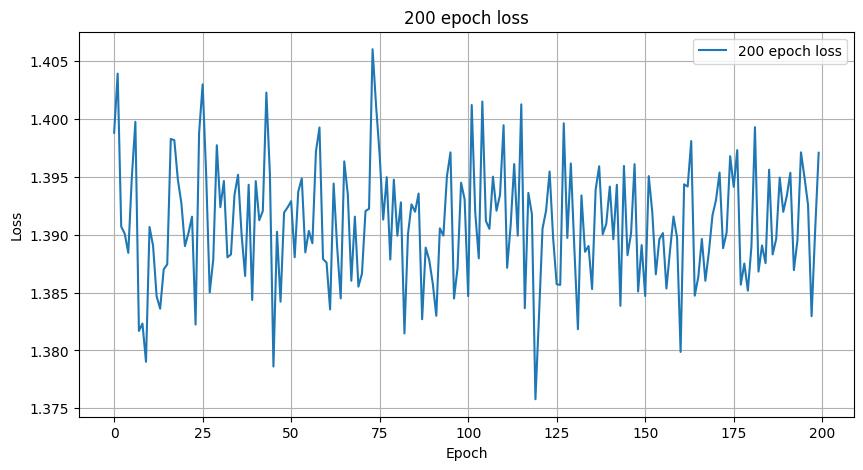

Epoch [1819901], Loss: 1.3900
Epoch [1819902], Loss: 1.4018
Epoch [1819903], Loss: 1.3944
Epoch [1819904], Loss: 1.3891
Epoch [1819905], Loss: 1.4059
Epoch [1819906], Loss: 1.3974
Epoch [1819907], Loss: 1.3895
Epoch [1819908], Loss: 1.3768
Epoch [1819909], Loss: 1.3985
Epoch [1819910], Loss: 1.3928
Epoch [1819911], Loss: 1.3997
Epoch [1819912], Loss: 1.3821
Epoch [1819913], Loss: 1.3862
Epoch [1819914], Loss: 1.3932
Epoch [1819915], Loss: 1.3904
Epoch [1819916], Loss: 1.3897
Epoch [1819917], Loss: 1.3928
Epoch [1819918], Loss: 1.3957
Epoch [1819919], Loss: 1.4005
Epoch [1819920], Loss: 1.4032
Epoch [1819921], Loss: 1.3923
Epoch [1819922], Loss: 1.3854
Epoch [1819923], Loss: 1.3952
Epoch [1819924], Loss: 1.3968
Epoch [1819925], Loss: 1.3858
Epoch [1819926], Loss: 1.3917
Epoch [1819927], Loss: 1.3889
Epoch [1819928], Loss: 1.3952
Epoch [1819929], Loss: 1.3956
Epoch [1819930], Loss: 1.3841
Epoch [1819931], Loss: 1.3839
Epoch [1819932], Loss: 1.3917
Epoch [1819933], Loss: 1.3962
Epoch [181

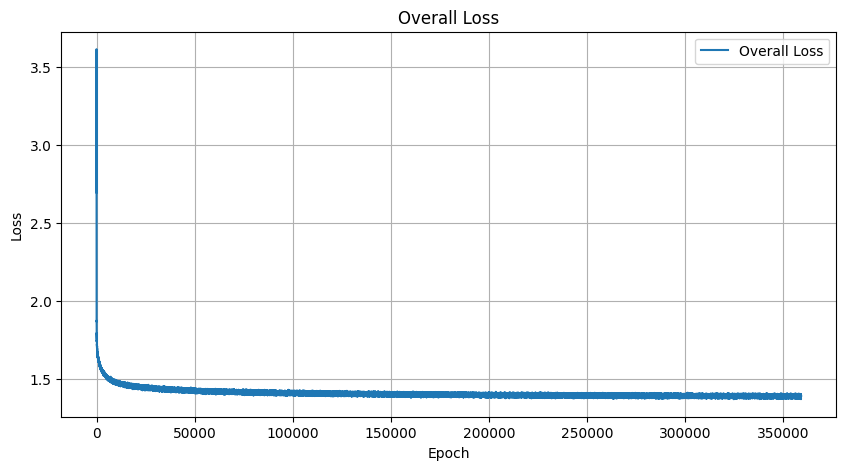

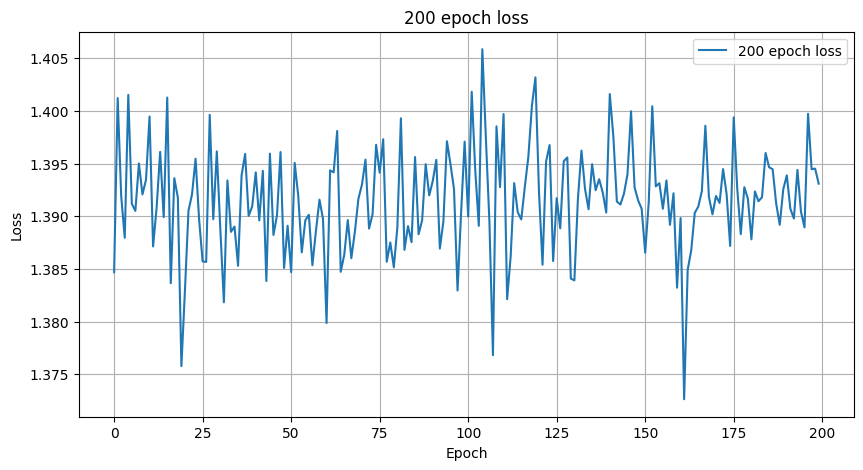

Epoch [1820001], Loss: 1.3839
Epoch [1820002], Loss: 1.3810
Epoch [1820003], Loss: 1.3921
Epoch [1820004], Loss: 1.3902
Epoch [1820005], Loss: 1.3890
Epoch [1820006], Loss: 1.3932
Epoch [1820007], Loss: 1.3989
Epoch [1820008], Loss: 1.3936
Epoch [1820009], Loss: 1.3884
Epoch [1820010], Loss: 1.3958
Epoch [1820011], Loss: 1.3911
Epoch [1820012], Loss: 1.3956
Epoch [1820013], Loss: 1.3937
Epoch [1820014], Loss: 1.3979
Epoch [1820015], Loss: 1.3931
Epoch [1820016], Loss: 1.3836
Epoch [1820017], Loss: 1.3875
Epoch [1820018], Loss: 1.3913
Epoch [1820019], Loss: 1.3906
Epoch [1820020], Loss: 1.3956
Epoch [1820021], Loss: 1.3950
Epoch [1820022], Loss: 1.3871
Epoch [1820023], Loss: 1.3896
Epoch [1820024], Loss: 1.3940
Epoch [1820025], Loss: 1.3943
Epoch [1820026], Loss: 1.3977
Epoch [1820027], Loss: 1.3862
Epoch [1820028], Loss: 1.4016
Epoch [1820029], Loss: 1.3924
Epoch [1820030], Loss: 1.3891
Epoch [1820031], Loss: 1.3855
Epoch [1820032], Loss: 1.3966
Epoch [1820033], Loss: 1.3982
Epoch [182

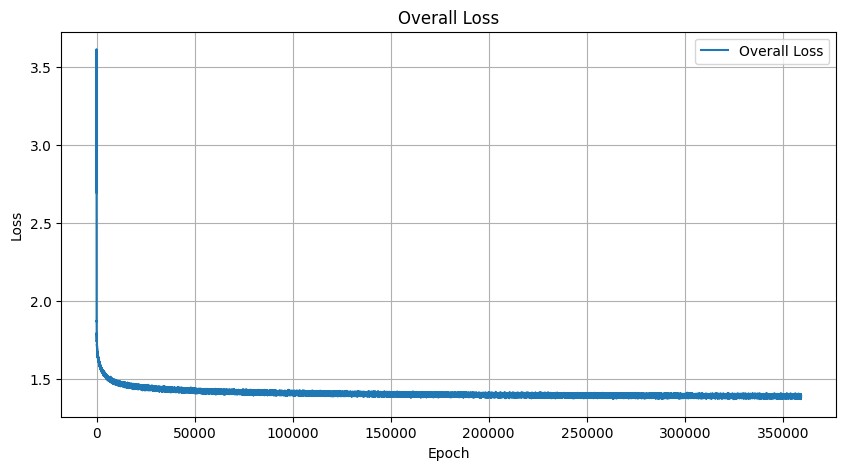

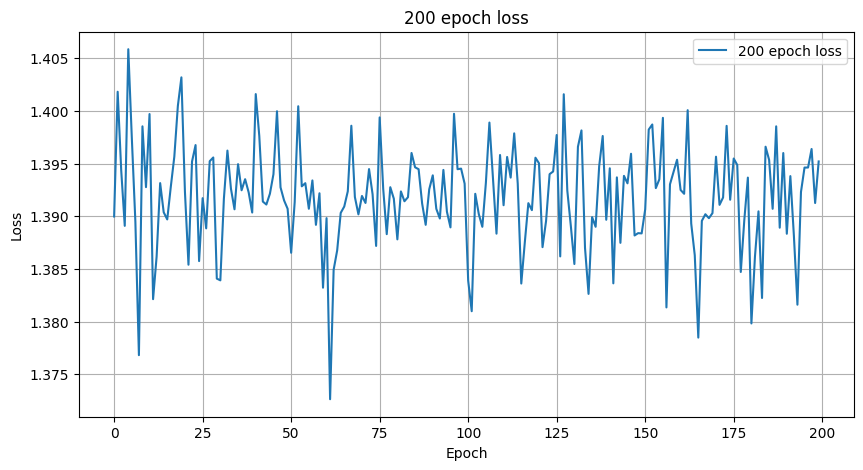

Epoch [1820101], Loss: 1.3998
Epoch [1820102], Loss: 1.3881
Epoch [1820103], Loss: 1.3815
Epoch [1820104], Loss: 1.3923
Epoch [1820105], Loss: 1.3850
Epoch [1820106], Loss: 1.3987
Epoch [1820107], Loss: 1.3826
Epoch [1820108], Loss: 1.3872
Epoch [1820109], Loss: 1.3944
Epoch [1820110], Loss: 1.3903
Epoch [1820111], Loss: 1.3863
Epoch [1820112], Loss: 1.3998
Epoch [1820113], Loss: 1.3985
Epoch [1820114], Loss: 1.3903
Epoch [1820115], Loss: 1.3898
Epoch [1820116], Loss: 1.3858
Epoch [1820117], Loss: 1.3866
Epoch [1820118], Loss: 1.3840
Epoch [1820119], Loss: 1.3962
Epoch [1820120], Loss: 1.4024
Epoch [1820121], Loss: 1.3939
Epoch [1820122], Loss: 1.3851
Epoch [1820123], Loss: 1.3870
Epoch [1820124], Loss: 1.3870
Epoch [1820125], Loss: 1.3927
Epoch [1820126], Loss: 1.3955
Epoch [1820127], Loss: 1.3943
Epoch [1820128], Loss: 1.3940
Epoch [1820129], Loss: 1.3879
Epoch [1820130], Loss: 1.3876
Epoch [1820131], Loss: 1.3908
Epoch [1820132], Loss: 1.3949
Epoch [1820133], Loss: 1.3935
Epoch [182

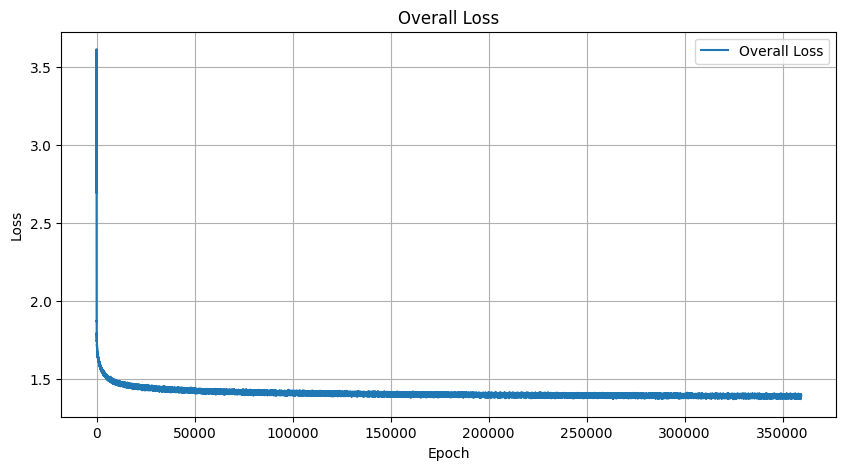

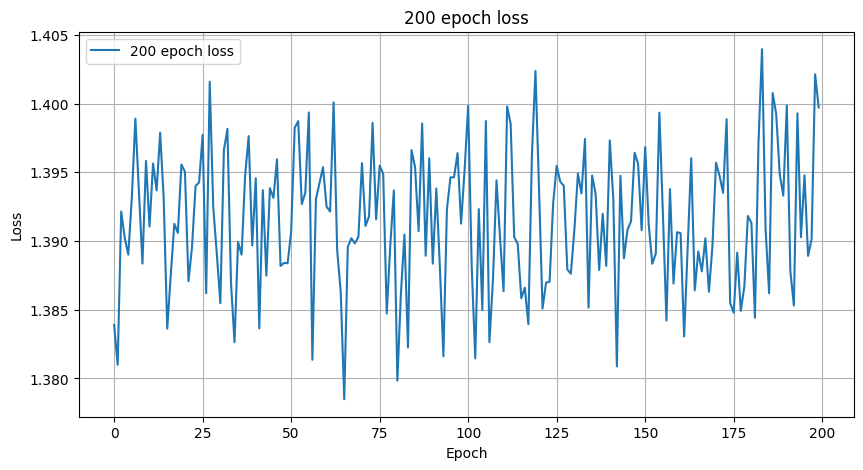

Epoch [1820201], Loss: 1.3922
Epoch [1820202], Loss: 1.3983
Epoch [1820203], Loss: 1.3822
Epoch [1820204], Loss: 1.3890
Epoch [1820205], Loss: 1.3936
Epoch [1820206], Loss: 1.3899
Epoch [1820207], Loss: 1.3906
Epoch [1820208], Loss: 1.3899
Epoch [1820209], Loss: 1.3857
Epoch [1820210], Loss: 1.3880
Epoch [1820211], Loss: 1.3955
Epoch [1820212], Loss: 1.3963
Epoch [1820213], Loss: 1.3858
Epoch [1820214], Loss: 1.3946
Epoch [1820215], Loss: 1.3938
Epoch [1820216], Loss: 1.3877
Epoch [1820217], Loss: 1.3931
Epoch [1820218], Loss: 1.4011
Epoch [1820219], Loss: 1.3963
Epoch [1820220], Loss: 1.3923
Epoch [1820221], Loss: 1.3996
Epoch [1820222], Loss: 1.3958
Epoch [1820223], Loss: 1.3903
Epoch [1820224], Loss: 1.3968
Epoch [1820225], Loss: 1.3997
Epoch [1820226], Loss: 1.3893
Epoch [1820227], Loss: 1.4048
Epoch [1820228], Loss: 1.3933
Epoch [1820229], Loss: 1.3949
Epoch [1820230], Loss: 1.3860
Epoch [1820231], Loss: 1.3967
Epoch [1820232], Loss: 1.3925
Epoch [1820233], Loss: 1.3936
Epoch [182

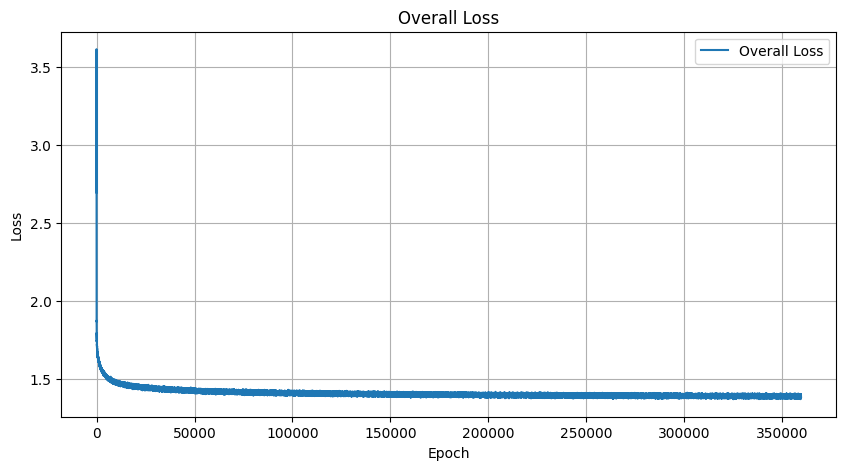

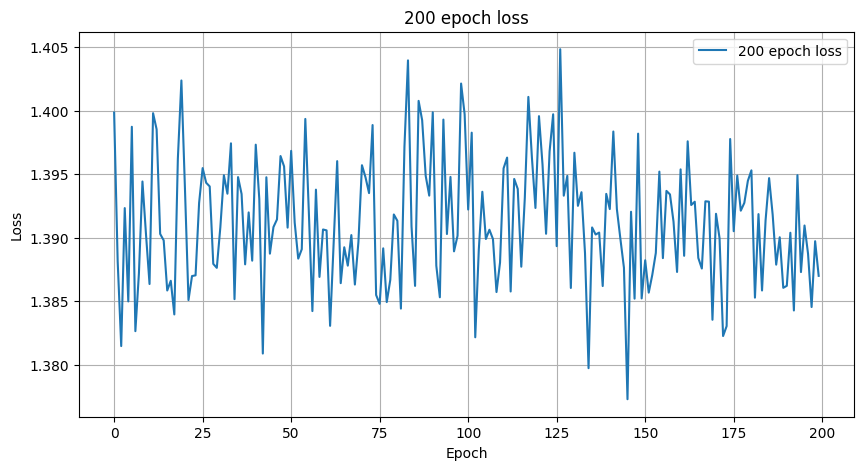

Epoch [1820301], Loss: 1.3823
Epoch [1820302], Loss: 1.3937
Epoch [1820303], Loss: 1.3886
Epoch [1820304], Loss: 1.3990
Epoch [1820305], Loss: 1.3962
Epoch [1820306], Loss: 1.3996
Epoch [1820307], Loss: 1.3877
Epoch [1820308], Loss: 1.4029
Epoch [1820309], Loss: 1.3813
Epoch [1820310], Loss: 1.3997
Epoch [1820311], Loss: 1.3825
Epoch [1820312], Loss: 1.3818
Epoch [1820313], Loss: 1.3953
Epoch [1820314], Loss: 1.3872
Epoch [1820315], Loss: 1.3898
Epoch [1820316], Loss: 1.3893
Epoch [1820317], Loss: 1.3993
Epoch [1820318], Loss: 1.3970
Epoch [1820319], Loss: 1.3942
Epoch [1820320], Loss: 1.3854
Epoch [1820321], Loss: 1.4000
Epoch [1820322], Loss: 1.3907
Epoch [1820323], Loss: 1.3927
Epoch [1820324], Loss: 1.3968
Epoch [1820325], Loss: 1.4036
Epoch [1820326], Loss: 1.3904
Epoch [1820327], Loss: 1.3860
Epoch [1820328], Loss: 1.3859
Epoch [1820329], Loss: 1.3859
Epoch [1820330], Loss: 1.3896
Epoch [1820331], Loss: 1.3842
Epoch [1820332], Loss: 1.3920
Epoch [1820333], Loss: 1.3897
Epoch [182

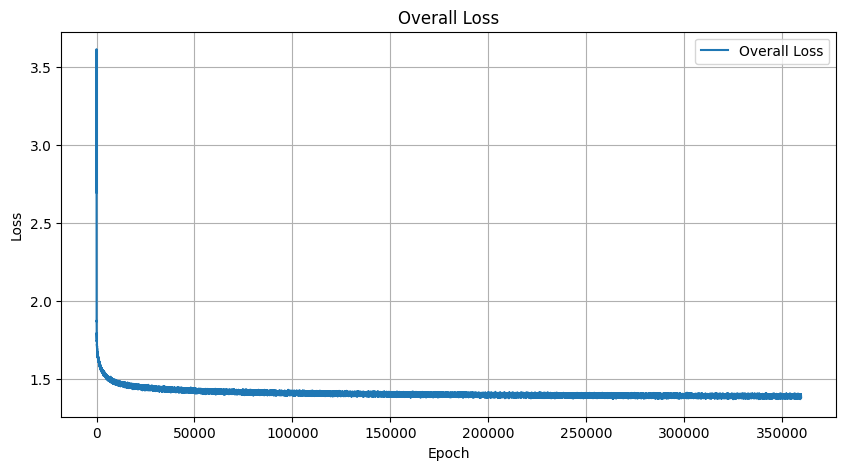

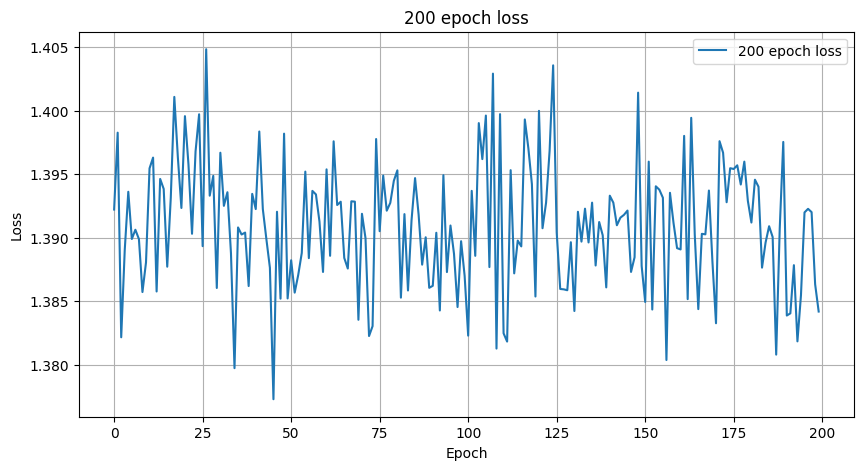

Epoch [1820401], Loss: 1.3940
Epoch [1820402], Loss: 1.3894
Epoch [1820403], Loss: 1.3926
Epoch [1820404], Loss: 1.3844
Epoch [1820405], Loss: 1.4067
Epoch [1820406], Loss: 1.3957
Epoch [1820407], Loss: 1.3887
Epoch [1820408], Loss: 1.4025
Epoch [1820409], Loss: 1.3914
Epoch [1820410], Loss: 1.4042
Epoch [1820411], Loss: 1.3963
Epoch [1820412], Loss: 1.3828
Epoch [1820413], Loss: 1.3937
Epoch [1820414], Loss: 1.3923
Epoch [1820415], Loss: 1.3838
Epoch [1820416], Loss: 1.3826
Epoch [1820417], Loss: 1.3946
Epoch [1820418], Loss: 1.3923
Epoch [1820419], Loss: 1.3906
Epoch [1820420], Loss: 1.3876
Epoch [1820421], Loss: 1.3924
Epoch [1820422], Loss: 1.3834
Epoch [1820423], Loss: 1.3918
Epoch [1820424], Loss: 1.3879
Epoch [1820425], Loss: 1.3900
Epoch [1820426], Loss: 1.3898
Epoch [1820427], Loss: 1.3928
Epoch [1820428], Loss: 1.3951
Epoch [1820429], Loss: 1.3909
Epoch [1820430], Loss: 1.3898
Epoch [1820431], Loss: 1.3838
Epoch [1820432], Loss: 1.3962
Epoch [1820433], Loss: 1.3814
Epoch [182

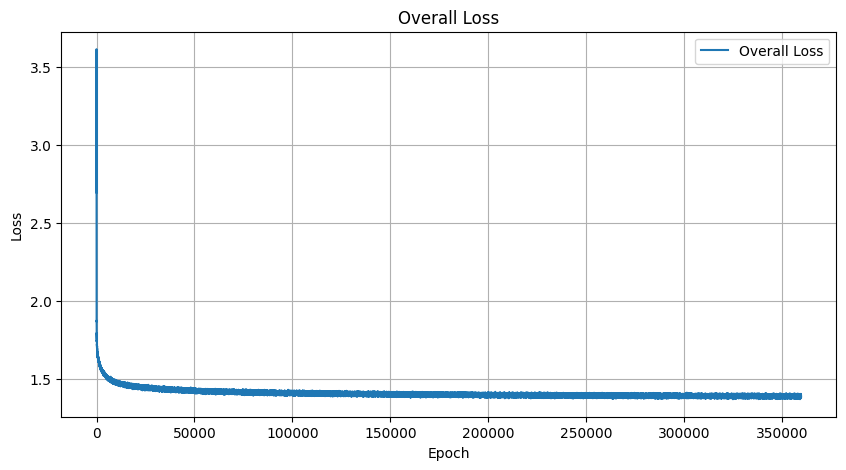

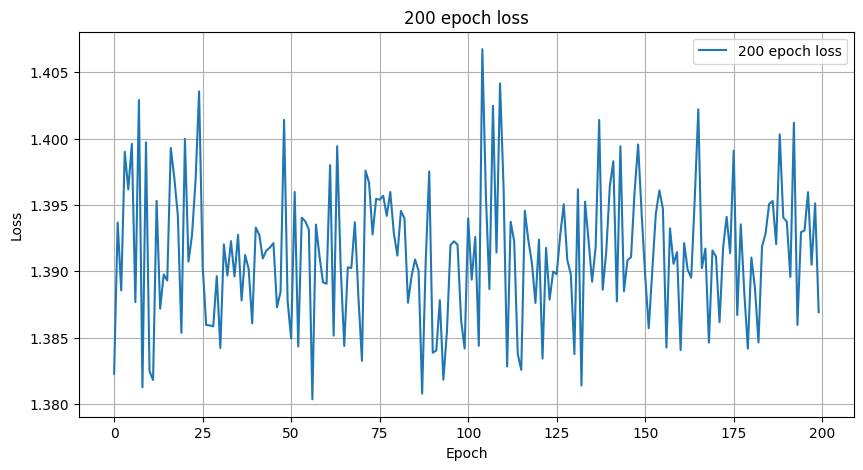

Epoch [1820501], Loss: 1.3859
Epoch [1820502], Loss: 1.3944
Epoch [1820503], Loss: 1.3944
Epoch [1820504], Loss: 1.3895
Epoch [1820505], Loss: 1.3943
Epoch [1820506], Loss: 1.3912
Epoch [1820507], Loss: 1.3921
Epoch [1820508], Loss: 1.3994
Epoch [1820509], Loss: 1.3937
Epoch [1820510], Loss: 1.3964
Epoch [1820511], Loss: 1.3899
Epoch [1820512], Loss: 1.3927
Epoch [1820513], Loss: 1.3919
Epoch [1820514], Loss: 1.3755
Epoch [1820515], Loss: 1.3855
Epoch [1820516], Loss: 1.3924
Epoch [1820517], Loss: 1.3890
Epoch [1820518], Loss: 1.3927
Epoch [1820519], Loss: 1.3800
Epoch [1820520], Loss: 1.3976
Epoch [1820521], Loss: 1.3885
Epoch [1820522], Loss: 1.3936
Epoch [1820523], Loss: 1.3970
Epoch [1820524], Loss: 1.3923
Epoch [1820525], Loss: 1.3827
Epoch [1820526], Loss: 1.3929
Epoch [1820527], Loss: 1.3878
Epoch [1820528], Loss: 1.3919
Epoch [1820529], Loss: 1.3911
Epoch [1820530], Loss: 1.3883
Epoch [1820531], Loss: 1.3987
Epoch [1820532], Loss: 1.3913
Epoch [1820533], Loss: 1.3883
Epoch [182

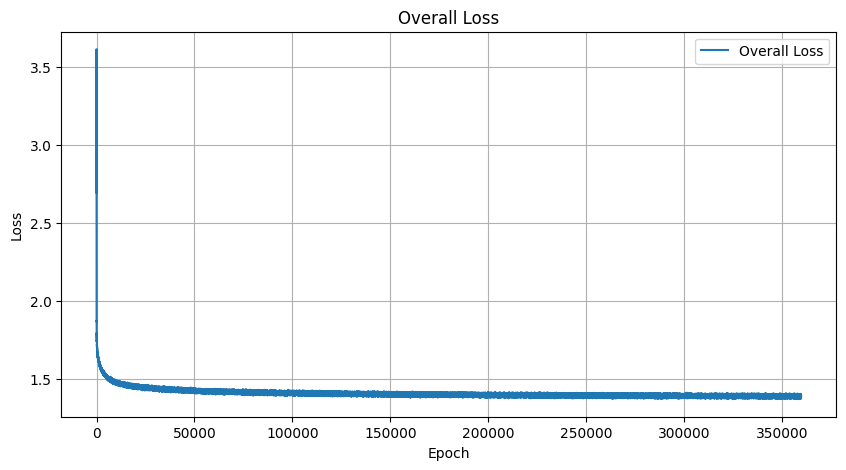

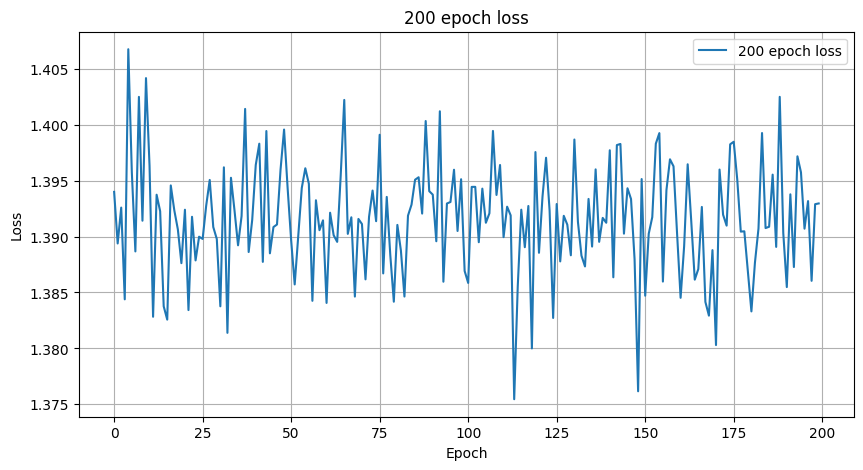

Epoch [1820601], Loss: 1.3853
Epoch [1820602], Loss: 1.3911
Epoch [1820603], Loss: 1.3987
Epoch [1820604], Loss: 1.3910
Epoch [1820605], Loss: 1.3966
Epoch [1820606], Loss: 1.4031
Epoch [1820607], Loss: 1.3930
Epoch [1820608], Loss: 1.3820
Epoch [1820609], Loss: 1.3831
Epoch [1820610], Loss: 1.3863
Epoch [1820611], Loss: 1.3859
Epoch [1820612], Loss: 1.3941
Epoch [1820613], Loss: 1.3899
Epoch [1820614], Loss: 1.3954
Epoch [1820615], Loss: 1.3931
Epoch [1820616], Loss: 1.3870
Epoch [1820617], Loss: 1.3954
Epoch [1820618], Loss: 1.3965
Epoch [1820619], Loss: 1.3930
Epoch [1820620], Loss: 1.3976
Epoch [1820621], Loss: 1.3913
Epoch [1820622], Loss: 1.3855
Epoch [1820623], Loss: 1.3946
Epoch [1820624], Loss: 1.3947
Epoch [1820625], Loss: 1.3895
Epoch [1820626], Loss: 1.3848
Epoch [1820627], Loss: 1.3987
Epoch [1820628], Loss: 1.3993
Epoch [1820629], Loss: 1.4033
Epoch [1820630], Loss: 1.3933
Epoch [1820631], Loss: 1.3909
Epoch [1820632], Loss: 1.3982
Epoch [1820633], Loss: 1.3893
Epoch [182

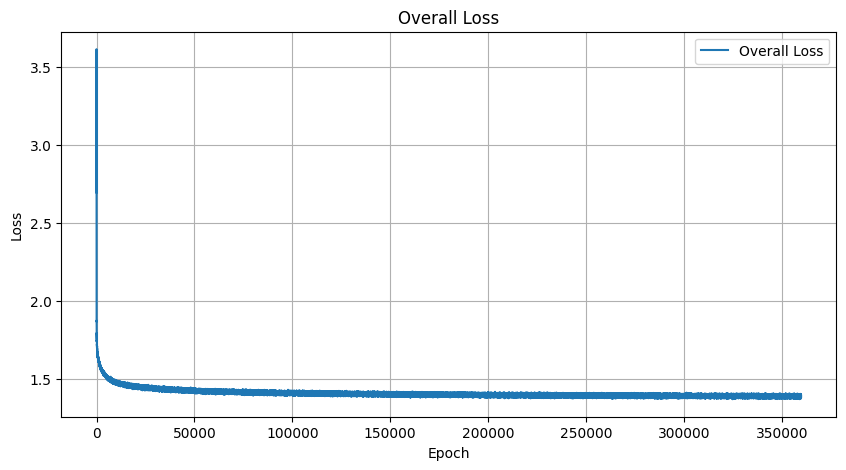

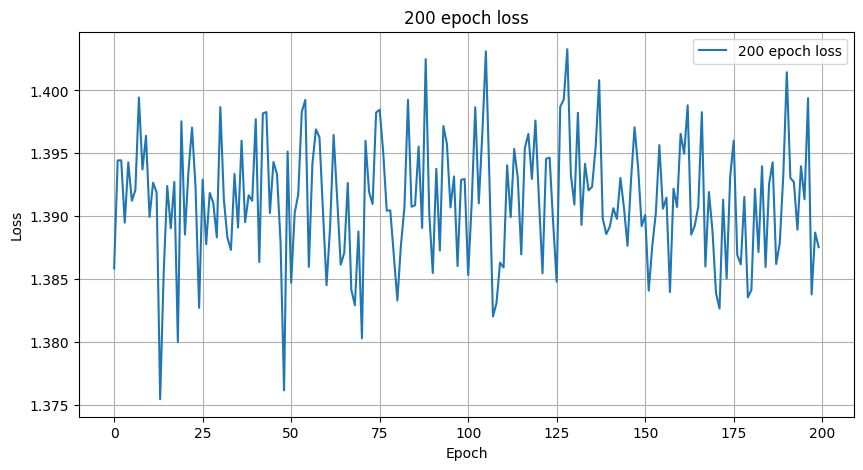

Epoch [1820701], Loss: 1.3856
Epoch [1820702], Loss: 1.3912
Epoch [1820703], Loss: 1.3893
Epoch [1820704], Loss: 1.3983
Epoch [1820705], Loss: 1.3900
Epoch [1820706], Loss: 1.3892
Epoch [1820707], Loss: 1.3893
Epoch [1820708], Loss: 1.3925
Epoch [1820709], Loss: 1.3871
Epoch [1820710], Loss: 1.3964
Epoch [1820711], Loss: 1.3843
Epoch [1820712], Loss: 1.3886
Epoch [1820713], Loss: 1.3978
Epoch [1820714], Loss: 1.4001
Epoch [1820715], Loss: 1.3923
Epoch [1820716], Loss: 1.3967
Epoch [1820717], Loss: 1.3819
Epoch [1820718], Loss: 1.3947
Epoch [1820719], Loss: 1.3925
Epoch [1820720], Loss: 1.3871
Epoch [1820721], Loss: 1.3990
Epoch [1820722], Loss: 1.3925
Epoch [1820723], Loss: 1.3855
Epoch [1820724], Loss: 1.3918
Epoch [1820725], Loss: 1.3935
Epoch [1820726], Loss: 1.3960
Epoch [1820727], Loss: 1.3972
Epoch [1820728], Loss: 1.3847
Epoch [1820729], Loss: 1.3864
Epoch [1820730], Loss: 1.3941
Epoch [1820731], Loss: 1.3914
Epoch [1820732], Loss: 1.3839
Epoch [1820733], Loss: 1.3850
Epoch [182

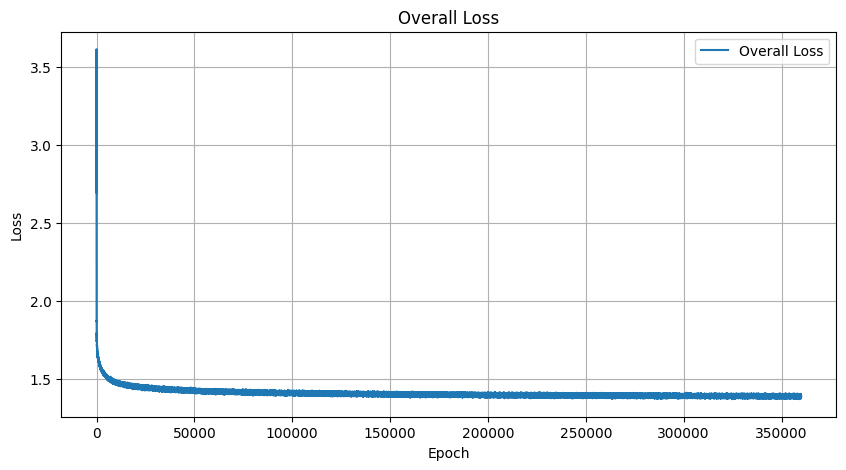

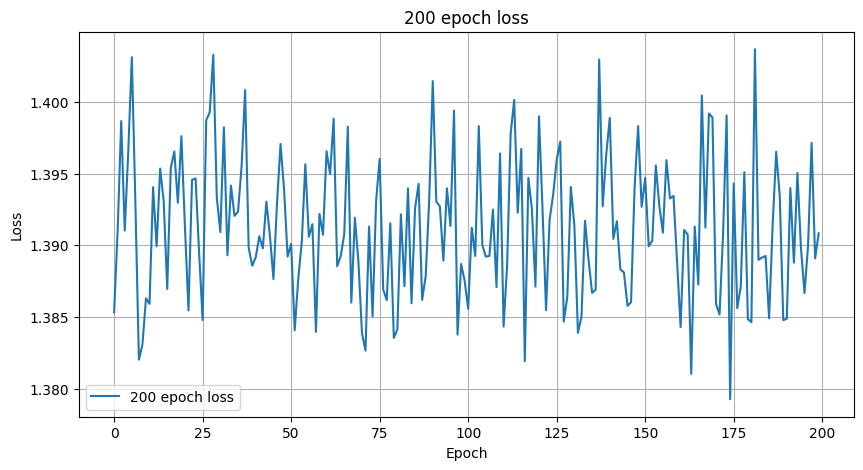

Epoch [1820801], Loss: 1.3849
Epoch [1820802], Loss: 1.4030
Epoch [1820803], Loss: 1.3898
Epoch [1820804], Loss: 1.3977
Epoch [1820805], Loss: 1.3876
Epoch [1820806], Loss: 1.3934
Epoch [1820807], Loss: 1.3851
Epoch [1820808], Loss: 1.3957
Epoch [1820809], Loss: 1.3939
Epoch [1820810], Loss: 1.3988
Epoch [1820811], Loss: 1.3939
Epoch [1820812], Loss: 1.3928
Epoch [1820813], Loss: 1.3839
Epoch [1820814], Loss: 1.3928
Epoch [1820815], Loss: 1.3892
Epoch [1820816], Loss: 1.3902
Epoch [1820817], Loss: 1.3959
Epoch [1820818], Loss: 1.3902
Epoch [1820819], Loss: 1.4021
Epoch [1820820], Loss: 1.3990
Epoch [1820821], Loss: 1.3906
Epoch [1820822], Loss: 1.3874
Epoch [1820823], Loss: 1.3889
Epoch [1820824], Loss: 1.3949
Epoch [1820825], Loss: 1.3866
Epoch [1820826], Loss: 1.3965
Epoch [1820827], Loss: 1.3988
Epoch [1820828], Loss: 1.3879
Epoch [1820829], Loss: 1.3896
Epoch [1820830], Loss: 1.3983
Epoch [1820831], Loss: 1.3992
Epoch [1820832], Loss: 1.3925
Epoch [1820833], Loss: 1.3911
Epoch [182

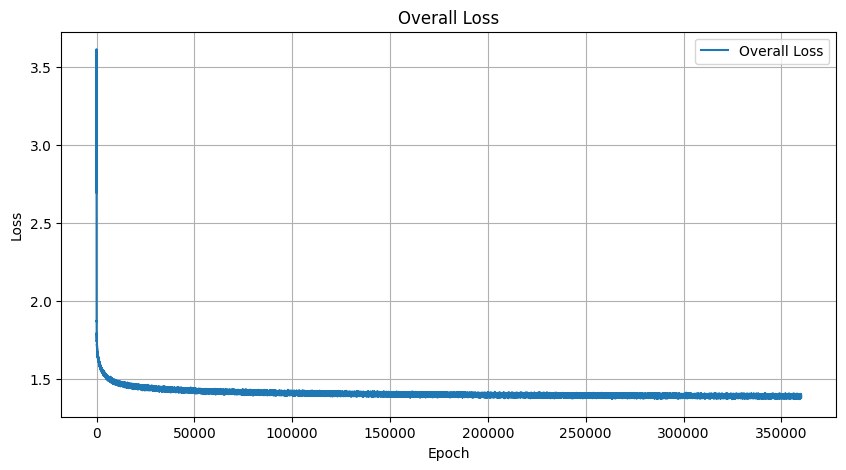

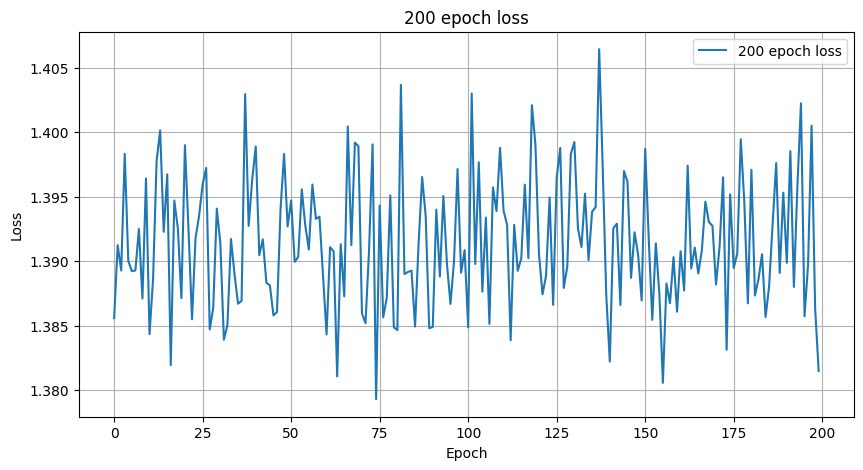

Epoch [1820901], Loss: 1.3841
Epoch [1820902], Loss: 1.3983
Epoch [1820903], Loss: 1.3963
Epoch [1820904], Loss: 1.3933
Epoch [1820905], Loss: 1.3819
Epoch [1820906], Loss: 1.3892
Epoch [1820907], Loss: 1.3947
Epoch [1820908], Loss: 1.3851
Epoch [1820909], Loss: 1.3835
Epoch [1820910], Loss: 1.3880
Epoch [1820911], Loss: 1.3852
Epoch [1820912], Loss: 1.3955
Epoch [1820913], Loss: 1.3824
Epoch [1820914], Loss: 1.3837
Epoch [1820915], Loss: 1.3986
Epoch [1820916], Loss: 1.3941
Epoch [1820917], Loss: 1.3909
Epoch [1820918], Loss: 1.3886
Epoch [1820919], Loss: 1.3915
Epoch [1820920], Loss: 1.3984
Epoch [1820921], Loss: 1.4023
Epoch [1820922], Loss: 1.3947
Epoch [1820923], Loss: 1.3901
Epoch [1820924], Loss: 1.3957
Epoch [1820925], Loss: 1.3932
Epoch [1820926], Loss: 1.3883
Epoch [1820927], Loss: 1.3898
Epoch [1820928], Loss: 1.3851
Epoch [1820929], Loss: 1.3870
Epoch [1820930], Loss: 1.3887
Epoch [1820931], Loss: 1.3889
Epoch [1820932], Loss: 1.3964
Epoch [1820933], Loss: 1.3908
Epoch [182

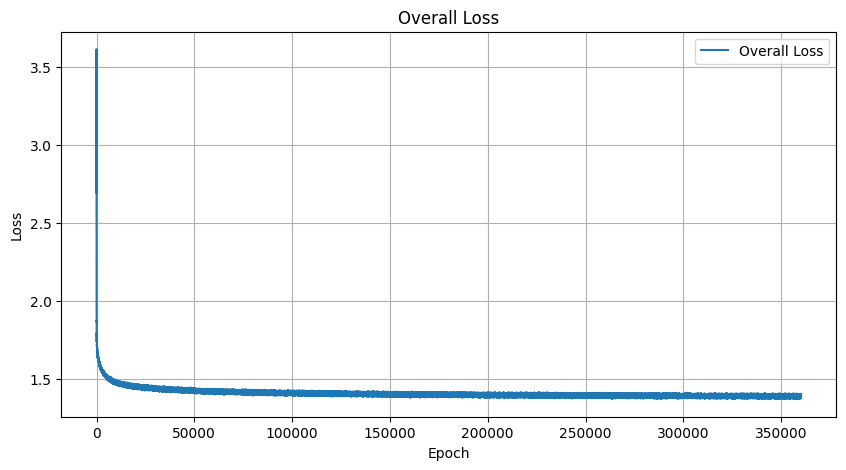

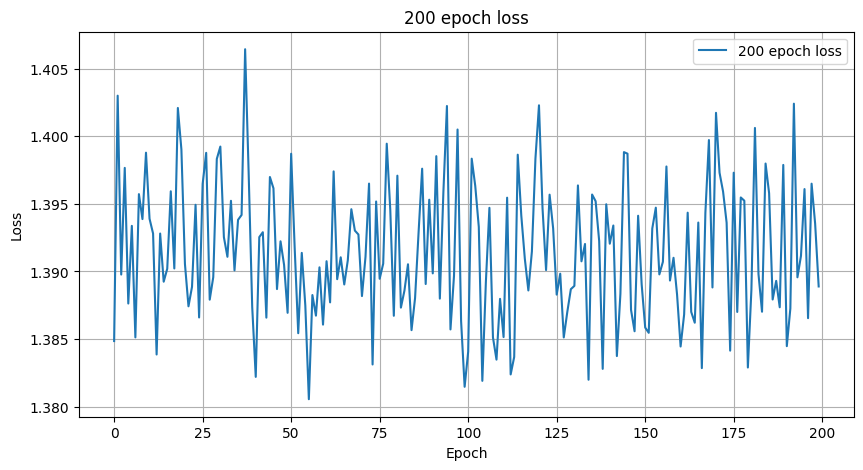

Epoch [1821001], Loss: 1.3958
Epoch [1821002], Loss: 1.3871
Epoch [1821003], Loss: 1.3887
Epoch [1821004], Loss: 1.3911
Epoch [1821005], Loss: 1.3943
Epoch [1821006], Loss: 1.3858
Epoch [1821007], Loss: 1.3924
Epoch [1821008], Loss: 1.3852
Epoch [1821009], Loss: 1.3935
Epoch [1821010], Loss: 1.3802
Epoch [1821011], Loss: 1.3969
Epoch [1821012], Loss: 1.3929
Epoch [1821013], Loss: 1.3929
Epoch [1821014], Loss: 1.3916
Epoch [1821015], Loss: 1.3912
Epoch [1821016], Loss: 1.3944
Epoch [1821017], Loss: 1.3904
Epoch [1821018], Loss: 1.3871
Epoch [1821019], Loss: 1.3945
Epoch [1821020], Loss: 1.3924
Epoch [1821021], Loss: 1.3848
Epoch [1821022], Loss: 1.4028
Epoch [1821023], Loss: 1.3924
Epoch [1821024], Loss: 1.3925
Epoch [1821025], Loss: 1.3898
Epoch [1821026], Loss: 1.3877
Epoch [1821027], Loss: 1.3869
Epoch [1821028], Loss: 1.3884
Epoch [1821029], Loss: 1.3850
Epoch [1821030], Loss: 1.3932
Epoch [1821031], Loss: 1.3901
Epoch [1821032], Loss: 1.3943
Epoch [1821033], Loss: 1.4055
Epoch [182

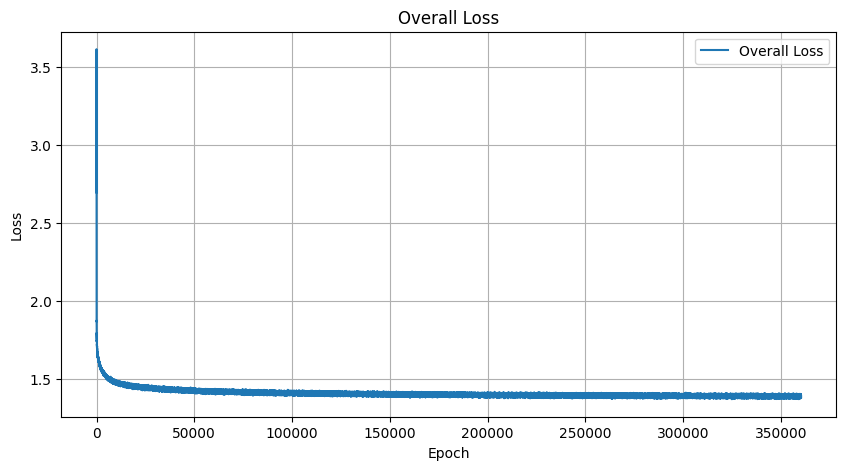

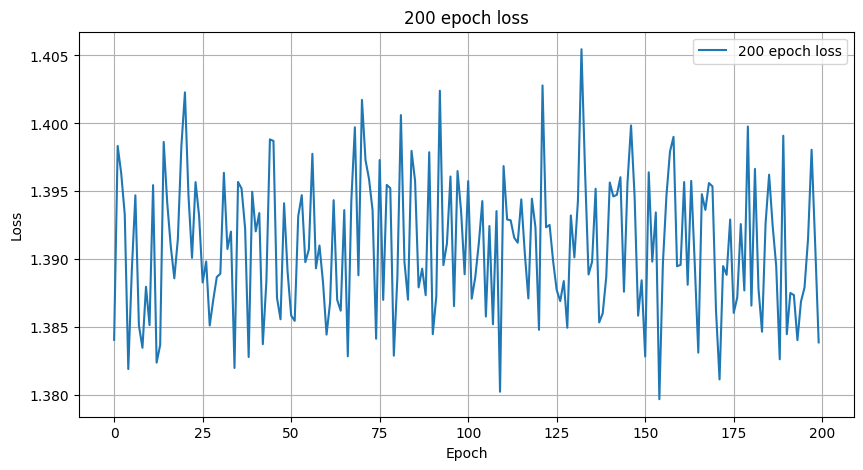

Epoch [1821101], Loss: 1.3927
Epoch [1821102], Loss: 1.3927
Epoch [1821103], Loss: 1.3891
Epoch [1821104], Loss: 1.4036
Epoch [1821105], Loss: 1.3865
Epoch [1821106], Loss: 1.3875
Epoch [1821107], Loss: 1.3868
Epoch [1821108], Loss: 1.3898
Epoch [1821109], Loss: 1.3916
Epoch [1821110], Loss: 1.3904
Epoch [1821111], Loss: 1.4011
Epoch [1821112], Loss: 1.3999
Epoch [1821113], Loss: 1.3902
Epoch [1821114], Loss: 1.3909
Epoch [1821115], Loss: 1.3992
Epoch [1821116], Loss: 1.3936
Epoch [1821117], Loss: 1.3946
Epoch [1821118], Loss: 1.3942
Epoch [1821119], Loss: 1.3907
Epoch [1821120], Loss: 1.3918
Epoch [1821121], Loss: 1.3958
Epoch [1821122], Loss: 1.3893
Epoch [1821123], Loss: 1.3954
Epoch [1821124], Loss: 1.3948
Epoch [1821125], Loss: 1.3876
Epoch [1821126], Loss: 1.3864
Epoch [1821127], Loss: 1.3963
Epoch [1821128], Loss: 1.3872
Epoch [1821129], Loss: 1.3876
Epoch [1821130], Loss: 1.3908
Epoch [1821131], Loss: 1.3988
Epoch [1821132], Loss: 1.3861
Epoch [1821133], Loss: 1.3895
Epoch [182

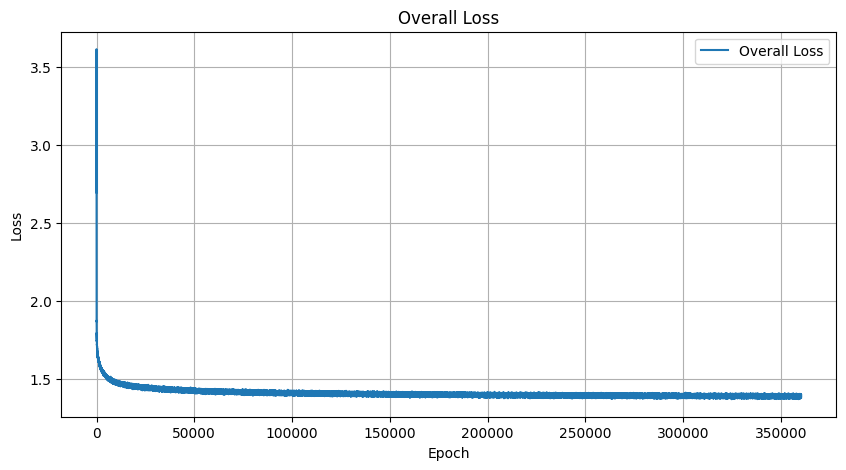

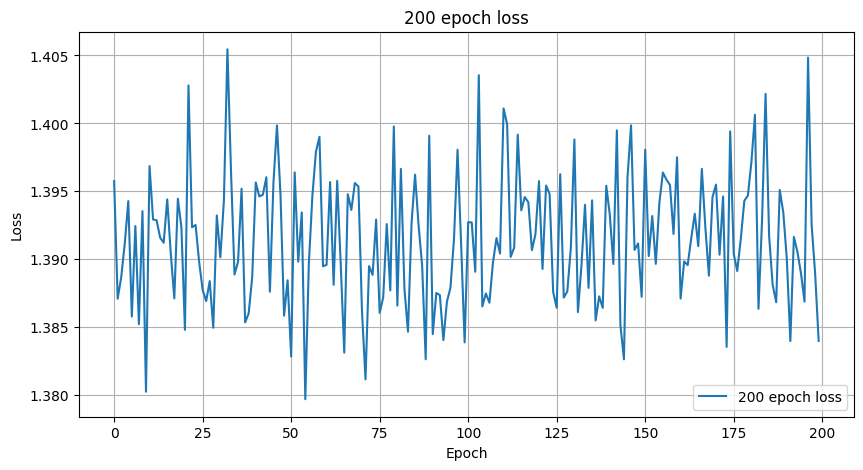

Epoch [1821201], Loss: 1.3932
Epoch [1821202], Loss: 1.3846
Epoch [1821203], Loss: 1.3971
Epoch [1821204], Loss: 1.4000
Epoch [1821205], Loss: 1.3881
Epoch [1821206], Loss: 1.3856
Epoch [1821207], Loss: 1.3919
Epoch [1821208], Loss: 1.3923
Epoch [1821209], Loss: 1.3894
Epoch [1821210], Loss: 1.3887
Epoch [1821211], Loss: 1.3942
Epoch [1821212], Loss: 1.3881
Epoch [1821213], Loss: 1.3882
Epoch [1821214], Loss: 1.3866
Epoch [1821215], Loss: 1.3907
Epoch [1821216], Loss: 1.3899
Epoch [1821217], Loss: 1.3943
Epoch [1821218], Loss: 1.3884
Epoch [1821219], Loss: 1.3901
Epoch [1821220], Loss: 1.3898
Epoch [1821221], Loss: 1.3952
Epoch [1821222], Loss: 1.4014
Epoch [1821223], Loss: 1.3919
Epoch [1821224], Loss: 1.3950
Epoch [1821225], Loss: 1.3915
Epoch [1821226], Loss: 1.3881
Epoch [1821227], Loss: 1.3847
Epoch [1821228], Loss: 1.3948
Epoch [1821229], Loss: 1.3861
Epoch [1821230], Loss: 1.3921
Epoch [1821231], Loss: 1.3834
Epoch [1821232], Loss: 1.3837
Epoch [1821233], Loss: 1.3903
Epoch [182

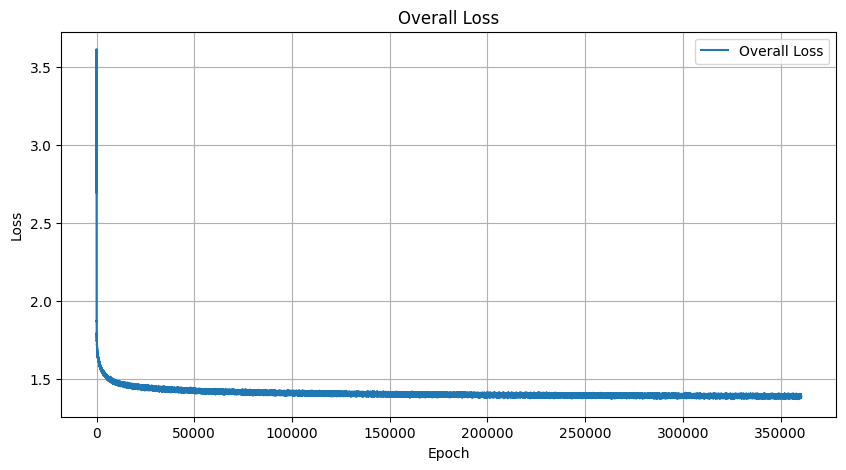

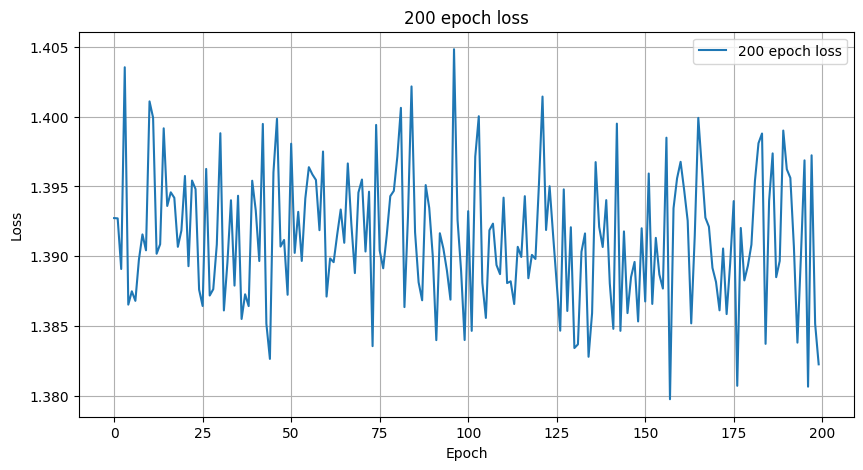

Epoch [1821301], Loss: 1.3901
Epoch [1821302], Loss: 1.3924
Epoch [1821303], Loss: 1.3846
Epoch [1821304], Loss: 1.3944
Epoch [1821305], Loss: 1.3977
Epoch [1821306], Loss: 1.3810
Epoch [1821307], Loss: 1.3993
Epoch [1821308], Loss: 1.3855
Epoch [1821309], Loss: 1.3863
Epoch [1821310], Loss: 1.3903
Epoch [1821311], Loss: 1.3871
Epoch [1821312], Loss: 1.3940
Epoch [1821313], Loss: 1.3827
Epoch [1821314], Loss: 1.3775
Epoch [1821315], Loss: 1.3883
Epoch [1821316], Loss: 1.3970
Epoch [1821317], Loss: 1.3829
Epoch [1821318], Loss: 1.3850
Epoch [1821319], Loss: 1.3856
Epoch [1821320], Loss: 1.3857
Epoch [1821321], Loss: 1.3867
Epoch [1821322], Loss: 1.3935
Epoch [1821323], Loss: 1.3977
Epoch [1821324], Loss: 1.3853
Epoch [1821325], Loss: 1.3969
Epoch [1821326], Loss: 1.3911
Epoch [1821327], Loss: 1.3901
Epoch [1821328], Loss: 1.3937
Epoch [1821329], Loss: 1.3840
Epoch [1821330], Loss: 1.3847
Epoch [1821331], Loss: 1.3906
Epoch [1821332], Loss: 1.3824
Epoch [1821333], Loss: 1.3948
Epoch [182

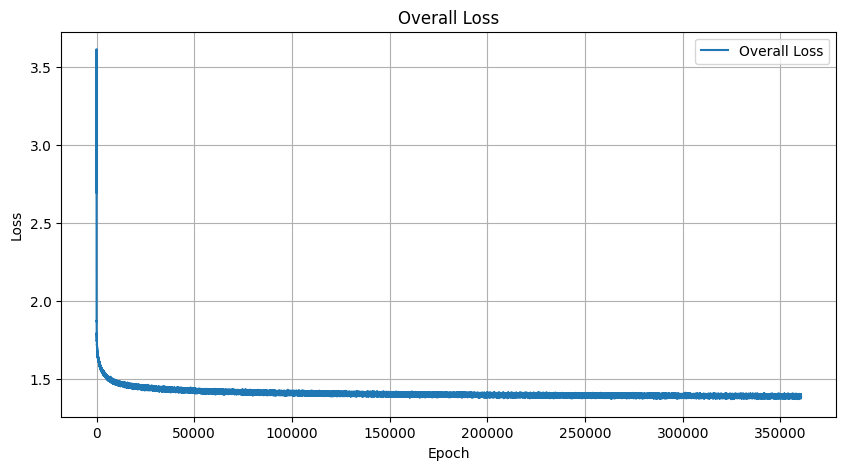

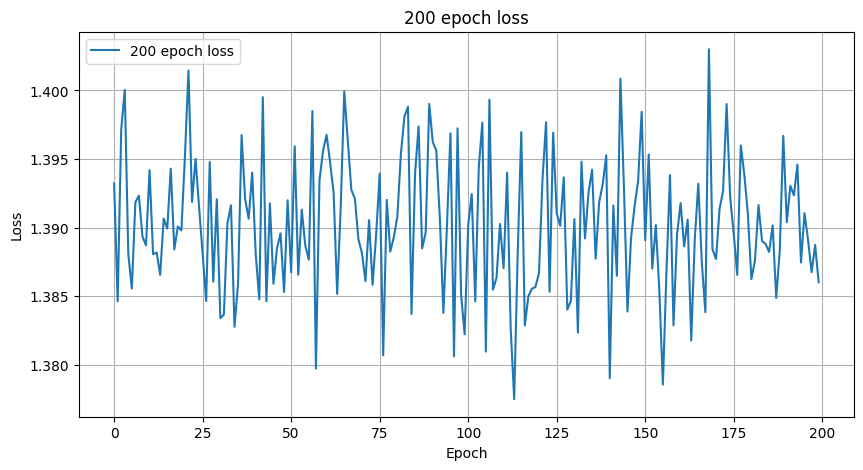

Epoch [1821401], Loss: 1.3919
Epoch [1821402], Loss: 1.3916
Epoch [1821403], Loss: 1.3933
Epoch [1821404], Loss: 1.3938
Epoch [1821405], Loss: 1.3911
Epoch [1821406], Loss: 1.3899
Epoch [1821407], Loss: 1.3829
Epoch [1821408], Loss: 1.3940
Epoch [1821409], Loss: 1.3826
Epoch [1821410], Loss: 1.3927
Epoch [1821411], Loss: 1.3901
Epoch [1821412], Loss: 1.3926
Epoch [1821413], Loss: 1.3885
Epoch [1821414], Loss: 1.3908
Epoch [1821415], Loss: 1.3961
Epoch [1821416], Loss: 1.3995
Epoch [1821417], Loss: 1.3906
Epoch [1821418], Loss: 1.3927
Epoch [1821419], Loss: 1.3927
Epoch [1821420], Loss: 1.3934
Epoch [1821421], Loss: 1.3917
Epoch [1821422], Loss: 1.3831
Epoch [1821423], Loss: 1.3975
Epoch [1821424], Loss: 1.3921
Epoch [1821425], Loss: 1.3914
Epoch [1821426], Loss: 1.4021
Epoch [1821427], Loss: 1.4006
Epoch [1821428], Loss: 1.3889
Epoch [1821429], Loss: 1.3873
Epoch [1821430], Loss: 1.3836
Epoch [1821431], Loss: 1.3982
Epoch [1821432], Loss: 1.3937
Epoch [1821433], Loss: 1.3876
Epoch [182

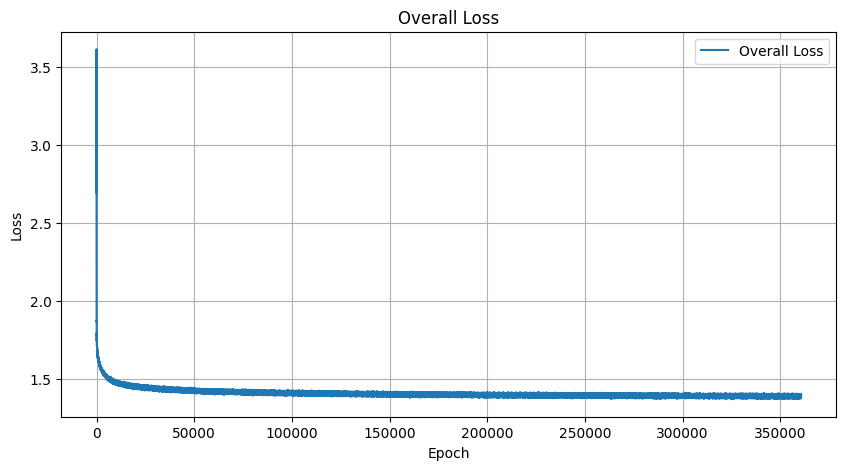

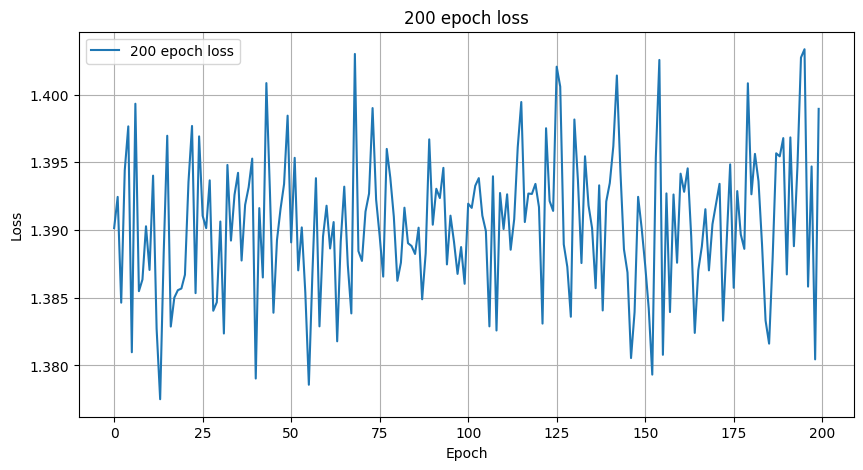

Epoch [1821501], Loss: 1.3944
Epoch [1821502], Loss: 1.3943
Epoch [1821503], Loss: 1.3957
Epoch [1821504], Loss: 1.3868
Epoch [1821505], Loss: 1.3897
Epoch [1821506], Loss: 1.3935
Epoch [1821507], Loss: 1.3918
Epoch [1821508], Loss: 1.3918
Epoch [1821509], Loss: 1.3984
Epoch [1821510], Loss: 1.3944
Epoch [1821511], Loss: 1.3914
Epoch [1821512], Loss: 1.3852
Epoch [1821513], Loss: 1.3947
Epoch [1821514], Loss: 1.3992
Epoch [1821515], Loss: 1.3893
Epoch [1821516], Loss: 1.3931
Epoch [1821517], Loss: 1.3842
Epoch [1821518], Loss: 1.3891
Epoch [1821519], Loss: 1.3916
Epoch [1821520], Loss: 1.3974
Epoch [1821521], Loss: 1.3863
Epoch [1821522], Loss: 1.3951
Epoch [1821523], Loss: 1.3931
Epoch [1821524], Loss: 1.3901
Epoch [1821525], Loss: 1.3877
Epoch [1821526], Loss: 1.4021
Epoch [1821527], Loss: 1.3967
Epoch [1821528], Loss: 1.3876
Epoch [1821529], Loss: 1.3878
Epoch [1821530], Loss: 1.3922
Epoch [1821531], Loss: 1.3863
Epoch [1821532], Loss: 1.3858
Epoch [1821533], Loss: 1.3923
Epoch [182

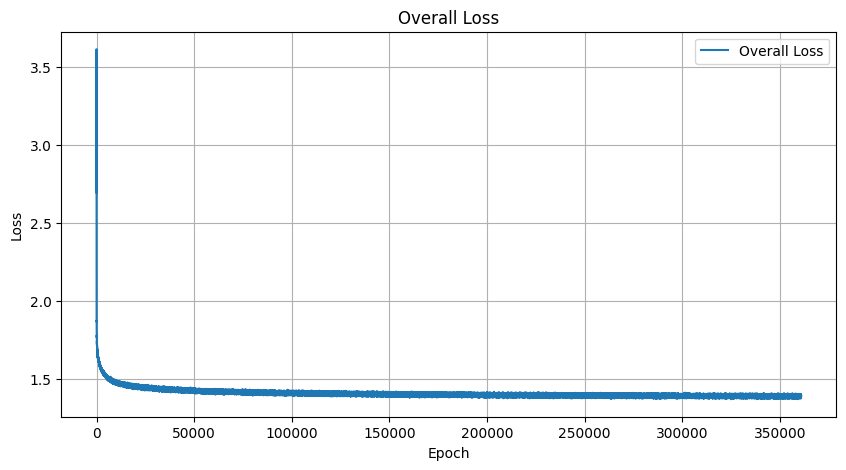

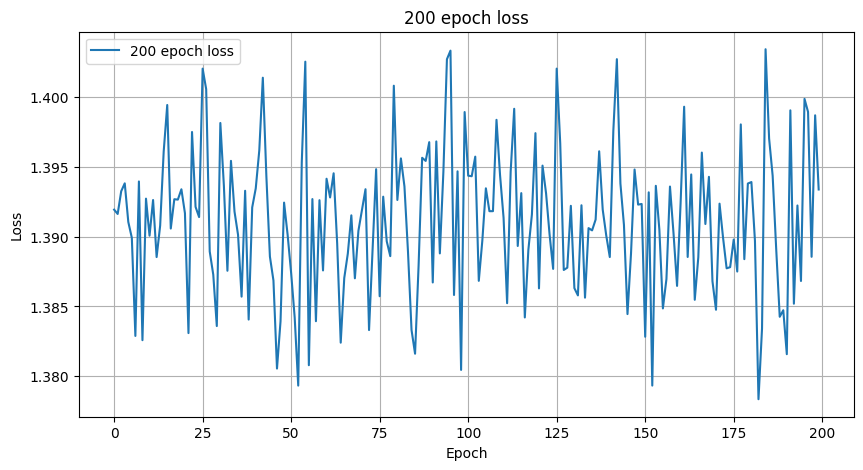

Epoch [1821601], Loss: 1.4008
Epoch [1821602], Loss: 1.3880
Epoch [1821603], Loss: 1.3924
Epoch [1821604], Loss: 1.3893
Epoch [1821605], Loss: 1.3893
Epoch [1821606], Loss: 1.3911
Epoch [1821607], Loss: 1.3862
Epoch [1821608], Loss: 1.3857
Epoch [1821609], Loss: 1.4017
Epoch [1821610], Loss: 1.3937
Epoch [1821611], Loss: 1.3873
Epoch [1821612], Loss: 1.3956
Epoch [1821613], Loss: 1.3910
Epoch [1821614], Loss: 1.3891
Epoch [1821615], Loss: 1.3831
Epoch [1821616], Loss: 1.3925
Epoch [1821617], Loss: 1.3943
Epoch [1821618], Loss: 1.3926
Epoch [1821619], Loss: 1.3966
Epoch [1821620], Loss: 1.3846
Epoch [1821621], Loss: 1.3889
Epoch [1821622], Loss: 1.3948
Epoch [1821623], Loss: 1.3910
Epoch [1821624], Loss: 1.3853
Epoch [1821625], Loss: 1.3910
Epoch [1821626], Loss: 1.3936
Epoch [1821627], Loss: 1.3881
Epoch [1821628], Loss: 1.3918
Epoch [1821629], Loss: 1.3893
Epoch [1821630], Loss: 1.3880
Epoch [1821631], Loss: 1.4018
Epoch [1821632], Loss: 1.3997
Epoch [1821633], Loss: 1.4030
Epoch [182

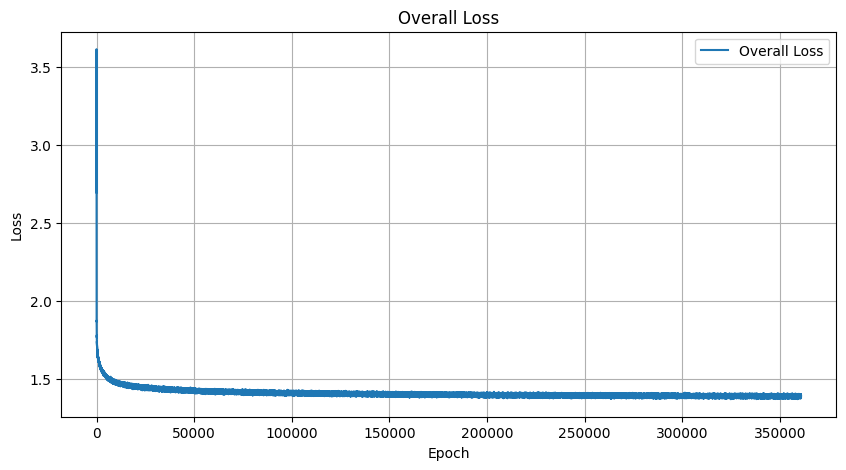

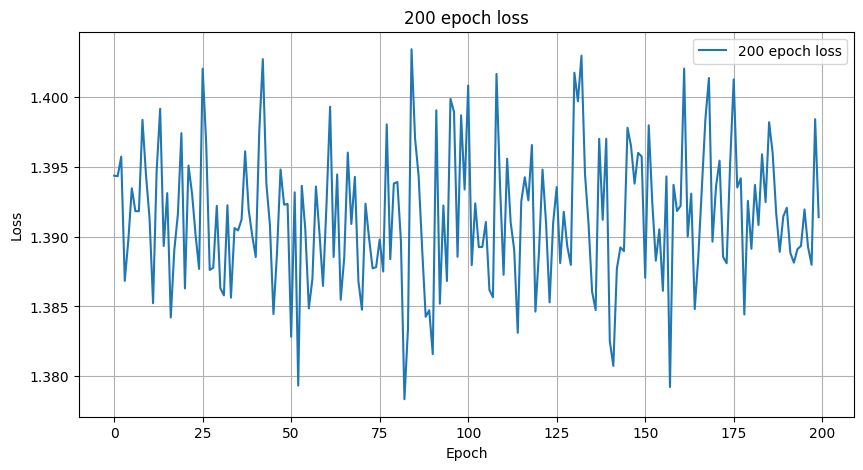

Epoch [1821701], Loss: 1.3887
Epoch [1821702], Loss: 1.3877
Epoch [1821703], Loss: 1.3847
Epoch [1821704], Loss: 1.3808
Epoch [1821705], Loss: 1.3924
Epoch [1821706], Loss: 1.3922
Epoch [1821707], Loss: 1.3961
Epoch [1821708], Loss: 1.3973
Epoch [1821709], Loss: 1.3921
Epoch [1821710], Loss: 1.3938
Epoch [1821711], Loss: 1.3919
Epoch [1821712], Loss: 1.3914
Epoch [1821713], Loss: 1.3873
Epoch [1821714], Loss: 1.3900
Epoch [1821715], Loss: 1.3947
Epoch [1821716], Loss: 1.3883
Epoch [1821717], Loss: 1.3932
Epoch [1821718], Loss: 1.3885
Epoch [1821719], Loss: 1.3931
Epoch [1821720], Loss: 1.3869
Epoch [1821721], Loss: 1.3890
Epoch [1821722], Loss: 1.3911
Epoch [1821723], Loss: 1.3966
Epoch [1821724], Loss: 1.3923
Epoch [1821725], Loss: 1.3940
Epoch [1821726], Loss: 1.3944
Epoch [1821727], Loss: 1.3886
Epoch [1821728], Loss: 1.3888
Epoch [1821729], Loss: 1.3818
Epoch [1821730], Loss: 1.3884
Epoch [1821731], Loss: 1.3877
Epoch [1821732], Loss: 1.3924
Epoch [1821733], Loss: 1.3885
Epoch [182

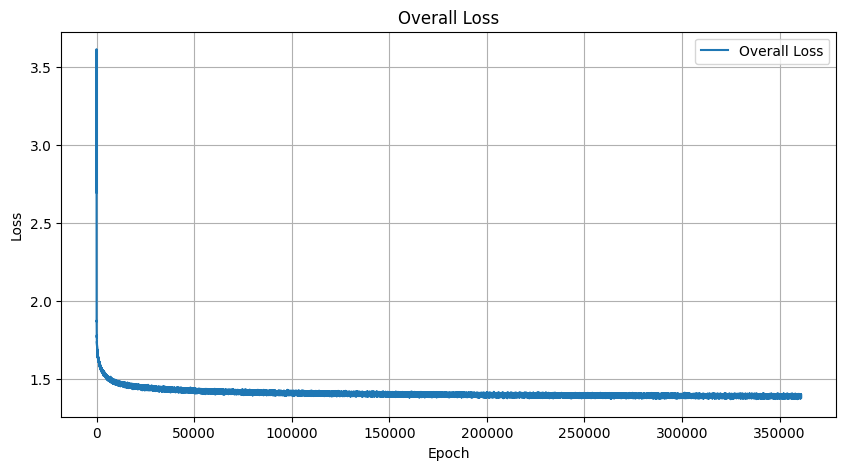

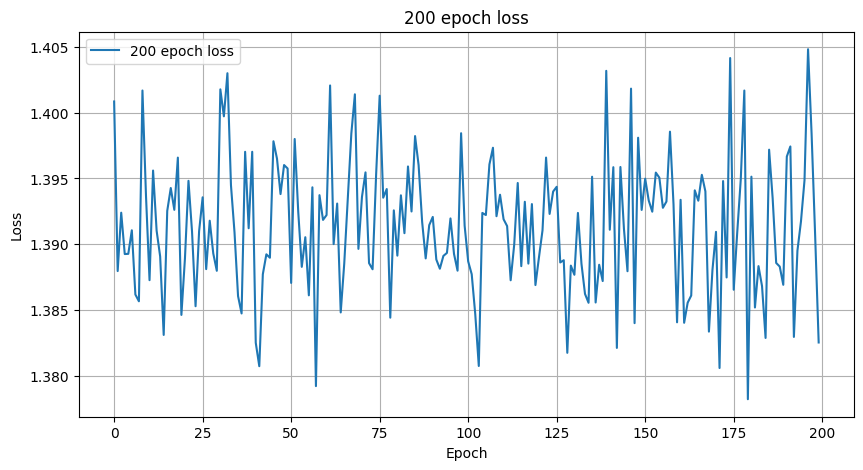

Epoch [1821801], Loss: 1.3860
Epoch [1821802], Loss: 1.3967
Epoch [1821803], Loss: 1.3994
Epoch [1821804], Loss: 1.3943
Epoch [1821805], Loss: 1.3977
Epoch [1821806], Loss: 1.3865
Epoch [1821807], Loss: 1.3908
Epoch [1821808], Loss: 1.3904
Epoch [1821809], Loss: 1.3894
Epoch [1821810], Loss: 1.3902
Epoch [1821811], Loss: 1.3841
Epoch [1821812], Loss: 1.4014
Epoch [1821813], Loss: 1.3868
Epoch [1821814], Loss: 1.3842
Epoch [1821815], Loss: 1.3963
Epoch [1821816], Loss: 1.3909
Epoch [1821817], Loss: 1.4039
Epoch [1821818], Loss: 1.3909
Epoch [1821819], Loss: 1.3861
Epoch [1821820], Loss: 1.3900
Epoch [1821821], Loss: 1.3855
Epoch [1821822], Loss: 1.3884
Epoch [1821823], Loss: 1.3970
Epoch [1821824], Loss: 1.3883
Epoch [1821825], Loss: 1.3884
Epoch [1821826], Loss: 1.3993
Epoch [1821827], Loss: 1.3961
Epoch [1821828], Loss: 1.4010
Epoch [1821829], Loss: 1.3912
Epoch [1821830], Loss: 1.3874
Epoch [1821831], Loss: 1.3866
Epoch [1821832], Loss: 1.3895
Epoch [1821833], Loss: 1.3889
Epoch [182

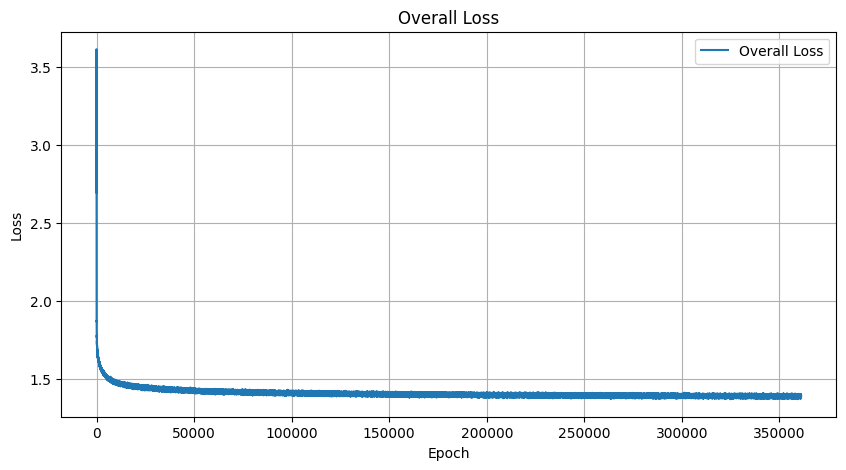

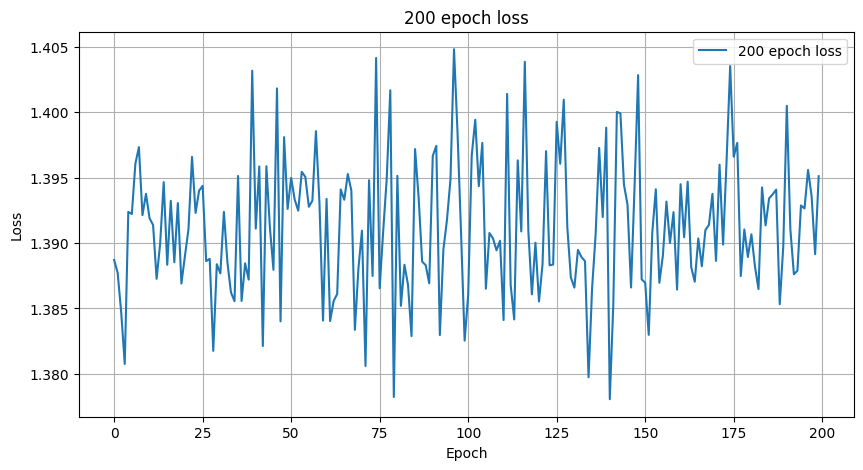

Epoch [1821901], Loss: 1.3912
Epoch [1821902], Loss: 1.3913
Epoch [1821903], Loss: 1.3826
Epoch [1821904], Loss: 1.3921
Epoch [1821905], Loss: 1.3877
Epoch [1821906], Loss: 1.3915
Epoch [1821907], Loss: 1.3921
Epoch [1821908], Loss: 1.3966
Epoch [1821909], Loss: 1.3942
Epoch [1821910], Loss: 1.3915
Epoch [1821911], Loss: 1.3815
Epoch [1821912], Loss: 1.4013
Epoch [1821913], Loss: 1.3925
Epoch [1821914], Loss: 1.3895
Epoch [1821915], Loss: 1.3920
Epoch [1821916], Loss: 1.3986
Epoch [1821917], Loss: 1.3939
Epoch [1821918], Loss: 1.3876
Epoch [1821919], Loss: 1.3980
Epoch [1821920], Loss: 1.3969
Epoch [1821921], Loss: 1.3898
Epoch [1821922], Loss: 1.3979
Epoch [1821923], Loss: 1.3940
Epoch [1821924], Loss: 1.3985
Epoch [1821925], Loss: 1.3961
Epoch [1821926], Loss: 1.3971
Epoch [1821927], Loss: 1.3947
Epoch [1821928], Loss: 1.3876
Epoch [1821929], Loss: 1.3976
Epoch [1821930], Loss: 1.3966
Epoch [1821931], Loss: 1.3954
Epoch [1821932], Loss: 1.3865
Epoch [1821933], Loss: 1.3885
Epoch [182

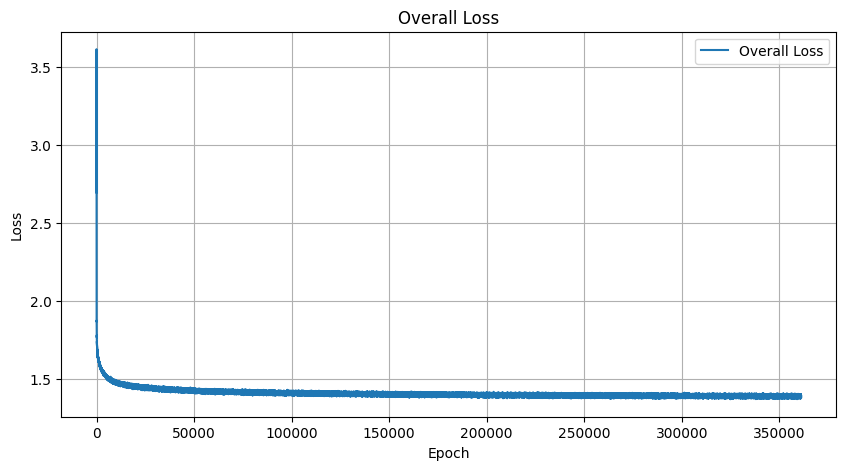

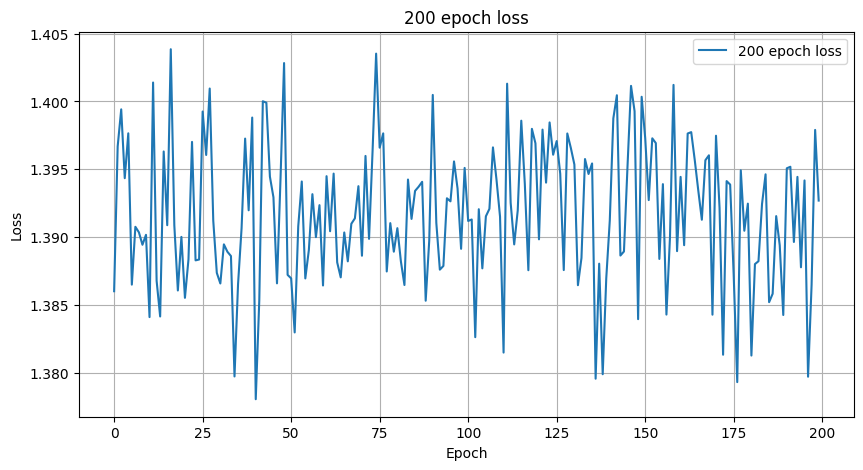

Epoch [1822001], Loss: 1.3915
Epoch [1822002], Loss: 1.3989
Epoch [1822003], Loss: 1.3996
Epoch [1822004], Loss: 1.3931
Epoch [1822005], Loss: 1.3928
Epoch [1822006], Loss: 1.3848
Epoch [1822007], Loss: 1.3938
Epoch [1822008], Loss: 1.3949
Epoch [1822009], Loss: 1.3824
Epoch [1822010], Loss: 1.3863
Epoch [1822011], Loss: 1.3828
Epoch [1822012], Loss: 1.3959
Epoch [1822013], Loss: 1.3860
Epoch [1822014], Loss: 1.3973
Epoch [1822015], Loss: 1.3865
Epoch [1822016], Loss: 1.3875
Epoch [1822017], Loss: 1.3878
Epoch [1822018], Loss: 1.3885
Epoch [1822019], Loss: 1.3860
Epoch [1822020], Loss: 1.3876
Epoch [1822021], Loss: 1.3885
Epoch [1822022], Loss: 1.3896
Epoch [1822023], Loss: 1.3949
Epoch [1822024], Loss: 1.3967
Epoch [1822025], Loss: 1.3903
Epoch [1822026], Loss: 1.3940
Epoch [1822027], Loss: 1.3926
Epoch [1822028], Loss: 1.3892
Epoch [1822029], Loss: 1.3960
Epoch [1822030], Loss: 1.3849
Epoch [1822031], Loss: 1.3922
Epoch [1822032], Loss: 1.3900
Epoch [1822033], Loss: 1.3848
Epoch [182

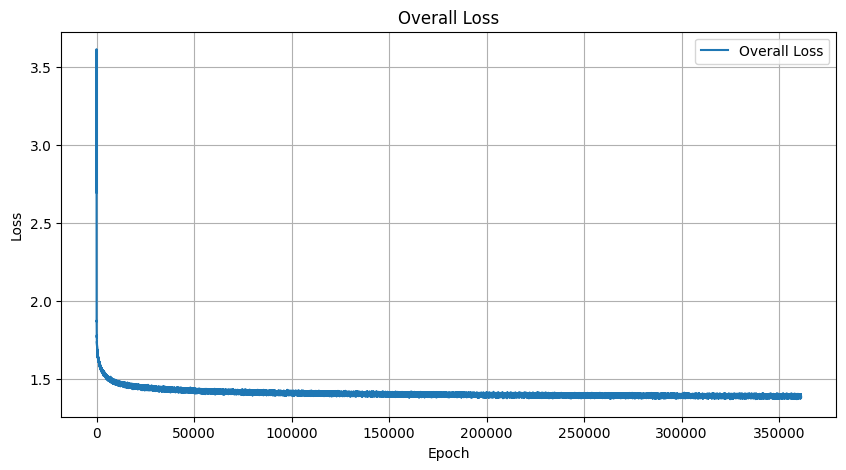

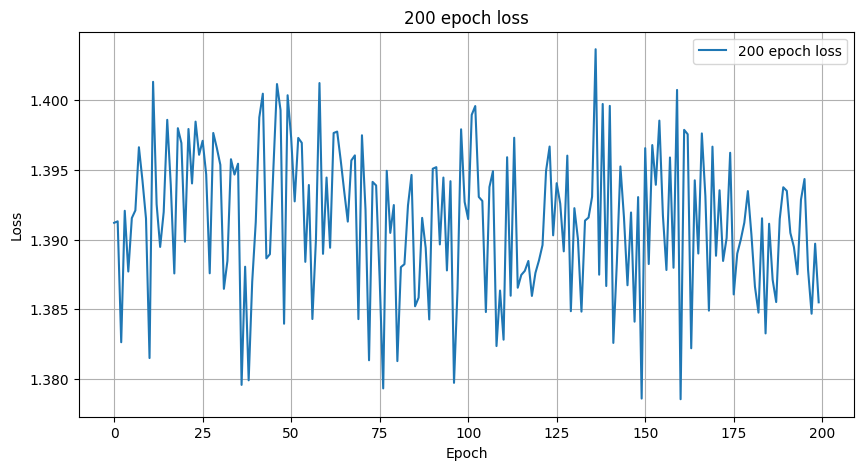

Epoch [1822101], Loss: 1.3793
Epoch [1822102], Loss: 1.3960
Epoch [1822103], Loss: 1.4022
Epoch [1822104], Loss: 1.3859
Epoch [1822105], Loss: 1.3944
Epoch [1822106], Loss: 1.3846
Epoch [1822107], Loss: 1.3933
Epoch [1822108], Loss: 1.3966
Epoch [1822109], Loss: 1.3932
Epoch [1822110], Loss: 1.3971
Epoch [1822111], Loss: 1.3954
Epoch [1822112], Loss: 1.3913
Epoch [1822113], Loss: 1.3870
Epoch [1822114], Loss: 1.3927
Epoch [1822115], Loss: 1.3905
Epoch [1822116], Loss: 1.3986
Epoch [1822117], Loss: 1.3932
Epoch [1822118], Loss: 1.3820
Epoch [1822119], Loss: 1.3936
Epoch [1822120], Loss: 1.3848
Epoch [1822121], Loss: 1.3880
Epoch [1822122], Loss: 1.3854
Epoch [1822123], Loss: 1.3929
Epoch [1822124], Loss: 1.3886
Epoch [1822125], Loss: 1.3980
Epoch [1822126], Loss: 1.3913
Epoch [1822127], Loss: 1.3954
Epoch [1822128], Loss: 1.3968
Epoch [1822129], Loss: 1.3871
Epoch [1822130], Loss: 1.3931
Epoch [1822131], Loss: 1.3902
Epoch [1822132], Loss: 1.3923
Epoch [1822133], Loss: 1.3901
Epoch [182

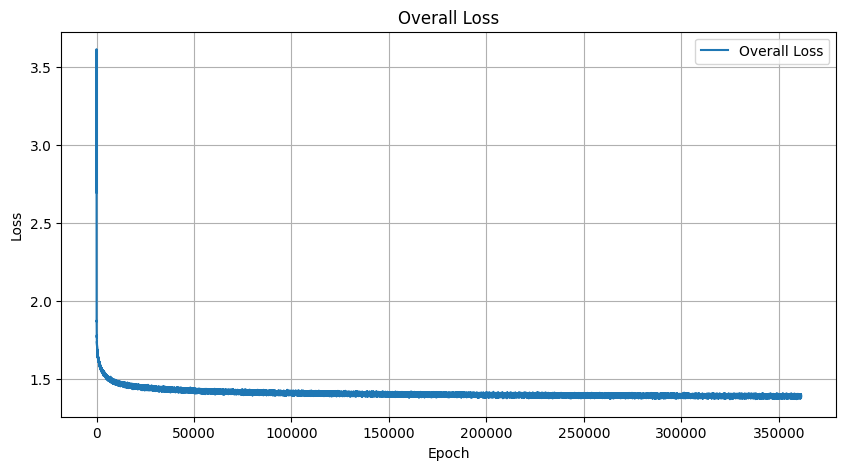

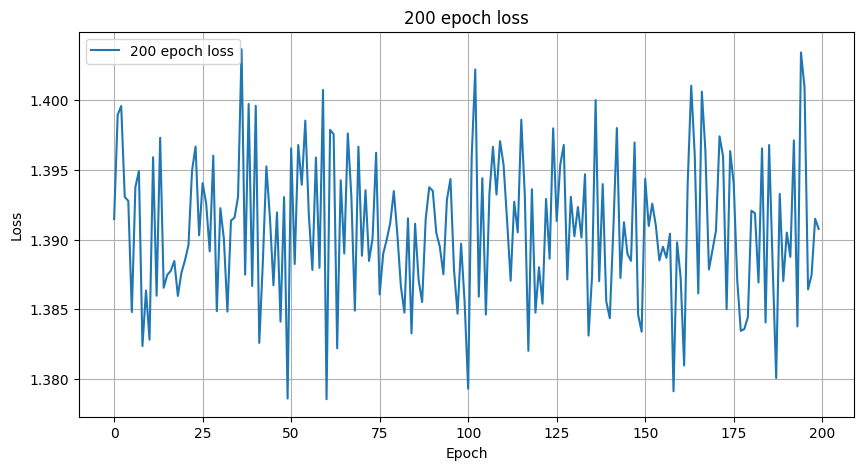

Epoch [1822201], Loss: 1.3861
Epoch [1822202], Loss: 1.3971
Epoch [1822203], Loss: 1.3980
Epoch [1822204], Loss: 1.3860
Epoch [1822205], Loss: 1.3933
Epoch [1822206], Loss: 1.3917
Epoch [1822207], Loss: 1.3915
Epoch [1822208], Loss: 1.3897
Epoch [1822209], Loss: 1.3943
Epoch [1822210], Loss: 1.3839
Epoch [1822211], Loss: 1.3916
Epoch [1822212], Loss: 1.3917
Epoch [1822213], Loss: 1.3901
Epoch [1822214], Loss: 1.3931
Epoch [1822215], Loss: 1.3927
Epoch [1822216], Loss: 1.3892
Epoch [1822217], Loss: 1.3949
Epoch [1822218], Loss: 1.3823
Epoch [1822219], Loss: 1.3870
Epoch [1822220], Loss: 1.3973
Epoch [1822221], Loss: 1.3916
Epoch [1822222], Loss: 1.3931
Epoch [1822223], Loss: 1.3859
Epoch [1822224], Loss: 1.3914
Epoch [1822225], Loss: 1.3835
Epoch [1822226], Loss: 1.3933
Epoch [1822227], Loss: 1.3905
Epoch [1822228], Loss: 1.3906
Epoch [1822229], Loss: 1.3956
Epoch [1822230], Loss: 1.3931
Epoch [1822231], Loss: 1.3854
Epoch [1822232], Loss: 1.3814
Epoch [1822233], Loss: 1.3823
Epoch [182

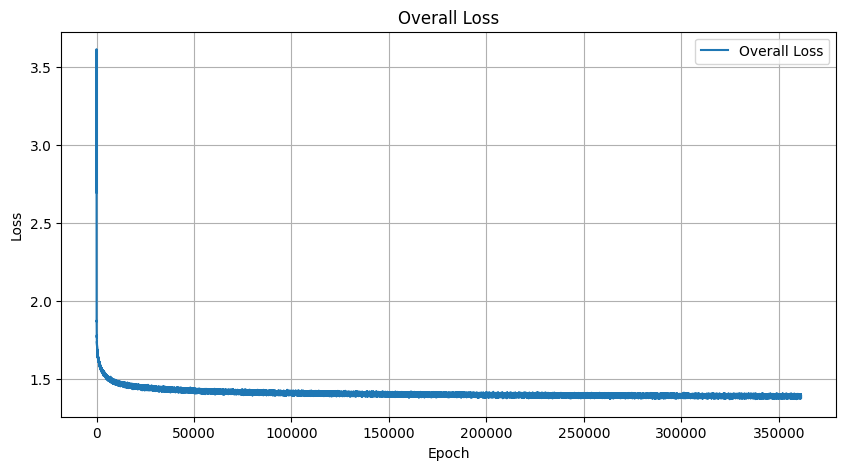

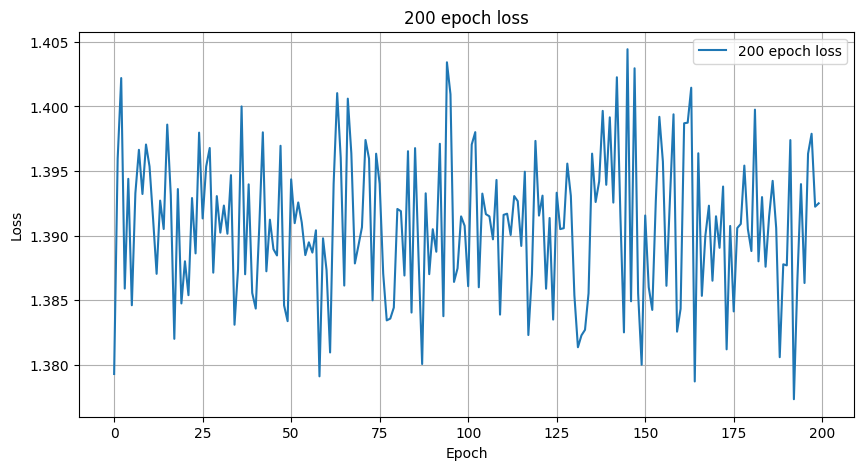

Epoch [1822301], Loss: 1.3796
Epoch [1822302], Loss: 1.3864
Epoch [1822303], Loss: 1.3935
Epoch [1822304], Loss: 1.3885
Epoch [1822305], Loss: 1.3971
Epoch [1822306], Loss: 1.3988
Epoch [1822307], Loss: 1.3885
Epoch [1822308], Loss: 1.3949
Epoch [1822309], Loss: 1.3982
Epoch [1822310], Loss: 1.3980
Epoch [1822311], Loss: 1.3989
Epoch [1822312], Loss: 1.3875
Epoch [1822313], Loss: 1.3888
Epoch [1822314], Loss: 1.3913
Epoch [1822315], Loss: 1.3923
Epoch [1822316], Loss: 1.3828
Epoch [1822317], Loss: 1.3847
Epoch [1822318], Loss: 1.3853
Epoch [1822319], Loss: 1.3870
Epoch [1822320], Loss: 1.3899
Epoch [1822321], Loss: 1.3897
Epoch [1822322], Loss: 1.3844
Epoch [1822323], Loss: 1.3967
Epoch [1822324], Loss: 1.3904
Epoch [1822325], Loss: 1.3963
Epoch [1822326], Loss: 1.3863
Epoch [1822327], Loss: 1.3876
Epoch [1822328], Loss: 1.3902
Epoch [1822329], Loss: 1.3842
Epoch [1822330], Loss: 1.3906
Epoch [1822331], Loss: 1.3824
Epoch [1822332], Loss: 1.3918
Epoch [1822333], Loss: 1.3864
Epoch [182

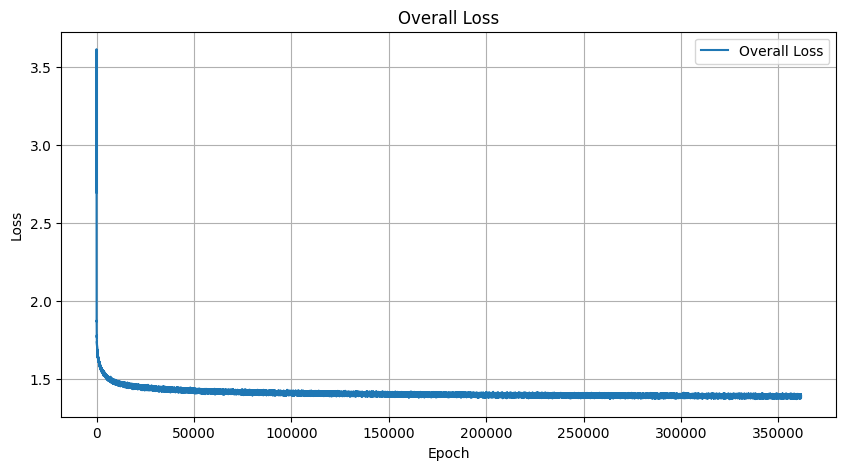

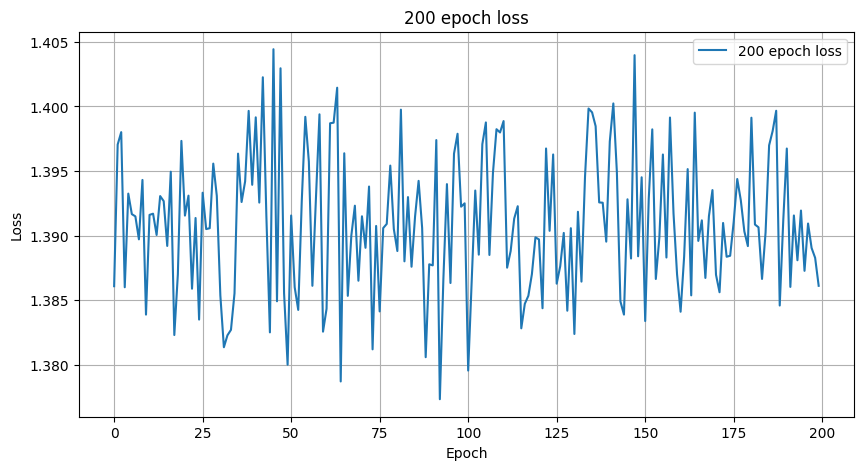

Epoch [1822401], Loss: 1.3915
Epoch [1822402], Loss: 1.3909
Epoch [1822403], Loss: 1.3954
Epoch [1822404], Loss: 1.3899
Epoch [1822405], Loss: 1.3949
Epoch [1822406], Loss: 1.3927
Epoch [1822407], Loss: 1.3951
Epoch [1822408], Loss: 1.3990
Epoch [1822409], Loss: 1.3889
Epoch [1822410], Loss: 1.3911
Epoch [1822411], Loss: 1.3834
Epoch [1822412], Loss: 1.3908
Epoch [1822413], Loss: 1.3866
Epoch [1822414], Loss: 1.3864
Epoch [1822415], Loss: 1.3873
Epoch [1822416], Loss: 1.3903
Epoch [1822417], Loss: 1.3976
Epoch [1822418], Loss: 1.3955
Epoch [1822419], Loss: 1.3814
Epoch [1822420], Loss: 1.3955
Epoch [1822421], Loss: 1.3973
Epoch [1822422], Loss: 1.3920
Epoch [1822423], Loss: 1.4029
Epoch [1822424], Loss: 1.3918
Epoch [1822425], Loss: 1.3857
Epoch [1822426], Loss: 1.3979
Epoch [1822427], Loss: 1.3901
Epoch [1822428], Loss: 1.3931
Epoch [1822429], Loss: 1.3910
Epoch [1822430], Loss: 1.3902
Epoch [1822431], Loss: 1.3930
Epoch [1822432], Loss: 1.3930
Epoch [1822433], Loss: 1.3974
Epoch [182

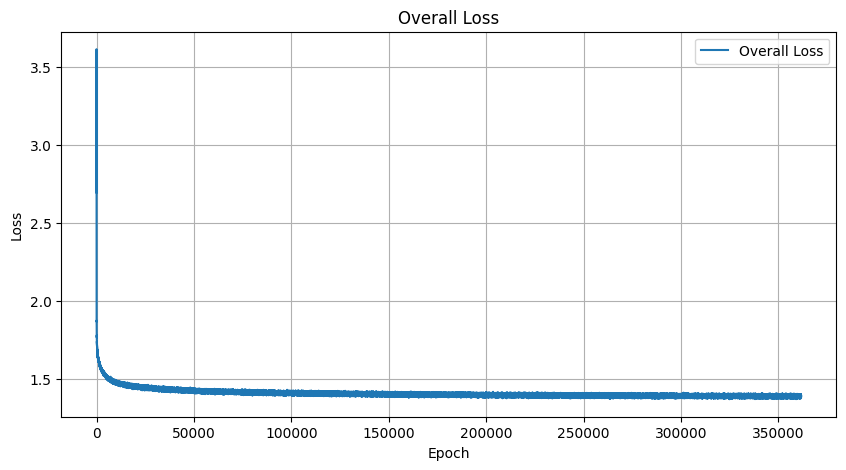

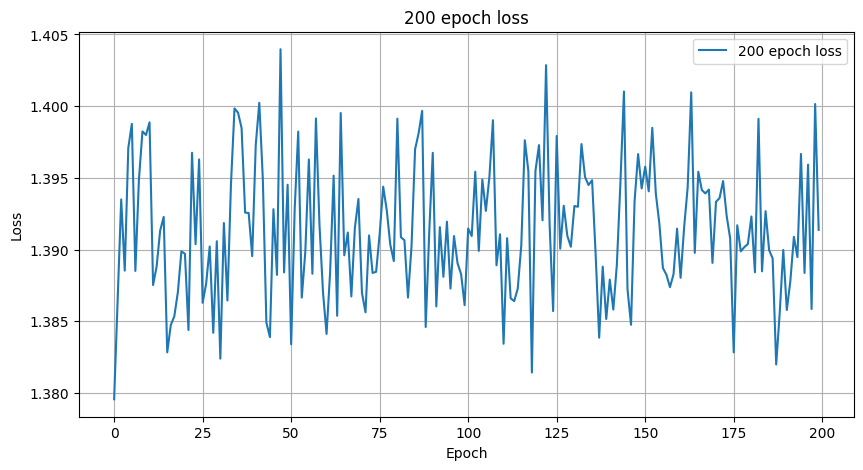

Epoch [1822501], Loss: 1.3880
Epoch [1822502], Loss: 1.3864
Epoch [1822503], Loss: 1.3907
Epoch [1822504], Loss: 1.3894
Epoch [1822505], Loss: 1.3891
Epoch [1822506], Loss: 1.3927
Epoch [1822507], Loss: 1.3968
Epoch [1822508], Loss: 1.3874
Epoch [1822509], Loss: 1.3949
Epoch [1822510], Loss: 1.3860
Epoch [1822511], Loss: 1.3929
Epoch [1822512], Loss: 1.3866
Epoch [1822513], Loss: 1.3907
Epoch [1822514], Loss: 1.3861
Epoch [1822515], Loss: 1.3923
Epoch [1822516], Loss: 1.4010
Epoch [1822517], Loss: 1.3894
Epoch [1822518], Loss: 1.3883
Epoch [1822519], Loss: 1.3861
Epoch [1822520], Loss: 1.3996
Epoch [1822521], Loss: 1.3938
Epoch [1822522], Loss: 1.3871
Epoch [1822523], Loss: 1.4004
Epoch [1822524], Loss: 1.3973
Epoch [1822525], Loss: 1.3888
Epoch [1822526], Loss: 1.3947
Epoch [1822527], Loss: 1.3895
Epoch [1822528], Loss: 1.3911
Epoch [1822529], Loss: 1.3948
Epoch [1822530], Loss: 1.3946
Epoch [1822531], Loss: 1.3866
Epoch [1822532], Loss: 1.3999
Epoch [1822533], Loss: 1.3904
Epoch [182

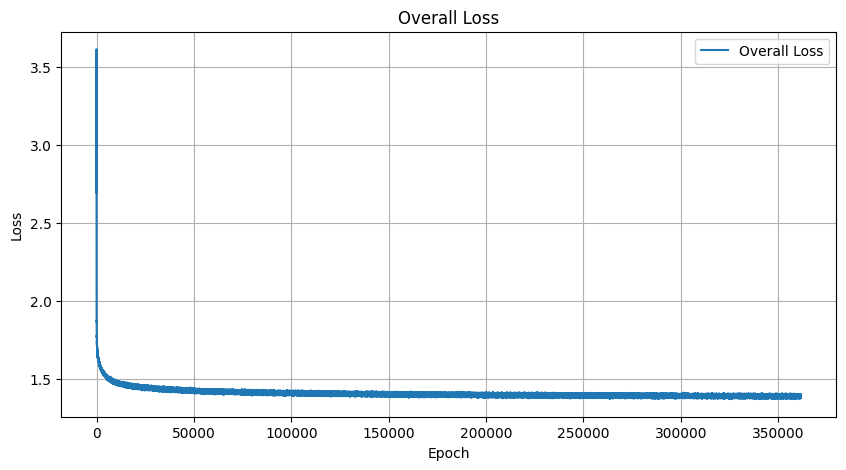

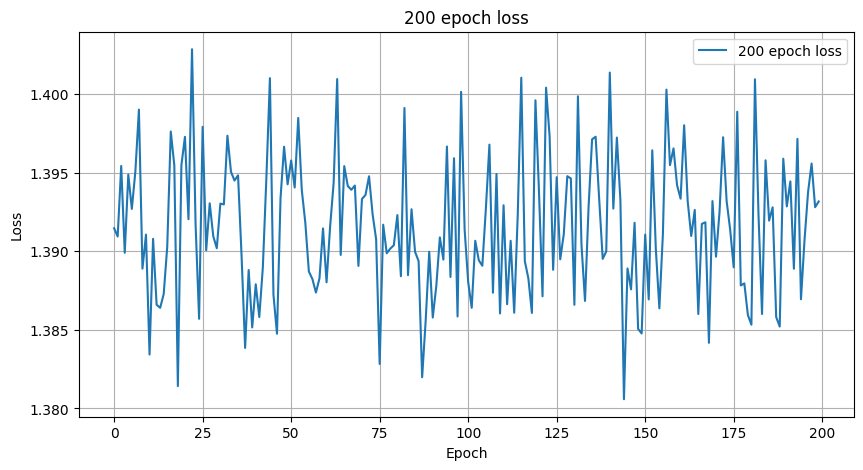

Epoch [1822601], Loss: 1.3885
Epoch [1822602], Loss: 1.3938
Epoch [1822603], Loss: 1.3880
Epoch [1822604], Loss: 1.4053
Epoch [1822605], Loss: 1.4057
Epoch [1822606], Loss: 1.3868
Epoch [1822607], Loss: 1.3927
Epoch [1822608], Loss: 1.3891
Epoch [1822609], Loss: 1.3852
Epoch [1822610], Loss: 1.3916
Epoch [1822611], Loss: 1.3912
Epoch [1822612], Loss: 1.3901
Epoch [1822613], Loss: 1.3920
Epoch [1822614], Loss: 1.3952
Epoch [1822615], Loss: 1.3921
Epoch [1822616], Loss: 1.3893
Epoch [1822617], Loss: 1.3882
Epoch [1822618], Loss: 1.3874
Epoch [1822619], Loss: 1.3964
Epoch [1822620], Loss: 1.3932
Epoch [1822621], Loss: 1.3988
Epoch [1822622], Loss: 1.3927
Epoch [1822623], Loss: 1.3893
Epoch [1822624], Loss: 1.3938
Epoch [1822625], Loss: 1.3970
Epoch [1822626], Loss: 1.3903
Epoch [1822627], Loss: 1.3940
Epoch [1822628], Loss: 1.3925
Epoch [1822629], Loss: 1.3933
Epoch [1822630], Loss: 1.3899
Epoch [1822631], Loss: 1.3969
Epoch [1822632], Loss: 1.3914
Epoch [1822633], Loss: 1.3938
Epoch [182

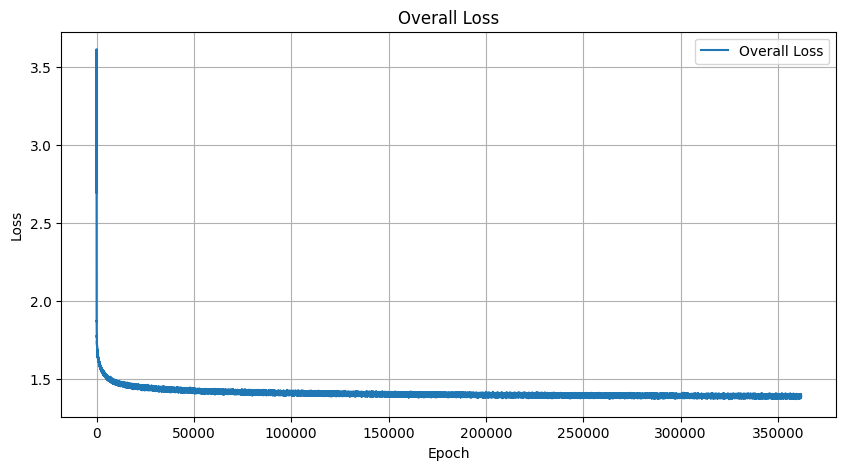

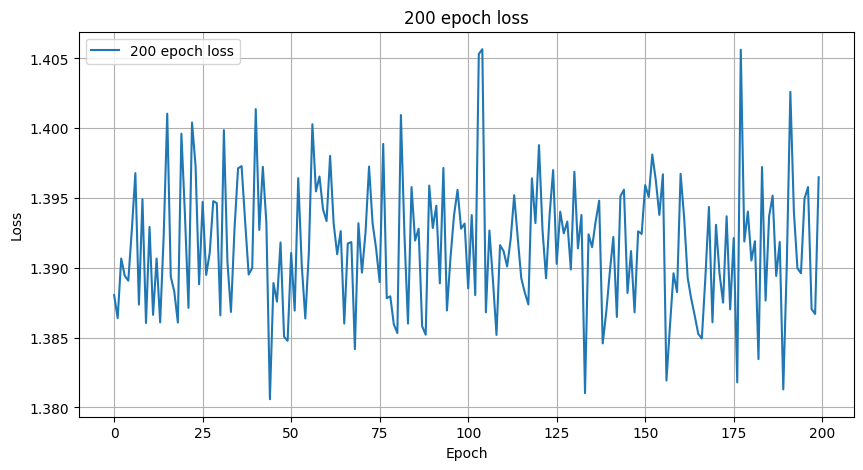

Epoch [1822701], Loss: 1.4027
Epoch [1822702], Loss: 1.3970
Epoch [1822703], Loss: 1.3980
Epoch [1822704], Loss: 1.4050
Epoch [1822705], Loss: 1.3936
Epoch [1822706], Loss: 1.3868
Epoch [1822707], Loss: 1.3996
Epoch [1822708], Loss: 1.3842
Epoch [1822709], Loss: 1.3866
Epoch [1822710], Loss: 1.3869
Epoch [1822711], Loss: 1.3900
Epoch [1822712], Loss: 1.3932
Epoch [1822713], Loss: 1.3929
Epoch [1822714], Loss: 1.3834
Epoch [1822715], Loss: 1.3905
Epoch [1822716], Loss: 1.3903
Epoch [1822717], Loss: 1.3914
Epoch [1822718], Loss: 1.3873
Epoch [1822719], Loss: 1.3826
Epoch [1822720], Loss: 1.3929
Epoch [1822721], Loss: 1.3992
Epoch [1822722], Loss: 1.3879
Epoch [1822723], Loss: 1.3891
Epoch [1822724], Loss: 1.3993
Epoch [1822725], Loss: 1.3958
Epoch [1822726], Loss: 1.3883
Epoch [1822727], Loss: 1.3882
Epoch [1822728], Loss: 1.3892
Epoch [1822729], Loss: 1.3925
Epoch [1822730], Loss: 1.3984
Epoch [1822731], Loss: 1.3870
Epoch [1822732], Loss: 1.3861
Epoch [1822733], Loss: 1.3948
Epoch [182

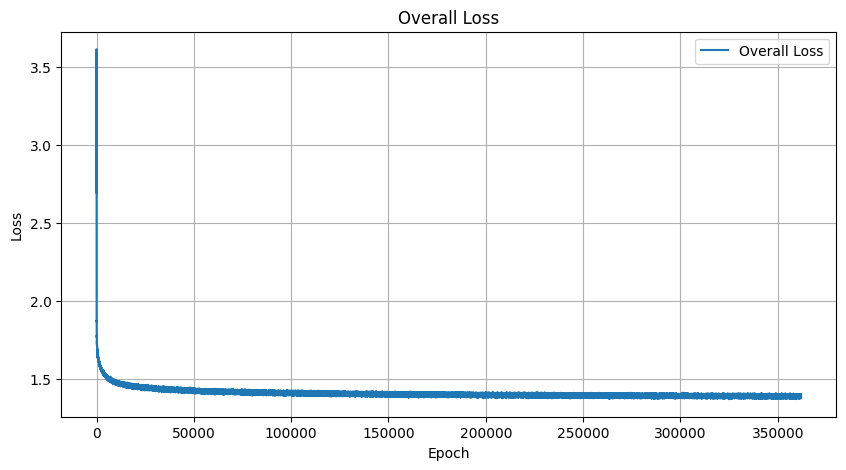

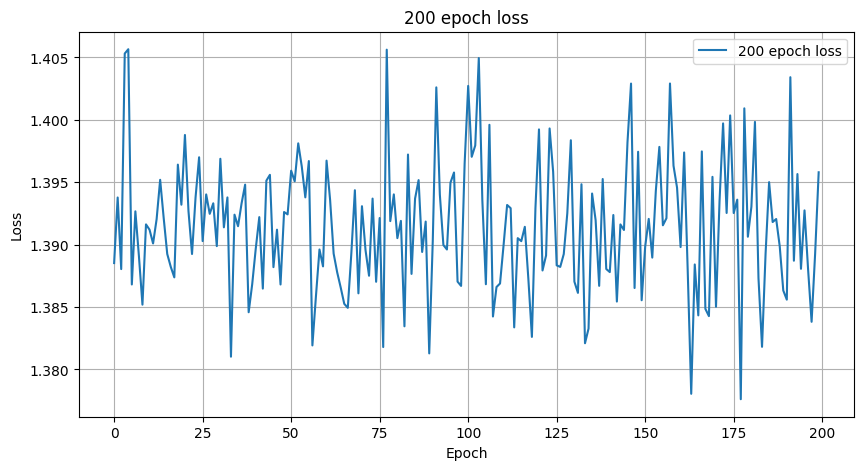

Epoch [1822801], Loss: 1.3831
Epoch [1822802], Loss: 1.3861
Epoch [1822803], Loss: 1.3892
Epoch [1822804], Loss: 1.3989
Epoch [1822805], Loss: 1.3963
Epoch [1822806], Loss: 1.4002
Epoch [1822807], Loss: 1.3890
Epoch [1822808], Loss: 1.3939
Epoch [1822809], Loss: 1.3971
Epoch [1822810], Loss: 1.3880
Epoch [1822811], Loss: 1.3930
Epoch [1822812], Loss: 1.3903
Epoch [1822813], Loss: 1.3914
Epoch [1822814], Loss: 1.3897
Epoch [1822815], Loss: 1.3882
Epoch [1822816], Loss: 1.3913
Epoch [1822817], Loss: 1.3900
Epoch [1822818], Loss: 1.3975
Epoch [1822819], Loss: 1.3924
Epoch [1822820], Loss: 1.3936
Epoch [1822821], Loss: 1.3905
Epoch [1822822], Loss: 1.3885
Epoch [1822823], Loss: 1.3967
Epoch [1822824], Loss: 1.3958
Epoch [1822825], Loss: 1.3895
Epoch [1822826], Loss: 1.3896
Epoch [1822827], Loss: 1.3920
Epoch [1822828], Loss: 1.3984
Epoch [1822829], Loss: 1.3964
Epoch [1822830], Loss: 1.3949
Epoch [1822831], Loss: 1.3802
Epoch [1822832], Loss: 1.3964
Epoch [1822833], Loss: 1.3833
Epoch [182

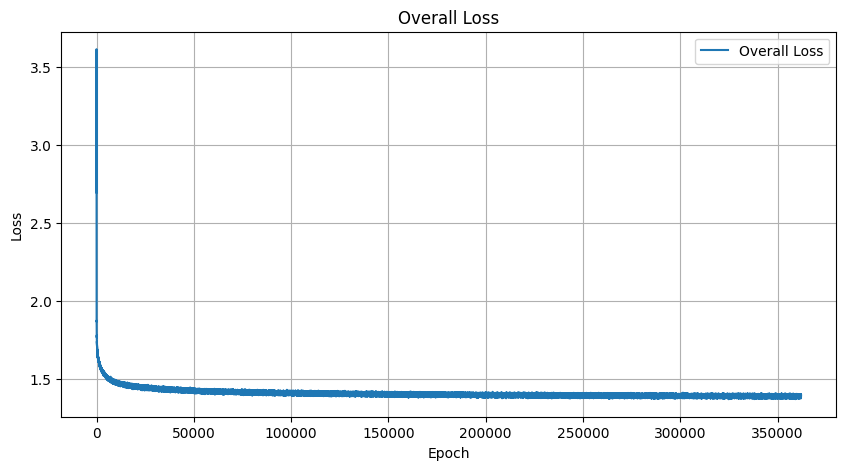

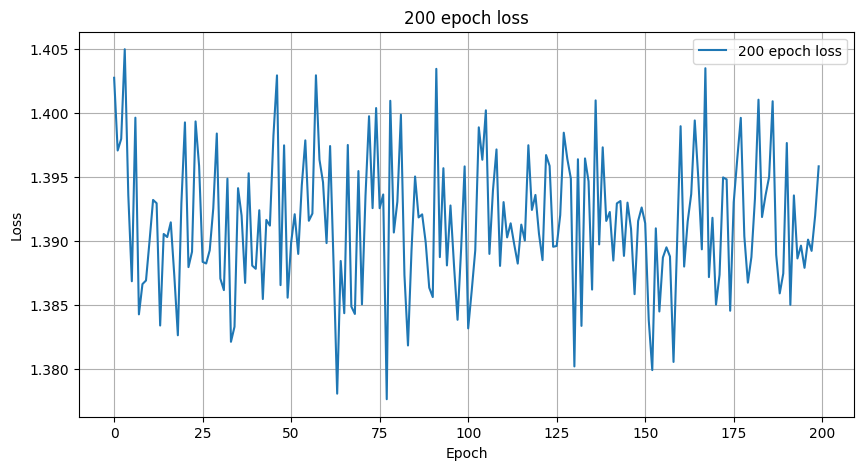

Epoch [1822901], Loss: 1.3875
Epoch [1822902], Loss: 1.3959
Epoch [1822903], Loss: 1.3883
Epoch [1822904], Loss: 1.3922
Epoch [1822905], Loss: 1.3944
Epoch [1822906], Loss: 1.3882
Epoch [1822907], Loss: 1.3887
Epoch [1822908], Loss: 1.3901
Epoch [1822909], Loss: 1.3932
Epoch [1822910], Loss: 1.3969
Epoch [1822911], Loss: 1.3952
Epoch [1822912], Loss: 1.3936
Epoch [1822913], Loss: 1.3819
Epoch [1822914], Loss: 1.3920
Epoch [1822915], Loss: 1.3922
Epoch [1822916], Loss: 1.3970
Epoch [1822917], Loss: 1.3936
Epoch [1822918], Loss: 1.3926
Epoch [1822919], Loss: 1.3846
Epoch [1822920], Loss: 1.3943
Epoch [1822921], Loss: 1.3893
Epoch [1822922], Loss: 1.3948
Epoch [1822923], Loss: 1.3993
Epoch [1822924], Loss: 1.3914
Epoch [1822925], Loss: 1.3856
Epoch [1822926], Loss: 1.3905
Epoch [1822927], Loss: 1.3925
Epoch [1822928], Loss: 1.3930
Epoch [1822929], Loss: 1.3890
Epoch [1822930], Loss: 1.3949
Epoch [1822931], Loss: 1.3940
Epoch [1822932], Loss: 1.3952
Epoch [1822933], Loss: 1.3877
Epoch [182

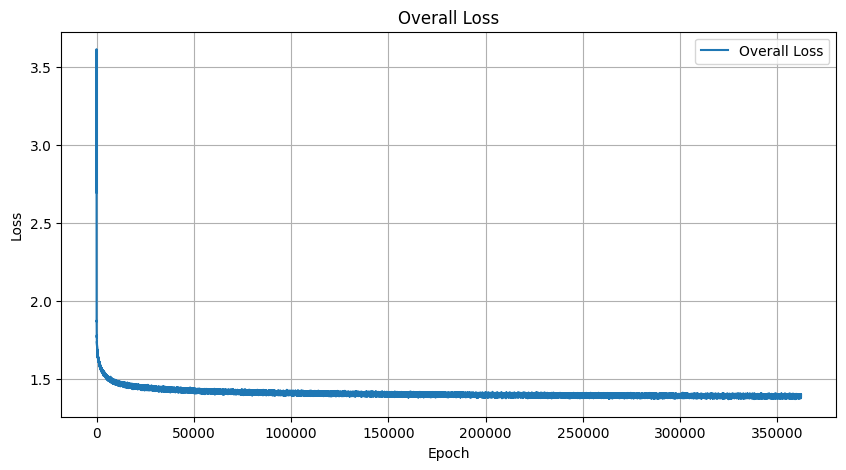

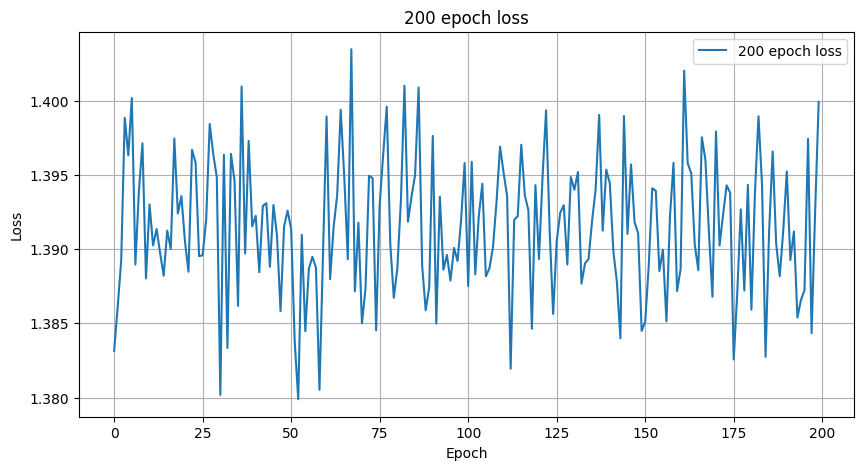

Epoch [1823001], Loss: 1.3876
Epoch [1823002], Loss: 1.3882
Epoch [1823003], Loss: 1.3877
Epoch [1823004], Loss: 1.3952
Epoch [1823005], Loss: 1.4020
Epoch [1823006], Loss: 1.3912
Epoch [1823007], Loss: 1.3991
Epoch [1823008], Loss: 1.3870
Epoch [1823009], Loss: 1.3816
Epoch [1823010], Loss: 1.4004
Epoch [1823011], Loss: 1.3934
Epoch [1823012], Loss: 1.3959
Epoch [1823013], Loss: 1.3964
Epoch [1823014], Loss: 1.3959
Epoch [1823015], Loss: 1.3946
Epoch [1823016], Loss: 1.3942
Epoch [1823017], Loss: 1.3893
Epoch [1823018], Loss: 1.4011
Epoch [1823019], Loss: 1.3966
Epoch [1823020], Loss: 1.3943
Epoch [1823021], Loss: 1.3824
Epoch [1823022], Loss: 1.3906
Epoch [1823023], Loss: 1.3898
Epoch [1823024], Loss: 1.3938
Epoch [1823025], Loss: 1.3848
Epoch [1823026], Loss: 1.3883
Epoch [1823027], Loss: 1.3871
Epoch [1823028], Loss: 1.3904
Epoch [1823029], Loss: 1.4056
Epoch [1823030], Loss: 1.3780
Epoch [1823031], Loss: 1.3890
Epoch [1823032], Loss: 1.3920
Epoch [1823033], Loss: 1.3952
Epoch [182

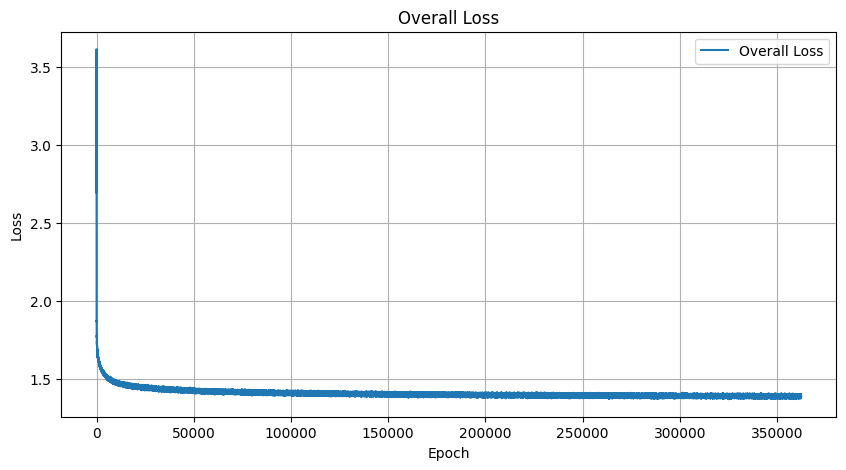

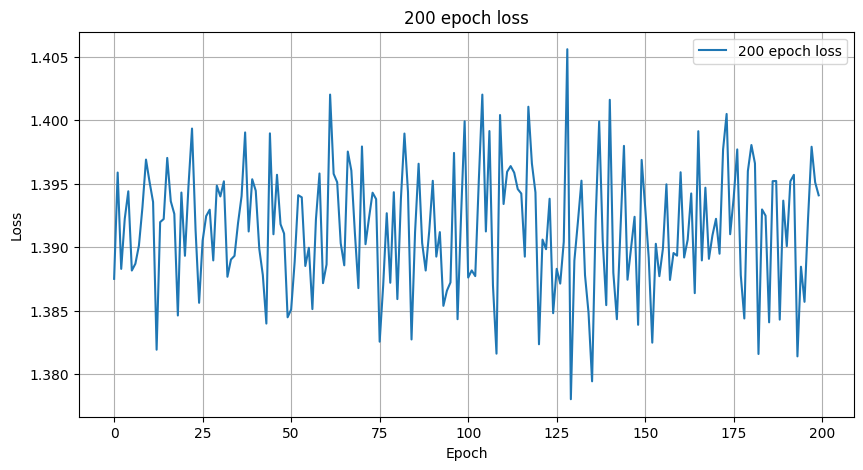

Epoch [1823101], Loss: 1.3792
Epoch [1823102], Loss: 1.3967
Epoch [1823103], Loss: 1.3941
Epoch [1823104], Loss: 1.3896
Epoch [1823105], Loss: 1.3880
Epoch [1823106], Loss: 1.3878
Epoch [1823107], Loss: 1.3970
Epoch [1823108], Loss: 1.3956
Epoch [1823109], Loss: 1.3876
Epoch [1823110], Loss: 1.3934
Epoch [1823111], Loss: 1.3920
Epoch [1823112], Loss: 1.3936
Epoch [1823113], Loss: 1.3942
Epoch [1823114], Loss: 1.3990
Epoch [1823115], Loss: 1.3931
Epoch [1823116], Loss: 1.3939
Epoch [1823117], Loss: 1.3827
Epoch [1823118], Loss: 1.3926
Epoch [1823119], Loss: 1.3956
Epoch [1823120], Loss: 1.3930
Epoch [1823121], Loss: 1.3882
Epoch [1823122], Loss: 1.3872
Epoch [1823123], Loss: 1.3900
Epoch [1823124], Loss: 1.3905
Epoch [1823125], Loss: 1.3931
Epoch [1823126], Loss: 1.3919
Epoch [1823127], Loss: 1.3929
Epoch [1823128], Loss: 1.3903
Epoch [1823129], Loss: 1.3847
Epoch [1823130], Loss: 1.3882
Epoch [1823131], Loss: 1.3993
Epoch [1823132], Loss: 1.3893
Epoch [1823133], Loss: 1.3894
Epoch [182

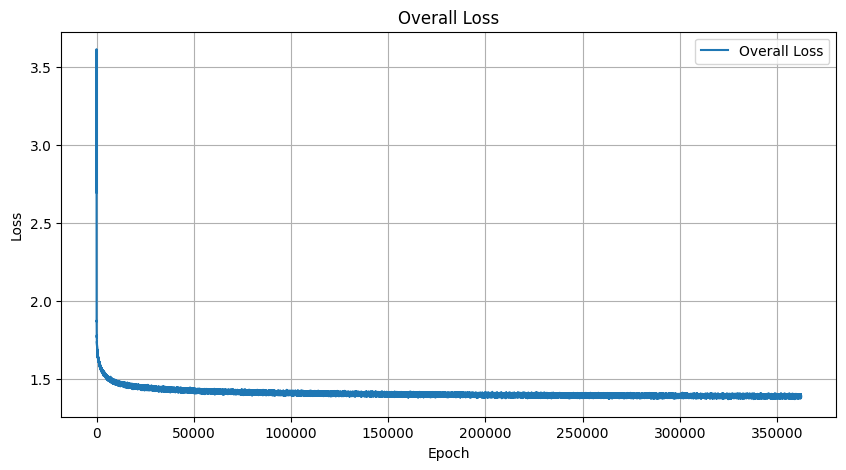

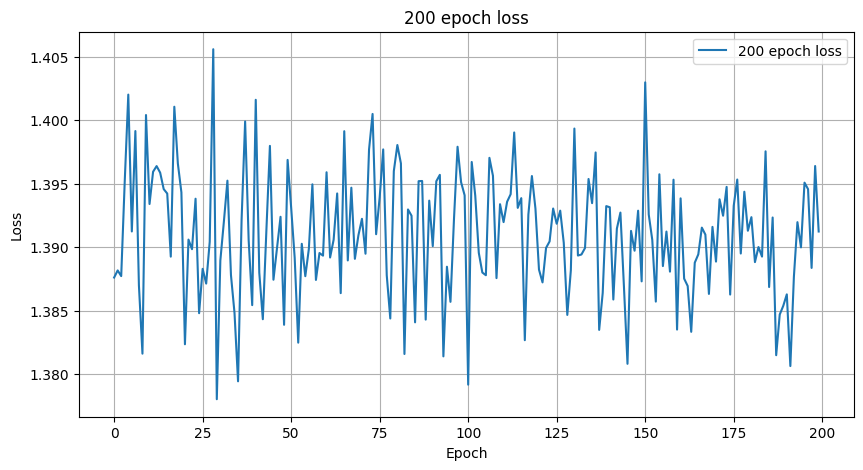

Epoch [1823201], Loss: 1.3970
Epoch [1823202], Loss: 1.3837
Epoch [1823203], Loss: 1.3817
Epoch [1823204], Loss: 1.3902
Epoch [1823205], Loss: 1.3969
Epoch [1823206], Loss: 1.3947
Epoch [1823207], Loss: 1.3876
Epoch [1823208], Loss: 1.3954
Epoch [1823209], Loss: 1.3942
Epoch [1823210], Loss: 1.3966
Epoch [1823211], Loss: 1.3853
Epoch [1823212], Loss: 1.3899
Epoch [1823213], Loss: 1.3938
Epoch [1823214], Loss: 1.3957
Epoch [1823215], Loss: 1.3899
Epoch [1823216], Loss: 1.3939
Epoch [1823217], Loss: 1.3939
Epoch [1823218], Loss: 1.3877
Epoch [1823219], Loss: 1.3968
Epoch [1823220], Loss: 1.3912
Epoch [1823221], Loss: 1.3916
Epoch [1823222], Loss: 1.3887
Epoch [1823223], Loss: 1.3896
Epoch [1823224], Loss: 1.3925
Epoch [1823225], Loss: 1.3951
Epoch [1823226], Loss: 1.3909
Epoch [1823227], Loss: 1.3945
Epoch [1823228], Loss: 1.3911
Epoch [1823229], Loss: 1.3926
Epoch [1823230], Loss: 1.3975
Epoch [1823231], Loss: 1.3893
Epoch [1823232], Loss: 1.3858
Epoch [1823233], Loss: 1.3847
Epoch [182

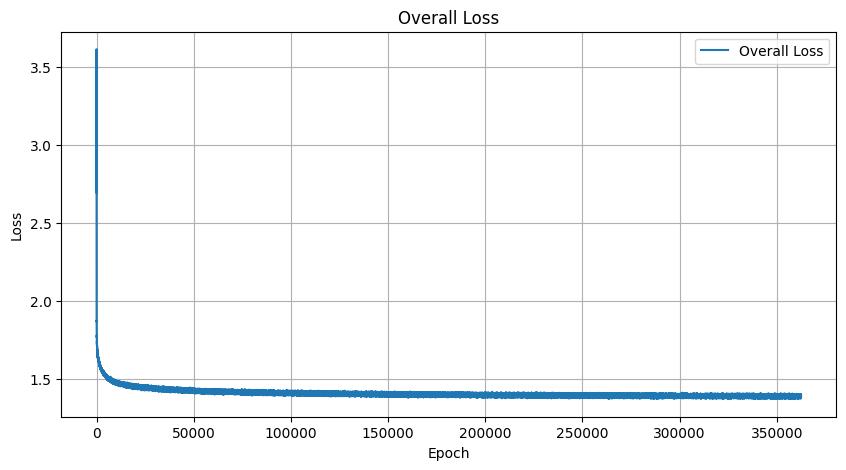

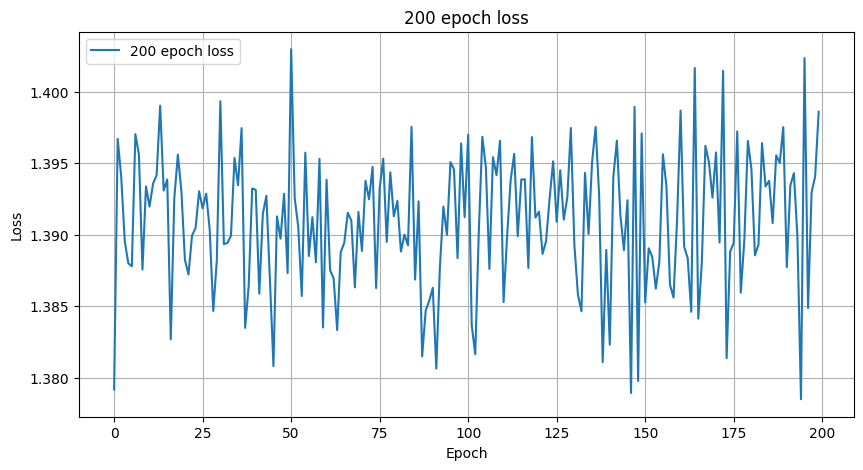

Epoch [1823301], Loss: 1.3897
Epoch [1823302], Loss: 1.3913
Epoch [1823303], Loss: 1.3984
Epoch [1823304], Loss: 1.3942
Epoch [1823305], Loss: 1.3938
Epoch [1823306], Loss: 1.3885
Epoch [1823307], Loss: 1.3903
Epoch [1823308], Loss: 1.3914
Epoch [1823309], Loss: 1.3869
Epoch [1823310], Loss: 1.3838
Epoch [1823311], Loss: 1.3903
Epoch [1823312], Loss: 1.3982
Epoch [1823313], Loss: 1.3873
Epoch [1823314], Loss: 1.3890
Epoch [1823315], Loss: 1.3892
Epoch [1823316], Loss: 1.3954
Epoch [1823317], Loss: 1.3860
Epoch [1823318], Loss: 1.3962
Epoch [1823319], Loss: 1.3921
Epoch [1823320], Loss: 1.3939
Epoch [1823321], Loss: 1.3970
Epoch [1823322], Loss: 1.3902
Epoch [1823323], Loss: 1.3850
Epoch [1823324], Loss: 1.3894
Epoch [1823325], Loss: 1.3912
Epoch [1823326], Loss: 1.3865
Epoch [1823327], Loss: 1.3955
Epoch [1823328], Loss: 1.3970
Epoch [1823329], Loss: 1.3903
Epoch [1823330], Loss: 1.3941
Epoch [1823331], Loss: 1.3966
Epoch [1823332], Loss: 1.3937
Epoch [1823333], Loss: 1.3924
Epoch [182

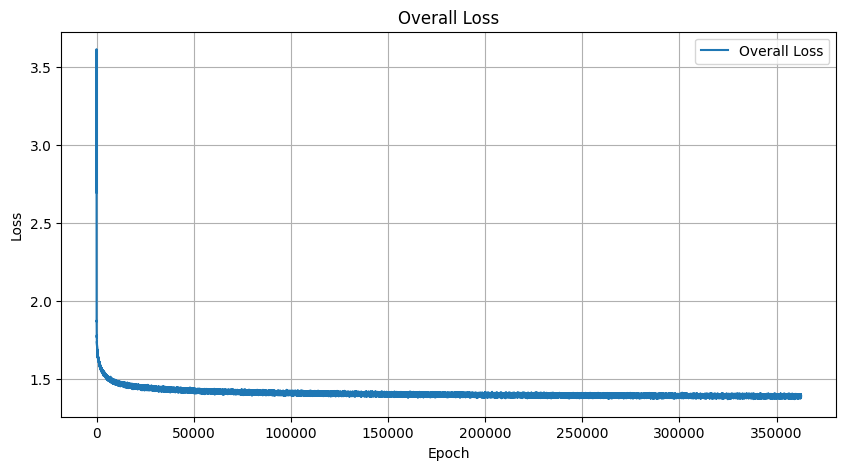

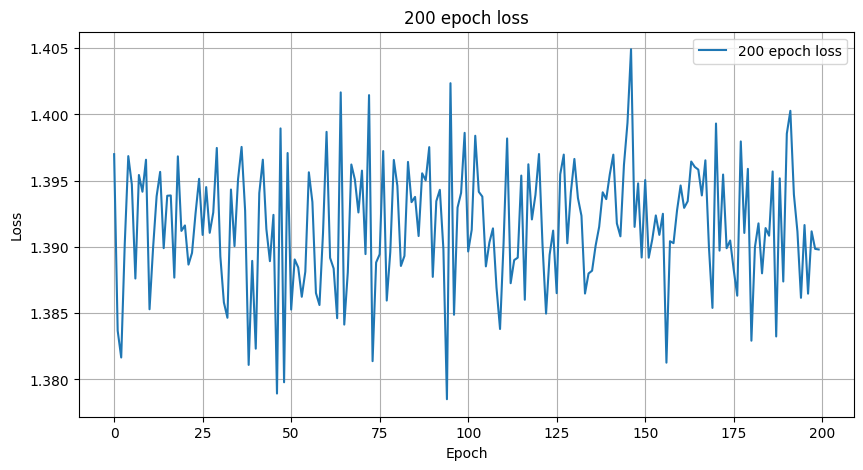

Epoch [1823401], Loss: 1.3951
Epoch [1823402], Loss: 1.3898
Epoch [1823403], Loss: 1.3864
Epoch [1823404], Loss: 1.3967
Epoch [1823405], Loss: 1.3908
Epoch [1823406], Loss: 1.3916
Epoch [1823407], Loss: 1.3913
Epoch [1823408], Loss: 1.3888
Epoch [1823409], Loss: 1.3911
Epoch [1823410], Loss: 1.3876
Epoch [1823411], Loss: 1.3906
Epoch [1823412], Loss: 1.3883
Epoch [1823413], Loss: 1.3814
Epoch [1823414], Loss: 1.3845
Epoch [1823415], Loss: 1.3859
Epoch [1823416], Loss: 1.3814
Epoch [1823417], Loss: 1.3947
Epoch [1823418], Loss: 1.3976
Epoch [1823419], Loss: 1.3888
Epoch [1823420], Loss: 1.3991
Epoch [1823421], Loss: 1.3960
Epoch [1823422], Loss: 1.3862
Epoch [1823423], Loss: 1.3870
Epoch [1823424], Loss: 1.4017
Epoch [1823425], Loss: 1.3988
Epoch [1823426], Loss: 1.3890
Epoch [1823427], Loss: 1.3932
Epoch [1823428], Loss: 1.3967
Epoch [1823429], Loss: 1.3840
Epoch [1823430], Loss: 1.3856
Epoch [1823431], Loss: 1.3969
Epoch [1823432], Loss: 1.3978
Epoch [1823433], Loss: 1.4054
Epoch [182

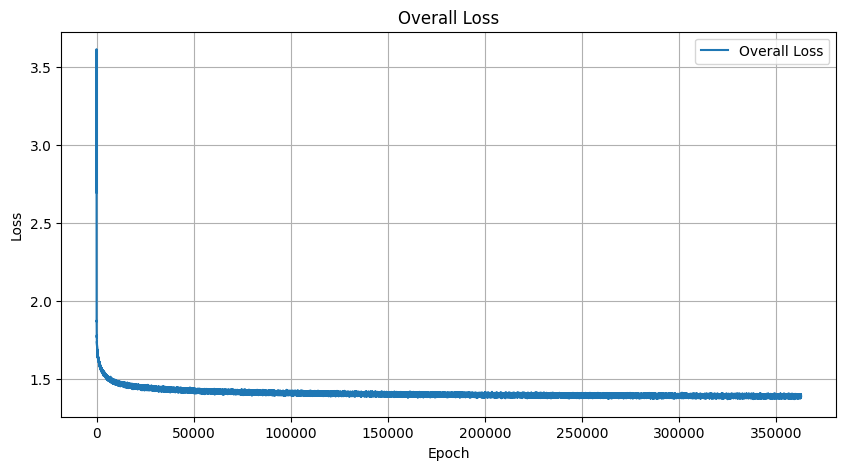

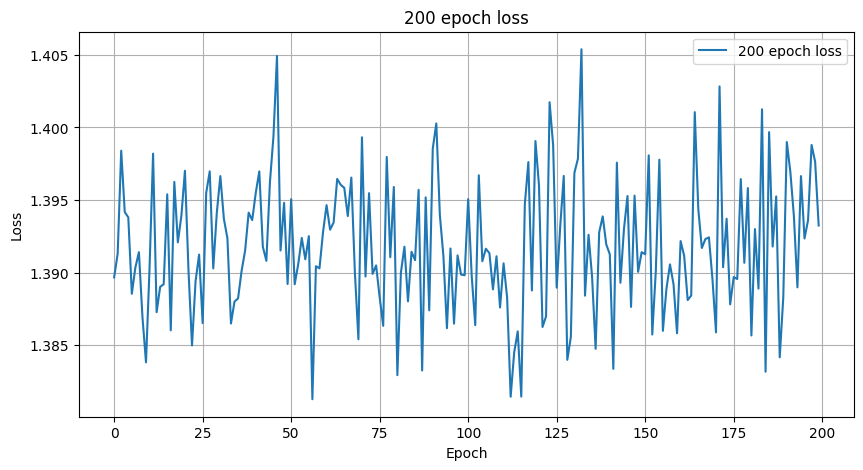

Epoch [1823501], Loss: 1.3925
Epoch [1823502], Loss: 1.3854
Epoch [1823503], Loss: 1.3910
Epoch [1823504], Loss: 1.3904
Epoch [1823505], Loss: 1.3935
Epoch [1823506], Loss: 1.3877
Epoch [1823507], Loss: 1.3927
Epoch [1823508], Loss: 1.3878
Epoch [1823509], Loss: 1.3844
Epoch [1823510], Loss: 1.3967
Epoch [1823511], Loss: 1.3919
Epoch [1823512], Loss: 1.3953
Epoch [1823513], Loss: 1.3957
Epoch [1823514], Loss: 1.3893
Epoch [1823515], Loss: 1.3952
Epoch [1823516], Loss: 1.3895
Epoch [1823517], Loss: 1.3825
Epoch [1823518], Loss: 1.3927
Epoch [1823519], Loss: 1.3927
Epoch [1823520], Loss: 1.3998
Epoch [1823521], Loss: 1.3794
Epoch [1823522], Loss: 1.3953
Epoch [1823523], Loss: 1.3899
Epoch [1823524], Loss: 1.3926
Epoch [1823525], Loss: 1.3920
Epoch [1823526], Loss: 1.3916
Epoch [1823527], Loss: 1.3881
Epoch [1823528], Loss: 1.3893
Epoch [1823529], Loss: 1.3892
Epoch [1823530], Loss: 1.3897
Epoch [1823531], Loss: 1.3849
Epoch [1823532], Loss: 1.3935
Epoch [1823533], Loss: 1.3882
Epoch [182

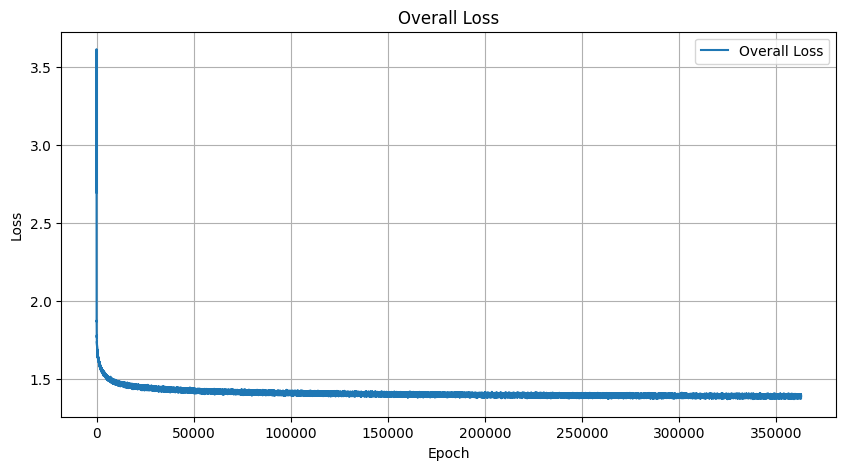

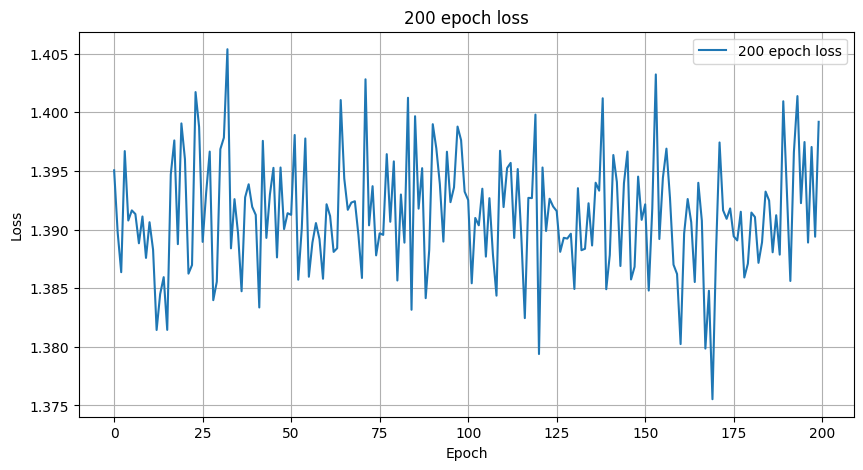

Epoch [1823601], Loss: 1.3834
Epoch [1823602], Loss: 1.3924
Epoch [1823603], Loss: 1.3952
Epoch [1823604], Loss: 1.3974
Epoch [1823605], Loss: 1.3812
Epoch [1823606], Loss: 1.3932
Epoch [1823607], Loss: 1.3933
Epoch [1823608], Loss: 1.3905
Epoch [1823609], Loss: 1.3927
Epoch [1823610], Loss: 1.3901
Epoch [1823611], Loss: 1.3915
Epoch [1823612], Loss: 1.3966
Epoch [1823613], Loss: 1.4007
Epoch [1823614], Loss: 1.3887
Epoch [1823615], Loss: 1.3902
Epoch [1823616], Loss: 1.3982
Epoch [1823617], Loss: 1.3952
Epoch [1823618], Loss: 1.3893
Epoch [1823619], Loss: 1.3836
Epoch [1823620], Loss: 1.3858
Epoch [1823621], Loss: 1.3913
Epoch [1823622], Loss: 1.3819
Epoch [1823623], Loss: 1.3895
Epoch [1823624], Loss: 1.3920
Epoch [1823625], Loss: 1.3963
Epoch [1823626], Loss: 1.3964
Epoch [1823627], Loss: 1.3951
Epoch [1823628], Loss: 1.3919
Epoch [1823629], Loss: 1.3952
Epoch [1823630], Loss: 1.3963
Epoch [1823631], Loss: 1.3895
Epoch [1823632], Loss: 1.3939
Epoch [1823633], Loss: 1.3940
Epoch [182

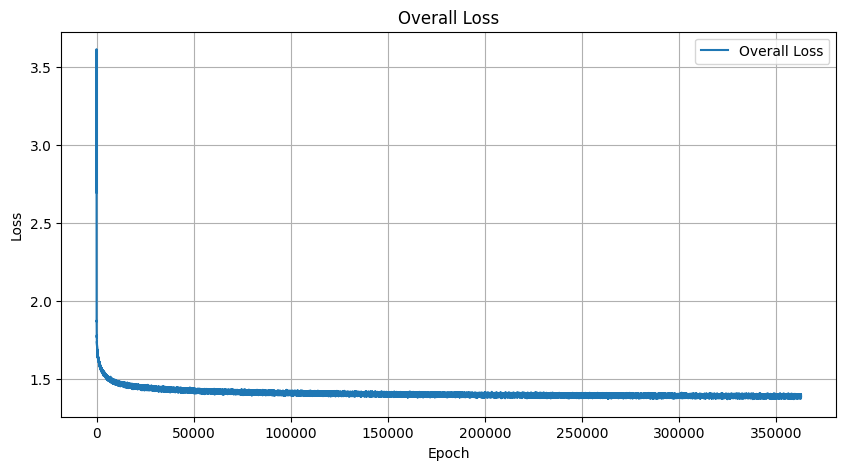

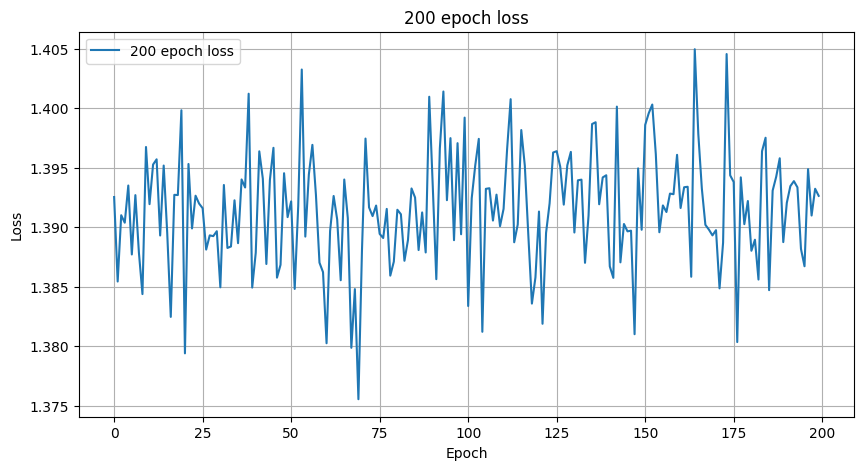

Epoch [1823701], Loss: 1.3916
Epoch [1823702], Loss: 1.3900
Epoch [1823703], Loss: 1.4020
Epoch [1823704], Loss: 1.3874
Epoch [1823705], Loss: 1.3845
Epoch [1823706], Loss: 1.3888
Epoch [1823707], Loss: 1.3911
Epoch [1823708], Loss: 1.3917
Epoch [1823709], Loss: 1.3848
Epoch [1823710], Loss: 1.3870
Epoch [1823711], Loss: 1.3877
Epoch [1823712], Loss: 1.3940
Epoch [1823713], Loss: 1.3846
Epoch [1823714], Loss: 1.3916
Epoch [1823715], Loss: 1.3921
Epoch [1823716], Loss: 1.3875
Epoch [1823717], Loss: 1.3844
Epoch [1823718], Loss: 1.3949
Epoch [1823719], Loss: 1.3925
Epoch [1823720], Loss: 1.3959
Epoch [1823721], Loss: 1.3906
Epoch [1823722], Loss: 1.3865
Epoch [1823723], Loss: 1.3883
Epoch [1823724], Loss: 1.3867
Epoch [1823725], Loss: 1.3953
Epoch [1823726], Loss: 1.3887
Epoch [1823727], Loss: 1.3946
Epoch [1823728], Loss: 1.3905
Epoch [1823729], Loss: 1.3839
Epoch [1823730], Loss: 1.3867
Epoch [1823731], Loss: 1.3794
Epoch [1823732], Loss: 1.3970
Epoch [1823733], Loss: 1.3820
Epoch [182

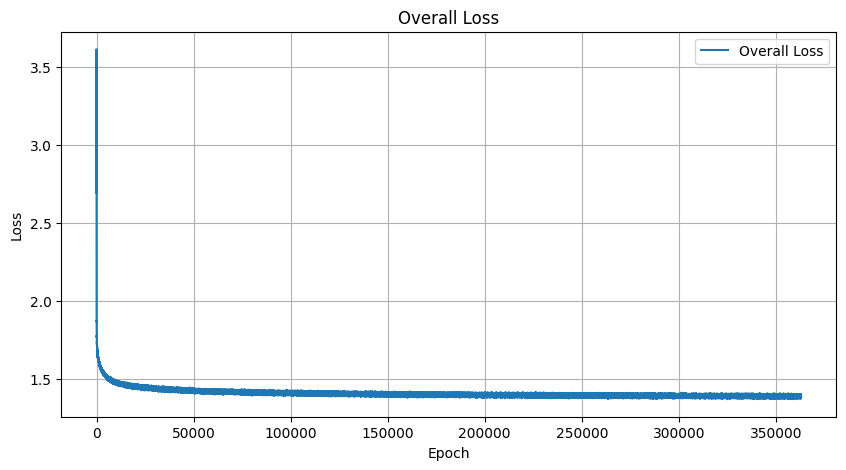

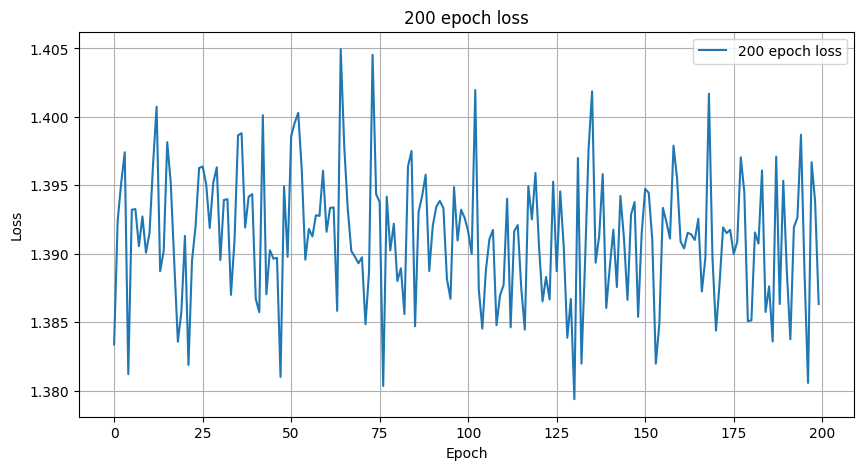

Epoch [1823801], Loss: 1.3935
Epoch [1823802], Loss: 1.3917
Epoch [1823803], Loss: 1.3948
Epoch [1823804], Loss: 1.3950
Epoch [1823805], Loss: 1.3949
Epoch [1823806], Loss: 1.4027
Epoch [1823807], Loss: 1.3948
Epoch [1823808], Loss: 1.3961
Epoch [1823809], Loss: 1.3797
Epoch [1823810], Loss: 1.3926
Epoch [1823811], Loss: 1.3819
Epoch [1823812], Loss: 1.3853
Epoch [1823813], Loss: 1.3971
Epoch [1823814], Loss: 1.3906
Epoch [1823815], Loss: 1.3968
Epoch [1823816], Loss: 1.3899
Epoch [1823817], Loss: 1.3849
Epoch [1823818], Loss: 1.3837
Epoch [1823819], Loss: 1.3962
Epoch [1823820], Loss: 1.3961
Epoch [1823821], Loss: 1.3888
Epoch [1823822], Loss: 1.3963
Epoch [1823823], Loss: 1.3878
Epoch [1823824], Loss: 1.3807
Epoch [1823825], Loss: 1.3970
Epoch [1823826], Loss: 1.3960
Epoch [1823827], Loss: 1.3853
Epoch [1823828], Loss: 1.3867
Epoch [1823829], Loss: 1.3916
Epoch [1823830], Loss: 1.3909
Epoch [1823831], Loss: 1.3980
Epoch [1823832], Loss: 1.3917
Epoch [1823833], Loss: 1.3901
Epoch [182

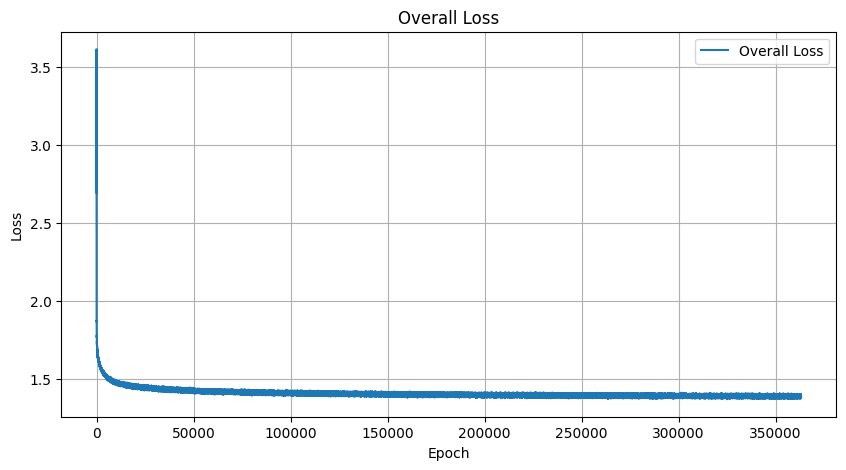

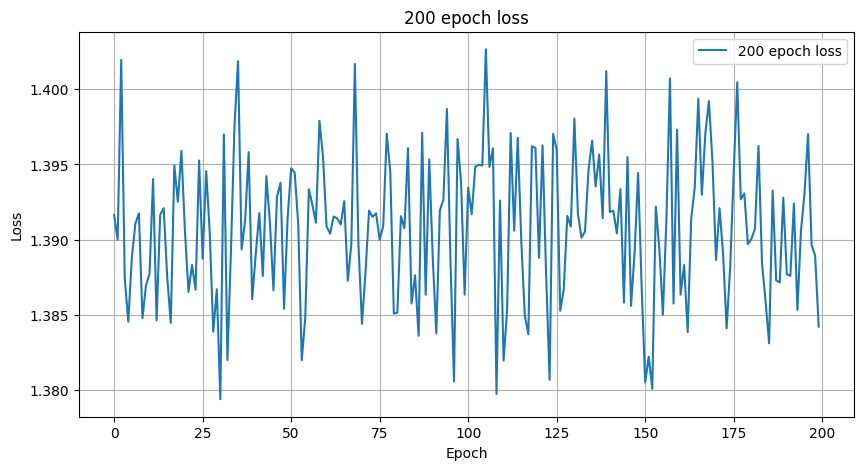

Epoch [1823901], Loss: 1.3959
Epoch [1823902], Loss: 1.3982
Epoch [1823903], Loss: 1.3883
Epoch [1823904], Loss: 1.3929
Epoch [1823905], Loss: 1.3992
Epoch [1823906], Loss: 1.3938
Epoch [1823907], Loss: 1.3841
Epoch [1823908], Loss: 1.3883
Epoch [1823909], Loss: 1.3954
Epoch [1823910], Loss: 1.3993
Epoch [1823911], Loss: 1.3879
Epoch [1823912], Loss: 1.3920
Epoch [1823913], Loss: 1.3833
Epoch [1823914], Loss: 1.3868
Epoch [1823915], Loss: 1.3985
Epoch [1823916], Loss: 1.3910
Epoch [1823917], Loss: 1.3903
Epoch [1823918], Loss: 1.3871
Epoch [1823919], Loss: 1.3909
Epoch [1823920], Loss: 1.3951
Epoch [1823921], Loss: 1.3977
Epoch [1823922], Loss: 1.3827
Epoch [1823923], Loss: 1.3872
Epoch [1823924], Loss: 1.3914
Epoch [1823925], Loss: 1.3954
Epoch [1823926], Loss: 1.3946
Epoch [1823927], Loss: 1.3920
Epoch [1823928], Loss: 1.3937
Epoch [1823929], Loss: 1.4001
Epoch [1823930], Loss: 1.3874
Epoch [1823931], Loss: 1.3918
Epoch [1823932], Loss: 1.3912
Epoch [1823933], Loss: 1.3837
Epoch [182

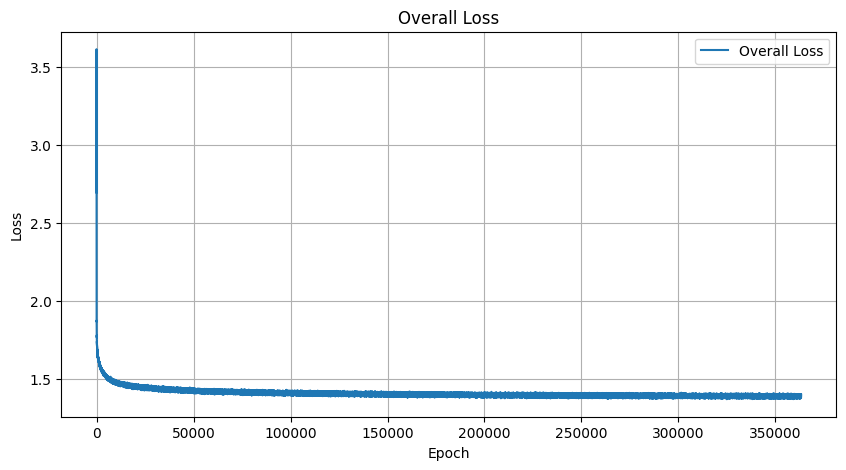

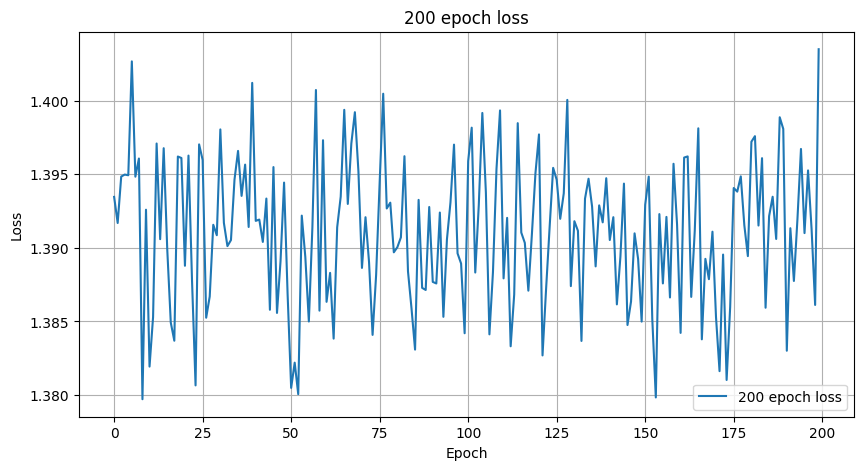

Epoch [1824001], Loss: 1.4000
Epoch [1824002], Loss: 1.3954
Epoch [1824003], Loss: 1.3854
Epoch [1824004], Loss: 1.3996
Epoch [1824005], Loss: 1.3942
Epoch [1824006], Loss: 1.3912
Epoch [1824007], Loss: 1.3878
Epoch [1824008], Loss: 1.3912
Epoch [1824009], Loss: 1.3913
Epoch [1824010], Loss: 1.3951
Epoch [1824011], Loss: 1.3893
Epoch [1824012], Loss: 1.3858
Epoch [1824013], Loss: 1.3883
Epoch [1824014], Loss: 1.3935
Epoch [1824015], Loss: 1.3924
Epoch [1824016], Loss: 1.3959
Epoch [1824017], Loss: 1.3808
Epoch [1824018], Loss: 1.3907
Epoch [1824019], Loss: 1.3947
Epoch [1824020], Loss: 1.3873
Epoch [1824021], Loss: 1.3907
Epoch [1824022], Loss: 1.3922
Epoch [1824023], Loss: 1.3857
Epoch [1824024], Loss: 1.3853
Epoch [1824025], Loss: 1.3989
Epoch [1824026], Loss: 1.3943
Epoch [1824027], Loss: 1.3906
Epoch [1824028], Loss: 1.3946
Epoch [1824029], Loss: 1.3973
Epoch [1824030], Loss: 1.3945
Epoch [1824031], Loss: 1.3922
Epoch [1824032], Loss: 1.3959
Epoch [1824033], Loss: 1.3952
Epoch [182

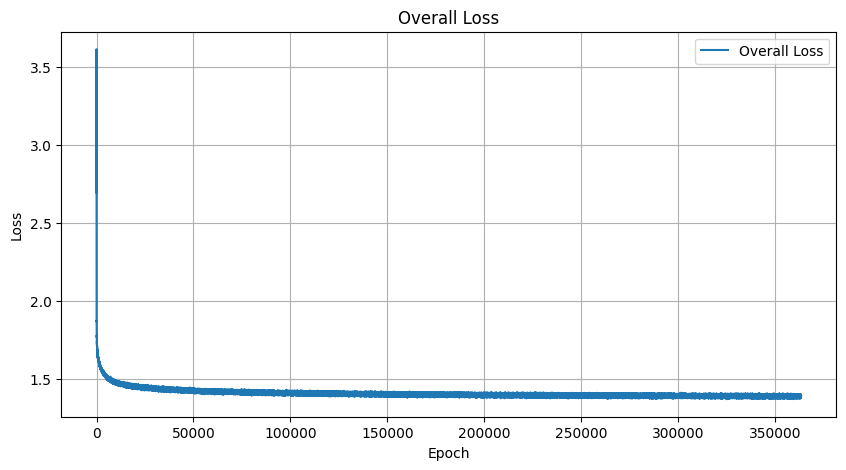

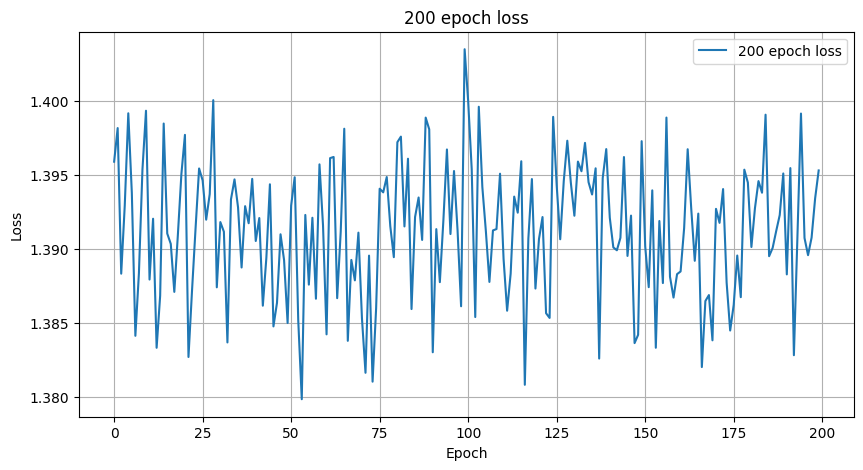

Epoch [1824101], Loss: 1.3923
Epoch [1824102], Loss: 1.3788
Epoch [1824103], Loss: 1.3869
Epoch [1824104], Loss: 1.3939
Epoch [1824105], Loss: 1.3903
Epoch [1824106], Loss: 1.3905
Epoch [1824107], Loss: 1.3908
Epoch [1824108], Loss: 1.3923
Epoch [1824109], Loss: 1.3936
Epoch [1824110], Loss: 1.4041
Epoch [1824111], Loss: 1.3958
Epoch [1824112], Loss: 1.3908
Epoch [1824113], Loss: 1.3953
Epoch [1824114], Loss: 1.3859
Epoch [1824115], Loss: 1.3927
Epoch [1824116], Loss: 1.3907
Epoch [1824117], Loss: 1.4050
Epoch [1824118], Loss: 1.3826
Epoch [1824119], Loss: 1.3903
Epoch [1824120], Loss: 1.3866
Epoch [1824121], Loss: 1.3910
Epoch [1824122], Loss: 1.3889
Epoch [1824123], Loss: 1.3894
Epoch [1824124], Loss: 1.3922
Epoch [1824125], Loss: 1.3965
Epoch [1824126], Loss: 1.3999
Epoch [1824127], Loss: 1.3895
Epoch [1824128], Loss: 1.3889
Epoch [1824129], Loss: 1.3872
Epoch [1824130], Loss: 1.3906
Epoch [1824131], Loss: 1.3885
Epoch [1824132], Loss: 1.3984
Epoch [1824133], Loss: 1.3916
Epoch [182

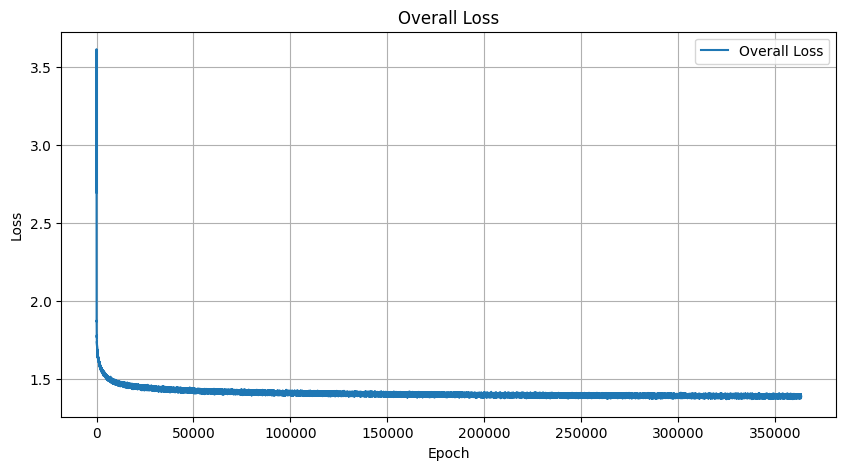

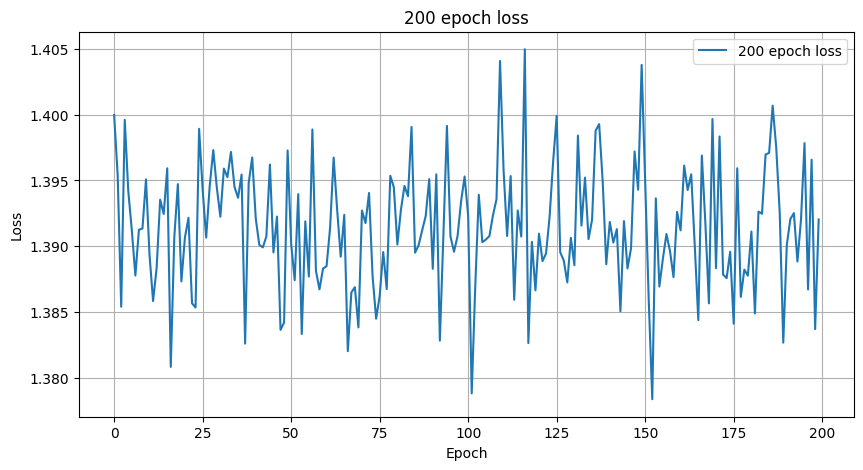

Epoch [1824201], Loss: 1.3916
Epoch [1824202], Loss: 1.3886
Epoch [1824203], Loss: 1.3819
Epoch [1824204], Loss: 1.3913
Epoch [1824205], Loss: 1.3993
Epoch [1824206], Loss: 1.3978
Epoch [1824207], Loss: 1.3867
Epoch [1824208], Loss: 1.3902
Epoch [1824209], Loss: 1.3865
Epoch [1824210], Loss: 1.3990
Epoch [1824211], Loss: 1.3960
Epoch [1824212], Loss: 1.3898
Epoch [1824213], Loss: 1.3902
Epoch [1824214], Loss: 1.3915
Epoch [1824215], Loss: 1.3864
Epoch [1824216], Loss: 1.3997
Epoch [1824217], Loss: 1.4023
Epoch [1824218], Loss: 1.3879
Epoch [1824219], Loss: 1.3947
Epoch [1824220], Loss: 1.3886
Epoch [1824221], Loss: 1.3925
Epoch [1824222], Loss: 1.3892
Epoch [1824223], Loss: 1.3875
Epoch [1824224], Loss: 1.3974
Epoch [1824225], Loss: 1.3872
Epoch [1824226], Loss: 1.3853
Epoch [1824227], Loss: 1.3965
Epoch [1824228], Loss: 1.3931
Epoch [1824229], Loss: 1.3828
Epoch [1824230], Loss: 1.3944
Epoch [1824231], Loss: 1.3834
Epoch [1824232], Loss: 1.3858
Epoch [1824233], Loss: 1.3902
Epoch [182

In [ ]:
step = 26
epochs = 2000000
for epoch in range(start_epoch,epochs):
    total_loss = 0
    state_taken, move_taken = xao_tron_rubik(step)
    # print("state taken:",state_taken)
    # print("move taken:",move_taken)

    state_tensor = torch.tensor(np.array(state_taken).reshape(-1, 54), dtype=torch.long).to(device)
    # print("state tensor:",state_tensor)
    move_tensor = torch.tensor(move_taken, dtype=torch.long).to(device)
    # print("move tensor:",move_tensor)
    output = model(state_tensor)
    loss = loss_func(output, move_tensor.view(-1))
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    total_loss += loss.item()
    
    loss_history.append(total_loss)
    print(f'Epoch [{epoch+1}], Loss: {total_loss:.4f}')
    if (epoch + 1) % 100 == 0:
        plt.figure(figsize=(10, 5))
        plt.plot(loss_history, label='Overall Loss')
        plt.title('Overall Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.grid(True)
        plt.legend()
        plt.savefig("overall_loss.png")

        plt.figure(figsize=(10, 5))
        plt.plot(loss_history[-200:], label='200 epoch loss') 
        plt.title('200 epoch loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.grid(True)
        plt.legend()
        plt.savefig("last_200_epochs_loss.png")

        plt.show(block=False)
        plt.pause(3)
        plt.close()
        # Lưu mô hình
        torch.save({
            'epoch': epochs,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss_history': loss_history,
        }, '/kaggle/working/rubik_model_checkpoint.pth')
print("da hoan thanh train")
plt.figure(figsize=(10, 5))
plt.plot(loss_history)
plt.title('Loss value')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.savefig("rubik.png")
plt.close

In [ ]:
# step = 26
# epochs = 1200000
# for epoch in range(start_epoch,epochs):
#     total_loss = 0
#     dataset = RubikDataset(step)
#     dataloader = DataLoader(dataset, batch_size=26000)
#     for batch_states, batch_moves in dataloader:
#         # print(batch_states)
#         # print(batch_moves)
#         batch_states = batch_states.squeeze(1)
#         batch_moves = batch_moves.view(-1) 
        
#         output = model(batch_states)
#         loss = loss_func(output, batch_moves)
        
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()
        
#         total_loss += loss.item()
    
#     loss_history.append(total_loss)
#     print(f'Epoch [{epoch+1}], Loss: {total_loss:.4f}')
#     if (epoch + 1) % 100 == 0:
#         # Vẽ toàn bộ quá trình huấn luyện
#         plt.figure(figsize=(10, 5))
#         plt.plot(loss_history, label='Overall Loss')
#         plt.title('Overall Loss')
#         plt.xlabel('Epoch')
#         plt.ylabel('Loss')
#         plt.grid(True)
#         plt.legend()
#         plt.savefig("overall_loss.png")

#         # Vẽ chỉ 100 epochs gần nhất
#         plt.figure(figsize=(10, 5))
#         plt.plot(loss_history[-200:], label='Last 100 Epochs Loss')  # Vẽ 100 giá trị gần nhất
#         plt.title('Loss of Last 100 Epochs')
#         plt.xlabel('Epoch')
#         plt.ylabel('Loss')
#         plt.grid(True)
#         plt.legend()
#         plt.savefig("last_200_epochs_loss.png")

#         plt.show(block=False)
#         plt.pause(3)
#         plt.close()
#         # Lưu mô hình
#         torch.save({
#             'epoch': epochs,
#             'model_state_dict': model.state_dict(),
#             'optimizer_state_dict': optimizer.state_dict(),
#             'loss_history': loss_history,
#         }, '/kaggle/working/rubik_model_checkpoint.pth')
# print("da hoan thanh train")
# plt.figure(figsize=(10, 5))
# plt.plot(loss_history)
# plt.title('Loss value')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.grid(True)
# plt.savefig("rubik.png")
# plt.close
